In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()
gpu_devices = tf.config.experimental.list_physical_devices("GPU")
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

xtrain_file = "xtrain.csv"
ytrain_file = "ytrain.csv"
xval_file = "xval.csv"
yval_file = "yval.csv"
xtest_file = "xtest.csv"
ytest_file = "ytest.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
# fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

xtrain = pd.read_csv(xtrain_file, index_col=False)
ytrain = pd.read_csv(ytrain_file, index_col=False)
xval = pd.read_csv(xval_file, index_col=False)
yval = pd.read_csv(yval_file, index_col=False)
xtest = pd.read_csv(xtest_file, index_col=False)
ytest = pd.read_csv(ytest_file, index_col=False)

In [8]:
#Load Hyperparameters Obtained by BayesOpt

matlab_file = 'P2_2.mat'
mat = spio.loadmat(matlab_file, squeeze_me=True)
lr = mat['lr']
ep = mat['ep']
epochs = mat['epochs']
batch = mat['batch']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [9]:
#Xtrain to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,4)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain = ytrain.to_numpy()
ytrain = ytrain.reshape(278,24,1)

In [11]:
#Xval to Numpy multidimensional array

xval = xval.to_numpy()
xval = xval.reshape(34,24,4)

In [12]:
#Yval to Numpy multidimensional array

yval = yval.to_numpy()
yval = yval.reshape(34,24,1)

In [13]:
#Xtest to Numpy multidimensional array

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,4)

In [14]:
#Ground truth to Numpy multidimensional array

ytest = ytest.to_numpy()
ytest = ytest.reshape(34,24,1)

In [15]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros((278,1))
for i in range(278):
    ytrain2[i] =  ytrain[i][0]
    
ytrain2=ytrain2.reshape(278,)

In [16]:
#Yval2 to Numpy multidimensional array - for SHAP

yval2 = np.zeros((34,1))
for i in range(34):
    yval2[i] =  yval[i][0]
    
yval2 =yval2.reshape(34,)

In [17]:
#Set ytrain, yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain]
x_val = xval
y_val = [yval,yval]
x_test = xtest

In [18]:
import sklearn
import math
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display
from sklearn import metrics

In [19]:
#Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

# Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [20]:
#Define probabilistic LSTM, fx

#LSTM layers

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 24, 4)]      0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 934)      3508104     input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 24, 364)      340340      lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 24, 2)        730         dense[0][0]                      
_______________________________________________________________________________________

In [21]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/Desktop/Anomaly Detection/Anomaly-Detection/Consistency/Bayes_Lstm_P2-2/Model Checkpoint/P2-2_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [22]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik},loss_weights=[0.5,0.5],optimizer= 'Adam')

In [23]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [24]:
# Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 5000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 50398072.00000, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00002: val_loss improved from 50398072.00000 to 37460896.00000, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00003: val_loss improved from 37460896.00000 to 34108356.00000, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00004: val_loss improved from 34108356.00000 to 33072118.00000, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00005: val_loss improved from 33072118.00000 to 32149990.00000, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00006: val_loss improved from 32149990.00000 to 30533052.00000, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Che


Epoch 00087: val_loss did not improve from 7496776.00000

Epoch 00088: val_loss improved from 7496776.00000 to 5601330.00000, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00089: val_loss did not improve from 5601330.00000

Epoch 00090: val_loss did not improve from 5601330.00000

Epoch 00091: val_loss did not improve from 5601330.00000

Epoch 00092: val_loss did not improve from 5601330.00000

Epoch 00093: val_loss did not improve from 5601330.00000

Epoch 00094: val_loss improved from 5601330.00000 to 1847101.50000, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00095: val_loss did not improve from 1847101.50000

Epoch 00096: val_loss did not improve from 1847101.50000

Epoch 00097: val_loss did not improve from 1847101.50000

Epoch 00098: val_loss did not improve from 1847101.50000

Epoch 00099: val_loss did not improve from 1847101.50000

Epoch 00100: val_loss did not improve from 1847101.50000

Epo


Epoch 00203: val_loss did not improve from 1030176.12500

Epoch 00204: val_loss did not improve from 1030176.12500

Epoch 00205: val_loss did not improve from 1030176.12500

Epoch 00206: val_loss did not improve from 1030176.12500

Epoch 00207: val_loss did not improve from 1030176.12500

Epoch 00208: val_loss improved from 1030176.12500 to 1028647.56250, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00209: val_loss improved from 1028647.56250 to 1014235.87500, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00210: val_loss did not improve from 1014235.87500

Epoch 00211: val_loss did not improve from 1014235.87500

Epoch 00212: val_loss did not improve from 1014235.87500

Epoch 00213: val_loss did not improve from 1014235.87500

Epoch 00214: val_loss did not improve from 1014235.87500

Epoch 00215: val_loss did not improve from 1014235.87500

Epoch 00216: val_loss improved from 1014235.87500 to 1001013.


Epoch 00321: val_loss did not improve from 897763.68750

Epoch 00322: val_loss did not improve from 897763.68750

Epoch 00323: val_loss did not improve from 897763.68750

Epoch 00324: val_loss did not improve from 897763.68750

Epoch 00325: val_loss did not improve from 897763.68750

Epoch 00326: val_loss did not improve from 897763.68750

Epoch 00327: val_loss did not improve from 897763.68750

Epoch 00328: val_loss did not improve from 897763.68750

Epoch 00329: val_loss did not improve from 897763.68750

Epoch 00330: val_loss did not improve from 897763.68750

Epoch 00331: val_loss did not improve from 897763.68750

Epoch 00332: val_loss did not improve from 897763.68750

Epoch 00333: val_loss did not improve from 897763.68750

Epoch 00334: val_loss did not improve from 897763.68750

Epoch 00335: val_loss did not improve from 897763.68750

Epoch 00336: val_loss did not improve from 897763.68750

Epoch 00337: val_loss did not improve from 897763.68750

Epoch 00338: val_loss did not 


Epoch 00439: val_loss did not improve from 777779.31250

Epoch 00440: val_loss did not improve from 777779.31250

Epoch 00441: val_loss did not improve from 777779.31250

Epoch 00442: val_loss improved from 777779.31250 to 766681.43750, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00443: val_loss did not improve from 766681.43750

Epoch 00444: val_loss did not improve from 766681.43750

Epoch 00445: val_loss improved from 766681.43750 to 765477.37500, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00446: val_loss did not improve from 765477.37500

Epoch 00447: val_loss did not improve from 765477.37500

Epoch 00448: val_loss did not improve from 765477.37500

Epoch 00449: val_loss did not improve from 765477.37500

Epoch 00450: val_loss did not improve from 765477.37500

Epoch 00451: val_loss did not improve from 765477.37500

Epoch 00452: val_loss improved from 765477.37500 to 755142.81250, saving mod


Epoch 00564: val_loss did not improve from 642505.06250

Epoch 00565: val_loss did not improve from 642505.06250

Epoch 00566: val_loss did not improve from 642505.06250

Epoch 00567: val_loss did not improve from 642505.06250

Epoch 00568: val_loss did not improve from 642505.06250

Epoch 00569: val_loss improved from 642505.06250 to 626446.68750, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00570: val_loss did not improve from 626446.68750

Epoch 00571: val_loss did not improve from 626446.68750

Epoch 00572: val_loss did not improve from 626446.68750

Epoch 00573: val_loss did not improve from 626446.68750

Epoch 00574: val_loss did not improve from 626446.68750

Epoch 00575: val_loss did not improve from 626446.68750

Epoch 00576: val_loss did not improve from 626446.68750

Epoch 00577: val_loss did not improve from 626446.68750

Epoch 00578: val_loss did not improve from 626446.68750

Epoch 00579: val_loss did not improve from 626446.687


Epoch 00686: val_loss did not improve from 497396.46875

Epoch 00687: val_loss did not improve from 497396.46875

Epoch 00688: val_loss did not improve from 497396.46875

Epoch 00689: val_loss did not improve from 497396.46875

Epoch 00690: val_loss did not improve from 497396.46875

Epoch 00691: val_loss did not improve from 497396.46875

Epoch 00692: val_loss did not improve from 497396.46875

Epoch 00693: val_loss improved from 497396.46875 to 482917.43750, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00694: val_loss did not improve from 482917.43750

Epoch 00695: val_loss did not improve from 482917.43750

Epoch 00696: val_loss did not improve from 482917.43750

Epoch 00697: val_loss did not improve from 482917.43750

Epoch 00698: val_loss improved from 482917.43750 to 480731.03125, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00699: val_loss did not improve from 480731.03125

Epoch 00700: val_lo


Epoch 00801: val_loss did not improve from 375298.18750

Epoch 00802: val_loss did not improve from 375298.18750

Epoch 00803: val_loss did not improve from 375298.18750

Epoch 00804: val_loss improved from 375298.18750 to 368223.40625, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 00805: val_loss did not improve from 368223.40625

Epoch 00806: val_loss did not improve from 368223.40625

Epoch 00807: val_loss did not improve from 368223.40625

Epoch 00808: val_loss did not improve from 368223.40625

Epoch 00809: val_loss did not improve from 368223.40625

Epoch 00810: val_loss did not improve from 368223.40625

Epoch 00811: val_loss did not improve from 368223.40625

Epoch 00812: val_loss did not improve from 368223.40625

Epoch 00813: val_loss did not improve from 368223.40625

Epoch 00814: val_loss did not improve from 368223.40625

Epoch 00815: val_loss did not improve from 368223.40625

Epoch 00816: val_loss improved from 368223.40625 to 3


Epoch 00919: val_loss did not improve from 267598.90625

Epoch 00920: val_loss did not improve from 267598.90625

Epoch 00921: val_loss did not improve from 267598.90625

Epoch 00922: val_loss did not improve from 267598.90625

Epoch 00923: val_loss did not improve from 267598.90625

Epoch 00924: val_loss did not improve from 267598.90625

Epoch 00925: val_loss did not improve from 267598.90625

Epoch 00926: val_loss did not improve from 267598.90625

Epoch 00927: val_loss did not improve from 267598.90625

Epoch 00928: val_loss did not improve from 267598.90625

Epoch 00929: val_loss did not improve from 267598.90625

Epoch 00930: val_loss did not improve from 267598.90625

Epoch 00931: val_loss did not improve from 267598.90625

Epoch 00932: val_loss did not improve from 267598.90625

Epoch 00933: val_loss did not improve from 267598.90625

Epoch 00934: val_loss did not improve from 267598.90625

Epoch 00935: val_loss improved from 267598.90625 to 260334.34375, saving model to C:/Us


Epoch 01049: val_loss did not improve from 184595.12500

Epoch 01050: val_loss improved from 184595.12500 to 162096.60938, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 01051: val_loss did not improve from 162096.60938

Epoch 01052: val_loss did not improve from 162096.60938

Epoch 01053: val_loss did not improve from 162096.60938

Epoch 01054: val_loss did not improve from 162096.60938

Epoch 01055: val_loss did not improve from 162096.60938

Epoch 01056: val_loss did not improve from 162096.60938

Epoch 01057: val_loss did not improve from 162096.60938

Epoch 01058: val_loss did not improve from 162096.60938

Epoch 01059: val_loss did not improve from 162096.60938

Epoch 01060: val_loss did not improve from 162096.60938

Epoch 01061: val_loss did not improve from 162096.60938

Epoch 01062: val_loss did not improve from 162096.60938

Epoch 01063: val_loss did not improve from 162096.60938

Epoch 01064: val_loss did not improve from 162096.609


Epoch 01179: val_loss did not improve from 102711.33594

Epoch 01180: val_loss did not improve from 102711.33594

Epoch 01181: val_loss did not improve from 102711.33594

Epoch 01182: val_loss did not improve from 102711.33594

Epoch 01183: val_loss did not improve from 102711.33594

Epoch 01184: val_loss did not improve from 102711.33594

Epoch 01185: val_loss did not improve from 102711.33594

Epoch 01186: val_loss did not improve from 102711.33594

Epoch 01187: val_loss did not improve from 102711.33594

Epoch 01188: val_loss did not improve from 102711.33594

Epoch 01189: val_loss did not improve from 102711.33594

Epoch 01190: val_loss did not improve from 102711.33594

Epoch 01191: val_loss did not improve from 102711.33594

Epoch 01192: val_loss did not improve from 102711.33594

Epoch 01193: val_loss did not improve from 102711.33594

Epoch 01194: val_loss did not improve from 102711.33594

Epoch 01195: val_loss did not improve from 102711.33594

Epoch 01196: val_loss did not 


Epoch 01309: val_loss did not improve from 55125.54688

Epoch 01310: val_loss did not improve from 55125.54688

Epoch 01311: val_loss did not improve from 55125.54688

Epoch 01312: val_loss did not improve from 55125.54688

Epoch 01313: val_loss did not improve from 55125.54688

Epoch 01314: val_loss did not improve from 55125.54688

Epoch 01315: val_loss did not improve from 55125.54688

Epoch 01316: val_loss did not improve from 55125.54688

Epoch 01317: val_loss did not improve from 55125.54688

Epoch 01318: val_loss did not improve from 55125.54688

Epoch 01319: val_loss did not improve from 55125.54688

Epoch 01320: val_loss did not improve from 55125.54688

Epoch 01321: val_loss did not improve from 55125.54688

Epoch 01322: val_loss did not improve from 55125.54688

Epoch 01323: val_loss did not improve from 55125.54688

Epoch 01324: val_loss did not improve from 55125.54688

Epoch 01325: val_loss did not improve from 55125.54688

Epoch 01326: val_loss did not improve from 5512


Epoch 01445: val_loss did not improve from 24281.11133

Epoch 01446: val_loss did not improve from 24281.11133

Epoch 01447: val_loss did not improve from 24281.11133

Epoch 01448: val_loss did not improve from 24281.11133

Epoch 01449: val_loss improved from 24281.11133 to 18502.66211, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 01450: val_loss did not improve from 18502.66211

Epoch 01451: val_loss did not improve from 18502.66211

Epoch 01452: val_loss did not improve from 18502.66211

Epoch 01453: val_loss did not improve from 18502.66211

Epoch 01454: val_loss did not improve from 18502.66211

Epoch 01455: val_loss did not improve from 18502.66211

Epoch 01456: val_loss did not improve from 18502.66211

Epoch 01457: val_loss did not improve from 18502.66211

Epoch 01458: val_loss improved from 18502.66211 to 17965.20898, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 01459: val_loss did not impro


Epoch 01587: val_loss did not improve from 7085.19238

Epoch 01588: val_loss did not improve from 7085.19238

Epoch 01589: val_loss did not improve from 7085.19238

Epoch 01590: val_loss did not improve from 7085.19238

Epoch 01591: val_loss did not improve from 7085.19238

Epoch 01592: val_loss did not improve from 7085.19238

Epoch 01593: val_loss did not improve from 7085.19238

Epoch 01594: val_loss did not improve from 7085.19238

Epoch 01595: val_loss did not improve from 7085.19238

Epoch 01596: val_loss did not improve from 7085.19238

Epoch 01597: val_loss did not improve from 7085.19238

Epoch 01598: val_loss did not improve from 7085.19238

Epoch 01599: val_loss did not improve from 7085.19238

Epoch 01600: val_loss did not improve from 7085.19238

Epoch 01601: val_loss did not improve from 7085.19238

Epoch 01602: val_loss did not improve from 7085.19238

Epoch 01603: val_loss did not improve from 7085.19238

Epoch 01604: val_loss did not improve from 7085.19238

Epoch 016


Epoch 01735: val_loss did not improve from 5790.43848

Epoch 01736: val_loss did not improve from 5790.43848

Epoch 01737: val_loss did not improve from 5790.43848

Epoch 01738: val_loss did not improve from 5790.43848

Epoch 01739: val_loss did not improve from 5790.43848

Epoch 01740: val_loss did not improve from 5790.43848

Epoch 01741: val_loss did not improve from 5790.43848

Epoch 01742: val_loss did not improve from 5790.43848

Epoch 01743: val_loss did not improve from 5790.43848

Epoch 01744: val_loss did not improve from 5790.43848

Epoch 01745: val_loss did not improve from 5790.43848

Epoch 01746: val_loss did not improve from 5790.43848

Epoch 01747: val_loss did not improve from 5790.43848

Epoch 01748: val_loss did not improve from 5790.43848

Epoch 01749: val_loss did not improve from 5790.43848

Epoch 01750: val_loss did not improve from 5790.43848

Epoch 01751: val_loss did not improve from 5790.43848

Epoch 01752: val_loss did not improve from 5790.43848

Epoch 017


Epoch 01884: val_loss did not improve from 5790.43848

Epoch 01885: val_loss did not improve from 5790.43848

Epoch 01886: val_loss did not improve from 5790.43848

Epoch 01887: val_loss did not improve from 5790.43848

Epoch 01888: val_loss did not improve from 5790.43848

Epoch 01889: val_loss did not improve from 5790.43848

Epoch 01890: val_loss did not improve from 5790.43848

Epoch 01891: val_loss did not improve from 5790.43848

Epoch 01892: val_loss did not improve from 5790.43848

Epoch 01893: val_loss did not improve from 5790.43848

Epoch 01894: val_loss did not improve from 5790.43848

Epoch 01895: val_loss did not improve from 5790.43848

Epoch 01896: val_loss did not improve from 5790.43848

Epoch 01897: val_loss did not improve from 5790.43848

Epoch 01898: val_loss did not improve from 5790.43848

Epoch 01899: val_loss did not improve from 5790.43848

Epoch 01900: val_loss did not improve from 5790.43848

Epoch 01901: val_loss did not improve from 5790.43848

Epoch 019


Epoch 02033: val_loss did not improve from 5790.43848

Epoch 02034: val_loss did not improve from 5790.43848

Epoch 02035: val_loss did not improve from 5790.43848

Epoch 02036: val_loss did not improve from 5790.43848

Epoch 02037: val_loss did not improve from 5790.43848

Epoch 02038: val_loss did not improve from 5790.43848

Epoch 02039: val_loss did not improve from 5790.43848

Epoch 02040: val_loss did not improve from 5790.43848

Epoch 02041: val_loss did not improve from 5790.43848

Epoch 02042: val_loss did not improve from 5790.43848

Epoch 02043: val_loss did not improve from 5790.43848

Epoch 02044: val_loss did not improve from 5790.43848

Epoch 02045: val_loss did not improve from 5790.43848

Epoch 02046: val_loss did not improve from 5790.43848

Epoch 02047: val_loss did not improve from 5790.43848

Epoch 02048: val_loss did not improve from 5790.43848

Epoch 02049: val_loss did not improve from 5790.43848

Epoch 02050: val_loss did not improve from 5790.43848

Epoch 020


Epoch 02182: val_loss did not improve from 5790.43848

Epoch 02183: val_loss did not improve from 5790.43848

Epoch 02184: val_loss did not improve from 5790.43848

Epoch 02185: val_loss did not improve from 5790.43848

Epoch 02186: val_loss did not improve from 5790.43848

Epoch 02187: val_loss did not improve from 5790.43848

Epoch 02188: val_loss did not improve from 5790.43848

Epoch 02189: val_loss did not improve from 5790.43848

Epoch 02190: val_loss did not improve from 5790.43848

Epoch 02191: val_loss did not improve from 5790.43848

Epoch 02192: val_loss did not improve from 5790.43848

Epoch 02193: val_loss did not improve from 5790.43848

Epoch 02194: val_loss did not improve from 5790.43848

Epoch 02195: val_loss did not improve from 5790.43848

Epoch 02196: val_loss did not improve from 5790.43848

Epoch 02197: val_loss did not improve from 5790.43848

Epoch 02198: val_loss did not improve from 5790.43848

Epoch 02199: val_loss did not improve from 5790.43848

Epoch 022


Epoch 02330: val_loss did not improve from 5706.15234

Epoch 02331: val_loss did not improve from 5706.15234

Epoch 02332: val_loss did not improve from 5706.15234

Epoch 02333: val_loss did not improve from 5706.15234

Epoch 02334: val_loss did not improve from 5706.15234

Epoch 02335: val_loss did not improve from 5706.15234

Epoch 02336: val_loss did not improve from 5706.15234

Epoch 02337: val_loss did not improve from 5706.15234

Epoch 02338: val_loss did not improve from 5706.15234

Epoch 02339: val_loss did not improve from 5706.15234

Epoch 02340: val_loss did not improve from 5706.15234

Epoch 02341: val_loss did not improve from 5706.15234

Epoch 02342: val_loss did not improve from 5706.15234

Epoch 02343: val_loss did not improve from 5706.15234

Epoch 02344: val_loss did not improve from 5706.15234

Epoch 02345: val_loss did not improve from 5706.15234

Epoch 02346: val_loss did not improve from 5706.15234

Epoch 02347: val_loss did not improve from 5706.15234

Epoch 023


Epoch 02478: val_loss did not improve from 5605.69092

Epoch 02479: val_loss did not improve from 5605.69092

Epoch 02480: val_loss did not improve from 5605.69092

Epoch 02481: val_loss did not improve from 5605.69092

Epoch 02482: val_loss did not improve from 5605.69092

Epoch 02483: val_loss did not improve from 5605.69092

Epoch 02484: val_loss did not improve from 5605.69092

Epoch 02485: val_loss did not improve from 5605.69092

Epoch 02486: val_loss did not improve from 5605.69092

Epoch 02487: val_loss did not improve from 5605.69092

Epoch 02488: val_loss did not improve from 5605.69092

Epoch 02489: val_loss did not improve from 5605.69092

Epoch 02490: val_loss did not improve from 5605.69092

Epoch 02491: val_loss did not improve from 5605.69092

Epoch 02492: val_loss did not improve from 5605.69092

Epoch 02493: val_loss did not improve from 5605.69092

Epoch 02494: val_loss did not improve from 5605.69092

Epoch 02495: val_loss did not improve from 5605.69092

Epoch 024


Epoch 02627: val_loss did not improve from 5605.69092

Epoch 02628: val_loss did not improve from 5605.69092

Epoch 02629: val_loss did not improve from 5605.69092

Epoch 02630: val_loss did not improve from 5605.69092

Epoch 02631: val_loss did not improve from 5605.69092

Epoch 02632: val_loss did not improve from 5605.69092

Epoch 02633: val_loss did not improve from 5605.69092

Epoch 02634: val_loss did not improve from 5605.69092

Epoch 02635: val_loss did not improve from 5605.69092

Epoch 02636: val_loss did not improve from 5605.69092

Epoch 02637: val_loss did not improve from 5605.69092

Epoch 02638: val_loss did not improve from 5605.69092

Epoch 02639: val_loss did not improve from 5605.69092

Epoch 02640: val_loss did not improve from 5605.69092

Epoch 02641: val_loss did not improve from 5605.69092

Epoch 02642: val_loss did not improve from 5605.69092

Epoch 02643: val_loss did not improve from 5605.69092

Epoch 02644: val_loss did not improve from 5605.69092

Epoch 026


Epoch 02773: val_loss did not improve from 5504.82471

Epoch 02774: val_loss did not improve from 5504.82471

Epoch 02775: val_loss did not improve from 5504.82471

Epoch 02776: val_loss did not improve from 5504.82471

Epoch 02777: val_loss did not improve from 5504.82471

Epoch 02778: val_loss did not improve from 5504.82471

Epoch 02779: val_loss did not improve from 5504.82471

Epoch 02780: val_loss did not improve from 5504.82471

Epoch 02781: val_loss did not improve from 5504.82471

Epoch 02782: val_loss did not improve from 5504.82471

Epoch 02783: val_loss did not improve from 5504.82471

Epoch 02784: val_loss did not improve from 5504.82471

Epoch 02785: val_loss did not improve from 5504.82471

Epoch 02786: val_loss did not improve from 5504.82471

Epoch 02787: val_loss did not improve from 5504.82471

Epoch 02788: val_loss did not improve from 5504.82471

Epoch 02789: val_loss did not improve from 5504.82471

Epoch 02790: val_loss did not improve from 5504.82471

Epoch 027


Epoch 02922: val_loss did not improve from 5504.82471

Epoch 02923: val_loss did not improve from 5504.82471

Epoch 02924: val_loss did not improve from 5504.82471

Epoch 02925: val_loss did not improve from 5504.82471

Epoch 02926: val_loss did not improve from 5504.82471

Epoch 02927: val_loss did not improve from 5504.82471

Epoch 02928: val_loss did not improve from 5504.82471

Epoch 02929: val_loss did not improve from 5504.82471

Epoch 02930: val_loss did not improve from 5504.82471

Epoch 02931: val_loss did not improve from 5504.82471

Epoch 02932: val_loss did not improve from 5504.82471

Epoch 02933: val_loss did not improve from 5504.82471

Epoch 02934: val_loss did not improve from 5504.82471

Epoch 02935: val_loss did not improve from 5504.82471

Epoch 02936: val_loss did not improve from 5504.82471

Epoch 02937: val_loss did not improve from 5504.82471

Epoch 02938: val_loss did not improve from 5504.82471

Epoch 02939: val_loss did not improve from 5504.82471

Epoch 029


Epoch 03071: val_loss did not improve from 5504.82471

Epoch 03072: val_loss did not improve from 5504.82471

Epoch 03073: val_loss did not improve from 5504.82471

Epoch 03074: val_loss did not improve from 5504.82471

Epoch 03075: val_loss did not improve from 5504.82471

Epoch 03076: val_loss did not improve from 5504.82471

Epoch 03077: val_loss did not improve from 5504.82471

Epoch 03078: val_loss did not improve from 5504.82471

Epoch 03079: val_loss did not improve from 5504.82471

Epoch 03080: val_loss did not improve from 5504.82471

Epoch 03081: val_loss did not improve from 5504.82471

Epoch 03082: val_loss did not improve from 5504.82471

Epoch 03083: val_loss did not improve from 5504.82471

Epoch 03084: val_loss did not improve from 5504.82471

Epoch 03085: val_loss did not improve from 5504.82471

Epoch 03086: val_loss did not improve from 5504.82471

Epoch 03087: val_loss did not improve from 5504.82471

Epoch 03088: val_loss did not improve from 5504.82471

Epoch 030


Epoch 03220: val_loss did not improve from 5504.82471

Epoch 03221: val_loss did not improve from 5504.82471

Epoch 03222: val_loss did not improve from 5504.82471

Epoch 03223: val_loss did not improve from 5504.82471

Epoch 03224: val_loss did not improve from 5504.82471

Epoch 03225: val_loss did not improve from 5504.82471

Epoch 03226: val_loss did not improve from 5504.82471

Epoch 03227: val_loss did not improve from 5504.82471

Epoch 03228: val_loss did not improve from 5504.82471

Epoch 03229: val_loss did not improve from 5504.82471

Epoch 03230: val_loss did not improve from 5504.82471

Epoch 03231: val_loss did not improve from 5504.82471

Epoch 03232: val_loss did not improve from 5504.82471

Epoch 03233: val_loss did not improve from 5504.82471

Epoch 03234: val_loss did not improve from 5504.82471

Epoch 03235: val_loss did not improve from 5504.82471

Epoch 03236: val_loss did not improve from 5504.82471

Epoch 03237: val_loss did not improve from 5504.82471

Epoch 032


Epoch 03366: val_loss did not improve from 5361.57666

Epoch 03367: val_loss did not improve from 5361.57666

Epoch 03368: val_loss did not improve from 5361.57666

Epoch 03369: val_loss did not improve from 5361.57666

Epoch 03370: val_loss did not improve from 5361.57666

Epoch 03371: val_loss did not improve from 5361.57666

Epoch 03372: val_loss did not improve from 5361.57666

Epoch 03373: val_loss did not improve from 5361.57666

Epoch 03374: val_loss did not improve from 5361.57666

Epoch 03375: val_loss did not improve from 5361.57666

Epoch 03376: val_loss did not improve from 5361.57666

Epoch 03377: val_loss did not improve from 5361.57666

Epoch 03378: val_loss did not improve from 5361.57666

Epoch 03379: val_loss did not improve from 5361.57666

Epoch 03380: val_loss did not improve from 5361.57666

Epoch 03381: val_loss did not improve from 5361.57666

Epoch 03382: val_loss did not improve from 5361.57666

Epoch 03383: val_loss did not improve from 5361.57666

Epoch 033


Epoch 03515: val_loss did not improve from 5361.57666

Epoch 03516: val_loss did not improve from 5361.57666

Epoch 03517: val_loss did not improve from 5361.57666

Epoch 03518: val_loss did not improve from 5361.57666

Epoch 03519: val_loss did not improve from 5361.57666

Epoch 03520: val_loss did not improve from 5361.57666

Epoch 03521: val_loss did not improve from 5361.57666

Epoch 03522: val_loss did not improve from 5361.57666

Epoch 03523: val_loss did not improve from 5361.57666

Epoch 03524: val_loss did not improve from 5361.57666

Epoch 03525: val_loss did not improve from 5361.57666

Epoch 03526: val_loss did not improve from 5361.57666

Epoch 03527: val_loss did not improve from 5361.57666

Epoch 03528: val_loss improved from 5361.57666 to 5312.32812, saving model to C:/Users/Asus/Desktop/Bayes_Lstm_P2-2/Model Checkpoint\P2-2_ckpt

Epoch 03529: val_loss did not improve from 5312.32812

Epoch 03530: val_loss did not improve from 5312.32812

Epoch 03531: val_loss did not 


Epoch 03663: val_loss did not improve from 5312.32812

Epoch 03664: val_loss did not improve from 5312.32812

Epoch 03665: val_loss did not improve from 5312.32812

Epoch 03666: val_loss did not improve from 5312.32812

Epoch 03667: val_loss did not improve from 5312.32812

Epoch 03668: val_loss did not improve from 5312.32812

Epoch 03669: val_loss did not improve from 5312.32812

Epoch 03670: val_loss did not improve from 5312.32812

Epoch 03671: val_loss did not improve from 5312.32812

Epoch 03672: val_loss did not improve from 5312.32812

Epoch 03673: val_loss did not improve from 5312.32812

Epoch 03674: val_loss did not improve from 5312.32812

Epoch 03675: val_loss did not improve from 5312.32812

Epoch 03676: val_loss did not improve from 5312.32812

Epoch 03677: val_loss did not improve from 5312.32812

Epoch 03678: val_loss did not improve from 5312.32812

Epoch 03679: val_loss did not improve from 5312.32812

Epoch 03680: val_loss did not improve from 5312.32812

Epoch 036


Epoch 03812: val_loss did not improve from 5312.32812

Epoch 03813: val_loss did not improve from 5312.32812

Epoch 03814: val_loss did not improve from 5312.32812

Epoch 03815: val_loss did not improve from 5312.32812

Epoch 03816: val_loss did not improve from 5312.32812

Epoch 03817: val_loss did not improve from 5312.32812

Epoch 03818: val_loss did not improve from 5312.32812

Epoch 03819: val_loss did not improve from 5312.32812

Epoch 03820: val_loss did not improve from 5312.32812

Epoch 03821: val_loss did not improve from 5312.32812

Epoch 03822: val_loss did not improve from 5312.32812

Epoch 03823: val_loss did not improve from 5312.32812

Epoch 03824: val_loss did not improve from 5312.32812

Epoch 03825: val_loss did not improve from 5312.32812

Epoch 03826: val_loss did not improve from 5312.32812

Epoch 03827: val_loss did not improve from 5312.32812

Epoch 03828: val_loss did not improve from 5312.32812

Epoch 03829: val_loss did not improve from 5312.32812

Epoch 038


Epoch 03961: val_loss did not improve from 5312.32812

Epoch 03962: val_loss did not improve from 5312.32812

Epoch 03963: val_loss did not improve from 5312.32812

Epoch 03964: val_loss did not improve from 5312.32812

Epoch 03965: val_loss did not improve from 5312.32812

Epoch 03966: val_loss did not improve from 5312.32812

Epoch 03967: val_loss did not improve from 5312.32812

Epoch 03968: val_loss did not improve from 5312.32812

Epoch 03969: val_loss did not improve from 5312.32812

Epoch 03970: val_loss did not improve from 5312.32812

Epoch 03971: val_loss did not improve from 5312.32812

Epoch 03972: val_loss did not improve from 5312.32812

Epoch 03973: val_loss did not improve from 5312.32812

Epoch 03974: val_loss did not improve from 5312.32812

Epoch 03975: val_loss did not improve from 5312.32812

Epoch 03976: val_loss did not improve from 5312.32812

Epoch 03977: val_loss did not improve from 5312.32812

Epoch 03978: val_loss did not improve from 5312.32812

Epoch 039


Epoch 04110: val_loss did not improve from 5312.32812

Epoch 04111: val_loss did not improve from 5312.32812

Epoch 04112: val_loss did not improve from 5312.32812

Epoch 04113: val_loss did not improve from 5312.32812

Epoch 04114: val_loss did not improve from 5312.32812

Epoch 04115: val_loss did not improve from 5312.32812

Epoch 04116: val_loss did not improve from 5312.32812

Epoch 04117: val_loss did not improve from 5312.32812

Epoch 04118: val_loss did not improve from 5312.32812

Epoch 04119: val_loss did not improve from 5312.32812

Epoch 04120: val_loss did not improve from 5312.32812

Epoch 04121: val_loss did not improve from 5312.32812

Epoch 04122: val_loss did not improve from 5312.32812

Epoch 04123: val_loss did not improve from 5312.32812

Epoch 04124: val_loss did not improve from 5312.32812

Epoch 04125: val_loss did not improve from 5312.32812

Epoch 04126: val_loss did not improve from 5312.32812

Epoch 04127: val_loss did not improve from 5312.32812

Epoch 041


Epoch 04259: val_loss did not improve from 5312.32812

Epoch 04260: val_loss did not improve from 5312.32812

Epoch 04261: val_loss did not improve from 5312.32812

Epoch 04262: val_loss did not improve from 5312.32812

Epoch 04263: val_loss did not improve from 5312.32812

Epoch 04264: val_loss did not improve from 5312.32812

Epoch 04265: val_loss did not improve from 5312.32812

Epoch 04266: val_loss did not improve from 5312.32812

Epoch 04267: val_loss did not improve from 5312.32812

Epoch 04268: val_loss did not improve from 5312.32812

Epoch 04269: val_loss did not improve from 5312.32812

Epoch 04270: val_loss did not improve from 5312.32812

Epoch 04271: val_loss did not improve from 5312.32812

Epoch 04272: val_loss did not improve from 5312.32812

Epoch 04273: val_loss did not improve from 5312.32812

Epoch 04274: val_loss did not improve from 5312.32812

Epoch 04275: val_loss did not improve from 5312.32812

Epoch 04276: val_loss did not improve from 5312.32812

Epoch 042


Epoch 04408: val_loss did not improve from 5312.32812

Epoch 04409: val_loss did not improve from 5312.32812

Epoch 04410: val_loss did not improve from 5312.32812

Epoch 04411: val_loss did not improve from 5312.32812

Epoch 04412: val_loss did not improve from 5312.32812

Epoch 04413: val_loss did not improve from 5312.32812

Epoch 04414: val_loss did not improve from 5312.32812

Epoch 04415: val_loss did not improve from 5312.32812

Epoch 04416: val_loss did not improve from 5312.32812

Epoch 04417: val_loss did not improve from 5312.32812

Epoch 04418: val_loss did not improve from 5312.32812

Epoch 04419: val_loss did not improve from 5312.32812

Epoch 04420: val_loss did not improve from 5312.32812

Epoch 04421: val_loss did not improve from 5312.32812

Epoch 04422: val_loss did not improve from 5312.32812

Epoch 04423: val_loss did not improve from 5312.32812

Epoch 04424: val_loss did not improve from 5312.32812

Epoch 04425: val_loss did not improve from 5312.32812

Epoch 044


Epoch 04557: val_loss did not improve from 5312.32812

Epoch 04558: val_loss did not improve from 5312.32812

Epoch 04559: val_loss did not improve from 5312.32812

Epoch 04560: val_loss did not improve from 5312.32812

Epoch 04561: val_loss did not improve from 5312.32812

Epoch 04562: val_loss did not improve from 5312.32812

Epoch 04563: val_loss did not improve from 5312.32812

Epoch 04564: val_loss did not improve from 5312.32812

Epoch 04565: val_loss did not improve from 5312.32812

Epoch 04566: val_loss did not improve from 5312.32812

Epoch 04567: val_loss did not improve from 5312.32812

Epoch 04568: val_loss did not improve from 5312.32812

Epoch 04569: val_loss did not improve from 5312.32812

Epoch 04570: val_loss did not improve from 5312.32812

Epoch 04571: val_loss did not improve from 5312.32812

Epoch 04572: val_loss did not improve from 5312.32812

Epoch 04573: val_loss did not improve from 5312.32812

Epoch 04574: val_loss did not improve from 5312.32812

Epoch 045


Epoch 04706: val_loss did not improve from 5312.32812

Epoch 04707: val_loss did not improve from 5312.32812

Epoch 04708: val_loss did not improve from 5312.32812

Epoch 04709: val_loss did not improve from 5312.32812

Epoch 04710: val_loss did not improve from 5312.32812

Epoch 04711: val_loss did not improve from 5312.32812

Epoch 04712: val_loss did not improve from 5312.32812

Epoch 04713: val_loss did not improve from 5312.32812

Epoch 04714: val_loss did not improve from 5312.32812

Epoch 04715: val_loss did not improve from 5312.32812

Epoch 04716: val_loss did not improve from 5312.32812

Epoch 04717: val_loss did not improve from 5312.32812

Epoch 04718: val_loss did not improve from 5312.32812

Epoch 04719: val_loss did not improve from 5312.32812

Epoch 04720: val_loss did not improve from 5312.32812

Epoch 04721: val_loss did not improve from 5312.32812

Epoch 04722: val_loss did not improve from 5312.32812

Epoch 04723: val_loss did not improve from 5312.32812

Epoch 047


Epoch 04855: val_loss did not improve from 5312.32812

Epoch 04856: val_loss did not improve from 5312.32812

Epoch 04857: val_loss did not improve from 5312.32812

Epoch 04858: val_loss did not improve from 5312.32812

Epoch 04859: val_loss did not improve from 5312.32812

Epoch 04860: val_loss did not improve from 5312.32812

Epoch 04861: val_loss did not improve from 5312.32812

Epoch 04862: val_loss did not improve from 5312.32812

Epoch 04863: val_loss did not improve from 5312.32812

Epoch 04864: val_loss did not improve from 5312.32812

Epoch 04865: val_loss did not improve from 5312.32812

Epoch 04866: val_loss did not improve from 5312.32812

Epoch 04867: val_loss did not improve from 5312.32812

Epoch 04868: val_loss did not improve from 5312.32812

Epoch 04869: val_loss did not improve from 5312.32812

Epoch 04870: val_loss did not improve from 5312.32812

Epoch 04871: val_loss did not improve from 5312.32812

Epoch 04872: val_loss did not improve from 5312.32812

Epoch 048

In [25]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [26]:
#SHAP cannot be used with model with probabilistic layers. So, define non probabilistic f'x

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 24, 4)]           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 24, 934)           3508104   
_________________________________________________________________
dense_2 (Dense)              (None, 24, 364)           340340    
_________________________________________________________________
dense_3 (Dense)              (None, 24, 1)             365       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 3,848,809
Trainable params: 3,848,809
Non-trainable params: 0
_________________________________________________________________


In [27]:
#Extract only "Mean" weights, exclude "Standard Deviation" weights

a = model.layers[3].get_weights()

b = np.zeros((len(a[0]),1))
for x in range(len(a[0])):
    b[x] = a[0][x][0]
    
d = np.zeros(1)
for x in range(1):
    d[x] = a[1][x]
    
c = [b,d]

In [28]:
#Transfer weights from fx to f'x

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(c)

In [29]:
#Prediction with f'x

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [30]:
#Import SHAP & initialized JS for f'x explanation

import shap
shap.initjs()

In [31]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2', 'MF'], dtype='<U2')

In [32]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(xtrain_file, index_col=False)

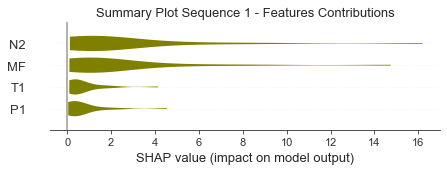

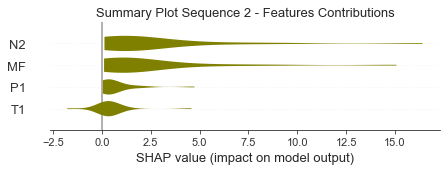

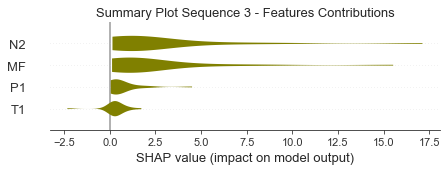

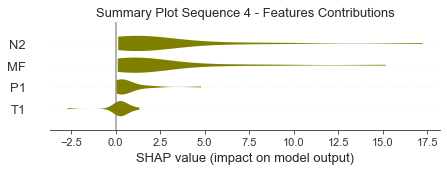

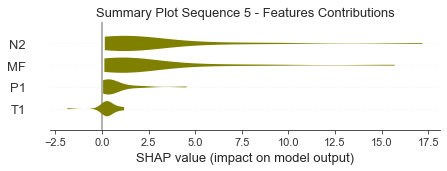

...

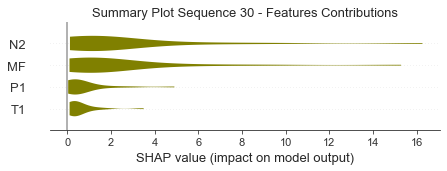

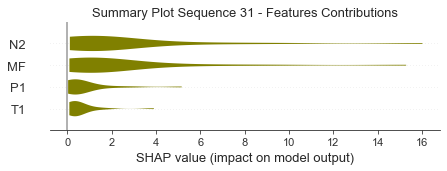

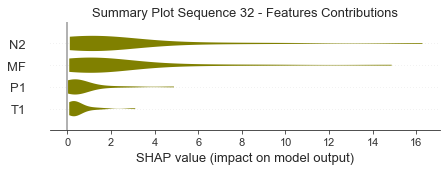

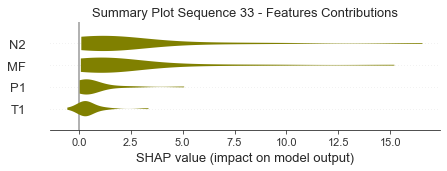

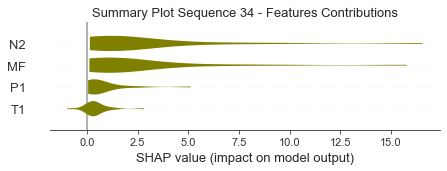

In [34]:
#SHAP Summmary Plot

import seaborn as sns
sns.set_style('ticks')
instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(34):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(7, 2),plot_type="violin", color='olive')
    plt.title("Summary Plot Sequence %i - Features Contributions" %(i+1),fontsize=13)
    plt.figure
    plt.show()

In [35]:
#SHAP Force Plot

import seaborn as sns
sns.set_style("ticks")
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    # Per individual array 
    for j in range(24):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,4),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

1 1


1 2


1 3


1 4


1 5


1 6


1 7


1 8


1 9


1 10


1 11


1 12


1 13


1 14


1 15


1 16


1 17


1 18


1 19


1 20


1 21


1 22


1 23


1 24


2 1


2 2


2 3


2 4


2 5


2 6


2 7


2 8


2 9


2 10


2 11


2 12


2 13


2 14


2 15


2 16


2 17


2 18


2 19


2 20


2 21


2 22


2 23


2 24


3 1


3 2


3 3


3 4


3 5


3 6


3 7


3 8


3 9


3 10


3 11


3 12


3 13


3 14


3 15


3 16


3 17


3 18


3 19


3 20


3 21


3 22


3 23


3 24


4 1


4 2


4 3


4 4


4 5


4 6


4 7


4 8


4 9


4 10


4 11


4 12


4 13


4 14


4 15


4 16


4 17


4 18


4 19


4 20


4 21


4 22


4 23


4 24


5 1


5 2


5 3


5 4


5 5


5 6


5 7


5 8


5 9


5 10


5 11


5 12


5 13


5 14


5 15


5 16


5 17


5 18


5 19


5 20


5 21


5 22


5 23


5 24


6 1


6 2


6 3


6 4


6 5


6 6


6 7


6 8


6 9


6 10


6 11


6 12


6 13


6 14


6 15


6 16


6 17


6 18


6 19


6 20


6 21


6 22


6 23


6 24


7 1


7 2


7 3


7 4


7 5


7 6


7 7


7 8


7 9


7 10


7 11


7 12


7 13


7 14


7 15


7 16


7 17


7 18


7 19


7 20


7 21


7 22


7 23


7 24


8 1


8 2


8 3


8 4


8 5


8 6


8 7


8 8


8 9


8 10


8 11


8 12


8 13


8 14


8 15


8 16


8 17


8 18


8 19


8 20


8 21


8 22


8 23


8 24


9 1


9 2


9 3


9 4


9 5


9 6


9 7


9 8


9 9


9 10


9 11


9 12


9 13


9 14


9 15


9 16


9 17


9 18


9 19


9 20


9 21


9 22


9 23


9 24


10 1


10 2


10 3


10 4


10 5


10 6


10 7


10 8


10 9


10 10


10 11


10 12


10 13


10 14


10 15


10 16


10 17


10 18


10 19


10 20


10 21


10 22


10 23


10 24


11 1


11 2


11 3


11 4


11 5


11 6


11 7


11 8


11 9


11 10


11 11


11 12


11 13


11 14


11 15


11 16


11 17


11 18


11 19


11 20


11 21


11 22


11 23


11 24


12 1


12 2


12 3


12 4


12 5


12 6


12 7


12 8


12 9


12 10


12 11


12 12


12 13


12 14


12 15


12 16


12 17


12 18


12 19


12 20


12 21


12 22


12 23


12 24


13 1


13 2


13 3


13 4


13 5


13 6


13 7


13 8


13 9


13 10


13 11


13 12


13 13


13 14


13 15


13 16


13 17


13 18


13 19


13 20


13 21


13 22


13 23


13 24


14 1


14 2


14 3


14 4


14 5


14 6


14 7


14 8


14 9


14 10


14 11


14 12


14 13


14 14


14 15


14 16


14 17


14 18


14 19


14 20


14 21


14 22


14 23


14 24


15 1


15 2


15 3


15 4


15 5


15 6


15 7


15 8


15 9


15 10


15 11


15 12


15 13


15 14


15 15


15 16


15 17


15 18


15 19


15 20


15 21


15 22


15 23


15 24


16 1


16 2


16 3


16 4


16 5


16 6


16 7


16 8


16 9


16 10


16 11


16 12


16 13


16 14


16 15


16 16


16 17


16 18


16 19


16 20


16 21


16 22


16 23


16 24


17 1


17 2


17 3


17 4


17 5


17 6


17 7


17 8


17 9


17 10


17 11


17 12


17 13


17 14


17 15


17 16


17 17


17 18


17 19


17 20


17 21


17 22


17 23


17 24


18 1


18 2


18 3


18 4


18 5


18 6


18 7


18 8


18 9


18 10


18 11


18 12


18 13


18 14


18 15


18 16


18 17


18 18


18 19


18 20


18 21


18 22


18 23


18 24


19 1


19 2


19 3


19 4


19 5


19 6


19 7


19 8


19 9


19 10


19 11


19 12


19 13


19 14


19 15


19 16


19 17


19 18


19 19


19 20


19 21


19 22


19 23


19 24


20 1


20 2


20 3


20 4


20 5


20 6


20 7


20 8


20 9


20 10


20 11


20 12


20 13


20 14


20 15


20 16


20 17


20 18


20 19


20 20


20 21


20 22


20 23


20 24


21 1


21 2


21 3


21 4


21 5


21 6


21 7


21 8


21 9


21 10


21 11


21 12


21 13


21 14


21 15


21 16


21 17


21 18


21 19


21 20


21 21


21 22


21 23


21 24


22 1


22 2


22 3


22 4


22 5


22 6


22 7


22 8


22 9


22 10


22 11


22 12


22 13


22 14


22 15


22 16


22 17


22 18


22 19


22 20


22 21


22 22


22 23


22 24


23 1


23 2


23 3


23 4


23 5


23 6


23 7


23 8


23 9


23 10


23 11


23 12


23 13


23 14


23 15


23 16


23 17


23 18


23 19


23 20


23 21


23 22


23 23


23 24


24 1


24 2


24 3


24 4


24 5


24 6


24 7


24 8


24 9


24 10


24 11


24 12


24 13


24 14


24 15


24 16


24 17


24 18


24 19


24 20


24 21


24 22


24 23


24 24


25 1


25 2


25 3


25 4


25 5


25 6


25 7


25 8


25 9


25 10


25 11


25 12


25 13


25 14


25 15


25 16


25 17


25 18


25 19


25 20


25 21


25 22


25 23


25 24


26 1


26 2


26 3


26 4


26 5


26 6


26 7


26 8


26 9


26 10


26 11


26 12


26 13


26 14


26 15


26 16


26 17


26 18


26 19


26 20


26 21


26 22


26 23


26 24


27 1


27 2


27 3


27 4


27 5


27 6


27 7


27 8


27 9


27 10


27 11


27 12


27 13


27 14


27 15


27 16


27 17


27 18


27 19


27 20


27 21


27 22


27 23


27 24


28 1


28 2


28 3


28 4


28 5


28 6


28 7


28 8


28 9


28 10


28 11


28 12


28 13


28 14


28 15


28 16


28 17


28 18


28 19


28 20


28 21


28 22


28 23


28 24


29 1


29 2


29 3


29 4


29 5


29 6


29 7


29 8


29 9


29 10


29 11


29 12


29 13


29 14


29 15


29 16


29 17


29 18


29 19


29 20


29 21


29 22


29 23


29 24


30 1


30 2


30 3


30 4


30 5


30 6


30 7


30 8


30 9


30 10


30 11


30 12


30 13


30 14


30 15


30 16


30 17


30 18


30 19


30 20


30 21


30 22


30 23


30 24


31 1


31 2


31 3


31 4


31 5


31 6


31 7


31 8


31 9


31 10


31 11


31 12


31 13


31 14


31 15


31 16


31 17


31 18


31 19


31 20


31 21


31 22


31 23


31 24


32 1


32 2


32 3


32 4


32 5


32 6


32 7


32 8


32 9


32 10


32 11


32 12


32 13


32 14


32 15


32 16


32 17


32 18


32 19


32 20


32 21


32 22


32 23


32 24


33 1


33 2


33 3


33 4


33 5


33 6


33 7


33 8


33 9


33 10


33 11


33 12


33 13


33 14


33 15


33 16


33 17


33 18


33 19


33 20


33 21


33 22


33 23


33 24


34 1


34 2


34 3


34 4


34 5


34 6


34 7


34 8


34 9


34 10


34 11


34 12


34 13


34 14


34 15


34 16


34 17


34 18


34 19


34 20


34 21


34 22


34 23


34 24


Contribution: [ 4.54979428  4.14626739 16.18920373 14.74891614]


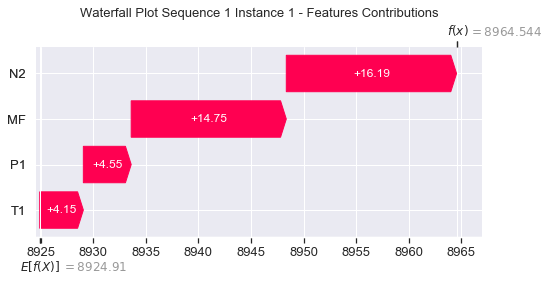

None

Contribution: [0.0411636  0.08945502 0.1160248  0.09577729]


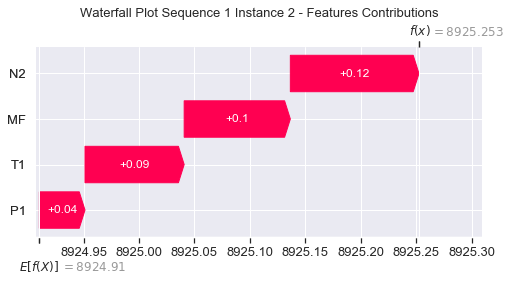

None

Contribution: [0.23659315 0.27617717 0.79121327 0.71664631]


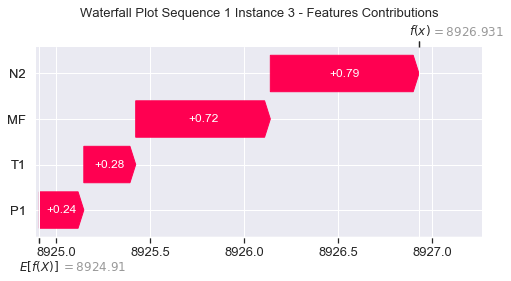

None

Contribution: [0.31124211 0.31716626 1.06103822 0.97537763]


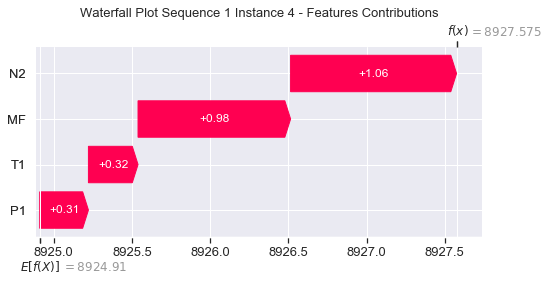

None

Contribution: [0.26470277 0.2877462  0.88741719 0.80497805]


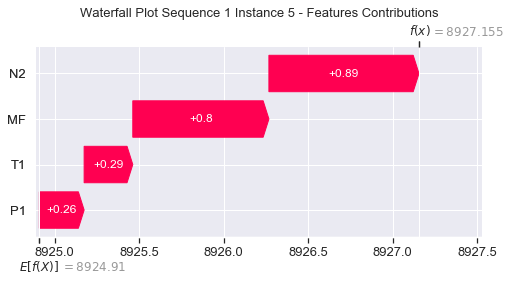

None

Contribution: [0.24215339 0.26178691 0.80551535 0.73158233]


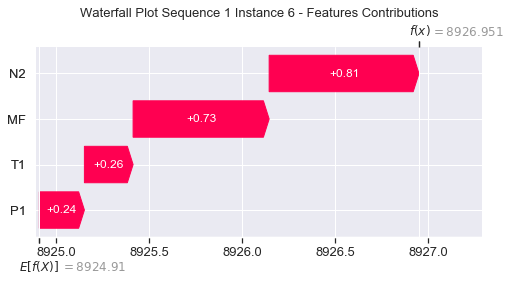

None

Contribution: [0.23130881 0.25496864 0.77284484 0.70312833]


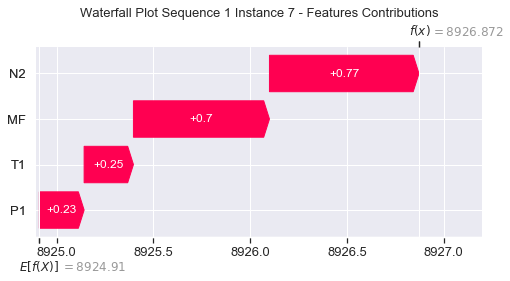

None

Contribution: [0.22758987 0.25231299 0.7591623  0.69034694]


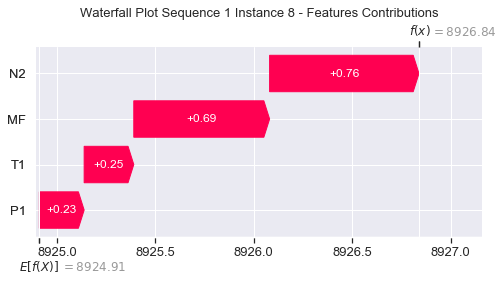

None

Contribution: [0.23027807 0.27157787 0.76111556 0.69825385]


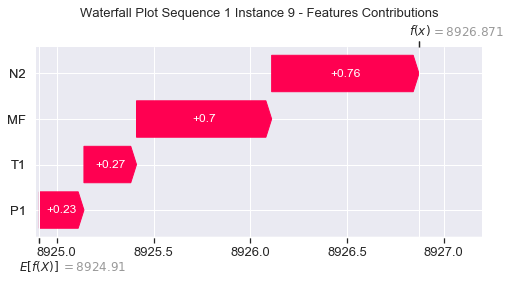

None

Contribution: [0.23181037 0.26700508 0.77256015 0.70857743]


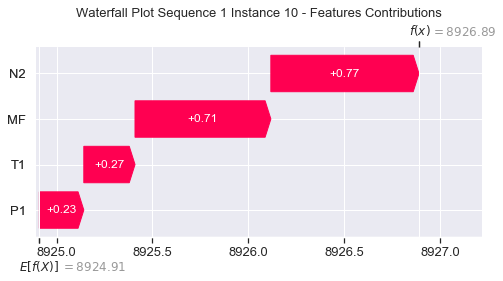

None

Contribution: [0.24341726 0.27732402 0.79973903 0.73030572]


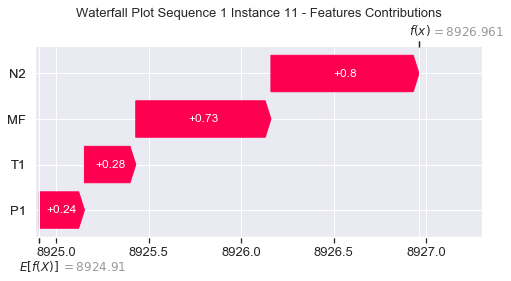

None

Contribution: [0.24654641 0.27899558 0.83340987 0.75927511]


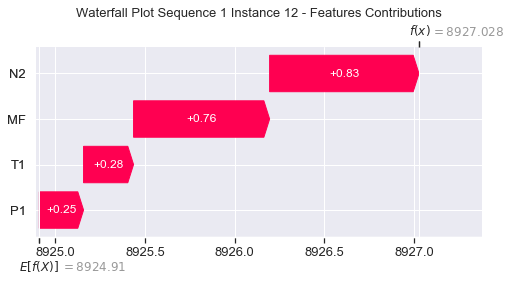

None

Contribution: [0.2628704  0.30197973 0.88993634 0.81080374]


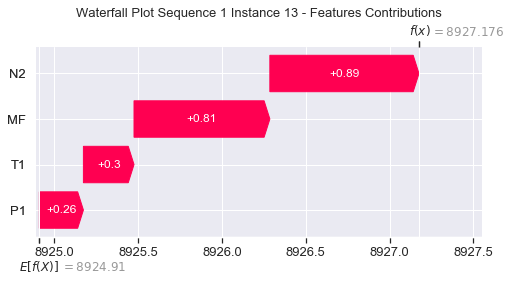

None

Contribution: [0.29363314 0.32656171 0.96139173 0.87386973]


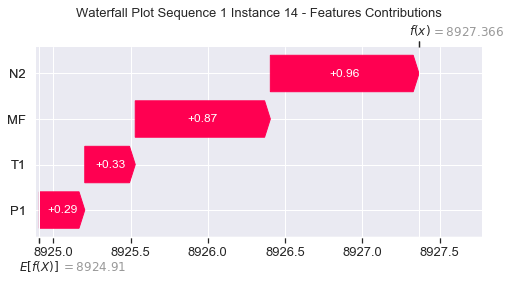

None

Contribution: [0.31588241 0.36375571 1.06343032 0.96957765]


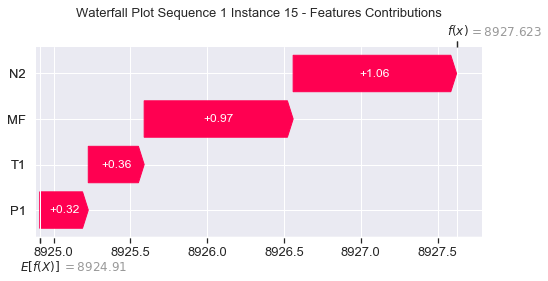

None

Contribution: [0.35276963 0.41230417 1.19899273 1.11192073]


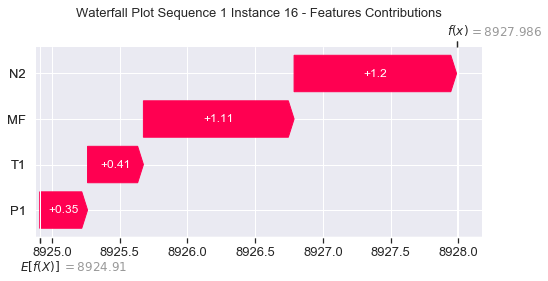

None

Contribution: [0.41152788 0.47978925 1.38619308 1.26372352]


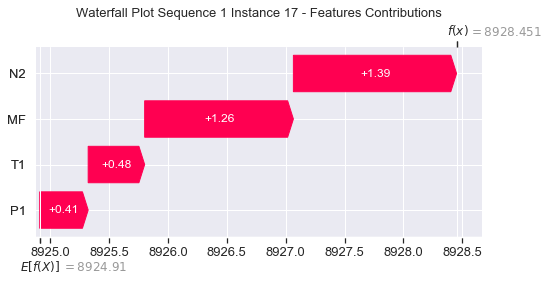

None

Contribution: [0.4896677  0.56598071 1.64421374 1.49736899]


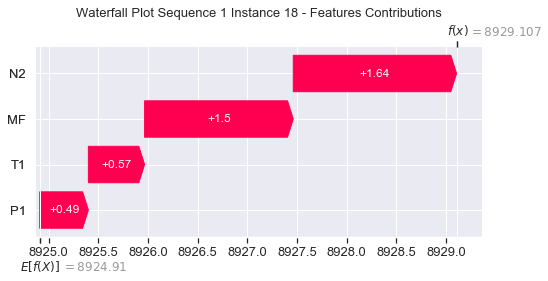

None

Contribution: [0.58872624 0.68877706 2.01420003 1.84144546]


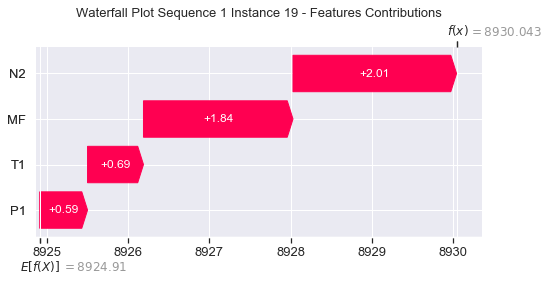

None

Contribution: [0.76186438 0.88012216 2.55445833 2.32486119]


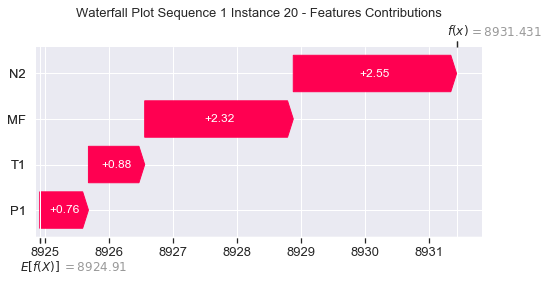

None

Contribution: [1.00533402 1.14316103 3.36826115 3.06579903]


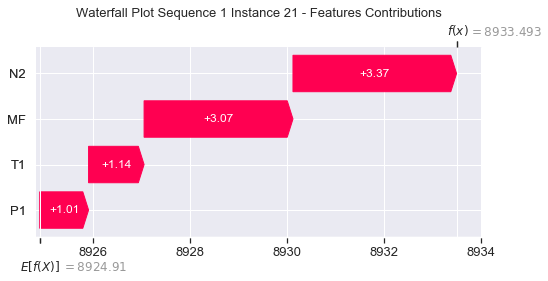

None

Contribution: [1.38253964 1.53830663 4.6444514  4.23028802]


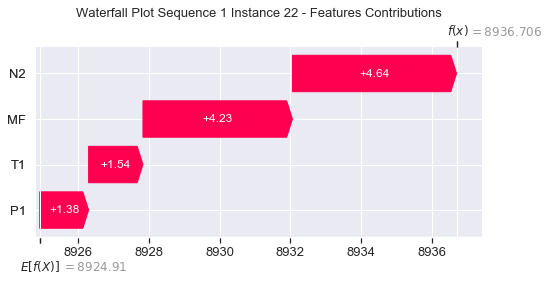

None

Contribution: [1.91683355 2.06710664 6.63816533 6.0781198 ]


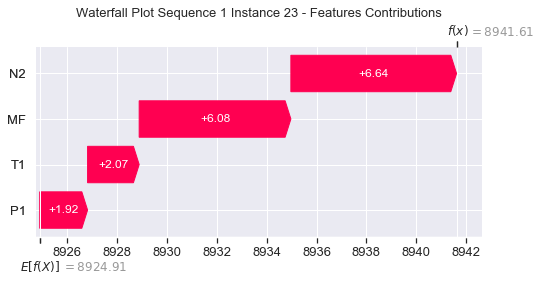

None

Contribution: [2.36979499 1.87330555 9.26638929 8.65998606]


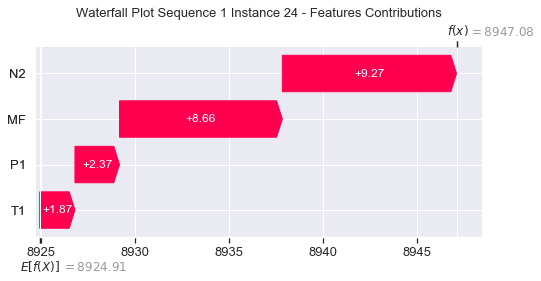

None

Contribution: [ 4.73353843  4.57960948 16.40897113 15.07685491]


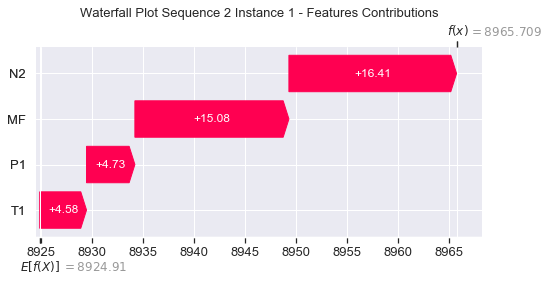

None

Contribution: [0.04562879 0.08786274 0.12695937 0.10612391]


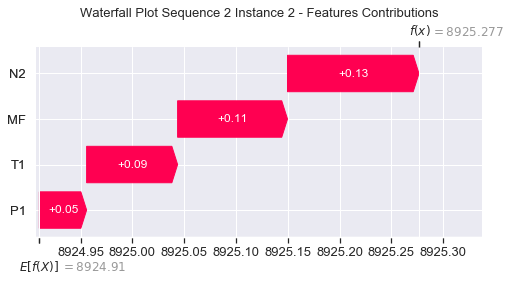

None

Contribution: [0.24756051 0.28939454 0.83153624 0.75583478]


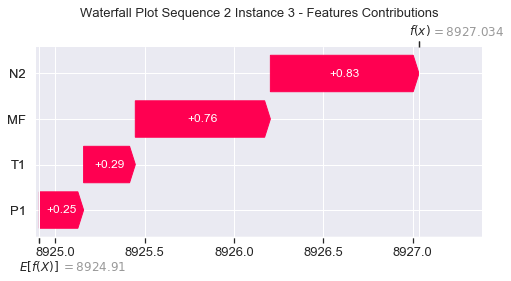

None

Contribution: [0.32155741 0.33628879 1.10461252 1.0006797 ]


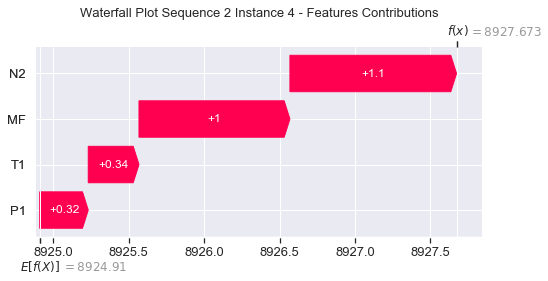

None

Contribution: [0.27414048 0.24973528 0.92934281 0.85546203]


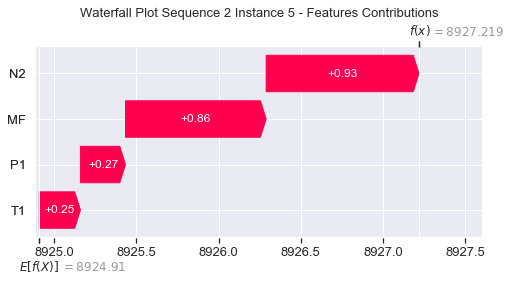

None

Contribution: [0.24802888 0.2182443  0.84183846 0.77086589]


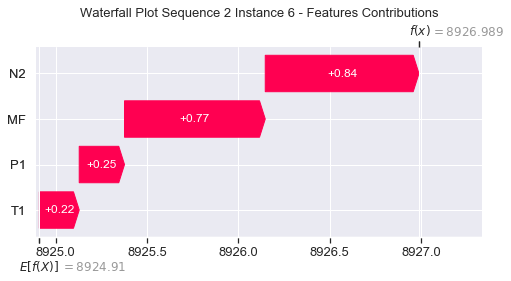

None

Contribution: [0.23810501 0.20724539 0.80832026 0.73897738]


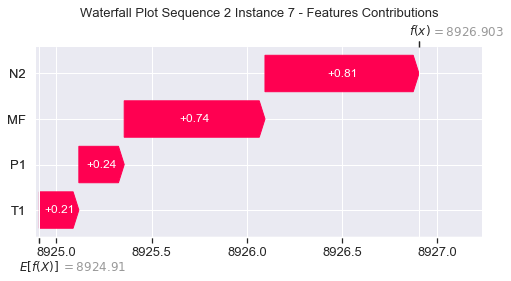

None

Contribution: [0.23360903 0.2041996  0.79431501 0.72638926]


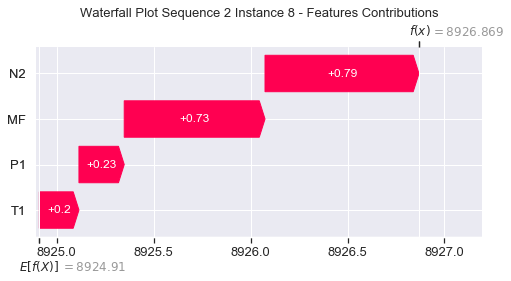

None

Contribution: [0.23621919 0.20010133 0.80071968 0.72973571]


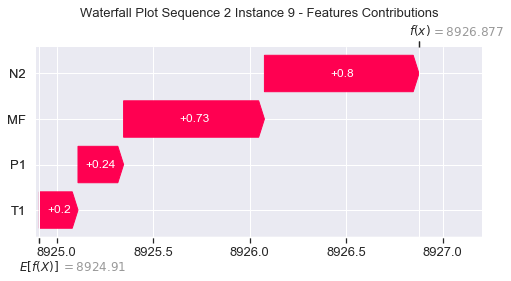

None

Contribution: [0.2385971  0.20134245 0.8149052  0.7422863 ]


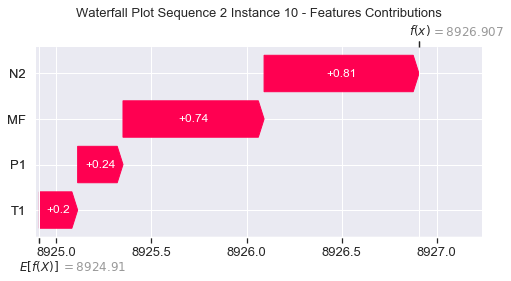

None

Contribution: [0.24628275 0.20853674 0.83912599 0.76417458]


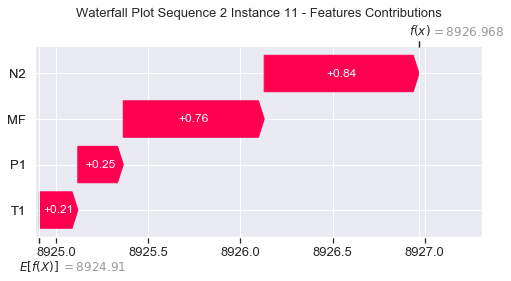

None

Contribution: [0.25468414 0.21013107 0.87233189 0.79160506]


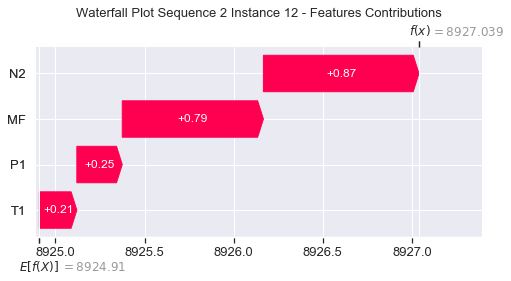

None

Contribution: [0.27209672 0.22654712 0.9320974  0.84621648]


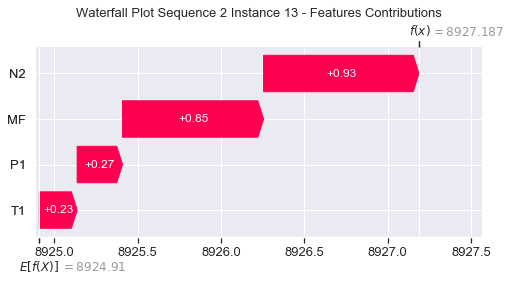

None

Contribution: [0.29513205 0.23819368 1.00657025 0.91353916]


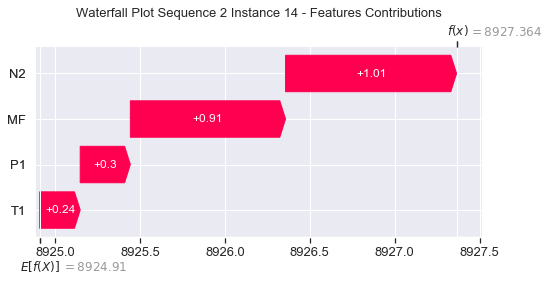

None

Contribution: [0.32467162 0.27021193 1.1119369  1.0091226 ]


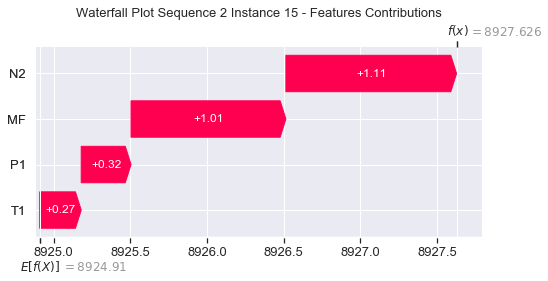

None

Contribution: [0.36275225 0.30751991 1.25271051 1.1426964 ]


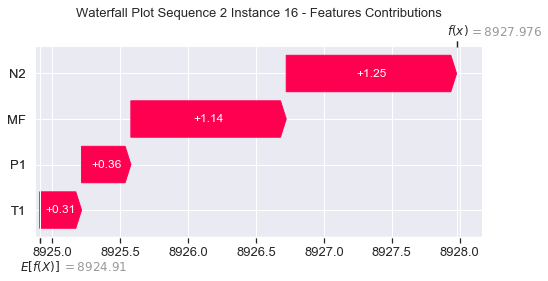

None

Contribution: [0.42268609 0.34595684 1.44547059 1.3104344 ]


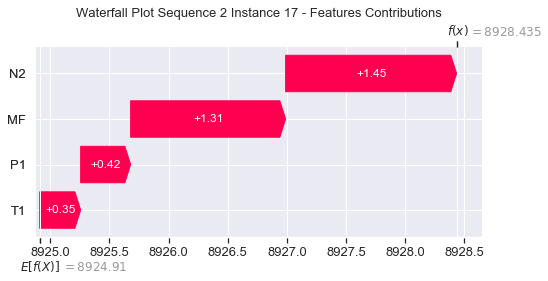

None

Contribution: [0.50024294 0.40798773 1.70900759 1.54989287]


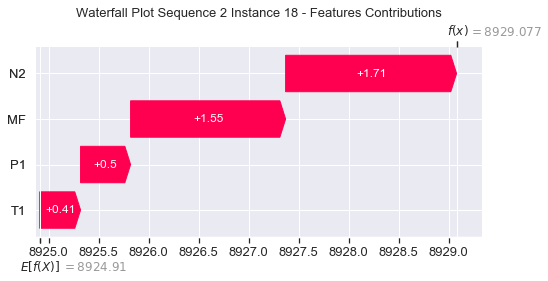

None

Contribution: [0.61374488 0.50872083 2.0844603  1.8875823 ]


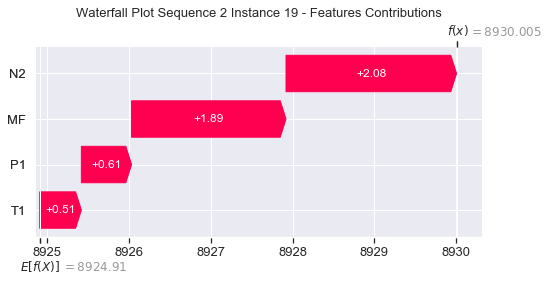

None

Contribution: [0.77564966 0.63444028 2.63783704 2.39849987]


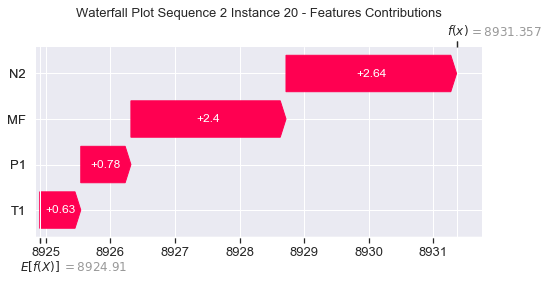

None

Contribution: [1.01861006 0.81273195 3.46140574 3.14810712]


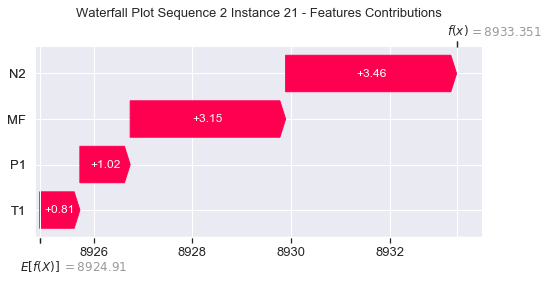

None

Contribution: [1.38933584 1.05071734 4.74518559 4.32391586]


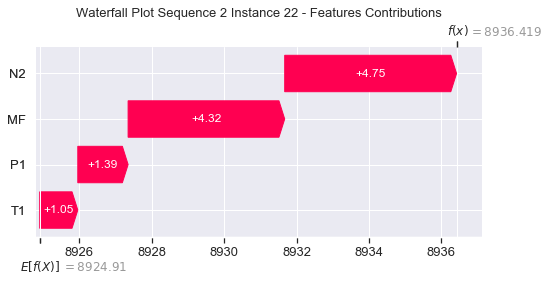

None

Contribution: [1.88783575 1.04298281 6.73882023 6.16714654]


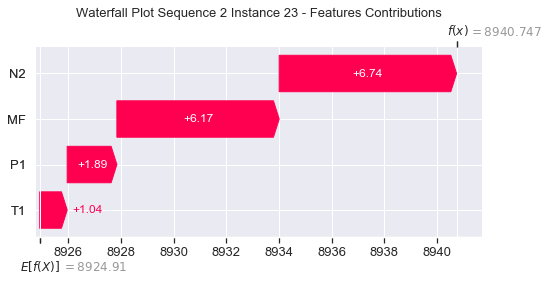

None

Contribution: [ 2.07979471 -1.77470145  9.34232082  8.7775293 ]


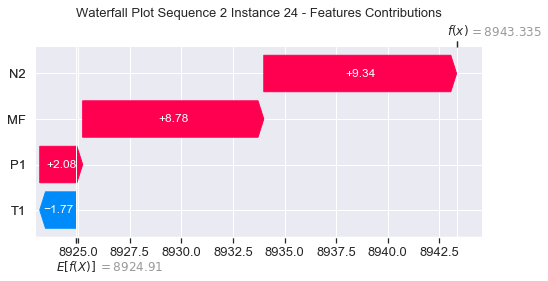

None

Contribution: [ 4.50755601  1.73052414 17.12529395 15.5238967 ]


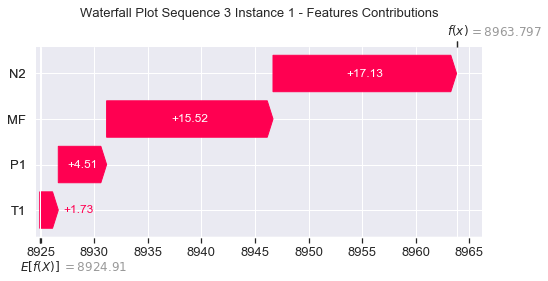

None

Contribution: [0.05412574 0.13869216 0.14866347 0.12592196]


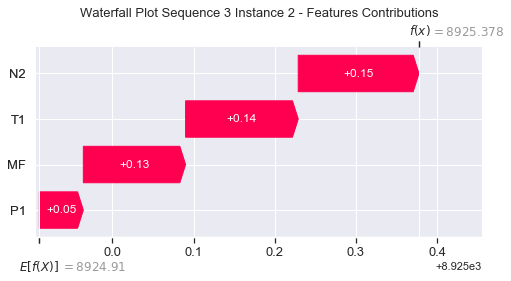

None

Contribution: [0.25997504 0.29667521 0.88337151 0.79984129]


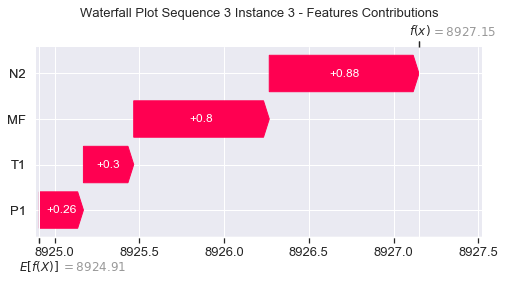

None

Contribution: [0.32573981 0.22962181 1.11103569 1.01453655]


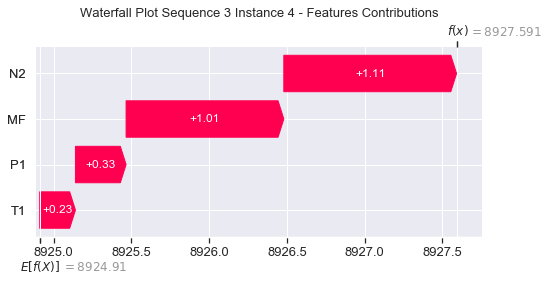

None

Contribution: [0.27415243 0.20850938 0.92778361 0.83999607]


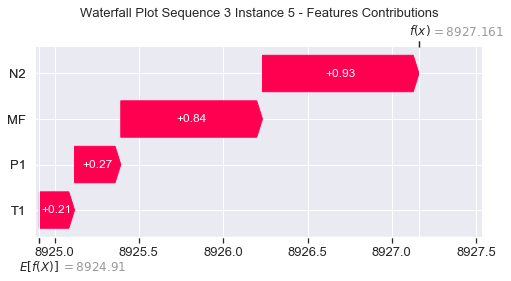

None

Contribution: [0.24789723 0.19735178 0.84206997 0.76130759]


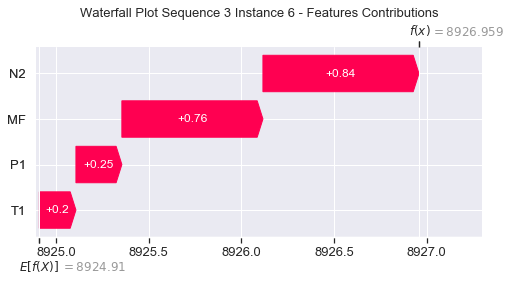

None

Contribution: [0.23746762 0.18957912 0.80806937 0.73041209]


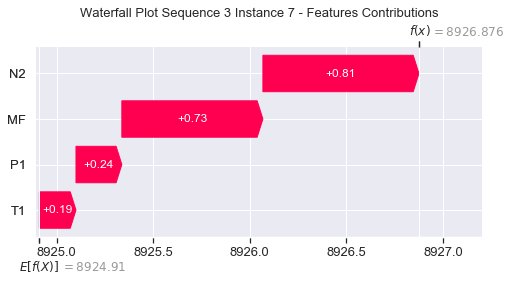

None

Contribution: [0.23360138 0.18767416 0.79447259 0.71800073]


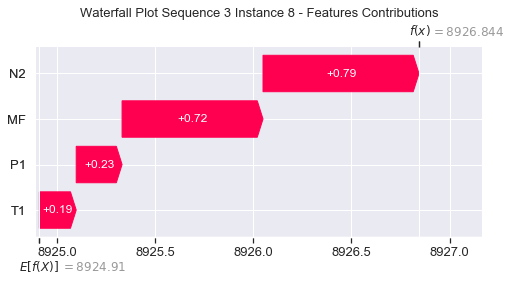

None

Contribution: [0.23406799 0.20002647 0.79754709 0.71675554]


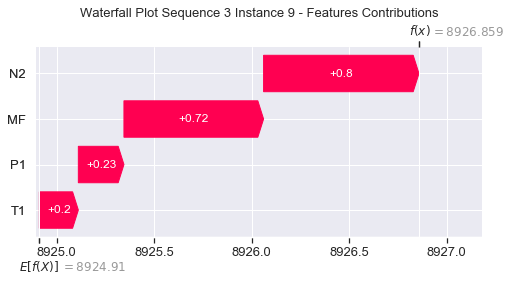

None

Contribution: [0.24058623 0.21812641 0.8134164  0.73666482]


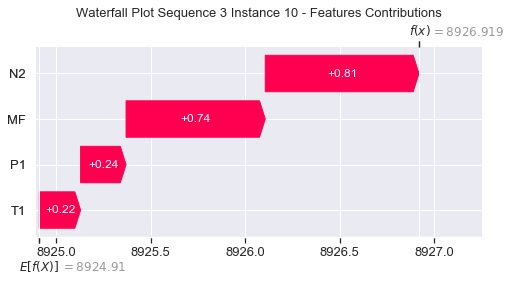

None

Contribution: [0.24820911 0.21502317 0.83999886 0.75596147]


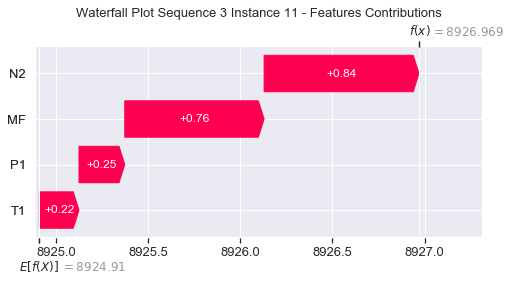

None

Contribution: [0.2583227  0.20865051 0.87586624 0.79190752]


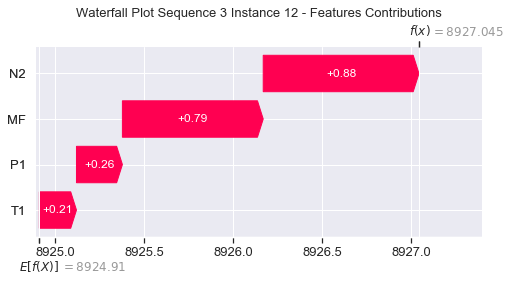

None

Contribution: [0.27503381 0.22198656 0.93500875 0.84522868]


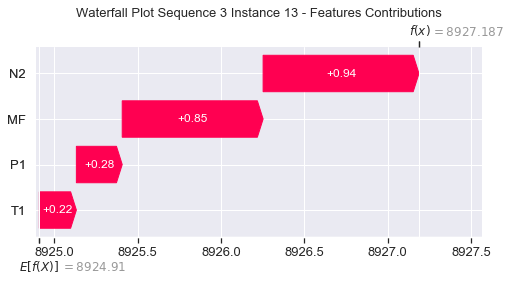

None

Contribution: [0.29034624 0.24863763 1.01124307 0.913006  ]


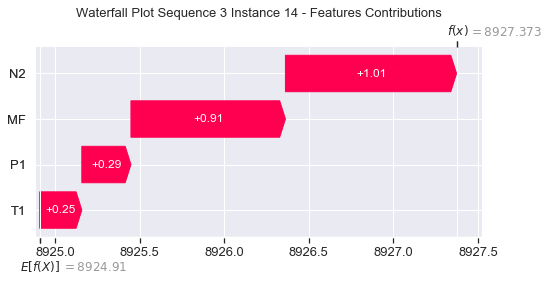

None

Contribution: [0.3267845  0.26592653 1.11572889 1.00944498]


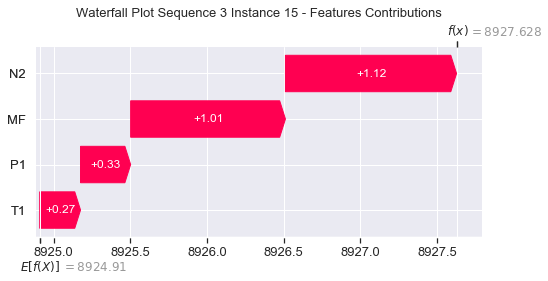

None

Contribution: [0.37467286 0.30466075 1.25923641 1.15732747]


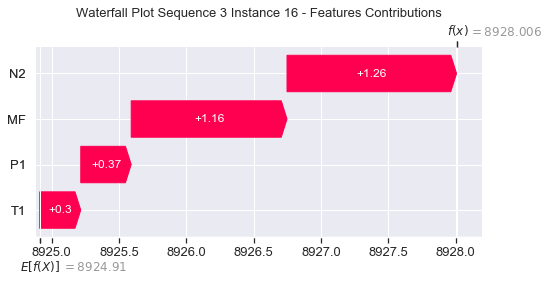

None

Contribution: [0.42462936 0.34458538 1.45058318 1.31257922]


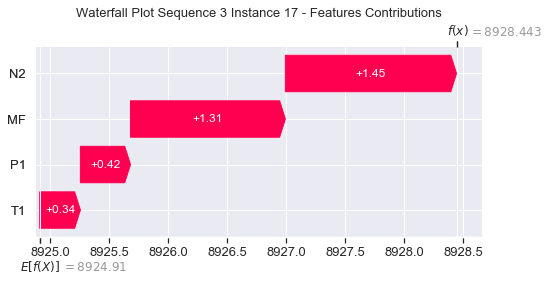

None

Contribution: [0.50302746 0.40602476 1.71634879 1.55394143]


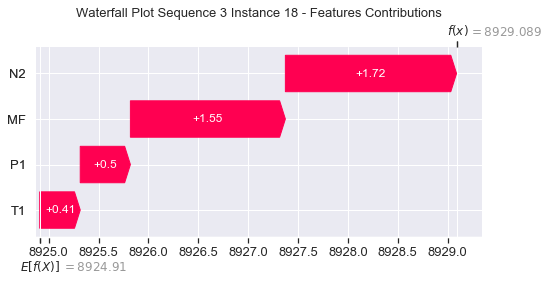

None

Contribution: [0.62364162 0.47778189 2.09717881 1.89768991]


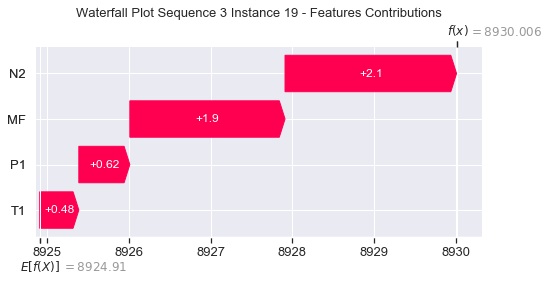

None

Contribution: [0.77700389 0.60765247 2.64600969 2.39873926]


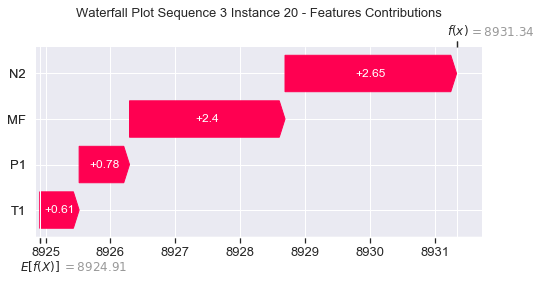

None

Contribution: [1.02251433 0.77893671 3.47185998 3.15014731]


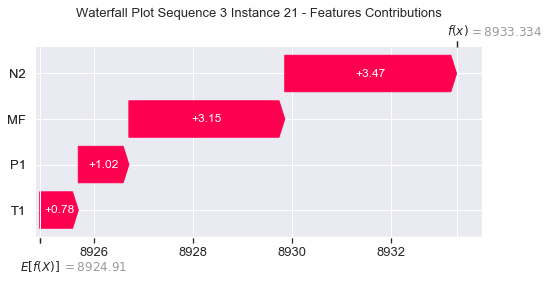

None

Contribution: [1.39835543 0.99145524 4.76082307 4.32892778]


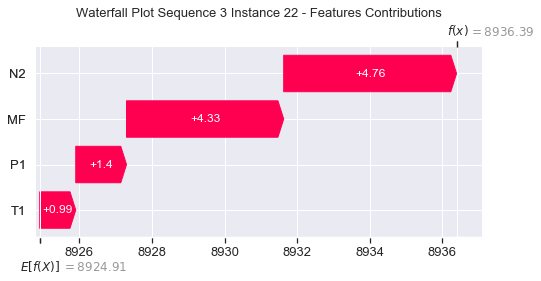

None

Contribution: [1.91035091 0.97431775 6.7743294  6.19277368]


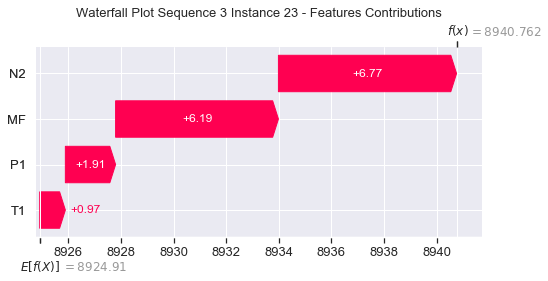

None

Contribution: [ 2.20328779 -2.32428543  9.41953008  8.64611354]


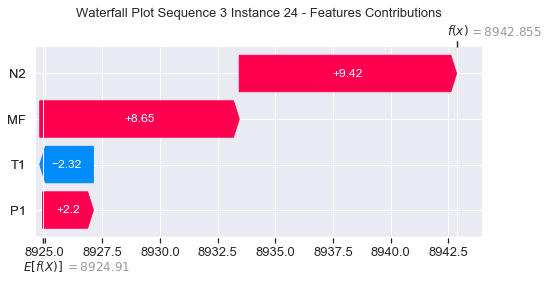

None

Contribution: [ 4.80701766  1.33673908 17.23742007 15.17627214]


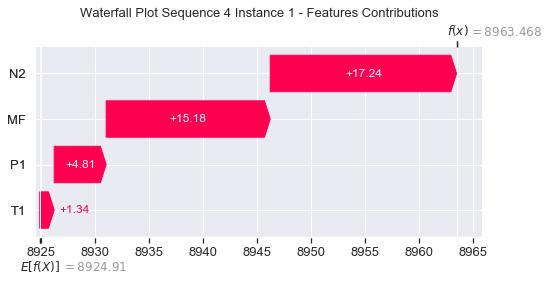

None

Contribution: [0.05283077 0.14366714 0.14778533 0.12442215]


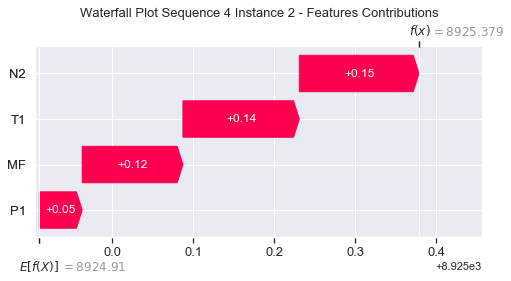

None

Contribution: [0.26191908 0.29845314 0.89282008 0.80962077]


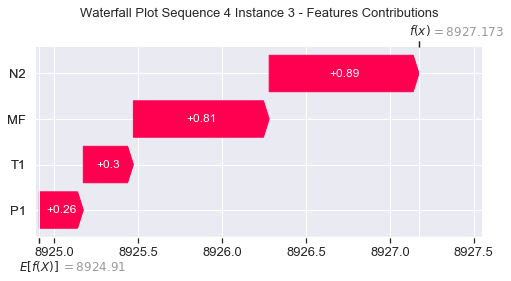

None

Contribution: [0.32893094 0.23995911 1.11261773 1.01536451]


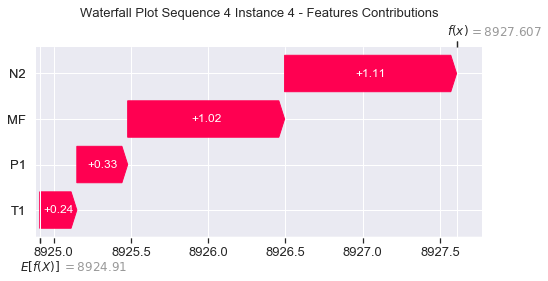

None

Contribution: [0.27628326 0.20224163 0.93033387 0.84486443]


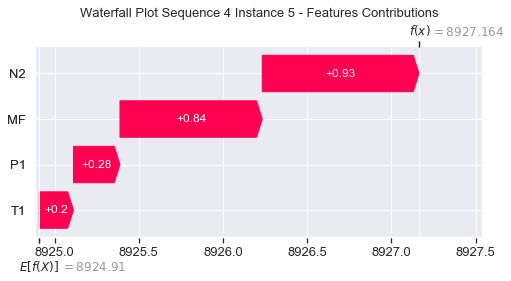

None

Contribution: [0.25117046 0.18454367 0.84486062 0.76997471]


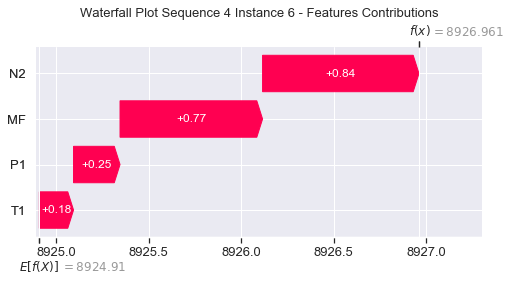

None

Contribution: [0.24111334 0.17830595 0.81086153 0.73817282]


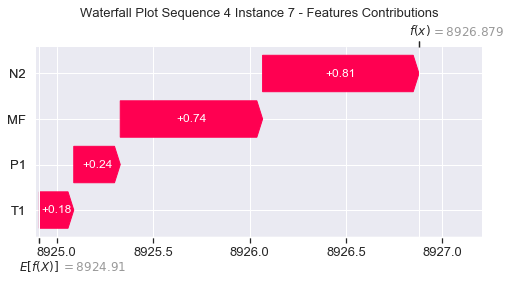

None

Contribution: [0.23597868 0.17564956 0.79736791 0.72663245]


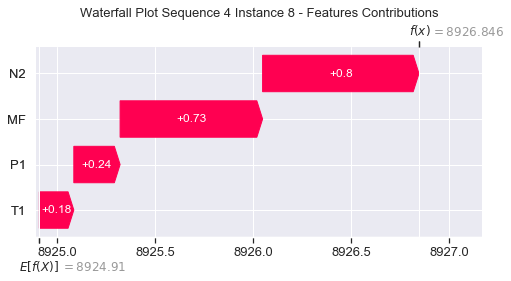

None

Contribution: [0.23337198 0.18405431 0.80138116 0.73249229]


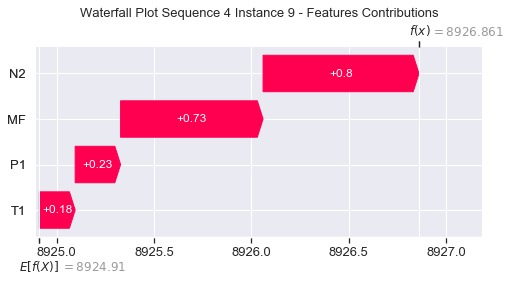

None

Contribution: [0.24313804 0.17889917 0.81566353 0.74683897]


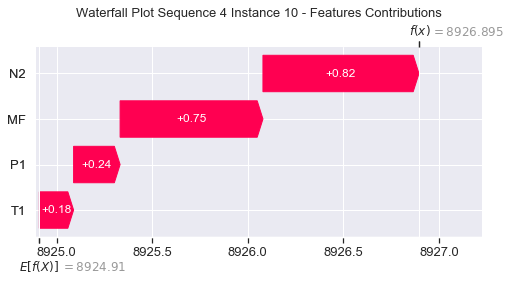

None

Contribution: [0.24445041 0.1912958  0.84342604 0.77273339]


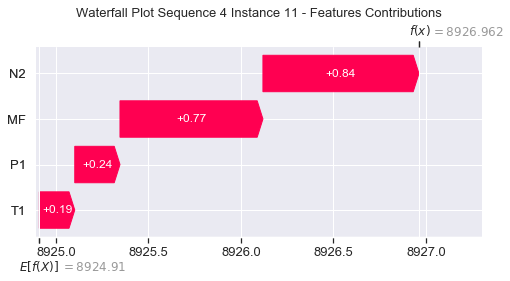

None

Contribution: [0.25849293 0.19662496 0.87819921 0.79733916]


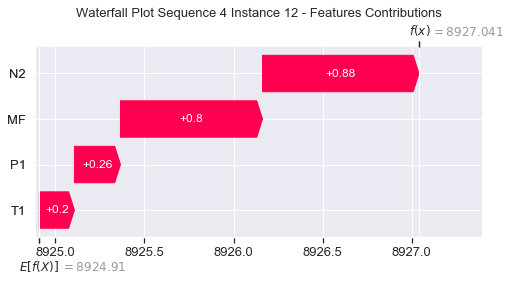

None

Contribution: [0.27587637 0.21048889 0.93760941 0.85121006]


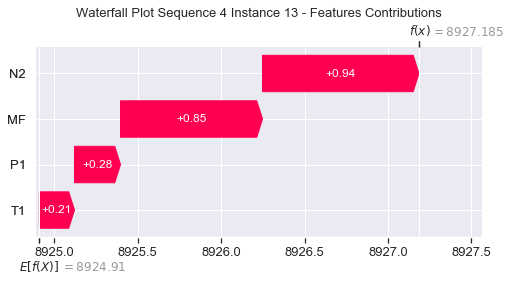

None

Contribution: [0.29574443 0.23421123 1.01574634 0.93541003]


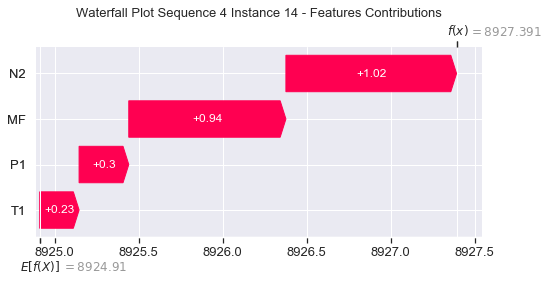

None

Contribution: [0.32883632 0.2505053  1.11923485 1.01891026]


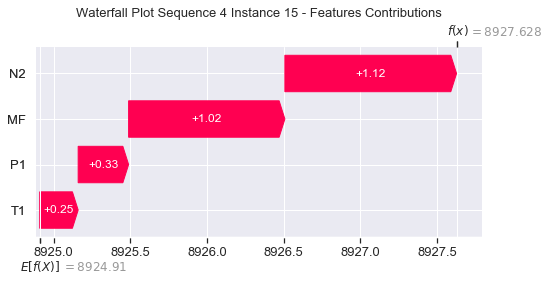

None

Contribution: [0.36657314 0.28806953 1.25982947 1.14732602]


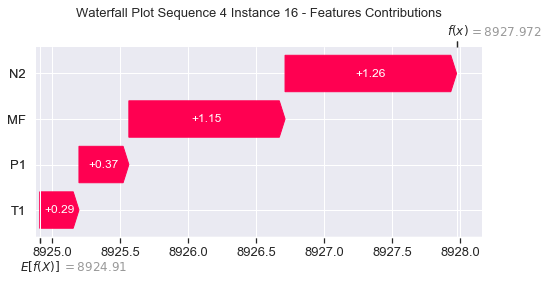

None

Contribution: [0.42781477 0.32536147 1.45413557 1.32501278]


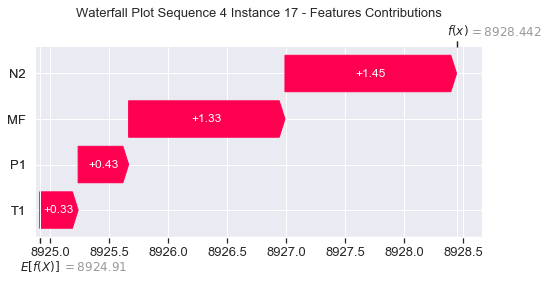

None

Contribution: [0.50652545 0.3821678  1.72013838 1.56948024]


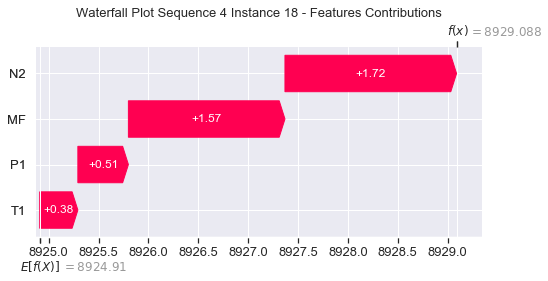

None

Contribution: [0.62722787 0.47731822 2.09665334 1.88592894]


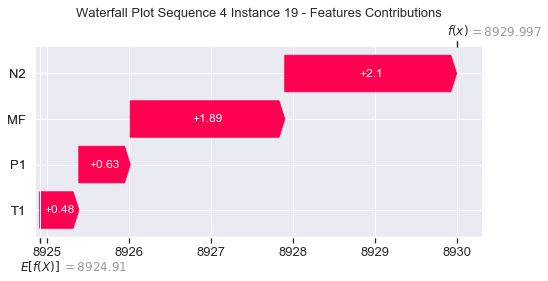

None

Contribution: [0.78248101 0.5795706  2.65048275 2.41999336]


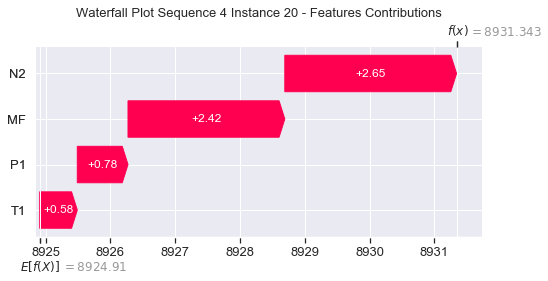

None

Contribution: [1.02592531 0.74504651 3.47685614 3.17547576]


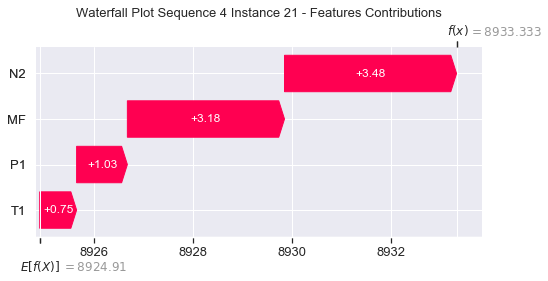

None

Contribution: [1.39767412 0.94314612 4.7659145  4.36067833]


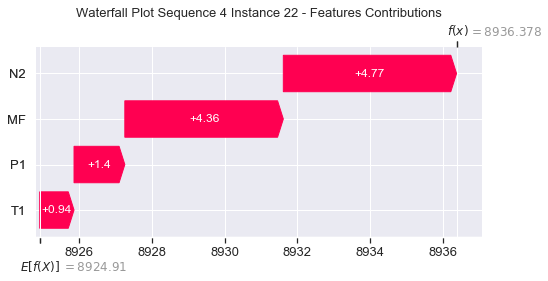

None

Contribution: [1.90736759 0.85280975 6.78130884 6.2638305 ]


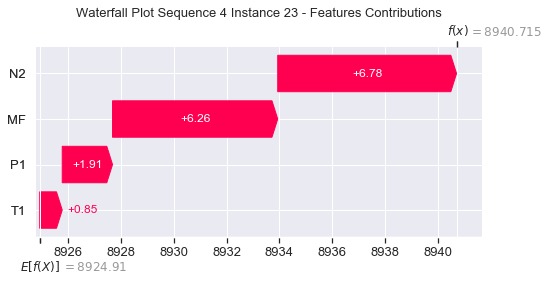

None

Contribution: [ 2.13653674 -2.70954883  9.46187412  9.04738341]


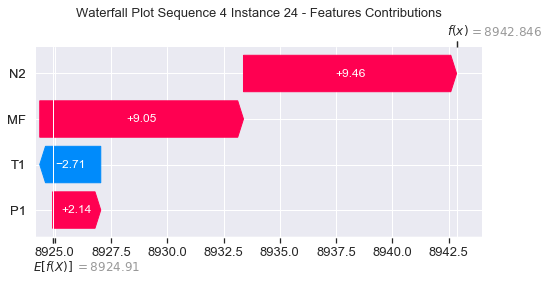

None

Contribution: [ 4.54195513  1.18521227 17.19523412 15.70781971]


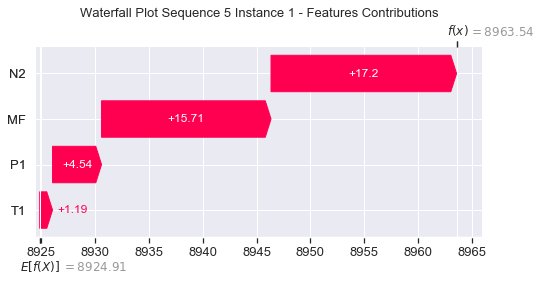

None

Contribution: [0.05388908 0.14313081 0.14735472 0.12367629]


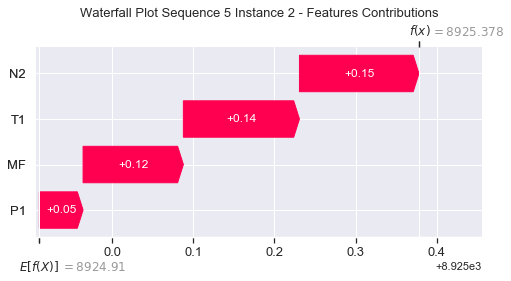

None

Contribution: [0.25869367 0.29577265 0.88140799 0.80125648]


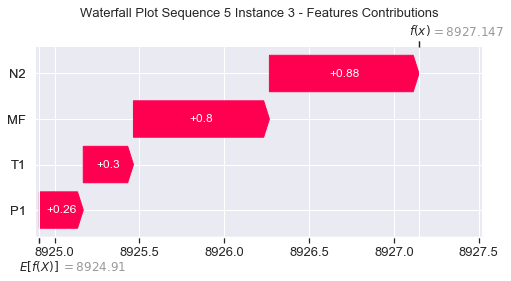

None

Contribution: [0.3190257  0.23817337 1.10530337 1.01313956]


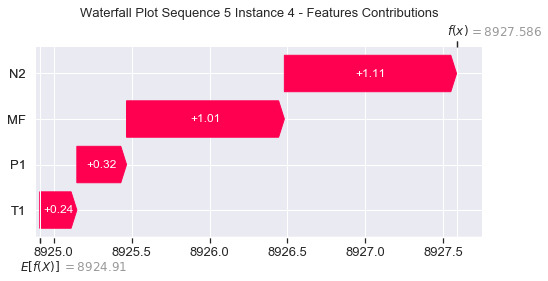

None

Contribution: [0.26903255 0.20370725 0.92401293 0.8446313 ]


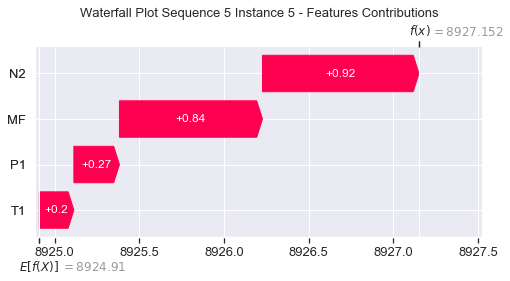

None

Contribution: [0.2452977  0.19274884 0.83872546 0.76758909]


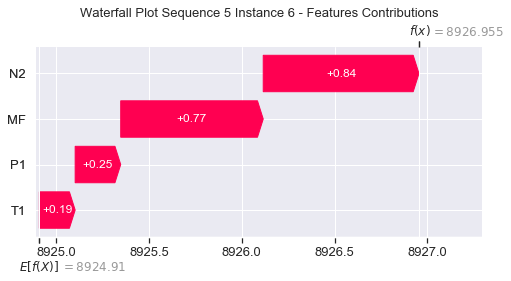

None

Contribution: [0.23514853 0.18497104 0.80464119 0.73579894]


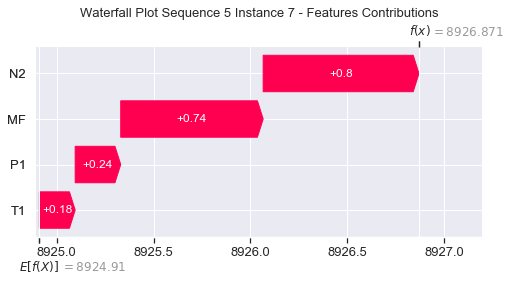

None

Contribution: [0.23114075 0.18365621 0.79118407 0.72324457]


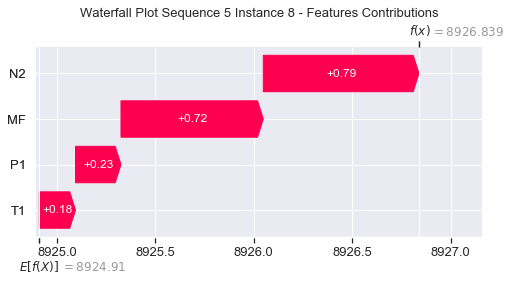

None

Contribution: [0.23202262 0.19180843 0.7935208  0.72357464]


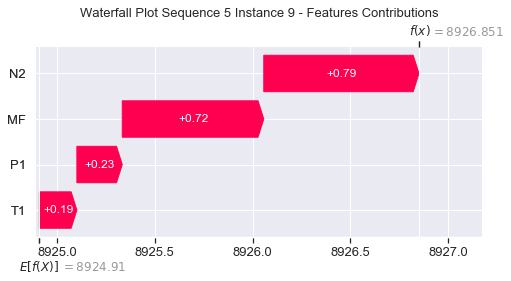

None

Contribution: [0.23175752 0.19491183 0.80767771 0.73527289]


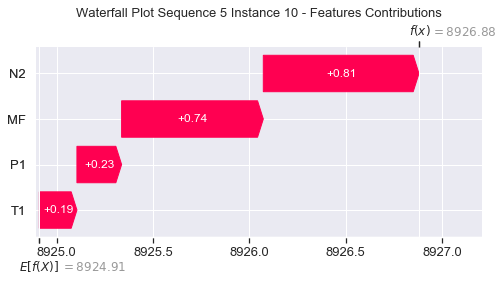

None

Contribution: [0.24367983 0.2094723  0.83561881 0.76101348]


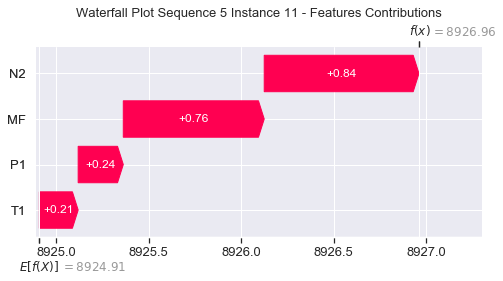

None

Contribution: [0.2531307  0.20777863 0.87117616 0.79257348]


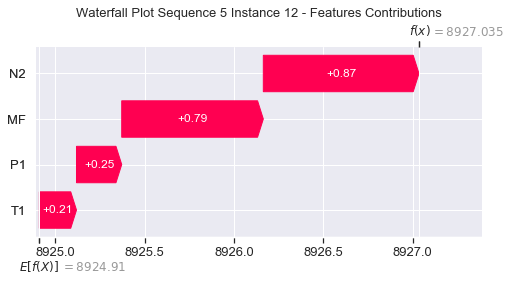

None

Contribution: [0.2702774  0.22084549 0.92975828 0.84601475]


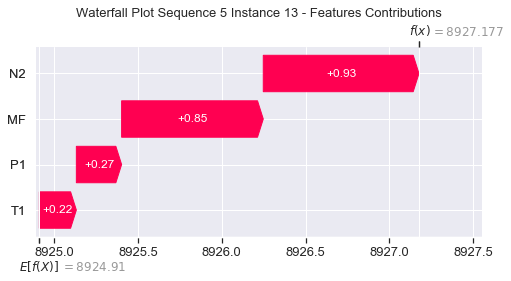

None

Contribution: [0.29651257 0.24177568 1.00835908 0.9239517 ]


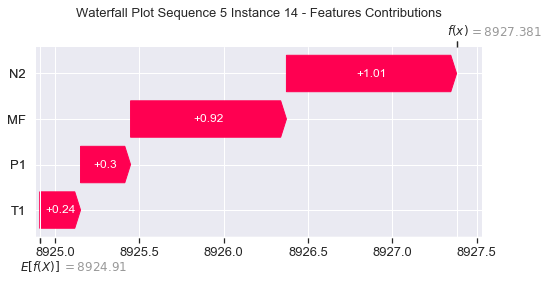

None

Contribution: [0.32372846 0.2675786  1.10973702 1.01166168]


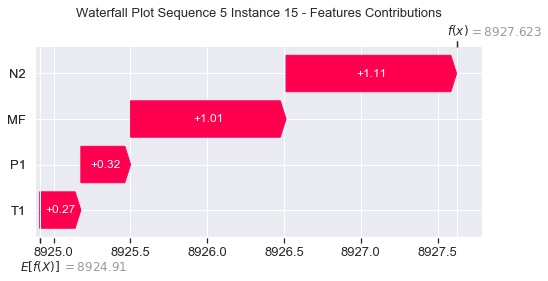

None

Contribution: [0.37281962 0.29865573 1.25533895 1.1806907 ]


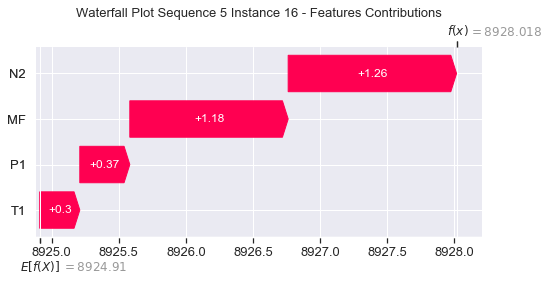

None

Contribution: [0.42319211 0.34818672 1.44323278 1.31517533]


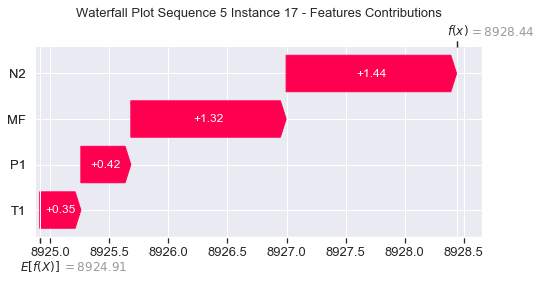

None

Contribution: [0.50275288 0.41274501 1.70821106 1.55728169]


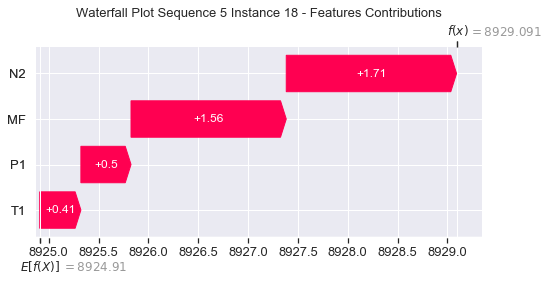

None

Contribution: [0.61759967 0.48566619 2.07897691 1.89289268]


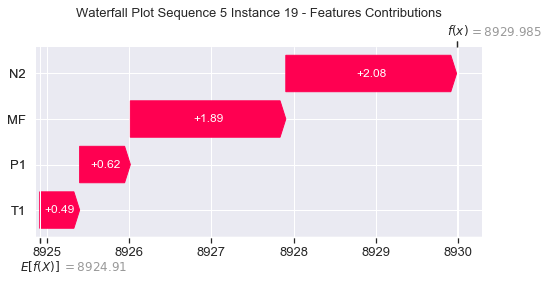

None

Contribution: [0.77996913 0.62320252 2.63382854 2.40192254]


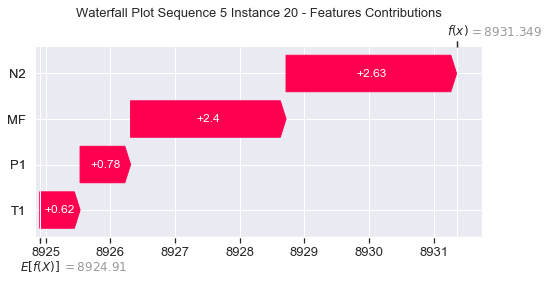

None

Contribution: [1.02505638 0.80488281 3.45820036 3.15251545]


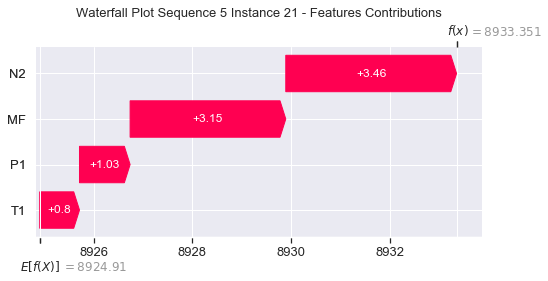

None

Contribution: [1.40049792 1.04247707 4.74605854 4.33051786]


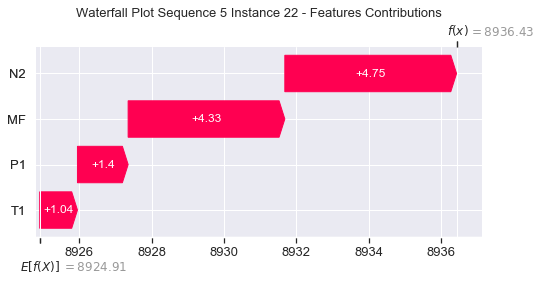

None

Contribution: [1.92591299 1.08780299 6.75933685 6.21293145]


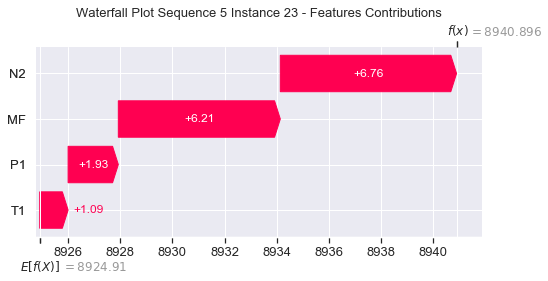

None

Contribution: [ 2.29078938 -1.86496005  9.44363248  8.94464318]


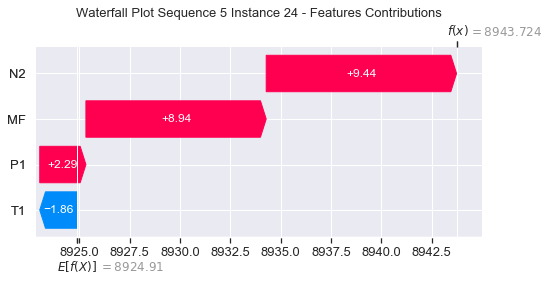

None

Contribution: [ 4.83263855  1.70585039 17.22094276 15.74460775]


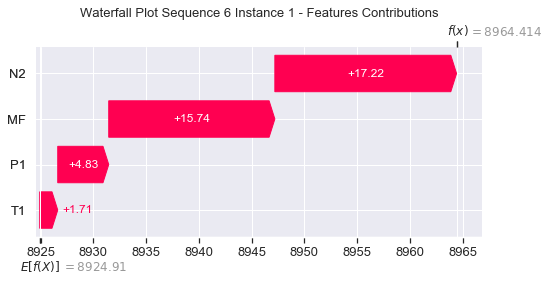

None

Contribution: [0.05185875 0.13438687 0.14440014 0.12218821]


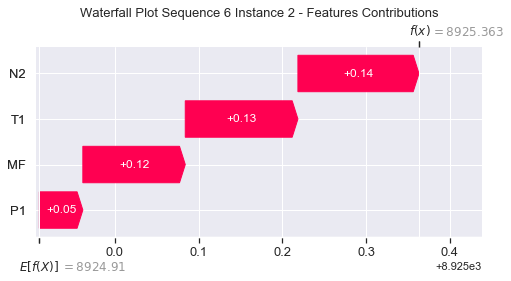

None

Contribution: [0.26079409 0.30036776 0.88706741 0.80508184]


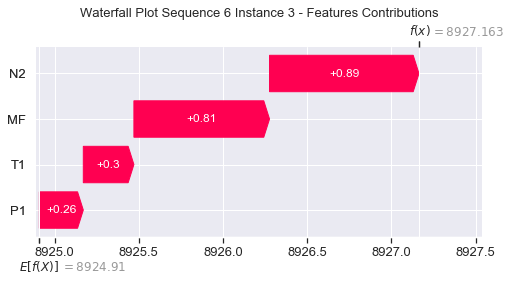

None

Contribution: [0.32874004 0.25482917 1.12504432 1.020603  ]


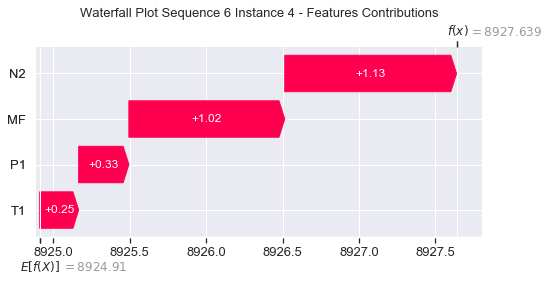

None

Contribution: [0.2778744  0.22829834 0.9410916  0.85471867]


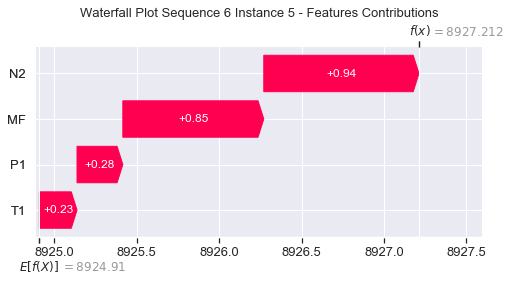

None

Contribution: [0.25259918 0.20185427 0.85377671 0.77579268]


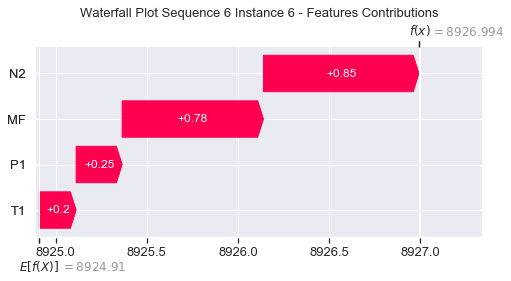

None

Contribution: [0.24248195 0.19180241 0.8189965  0.74436105]


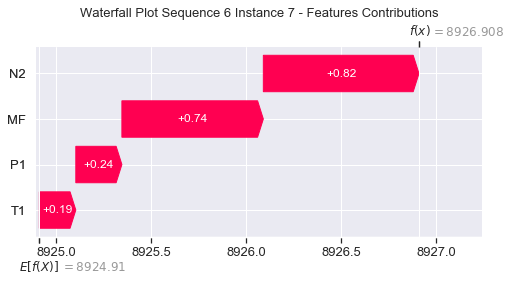

None

Contribution: [0.23770317 0.18700761 0.80569479 0.73082372]


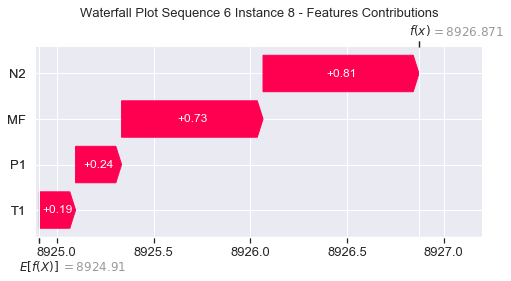

None

Contribution: [0.23877932 0.18550777 0.80839432 0.72841284]


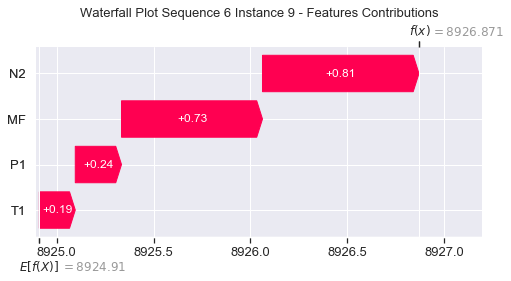

None

Contribution: [0.2398372  0.19433816 0.82382958 0.75146097]


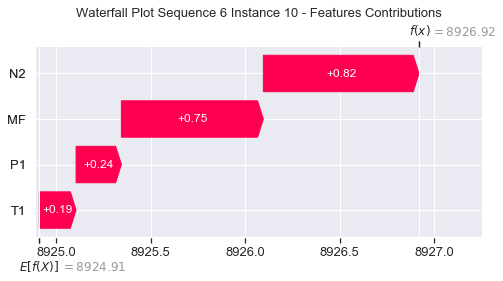

None

Contribution: [0.24974988 0.19374408 0.8517325  0.76529342]


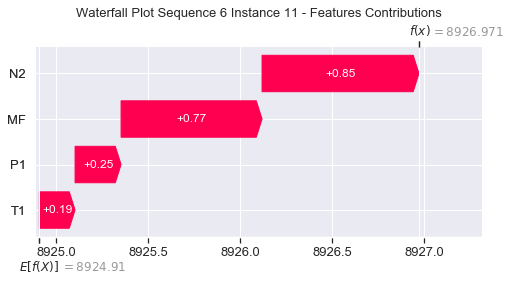

None

Contribution: [0.26034156 0.19628694 0.88535538 0.80148359]


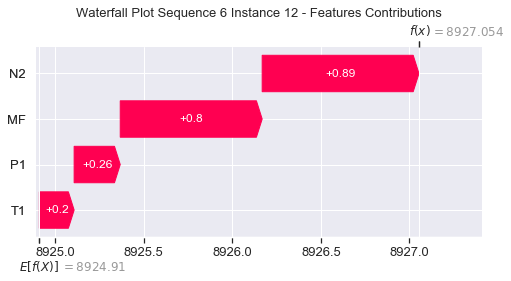

None

Contribution: [0.27786771 0.20884932 0.94596742 0.85639765]


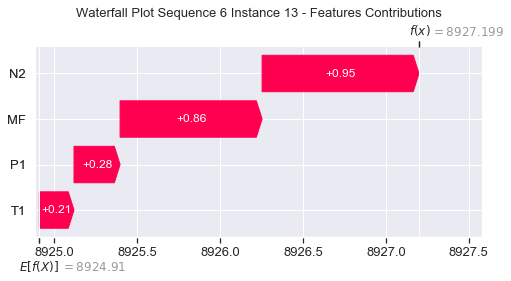

None

Contribution: [0.30054153 0.23530889 1.0219204  0.92943075]


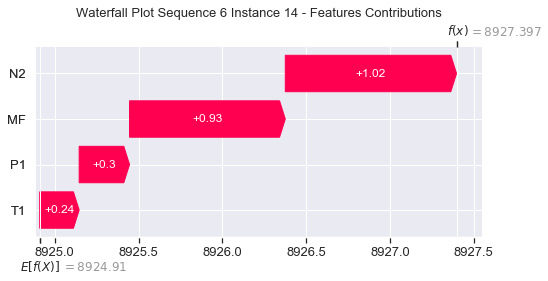

None

Contribution: [0.33157876 0.24535302 1.13059707 1.02324104]


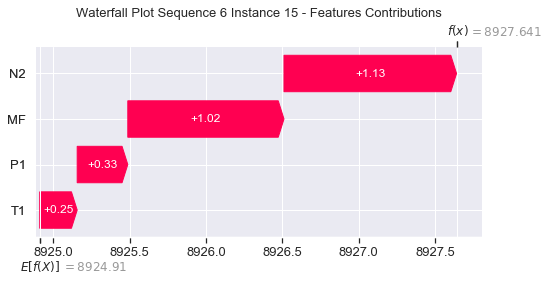

None

Contribution: [0.37415641 0.2598964  1.2718078  1.14450313]


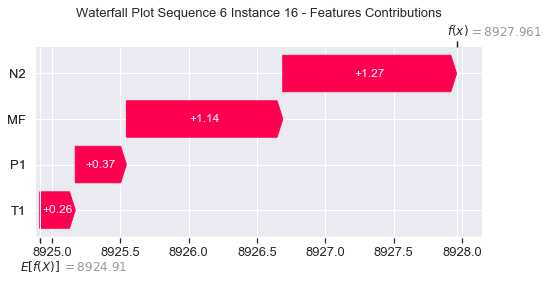

None

Contribution: [0.43091912 0.30521164 1.46887606 1.32962645]


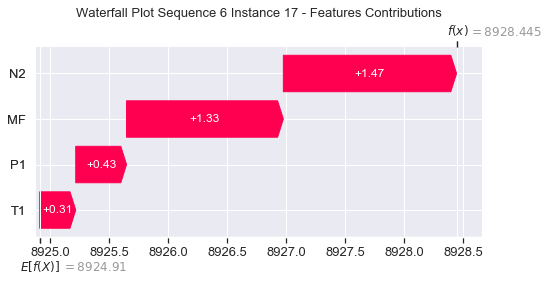

None

Contribution: [0.50960228 0.35327173 1.73801707 1.57286207]


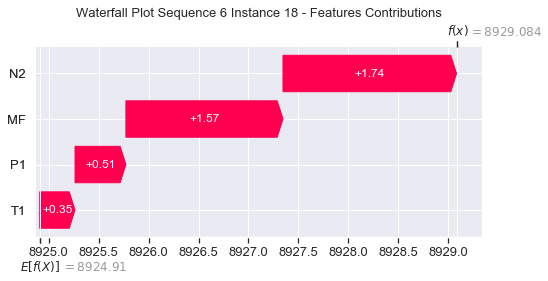

None

Contribution: [0.6269985  0.41542499 2.1242284  1.9144152 ]


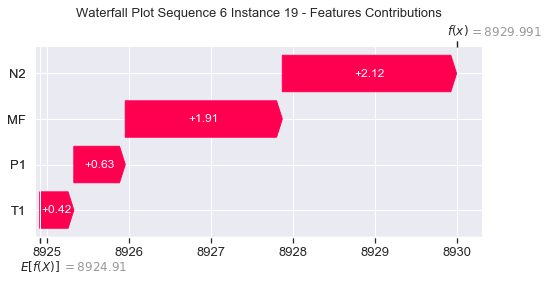

None

Contribution: [0.78572846 0.5241555  2.67879487 2.42364892]


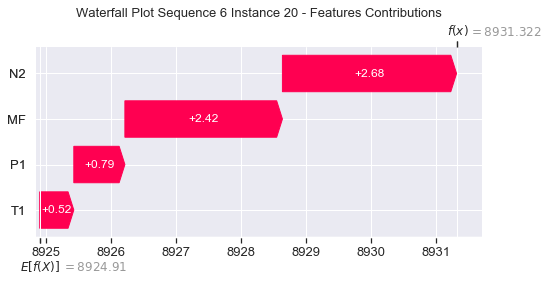

None

Contribution: [1.02939314 0.6657076  3.50909956 3.17417317]


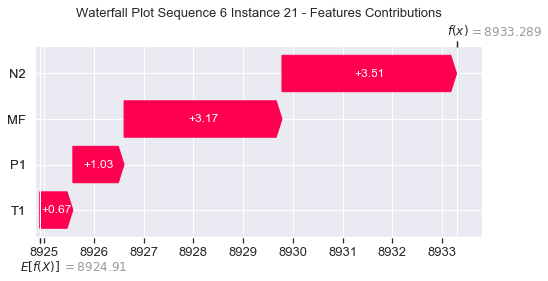

None

Contribution: [1.39917918 0.82158086 4.80500482 4.34676241]


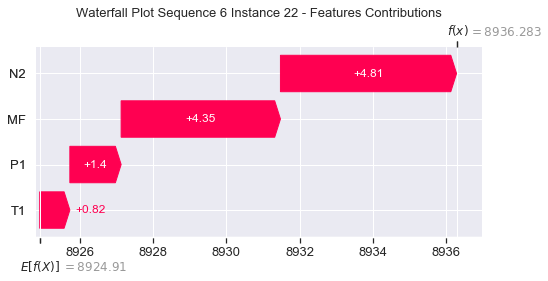

None

Contribution: [1.89723398 0.55434967 6.82762997 6.19417435]


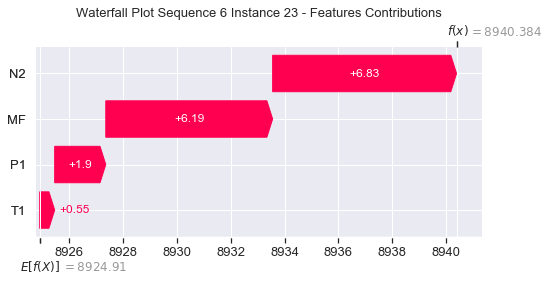

None

Contribution: [ 2.0992512  -3.80071501  9.56294126  8.66920123]


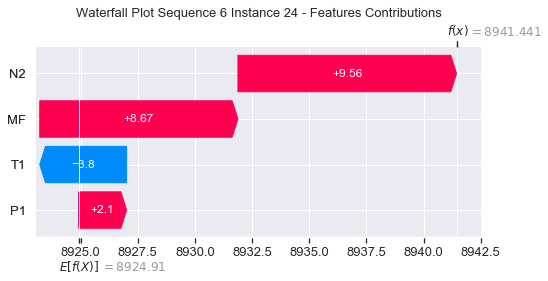

None

Contribution: [ 4.74924851  0.1293619  17.70032622 15.70426962]


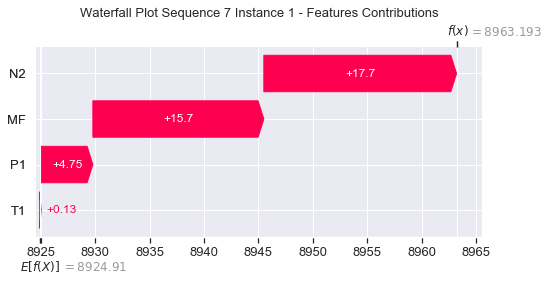

None

Contribution: [0.05864967 0.16483862 0.15927056 0.13741152]


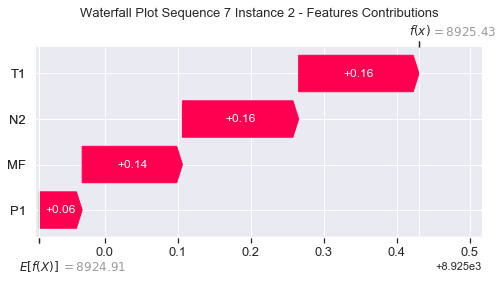

None

Contribution: [0.27203004 0.30343616 0.92608442 0.83909268]


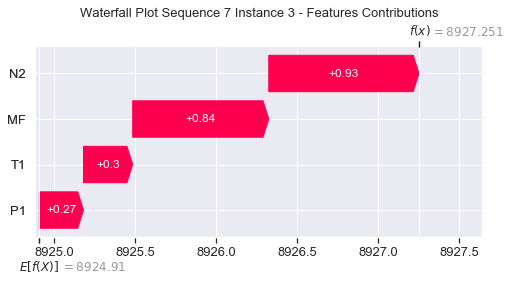

None

Contribution: [0.33038371 0.20613626 1.13213311 1.0371788 ]


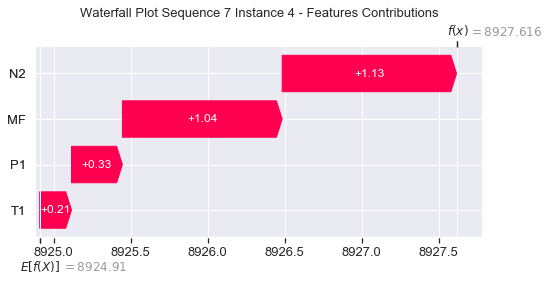

None

Contribution: [0.2796358  0.17943305 0.94532539 0.86465853]


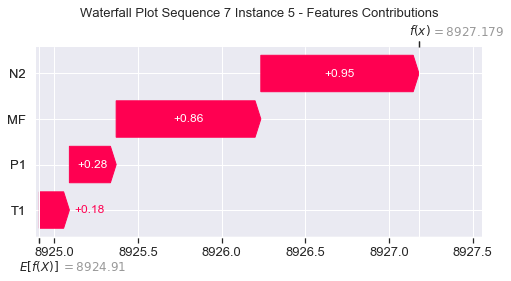

None

Contribution: [0.25168279 0.16143303 0.85646828 0.78097519]


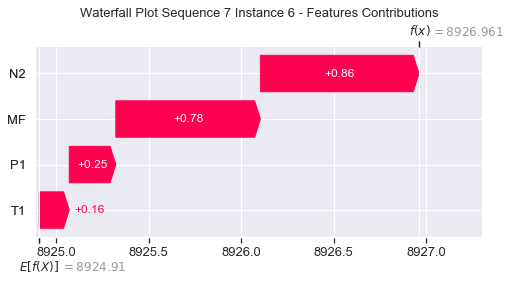

None

Contribution: [0.24049037 0.15716193 0.82204418 0.75082653]


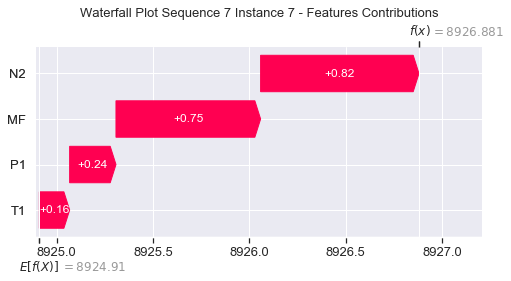

None

Contribution: [0.23672584 0.15522548 0.80832985 0.73662943]


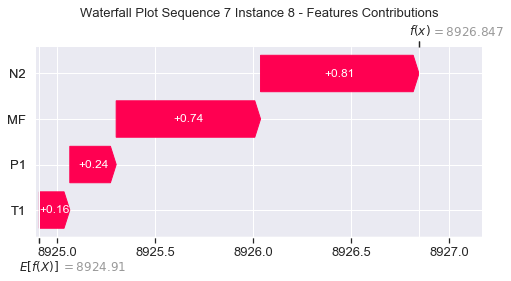

None

Contribution: [0.23644515 0.16925924 0.81050185 0.74045467]


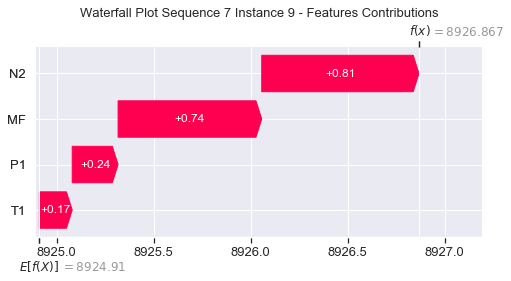

None

Contribution: [0.24380725 0.17730951 0.82690851 0.75615396]


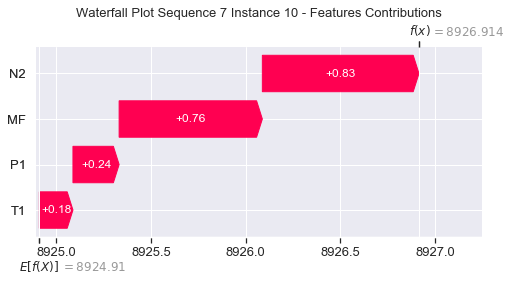

None

Contribution: [0.25028362 0.17201114 0.85269016 0.77085508]


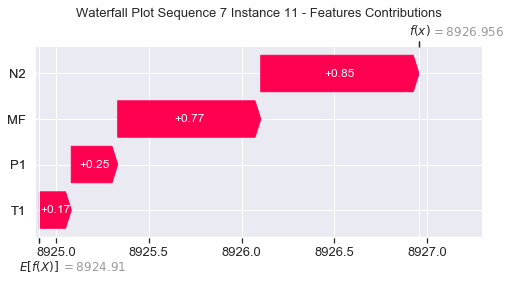

None

Contribution: [0.25814829 0.17431012 0.89087085 0.80860287]


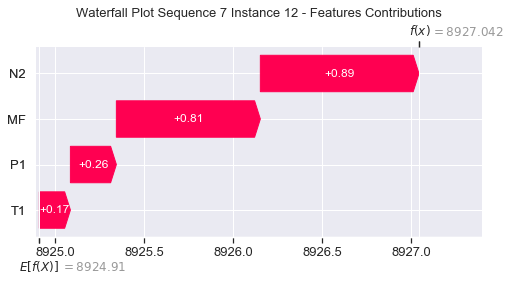

None

Contribution: [0.27521368 0.18770774 0.95133459 0.86434063]


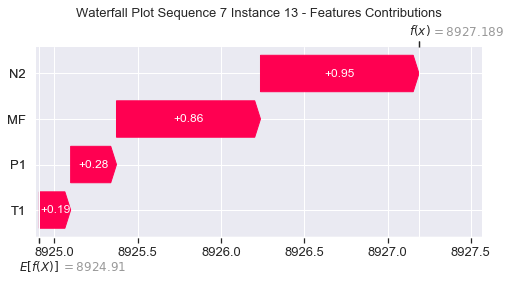

None

Contribution: [0.2963107  0.22060754 1.0283747  0.93511533]


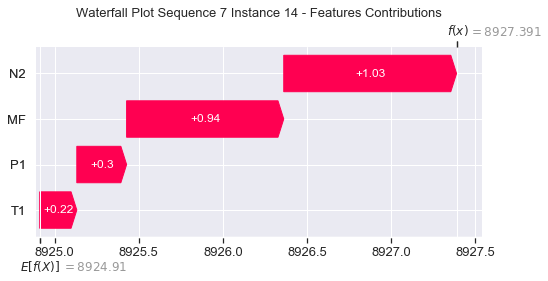

None

Contribution: [0.32817805 0.22267841 1.13516418 1.02960013]


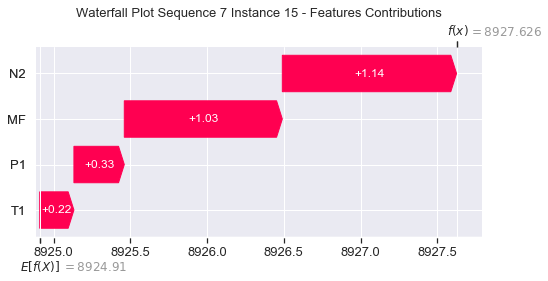

None

Contribution: [0.37945333 0.2456106  1.28054341 1.17222796]


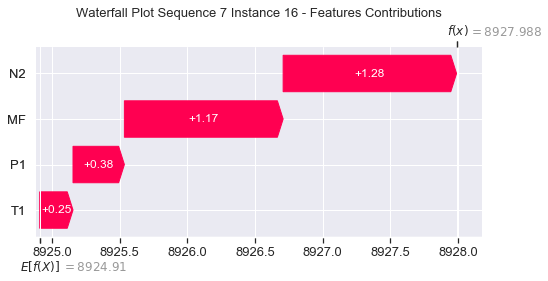

None

Contribution: [0.42461876 0.29156251 1.47340449 1.33627932]


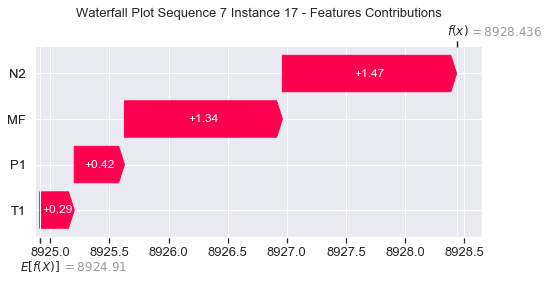

None

Contribution: [0.50288047 0.34174127 1.74136725 1.57635783]


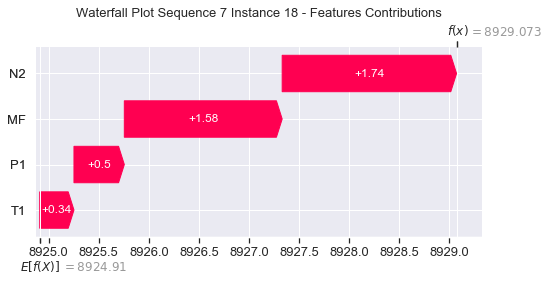

None

Contribution: [0.63347333 0.39884314 2.12839237 1.92868587]


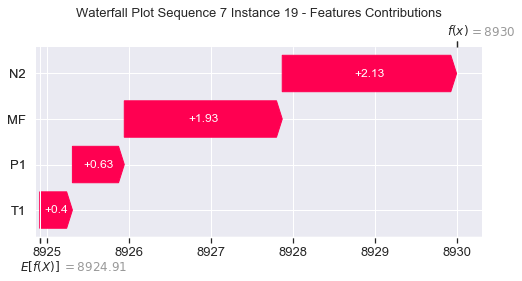

None

Contribution: [0.77715833 0.52199777 2.67929149 2.42667937]


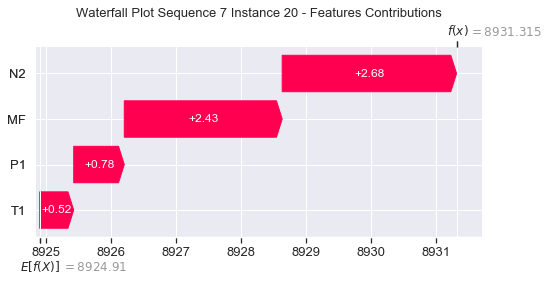

None

Contribution: [1.0195202  0.67010837 3.50982226 3.17668732]


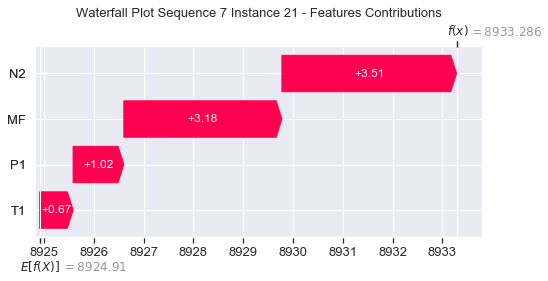

None

Contribution: [1.39118523 0.82815222 4.80492701 4.34430317]


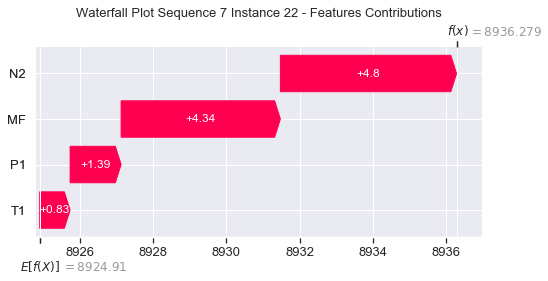

None

Contribution: [1.87962243 0.59751854 6.82028433 6.16581597]


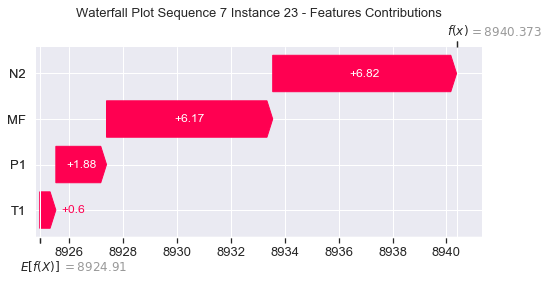

None

Contribution: [ 2.06782108 -3.78728782  9.50330913  8.57441075]


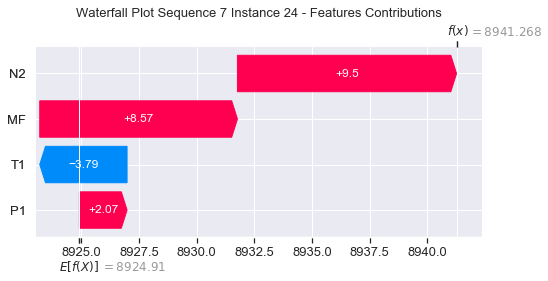

None

Contribution: [ 4.60500712  0.10561379 17.38729449 15.56554559]


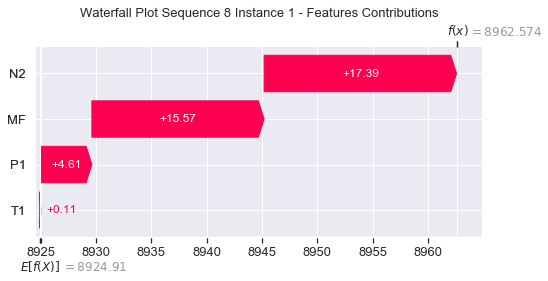

None

Contribution: [0.05744246 0.1573843  0.15413317 0.13317947]


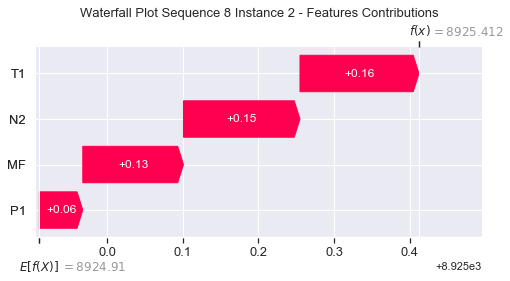

None

Contribution: [0.26423726 0.29497492 0.90304349 0.8194784 ]


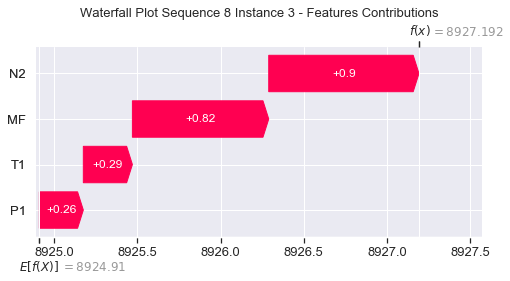

None

Contribution: [0.31701441 0.19899785 1.10769211 1.01796804]


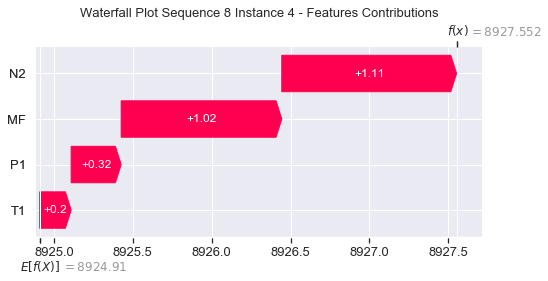

None

Contribution: [0.25330077 0.17053098 0.91703229 0.79337223]


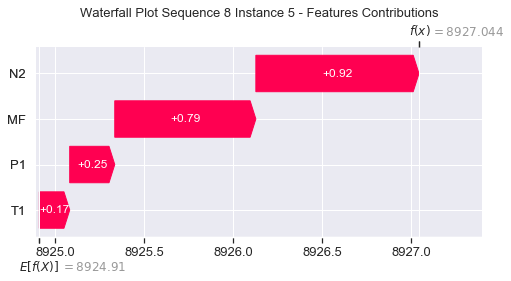

None

Contribution: [0.24192991 0.17423483 0.83617831 0.74623943]


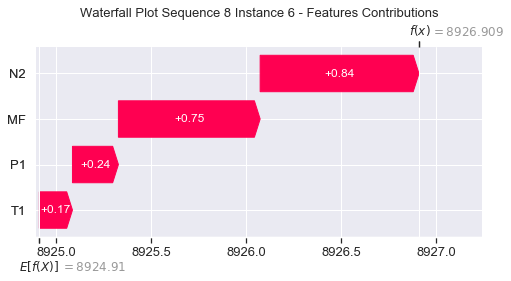

None

Contribution: [0.23146597 0.1670687  0.80255395 0.7181692 ]


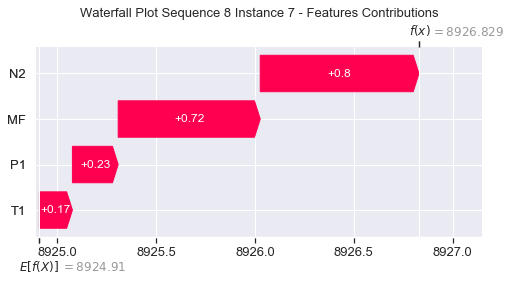

None

Contribution: [0.22729896 0.16829575 0.78895063 0.70648941]


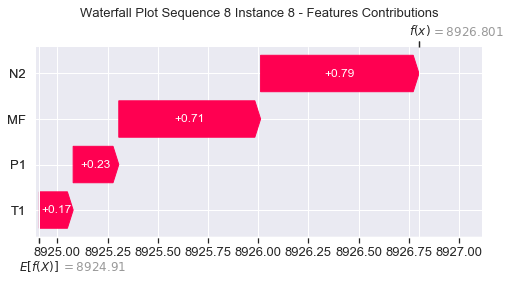

None

Contribution: [0.22299764 0.1633162  0.79477195 0.72544859]


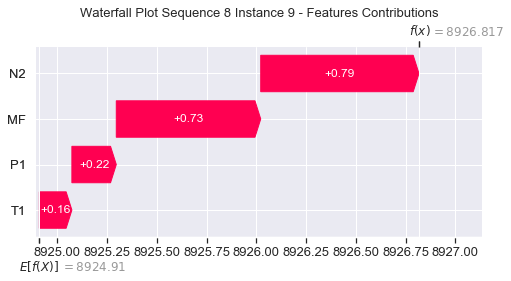

None

Contribution: [0.21324215 0.15773595 0.80682331 0.71628815]


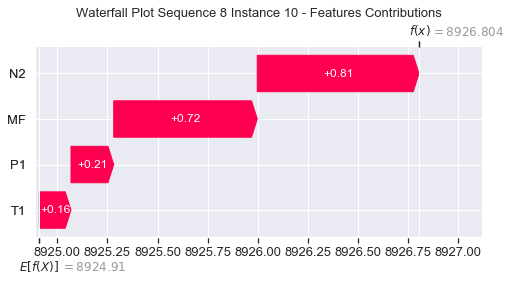

None

Contribution: [0.24401243 0.20173291 0.83669109 0.77113643]


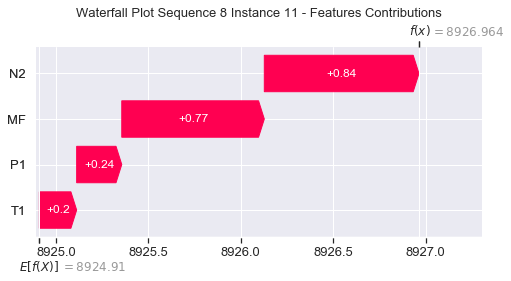

None

Contribution: [0.25728261 0.22143724 0.86888649 0.79059883]


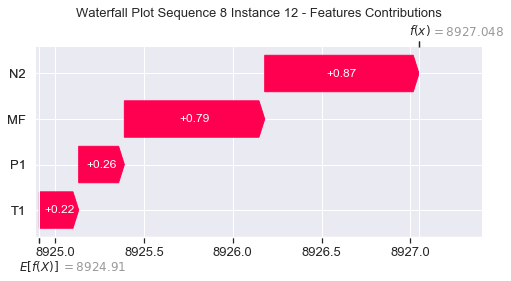

None

Contribution: [0.27179977 0.2306657  0.9263948  0.8398101 ]


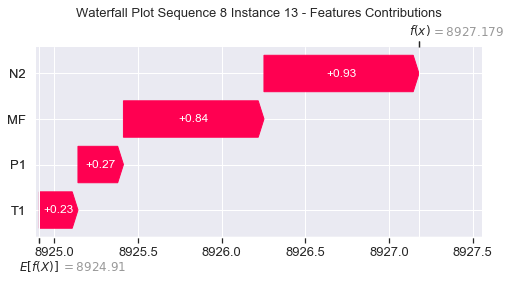

None

Contribution: [0.2953173  0.24906891 1.0024493  0.92169082]


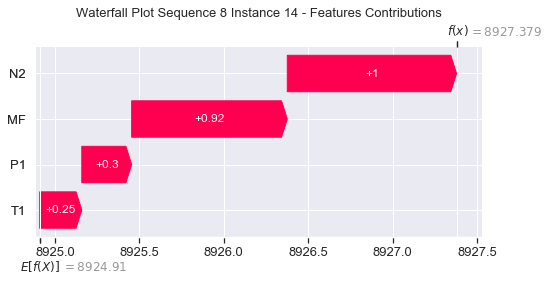

None

Contribution: [0.32824896 0.27787216 1.10556312 1.0073592 ]


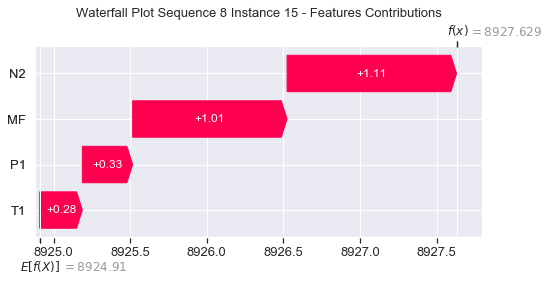

None

Contribution: [0.36985028 0.30665736 1.24634135 1.15040869]


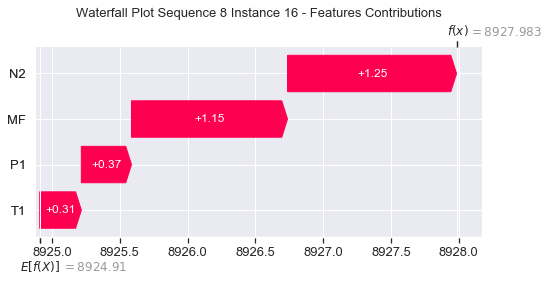

None

Contribution: [0.42857697 0.36732228 1.43711921 1.31582228]


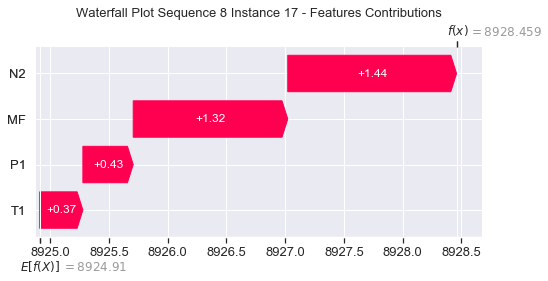

None

Contribution: [0.51168968 0.44219153 1.70166628 1.56083541]


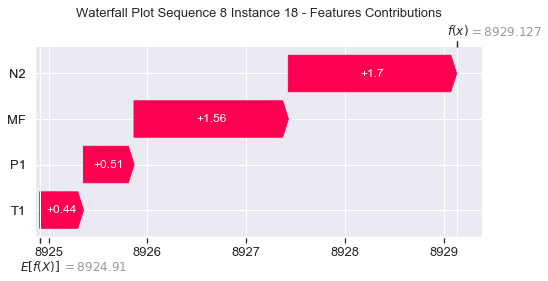

None

Contribution: [0.62479087 0.49721793 2.07870656 1.88368116]


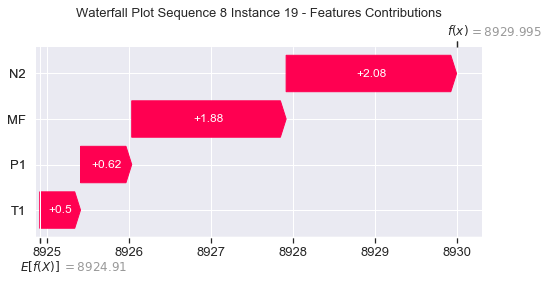

None

Contribution: [0.78062484 0.65159669 2.62442756 2.38612142]


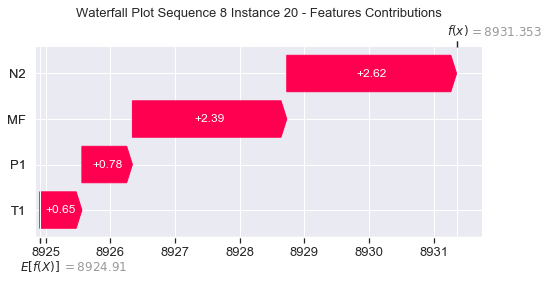

None

Contribution: [1.02746316 0.86131593 3.44631961 3.13131614]


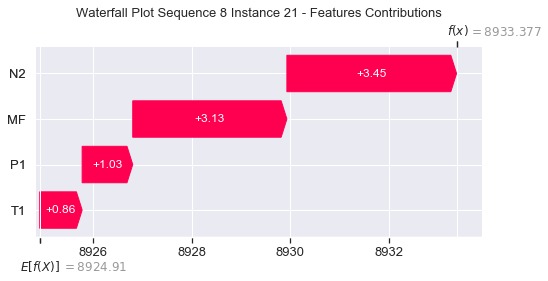

None

Contribution: [1.4081207  1.1456733  4.73206517 4.29056172]


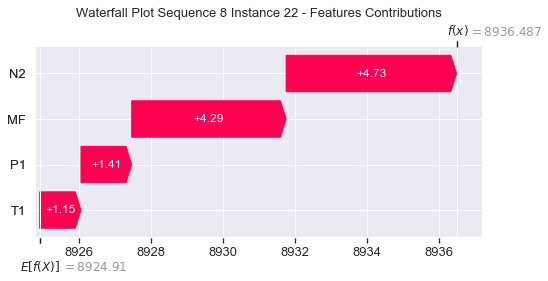

None

Contribution: [1.99222179 1.38352511 6.76764306 6.23861423]


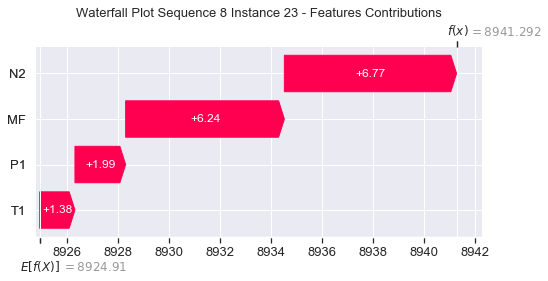

None

Contribution: [ 2.40550546 -1.05674334  9.49502012  8.66539147]


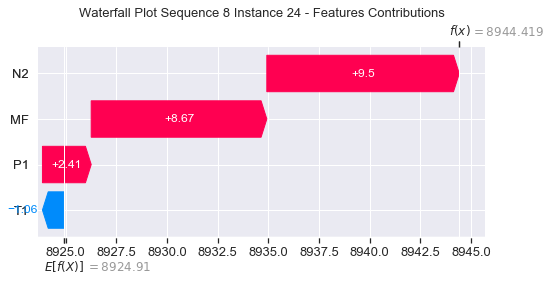

None

Contribution: [ 4.72178715  2.1983905  16.93204938 15.02516331]


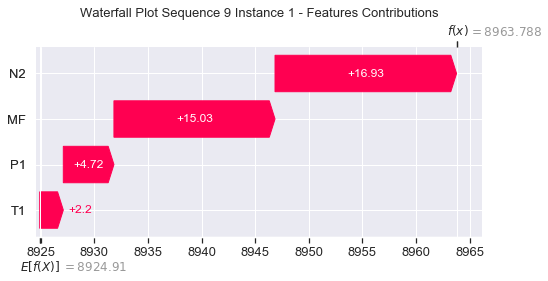

None

Contribution: [0.04807471 0.11700888 0.13506272 0.11573612]


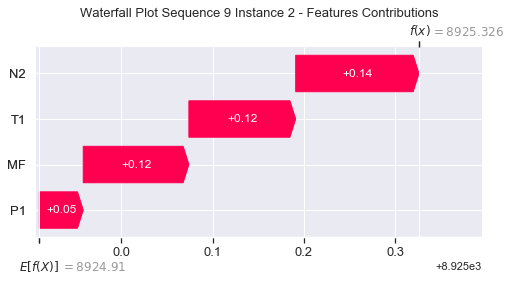

None

Contribution: [0.25365832 0.29237679 0.85752802 0.77545799]


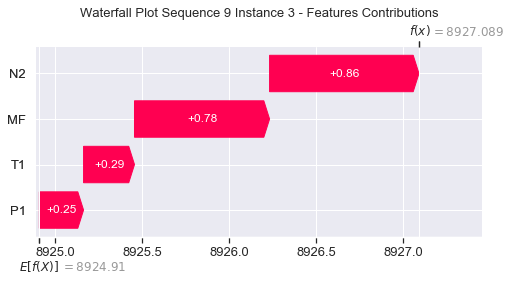

None

Contribution: [0.31604314 0.28365049 1.09032209 0.98759282]


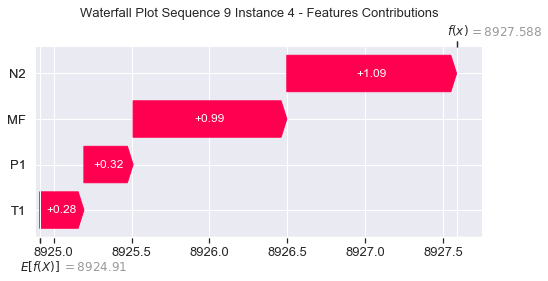

None

Contribution: [0.27021681 0.23733275 0.91470688 0.83656662]


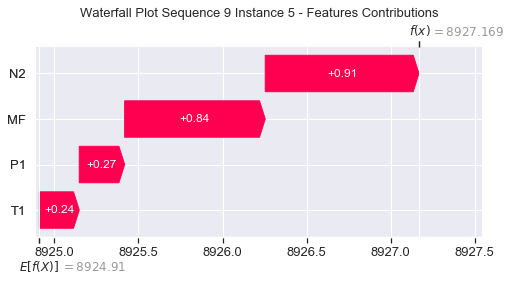

None

Contribution: [0.24479207 0.21325232 0.82998507 0.75531964]


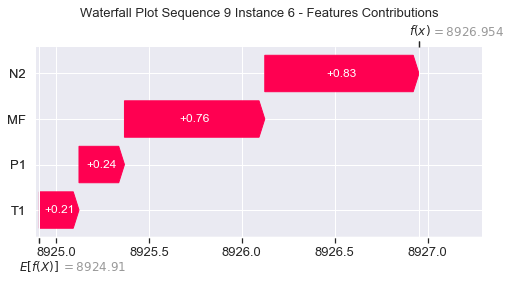

None

Contribution: [0.23512526 0.20499081 0.79643389 0.72324873]


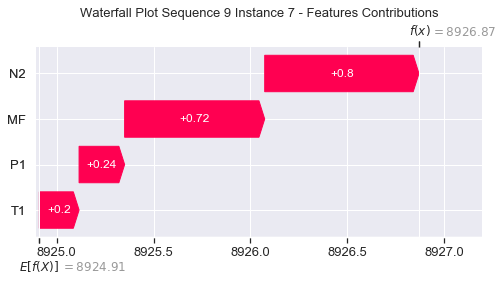

None

Contribution: [0.23205146 0.20226812 0.78332981 0.71302482]


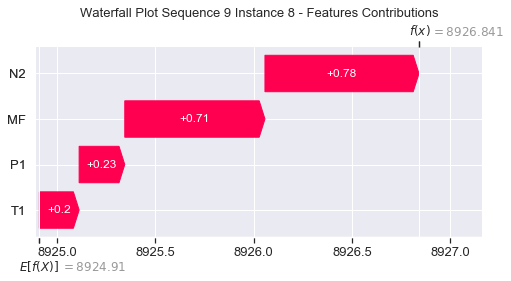

None

Contribution: [0.23809045 0.21266205 0.78629246 0.7140051 ]


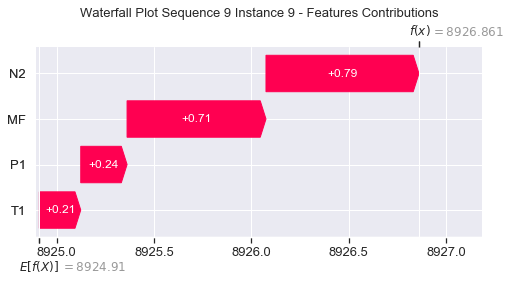

None

Contribution: [0.23840358 0.21686333 0.80174831 0.74379166]


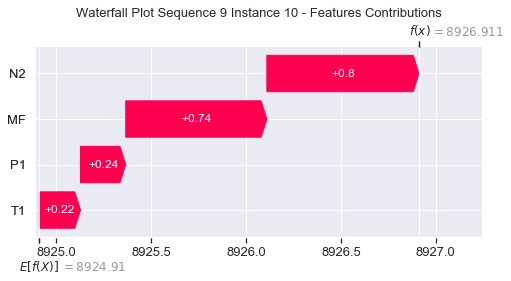

None

Contribution: [0.24953796 0.22309756 0.82833565 0.75546285]


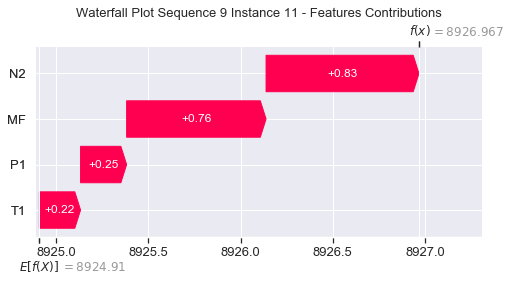

None

Contribution: [0.25567456 0.21984688 0.86377376 0.7842689 ]


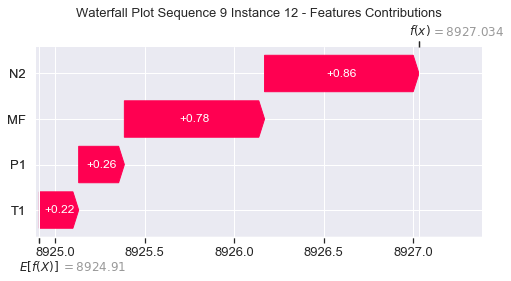

None

Contribution: [0.27352692 0.23515046 0.92235132 0.83782655]


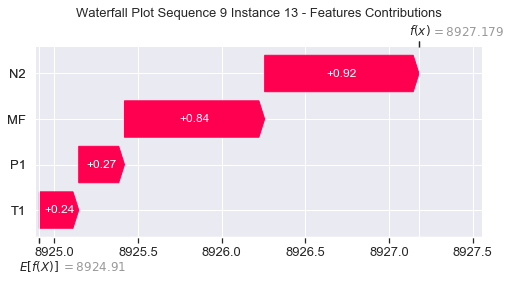

None

Contribution: [0.30172333 0.24857972 1.00058218 0.92534867]


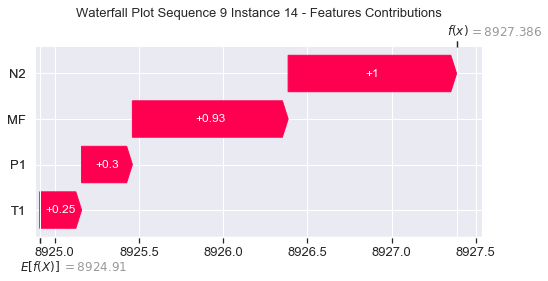

None

Contribution: [0.32762953 0.27862076 1.10201084 1.00274032]


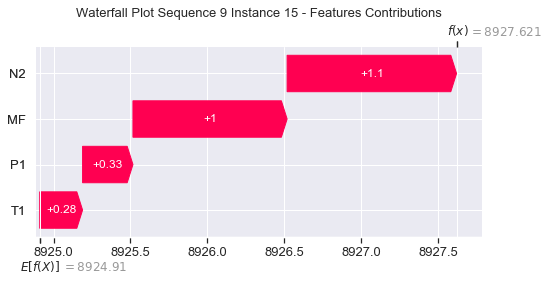

None

Contribution: [0.37382753 0.29125011 1.24413361 1.1501857 ]


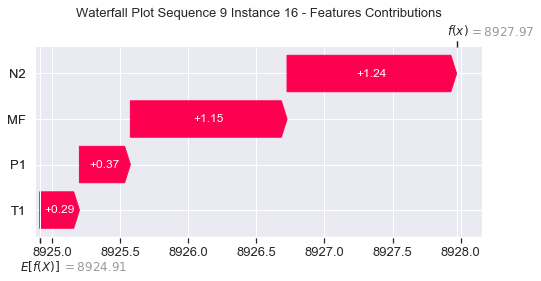

None

Contribution: [0.42922082 0.35757292 1.43350535 1.30309139]


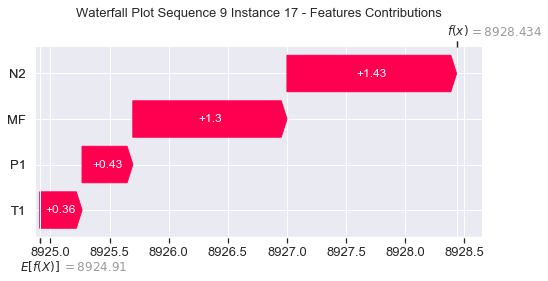

None

Contribution: [0.50986216 0.41861056 1.69731218 1.5452423 ]


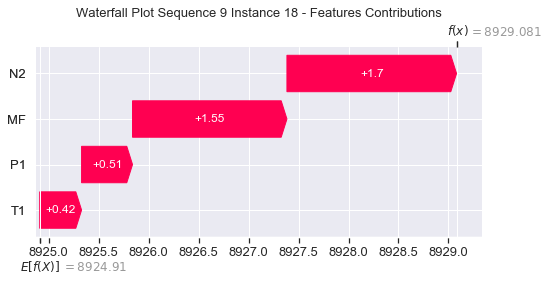

None

Contribution: [0.6243456  0.528501   2.07611001 1.91050481]


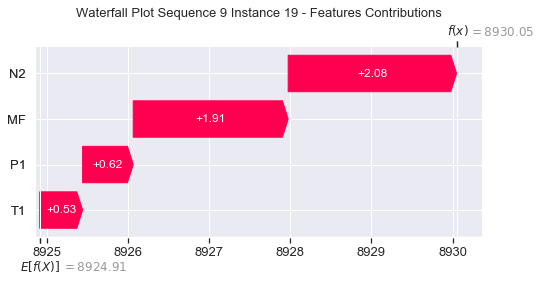

None

Contribution: [0.79567819 0.63717766 2.62484308 2.3956709 ]


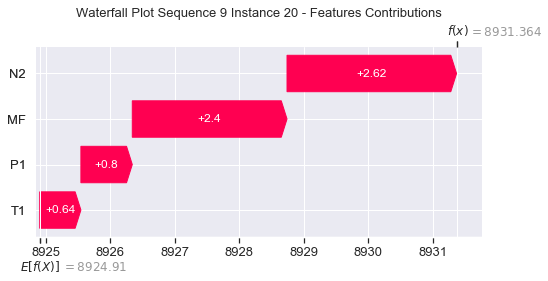

None

Contribution: [1.04917581 0.81934489 3.45077452 3.15402031]


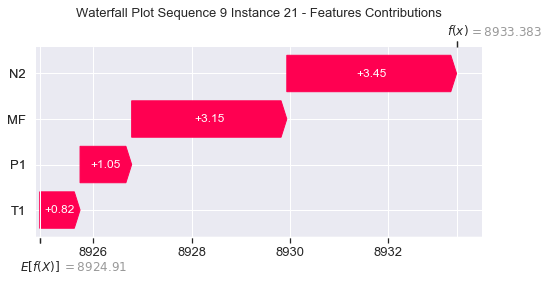

None

Contribution: [1.44072038 1.05927768 4.74364506 4.35415802]


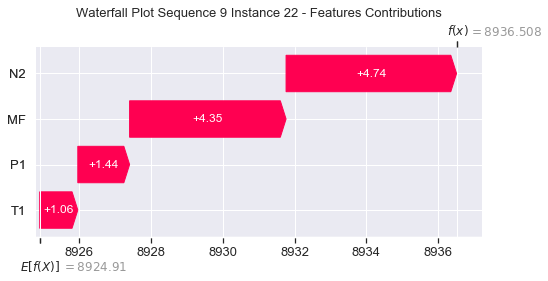

None

Contribution: [2.00788513 1.08233771 6.7752302  6.27463393]


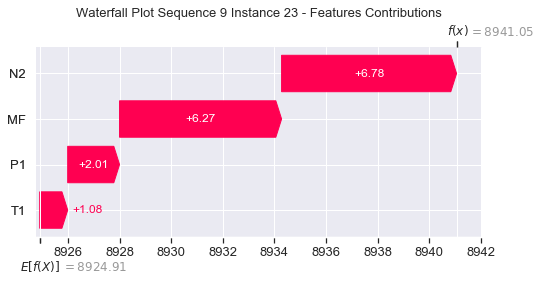

None

Contribution: [ 2.60610725 -1.89631898  9.53755535  9.17218407]


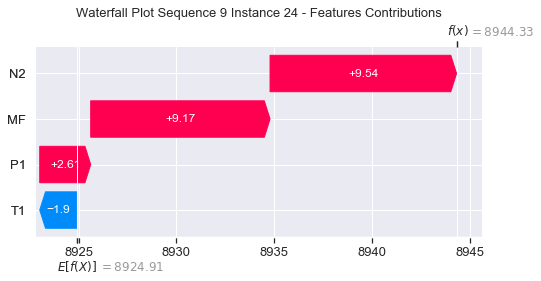

None

Contribution: [ 5.04601512  1.45250441 17.02636557 15.48775155]


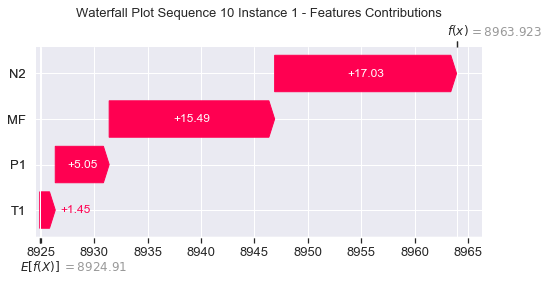

None

Contribution: [0.04443856 0.1311411  0.13337307 0.10830752]


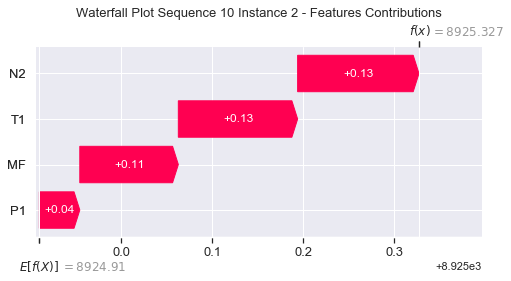

None

Contribution: [0.25517518 0.29395039 0.86072401 0.78235051]


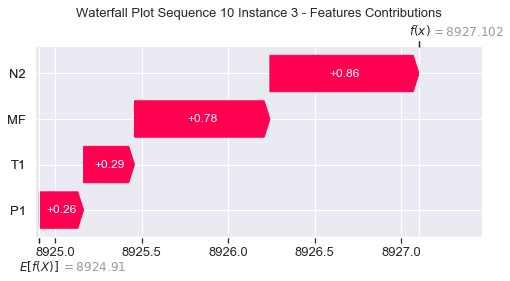

None

Contribution: [0.33016116 0.25156913 1.0976621  0.99553985]


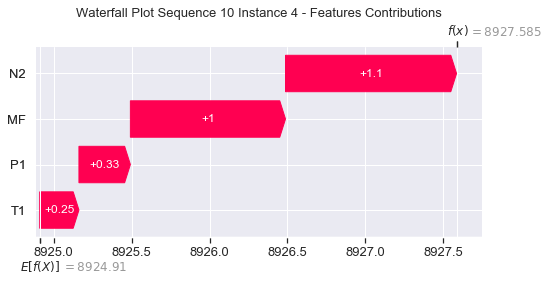

None

Contribution: [0.281944   0.24827484 0.9187457  0.84077309]


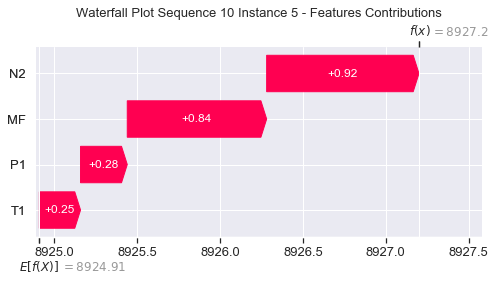

None

Contribution: [0.26041662 0.19691096 0.83651068 0.77429229]


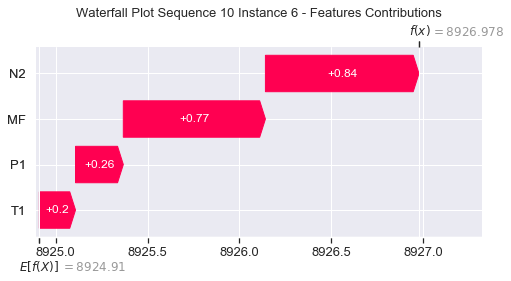

None

Contribution: [0.24769375 0.17972729 0.80221391 0.74041335]


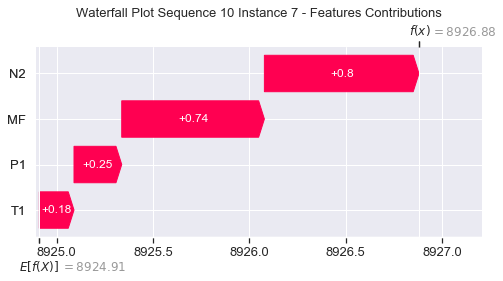

None

Contribution: [0.24700153 0.18671996 0.78930678 0.73119848]


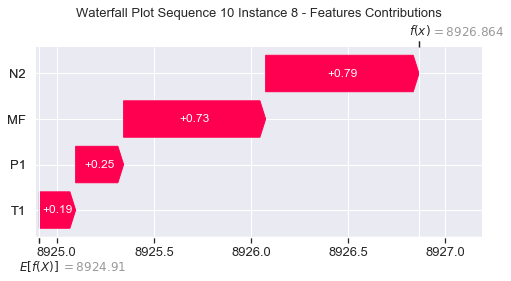

None

Contribution: [0.25757494 0.211802   0.79156589 0.74274647]


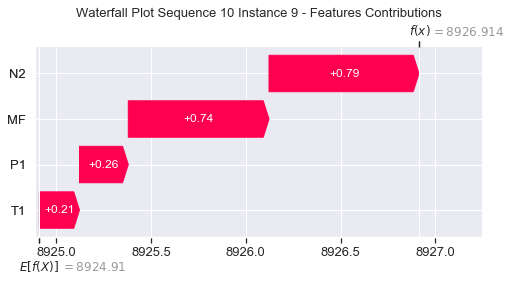

None

Contribution: [0.26054246 0.22563056 0.80759733 0.75378803]


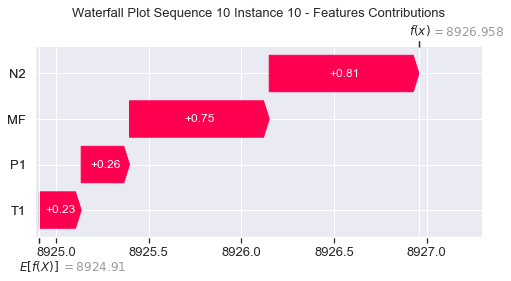

None

Contribution: [0.2845171  0.24641605 0.83960698 0.80408813]


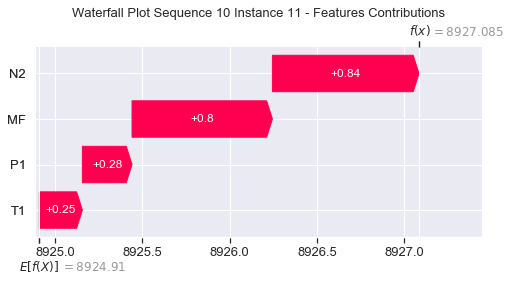

None

Contribution: [0.27449515 0.20060342 0.87555144 0.81561912]


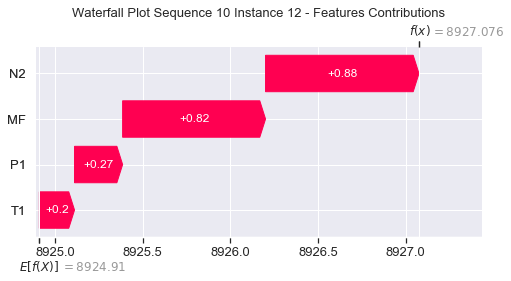

None

Contribution: [0.29109205 0.21002149 0.93507133 0.86653821]


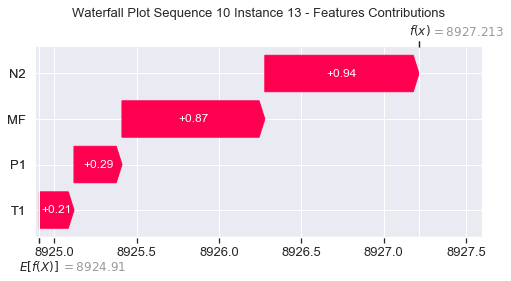

None

Contribution: [0.31866878 0.26098861 1.01164952 0.93186321]


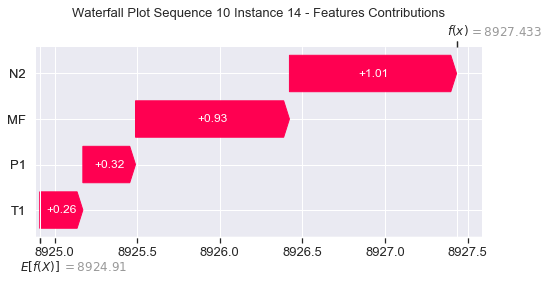

None

Contribution: [0.35054938 0.23723595 1.12077745 1.04007222]


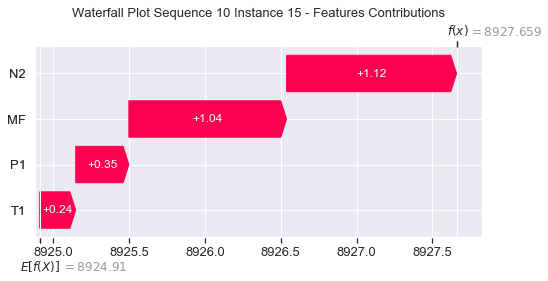

None

Contribution: [0.37564035 0.14528696 1.26295141 1.1726847 ]


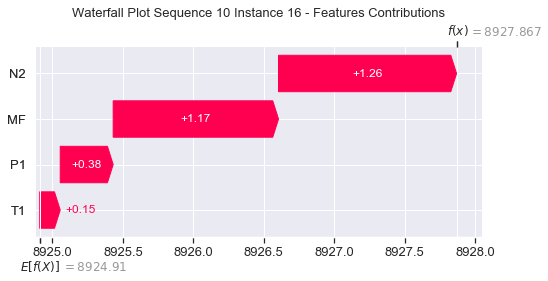

None

Contribution: [0.45422948 0.28192327 1.45526067 1.34403104]


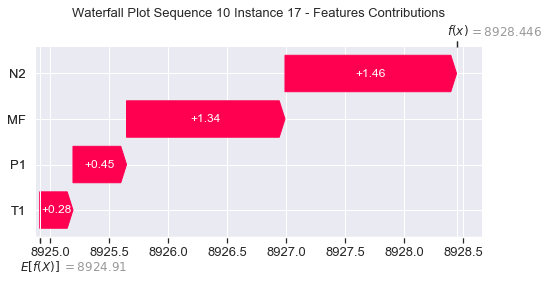

None

Contribution: [0.54108072 0.32616592 1.72301567 1.59203671]


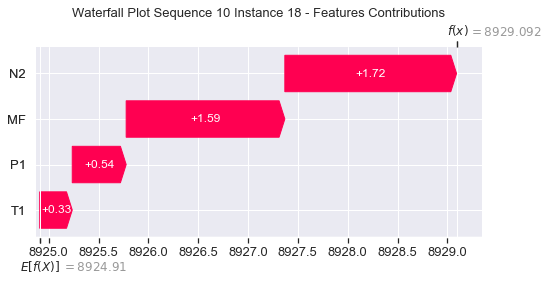

None

Contribution: [0.65159774 0.26066315 2.11395847 1.95936206]


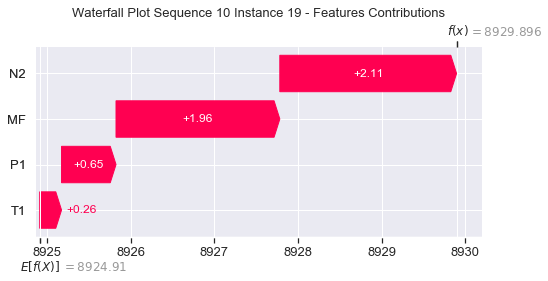

None

Contribution: [0.82981982 0.48694424 2.64828371 2.42804011]


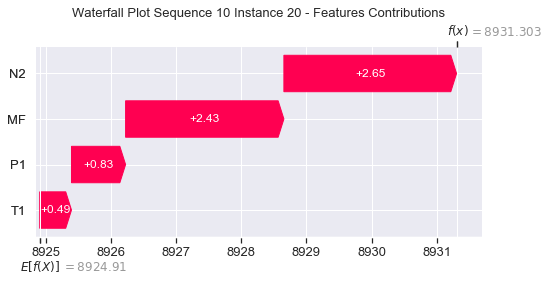

None

Contribution: [1.09347265 0.65363094 3.47298693 3.18672634]


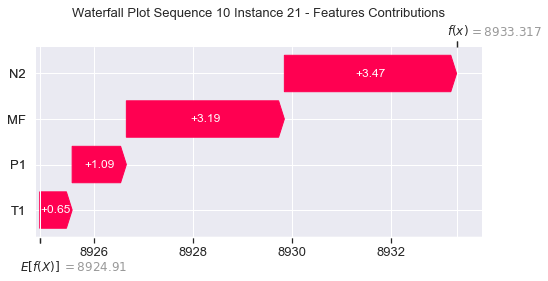

None

Contribution: [1.51181328 0.866388   4.76566309 4.39000427]


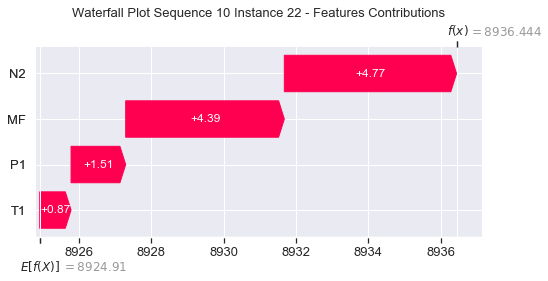

None

Contribution: [2.16410002 0.60696611 6.80624952 6.36773156]


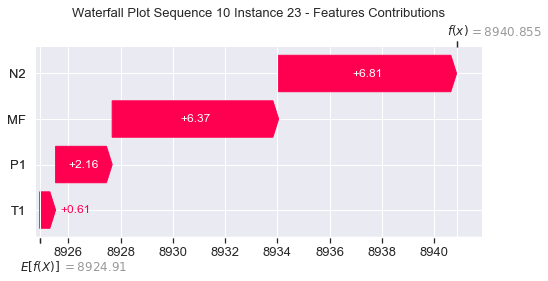

None

Contribution: [ 3.01951976 -3.1385458   9.52199081  9.11458165]


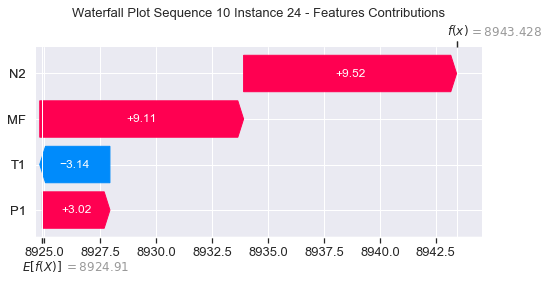

None

Contribution: [ 4.91565431  1.13694892 16.53677206 14.75042331]


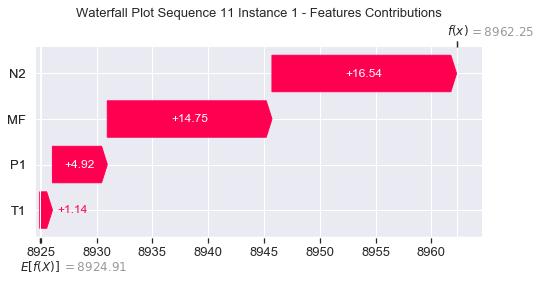

None

Contribution: [0.03879531 0.13848086 0.12936084 0.10521577]


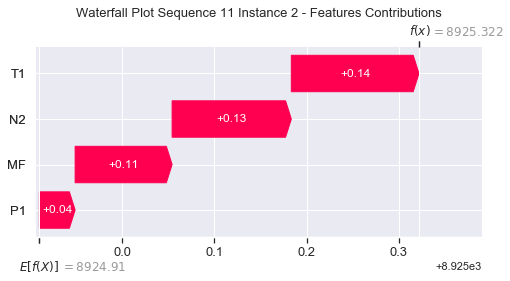

None

Contribution: [0.24810098 0.28432349 0.82579752 0.75272732]


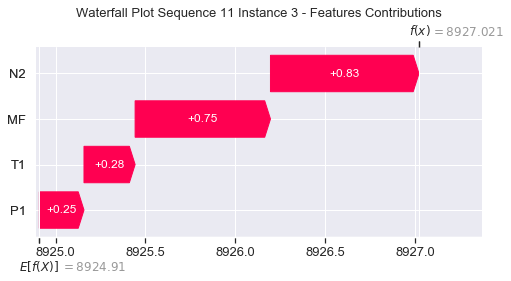

None

Contribution: [0.33075275 0.27188791 1.04549199 0.97032036]


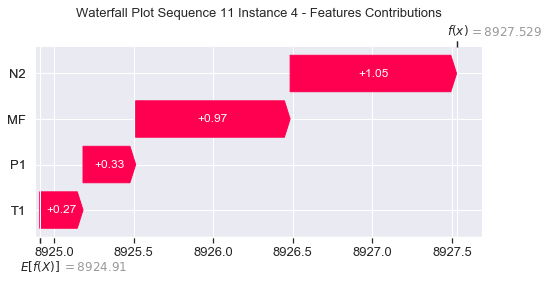

None

Contribution: [0.2808329  0.24339514 0.8794541  0.81500601]


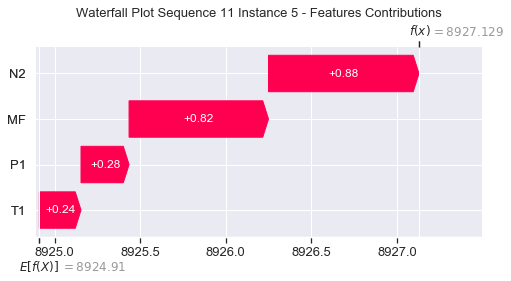

None

Contribution: [0.25815054 0.22687507 0.79974843 0.74218664]


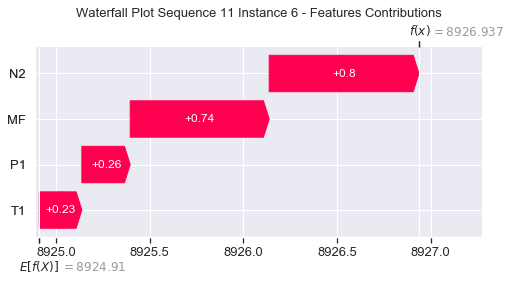

None

Contribution: [0.24584416 0.2202047  0.76741934 0.7097061 ]


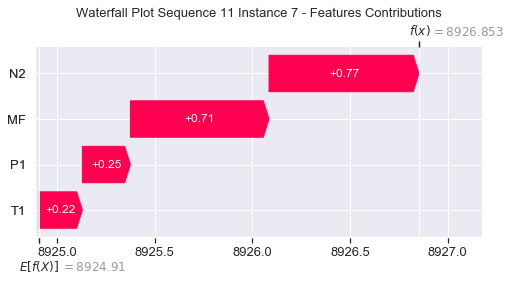

None

Contribution: [0.24255381 0.21756559 0.75442319 0.69837469]


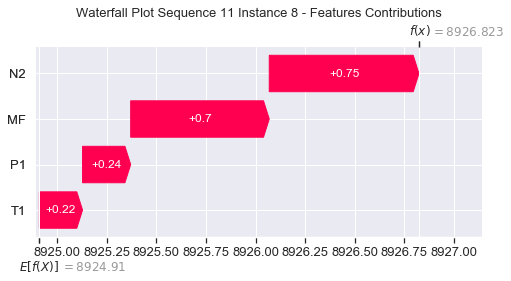

None

Contribution: [0.2370358  0.22393362 0.75519973 0.68405392]


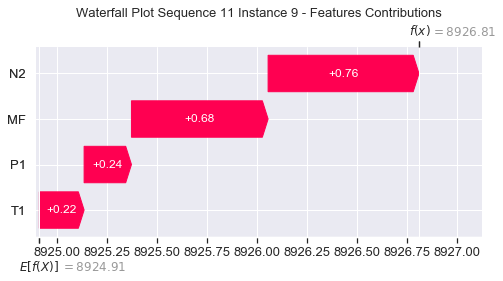

None

Contribution: [0.23921491 0.22768853 0.76982023 0.70597428]


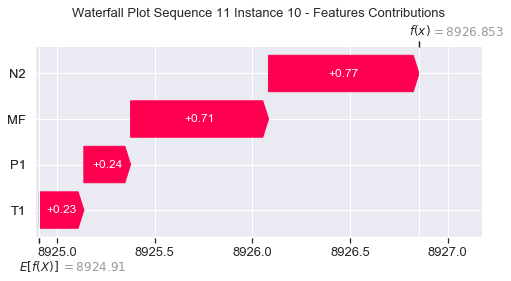

None

Contribution: [0.25848844 0.23371238 0.79613919 0.73090049]


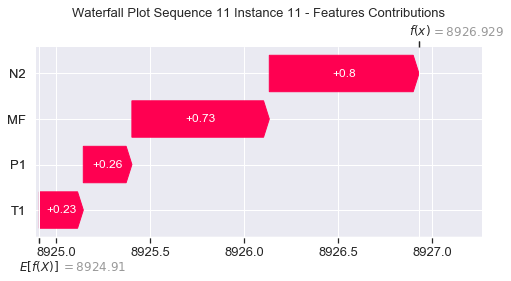

None

Contribution: [0.26911082 0.24340642 0.83010352 0.76975192]


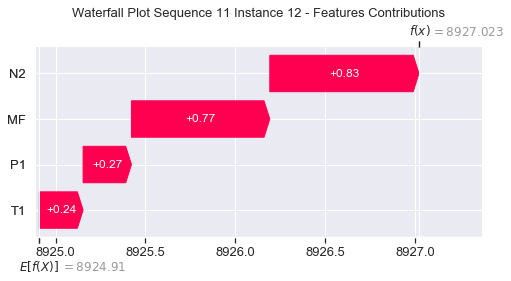

None

Contribution: [0.28544368 0.2627537  0.88580208 0.82033585]


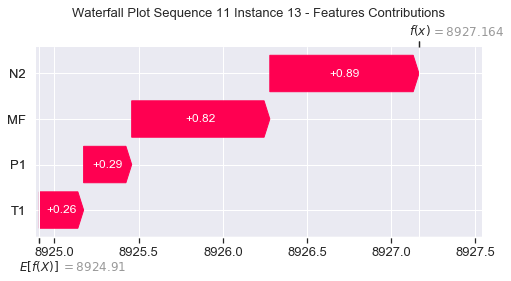

None

Contribution: [0.30914787 0.2908415  0.9581733  0.89181911]


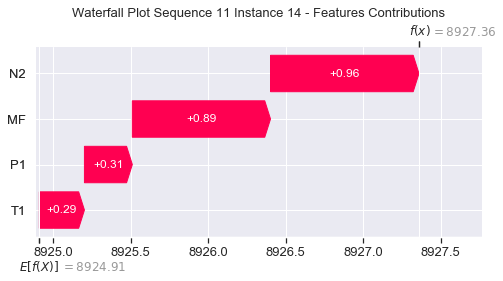

None

Contribution: [0.34222094 0.31888592 1.05780823 0.98296408]


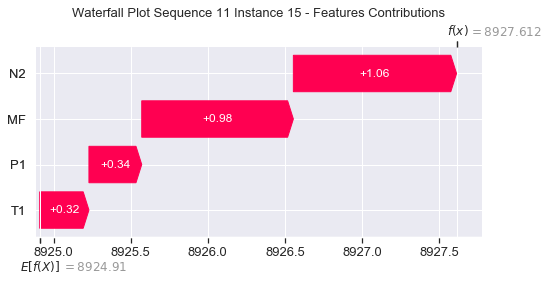

None

Contribution: [0.40736636 0.34347802 1.19264689 1.13399974]


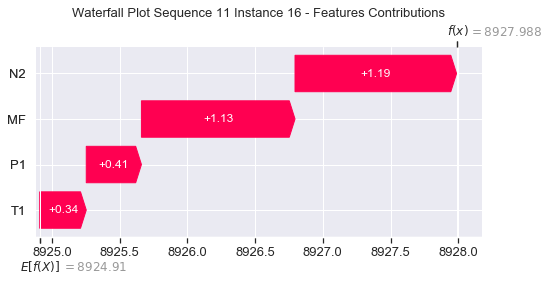

None

Contribution: [0.44376735 0.42397871 1.37852784 1.27875969]


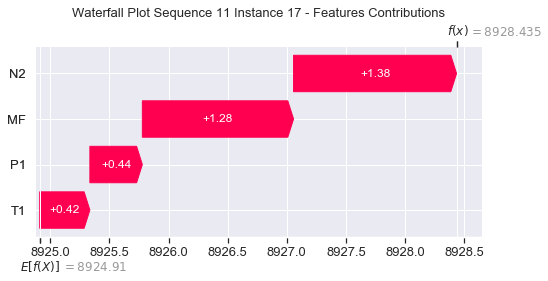

None

Contribution: [0.52888138 0.50449475 1.63516247 1.52121735]


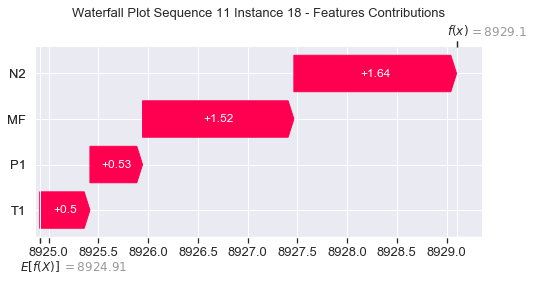

None

Contribution: [0.66553374 0.62390147 2.00722784 1.92133659]


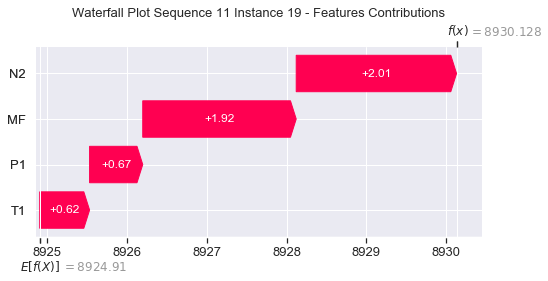

None

Contribution: [0.81792339 0.78621497 2.54445809 2.36645911]


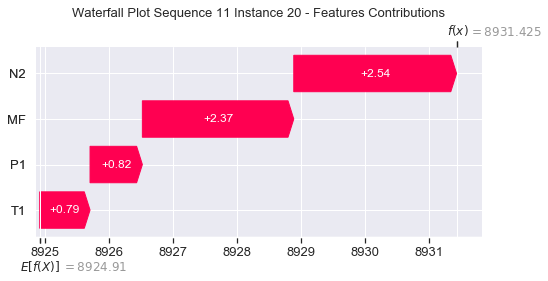

None

Contribution: [1.08301753 1.02187473 3.35897061 3.1267741 ]


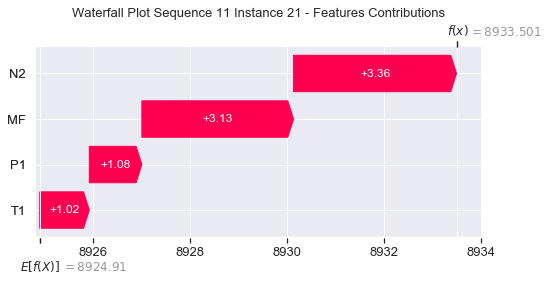

None

Contribution: [1.50555235 1.3673878  4.63788898 4.34253594]


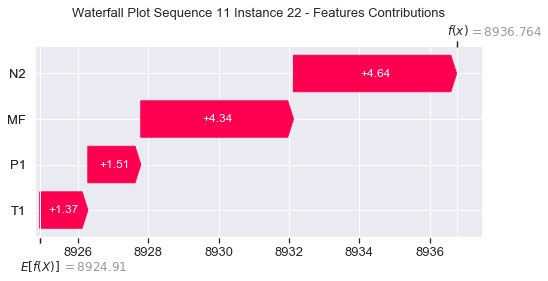

None

Contribution: [2.18394966 1.77111808 6.65206116 6.35199346]


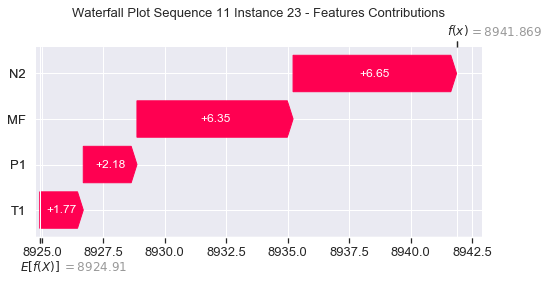

None

Contribution: [3.31097477 0.8042703  9.36892816 9.70860864]


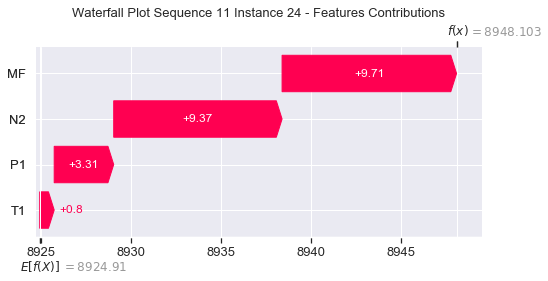

None

Contribution: [ 5.24914443  3.50484899 16.01316554 15.09852532]


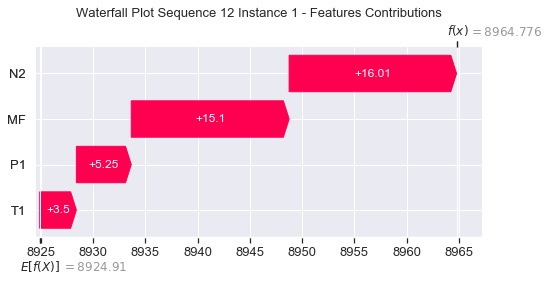

None

Contribution: [0.03159833 0.09304427 0.11429921 0.08691388]


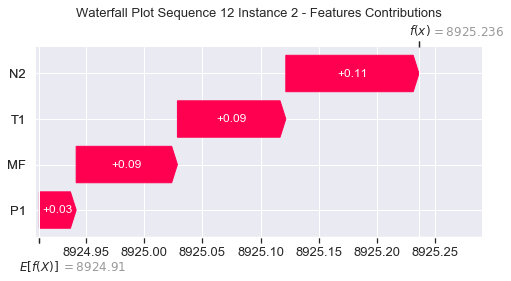

None

Contribution: [0.23630178 0.27817594 0.78685881 0.7161787 ]


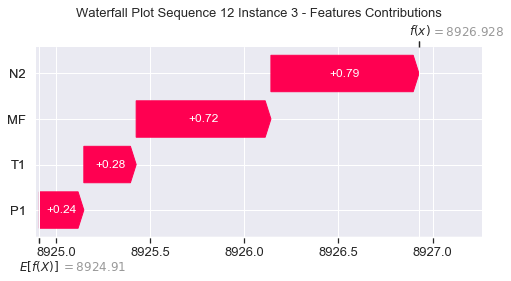

None

Contribution: [0.33329969 0.30293563 1.05600193 0.98185975]


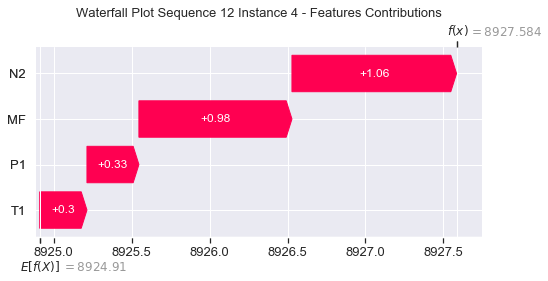

None

Contribution: [0.28291637 0.26931246 0.8879961  0.82003375]


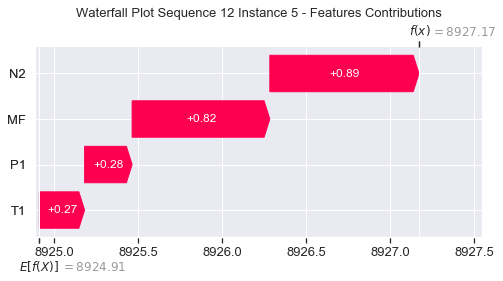

None

Contribution: [0.25777721 0.23840818 0.80722382 0.75229649]


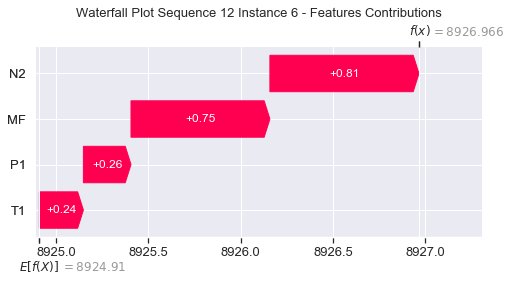

None

Contribution: [0.24751466 0.22649634 0.77456477 0.72183154]


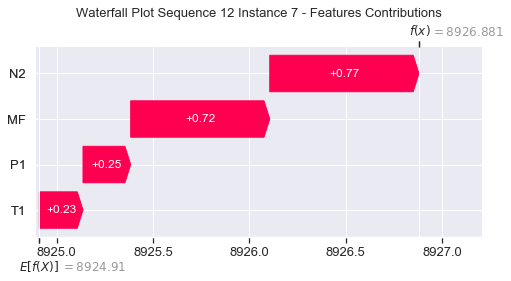

None

Contribution: [0.24318105 0.22456489 0.76110495 0.70834309]


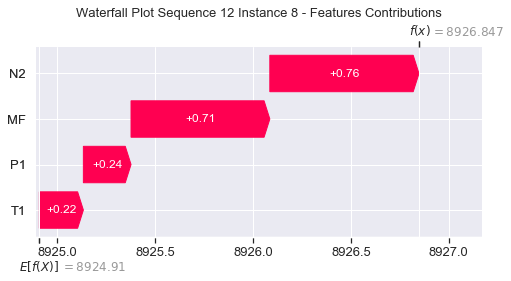

None

Contribution: [0.24434807 0.22509928 0.76238538 0.70516617]


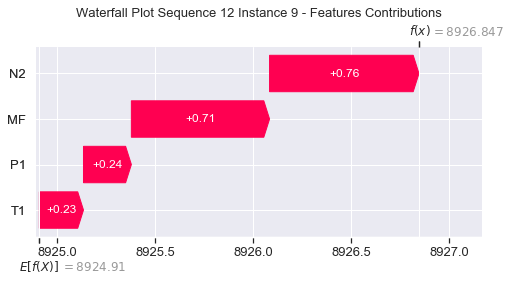

None

Contribution: [0.25555555 0.23087739 0.77849961 0.73261392]


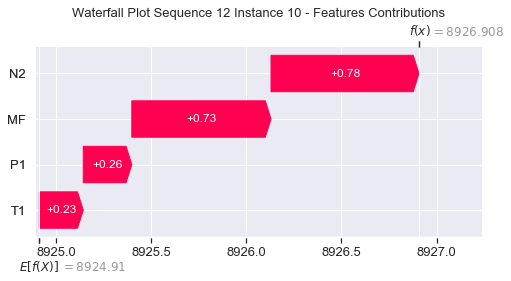

None

Contribution: [0.25598737 0.24066388 0.80211194 0.74111365]


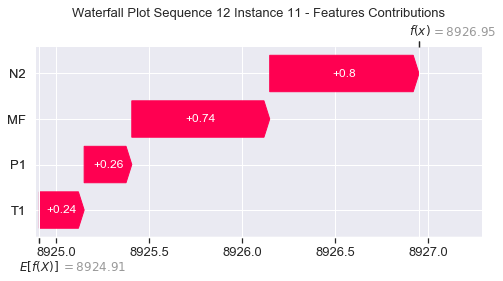

None

Contribution: [0.26555823 0.23851789 0.83656949 0.7759122 ]


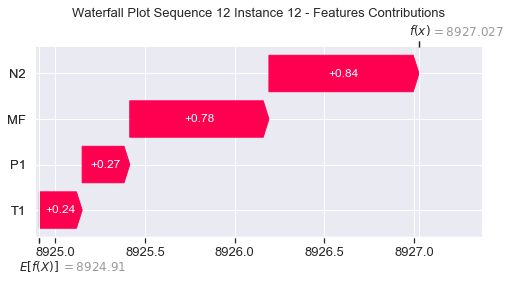

None

Contribution: [0.2841494  0.25588651 0.89356205 0.82924802]


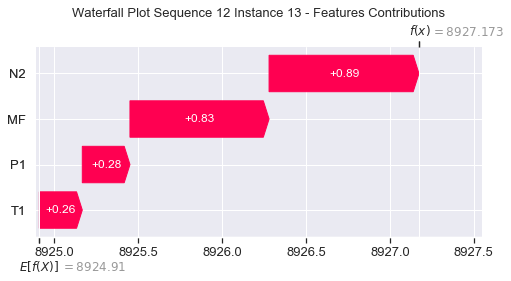

None

Contribution: [0.31091285 0.26703898 0.96695824 0.90939115]


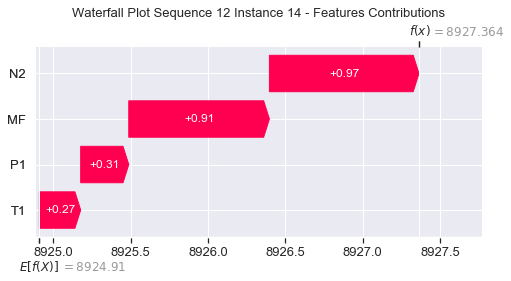

None

Contribution: [0.34045367 0.30646165 1.06865024 0.99373978]


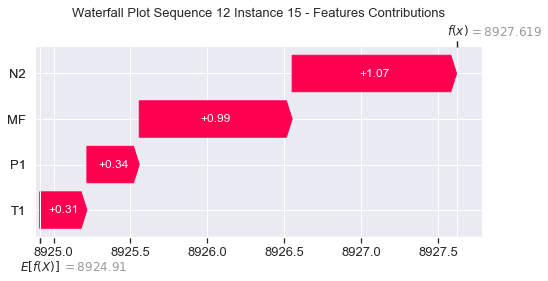

None

Contribution: [0.38856031 0.32660043 1.20615566 1.13415145]


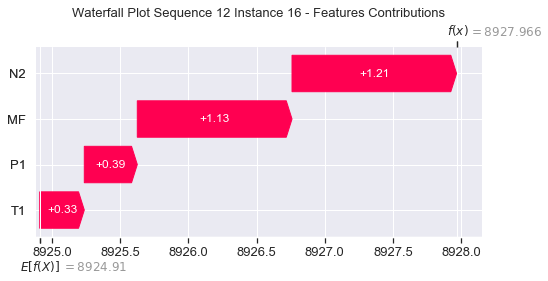

None

Contribution: [0.44567219 0.39442171 1.39400451 1.30020557]


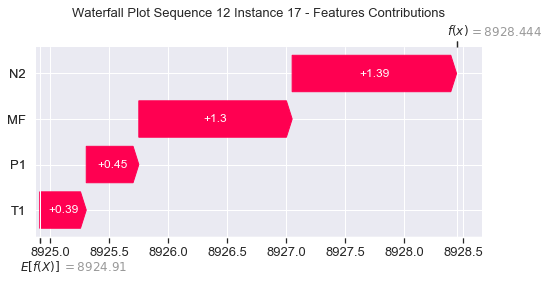

None

Contribution: [0.5296569  0.46660865 1.65431831 1.5451121 ]


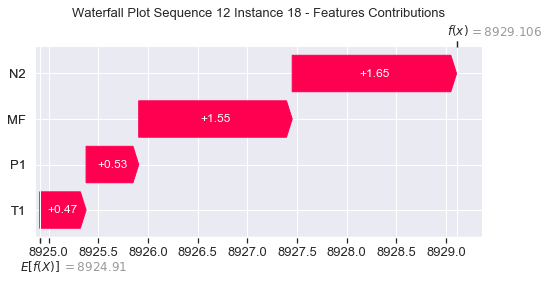

None

Contribution: [0.64193573 0.55230071 2.02546933 1.86703142]


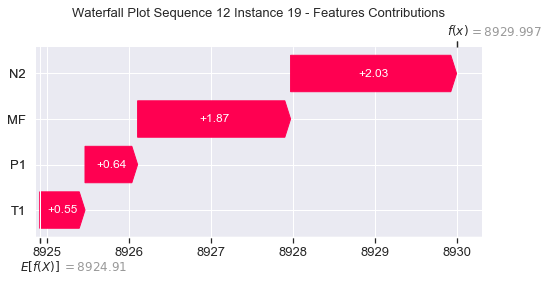

None

Contribution: [0.82554247 0.72447979 2.56871914 2.39643519]


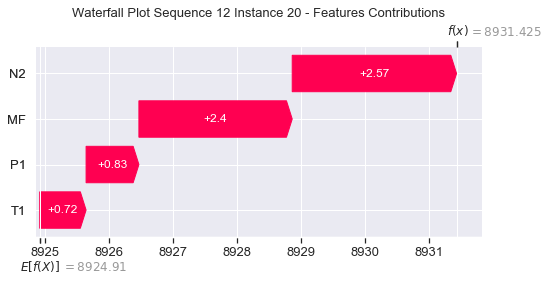

None

Contribution: [1.08846408 0.94170783 3.3868907  3.15504905]


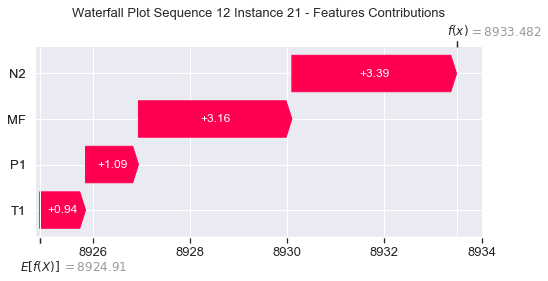

None

Contribution: [1.50188247 1.26145176 4.67245429 4.35285016]


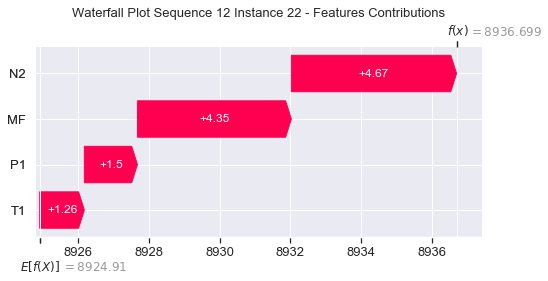

None

Contribution: [2.15184355 1.50690301 6.70359923 6.35828584]


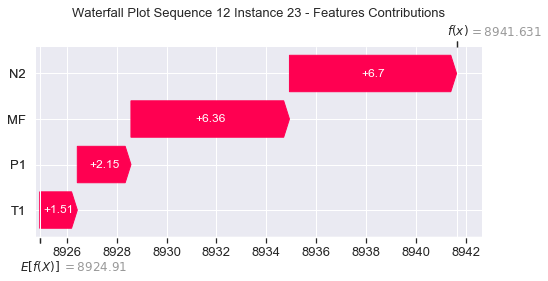

None

Contribution: [3.16513768 0.13616895 9.54401919 9.79858064]


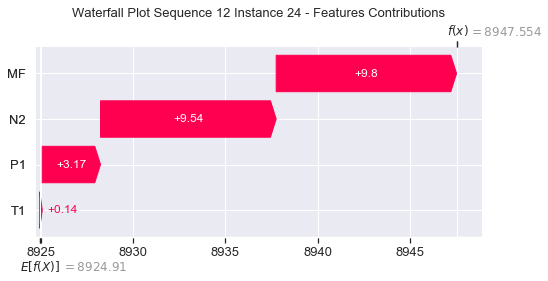

None

Contribution: [ 5.05410431  3.23701962 16.14009998 15.51012493]


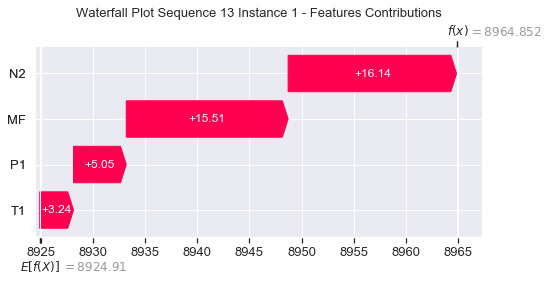

None

Contribution: [0.03467437 0.10227629 0.11814437 0.0949631 ]


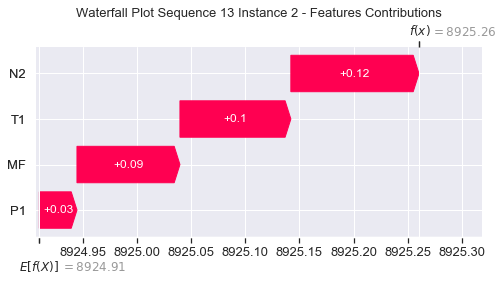

None

Contribution: [0.23533687 0.27767536 0.78638575 0.71287667]


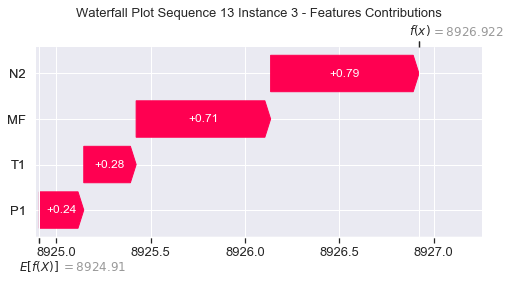

None

Contribution: [0.32316434 0.30389332 1.05837831 0.98162043]


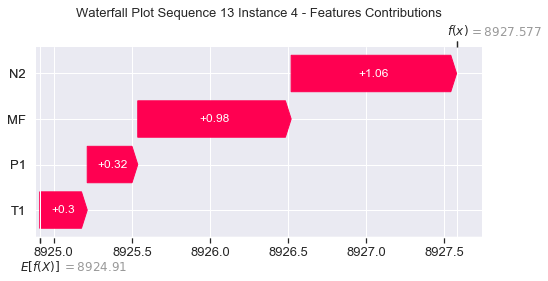

None

Contribution: [0.27613322 0.25516973 0.88784165 0.81637136]


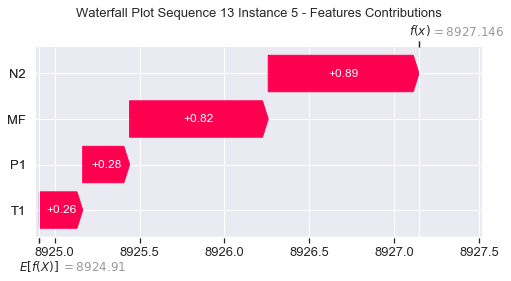

None

Contribution: [0.25078062 0.2333017  0.80571043 0.73649017]


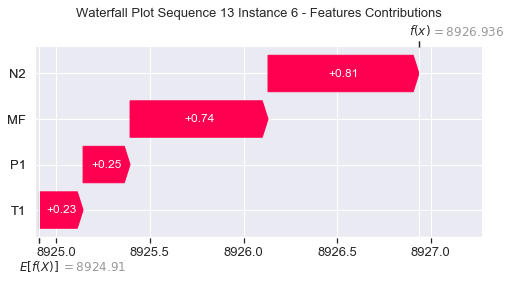

None

Contribution: [0.24059134 0.22398292 0.77295528 0.70709255]


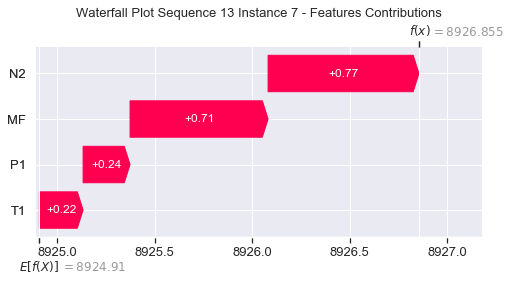

None

Contribution: [0.23665173 0.22250773 0.75967218 0.69732542]


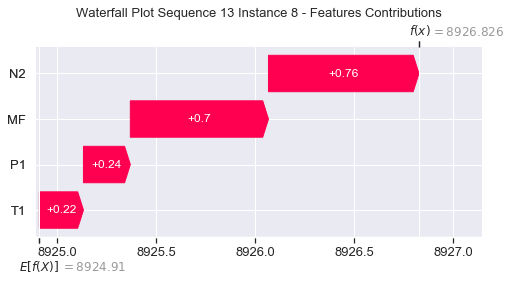

None

Contribution: [0.24070523 0.22570684 0.76256253 0.70923835]


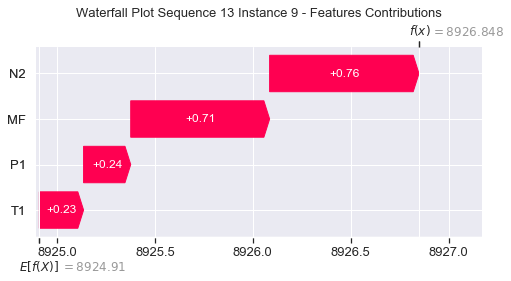

None

Contribution: [0.2418247  0.20476225 0.77478033 0.71499117]


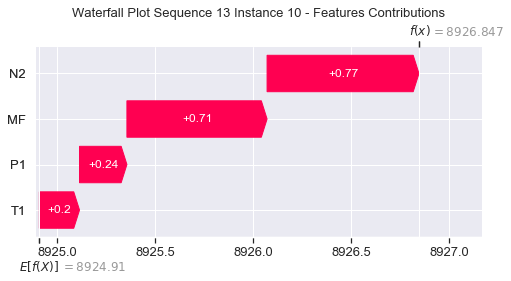

None

Contribution: [0.25269366 0.24451265 0.80183239 0.74518886]


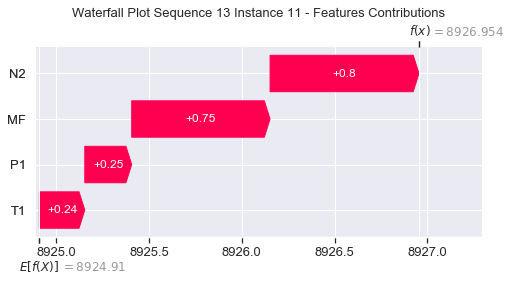

None

Contribution: [0.25972395 0.25633993 0.83533427 0.76832508]


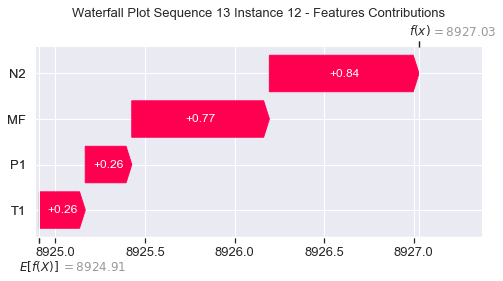

None

Contribution: [0.27707022 0.27358139 0.89160436 0.82116326]


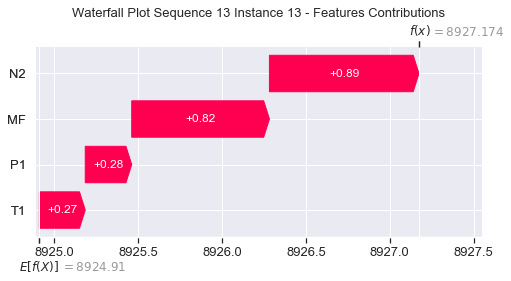

None

Contribution: [0.30230773 0.30694456 0.96479875 0.89928108]


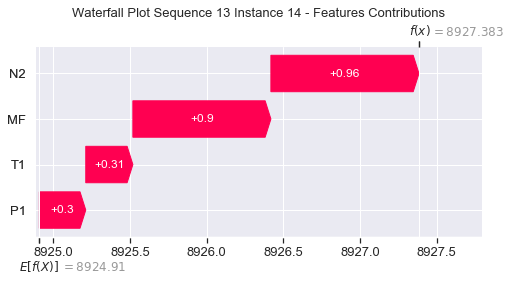

None

Contribution: [0.33055336 0.33108941 1.06545429 0.98168738]


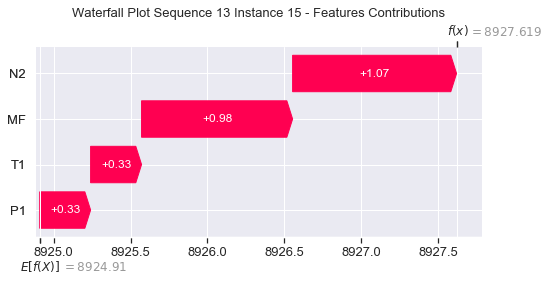

None

Contribution: [0.37199298 0.36555153 1.20081236 1.10770608]


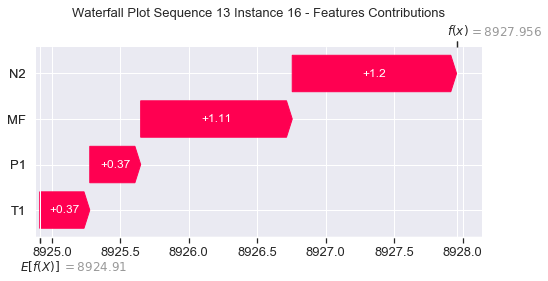

None

Contribution: [0.43139939 0.43075875 1.38849863 1.28249558]


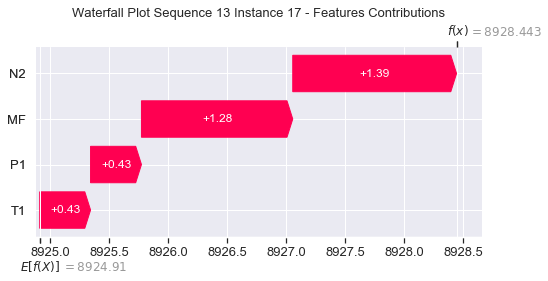

None

Contribution: [0.51178577 0.51063637 1.64704888 1.52258859]


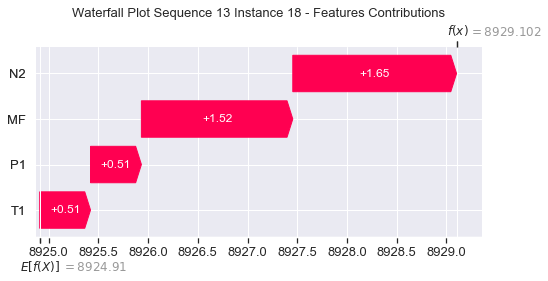

None

Contribution: [0.61651317 0.60275269 2.01860184 1.86638694]


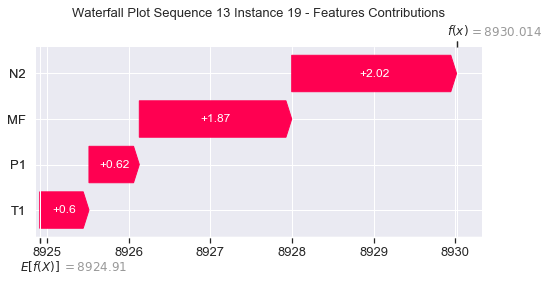

None

Contribution: [0.79551847 0.78091797 2.5573271  2.37471851]


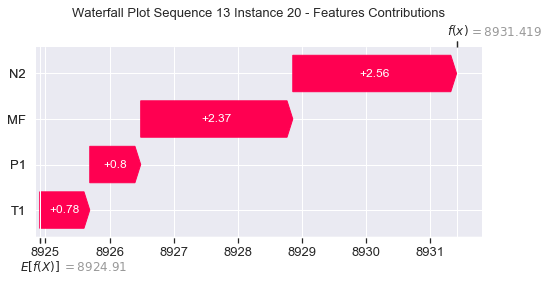

None

Contribution: [1.05138034 1.02624553 3.37426986 3.14008729]


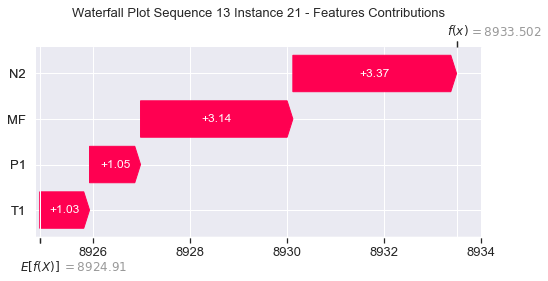

None

Contribution: [1.4500854  1.39227504 4.65984766 4.3559415 ]


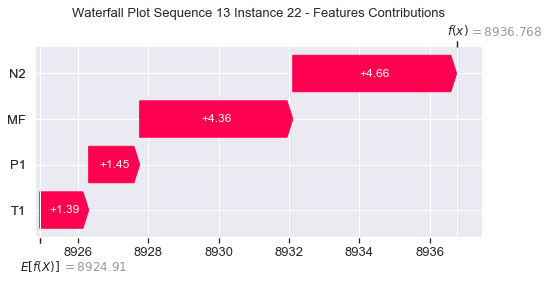

None

Contribution: [2.050655   1.80481137 6.69247508 6.34288243]


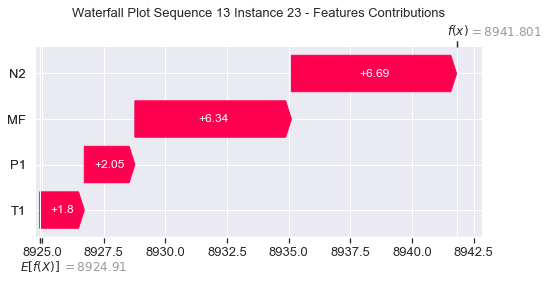

None

Contribution: [2.8143421  1.03946383 9.51151292 9.53304871]


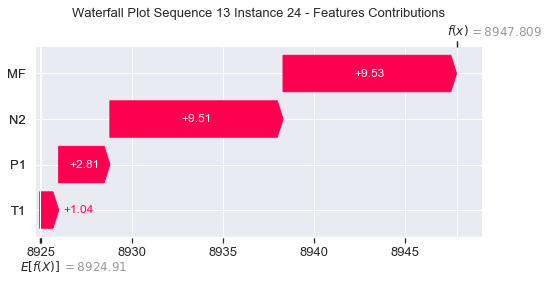

None

Contribution: [ 4.8913975   4.04137353 16.08237574 14.77870674]


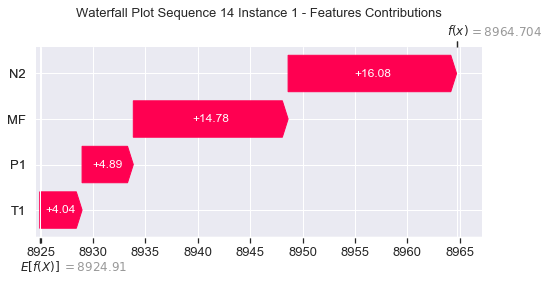

None

Contribution: [0.03464372 0.08718617 0.108536   0.08062217]


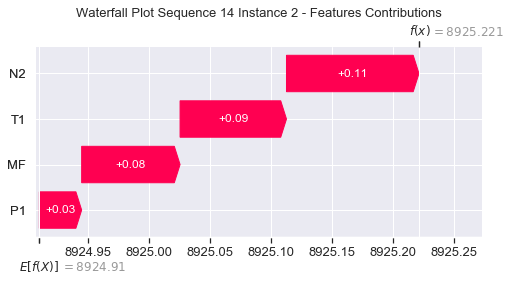

None

Contribution: [0.23379385 0.27193408 0.77771618 0.70595531]


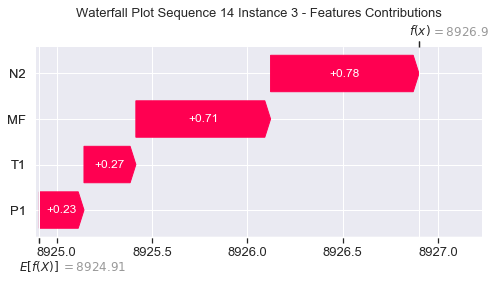

None

Contribution: [0.32701133 0.33160565 1.05200944 0.99089125]


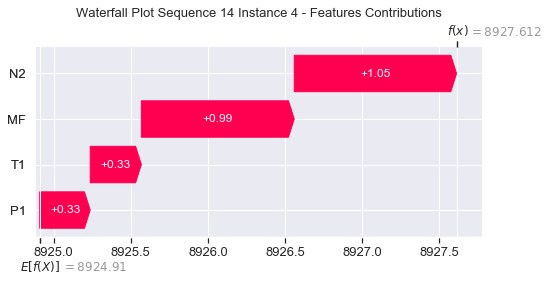

None

Contribution: [0.27634726 0.29315527 0.88117965 0.8127684 ]


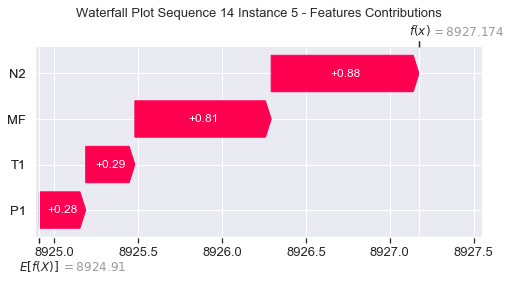

None

Contribution: [0.24992592 0.26084888 0.80068933 0.73631691]


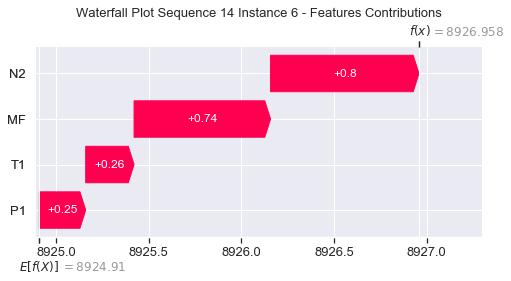

None

Contribution: [0.24018475 0.25036923 0.76866455 0.70804892]


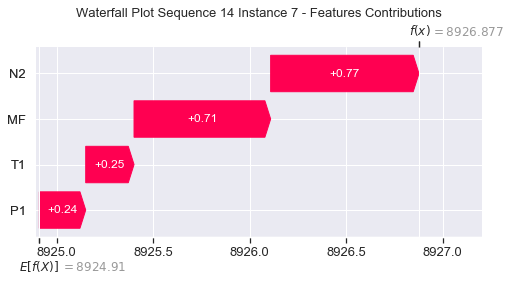

None

Contribution: [0.23601457 0.24761574 0.75551864 0.69559283]


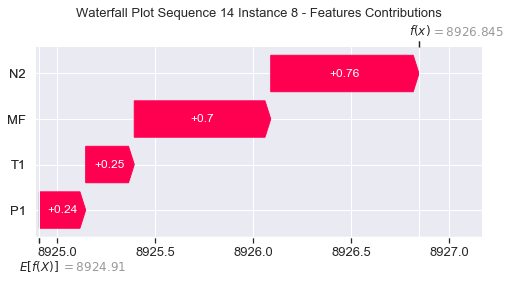

None

Contribution: [0.2395462  0.2599043  0.75822823 0.69736027]


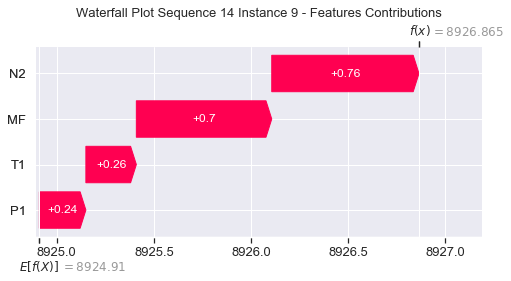

None

Contribution: [0.24358989 0.26336709 0.77207834 0.7162435 ]


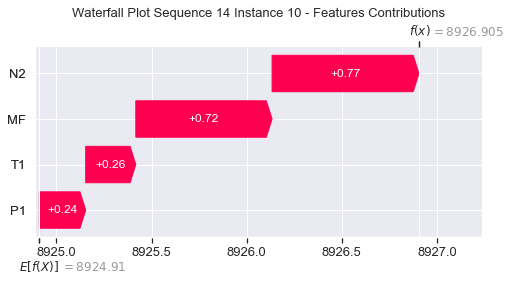

None

Contribution: [0.24986755 0.27214389 0.79799489 0.7304215 ]


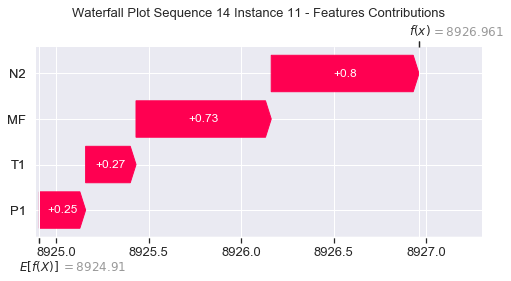

None

Contribution: [0.25825241 0.26842983 0.83222602 0.76644619]


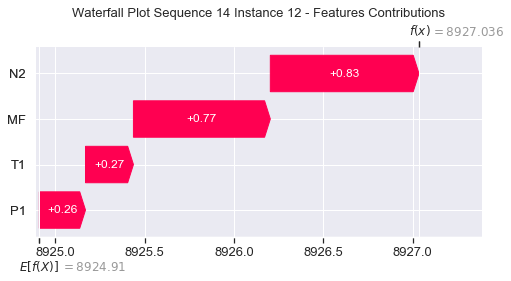

None

Contribution: [0.27631688 0.28796321 0.8890916  0.81992697]


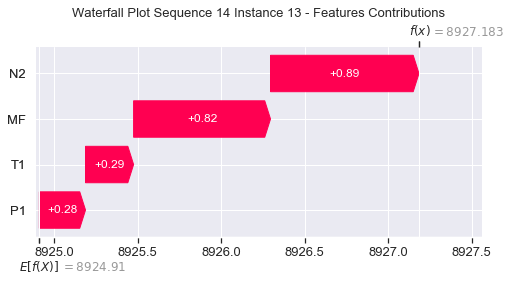

None

Contribution: [0.30009267 0.31191756 0.96058549 0.88326633]


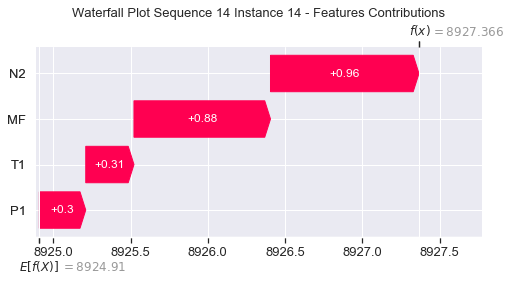

None

Contribution: [0.33060076 0.34216834 1.06380214 0.98091462]


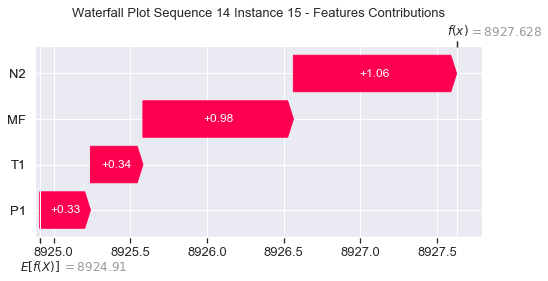

None

Contribution: [0.37180092 0.35976967 1.20085411 1.11577264]


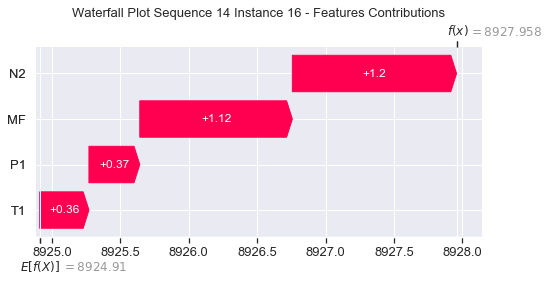

None

Contribution: [0.43182452 0.43876945 1.38814545 1.28244358]


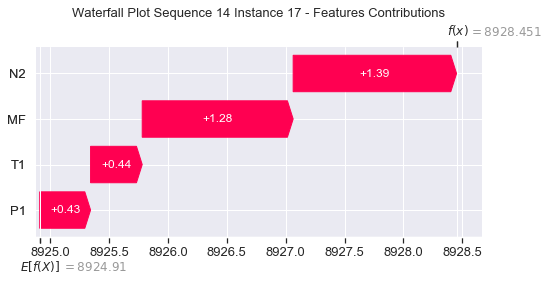

None

Contribution: [0.51239621 0.5138551  1.64762913 1.52213047]


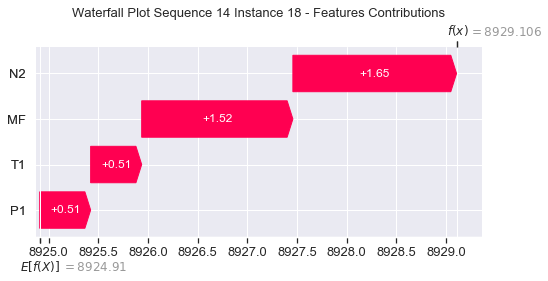

None

Contribution: [0.63406423 0.59955182 2.02455487 1.87745965]


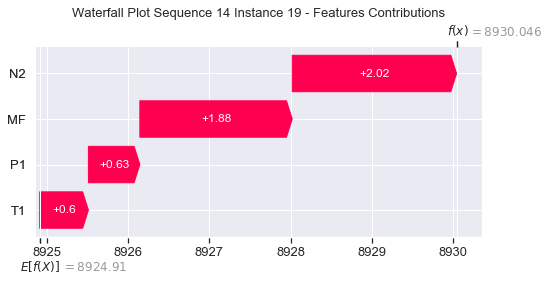

None

Contribution: [0.8006247  0.78648094 2.56263082 2.37384144]


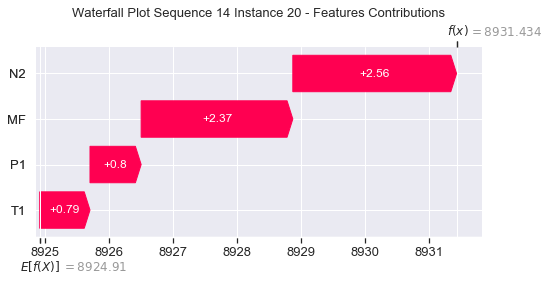

None

Contribution: [1.05727771 1.02234416 3.38161708 3.13336598]


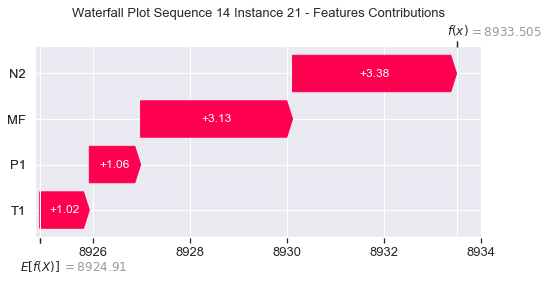

None

Contribution: [1.45892587 1.36983728 4.66916739 4.33598395]


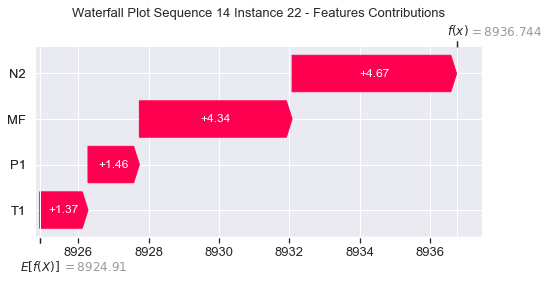

None

Contribution: [2.05910729 1.70871694 6.70104782 6.29634153]


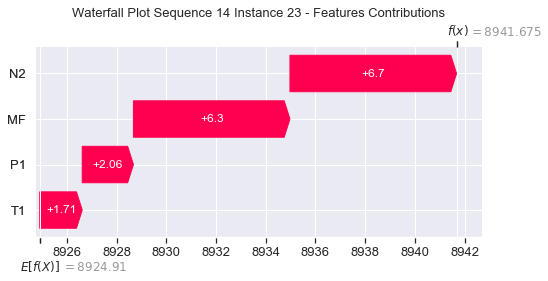

None

Contribution: [2.83203695 0.70434748 9.4776681  9.31127169]


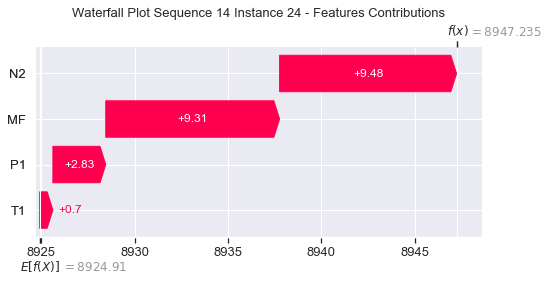

None

Contribution: [ 4.89225943  3.70059564 16.11027055 14.68292537]


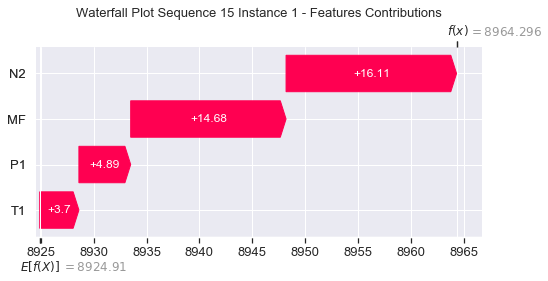

None

Contribution: [0.03616251 0.09602948 0.11476549 0.08947907]


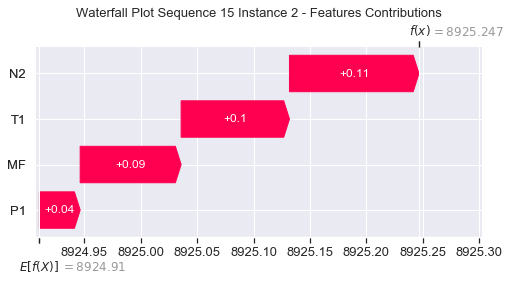

None

Contribution: [0.23656142 0.2766413  0.78920813 0.71587094]


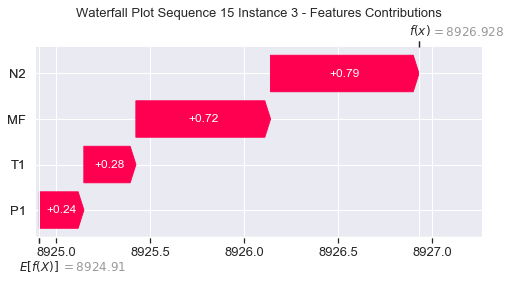

None

Contribution: [0.31893181 0.29622958 1.0526052  0.97110819]


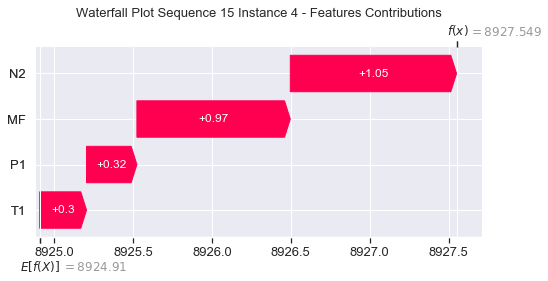

None

Contribution: [0.2758059  0.27213192 0.88433905 0.8150484 ]


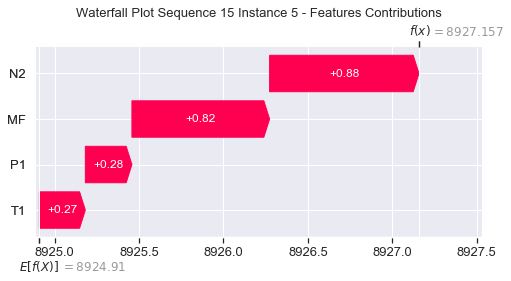

None

Contribution: [0.25171082 0.24249081 0.80407668 0.74326712]


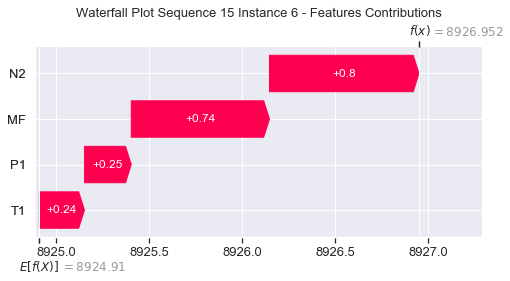

None

Contribution: [0.24156806 0.23545231 0.77178967 0.71407537]


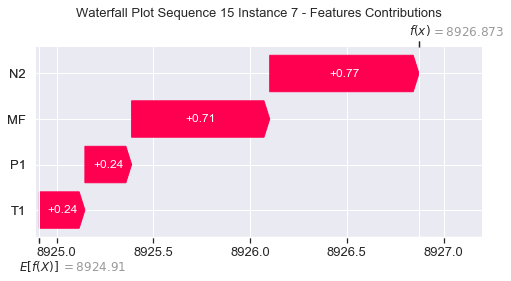

None

Contribution: [0.23671171 0.23218217 0.75815632 0.7003278 ]


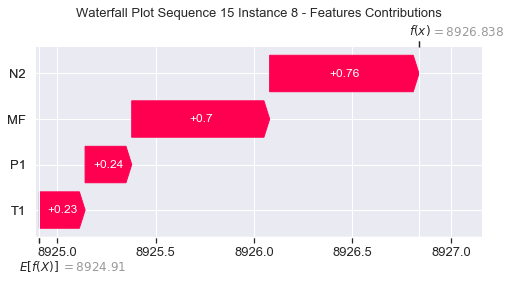

None

Contribution: [0.23639501 0.24086892 0.76014126 0.70168654]


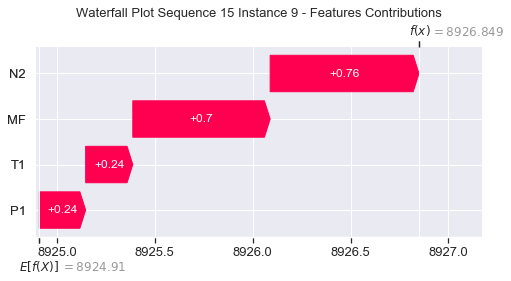

None

Contribution: [0.24358275 0.24404096 0.77415949 0.72042673]


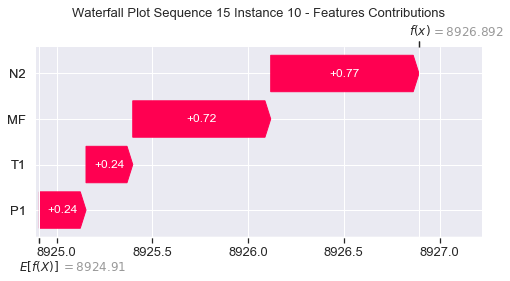

None

Contribution: [0.24645728 0.24950148 0.79854314 0.73080471]


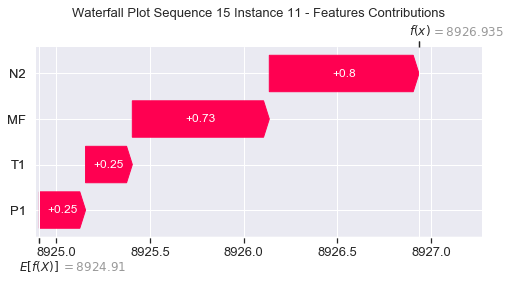

None

Contribution: [0.25791641 0.26312457 0.83293922 0.76469096]


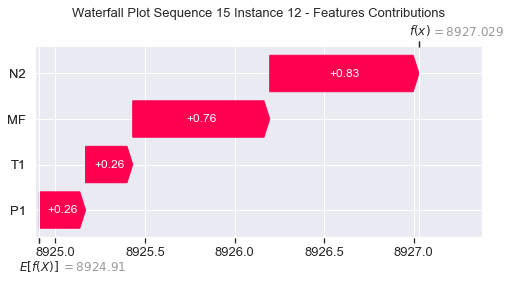

None

Contribution: [0.27576291 0.28280192 0.88958149 0.81828518]


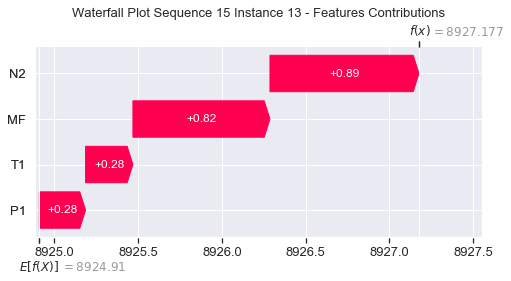

None

Contribution: [0.30386902 0.29346534 0.96422677 0.90011477]


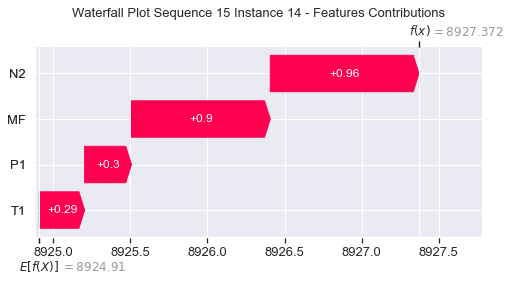

None

Contribution: [0.32973084 0.33674963 1.06385274 0.98093089]


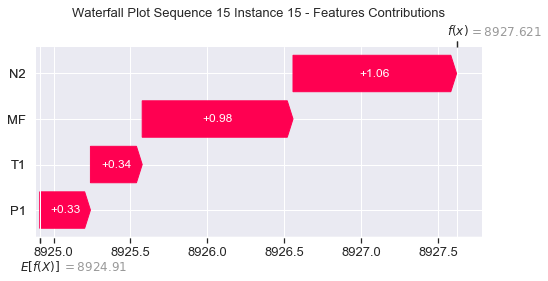

None

Contribution: [0.37445475 0.3830172  1.19995632 1.11777089]


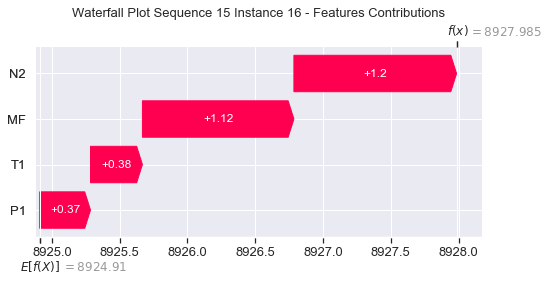

None

Contribution: [0.43156555 0.438248   1.38840456 1.28326199]


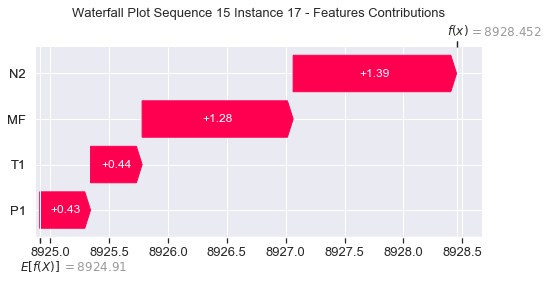

None

Contribution: [0.51272117 0.51435172 1.64775594 1.52352406]


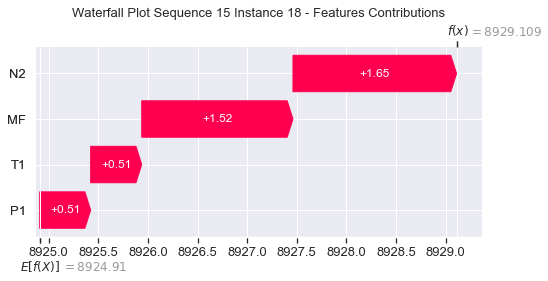

None

Contribution: [0.63409192 0.63377087 2.01917605 1.8625514 ]


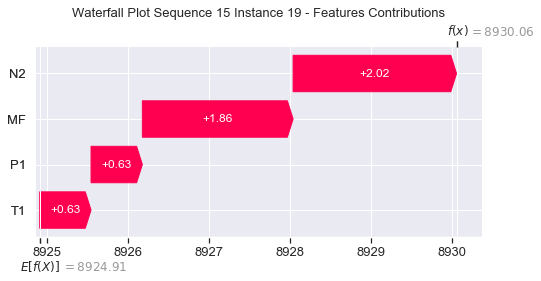

None

Contribution: [0.79887198 0.79266089 2.56257141 2.37289998]


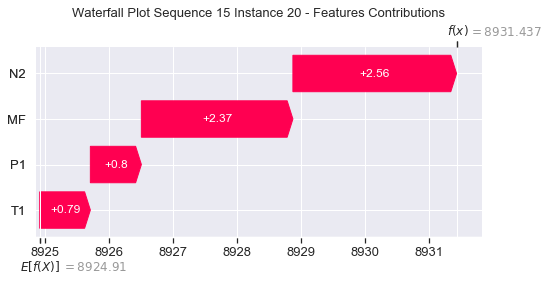

None

Contribution: [1.05294474 1.03585714 3.38077328 3.1262128 ]


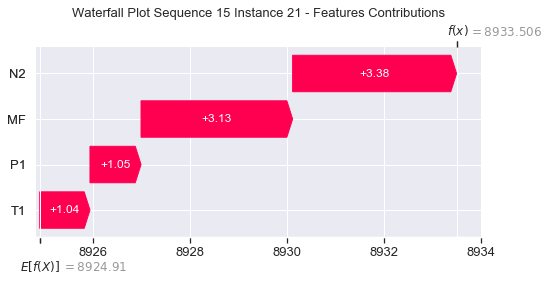

None

Contribution: [1.44811188 1.39370218 4.66586789 4.31467385]


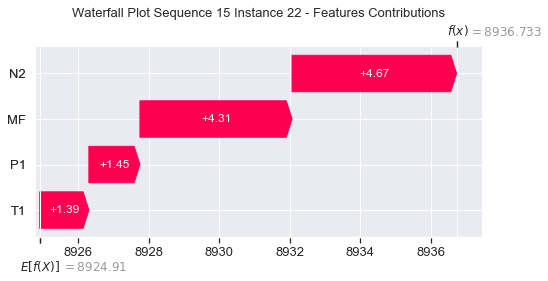

None

Contribution: [2.04784195 1.76738087 6.69625592 6.26557337]


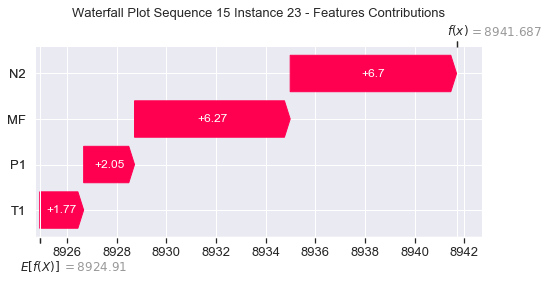

None

Contribution: [2.85281409 0.82845059 9.51860148 9.52245329]


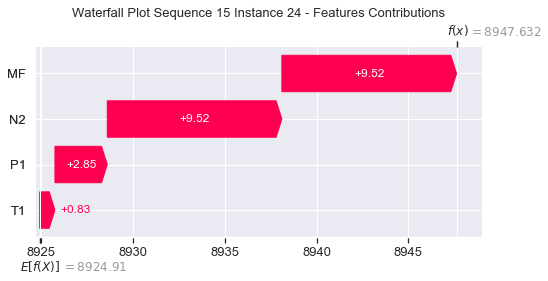

None

Contribution: [ 4.99227976  3.79457689 16.10717167 15.39198527]


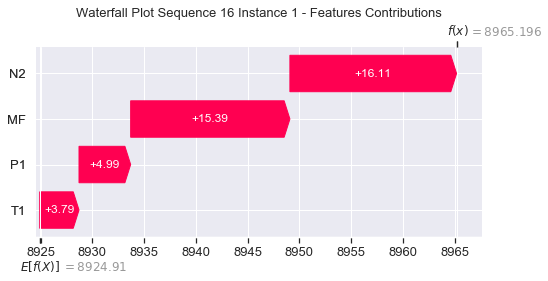

None

Contribution: [0.03732576 0.08860905 0.11427777 0.09305901]


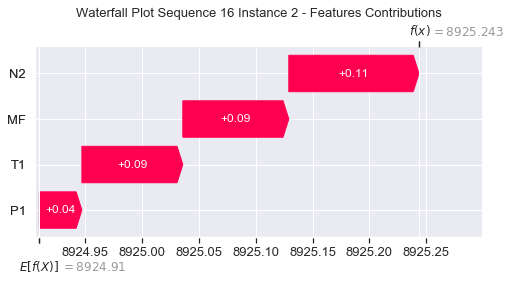

None

Contribution: [0.23508907 0.2755367  0.78411703 0.71174459]


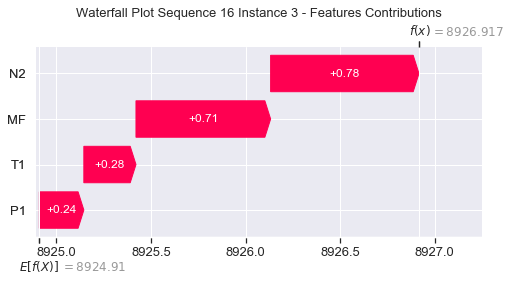

None

Contribution: [0.32778967 0.32330488 1.06277138 0.97722745]


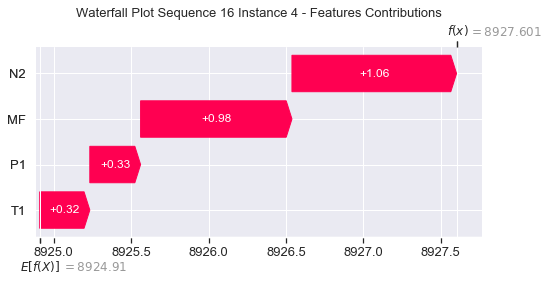

None

Contribution: [0.28027185 0.26963165 0.89214148 0.82674642]


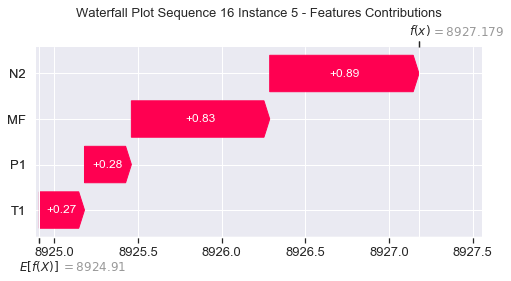

None

Contribution: [0.25471765 0.24116839 0.81075447 0.75113608]


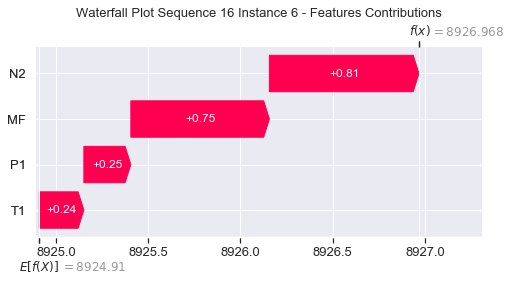

None

Contribution: [0.2439372  0.23379944 0.77805852 0.72077411]


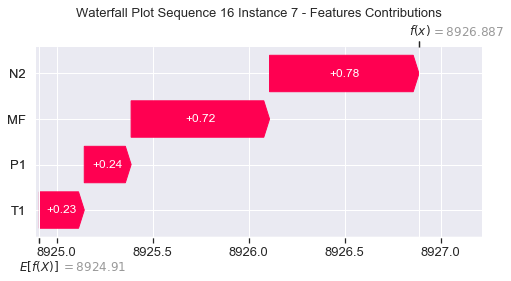

None

Contribution: [0.23943346 0.22790079 0.76434132 0.70805741]


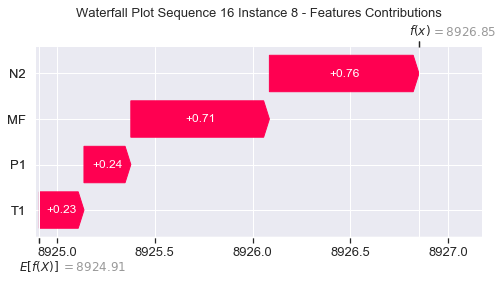

None

Contribution: [0.23991827 0.22447926 0.76677879 0.71190062]


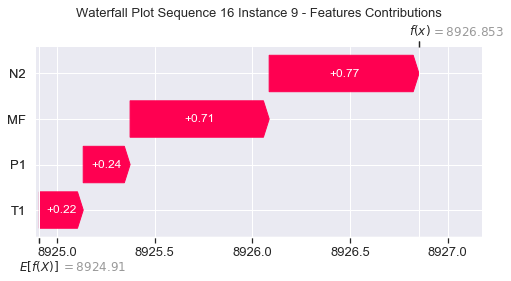

None

Contribution: [0.24402432 0.24086726 0.78027497 0.72450625]


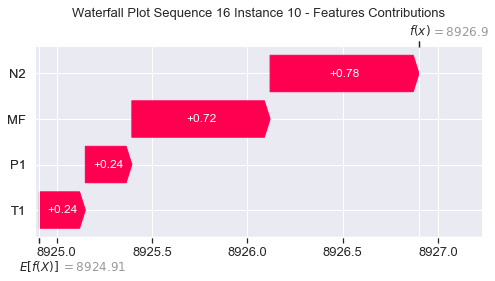

None

Contribution: [0.25221726 0.22737096 0.80675424 0.74917331]


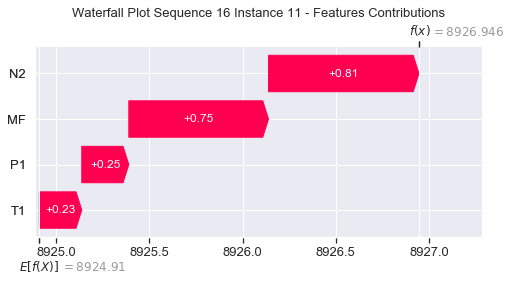

None

Contribution: [0.26040891 0.25239447 0.84117965 0.77913106]


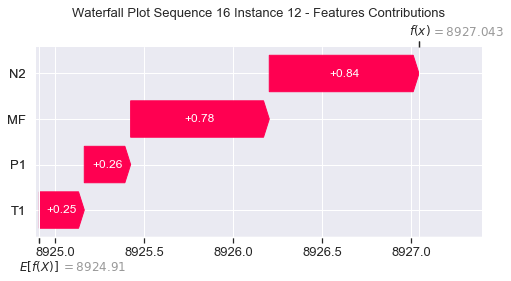

None

Contribution: [0.27801064 0.27246156 0.89812485 0.83144199]


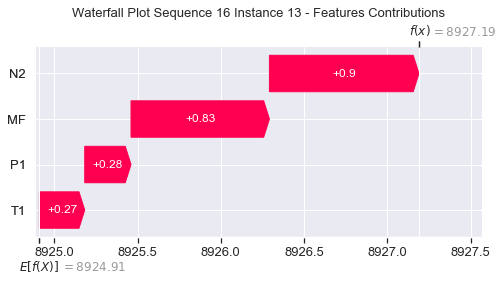

None

Contribution: [0.29941396 0.29266916 0.97023004 0.8944327 ]


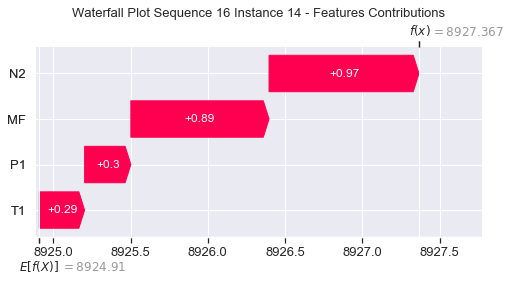

None

Contribution: [0.33284746 0.32389657 1.07344736 0.99137015]


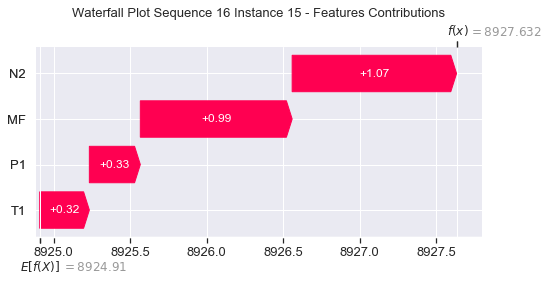

None

Contribution: [0.37048318 0.34767923 1.20720213 1.09882971]


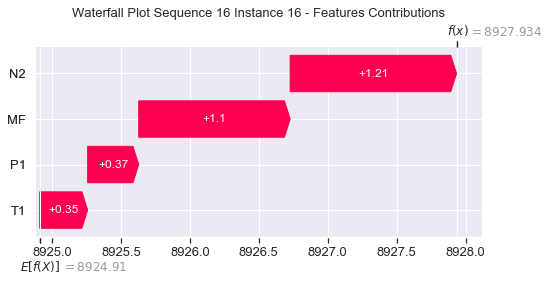

None

Contribution: [0.43323632 0.42204605 1.39777972 1.29019686]


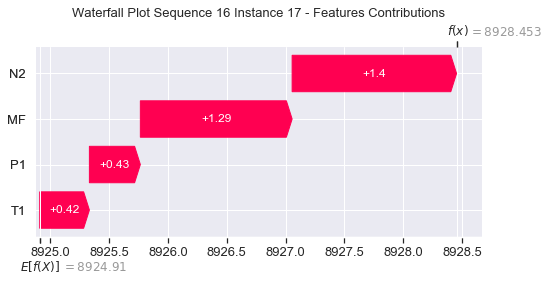

None

Contribution: [0.51432717 0.49525721 1.65740388 1.52915173]


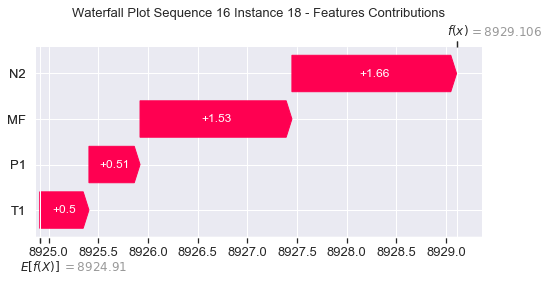

None

Contribution: [0.63722219 0.59018228 2.02971683 1.89912711]


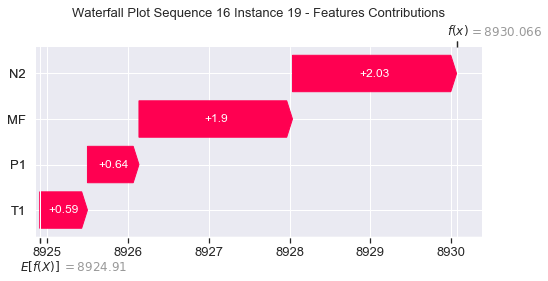

None

Contribution: [0.80119845 0.76268082 2.57320482 2.37140535]


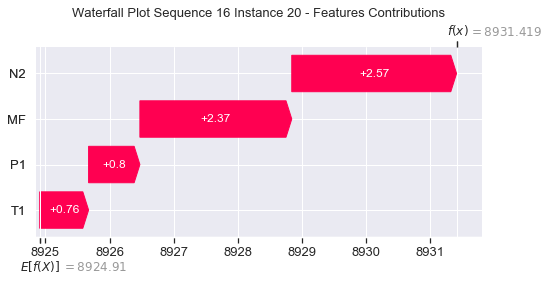

None

Contribution: [1.05617089 0.9893508  3.3927157  3.12634838]


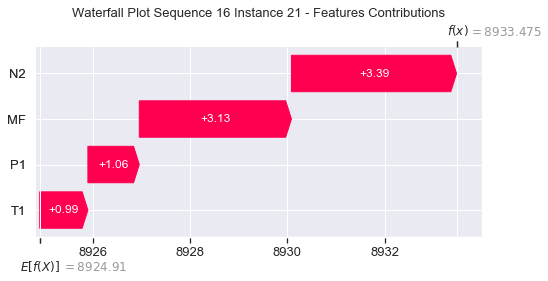

None

Contribution: [1.45572757 1.3115508  4.67800863 4.31731664]


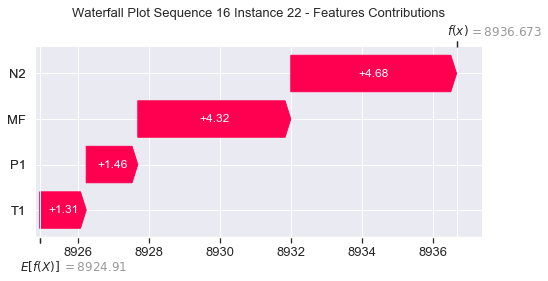

None

Contribution: [2.05187104 1.59786916 6.70078122 6.2498367 ]


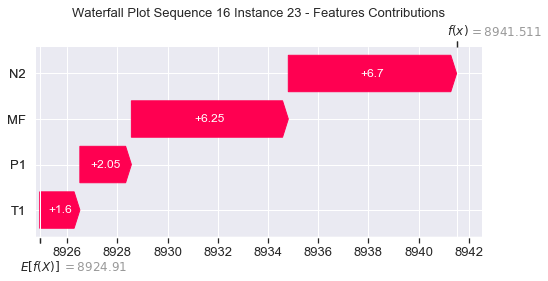

None

Contribution: [2.85843905 0.36248403 9.46940438 9.31438162]


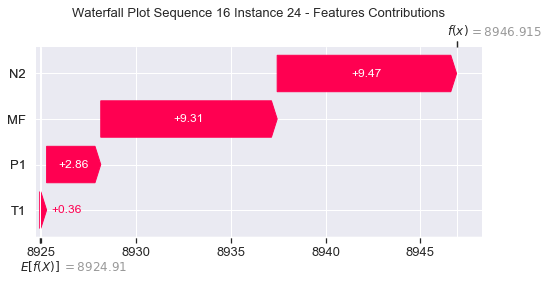

None

Contribution: [ 5.00328205  3.72568721 16.22613865 15.31763117]


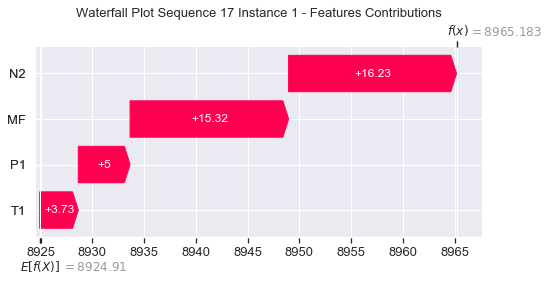

None

Contribution: [0.03869283 0.09847968 0.11940235 0.09673421]


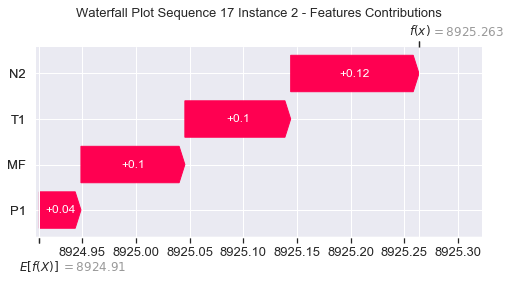

None

Contribution: [0.23875722 0.28100767 0.79710702 0.72345965]


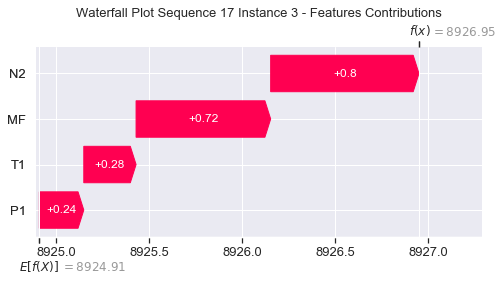

None

Contribution: [0.33629521 0.29991148 1.07569886 1.00898306]


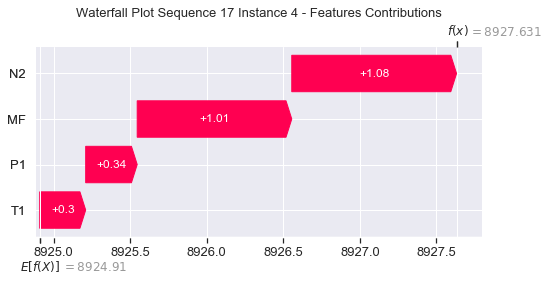

None

Contribution: [0.28246654 0.25294544 0.89895283 0.8283959 ]


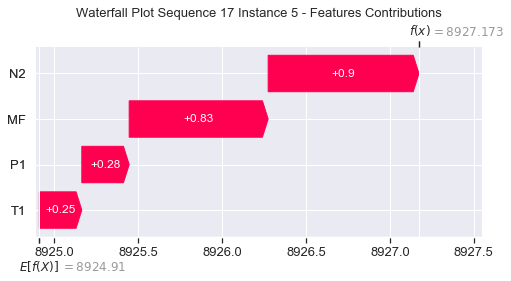

None

Contribution: [0.25477932 0.22844711 0.81588246 0.74855882]


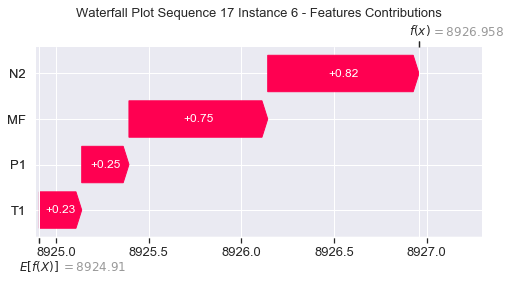

None

Contribution: [0.2445567  0.21937879 0.78294958 0.71833987]


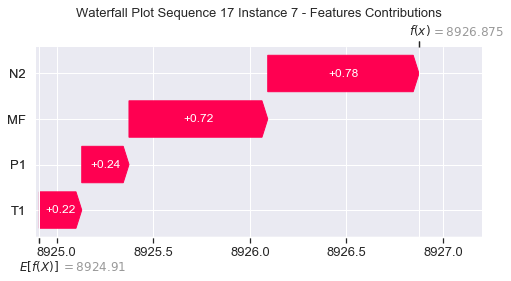

None

Contribution: [0.24005885 0.21669457 0.76928979 0.70564524]


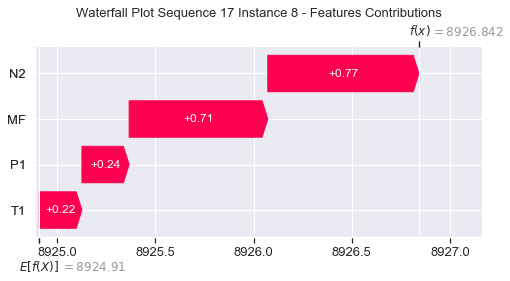

None

Contribution: [0.24173011 0.21766241 0.77074678 0.70906856]


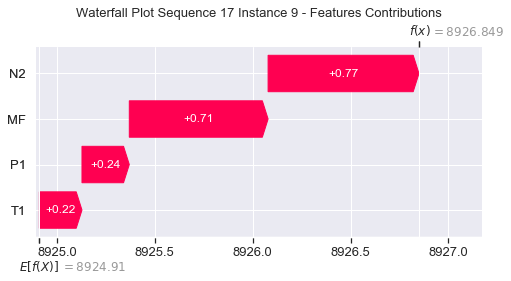

None

Contribution: [0.24436959 0.2303594  0.78771525 0.7242481 ]


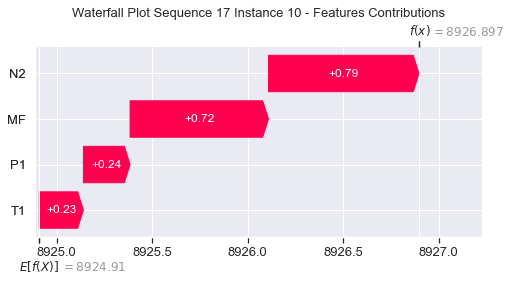

None

Contribution: [0.25232651 0.23171261 0.81070729 0.74256954]


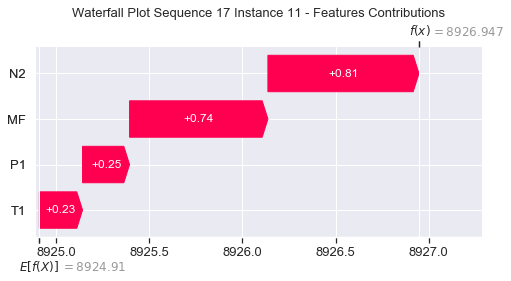

None

Contribution: [0.26271249 0.24082223 0.84678685 0.77447778]


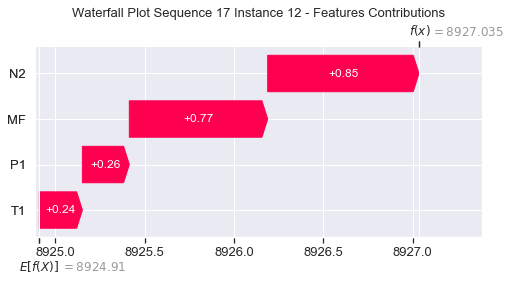

None

Contribution: [0.2807167  0.25805503 0.9042227  0.82733195]


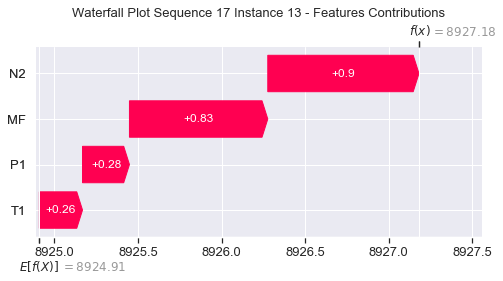

None

Contribution: [0.29783351 0.26979504 0.97672769 0.89030762]


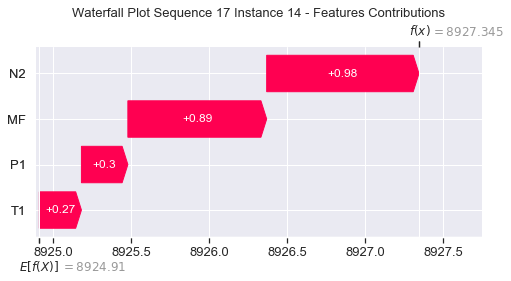

None

Contribution: [0.33530356 0.30979245 1.07991078 0.98662112]


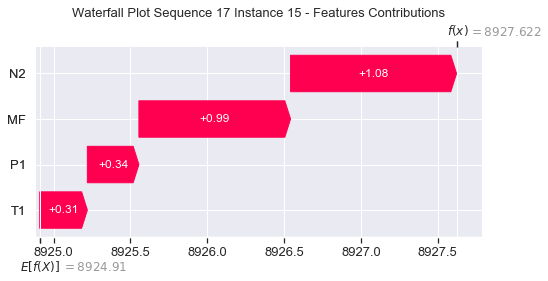

None

Contribution: [0.38574859 0.35629544 1.21893937 1.11961138]


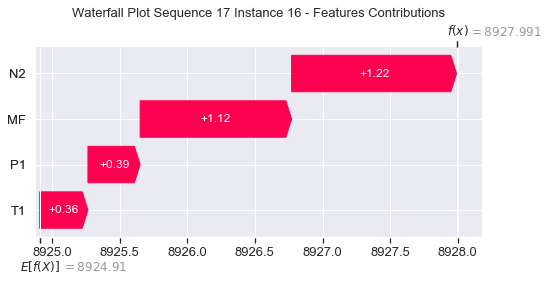

None

Contribution: [0.43657882 0.4012345  1.40733419 1.28458408]


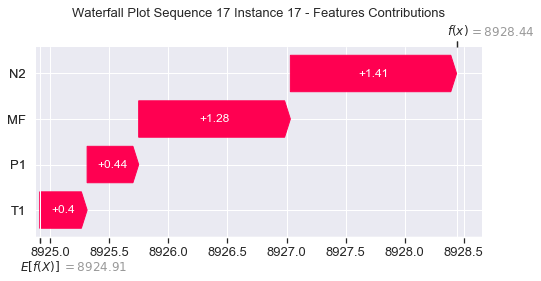

None

Contribution: [0.51722063 0.47395011 1.66832187 1.52141412]


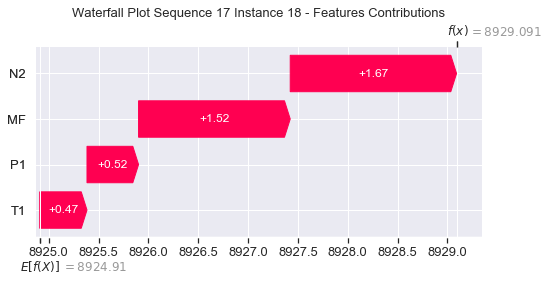

None

Contribution: [0.64077019 0.60250203 2.04396125 1.8640024 ]


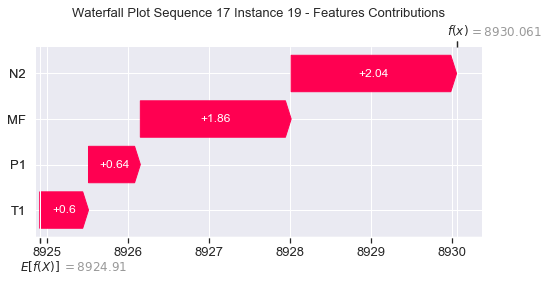

None

Contribution: [0.8059976  0.72857283 2.58871575 2.36285247]


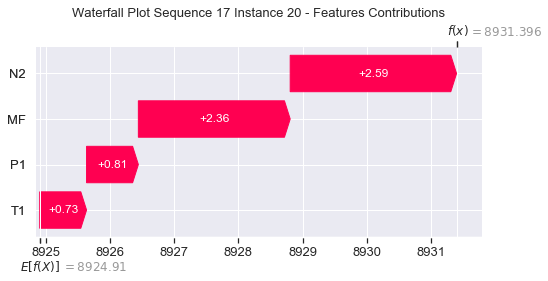

None

Contribution: [1.06300701 0.94635514 3.4104387  3.11413274]


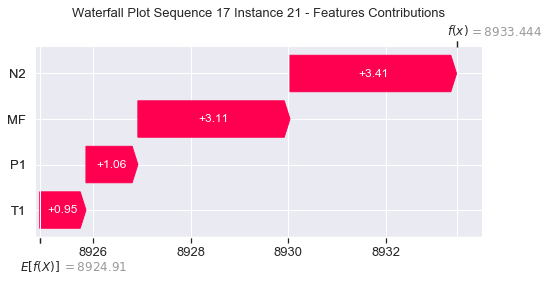

None

Contribution: [1.46506515 1.26206444 4.6999063  4.2973409 ]


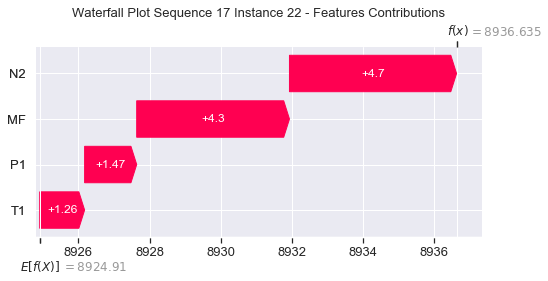

None

Contribution: [2.05962107 1.51961645 6.73135652 6.18421089]


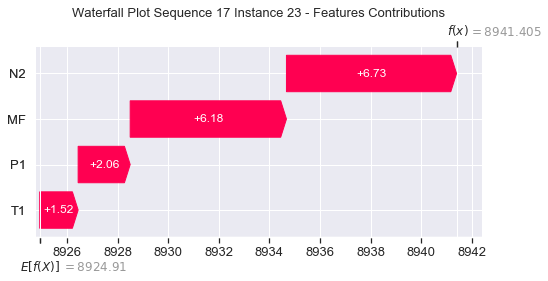

None

Contribution: [ 2.91797886 -0.03245601  9.54961699  9.18020765]


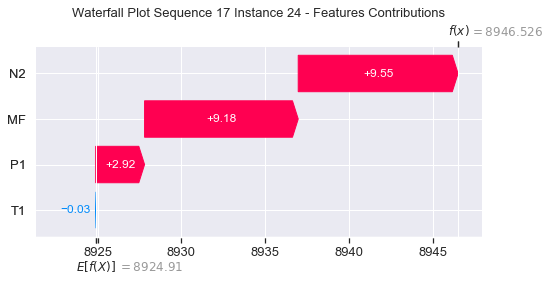

None

Contribution: [ 5.17700674  3.09571439 16.19648855 15.3524163 ]


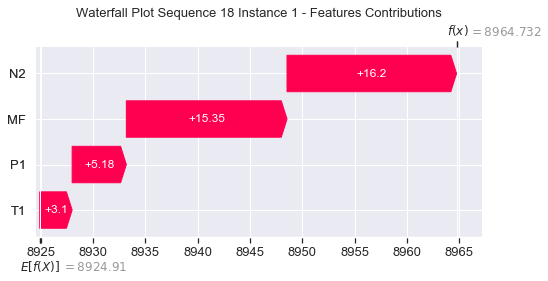

None

Contribution: [0.03694631 0.10117924 0.11672209 0.09677112]


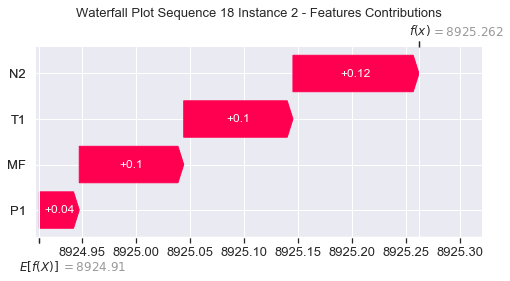

None

Contribution: [0.23632057 0.27833401 0.78842296 0.71549039]


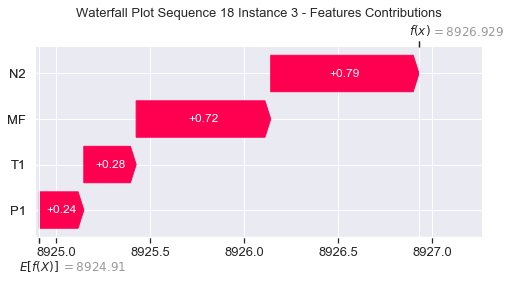

None

Contribution: [0.32397667 0.28023674 1.05885652 0.97744398]


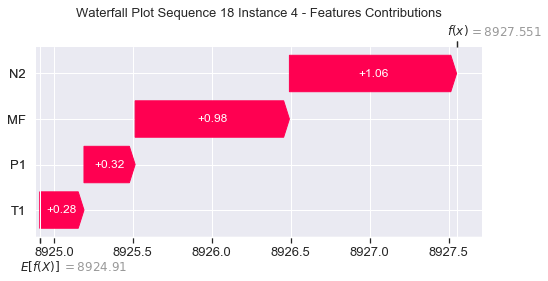

None

Contribution: [0.27941812 0.25345475 0.88888031 0.82257673]


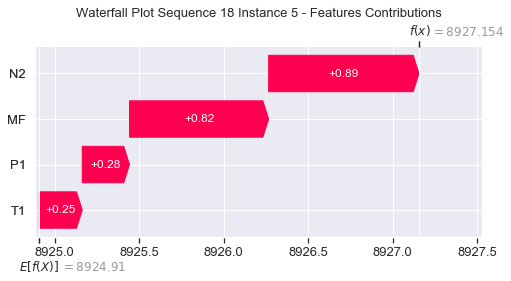

None

Contribution: [0.25571901 0.23337694 0.80838331 0.75213862]


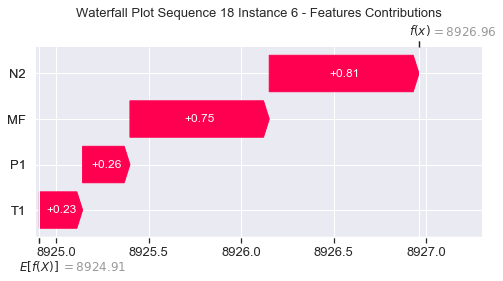

None

Contribution: [0.24648409 0.22571438 0.77599169 0.72265443]


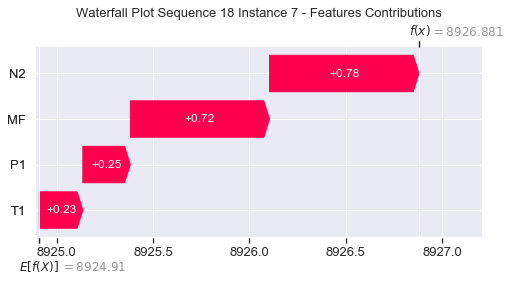

None

Contribution: [0.24103723 0.22257671 0.76206115 0.70814714]


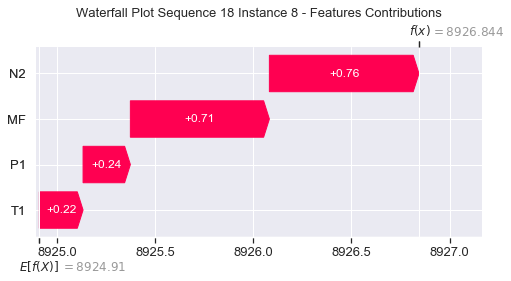

None

Contribution: [0.24142309 0.23091963 0.76356213 0.70710518]


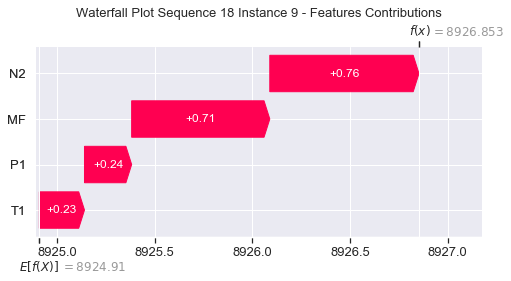

None

Contribution: [0.24934468 0.23167594 0.77656697 0.71956696]


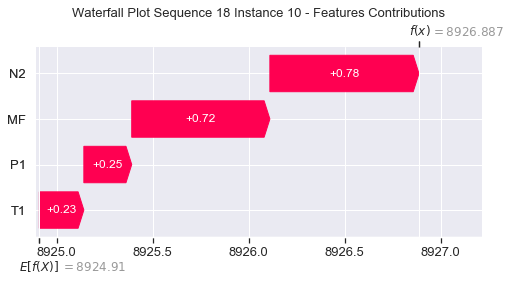

None

Contribution: [0.2527283  0.24332395 0.80309591 0.74597507]


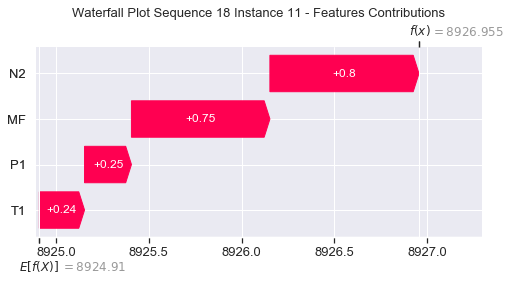

None

Contribution: [0.26935073 0.25404994 0.83911547 0.78600016]


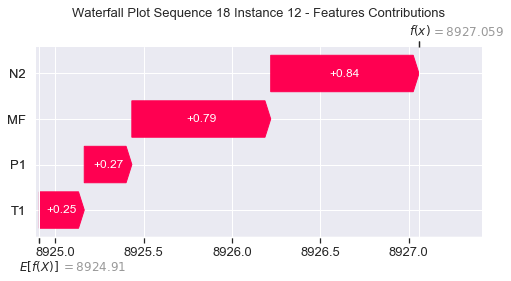

None

Contribution: [0.28705744 0.27173041 0.89599005 0.8370469 ]


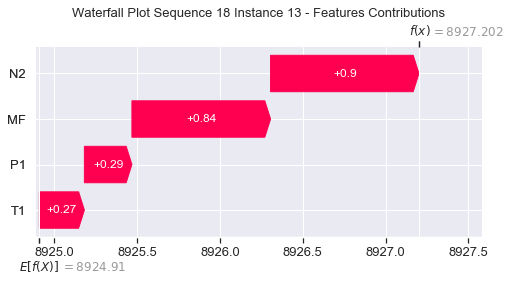

None

Contribution: [0.3030062  0.30423709 0.96687274 0.89113616]


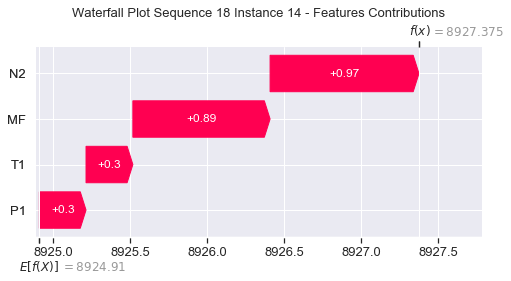

None

Contribution: [0.34074992 0.32483857 1.07100833 0.99599522]


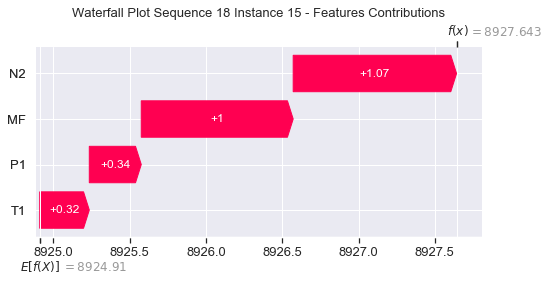

None

Contribution: [0.37623938 0.37511092 1.20343803 1.10390212]


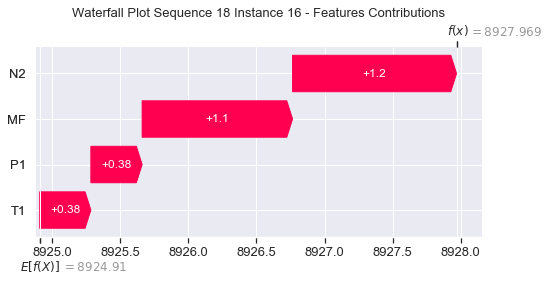

None

Contribution: [0.44498365 0.42213277 1.39696769 1.29614837]


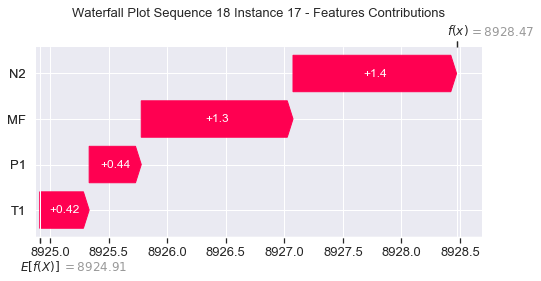

None

Contribution: [0.52667297 0.49668756 1.6577165  1.53497836]


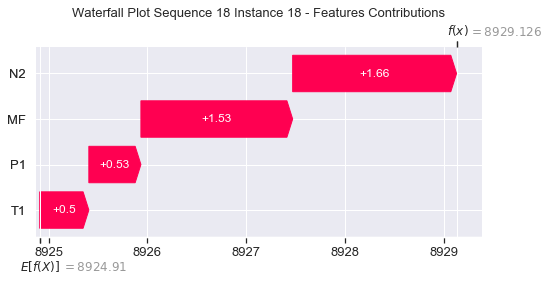

None

Contribution: [0.64625929 0.60087732 2.03232144 1.88493448]


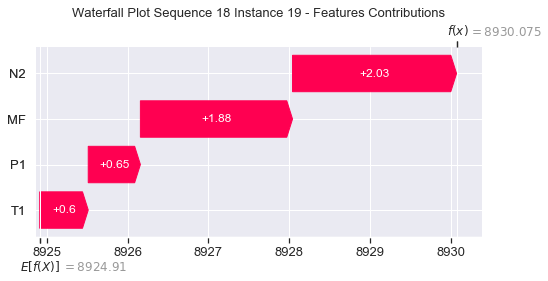

None

Contribution: [0.81341506 0.75278184 2.57632422 2.36814529]


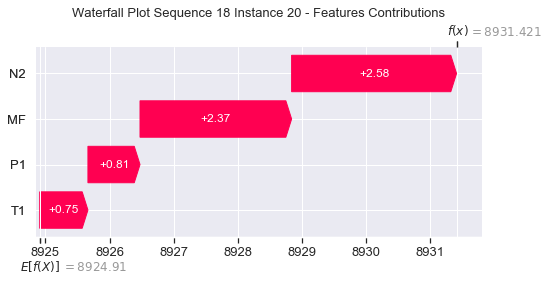

None

Contribution: [1.07364434 0.98043154 3.39740201 3.12233768]


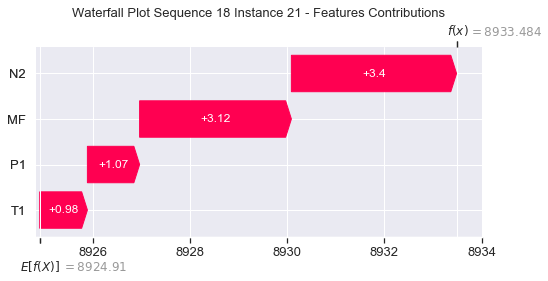

None

Contribution: [1.47624491 1.30375458 4.68540869 4.30595188]


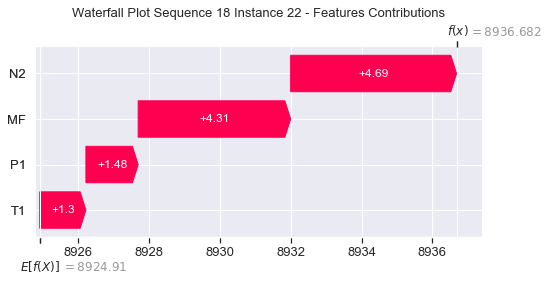

None

Contribution: [2.09781432 1.61573364 6.72062539 6.24060216]


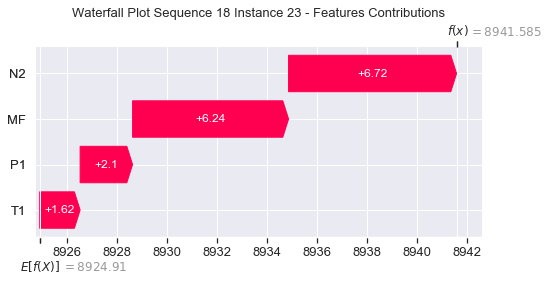

None

Contribution: [2.97273166 0.21804273 9.52825439 9.1564925 ]


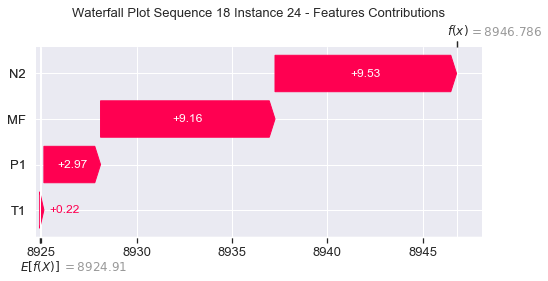

None

Contribution: [ 5.25547905  3.44668381 16.20613362 15.16719476]


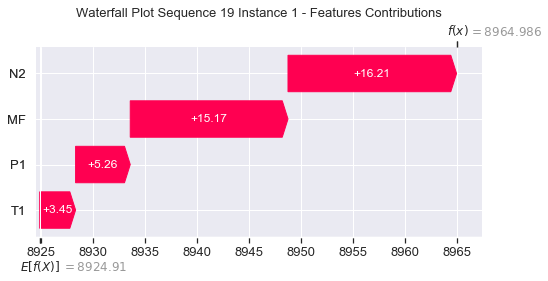

None

Contribution: [0.03532184 0.0973938  0.11673396 0.09543383]


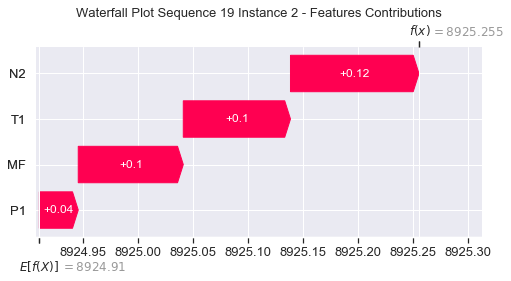

None

Contribution: [0.23680281 0.27885368 0.79147092 0.7171037 ]


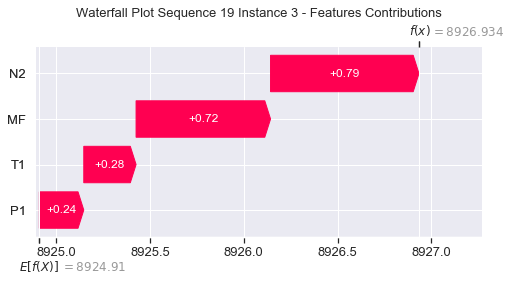

None

Contribution: [0.3312509  0.29325928 1.06748961 0.98866206]


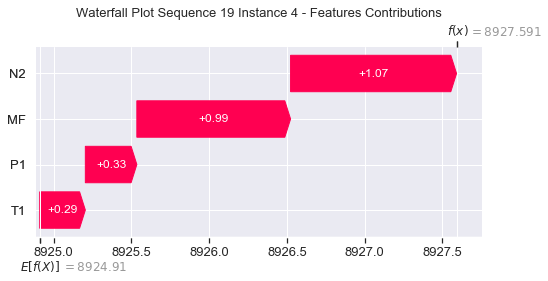

None

Contribution: [0.28316667 0.25762297 0.8948834  0.82902824]


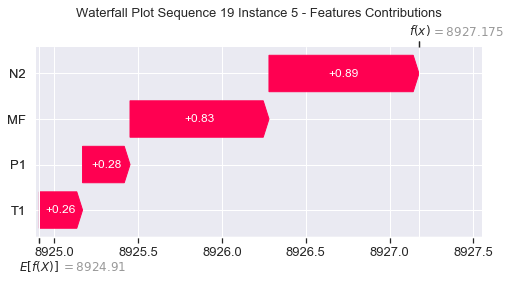

None

Contribution: [0.25565378 0.23196551 0.81137873 0.74607327]


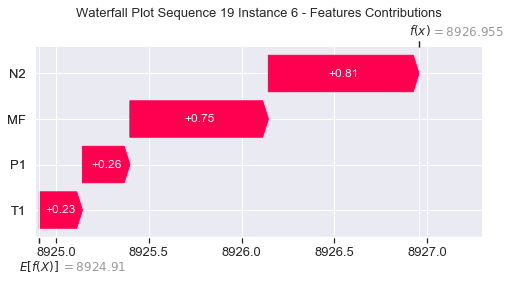

None

Contribution: [0.24625209 0.22506061 0.77875522 0.71662901]


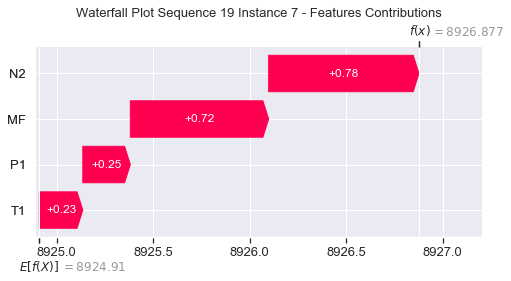

None

Contribution: [0.24138728 0.22101433 0.76513728 0.70458304]


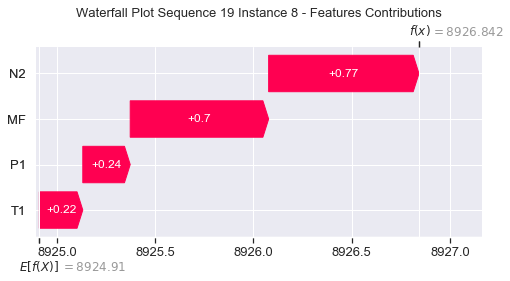

None

Contribution: [0.2430867  0.22749998 0.76873416 0.71066725]


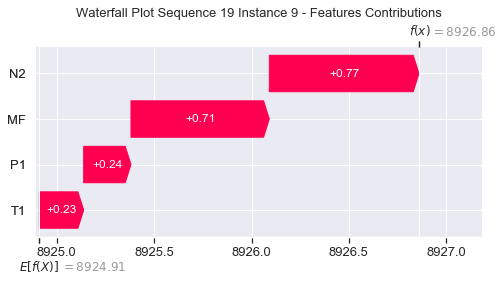

None

Contribution: [0.24853714 0.23246624 0.78140002 0.71992569]


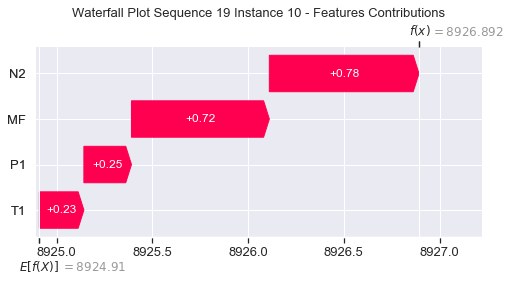

None

Contribution: [0.25171734 0.23202618 0.80701594 0.74144709]


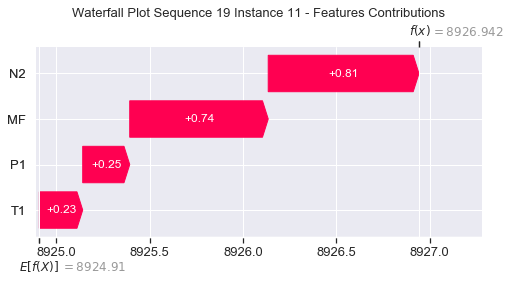

None

Contribution: [0.26462165 0.24503697 0.84062651 0.77148571]


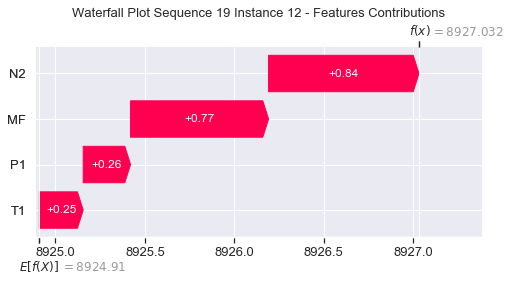

None

Contribution: [0.28341885 0.26429893 0.89772093 0.82542013]


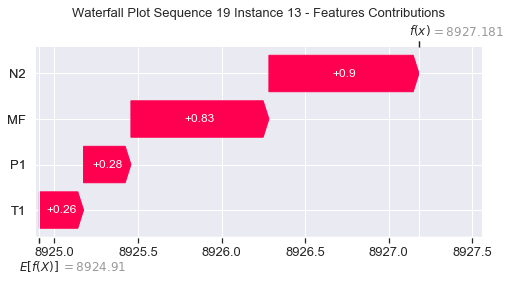

None

Contribution: [0.30889623 0.2902141  0.97362067 0.90616544]


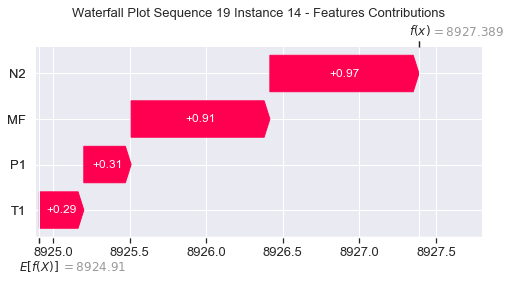

None

Contribution: [0.33924898 0.31622149 1.07272261 0.98608852]


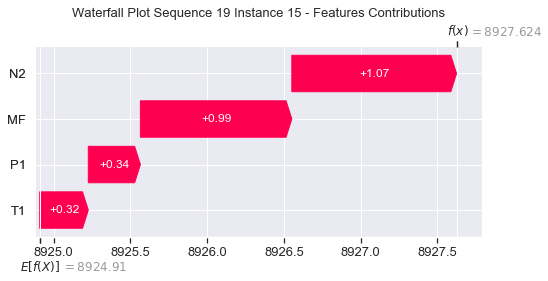

None

Contribution: [0.38068889 0.36672756 1.20885282 1.114855  ]


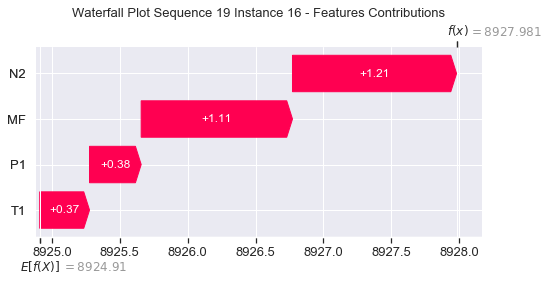

None

Contribution: [0.44388151 0.41355322 1.39812459 1.28612643]


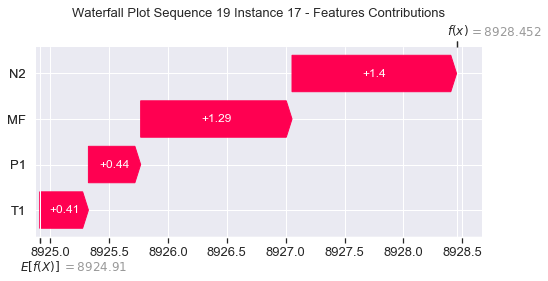

None

Contribution: [0.5260961  0.48615706 1.65760434 1.52432548]


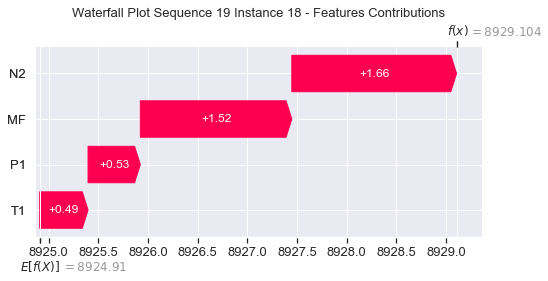

None

Contribution: [0.63709785 0.59340534 2.02908621 1.85289496]


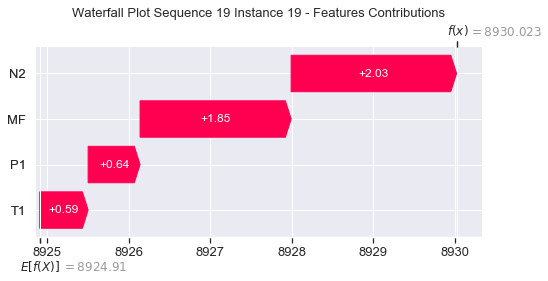

None

Contribution: [0.82139371 0.74942014 2.57229037 2.37432498]


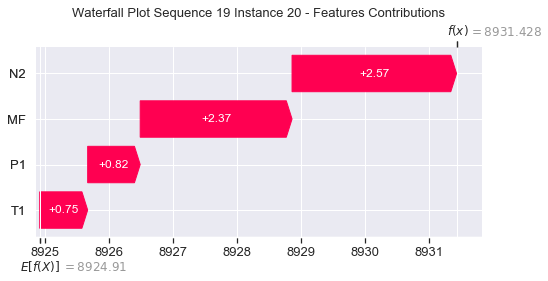

None

Contribution: [1.08402056 0.97240121 3.39132549 3.13325598]


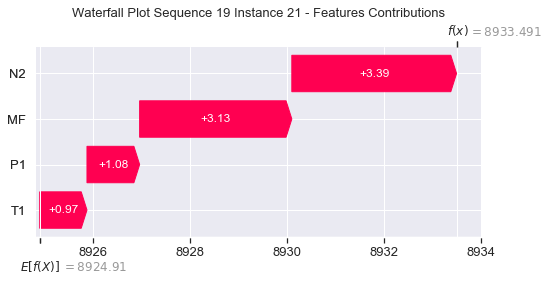

None

Contribution: [1.49558877 1.28894647 4.67676174 4.33224984]


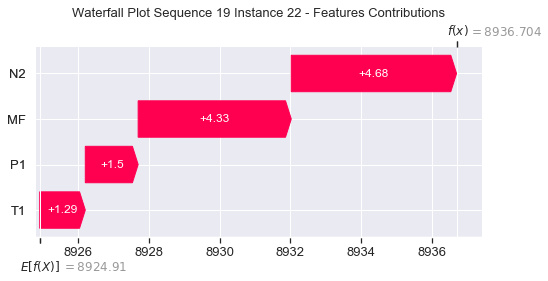

None

Contribution: [2.12297782 1.56218085 6.69404534 6.25627895]


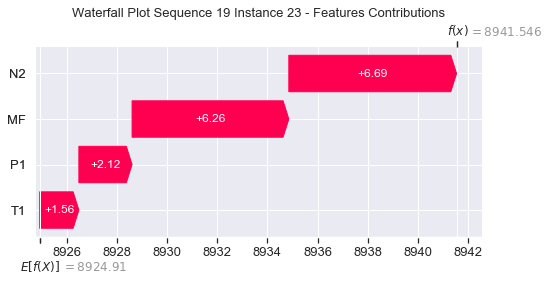

None

Contribution: [2.97991841 0.01705114 9.38259307 9.12766598]


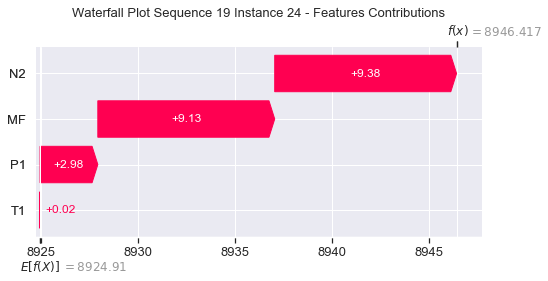

None

Contribution: [ 4.90510346  3.05993503 16.20672756 14.68136441]


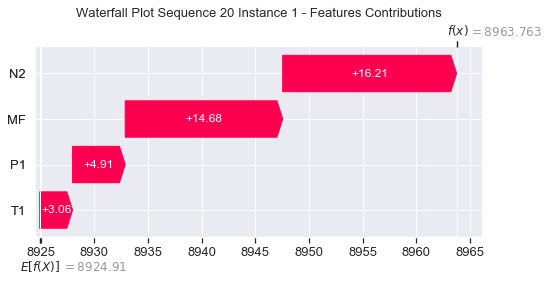

None

Contribution: [0.03461121 0.10363592 0.11912799 0.09345712]


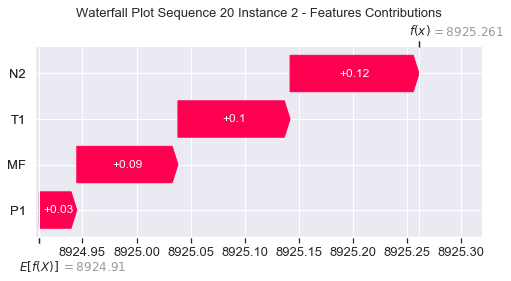

None

Contribution: [0.24137977 0.28064787 0.80376994 0.72896215]


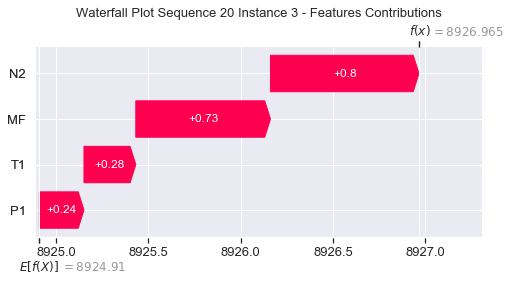

None

Contribution: [0.32446212 0.29812917 1.05375438 0.96150829]


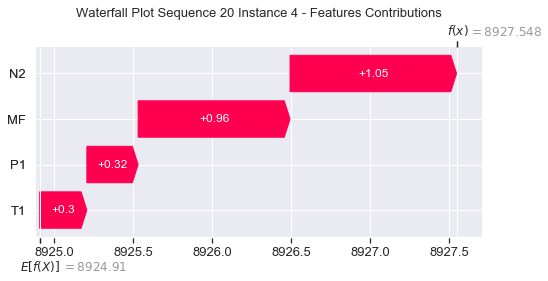

None

Contribution: [0.28408761 0.2656594  0.88747532 0.82159964]


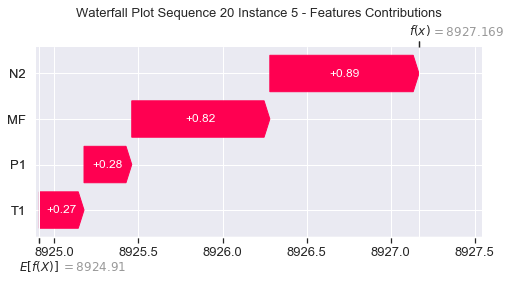

None

Contribution: [0.25456636 0.23657472 0.80547374 0.73883337]


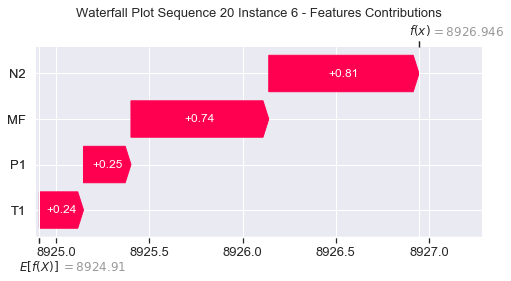

None

Contribution: [0.24508424 0.22886022 0.77390508 0.7111983 ]


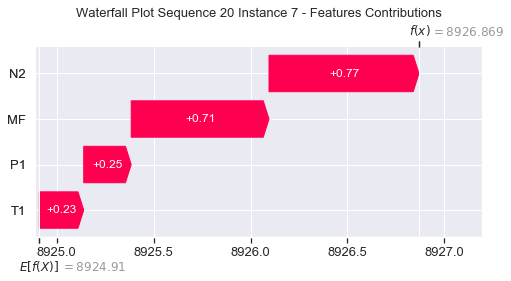

None

Contribution: [0.24029725 0.22470861 0.76011719 0.69880538]


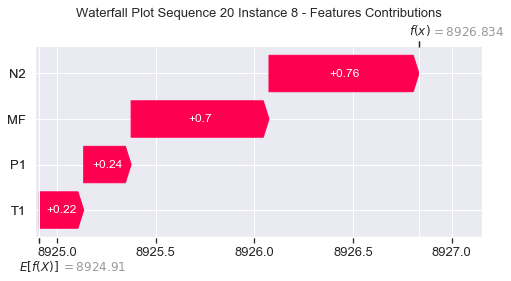

None

Contribution: [0.23934241 0.22539891 0.76318261 0.70353926]


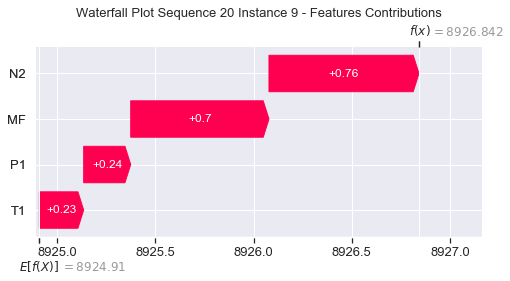

None

Contribution: [0.24988049 0.21566946 0.77471961 0.71946472]


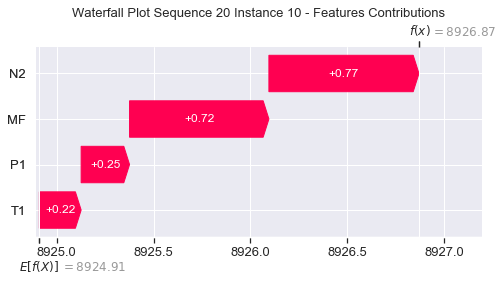

None

Contribution: [0.2482221  0.23460164 0.79950666 0.73257604]


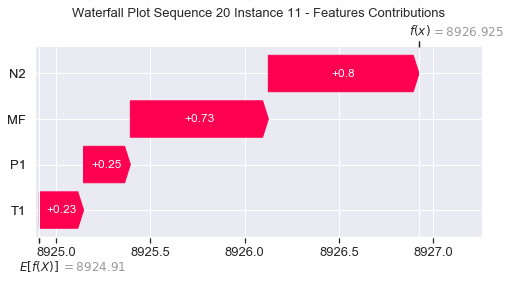

None

Contribution: [0.26473589 0.25658164 0.8355624  0.77213252]


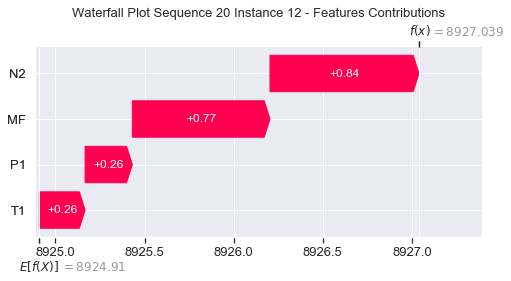

None

Contribution: [0.28355112 0.27488197 0.8928169  0.82619944]


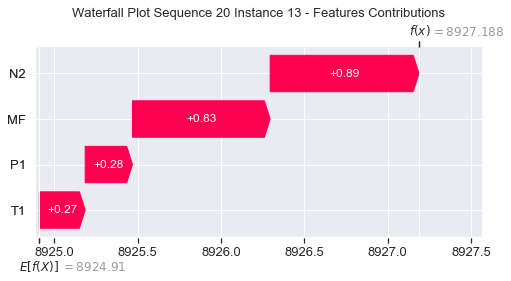

None

Contribution: [0.30538077 0.30224288 0.96551435 0.89374362]


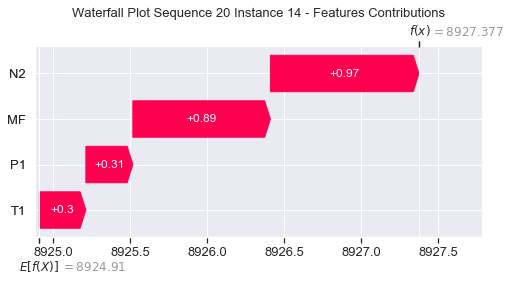

None

Contribution: [0.33803217 0.32699163 1.06719916 0.98587209]


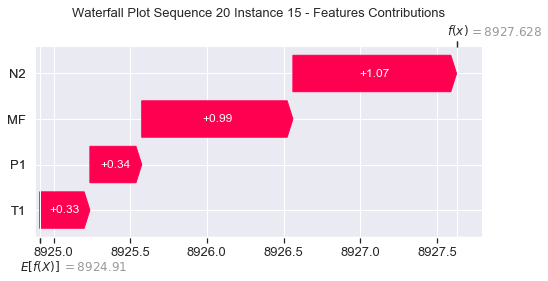

None

Contribution: [0.38016093 0.35705889 1.20455294 1.11610965]


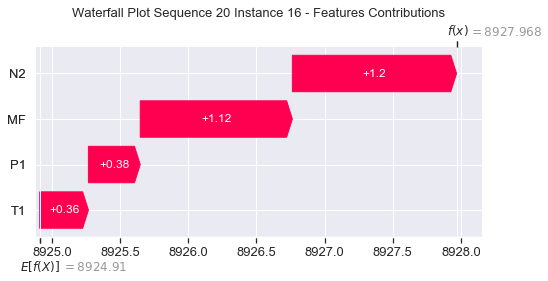

None

Contribution: [0.44178224 0.42238722 1.39225038 1.2868292 ]


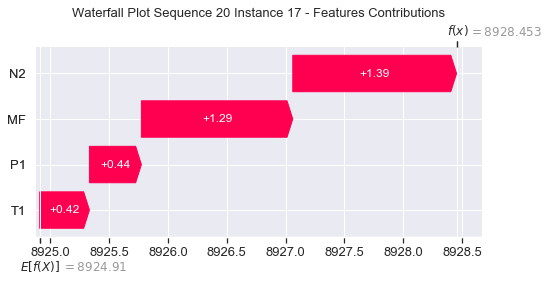

None

Contribution: [0.52356416 0.49494773 1.65096619 1.52436325]


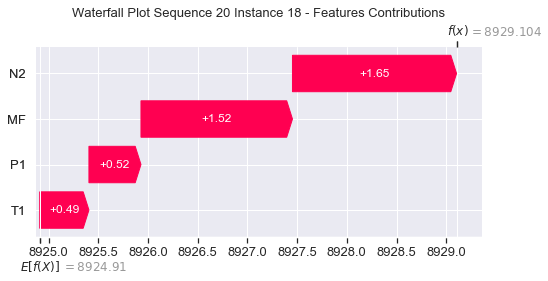

None

Contribution: [0.64665601 0.60381151 2.02500546 1.86633649]


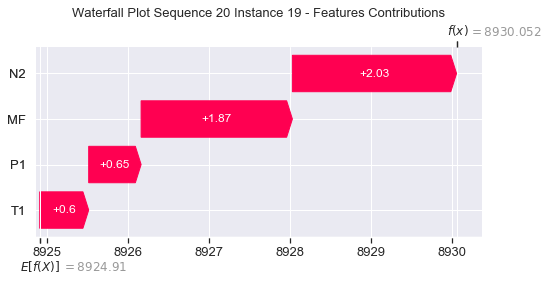

None

Contribution: [0.81885201 0.75468139 2.5665765  2.37606859]


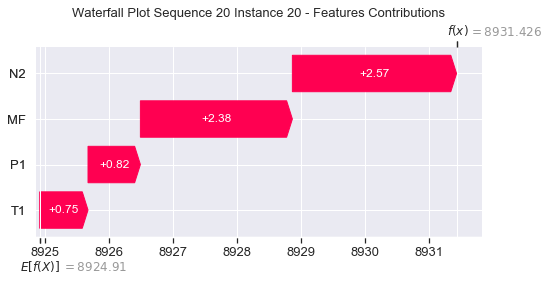

None

Contribution: [1.08270164 0.9872338  3.38432389 3.14014156]


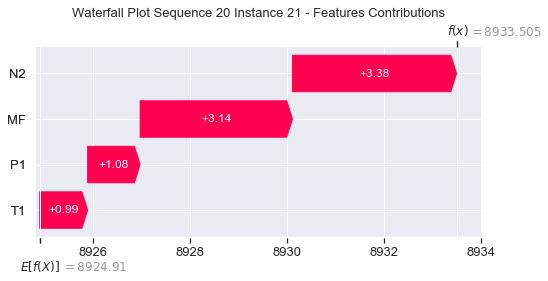

None

Contribution: [1.49735089 1.32276573 4.6679734  4.34805058]


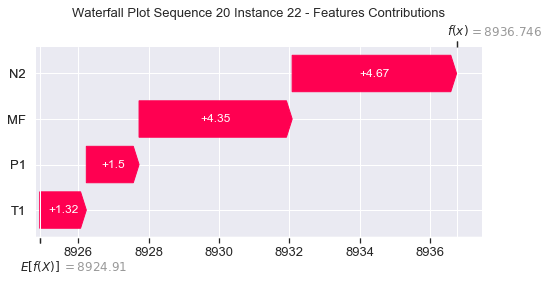

None

Contribution: [2.12652385 1.62310982 6.68895283 6.29416751]


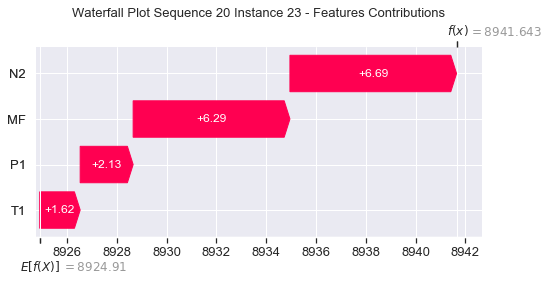

None

Contribution: [3.09442884 0.27272668 9.40944647 9.47338916]


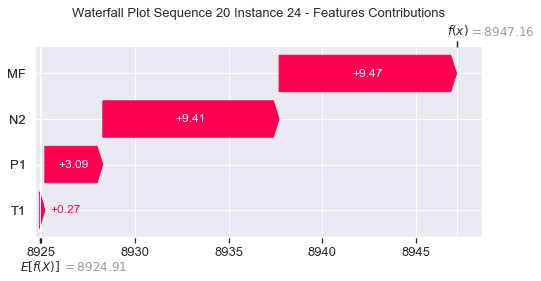

None

Contribution: [ 5.1228952   3.40753248 16.01479457 15.30847941]


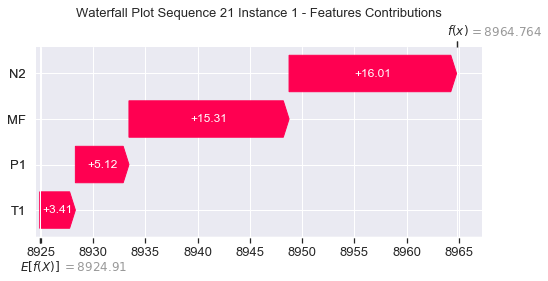

None

Contribution: [0.03126079 0.09365803 0.11173184 0.08367009]


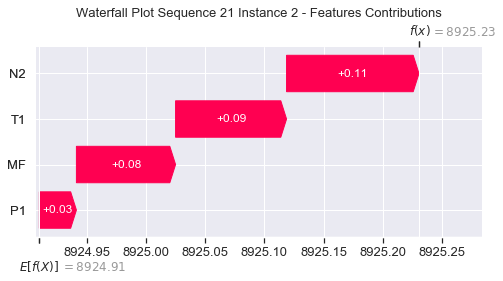

None

Contribution: [0.23641785 0.27606055 0.78616089 0.7147543 ]


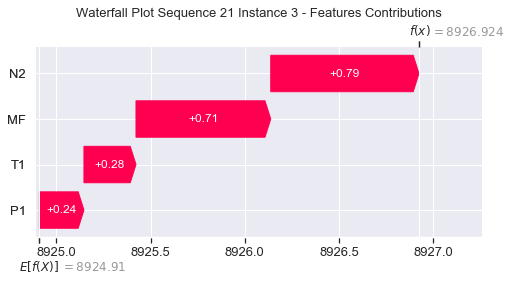

None

Contribution: [0.33394387 0.31933124 1.05615494 0.97977479]


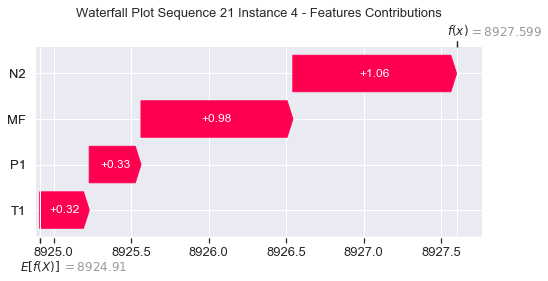

None

Contribution: [0.28304633 0.26417654 0.88791479 0.82680929]


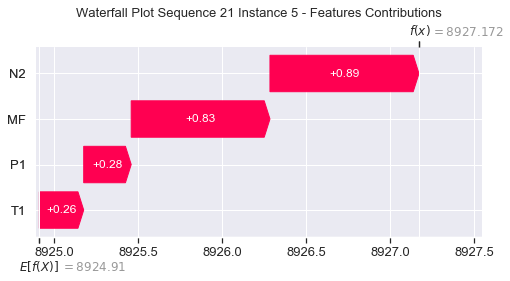

None

Contribution: [0.25924747 0.24236741 0.80770448 0.75239803]


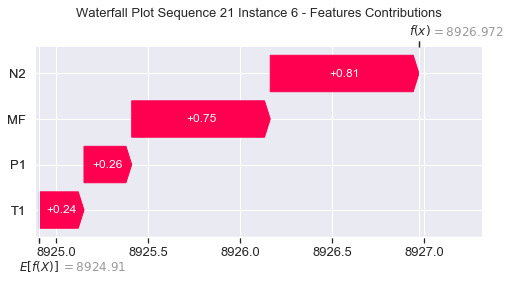

None

Contribution: [0.24821025 0.23280194 0.7753265  0.72202122]


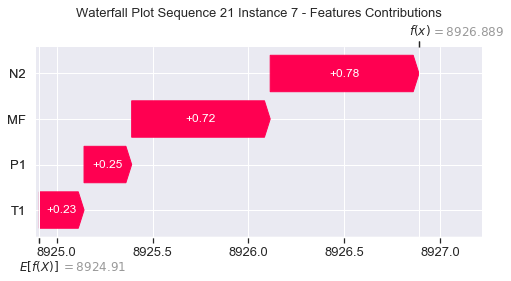

None

Contribution: [0.24397824 0.22784839 0.76204062 0.70948797]


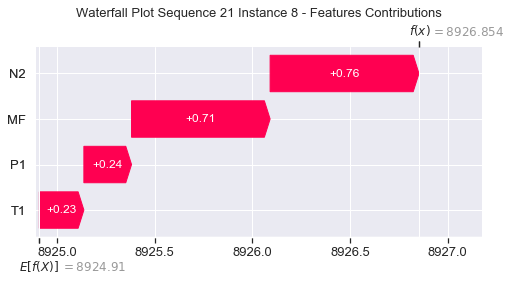

None

Contribution: [0.24522049 0.22718591 0.76423396 0.71285482]


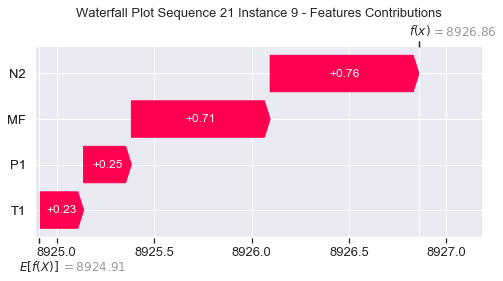

None

Contribution: [0.23895622 0.23181459 0.77676502 0.71704304]


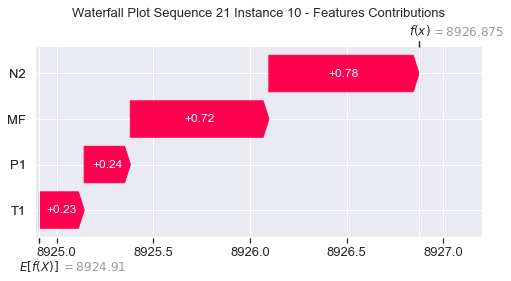

None

Contribution: [0.25881404 0.23818222 0.80464919 0.75122295]


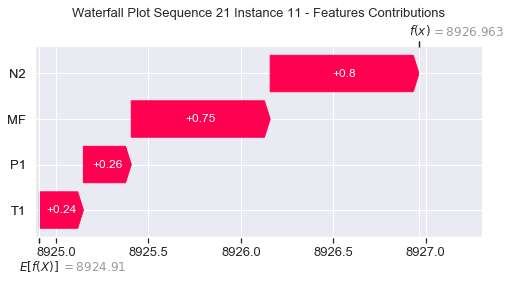

None

Contribution: [0.26451599 0.24763506 0.83901386 0.77976958]


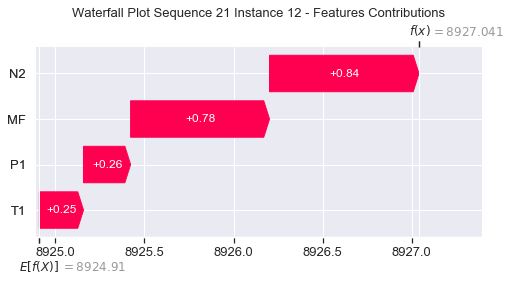

None

Contribution: [0.28239444 0.26500338 0.89600263 0.83197786]


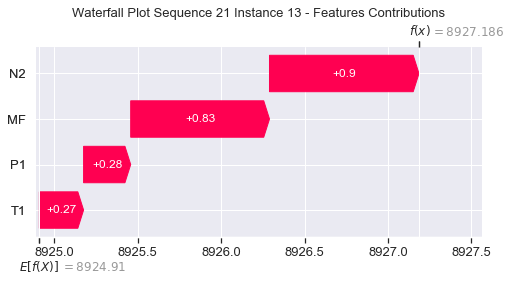

None

Contribution: [0.3120511  0.28799308 0.97082175 0.90258974]


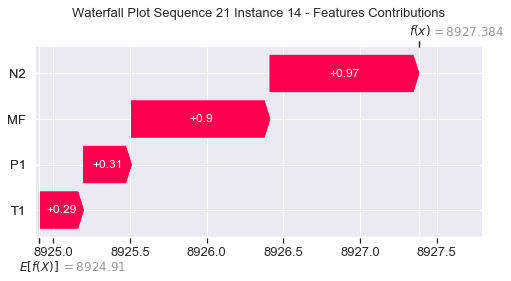

None

Contribution: [0.33994569 0.3166414  1.07227554 0.99523792]


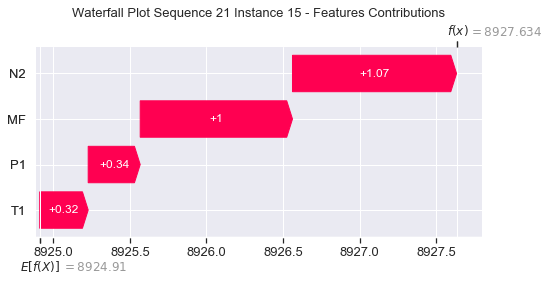

None

Contribution: [0.38375681 0.36172603 1.20930938 1.13037577]


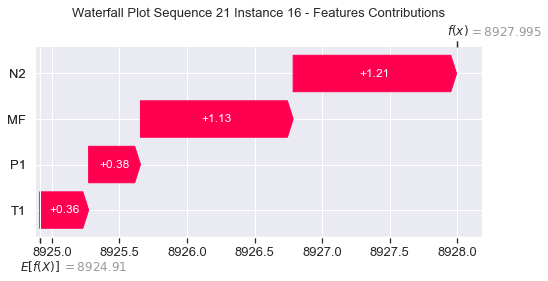

None

Contribution: [0.44377246 0.40828762 1.39963478 1.29610707]


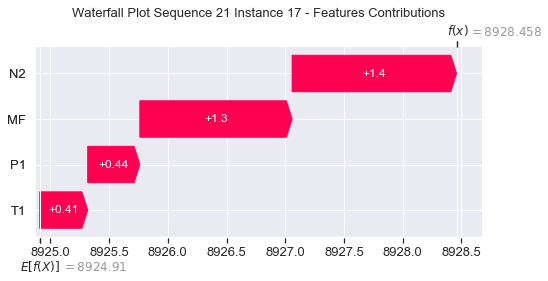

None

Contribution: [0.52785269 0.47971948 1.66111973 1.53673111]


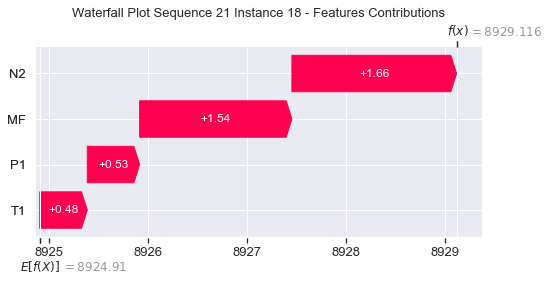

None

Contribution: [0.65268114 0.5759862  2.03768619 1.89882434]


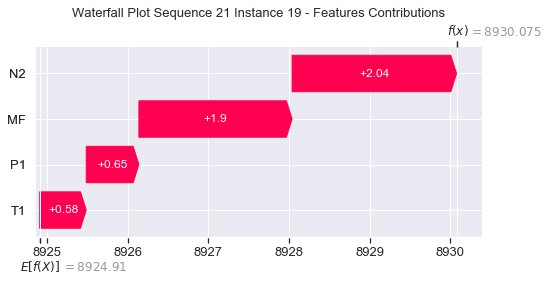

None

Contribution: [0.8224886  0.72781094 2.58215093 2.38386073]


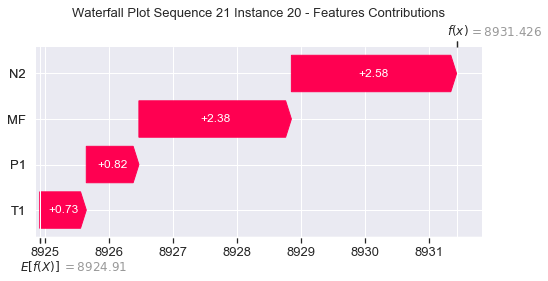

None

Contribution: [1.08316608 0.93846587 3.40525385 3.14264838]


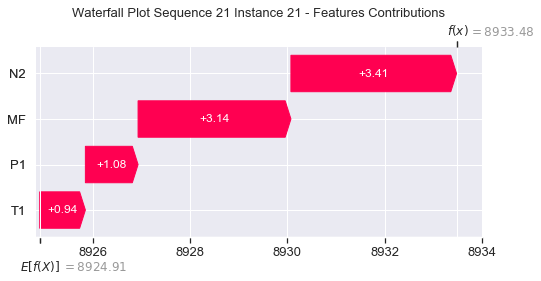

None

Contribution: [1.49425858 1.23415265 4.69748298 4.3427838 ]


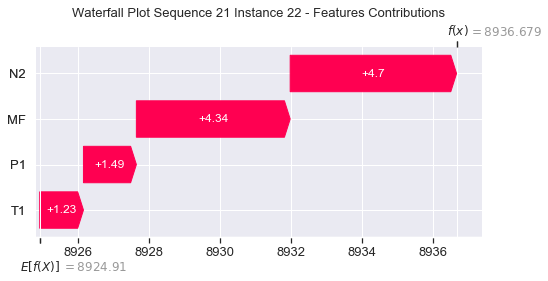

None

Contribution: [2.13416803 1.46453923 6.73981977 6.29727984]


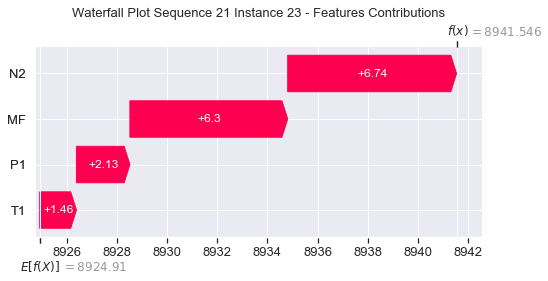

None

Contribution: [ 2.97829879 -0.37208831  9.53038849  9.19100452]


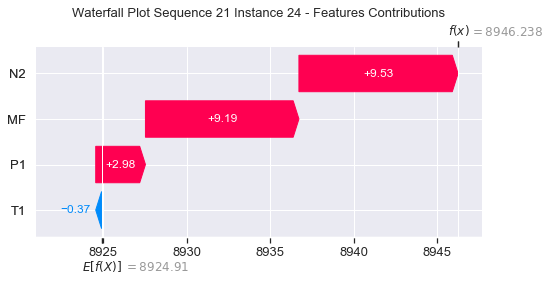

None

Contribution: [ 4.74102519  2.62917572 16.35783109 14.7348202 ]


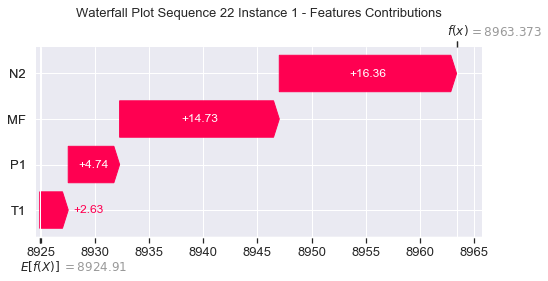

None

Contribution: [0.03775447 0.11276652 0.1210604  0.09740798]


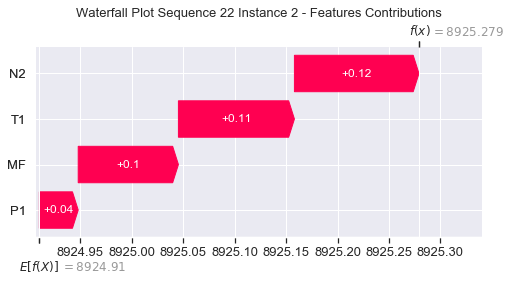

None

Contribution: [0.24333844 0.28240355 0.80995704 0.73720428]


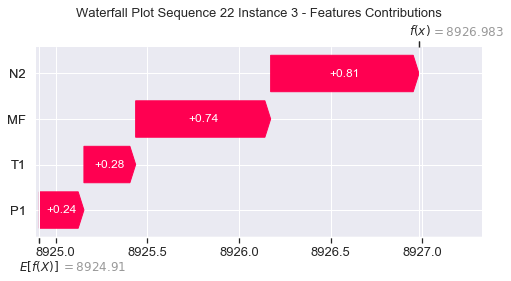

None

Contribution: [0.3329641  0.27063543 1.05622626 0.98278672]


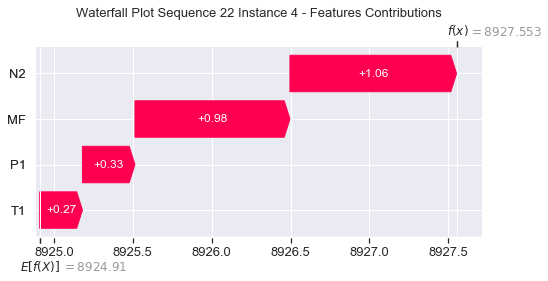

None

Contribution: [0.28127297 0.23396487 0.88356303 0.82337798]


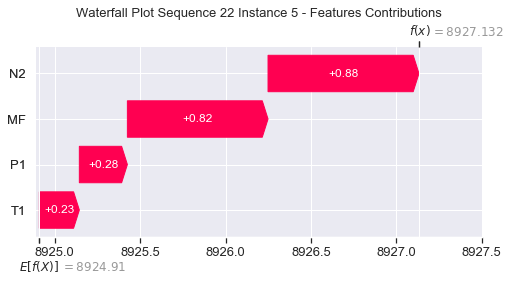

None

Contribution: [0.25477207 0.21733766 0.80195364 0.74899261]


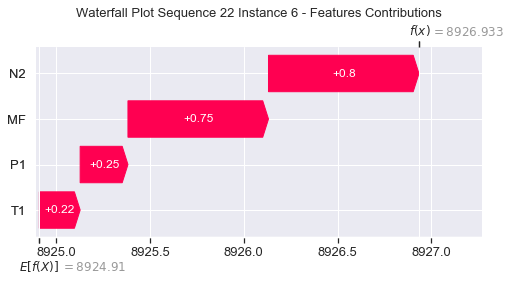

None

Contribution: [0.24569424 0.2099688  0.77008275 0.7218423 ]


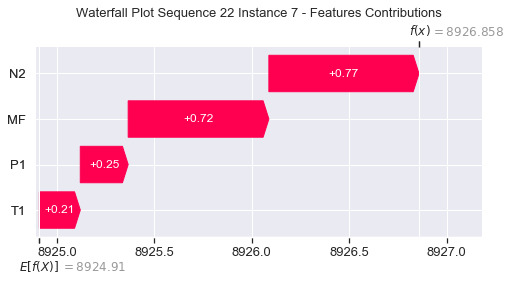

None

Contribution: [0.24049438 0.20918317 0.75661501 0.70669572]


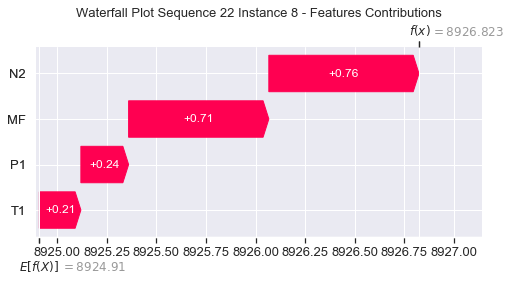

None

Contribution: [0.24037146 0.21299699 0.75702326 0.70550259]


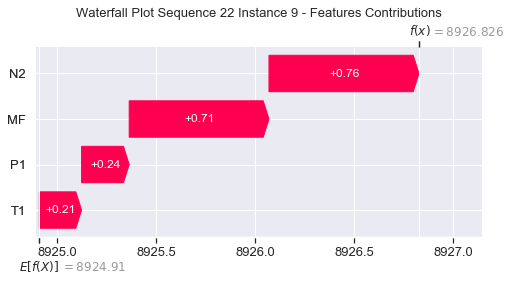

None

Contribution: [0.24699941 0.22509348 0.77151216 0.71197241]


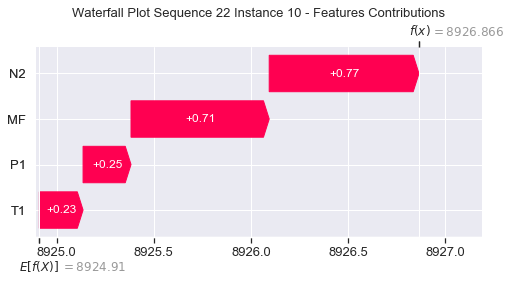

None

Contribution: [0.24788576 0.23288794 0.79485032 0.73229595]


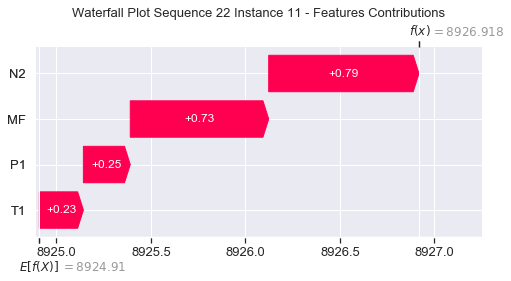

None

Contribution: [0.26256103 0.2456513  0.83222259 0.77905225]


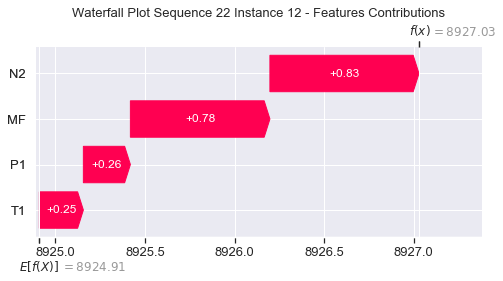

None

Contribution: [0.28153182 0.26239666 0.88895464 0.83322129]


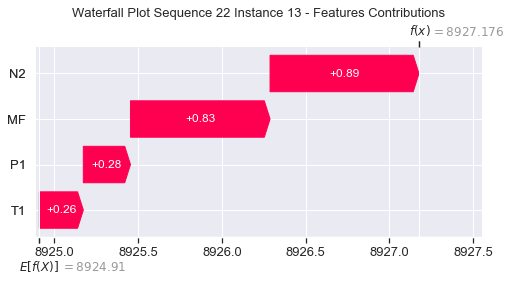

None

Contribution: [0.30314521 0.28837106 0.9620579  0.90460161]


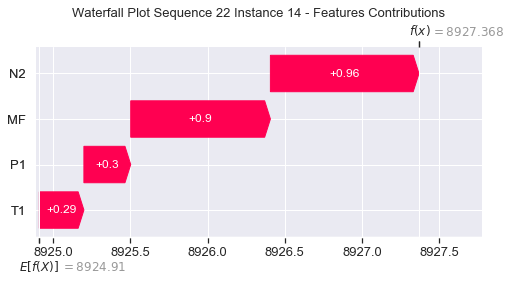

None

Contribution: [0.33695881 0.3151766  1.06267558 0.99582515]


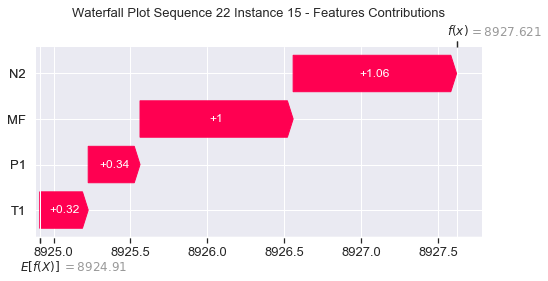

None

Contribution: [0.38288911 0.35695783 1.2004348  1.12431954]


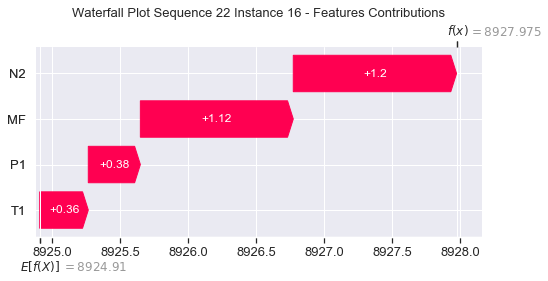

None

Contribution: [0.44209639 0.41467665 1.38652211 1.30168925]


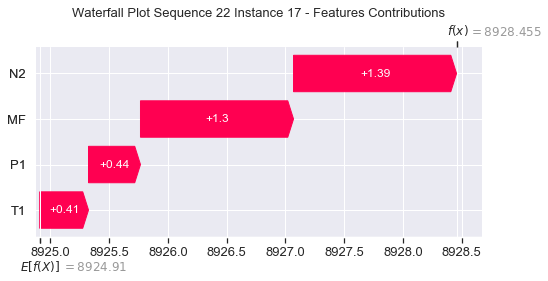

None

Contribution: [0.52458155 0.49348877 1.64557785 1.54208248]


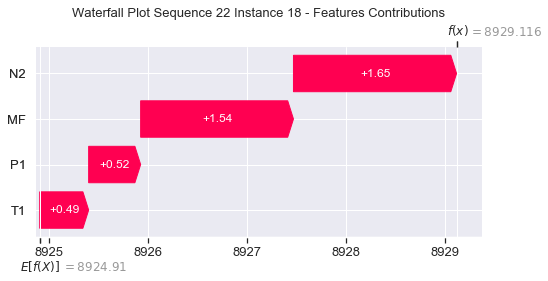

None

Contribution: [0.63374304 0.59622203 2.01774055 1.86332205]


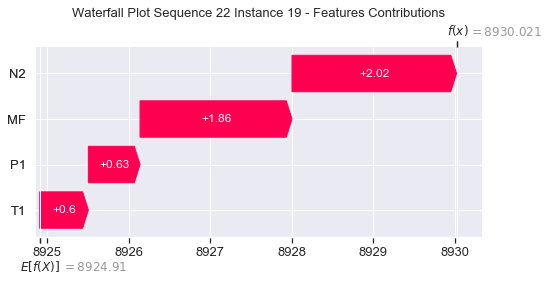

None

Contribution: [0.82153503 0.75480163 2.55909018 2.39536068]


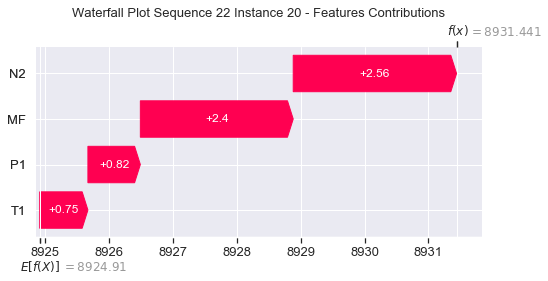

None

Contribution: [1.08338738 0.99046381 3.37750651 3.15879871]


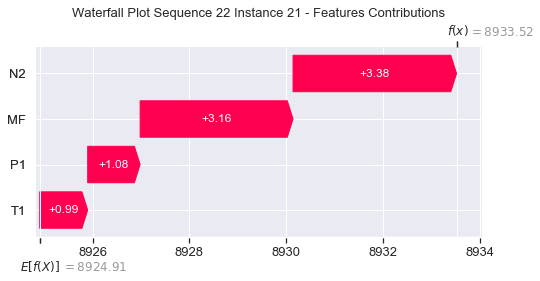

None

Contribution: [1.49389209 1.33422324 4.66503222 4.36245865]


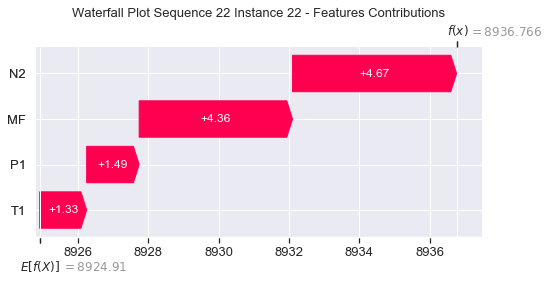

None

Contribution: [2.12984073 1.71551546 6.69667866 6.3494549 ]


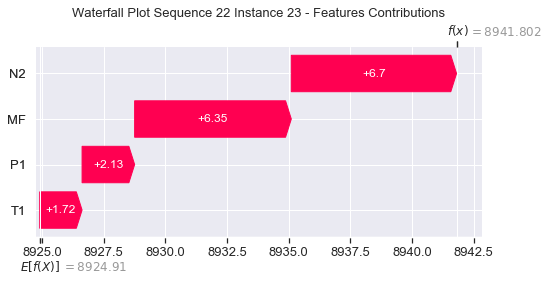

None

Contribution: [3.02804708 0.48679693 9.51826471 9.54009373]


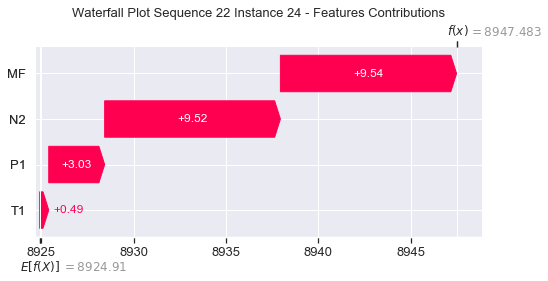

None

Contribution: [ 4.86672737  3.31860754 16.24821837 15.13344745]


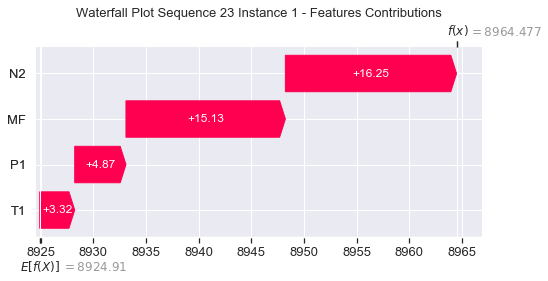

None

Contribution: [0.03340623 0.09355792 0.11321484 0.08702016]


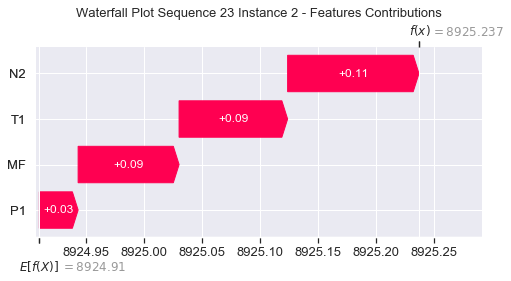

None

Contribution: [0.23770868 0.28041443 0.79460376 0.72310815]


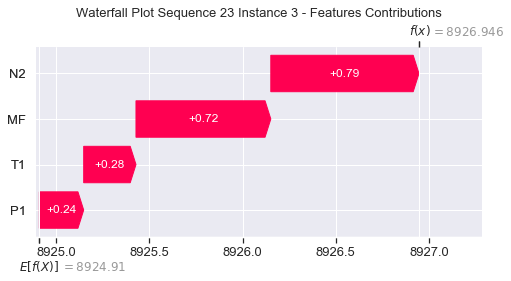

None

Contribution: [0.32068541 0.27850026 1.05977445 0.97745051]


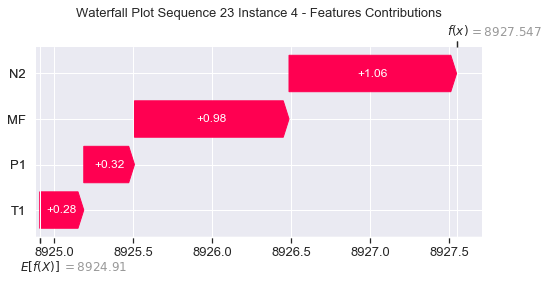

None

Contribution: [0.28277829 0.24956372 0.89091633 0.8285189 ]


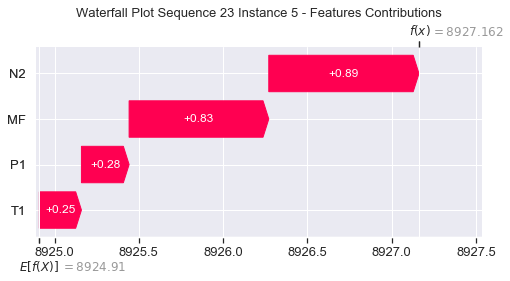

None

Contribution: [0.25814198 0.23056647 0.80923778 0.75024705]


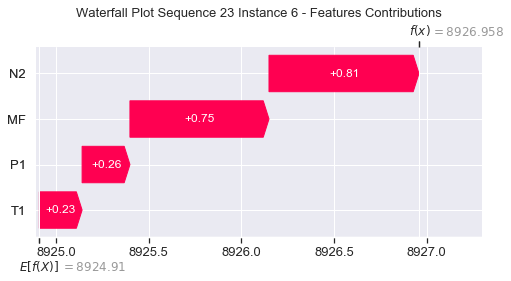

None

Contribution: [0.24822765 0.22337725 0.77688685 0.72063202]


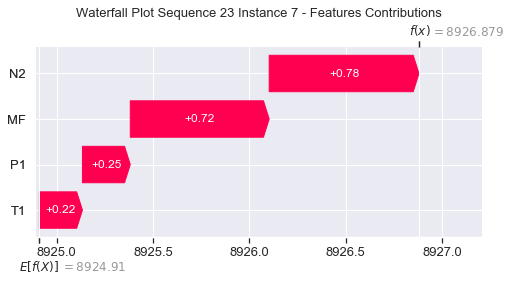

None

Contribution: [0.24320822 0.21962068 0.76320261 0.70684411]


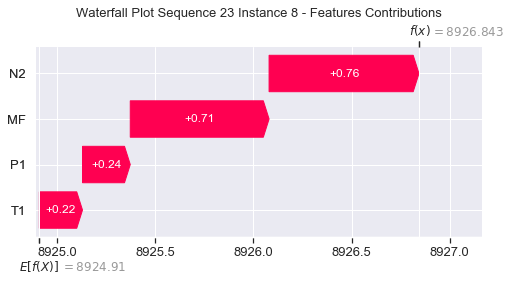

None

Contribution: [0.24510498 0.22441621 0.76622525 0.71047089]


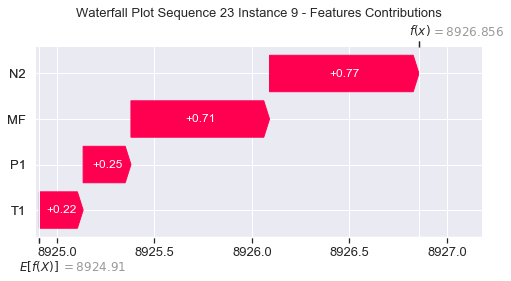

None

Contribution: [0.25174382 0.22966873 0.77948144 0.72165932]


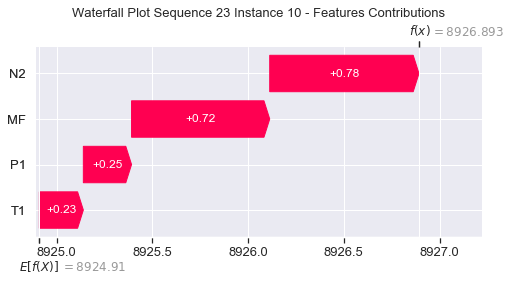

None

Contribution: [0.25526825 0.23527773 0.80467017 0.73913669]


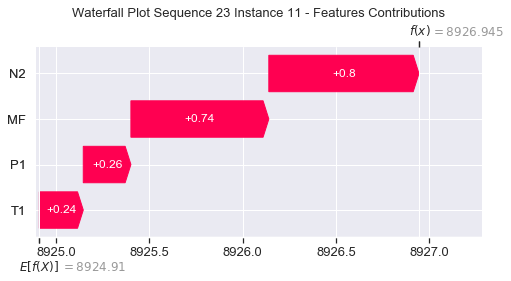

None

Contribution: [0.26666144 0.24938968 0.83938597 0.77263887]


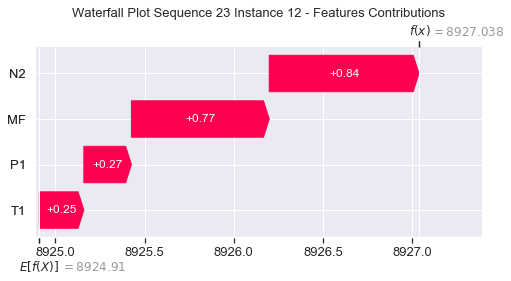

None

Contribution: [0.28501526 0.26731655 0.89650428 0.82635854]


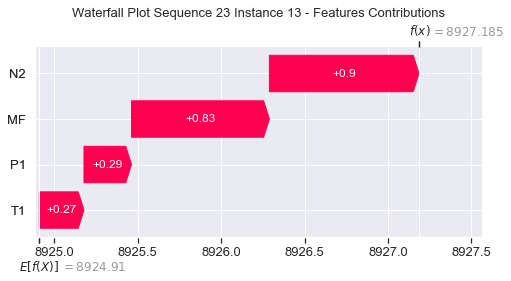

None

Contribution: [0.30853357 0.29401795 0.97113617 0.91077957]


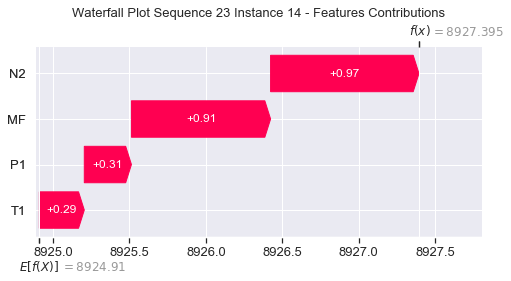

None

Contribution: [0.34068009 0.32125742 1.07223882 0.98717532]


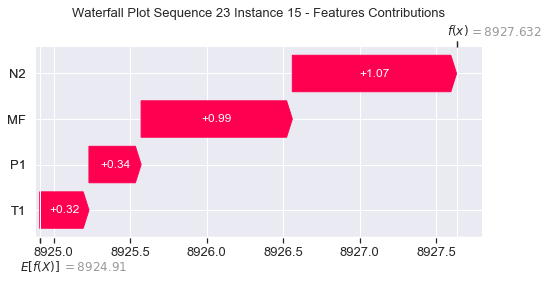

None

Contribution: [0.37635879 0.35974347 1.20719473 1.10967827]


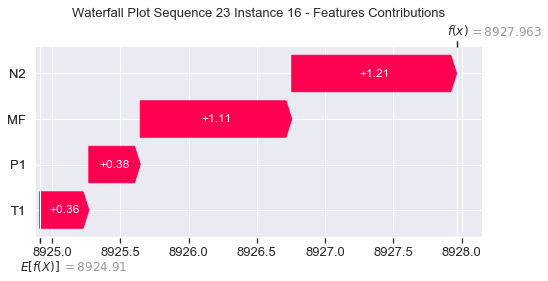

None

Contribution: [0.44558628 0.41937703 1.39832129 1.28737249]


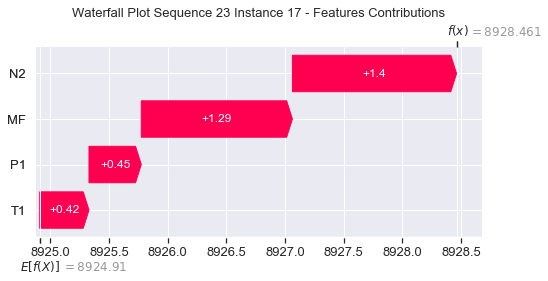

None

Contribution: [0.52848165 0.49447687 1.65882155 1.52515442]


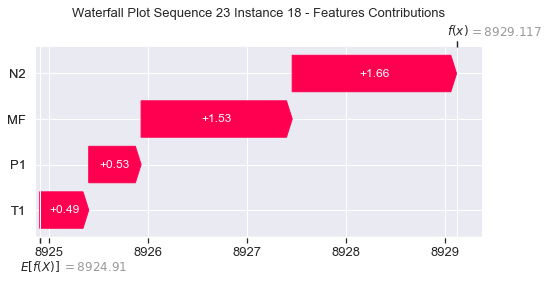

None

Contribution: [0.64756767 0.59270932 2.02891402 1.84148471]


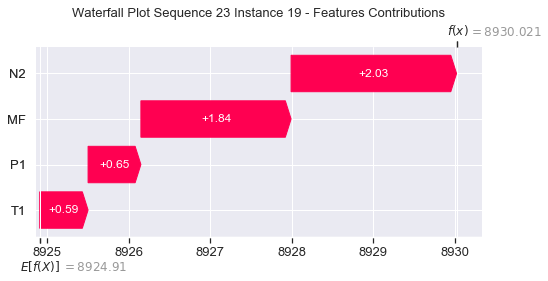

None

Contribution: [0.82106311 0.75298616 2.57581831 2.36917323]


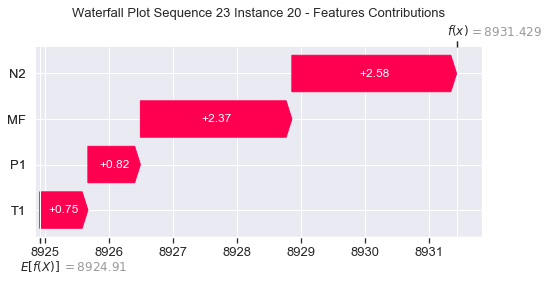

None

Contribution: [1.08210492 0.97916951 3.39674174 3.12275435]


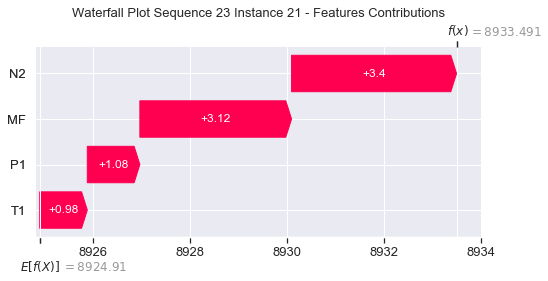

None

Contribution: [1.48985609 1.30209292 4.68562582 4.30725003]


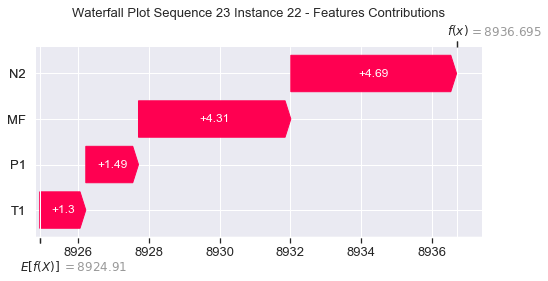

None

Contribution: [2.12257563 1.6156249  6.71954695 6.21494703]


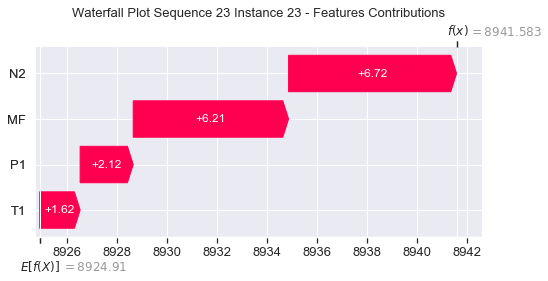

None

Contribution: [3.1388363  0.22552203 9.55066185 9.22803604]


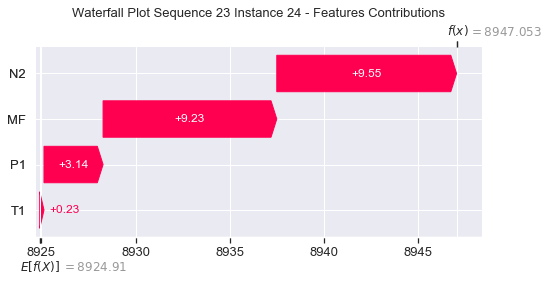

None

Contribution: [ 5.32410736  3.32410858 16.12487774 15.05551269]


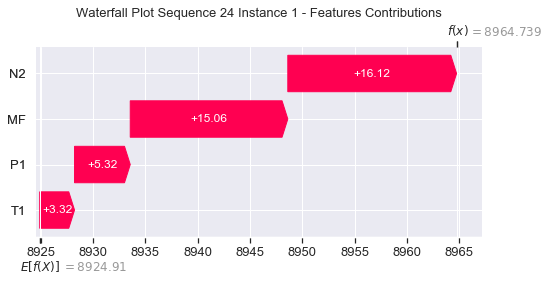

None

Contribution: [0.03515759 0.09742348 0.11588462 0.09569061]


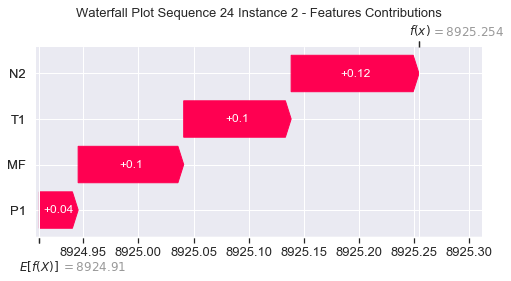

None

Contribution: [0.23530664 0.27714615 0.78456772 0.71232438]


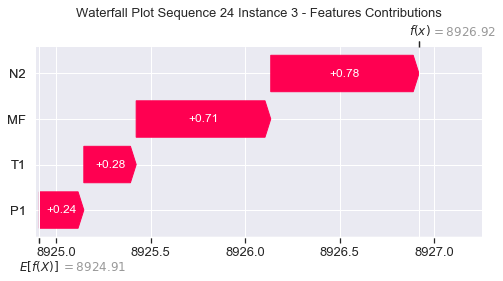

None

Contribution: [0.33812208 0.2821775  1.05930315 0.98544389]


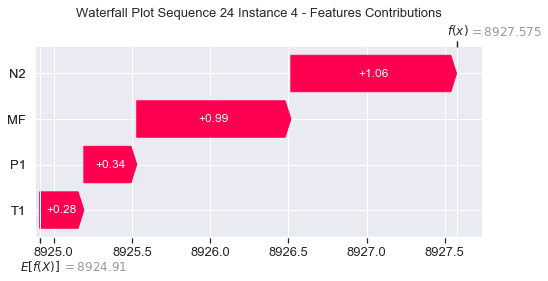

None

Contribution: [0.28389021 0.24430027 0.88756484 0.817231  ]


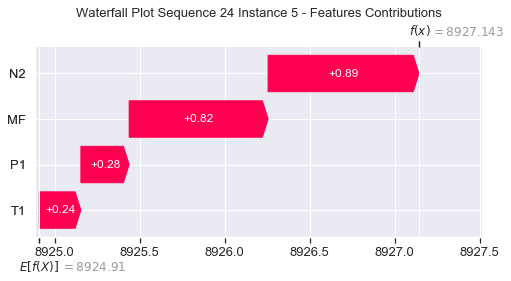

None

Contribution: [0.257293   0.2229584  0.80650444 0.7434523 ]


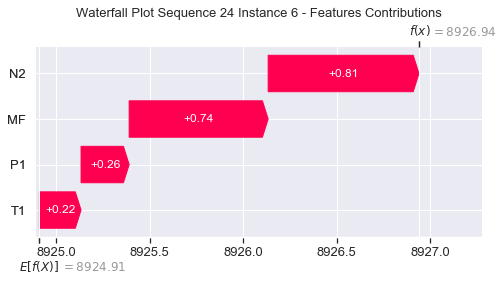

None

Contribution: [0.24747686 0.21622157 0.77427571 0.71504876]


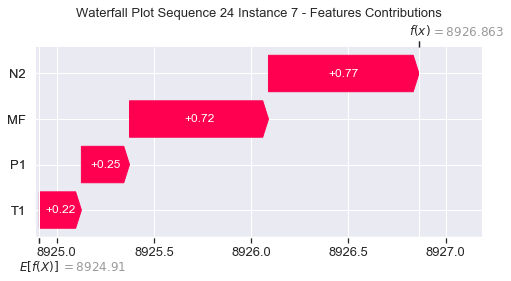

None

Contribution: [0.24235566 0.21394121 0.76021802 0.70066357]


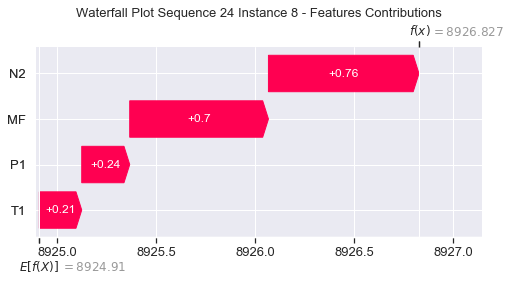

None

Contribution: [0.2411292  0.21770393 0.76159616 0.69608598]


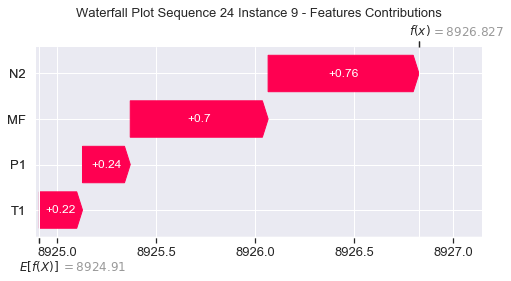

None

Contribution: [0.24809568 0.21678806 0.77529803 0.72009817]


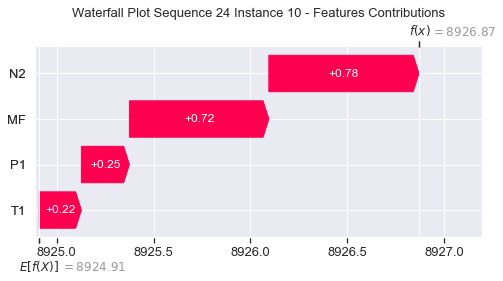

None

Contribution: [0.25215743 0.2263852  0.79980277 0.73076303]


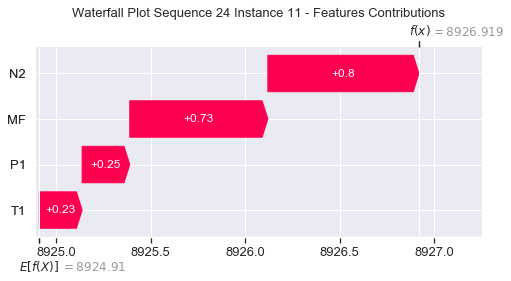

None

Contribution: [0.26729258 0.23895559 0.83575651 0.77520047]


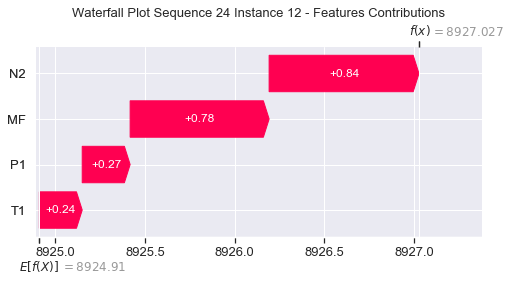

None

Contribution: [0.28541876 0.2587757  0.8921279  0.82722155]


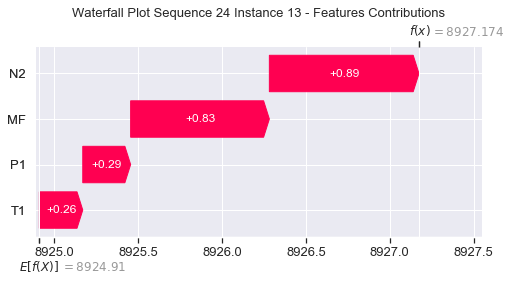

None

Contribution: [0.30448544 0.27780964 0.96264625 0.88241322]


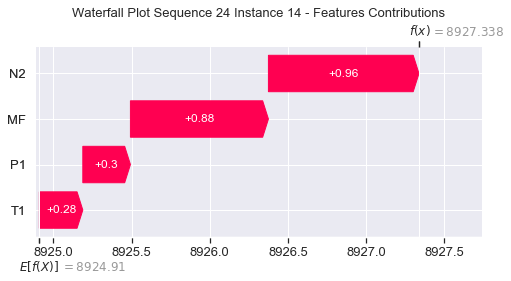

None

Contribution: [0.34089001 0.31597667 1.06521208 0.98820654]


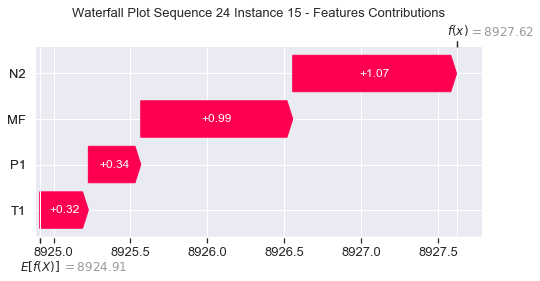

None

Contribution: [0.37499801 0.34168707 1.19637939 1.10102124]


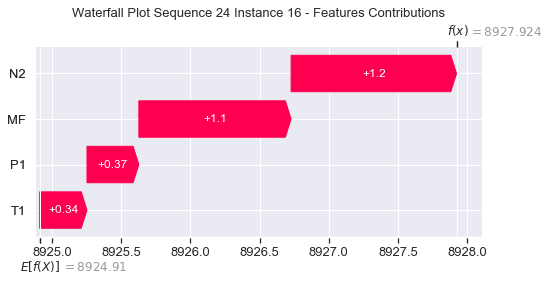

None

Contribution: [0.44385934 0.41933685 1.3868143  1.28685907]


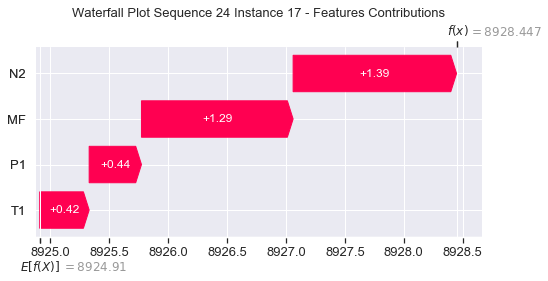

None

Contribution: [0.52601047 0.50004431 1.64457134 1.52522221]


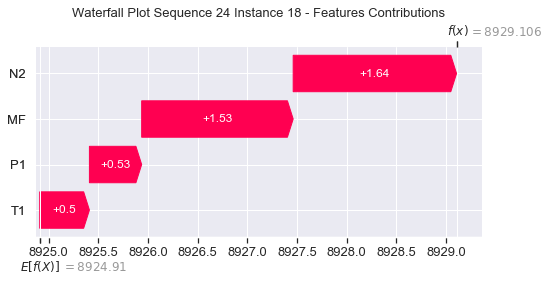

None

Contribution: [0.64096471 0.61820139 2.02196916 1.86403524]


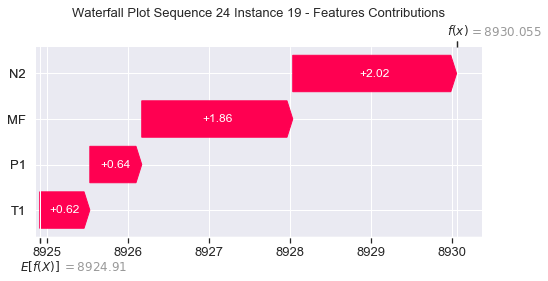

None

Contribution: [0.81879504 0.78752596 2.55594418 2.36815164]


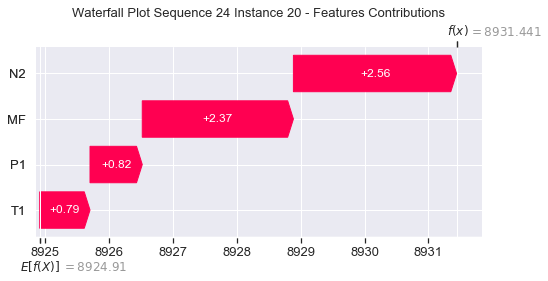

None

Contribution: [1.08245842 1.02773295 3.37325747 3.12752583]


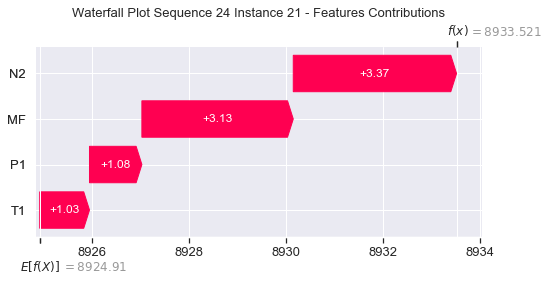

None

Contribution: [1.49826719 1.38753494 4.65908944 4.33173809]


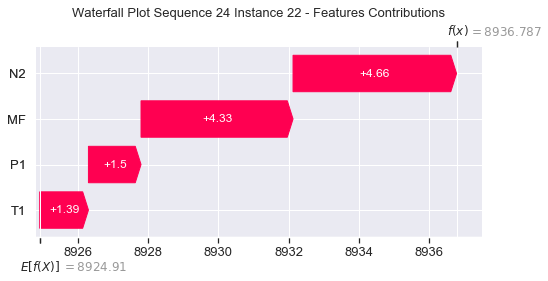

None

Contribution: [2.14265929 1.80027653 6.6964357  6.3060249 ]


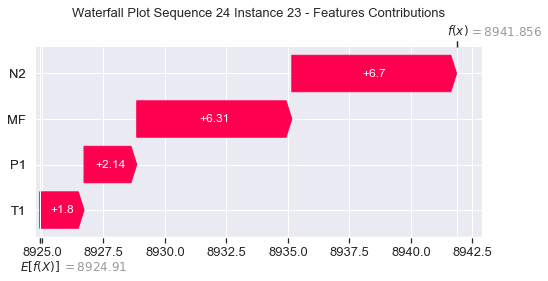

None

Contribution: [3.14116896 1.04230362 9.51210656 9.39960076]


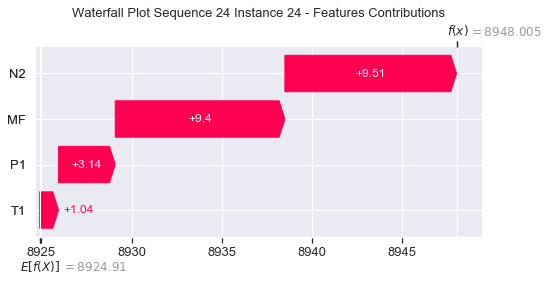

None

Contribution: [ 5.09877373  3.81630946 16.03814852 14.7856434 ]


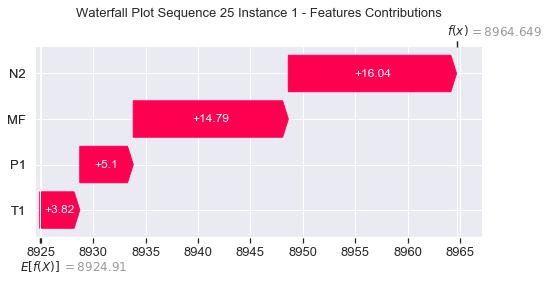

None

Contribution: [0.03139083 0.08990122 0.11076926 0.08553488]


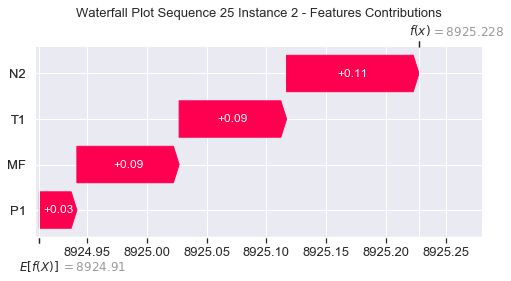

None

Contribution: [0.23509386 0.27606903 0.78290581 0.71237355]


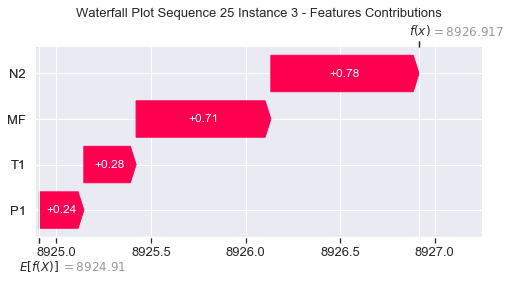

None

Contribution: [0.32433321 0.28779576 1.05606246 0.97158335]


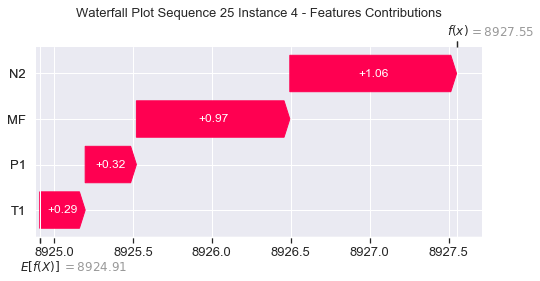

None

Contribution: [0.27983458 0.26209198 0.88544565 0.8089766 ]


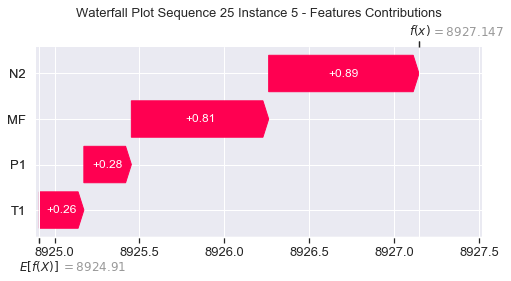

None

Contribution: [0.25329976 0.23526189 0.80466024 0.73595188]


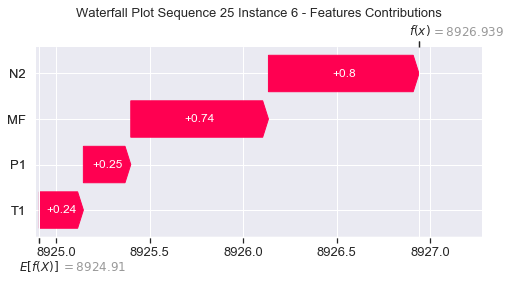

None

Contribution: [0.24315947 0.22583233 0.77231817 0.7077421 ]


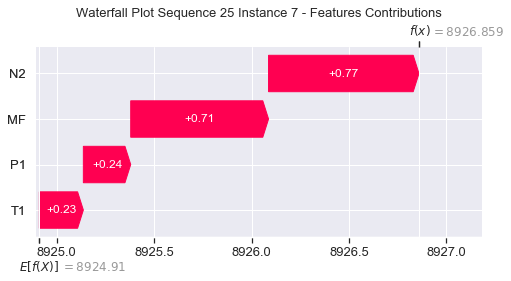

None

Contribution: [0.2392212  0.2250325  0.75884802 0.69606977]


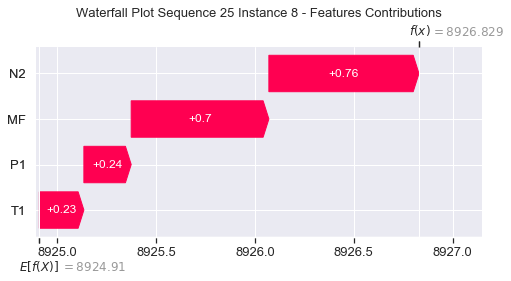

None

Contribution: [0.24305602 0.22902842 0.76248213 0.71030024]


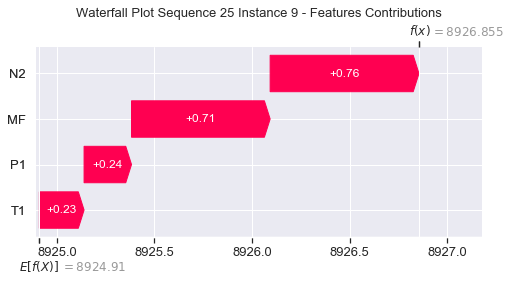

None

Contribution: [0.23740588 0.22347135 0.7730296  0.70077789]


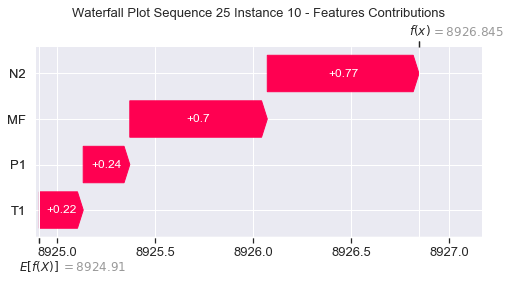

None

Contribution: [0.25505408 0.24631018 0.80128972 0.74415946]


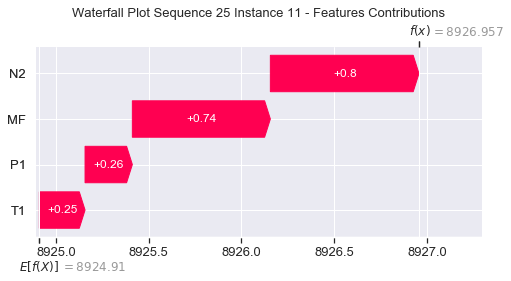

None

Contribution: [0.26329963 0.25313855 0.83489088 0.76871647]


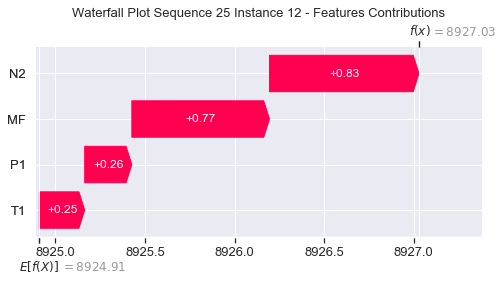

None

Contribution: [0.28106897 0.27181638 0.89123629 0.82063025]


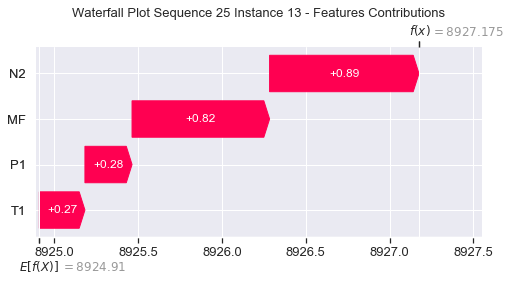

None

Contribution: [0.30630154 0.29128878 0.96244945 0.88095535]


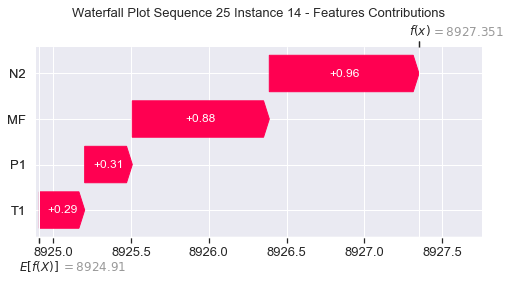

None

Contribution: [0.33596682 0.32908808 1.06482754 0.9813713 ]


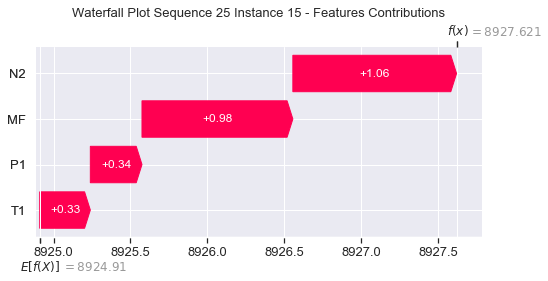

None

Contribution: [0.3674835  0.35237515 1.19658333 1.08749328]


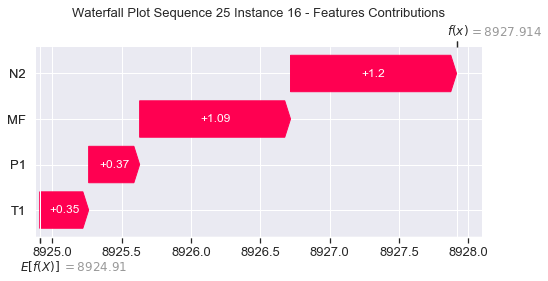

None

Contribution: [0.43743079 0.42907262 1.3864605  1.27922634]


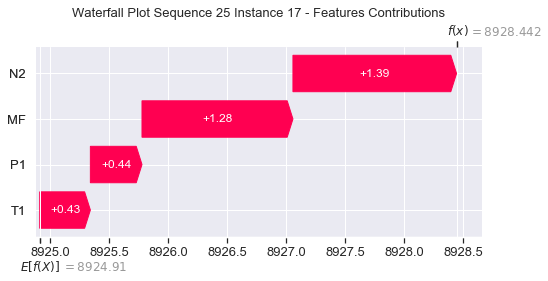

None

Contribution: [0.51891904 0.50995152 1.64416555 1.51632554]


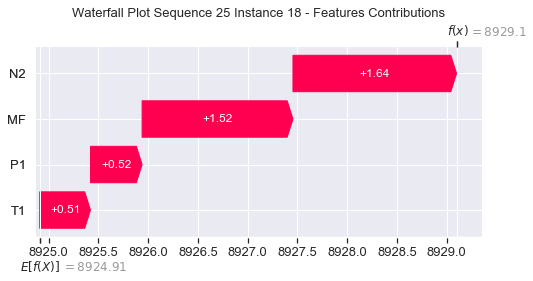

None

Contribution: [0.64852961 0.62295685 2.01740374 1.86941867]


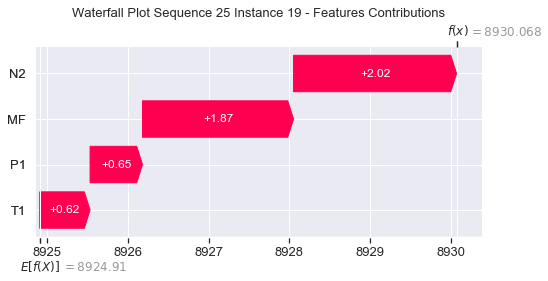

None

Contribution: [0.80901375 0.79444132 2.55584149 2.358674  ]


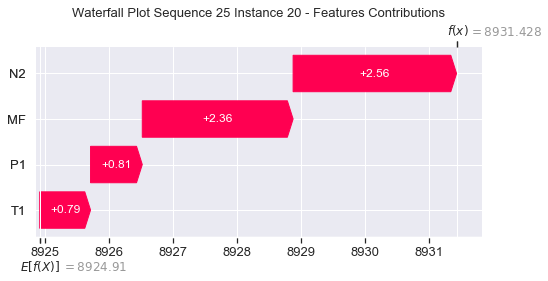

None

Contribution: [1.07011942 1.04258509 3.37319387 3.11545522]


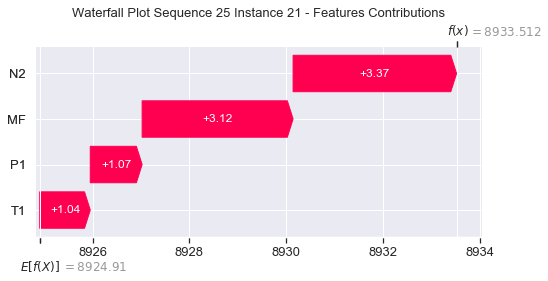

None

Contribution: [1.48141986 1.42080975 4.65886424 4.31296069]


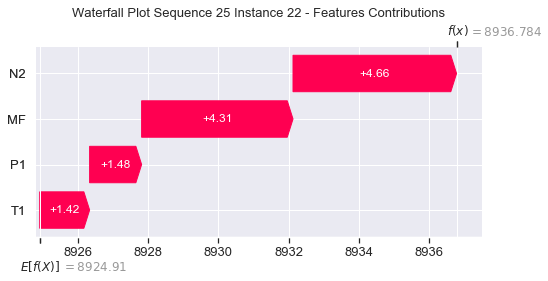

None

Contribution: [2.11144733 1.85412703 6.69705979 6.26896697]


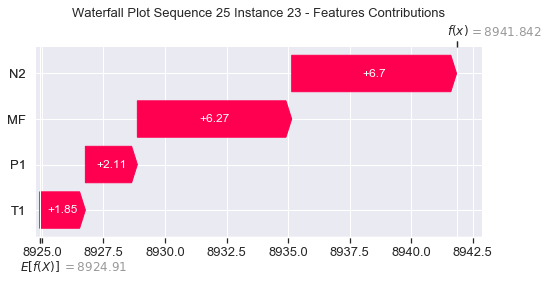

None

Contribution: [3.03027834 1.26324194 9.55099792 9.45681489]


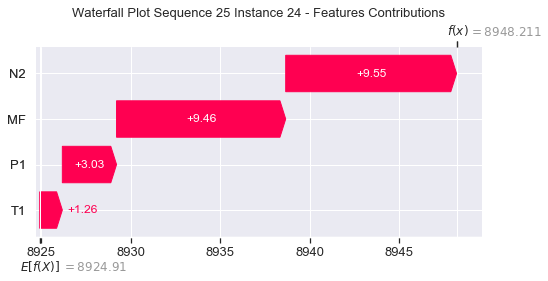

None

Contribution: [ 4.97831427  3.98250681 15.97402318 15.2179962 ]


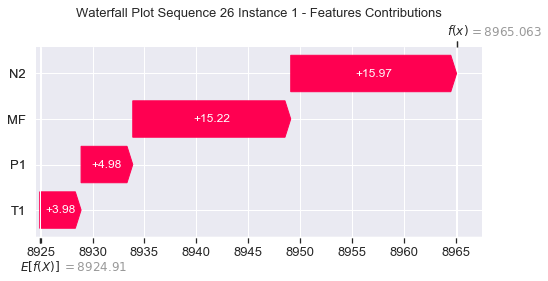

None

Contribution: [0.03142096 0.08391839 0.10691417 0.08380959]


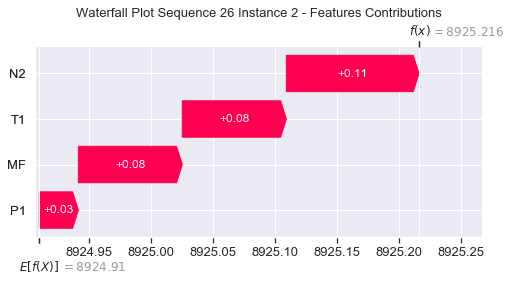

None

Contribution: [0.23109889 0.27131311 0.76850919 0.69813311]


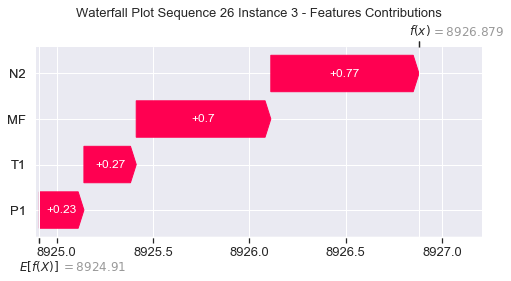

None

Contribution: [0.32930867 0.3095832  1.05305598 0.97627938]


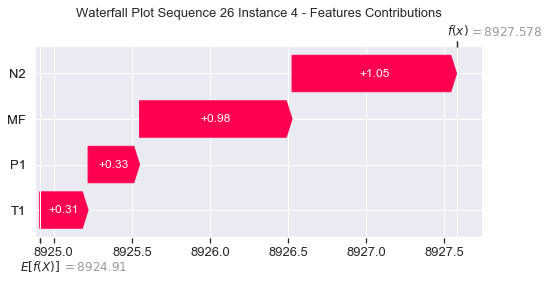

None

Contribution: [0.2806513  0.27133801 0.88293338 0.81512153]


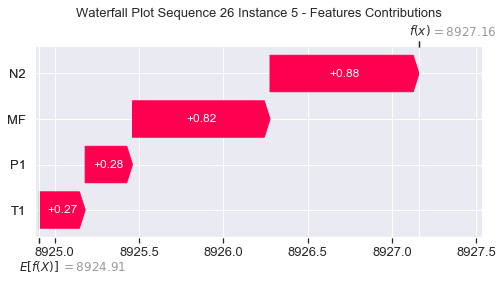

None

Contribution: [0.2521272  0.24368003 0.8017718  0.73847721]


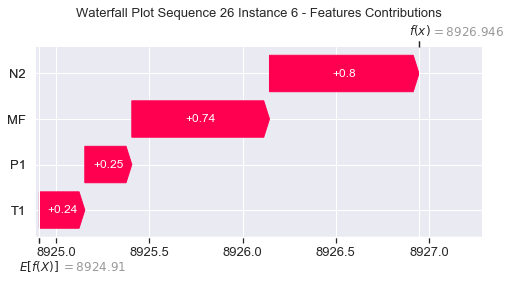

None

Contribution: [0.24239013 0.23497597 0.76958493 0.71039403]


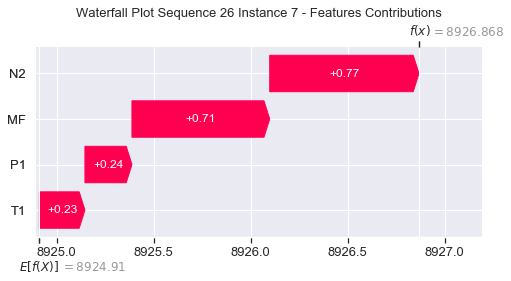

None

Contribution: [0.23824796 0.23220362 0.75581683 0.69702251]


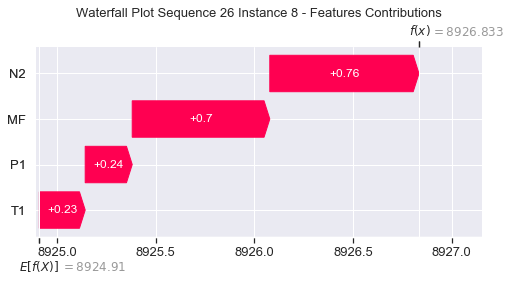

None

Contribution: [0.23988961 0.23592951 0.75772517 0.698422  ]


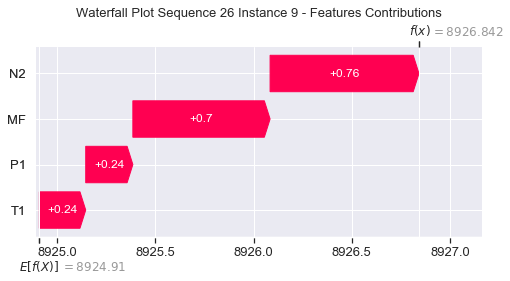

None

Contribution: [0.24391056 0.23969727 0.77130423 0.71483309]


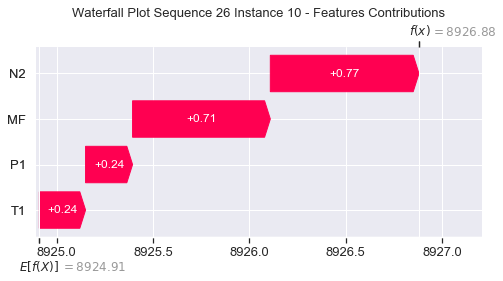

None

Contribution: [0.25289249 0.24710765 0.79641108 0.73281401]


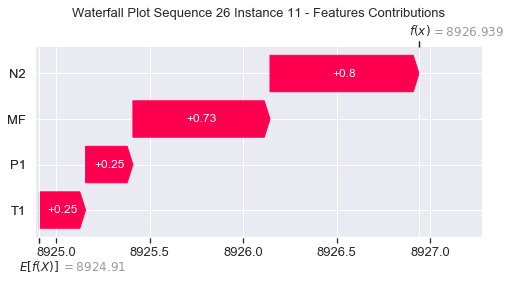

None

Contribution: [0.26664906 0.25850141 0.83176903 0.77475573]


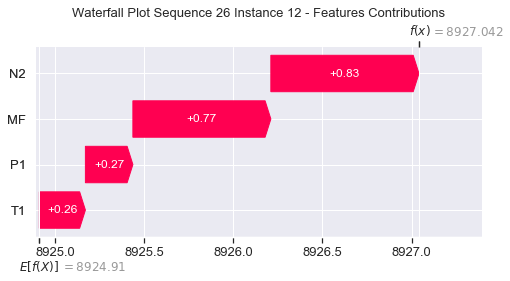

None

Contribution: [0.28409641 0.27812851 0.88797571 0.82676271]


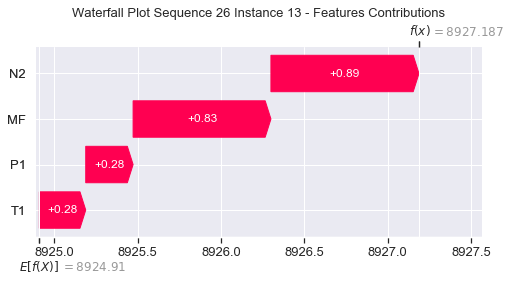

None

Contribution: [0.30445175 0.30137918 0.95919204 0.89026401]


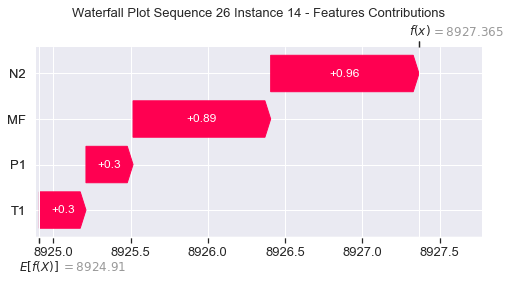

None

Contribution: [0.33742506 0.33292391 1.06118602 0.98719908]


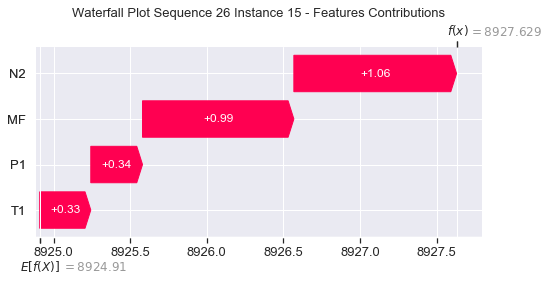

None

Contribution: [0.37693301 0.38325879 1.1961771  1.11153979]


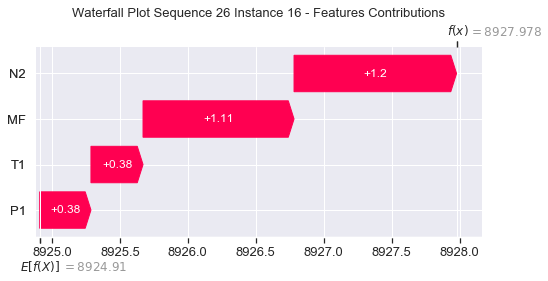

None

Contribution: [0.43878756 0.43455405 1.38436721 1.2868807 ]


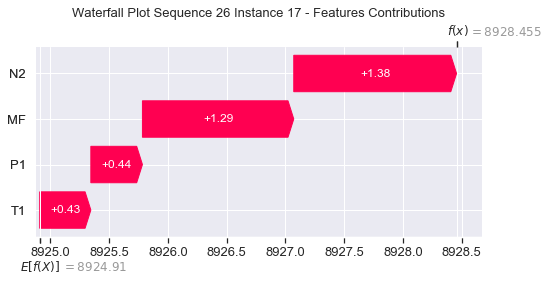

None

Contribution: [0.51938468 0.5134421  1.64268208 1.5246082 ]


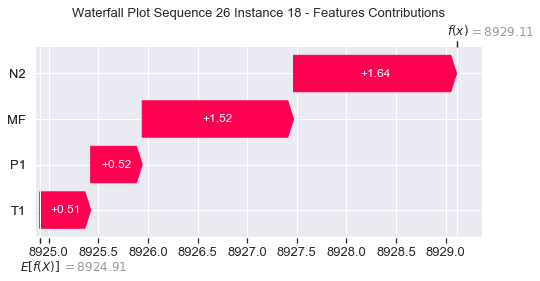

None

Contribution: [0.63959554 0.63611212 2.01369503 1.86812866]


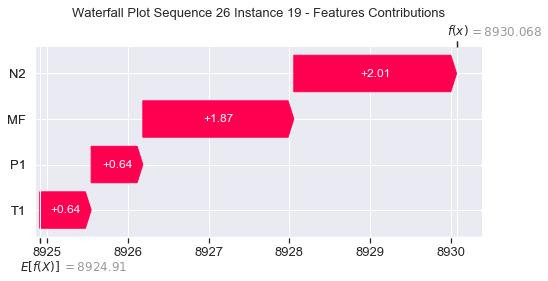

None

Contribution: [0.80637253 0.79444485 2.55508285 2.36738272]


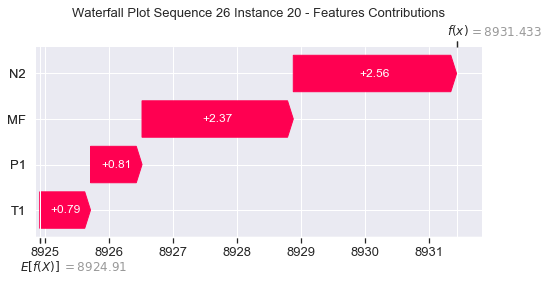

None

Contribution: [1.0703059  1.03632074 3.37348377 3.13115651]


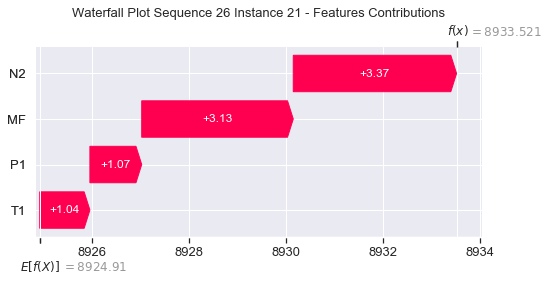

None

Contribution: [1.48471256 1.39523348 4.66090616 4.34093745]


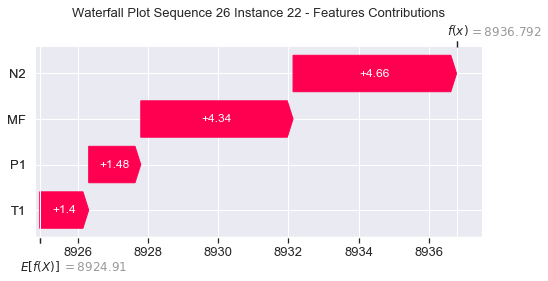

None

Contribution: [2.11080853 1.79500183 6.69712094 6.31131497]


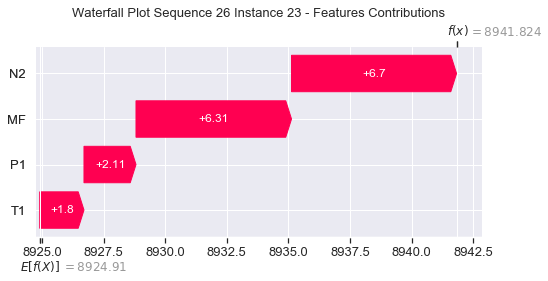

None

Contribution: [2.96694514 0.95972519 9.49516246 9.42558256]


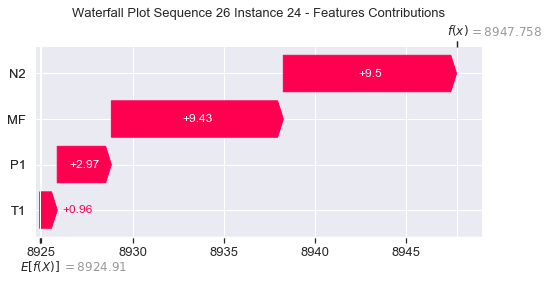

None

Contribution: [ 4.96296789  3.75064135 16.01701724 14.98452499]


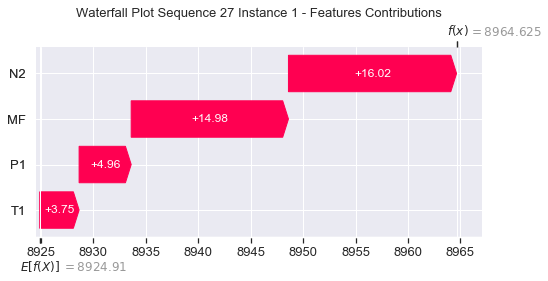

None

Contribution: [0.03026456 0.08943688 0.10914815 0.08192759]


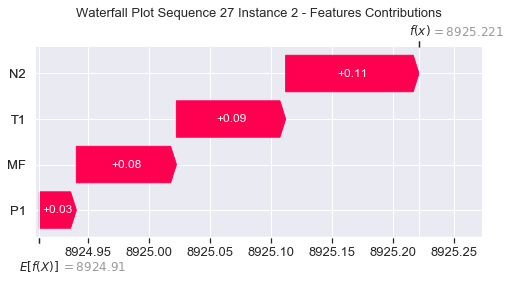

None

Contribution: [0.23506661 0.27657844 0.78221242 0.71339834]


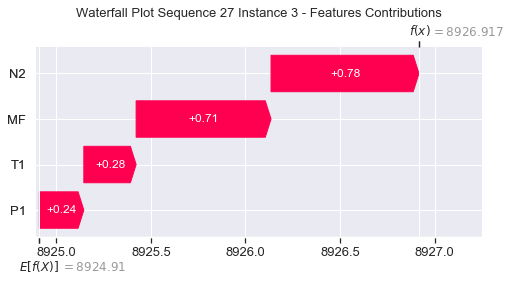

None

Contribution: [0.33196883 0.30625798 1.05690298 0.98920362]


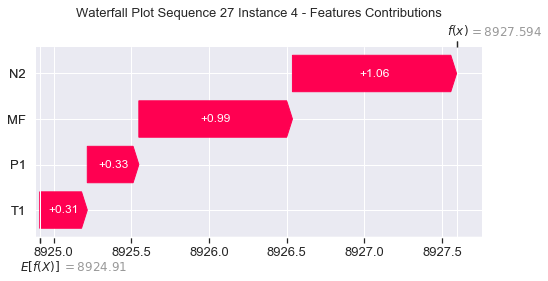

None

Contribution: [0.27605883 0.25272519 0.8843696  0.81080822]


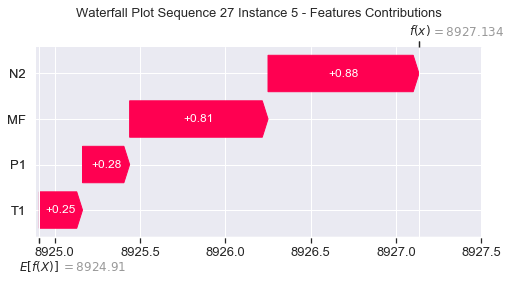

None

Contribution: [0.25425366 0.23572969 0.80448699 0.7433674 ]


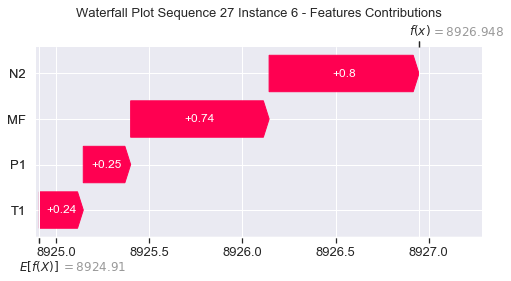

None

Contribution: [0.24404161 0.22868964 0.77211386 0.71297662]


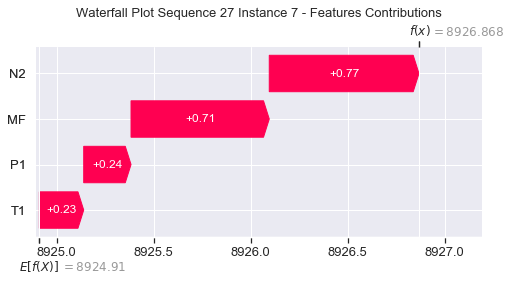

None

Contribution: [0.23916193 0.22533803 0.75841881 0.69977255]


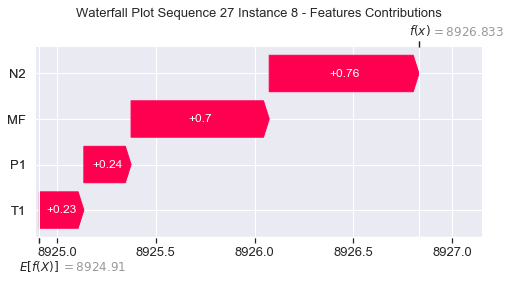

None

Contribution: [0.23864636 0.23103201 0.76034033 0.69723694]


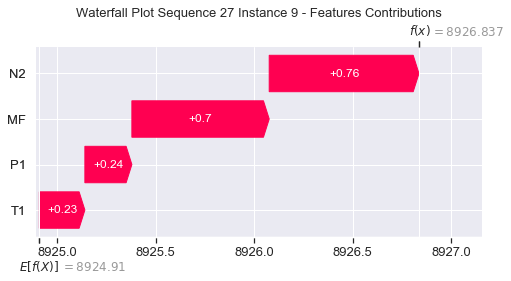

None

Contribution: [0.24299185 0.23344606 0.77357234 0.7094522 ]


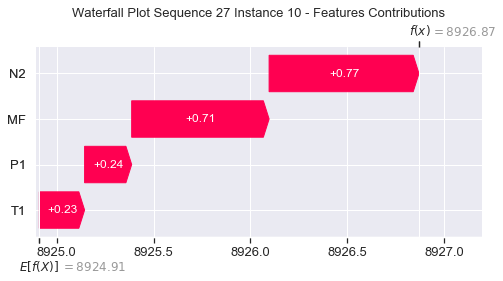

None

Contribution: [0.25022982 0.23733736 0.79890503 0.73251403]


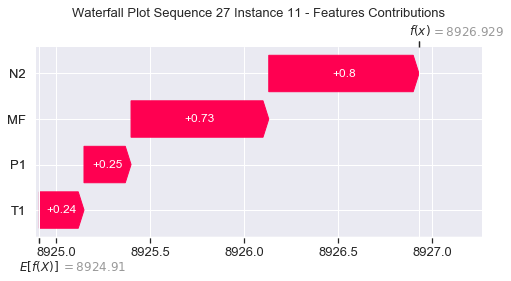

None

Contribution: [0.26019483 0.24764499 0.8324387  0.76267234]


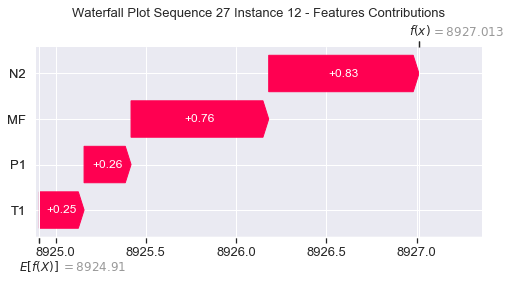

None

Contribution: [0.27785119 0.2683095  0.88860677 0.81472905]


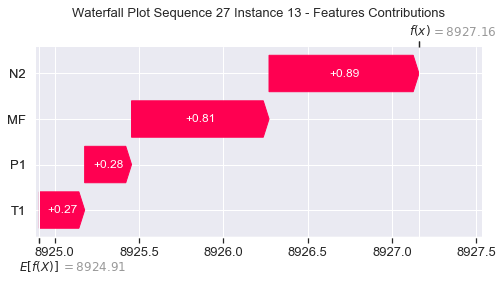

None

Contribution: [0.300358   0.29738679 0.96105226 0.88703465]


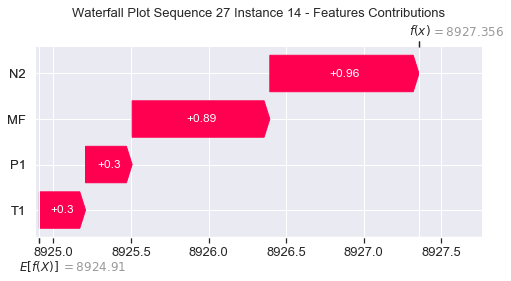

None

Contribution: [0.33259986 0.3277451  1.06171219 0.97655661]


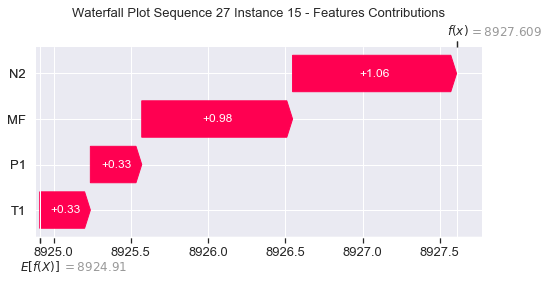

None

Contribution: [0.37816833 0.38148428 1.19749113 1.10683182]


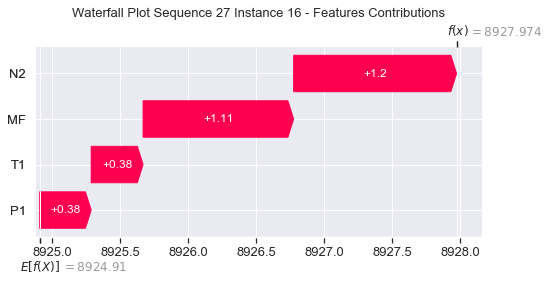

None

Contribution: [0.43619934 0.43656633 1.38451665 1.27812135]


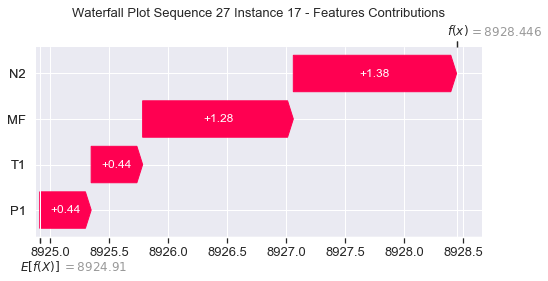

None

Contribution: [0.51896353 0.51991318 1.64286739 1.52005478]


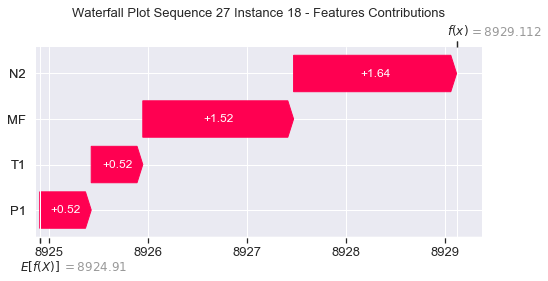

None

Contribution: [0.63780168 0.63277129 2.01176471 1.84590495]


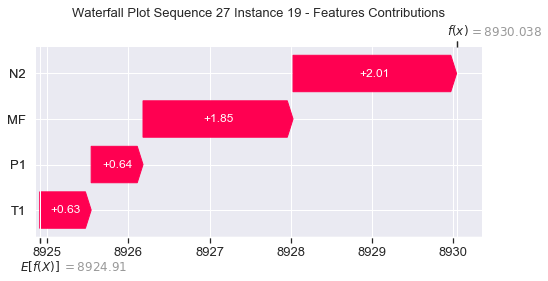

None

Contribution: [0.80845726 0.81278509 2.55404754 2.36691936]


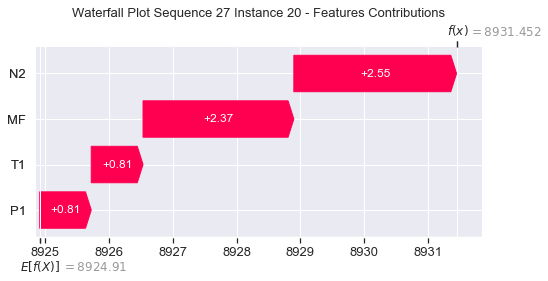

None

Contribution: [1.06467281 1.05414334 3.3706692  3.11895628]


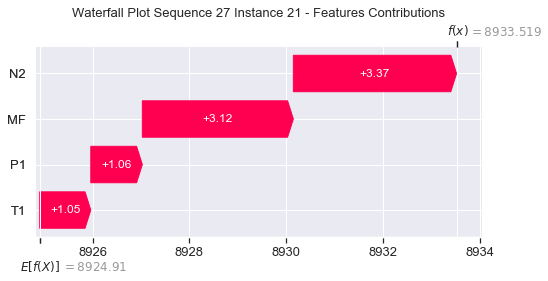

None

Contribution: [1.46475625 1.41112272 4.65360586 4.30781731]


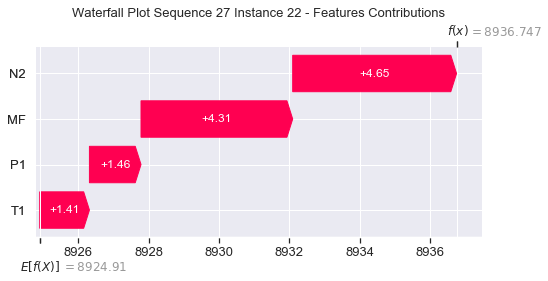

None

Contribution: [2.09244991 1.85543671 6.68192656 6.28068178]


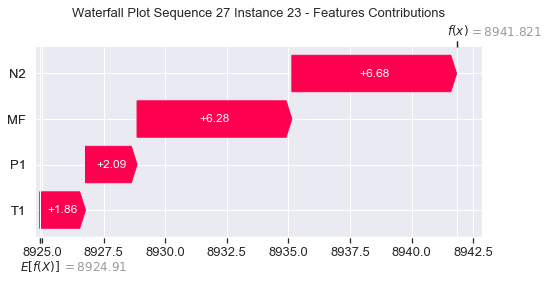

None

Contribution: [2.93501607 1.29375946 9.46513967 9.45053279]


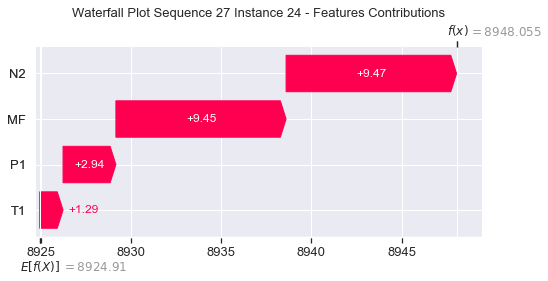

None

Contribution: [ 4.84577256  4.15581791 16.02692496 14.90697   ]


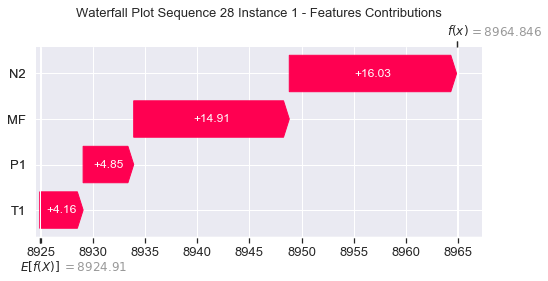

None

Contribution: [0.03660881 0.09105858 0.11457435 0.09386375]


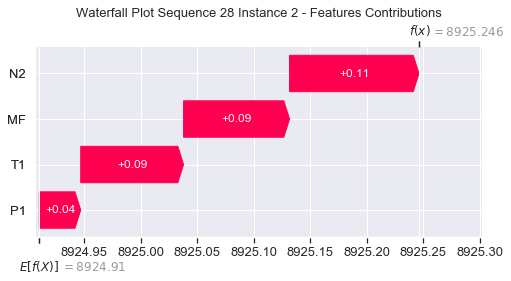

None

Contribution: [0.23442107 0.27545641 0.78213475 0.7081204 ]


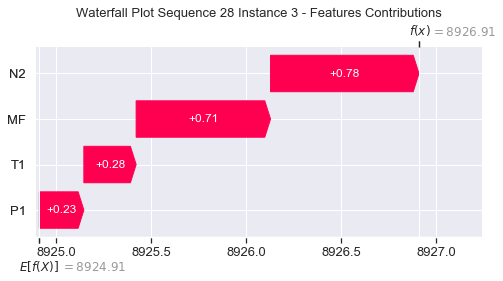

None

Contribution: [0.332253   0.30694288 1.05411118 0.98413191]


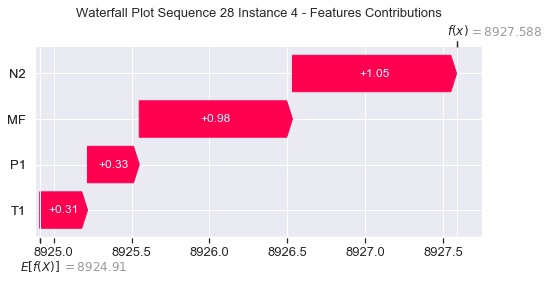

None

Contribution: [0.28722107 0.26601745 0.88624942 0.82974631]


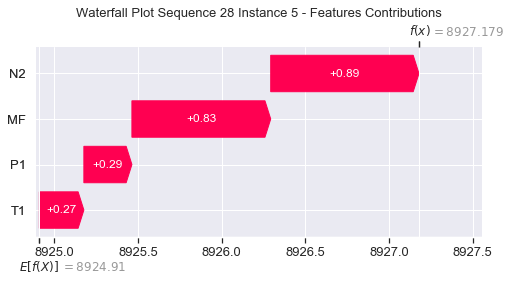

None

Contribution: [0.25711176 0.25433276 0.80440968 0.74847148]


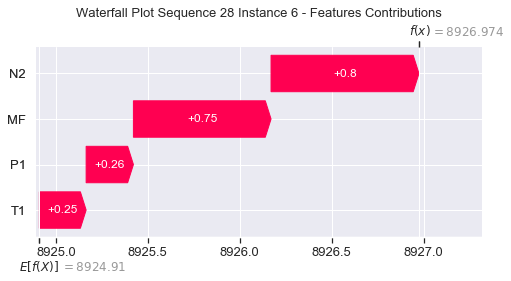

None

Contribution: [0.2445546  0.25109983 0.77261994 0.71906693]


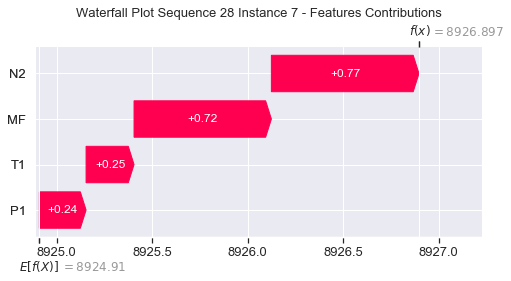

None

Contribution: [0.24286451 0.23995334 0.75950048 0.70646171]


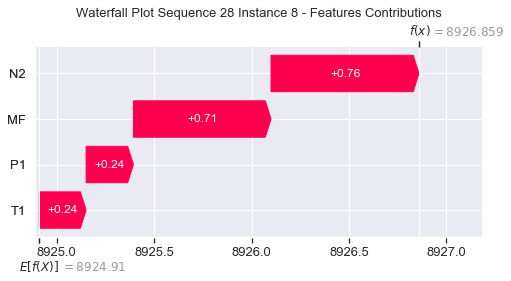

None

Contribution: [0.24233155 0.26024721 0.76513089 0.71097591]


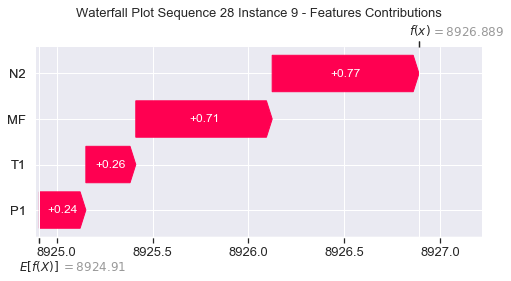

None

Contribution: [0.2540864  0.26101073 0.77877674 0.73296257]


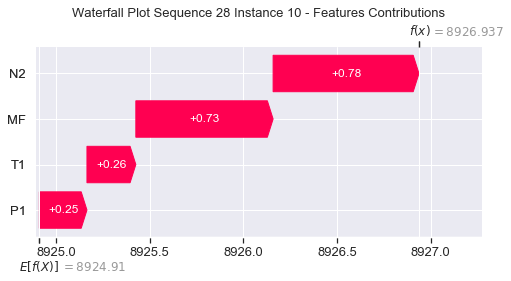

None

Contribution: [0.26180387 0.25073422 0.80367793 0.74278345]


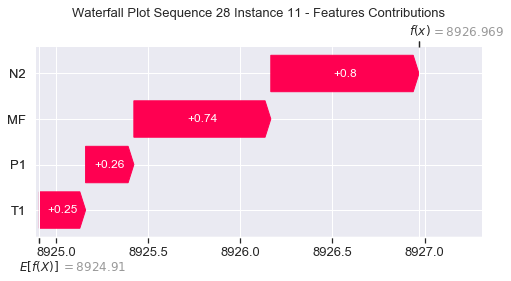

None

Contribution: [0.26890179 0.25495624 0.83771122 0.78018205]


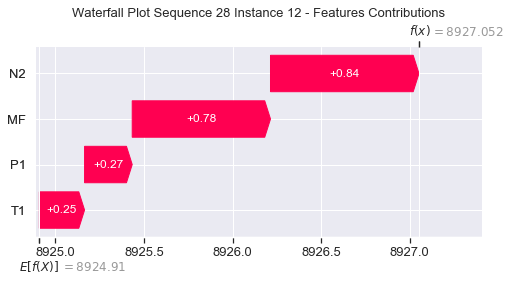

None

Contribution: [0.28708467 0.27374721 0.89551907 0.8344862 ]


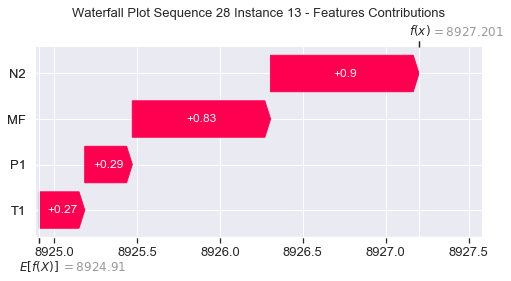

None

Contribution: [0.30284375 0.28848902 0.96703391 0.88309688]


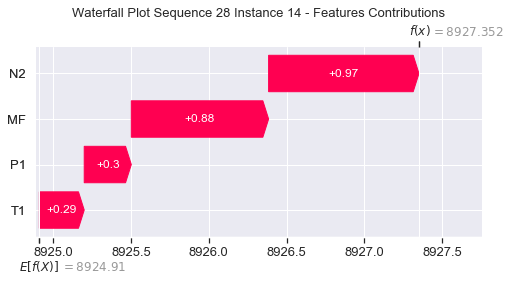

None

Contribution: [0.3449277  0.31750827 1.07067088 0.993985  ]


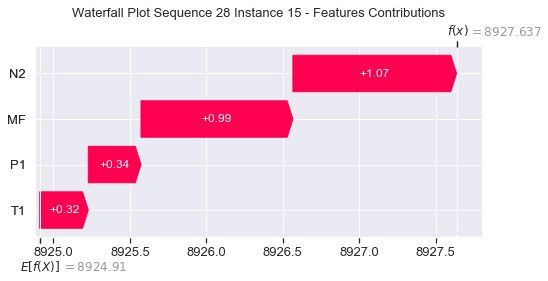

None

Contribution: [0.39560159 0.3724533  1.20947909 1.13511483]


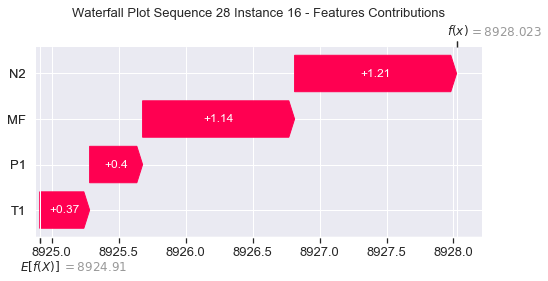

None

Contribution: [0.45111195 0.41105254 1.39998829 1.29950571]


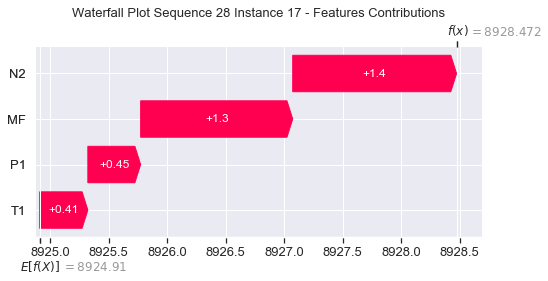

None

Contribution: [0.53949962 0.47062198 1.66210989 1.54098164]


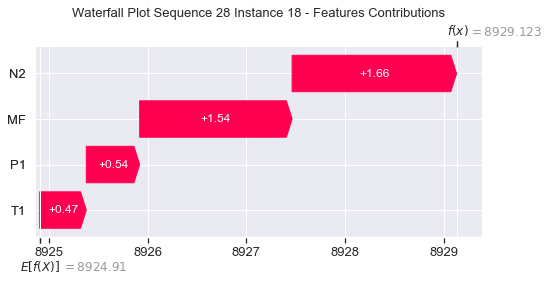

None

Contribution: [0.64825917 0.55869244 2.03825576 1.89040554]


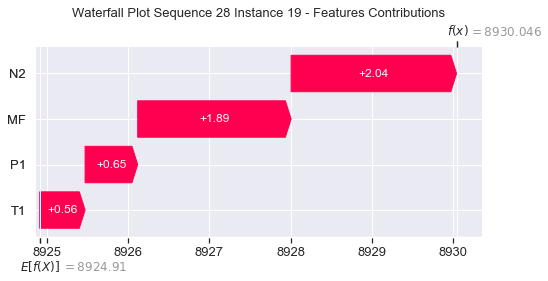

None

Contribution: [0.84826087 0.68983304 2.58619235 2.39946011]


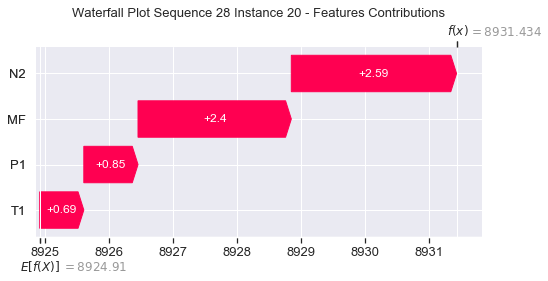

None

Contribution: [1.1296239  0.86104221 3.41220924 3.16930826]


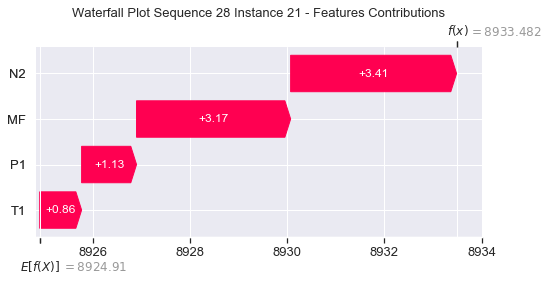

None

Contribution: [1.58369448 1.05503608 4.70757009 4.38349377]


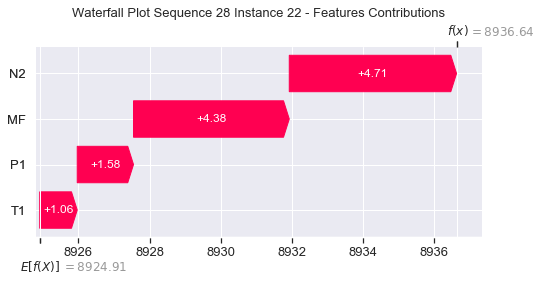

None

Contribution: [2.30435965 1.09794927 6.74705269 6.35221162]


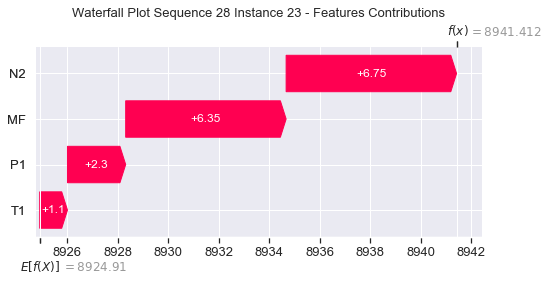

None

Contribution: [ 4.27028394 -2.59864134  9.70072113 10.30077494]


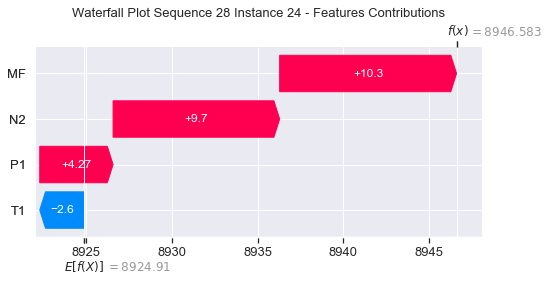

None

Contribution: [ 7.00909334 -0.22916183 16.54245981 17.44040727]


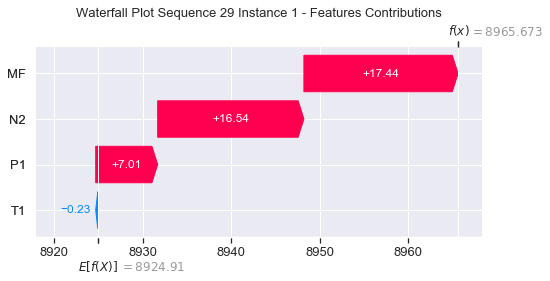

None

Contribution: [0.02863233 0.12136306 0.1205927  0.09464836]


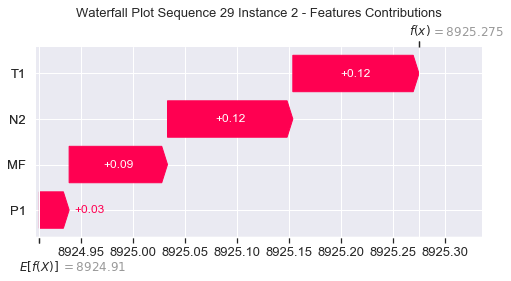

None

Contribution: [0.24086693 0.29049848 0.80136979 0.73164387]


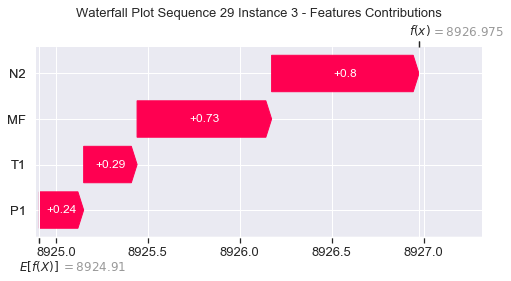

None

Contribution: [0.38744651 0.18193383 1.0929967  1.0487978 ]


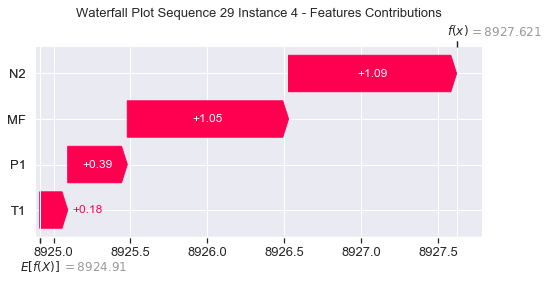

None

Contribution: [0.31271388 0.15695336 0.90838817 0.83550035]


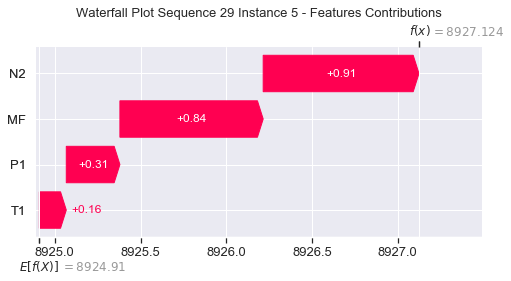

None

Contribution: [0.30156534 0.13043746 0.828616   0.78366483]


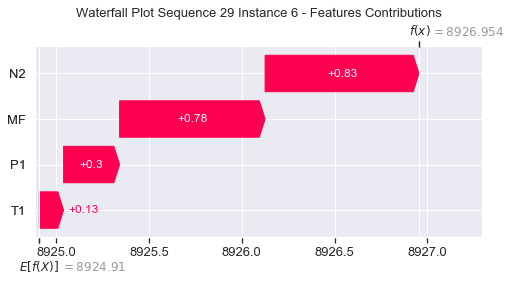

None

Contribution: [0.28977976 0.12250193 0.79456537 0.75194663]


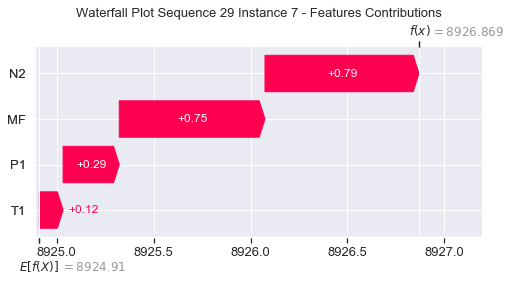

None

Contribution: [0.28045822 0.12805886 0.77986059 0.7347483 ]


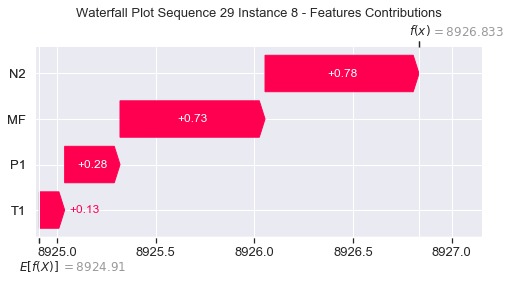

None

Contribution: [0.27870707 0.12032076 0.78024136 0.72854601]


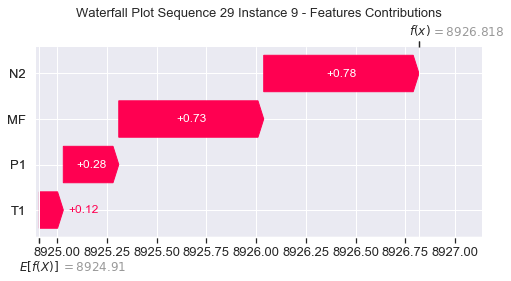

None

Contribution: [0.26222787 0.12534104 0.79018329 0.7219824 ]


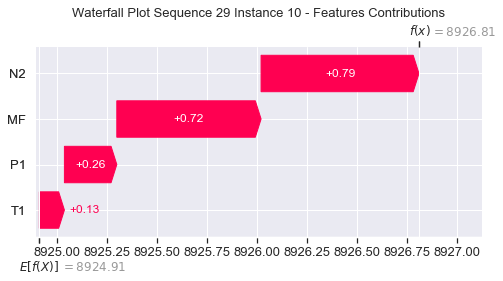

None

Contribution: [0.29566409 0.13136297 0.82149195 0.77704305]


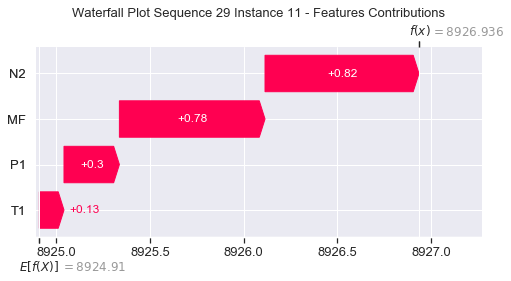

None

Contribution: [0.31322618 0.13476576 0.85652669 0.82242462]


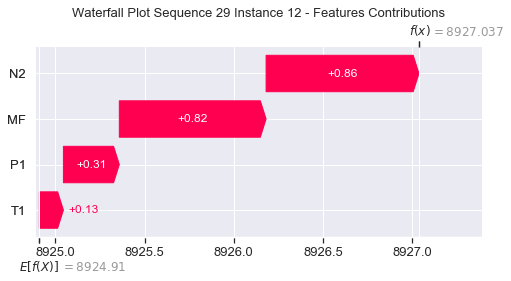

None

Contribution: [0.32950714 0.15201164 0.91271274 0.87043091]


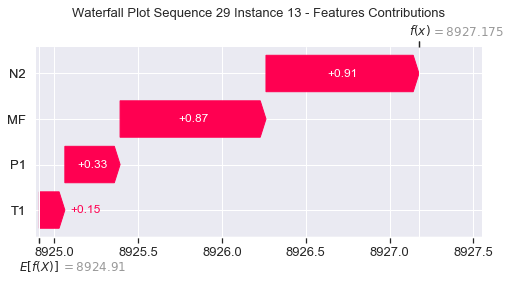

None

Contribution: [0.37552527 0.17494162 0.98880454 0.95413596]


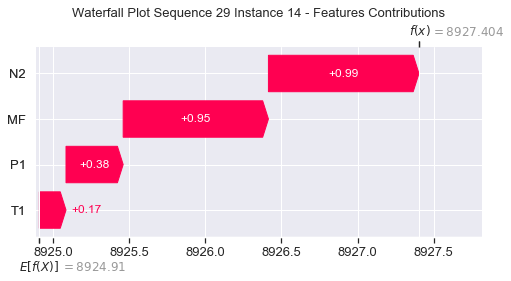

None

Contribution: [0.38997871 0.20107693 1.08981643 1.03681966]


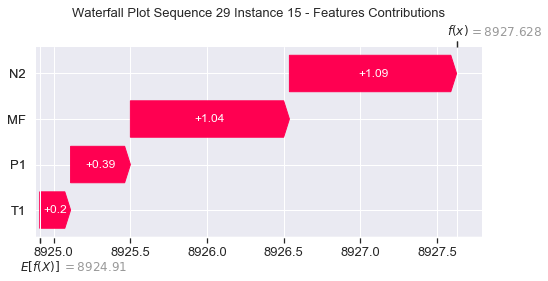

None

Contribution: [0.4475698  0.1943754  1.2295643  1.17832657]


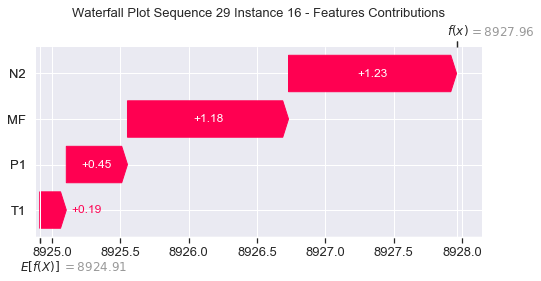

None

Contribution: [0.49864803 0.28382443 1.41688135 1.34201589]


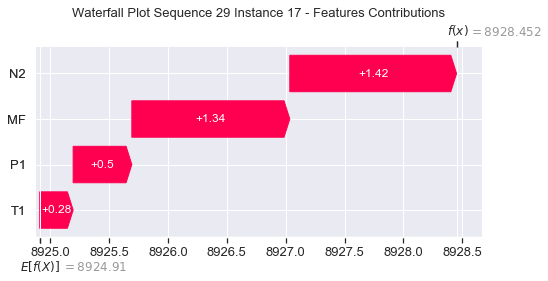

None

Contribution: [0.58383305 0.35879571 1.67874455 1.5859296 ]


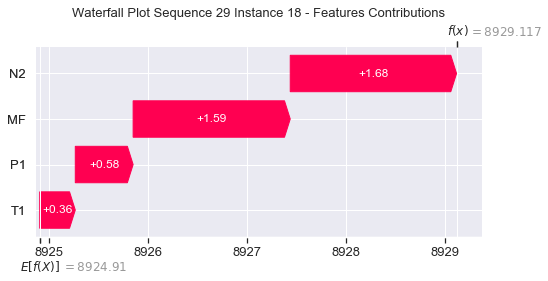

None

Contribution: [0.67515937 0.52625455 2.04385288 1.88606892]


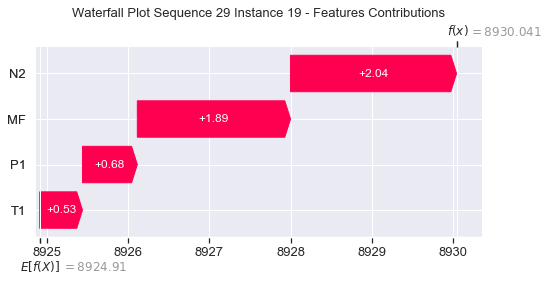

None

Contribution: [0.85669323 0.63165215 2.59471009 2.40012677]


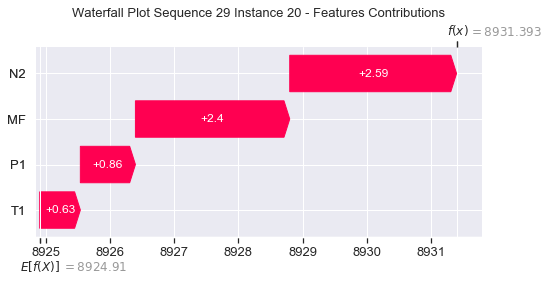

None

Contribution: [1.11732734 0.83689627 3.41604059 3.15530222]


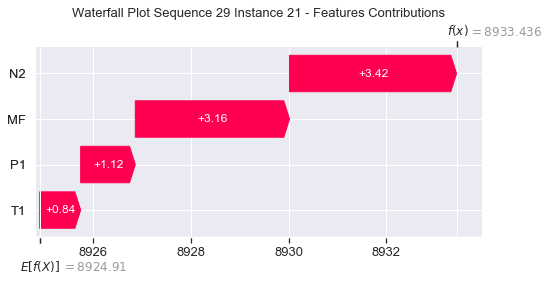

None

Contribution: [1.51037654 1.15420529 4.70253385 4.32923845]


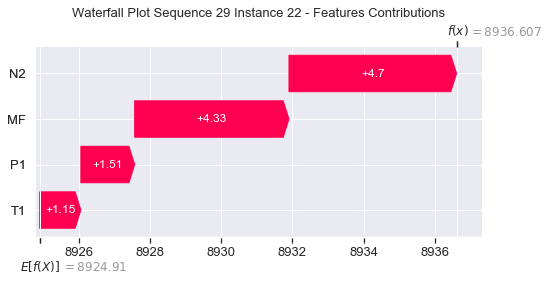

None

Contribution: [2.19262358 1.3437091  6.75155307 6.33666911]


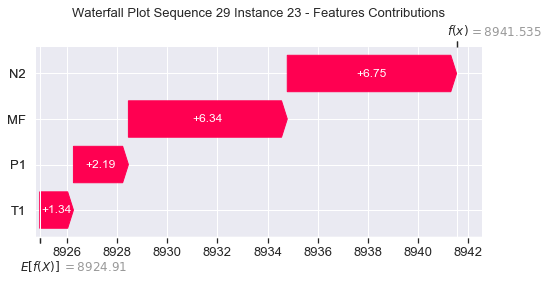

None

Contribution: [2.94555011 0.02849696 9.60254783 9.26375531]


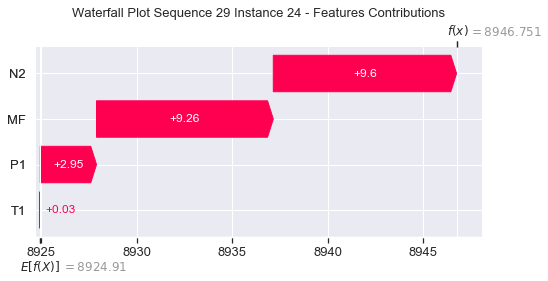

None

Contribution: [ 4.90442005  3.4960329  16.26452258 15.28694729]


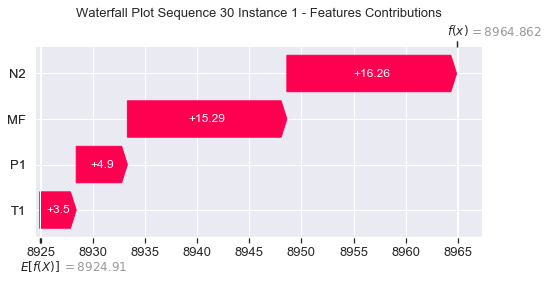

None

Contribution: [0.03922428 0.1035663  0.12030216 0.10008945]


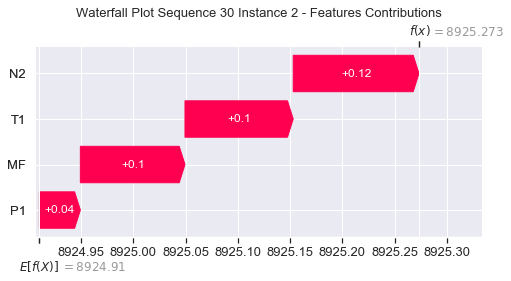

None

Contribution: [0.23672479 0.28022817 0.79252131 0.71876286]


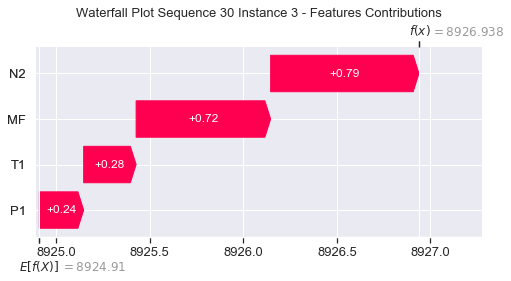

None

Contribution: [0.31079496 0.25712125 1.06414849 0.96750489]


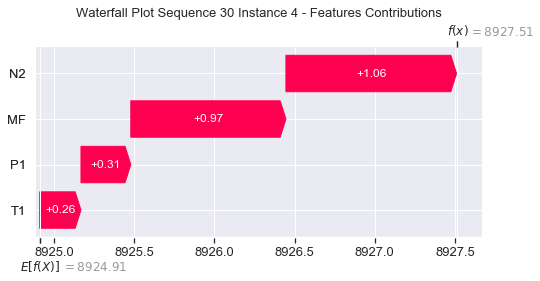

None

Contribution: [0.28327572 0.26617396 0.89374171 0.82412106]


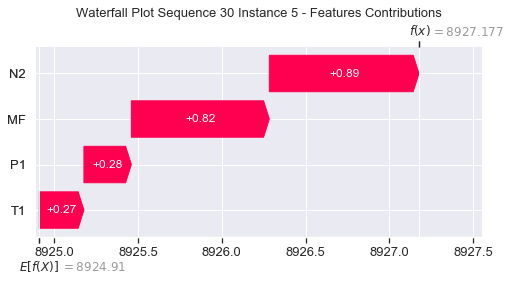

None

Contribution: [0.25569458 0.23876397 0.8113017  0.74552862]


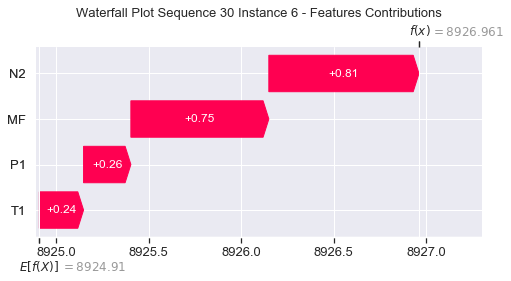

None

Contribution: [0.24520315 0.23025277 0.77816876 0.71490523]


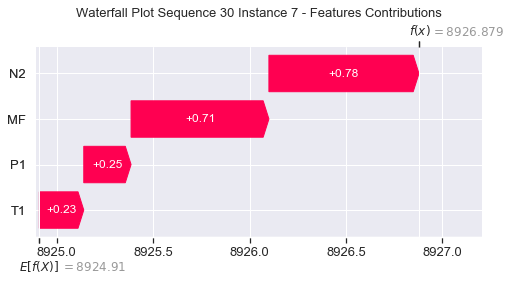

None

Contribution: [0.2407296  0.22799389 0.76448304 0.70228245]


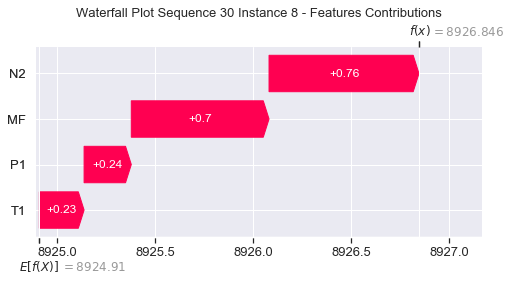

None

Contribution: [0.24237837 0.23774278 0.76585174 0.70549207]


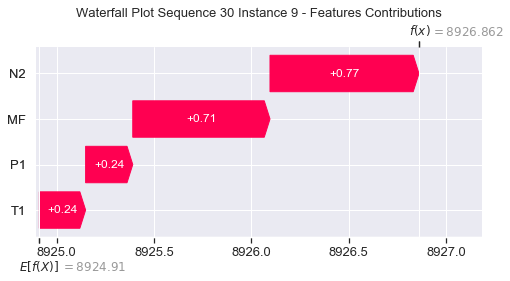

None

Contribution: [0.24826713 0.23602645 0.78038006 0.71434106]


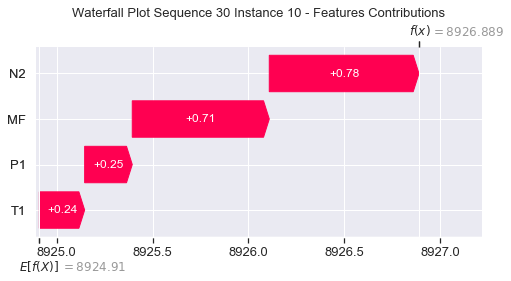

None

Contribution: [0.25203627 0.24675085 0.80604656 0.73930569]


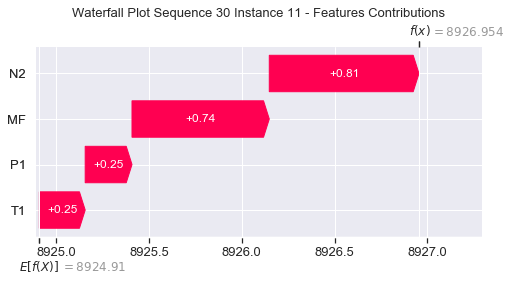

None

Contribution: [0.26118405 0.24940938 0.84061108 0.76768351]


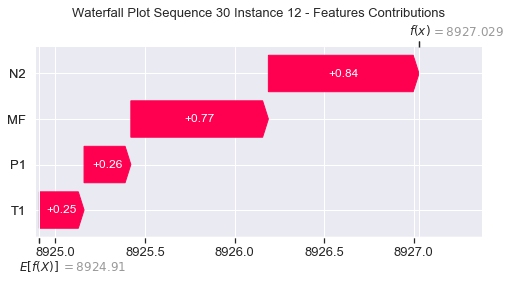

None

Contribution: [0.27950474 0.26906818 0.89714675 0.8198401 ]


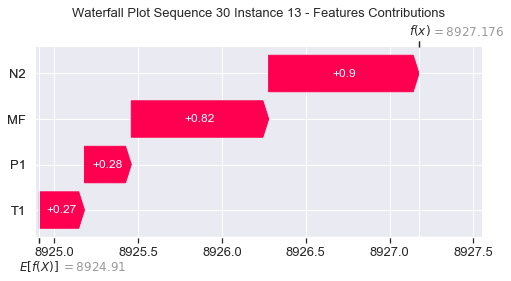

None

Contribution: [0.30369932 0.28199796 0.96761413 0.87252117]


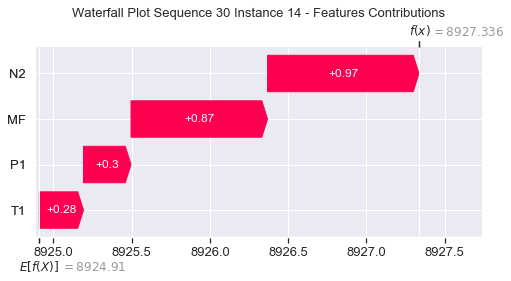

None

Contribution: [0.33360692 0.32411362 1.07124522 0.9782934 ]


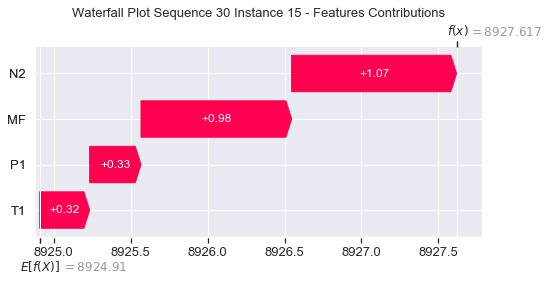

None

Contribution: [0.38292665 0.36955988 1.20908579 1.11969926]


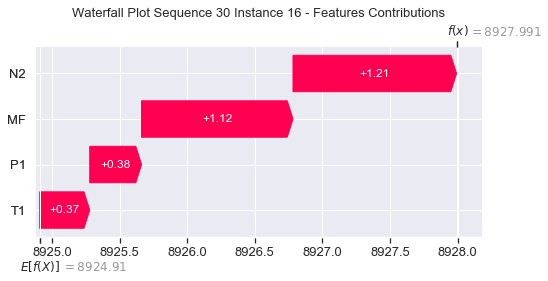

None

Contribution: [0.43531574 0.42372167 1.39536858 1.27384997]


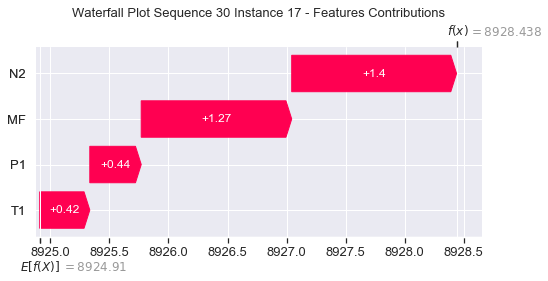

None

Contribution: [0.51638439 0.50086314 1.65445058 1.50993964]


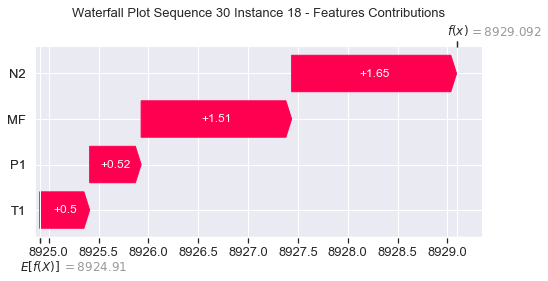

None

Contribution: [0.64236789 0.63285897 2.02749059 1.8625451 ]


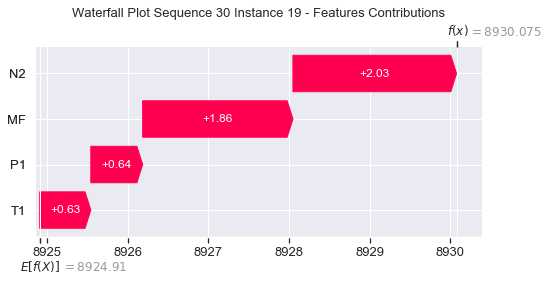

None

Contribution: [0.80681675 0.78139024 2.56916566 2.34989922]


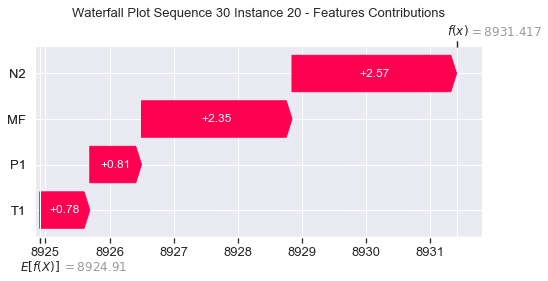

None

Contribution: [1.06368874 1.01580604 3.38845935 3.0983399 ]


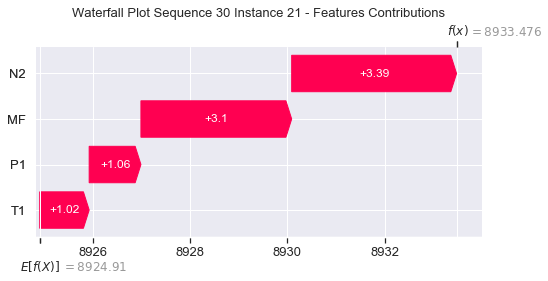

None

Contribution: [1.46554371 1.36340747 4.67589419 4.28057262]


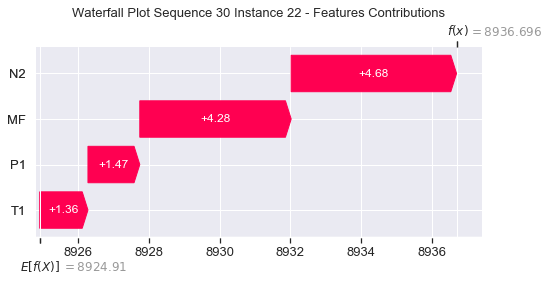

None

Contribution: [2.07032025 1.71844394 6.70451918 6.17468477]


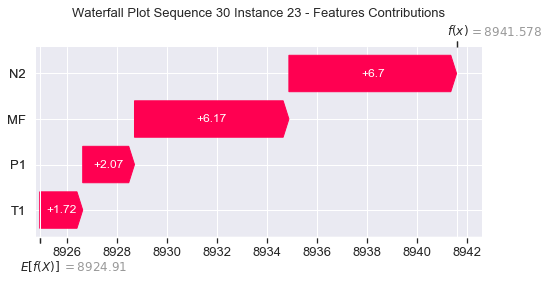

None

Contribution: [2.99403321 0.84268194 9.53888117 9.26511845]


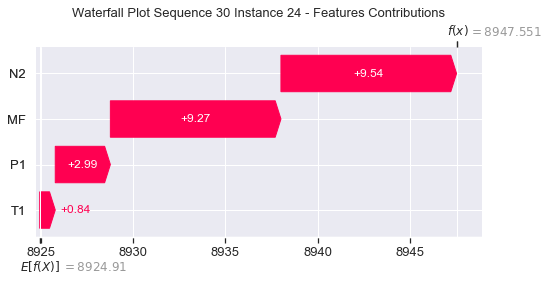

None

Contribution: [ 5.16240759  3.90659521 16.02428542 15.29071333]


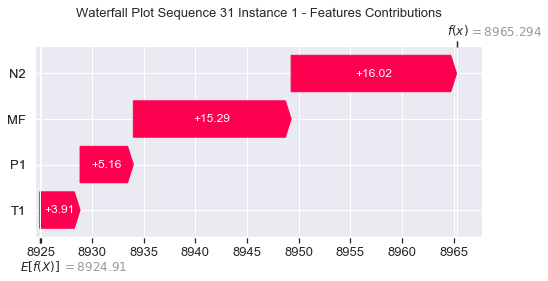

None

Contribution: [0.0359618  0.09165399 0.11384611 0.09485489]


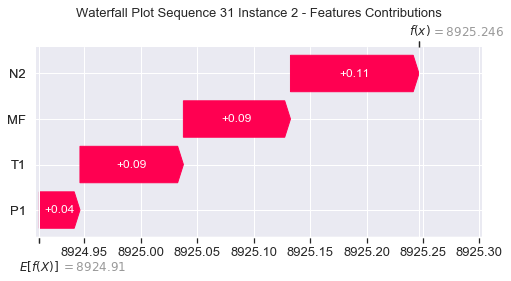

None

Contribution: [0.23284883 0.27448419 0.77673565 0.70367643]


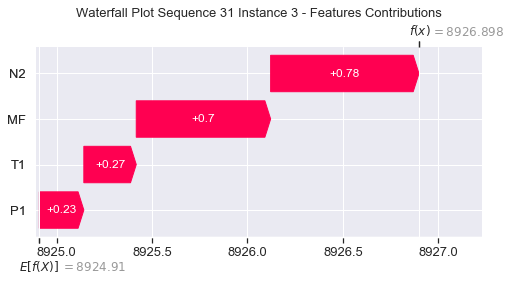

None

Contribution: [0.3237221  0.30871408 1.06110985 0.97309568]


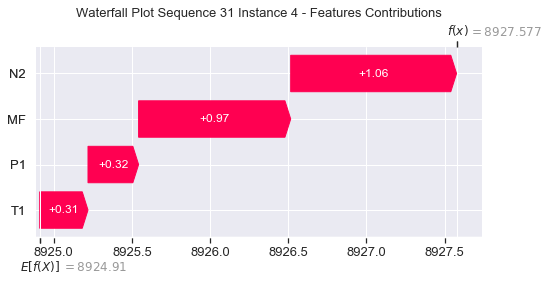

None

Contribution: [0.2821192  0.2649573  0.89425323 0.82303288]


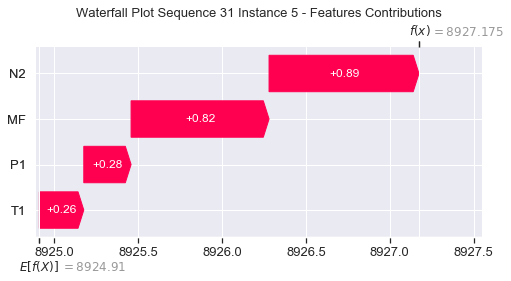

None

Contribution: [0.25173425 0.24041883 0.8100036  0.73855642]


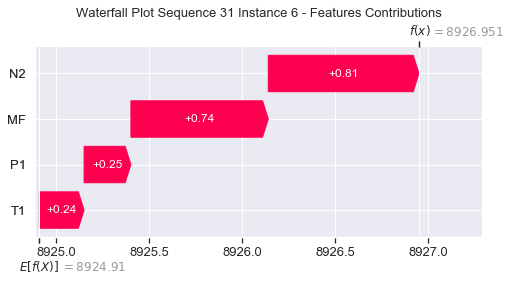

None

Contribution: [0.24225246 0.2317513  0.77686864 0.70821103]


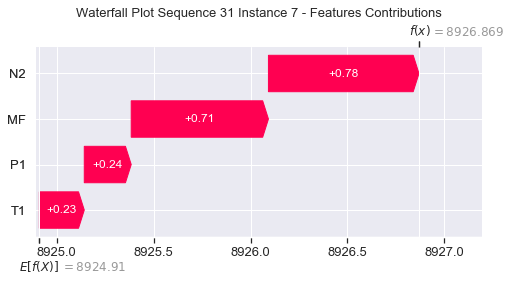

None

Contribution: [0.23901956 0.22887738 0.76336948 0.69862753]


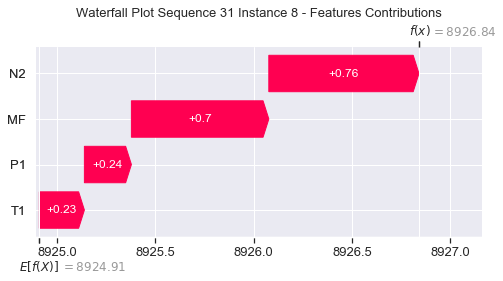

None

Contribution: [0.24786541 0.23245269 0.76584473 0.71300694]


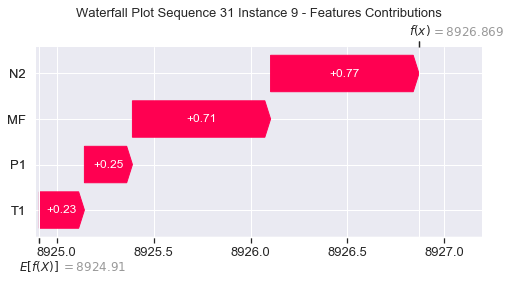

None

Contribution: [0.24793683 0.24235852 0.77784855 0.71497022]


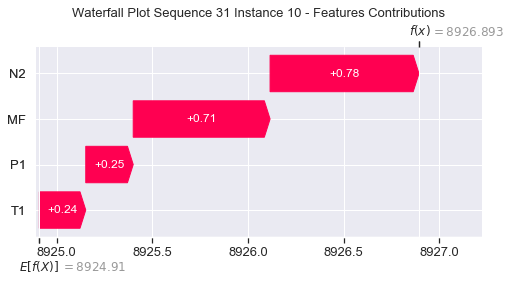

None

Contribution: [0.25596839 0.24533327 0.80443949 0.74580388]


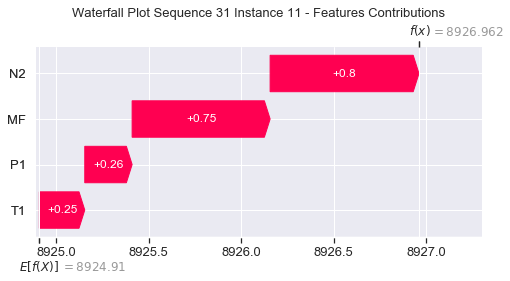

None

Contribution: [0.25914022 0.25309211 0.83733004 0.7605777 ]


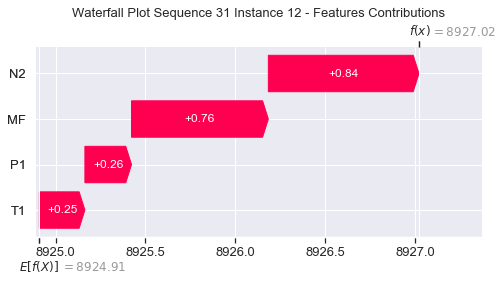

None

Contribution: [0.27824085 0.2719168  0.89421864 0.8141262 ]


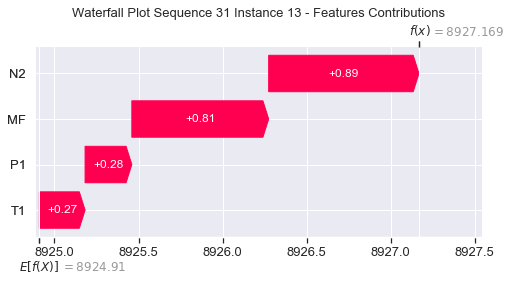

None

Contribution: [0.29986553 0.28398662 0.96683384 0.88885183]


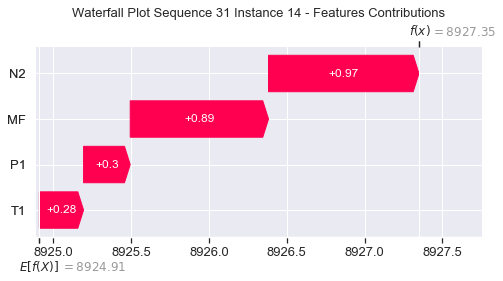

None

Contribution: [0.33177672 0.32742745 1.06772173 0.97329977]


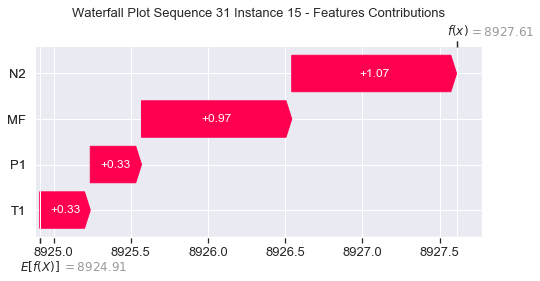

None

Contribution: [0.37965902 0.38607022 1.20662503 1.11501496]


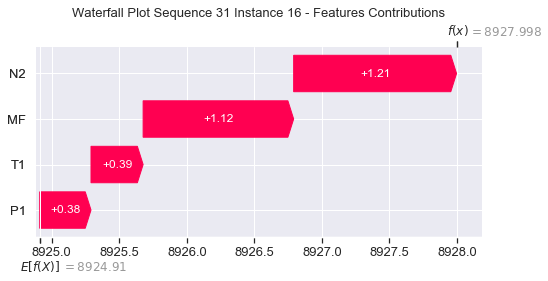

None

Contribution: [0.43595235 0.42738912 1.39220422 1.2712833 ]


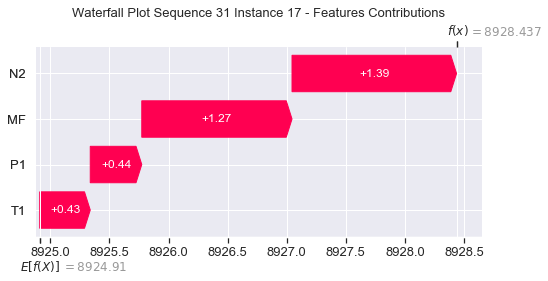

None

Contribution: [0.51747388 0.50530666 1.65122033 1.50899644]


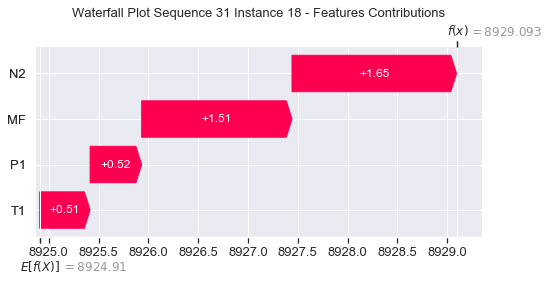

None

Contribution: [0.63156101 0.6158461  2.02805929 1.82972024]


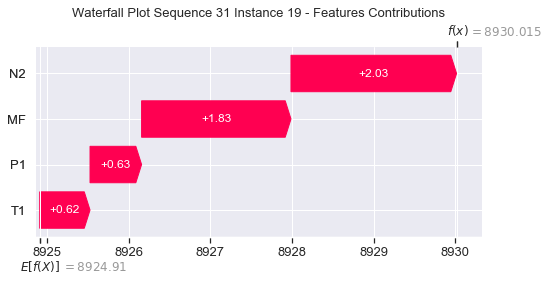

None

Contribution: [0.81632178 0.78089002 2.56559574 2.36157987]


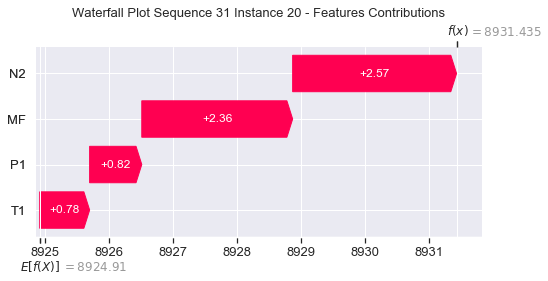

None

Contribution: [1.07895606 1.01551354 3.38464937 3.12047262]


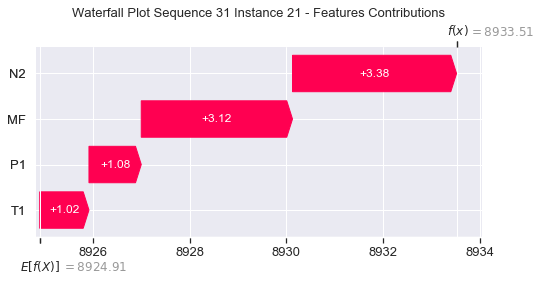

None

Contribution: [1.49142789 1.36404423 4.67429346 4.32552846]


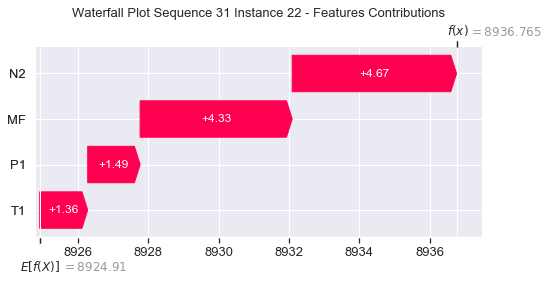

None

Contribution: [2.11683258 1.73556689 6.70988874 6.261114  ]


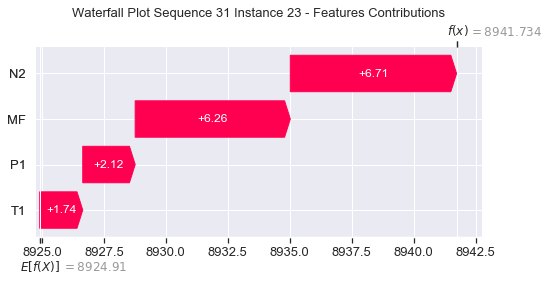

None

Contribution: [3.0110148  0.59931193 9.56059783 9.34483098]


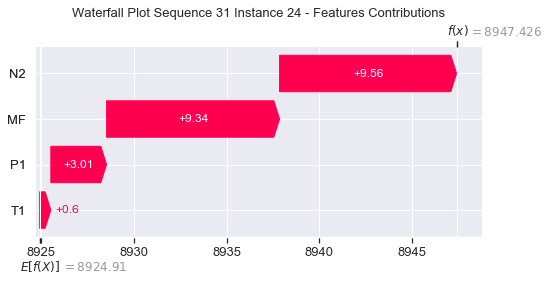

None

Contribution: [ 4.8886334   3.11281965 16.27792812 14.87072096]


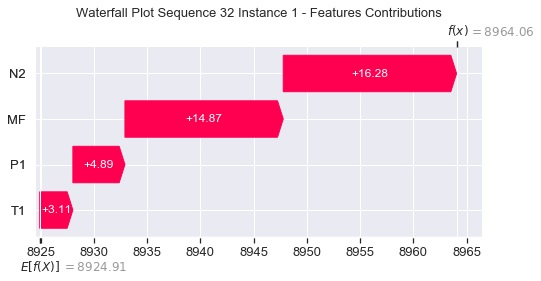

None

Contribution: [0.03283313 0.09587622 0.11343446 0.08887029]


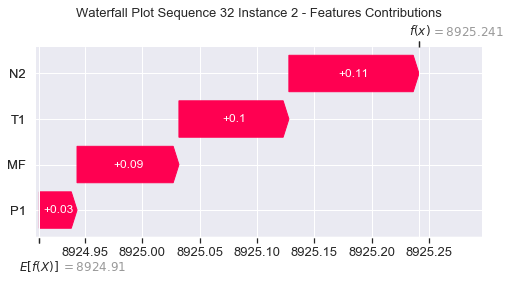

None

Contribution: [0.23751667 0.27789548 0.79364092 0.7191889 ]


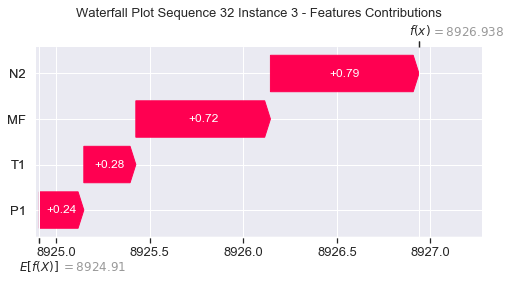

None

Contribution: [0.32879367 0.29917297 1.06046271 0.97105826]


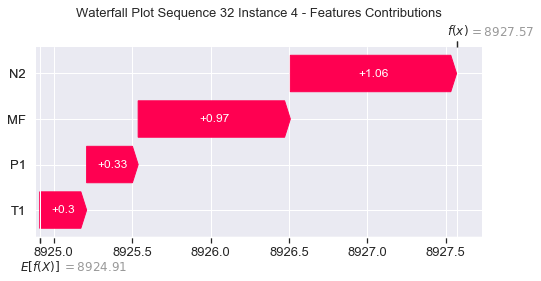

None

Contribution: [0.28590555 0.25945076 0.89420948 0.83268939]


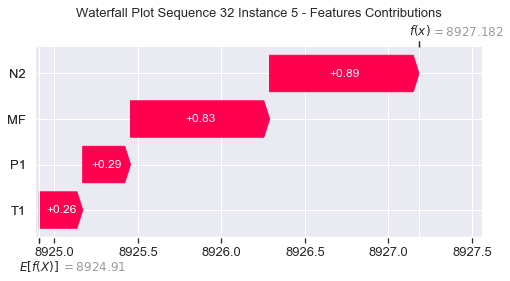

None

Contribution: [0.25853377 0.23436447 0.81205297 0.75356565]


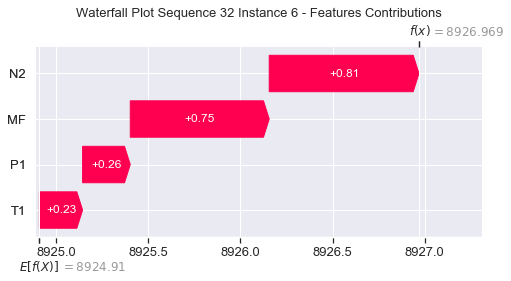

None

Contribution: [0.24782669 0.22644457 0.77949896 0.72404518]


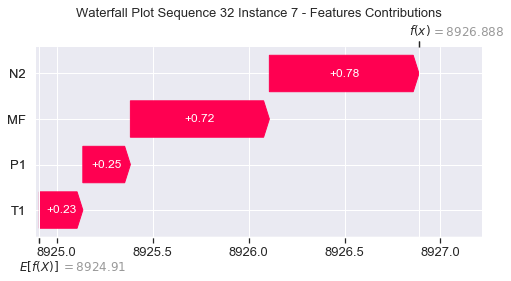

None

Contribution: [0.24257073 0.22334992 0.76556561 0.70931387]


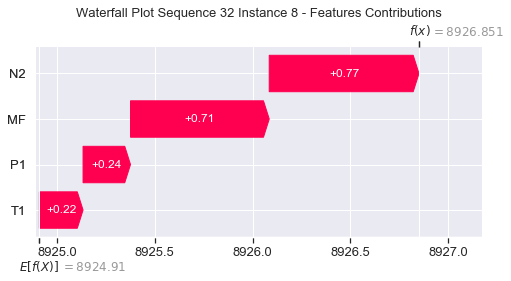

None

Contribution: [0.23569645 0.23033993 0.76274579 0.69870664]


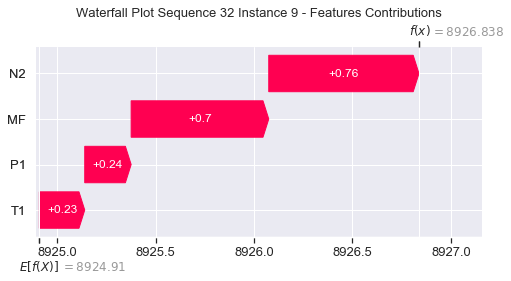

None

Contribution: [0.23555261 0.23510058 0.77238324 0.70152806]


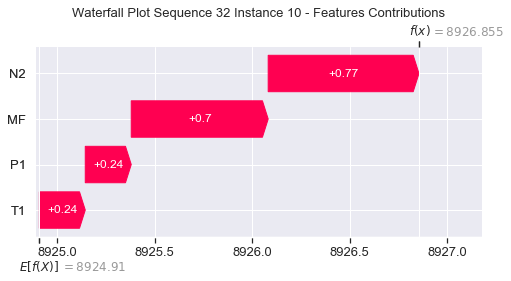

None

Contribution: [0.24856999 0.24063808 0.80239259 0.73427903]


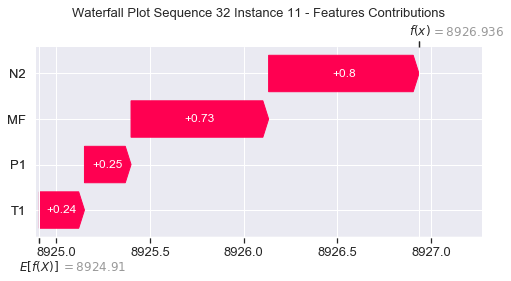

None

Contribution: [0.26723984 0.2523854  0.84256015 0.78538992]


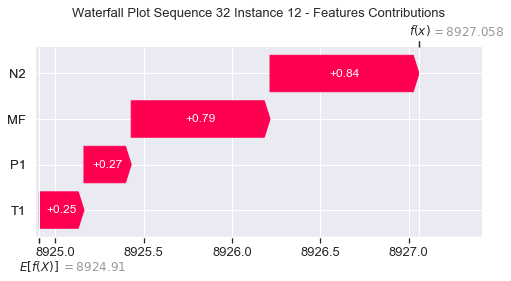

None

Contribution: [0.28495735 0.27057296 0.90004134 0.83792501]


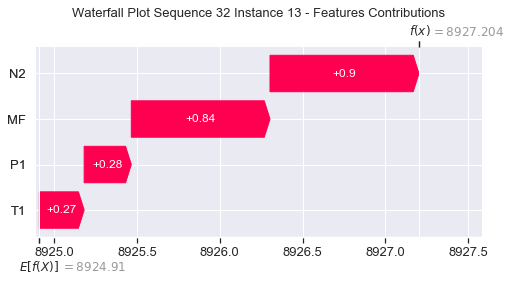

None

Contribution: [0.30325349 0.30649997 0.97273139 0.89385849]


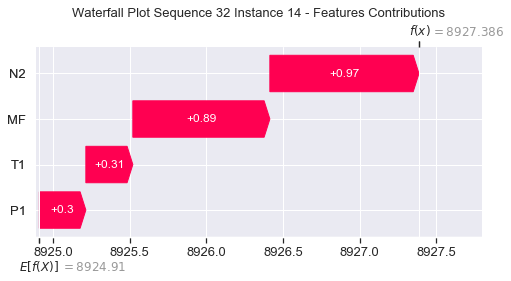

None

Contribution: [0.33872334 0.32020876 1.07699797 0.99712754]


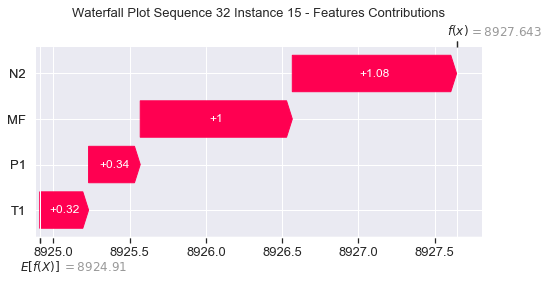

None

Contribution: [0.37484381 0.35669218 1.21288603 1.10582803]


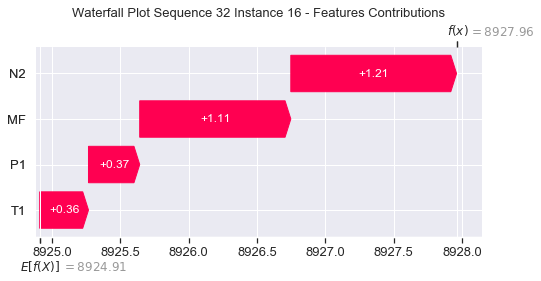

None

Contribution: [0.44137804 0.41655368 1.40467258 1.29811976]


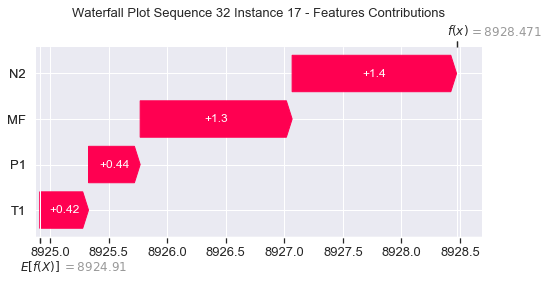

None

Contribution: [0.52368854 0.48926364 1.66742118 1.53777538]


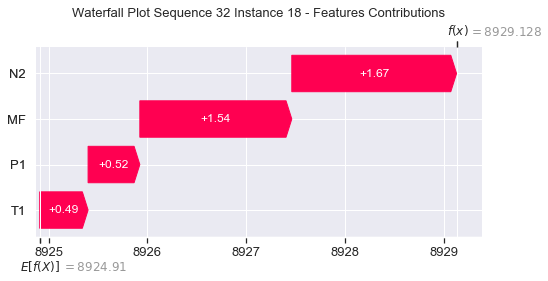

None

Contribution: [0.61108544 0.55930602 2.03286009 1.85492774]


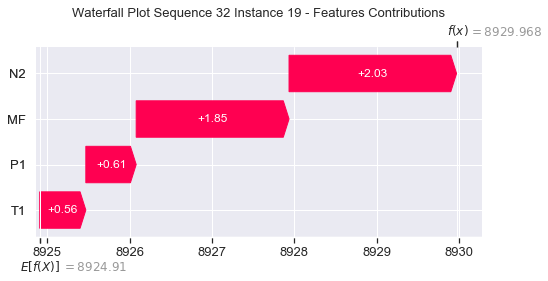

None

Contribution: [0.81165481 0.74306271 2.58731348 2.37812813]


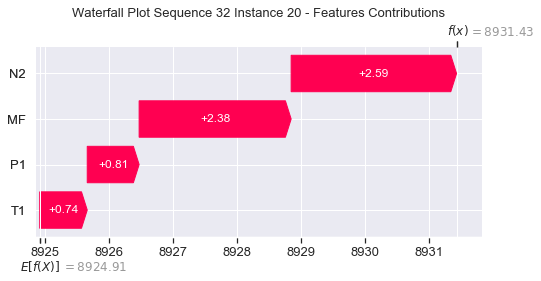

None

Contribution: [1.07326551 0.9694024  3.41319618 3.14030148]


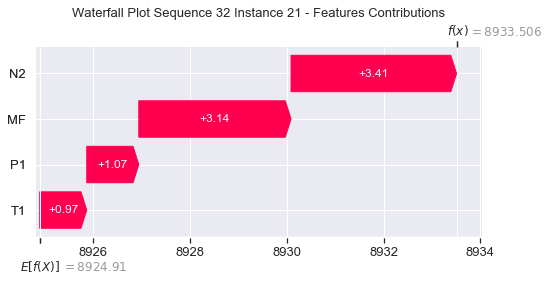

None

Contribution: [1.48144177 1.2871563  4.71448659 4.34208423]


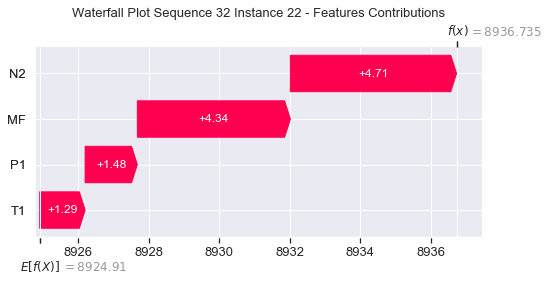

None

Contribution: [2.10317578 1.5691846  6.78271254 6.29417855]


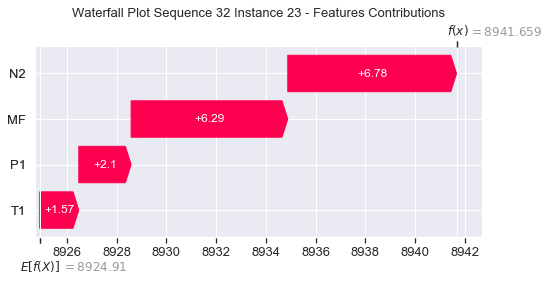

None

Contribution: [2.99607116 0.08763449 9.81021908 9.36665881]


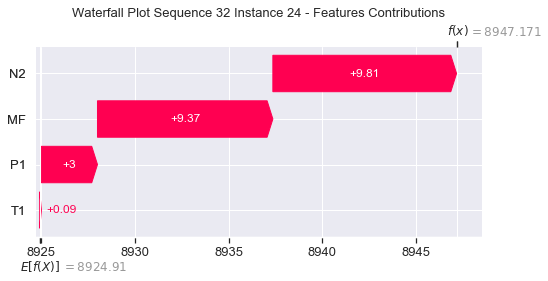

None

Contribution: [ 5.06910987  3.35037031 16.5495899  15.19980066]


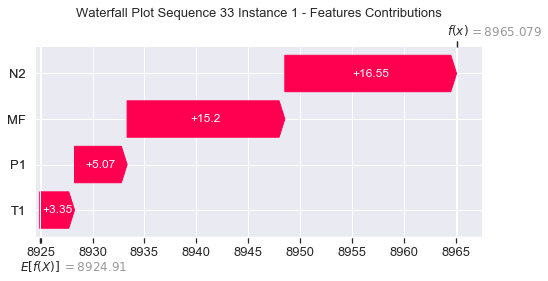

None

Contribution: [0.03518045 0.09902236 0.11330896 0.0908978 ]


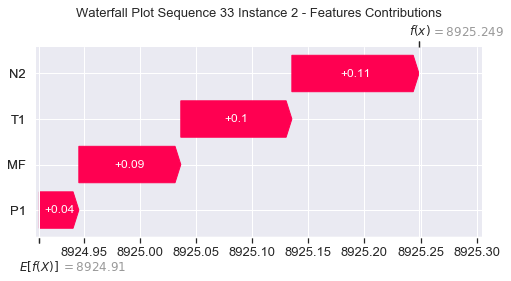

None

Contribution: [0.23936466 0.28250493 0.80245142 0.72647966]


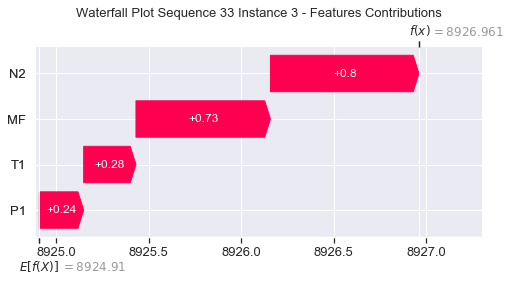

None

Contribution: [0.33720189 0.31248049 1.0836601  1.00093035]


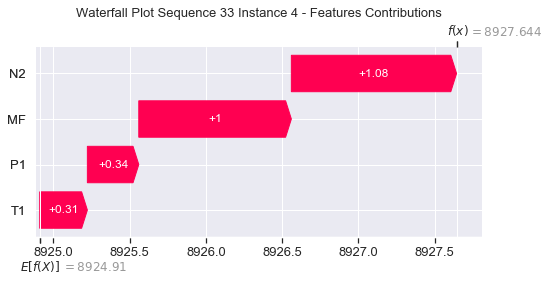

None

Contribution: [0.27965599 0.25354069 0.90806528 0.8272178 ]


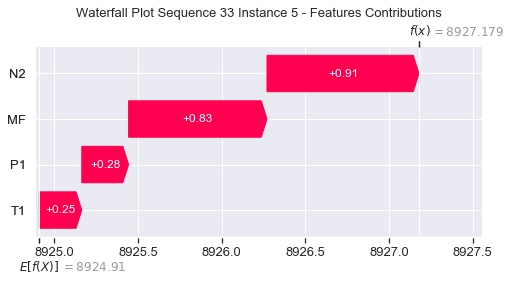

None

Contribution: [0.25916298 0.23320939 0.8248081  0.75887092]


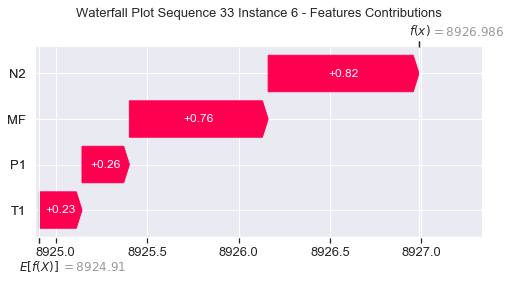

None

Contribution: [0.24700318 0.22224562 0.79078507 0.7246114 ]


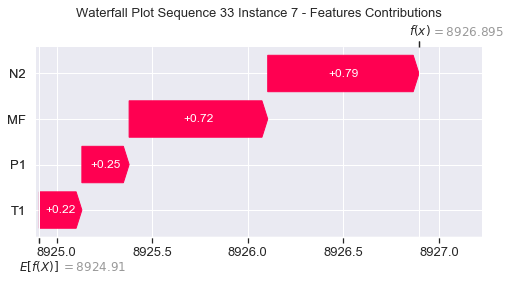

None

Contribution: [0.24180639 0.21927409 0.77696084 0.71321062]


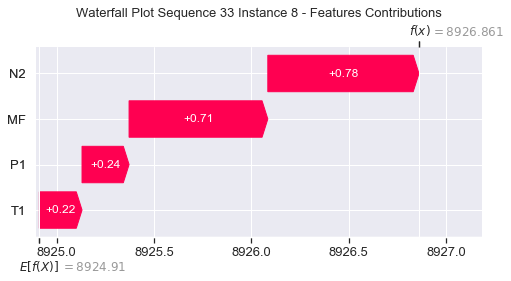

None

Contribution: [0.23221571 0.21974081 0.77680325 0.70783941]


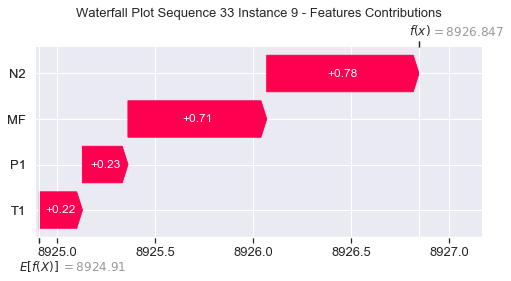

None

Contribution: [0.24087739 0.23131019 0.78748777 0.71493279]


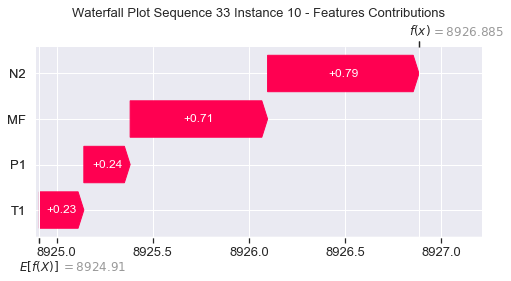

None

Contribution: [0.25158728 0.23556224 0.81917314 0.76223188]


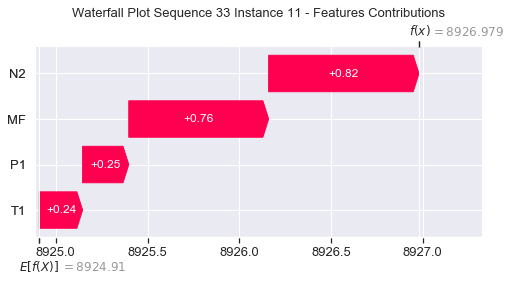

None

Contribution: [0.26756063 0.23573289 0.85355252 0.78819751]


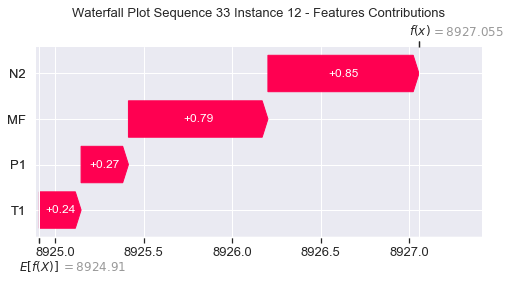

None

Contribution: [0.28360795 0.25198924 0.9112142  0.83740049]


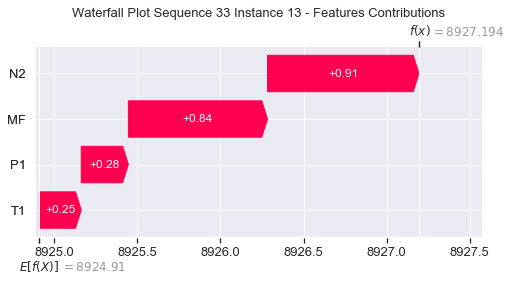

None

Contribution: [0.30587552 0.27063432 0.98249036 0.89345548]


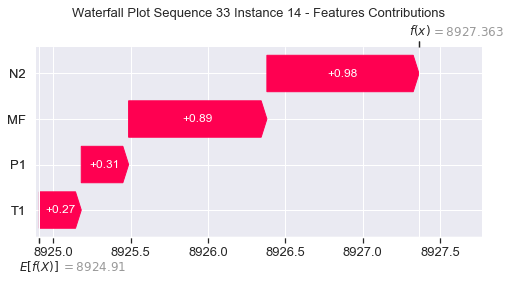

None

Contribution: [0.33913394 0.30142408 1.08866871 1.00175267]


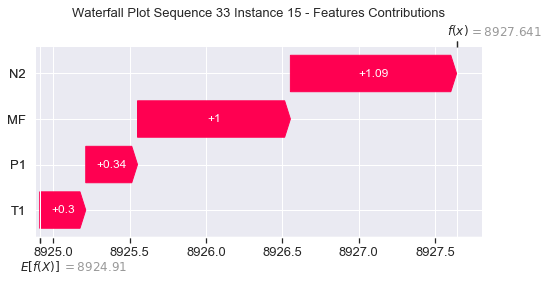

None

Contribution: [0.37787041 0.34953582 1.22309753 1.11597976]


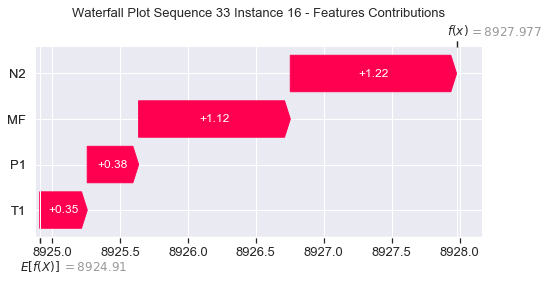

None

Contribution: [0.43931759 0.38897726 1.41674087 1.29918134]


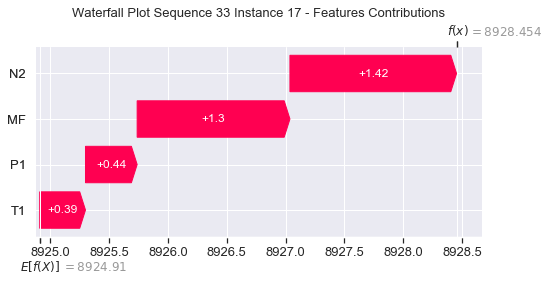

None

Contribution: [0.52223127 0.45986439 1.67942626 1.54278062]


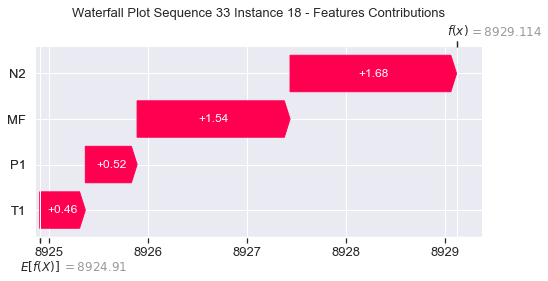

None

Contribution: [0.6250981  0.55789742 2.05071662 1.8541971 ]


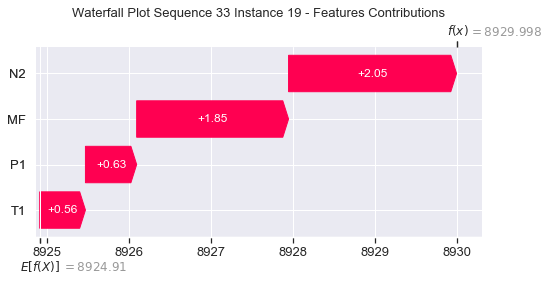

None

Contribution: [0.79855709 0.69935415 2.59950406 2.37277138]


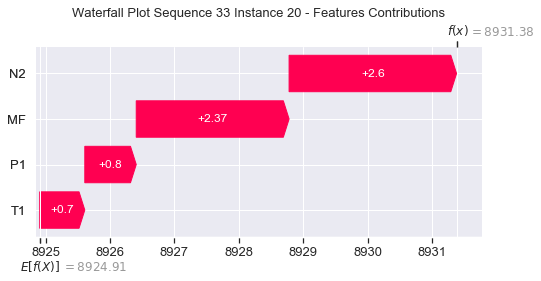

None

Contribution: [1.05177509 0.90008042 3.42057078 3.12737097]


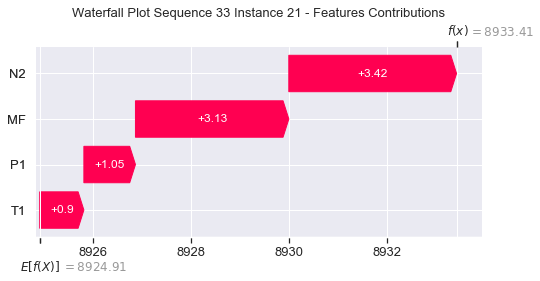

None

Contribution: [1.44609209 1.1795888  4.7079261  4.32175798]


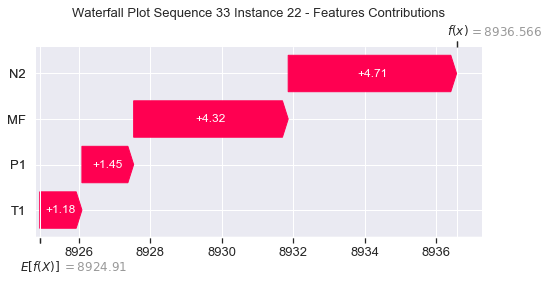

None

Contribution: [2.04601091 1.36400488 6.72964248 6.2663162 ]


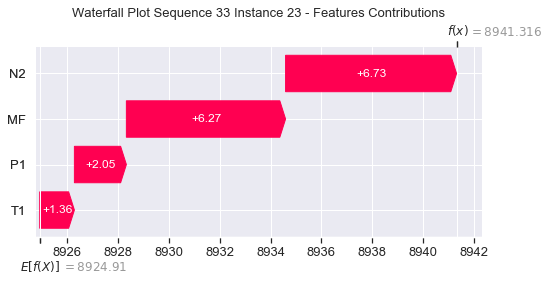

None

Contribution: [ 2.80570606 -0.56044242  9.54375665  9.41156402]


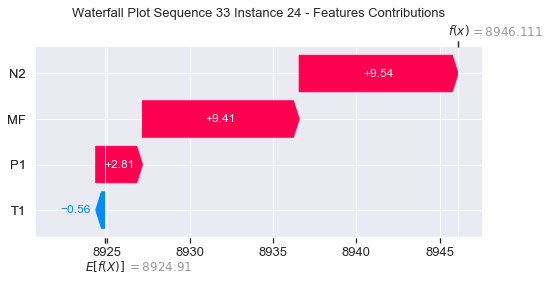

None

Contribution: [ 5.11185868  2.8161722  16.56216607 15.77667171]


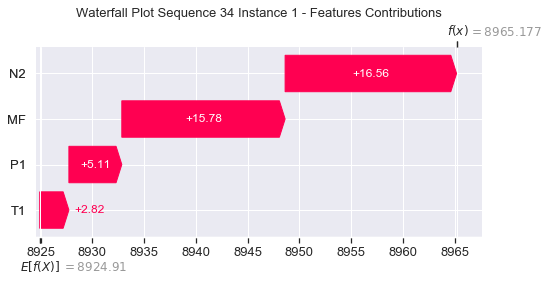

None

Contribution: [0.04321695 0.11426278 0.12961664 0.10735971]


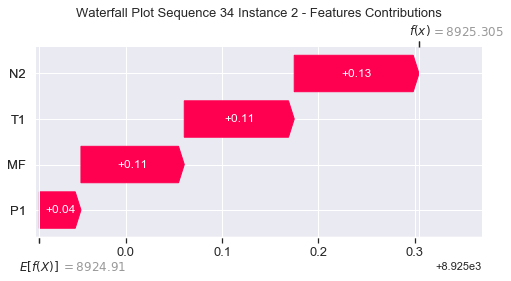

None

Contribution: [0.24459115 0.28809081 0.82188328 0.7483117 ]


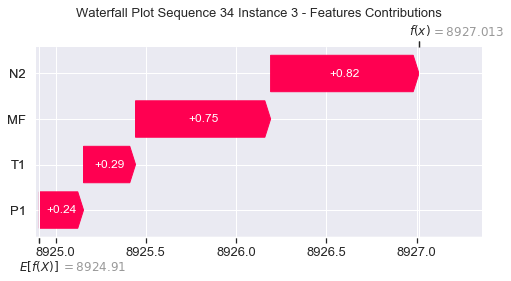

None

Contribution: [0.33122187 0.27024922 1.09171401 1.01655847]


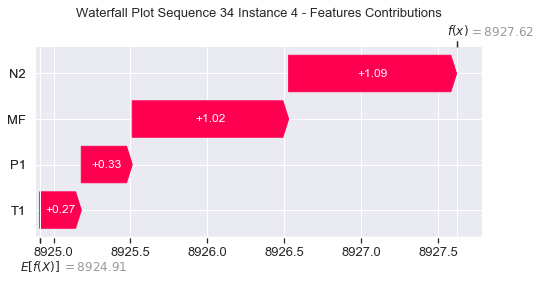

None

Contribution: [0.27943498 0.2352271  0.91252108 0.83161879]


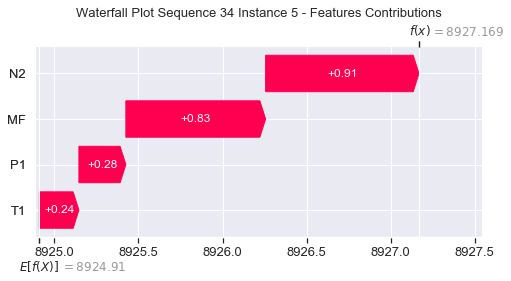

None

Contribution: [0.25380122 0.21647592 0.8294487  0.75964634]


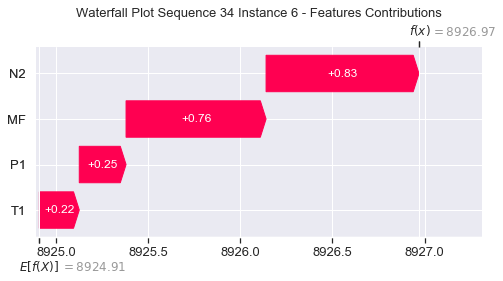

None

Contribution: [0.24334967 0.20874778 0.7960941  0.72872161]


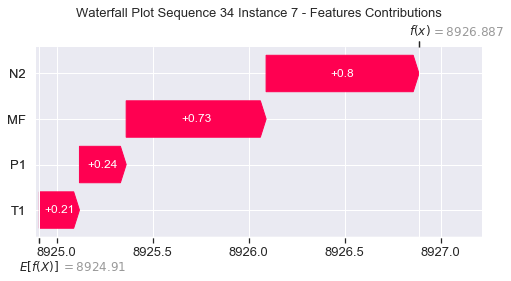

None

Contribution: [0.23752607 0.20461345 0.78227434 0.71570372]


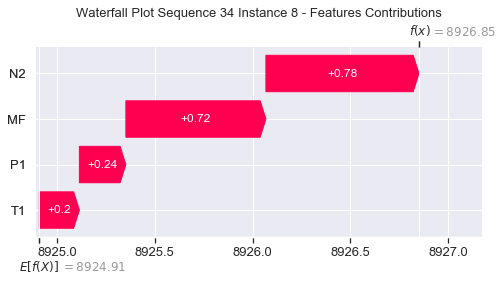

None

Contribution: [0.23218655 0.20465142 0.78549395 0.71756882]


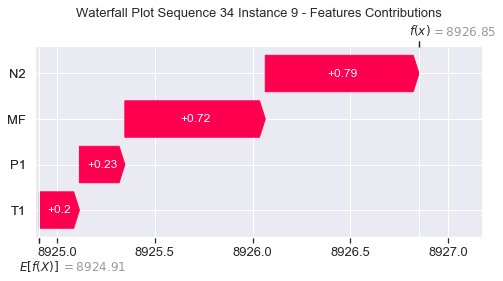

None

Contribution: [0.23425329 0.20503373 0.79951367 0.73203318]


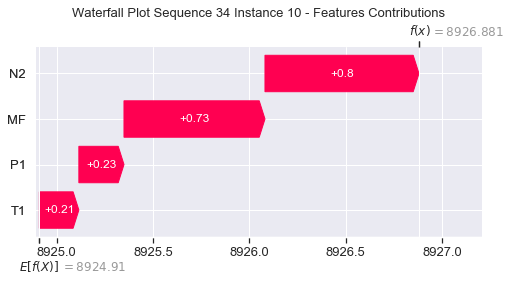

None

Contribution: [0.24028376 0.21558554 0.82642031 0.75673402]


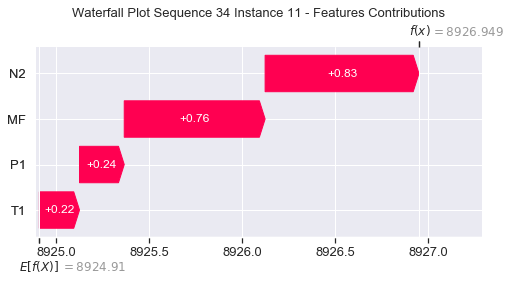

None

Contribution: [0.25413339 0.22844292 0.86150484 0.78628334]


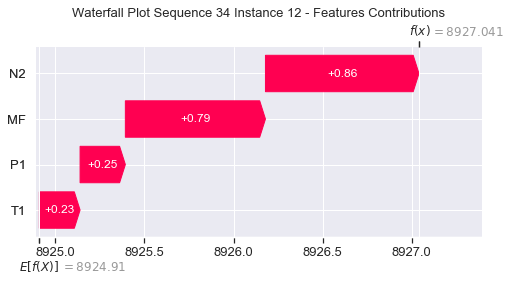

None

Contribution: [0.27221735 0.24430889 0.91952041 0.83850069]


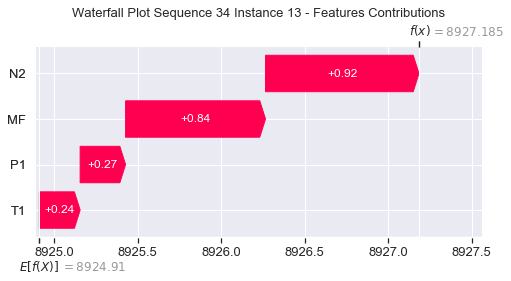

None

Contribution: [0.28203723 0.25811293 0.99342222 0.89059728]


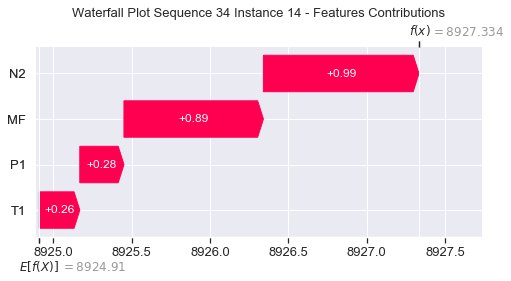

None

Contribution: [0.32725009 0.29279777 1.09705348 1.00163938]


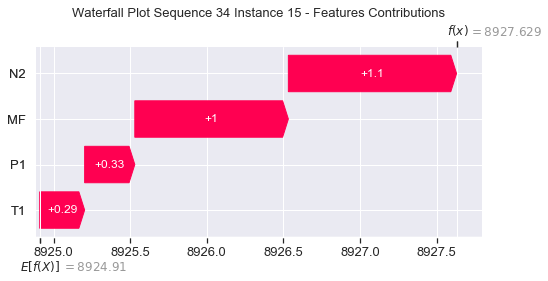

None

Contribution: [0.37965851 0.31623003 1.2401252  1.14157332]


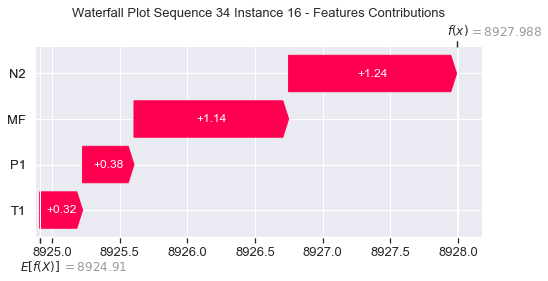

None

Contribution: [0.42801649 0.37998388 1.42794289 1.30451209]


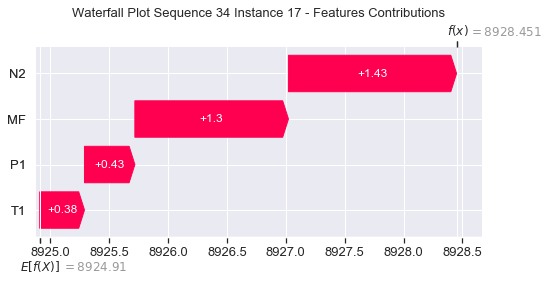

None

Contribution: [0.50855619 0.44769394 1.6915905  1.5464008 ]


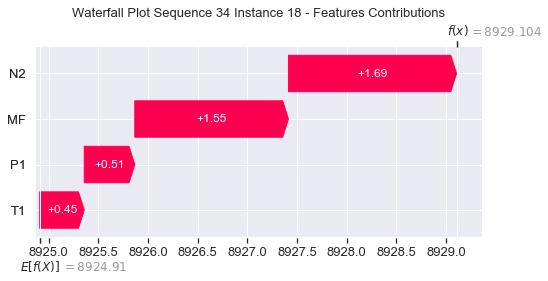

None

Contribution: [0.60814416 0.52465671 2.06674448 1.86653944]


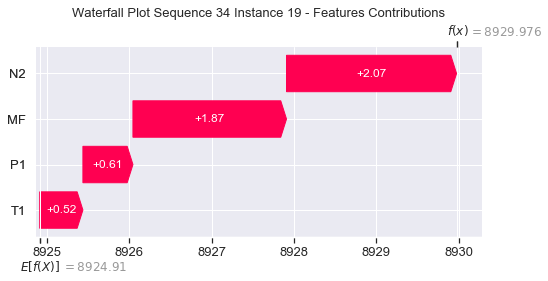

None

Contribution: [0.79601965 0.68004271 2.61314481 2.38827164]


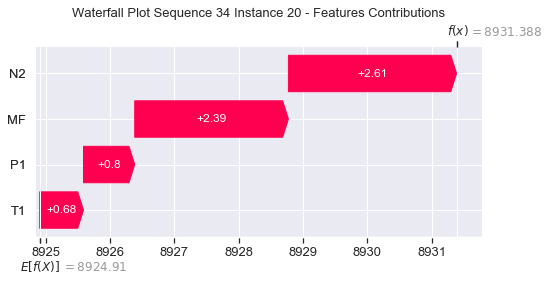

None

Contribution: [1.04411715 0.87911878 3.43712419 3.14031857]


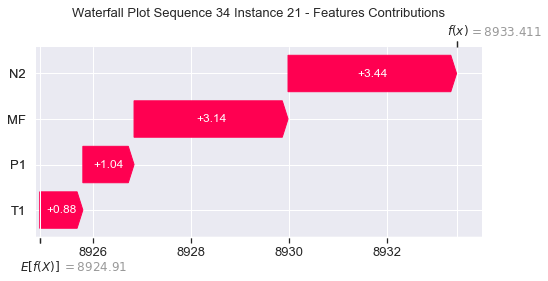

None

Contribution: [1.42985126 1.15016587 4.72734323 4.3237632 ]


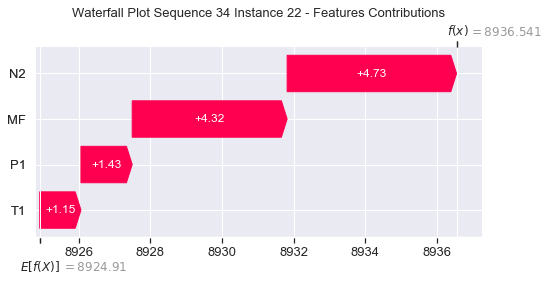

None

Contribution: [1.98414058 1.2914232  6.76160789 6.24104273]


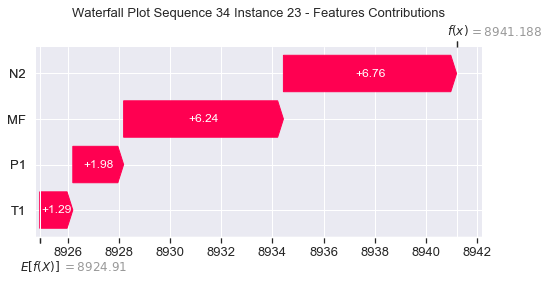

None

Contribution: [ 2.64889785 -0.98471381  9.55602089  9.23379606]


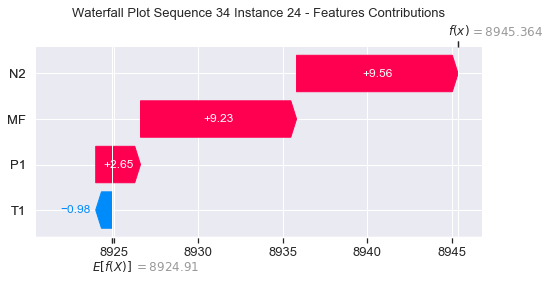

None

In [36]:
#Waterfall Plot for Local Accuracy & Consistency metrics

sns.set()
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Sequence %s " %(s+1)+"Instance %i - Features Contributions" %(j+1),fontsize=13)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [37]:
#Define f''x

inputs = tf.keras.Input(shape=(24,3),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model3 = tf.keras.Model(inputs=inputs, outputs=layer4)
model3.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 24, 3)]           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 24, 934)           3504368   
_________________________________________________________________
dense_4 (Dense)              (None, 24, 364)           340340    
_________________________________________________________________
dense_5 (Dense)              (None, 24, 1)             365       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 3,845,073
Trainable params: 3,845,073
Non-trainable params: 0
_________________________________________________________________


In [38]:
#Extract only weights for 3 variables excluding mf

a = model2.layers[1].get_weights()[0][0:3]
a = [a,model2.layers[1].get_weights()[1],model2.layers[1].get_weights()[2]]

In [39]:
#Transfer weights from f'x to f''x

model3.layers[0].set_weights(model2.layers[0].get_weights())
model3.layers[1].set_weights(a)
model3.layers[2].set_weights(model2.layers[2].get_weights())
model3.layers[3].set_weights(model2.layers[3].get_weights())
model3.layers[4].set_weights(model2.layers[4].get_weights())

In [40]:
#Load xtest and delete mf

xtrain_file = "xtrain.csv"
xtrain = pd.read_csv(xtrain_file, index_col=False)
xtrain = xtrain.drop(['MF'],axis=1)

#Load xtest and delete mf

xtest_file = "xtest.csv"
xtest = pd.read_csv(xtest_file, index_col=False)
xtest = xtest.drop(['MF'],axis=1)

#Xtest to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,3)

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,3)

In [41]:
#Prediction with features excluding mf

preds3 = model3(xtest)
y4 = preds3
y4 = tf.keras.backend.get_value(y4)
tens_draw4 = y4

In [42]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = features.drop(['MF'],axis=1)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2'], dtype='<U2')

Contribution: [ -1.27713039 -43.65755714  19.03820619]


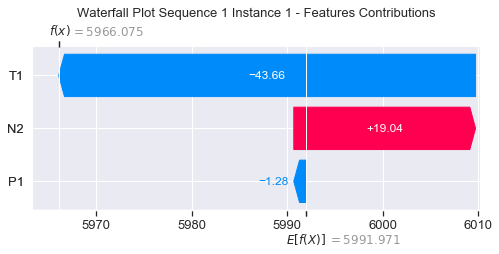

None

Contribution: [ 0.12341855 -0.22952153  0.29880949]


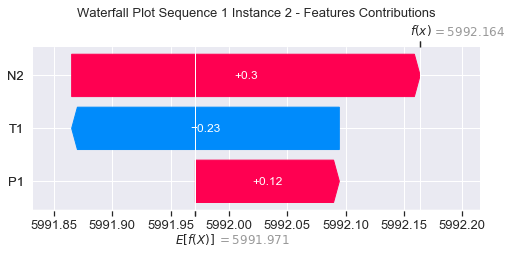

None

Contribution: [-0.20080705 -6.9695267   2.00007334]


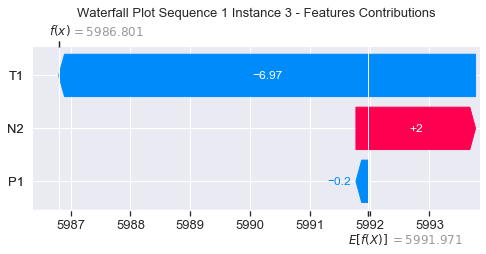

None

Contribution: [ 0.04597843 -3.79478572  0.93290501]


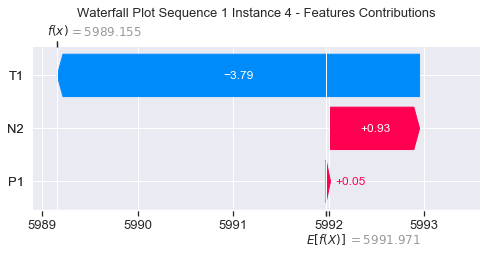

None

Contribution: [ 0.10128817 -2.25363745  0.4507845 ]


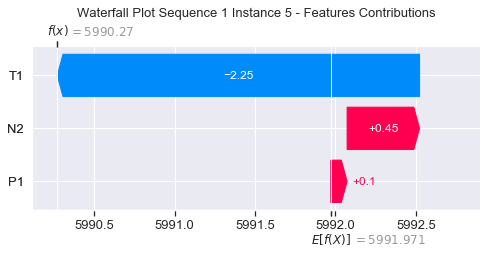

None

Contribution: [ 0.13852808 -1.63708728  0.26409821]


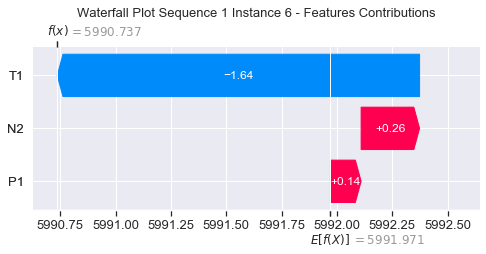

None

Contribution: [ 0.13938837 -1.41533777  0.20116014]


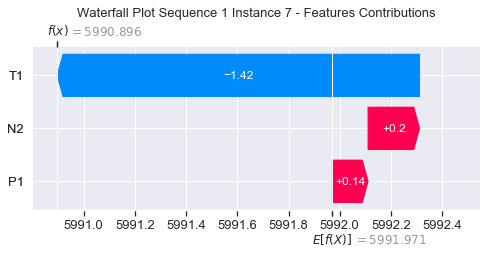

None

Contribution: [ 0.13018019 -1.3008009   0.18081761]


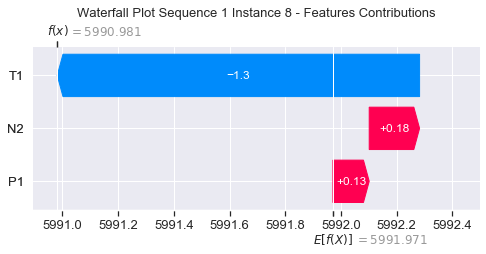

None

Contribution: [ 0.08932772 -1.27838134  0.18661845]


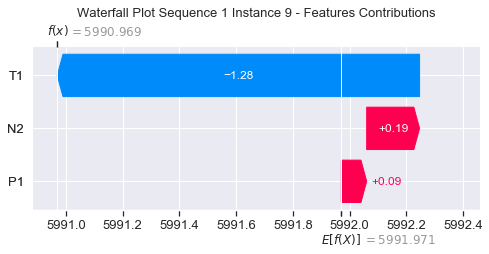

None

Contribution: [ 0.08523016 -1.17941712  0.19278796]


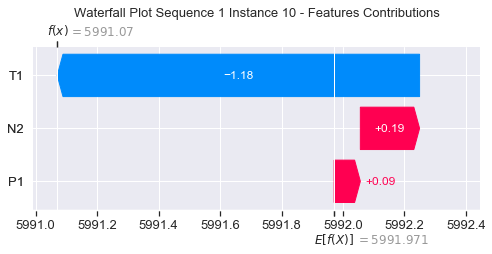

None

Contribution: [ 0.08314136 -1.21116886  0.18525464]


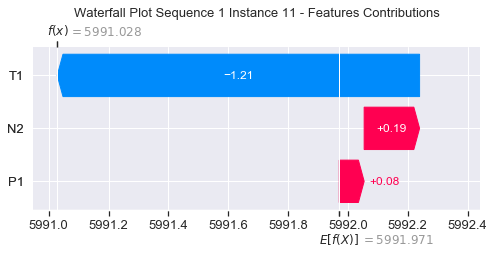

None

Contribution: [ 0.12529216 -1.22752761  0.17794388]


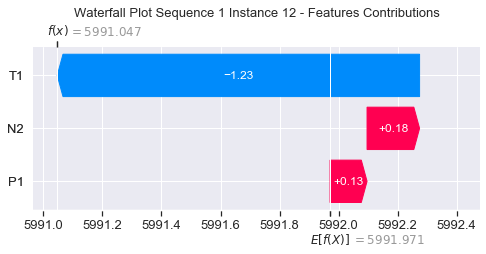

None

Contribution: [ 0.11739105 -1.2625411   0.19019881]


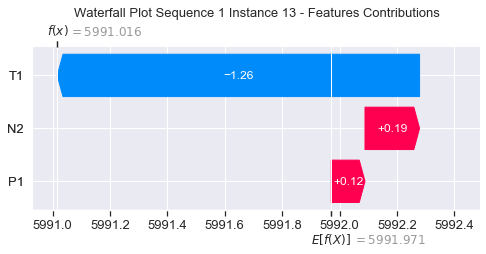

None

Contribution: [ 0.10181878 -1.33860104  0.21235912]


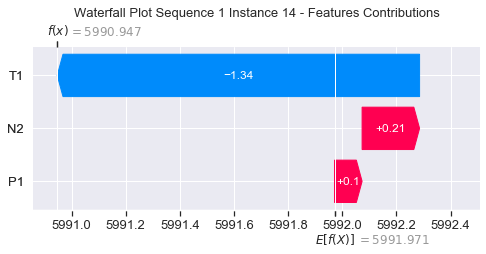

None

Contribution: [ 0.0672696  -1.40775434  0.25520573]


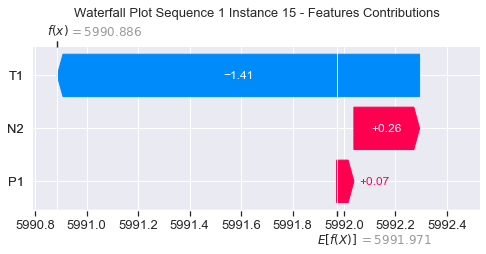

None

Contribution: [-0.0359579  -1.48156533  0.34853344]


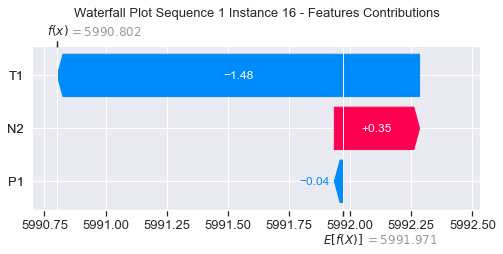

None

Contribution: [-0.04339209 -1.61198464  0.43114144]


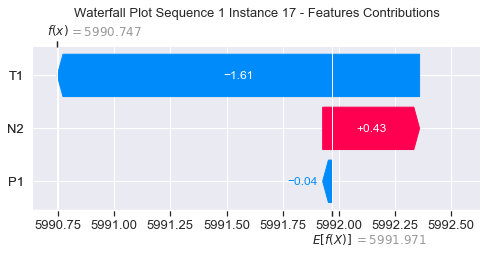

None

Contribution: [-0.16478251 -1.8901656   0.58925623]


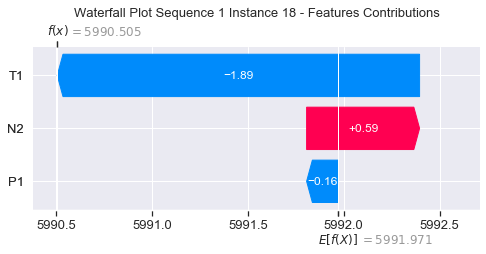

None

Contribution: [-0.82588768 -2.50193642  0.87629572]


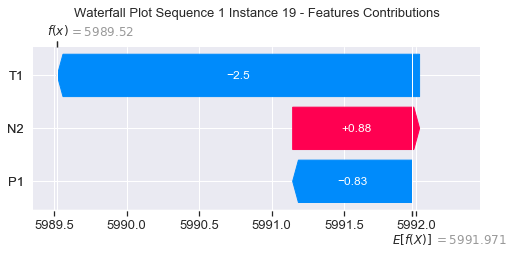

None

Contribution: [-0.7496325  -2.94002785  1.28397028]


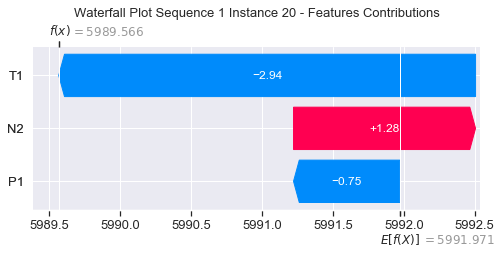

None

Contribution: [-1.26640381 -4.41732574  1.96528825]


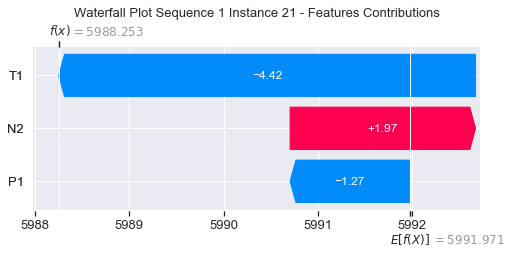

None

Contribution: [-2.17675029 -6.77974646  3.12419907]


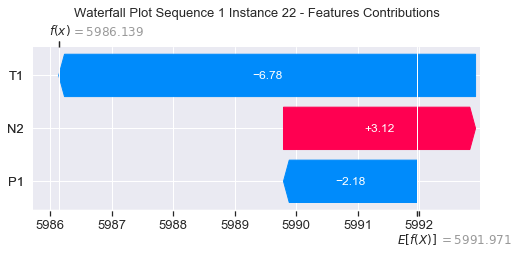

None

Contribution: [-3.68600635 -9.54248559  5.22383708]


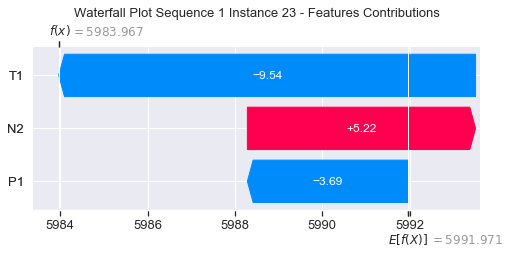

None

Contribution: [ -2.39218144 -11.96311371   8.34327023]


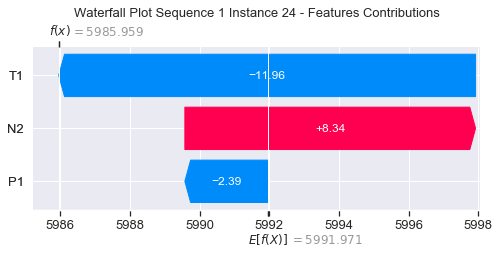

None

Contribution: [  0.44391814 -45.17262259  15.25521782]


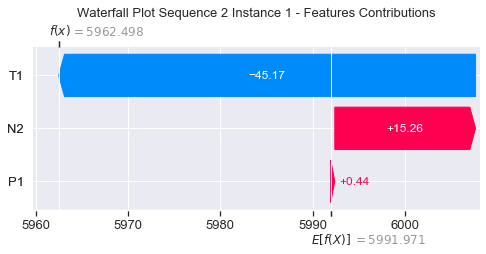

None

Contribution: [ 0.15232098 -0.31248879  0.30088456]


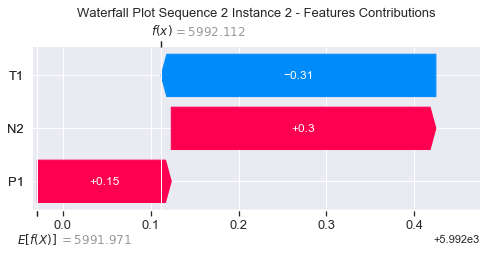

None

Contribution: [-0.12731379 -8.24763999  1.45733803]


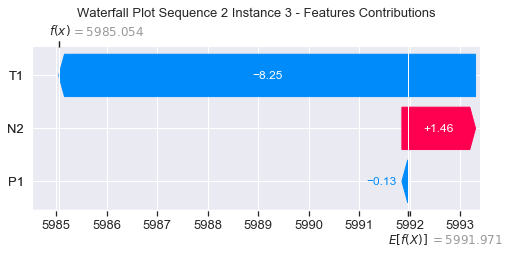

None

Contribution: [ 0.09360296 -4.67599979  0.74199394]


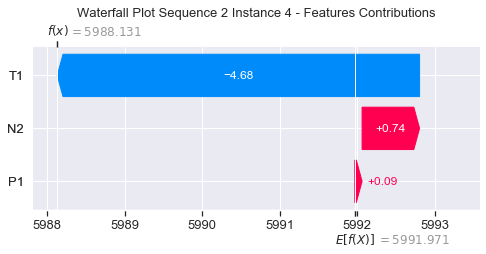

None

Contribution: [ 0.17647989 -3.04379725  0.41531976]


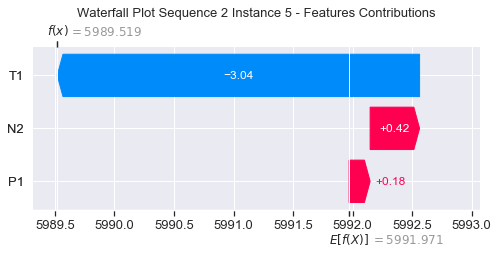

None

Contribution: [ 0.22644949 -1.8959442   0.25389746]


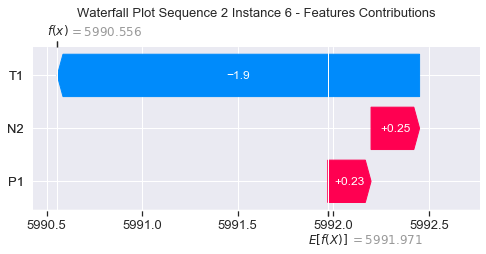

None

Contribution: [ 0.22876573 -1.4934525   0.20033198]


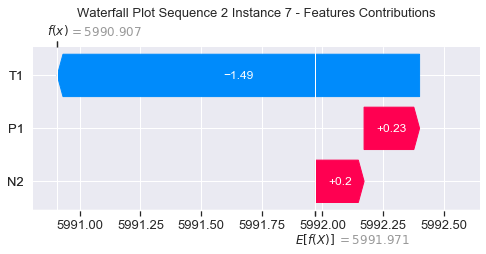

None

Contribution: [ 0.2180158  -1.33059111  0.18952581]


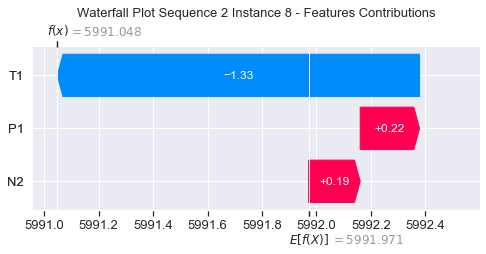

None

Contribution: [ 0.17015231 -1.21569803  0.17810997]


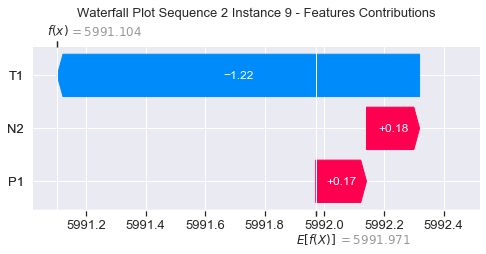

None

Contribution: [ 0.16895232 -1.13517908  0.18537213]


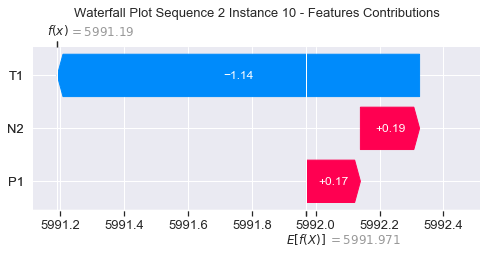

None

Contribution: [ 0.17190169 -1.20609051  0.20004155]


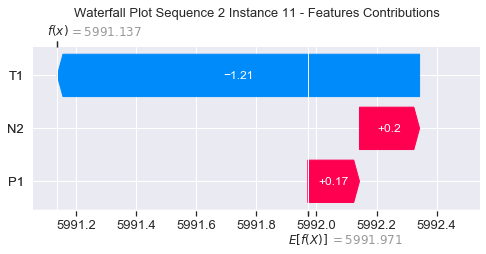

None

Contribution: [ 0.20632654 -1.24733171  0.20555079]


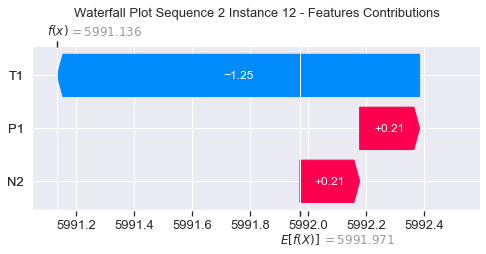

None

Contribution: [ 0.19355156 -1.37373727  0.21439471]


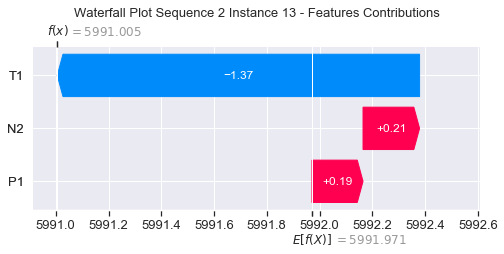

None

Contribution: [ 0.16592327 -1.58868797  0.23586593]


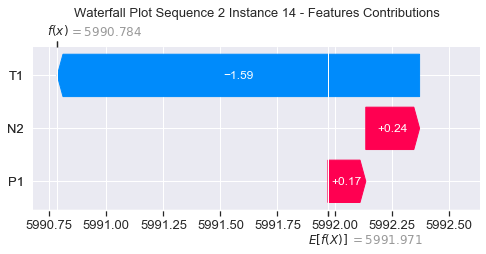

None

Contribution: [ 0.12061263 -1.92879726  0.27653392]


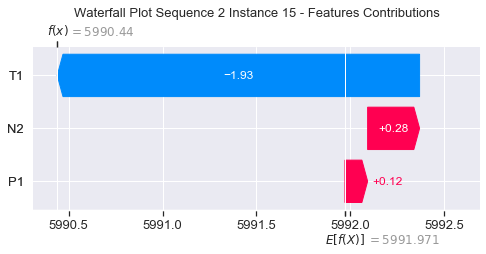

None

Contribution: [-0.00437805 -2.42323196  0.36958801]


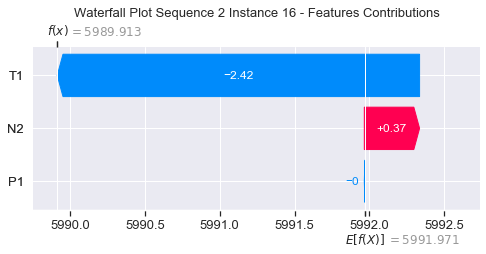

None

Contribution: [-0.05090284 -3.36749448  0.45414925]


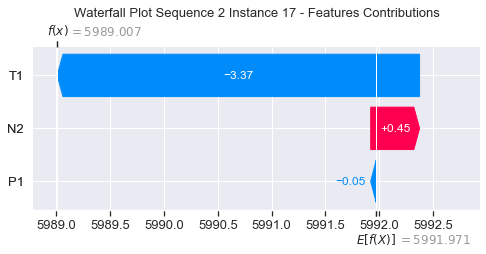

None

Contribution: [-0.25864484 -4.8569821   0.60397282]


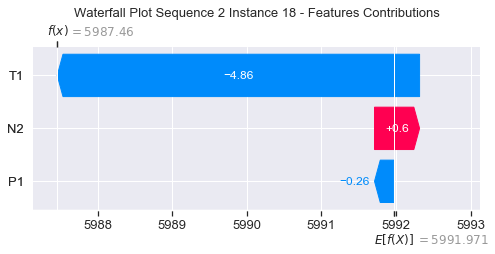

None

Contribution: [-0.75766561 -7.15063891  0.85476454]


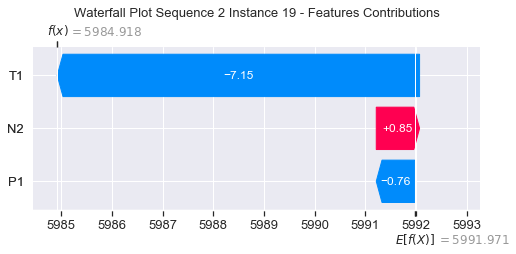

None

Contribution: [ -1.0639812  -10.93101117   1.3561934 ]


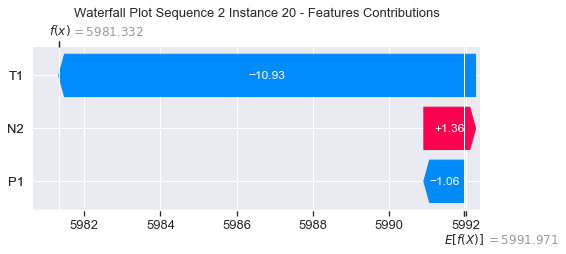

None

Contribution: [ -1.79357865 -17.085788     2.04494016]


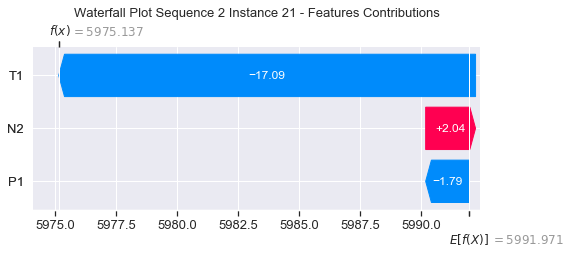

None

Contribution: [ -3.06566993 -25.68571115   3.15044856]


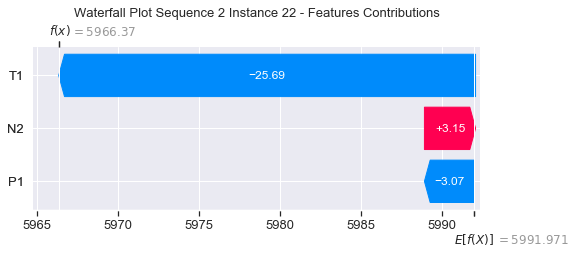

None

Contribution: [ -5.22925362 -36.90835808   5.11848754]


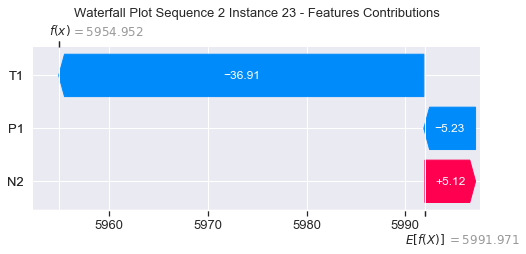

None

Contribution: [ -5.13083263 -44.19857203   8.21972144]


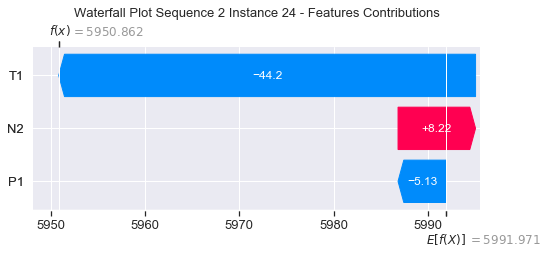

None

Contribution: [  1.00016863 -63.21005357  16.21931456]


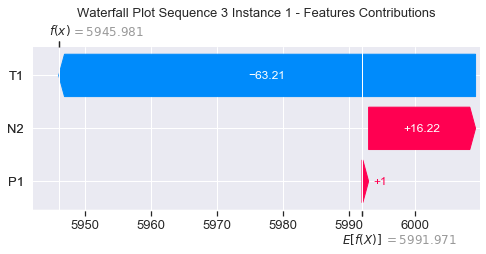

None

Contribution: [0.20736487 0.13292305 0.23779271]


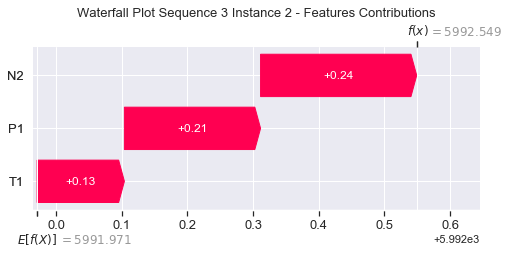

None

Contribution: [ 0.47260678 -6.40751741  1.50725145]


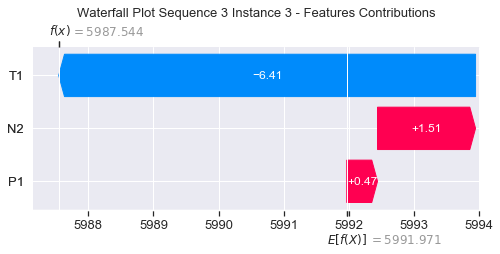

None

Contribution: [ 0.72988597 -1.07079051  0.66126651]


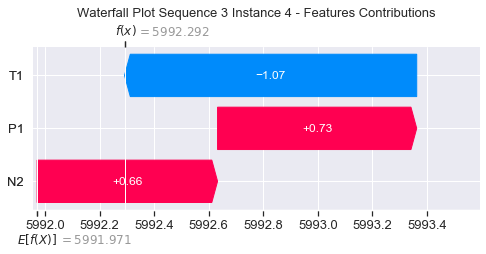

None

Contribution: [0.61802971 0.09707366 0.42707593]


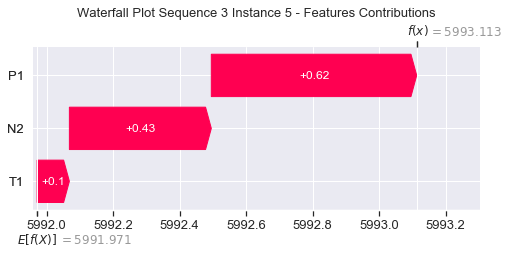

None

Contribution: [0.62693513 0.76093052 0.39367765]


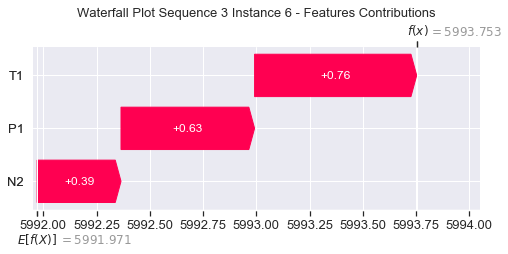

None

Contribution: [0.64376679 1.15470827 0.4747541 ]


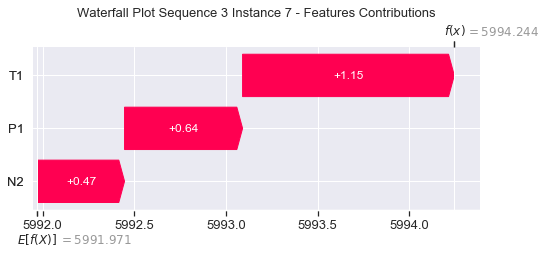

None

Contribution: [0.60690978 1.29918369 0.50645022]


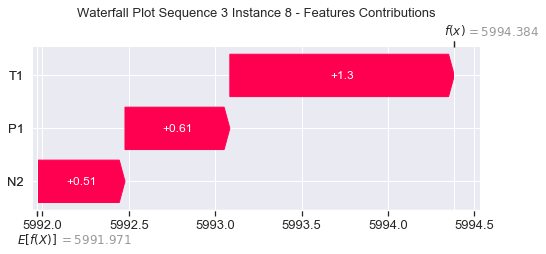

None

Contribution: [0.63610757 0.99555604 0.52631131]


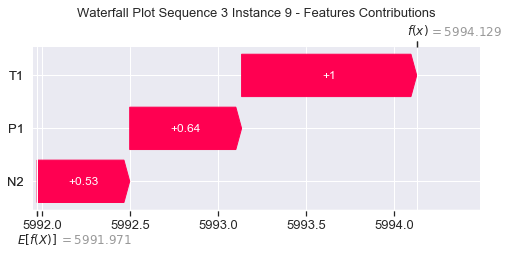

None

Contribution: [0.57795897 0.55429284 0.48327301]


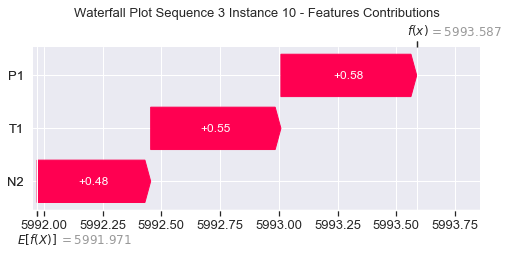

None

Contribution: [0.5479081  0.76549706 0.5138709 ]


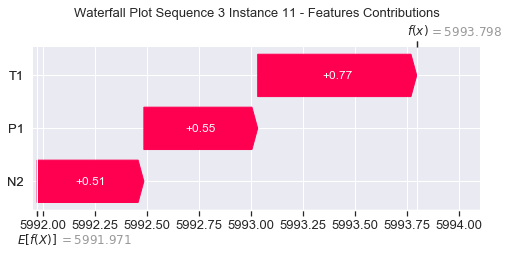

None

Contribution: [0.55856607 1.13874203 0.52463592]


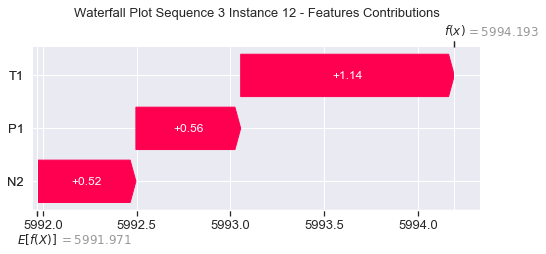

None

Contribution: [0.56273679 0.9289645  0.53871535]


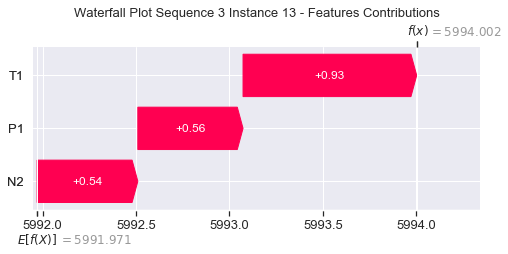

None

Contribution: [0.68114941 0.45849097 0.53617848]


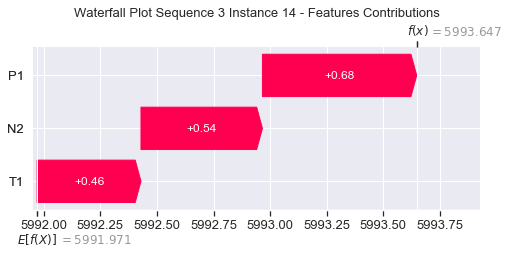

None

Contribution: [0.55253415 0.21605593 0.5923503 ]


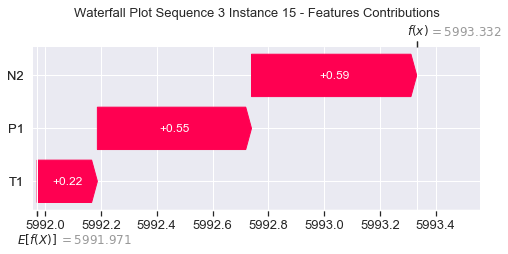

None

Contribution: [ 0.43309174 -0.47548103  0.60428567]


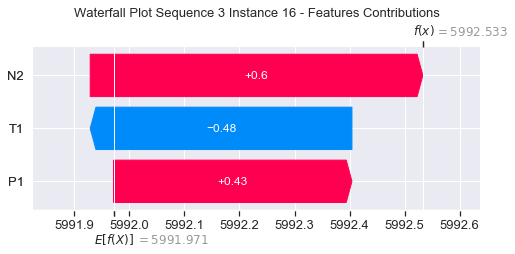

None

Contribution: [ 0.38964628 -1.51072761  0.74851846]


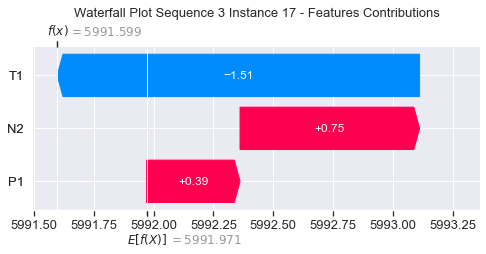

None

Contribution: [ 0.17666261 -3.19818565  0.90640228]


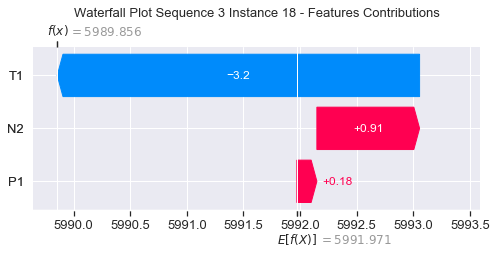

None

Contribution: [-0.21571919 -6.1586633   1.21506926]


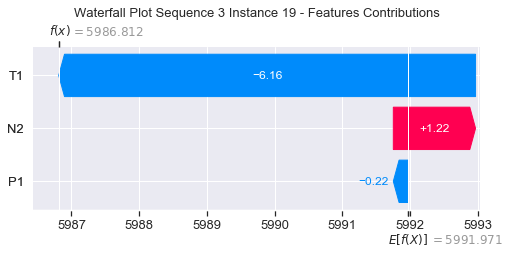

None

Contribution: [ -0.77973935 -10.46347678   1.59021908]


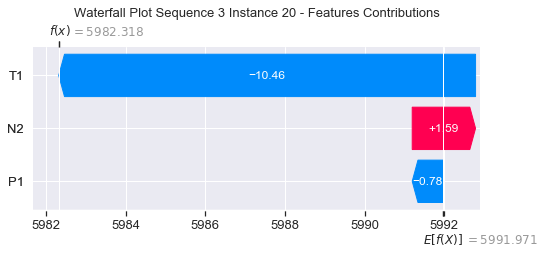

None

Contribution: [ -1.52540439 -17.34660752   2.32106006]


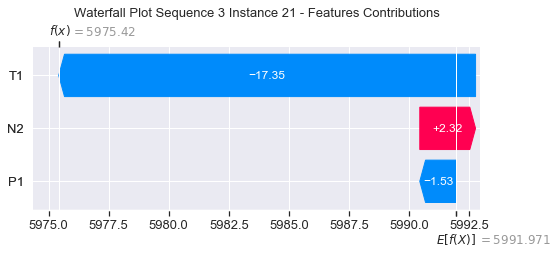

None

Contribution: [ -2.68489792 -27.18510301   3.58241694]


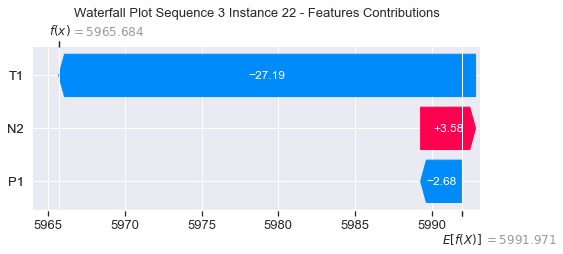

None

Contribution: [ -4.58609561 -38.15793079   5.96844762]


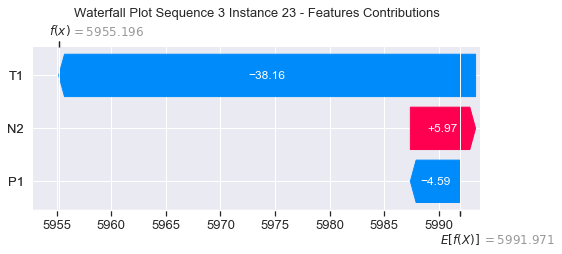

None

Contribution: [ -3.97187916 -48.42852973   8.85497132]


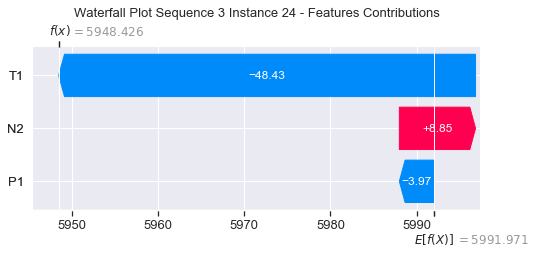

None

Contribution: [  2.67034651 -56.97101019  16.57703038]


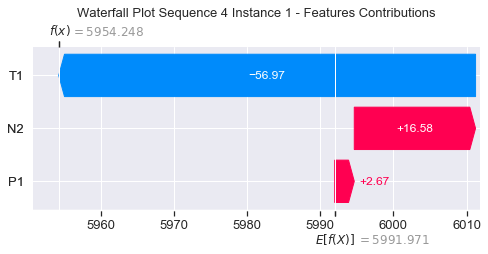

None

Contribution: [0.17997726 0.30746823 0.22227692]


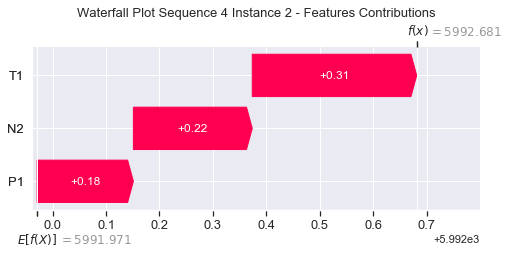

None

Contribution: [ 0.53852771 -4.81677131  1.5508225 ]


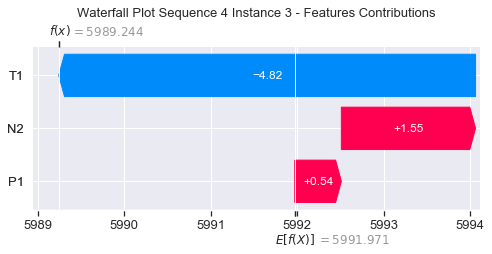

None

Contribution: [ 0.6513542  -0.2604122   0.66541998]


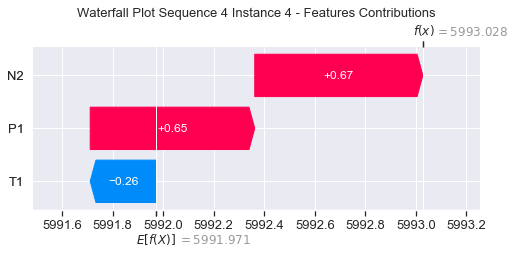

None

Contribution: [0.57262951 1.05683452 0.40420738]


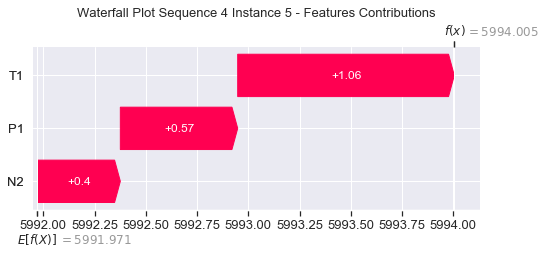

None

Contribution: [0.54500006 1.81815315 0.36905889]


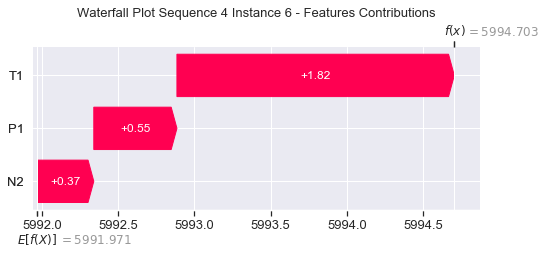

None

Contribution: [0.5574411  2.13053177 0.46403667]


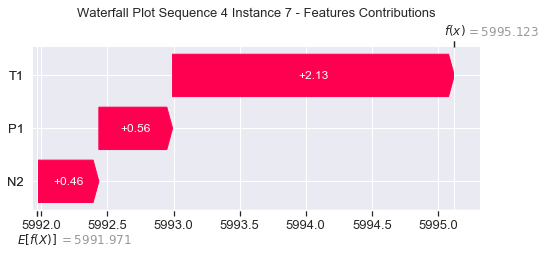

None

Contribution: [0.56804555 2.27028605 0.50073881]


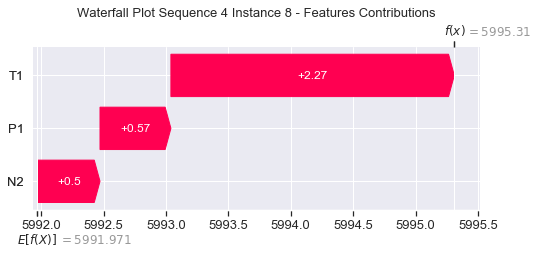

None

Contribution: [0.7059929  2.03666842 0.49833515]


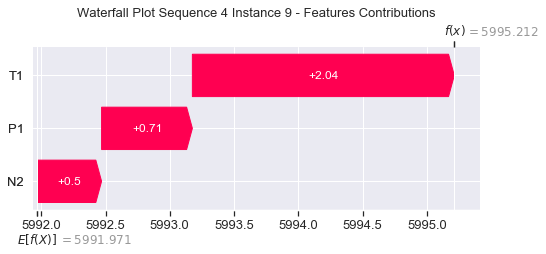

None

Contribution: [0.55248679 2.20076691 0.50160132]


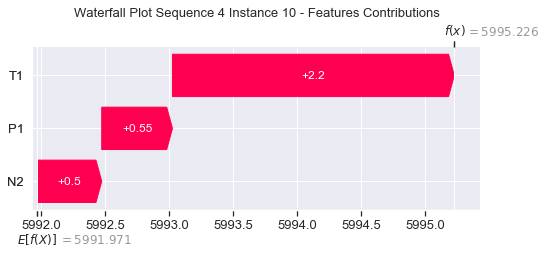

None

Contribution: [0.6938247  1.9484638  0.50989898]


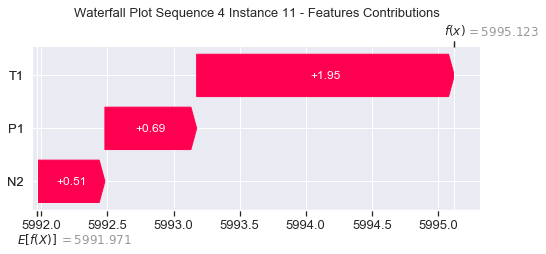

None

Contribution: [0.5880554  2.00790281 0.55471115]


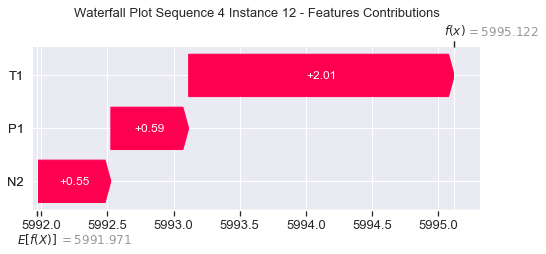

None

Contribution: [0.57583793 1.74403151 0.56499609]


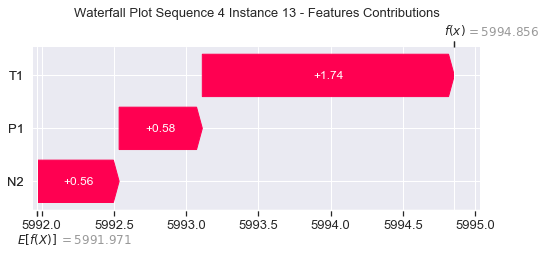

None

Contribution: [0.61115755 1.2797523  0.52619008]


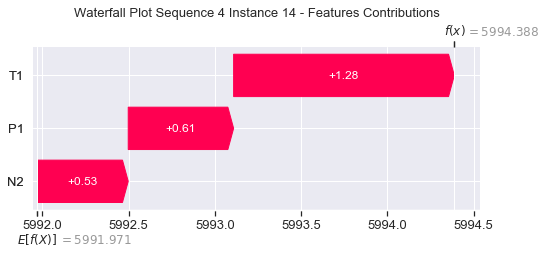

None

Contribution: [0.55486486 1.00403765 0.6165097 ]


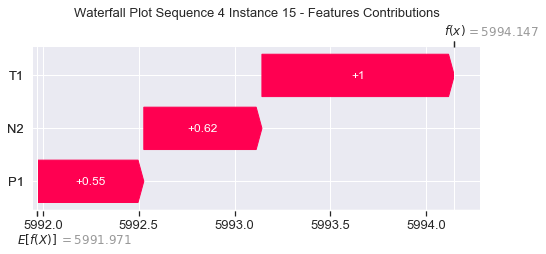

None

Contribution: [0.56171987 0.21746414 0.6575825 ]


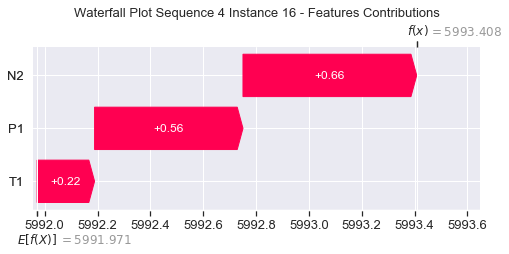

None

Contribution: [ 0.39577786 -0.94131937  0.77014733]


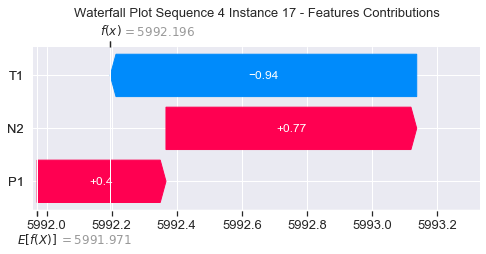

None

Contribution: [ 0.2026668  -2.85107719  0.93191476]


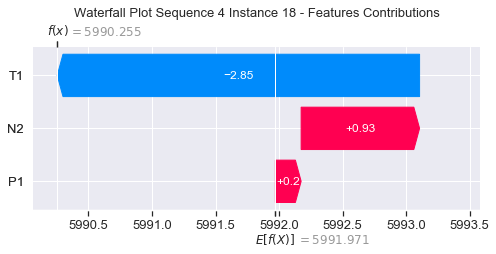

None

Contribution: [-0.15869831 -5.79752382  1.18367109]


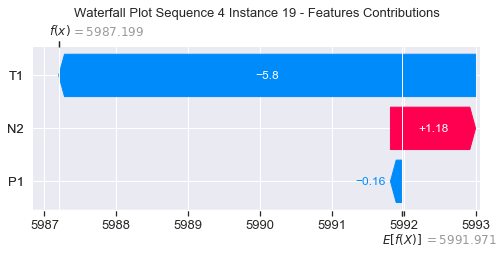

None

Contribution: [ -0.65607399 -10.83150357   1.64775163]


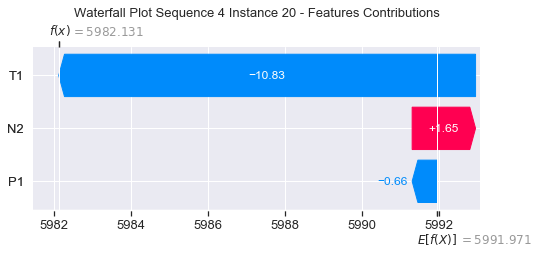

None

Contribution: [ -1.42676017 -18.22277678   2.39942885]


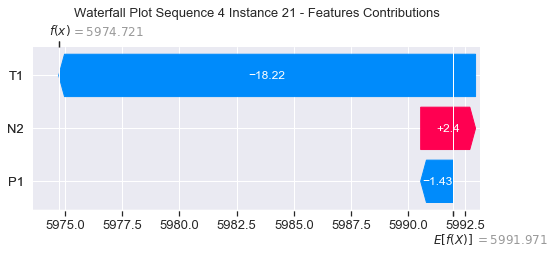

None

Contribution: [ -2.71813008 -28.7186911    3.65542335]


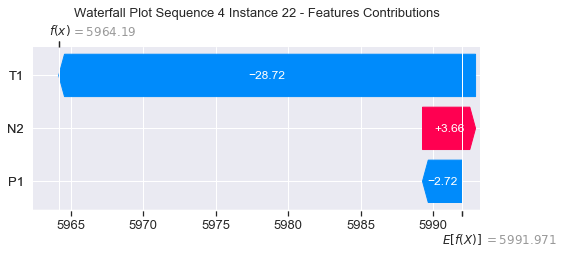

None

Contribution: [ -4.65139083 -41.10249468   6.08017633]


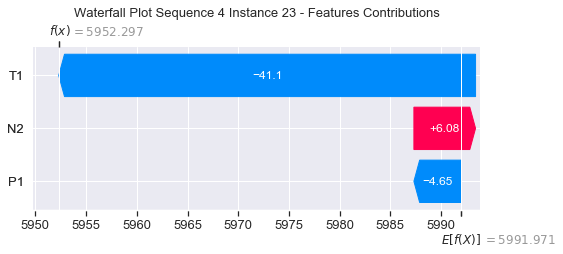

None

Contribution: [ -4.53522605 -51.65855737   9.22796143]


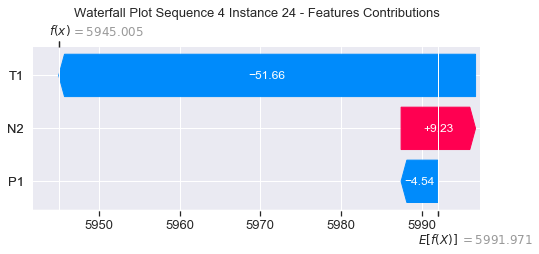

None

Contribution: [  1.35235423 -56.93657208  17.20727102]


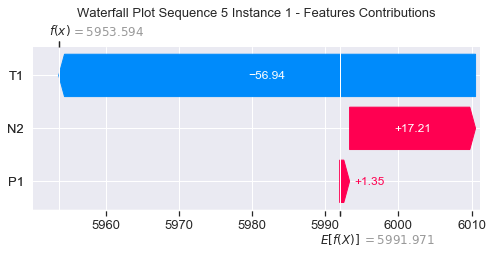

None

Contribution: [0.2016802  0.34679436 0.22732103]


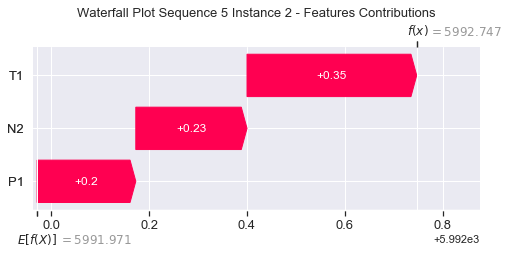

None

Contribution: [ 0.52702869 -4.50288252  1.57291104]


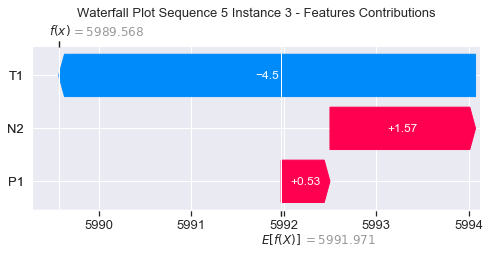

None

Contribution: [ 0.86384397 -0.05118071  0.68313235]


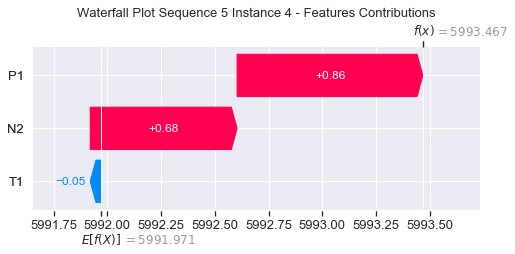

None

Contribution: [0.72771717 1.09811292 0.42219737]


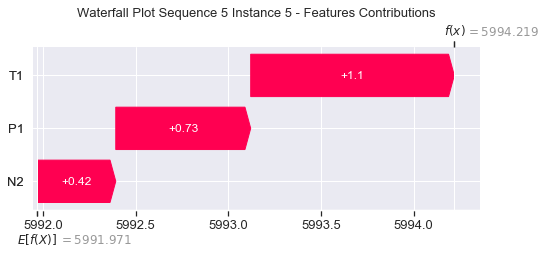

None

Contribution: [0.67487005 1.60101564 0.40238187]


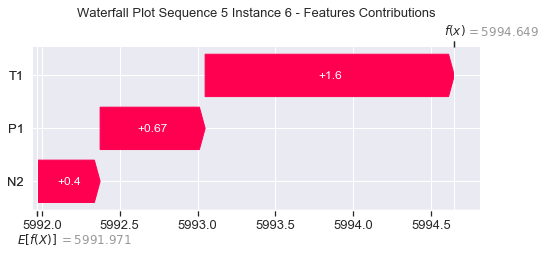

None

Contribution: [0.69181774 1.94407315 0.50315818]


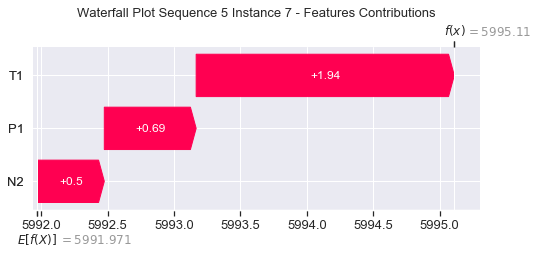

None

Contribution: [0.66145394 2.03691625 0.53384281]


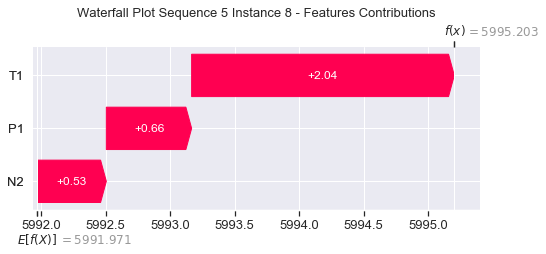

None

Contribution: [0.68786051 1.81874112 0.57026646]


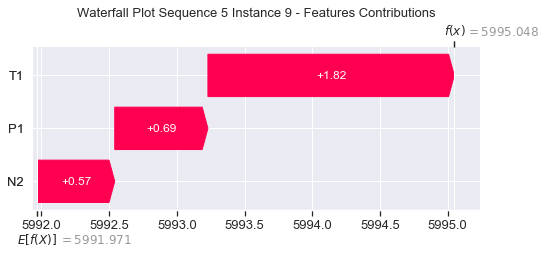

None

Contribution: [0.82205822 1.75108902 0.56302633]


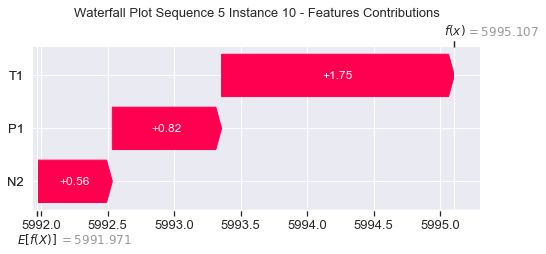

None

Contribution: [0.65717784 1.4657904  0.5515827 ]


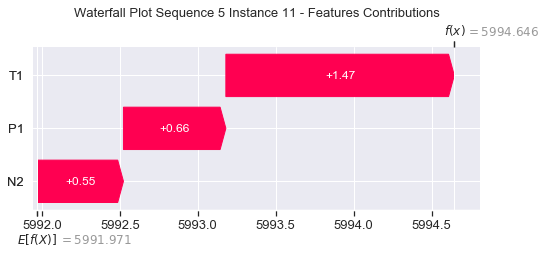

None

Contribution: [0.66661482 1.73362614 0.56194007]


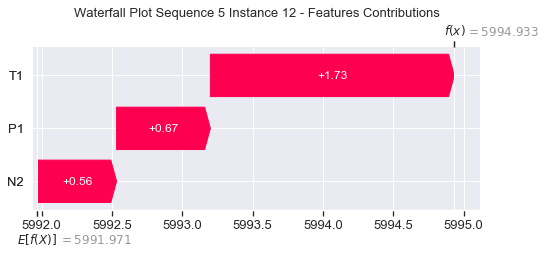

None

Contribution: [0.64950474 1.51283558 0.57469822]


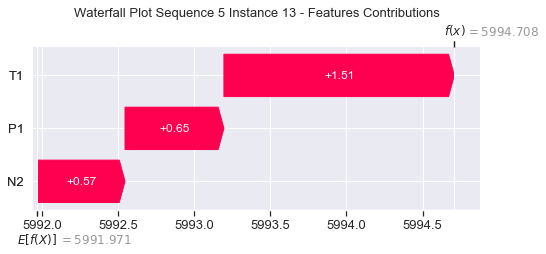

None

Contribution: [0.54263594 1.13549179 0.50800297]


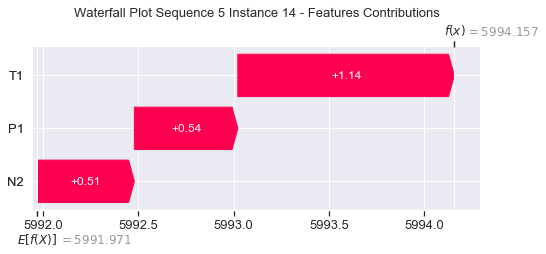

None

Contribution: [0.59318303 0.73710751 0.61582856]


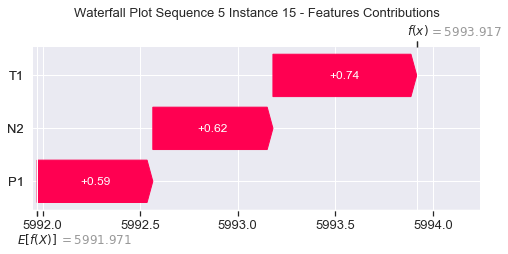

None

Contribution: [0.45496872 0.11917483 0.58179299]


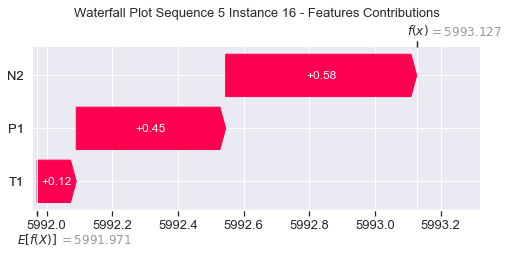

None

Contribution: [ 0.40775388 -1.00678134  0.76623673]


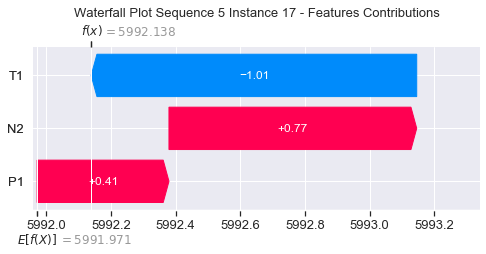

None

Contribution: [ 0.20729692 -2.67465231  0.91999901]


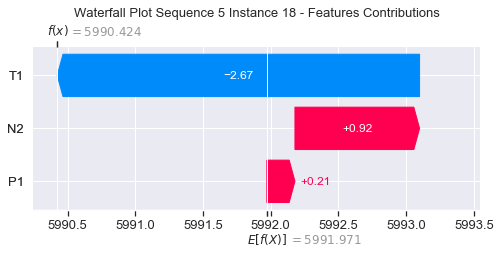

None

Contribution: [-0.22446304 -5.56090421  1.10470083]


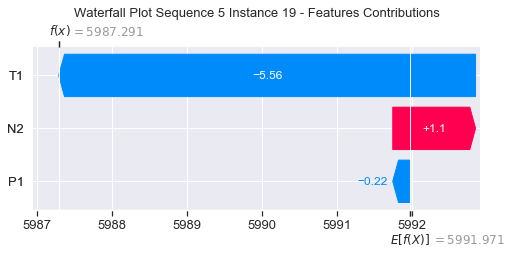

None

Contribution: [-0.59890763 -9.63847093  1.60103354]


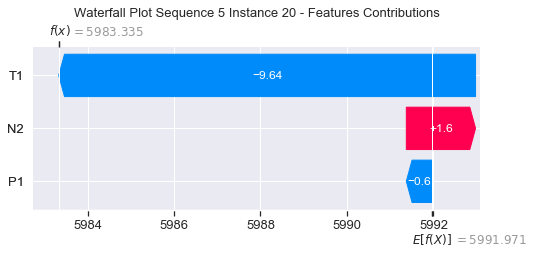

None

Contribution: [ -1.27277437 -16.0620951    2.35873957]


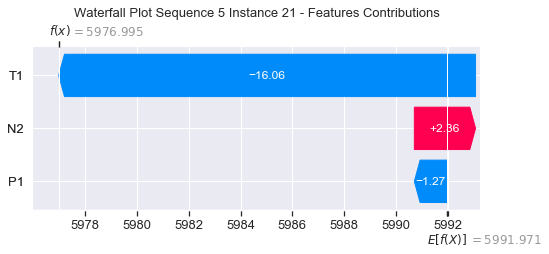

None

Contribution: [ -2.39262685 -24.97277135   3.67181759]


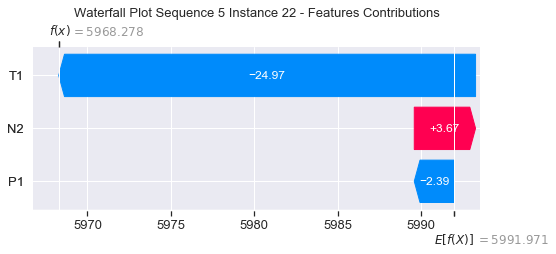

None

Contribution: [ -4.01332505 -34.99827179   6.09079682]


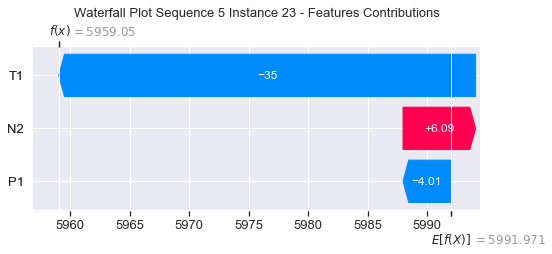

None

Contribution: [ -3.1576265  -44.41579944   9.2454765 ]


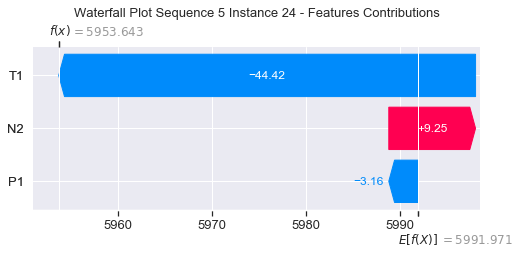

None

Contribution: [  2.90619415 -66.61240888  16.38869234]


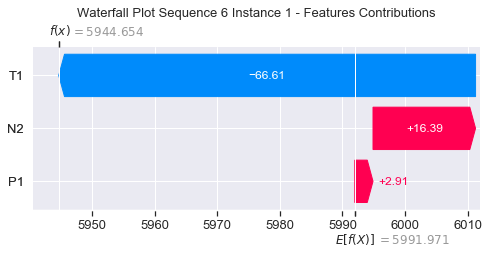

None

Contribution: [0.18851507 0.04342938 0.21212239]


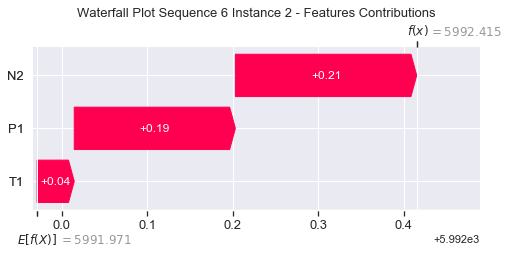

None

Contribution: [ 0.47681266 -7.31969265  1.46666903]


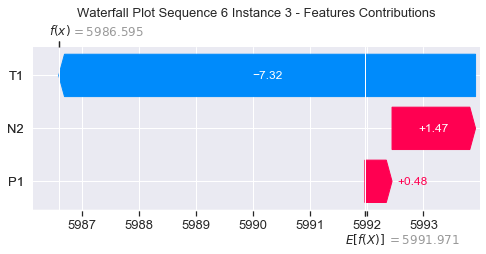

None

Contribution: [ 0.75698657 -2.25233329  0.5938731 ]


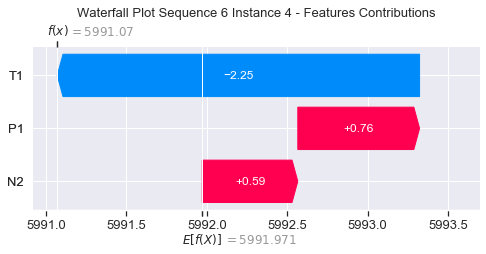

None

Contribution: [ 0.61485041 -0.78218749  0.33963782]


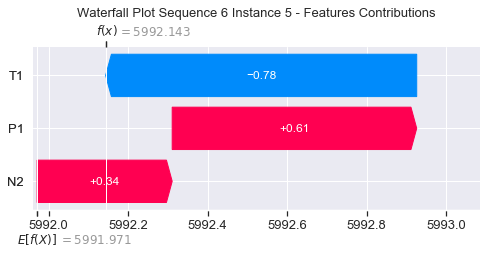

None

Contribution: [0.58463364 0.38977639 0.31846767]


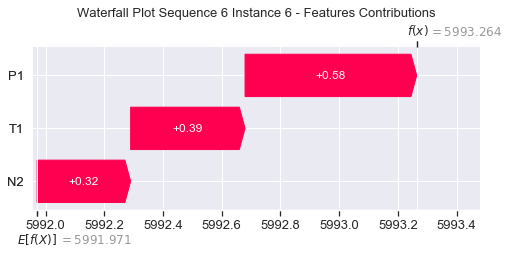

None

Contribution: [0.59032323 0.89587705 0.41687116]


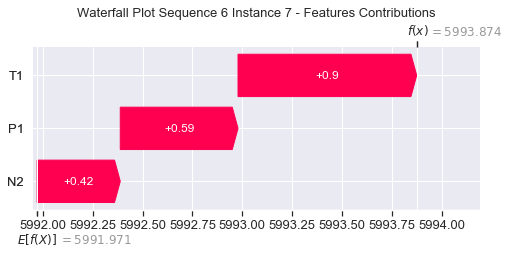

None

Contribution: [0.5832061  1.16016442 0.44680704]


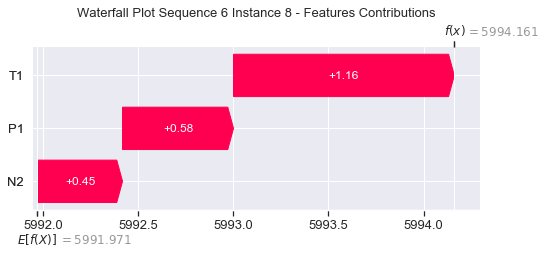

None

Contribution: [0.59473568 1.27095431 0.49196787]


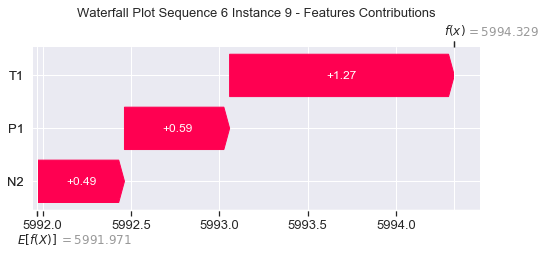

None

Contribution: [0.68973306 1.08033529 0.47958239]


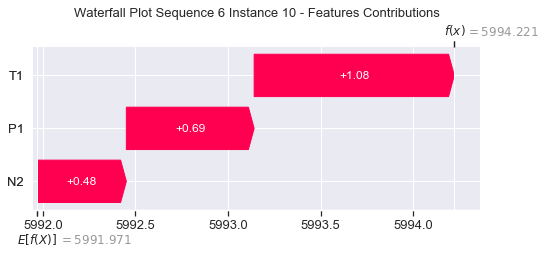

None

Contribution: [0.59991935 1.1880166  0.49693762]


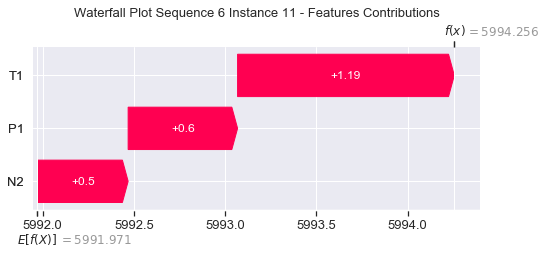

None

Contribution: [0.60249995 1.30920285 0.57886826]


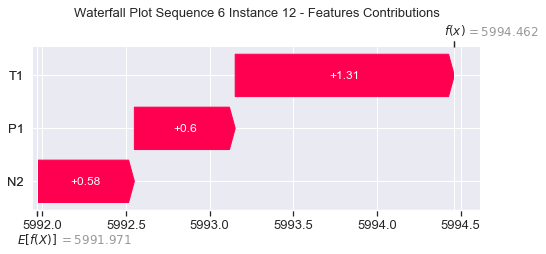

None

Contribution: [0.5904942  1.09078116 0.58161223]


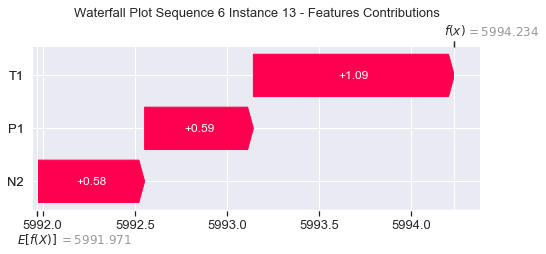

None

Contribution: [0.56981186 0.58809232 0.60452119]


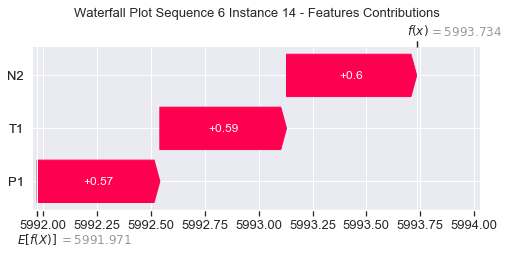

None

Contribution: [0.54926781 0.38914702 0.618045  ]


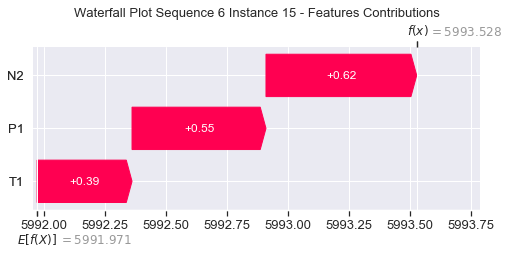

None

Contribution: [ 0.48344478 -0.18064873  0.67428189]


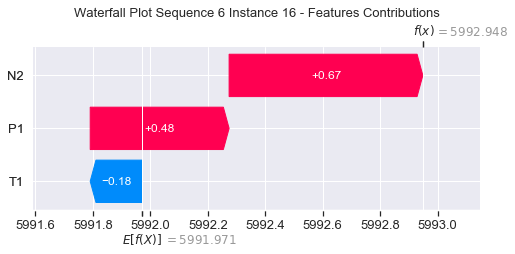

None

Contribution: [ 0.37234371 -1.56643047  0.76023065]


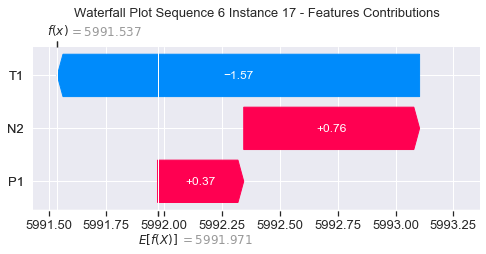

None

Contribution: [ 0.15407305 -3.68768122  0.91227351]


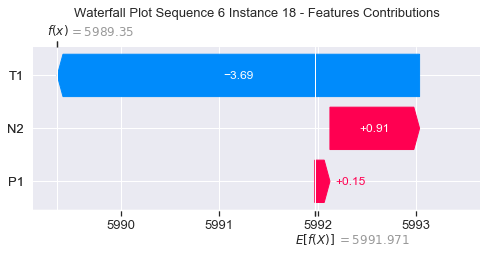

None

Contribution: [-0.30430268 -7.37064635  1.25144746]


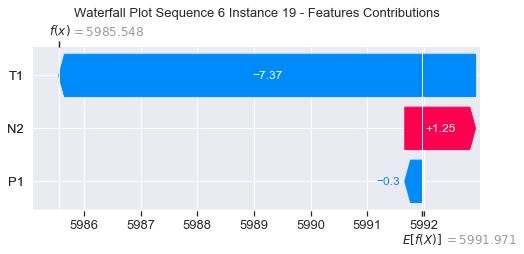

None

Contribution: [ -0.81032626 -12.89228866   1.69674003]


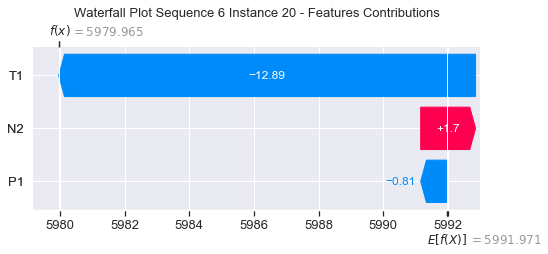

None

Contribution: [ -1.66145214 -21.55842478   2.4551049 ]


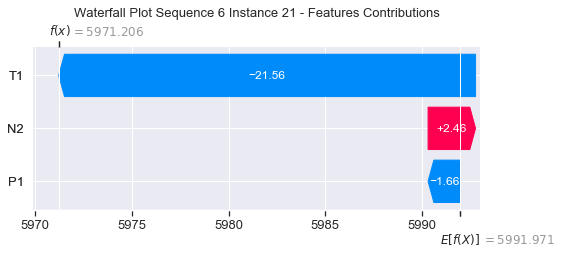

None

Contribution: [ -3.08629649 -33.72568092   3.80608779]


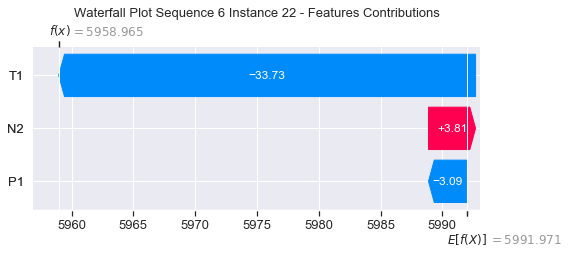

None

Contribution: [ -5.22431247 -49.09317942   6.28288132]


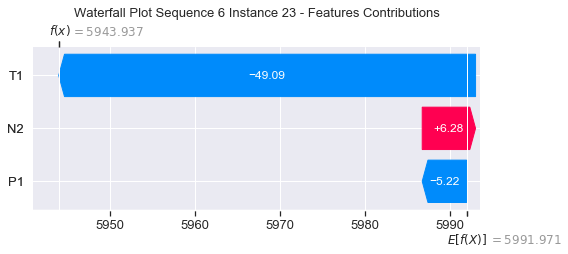

None

Contribution: [ -4.93418124 -61.10364344   9.80698655]


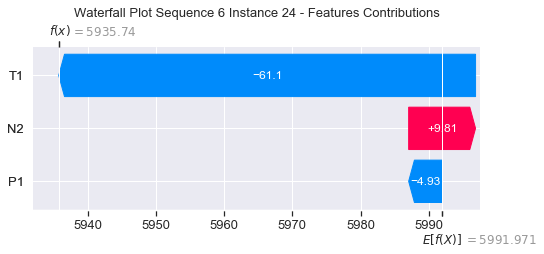

None

Contribution: [  1.15471167 -44.81953973  18.55100554]


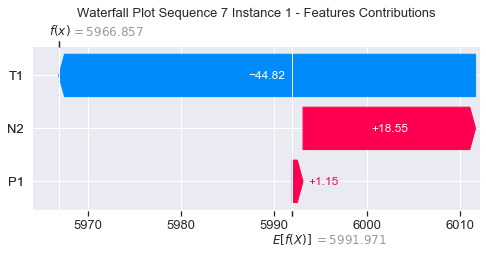

None

Contribution: [0.21106577 0.83845947 0.27860867]


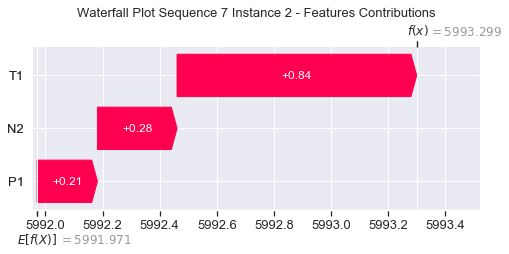

None

Contribution: [ 0.45760787 -0.80005166  1.77725646]


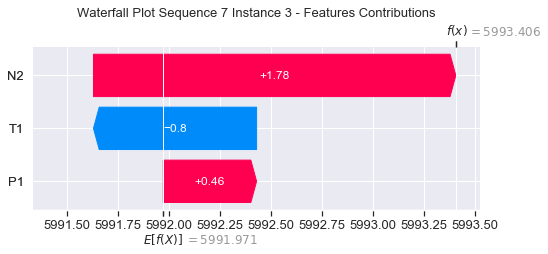

None

Contribution: [0.67105499 3.56053117 0.73157484]


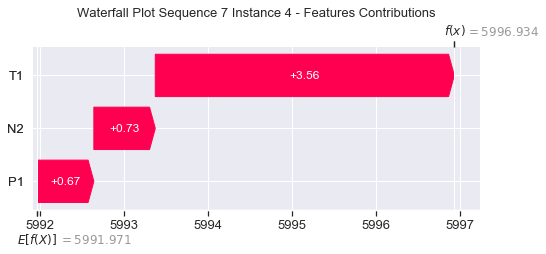

None

Contribution: [0.53978993 3.6775615  0.46016203]


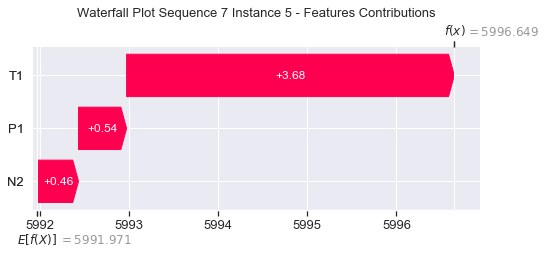

None

Contribution: [0.60312766 4.10790983 0.48599808]


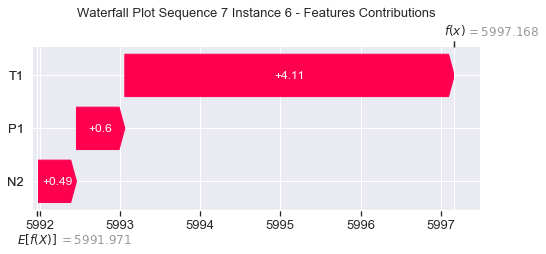

None

Contribution: [0.65360473 4.1778487  0.57247166]


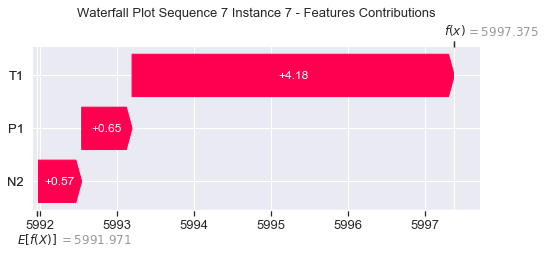

None

Contribution: [0.6225986  4.16902462 0.59666802]


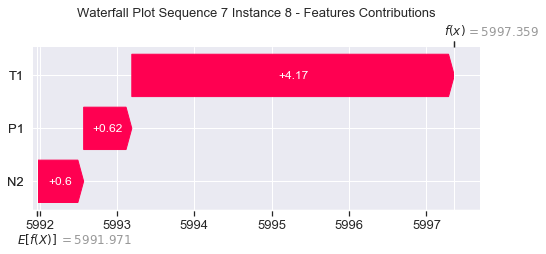

None

Contribution: [0.70999801 3.71024951 0.63859189]


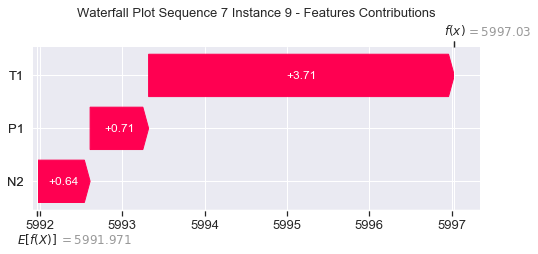

None

Contribution: [0.64497814 3.43619808 0.57923465]


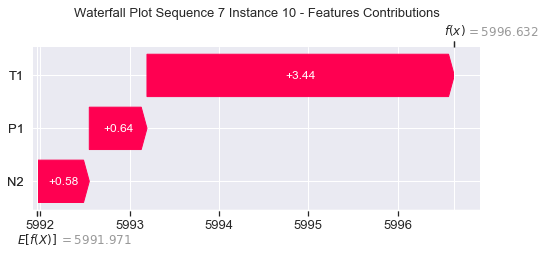

None

Contribution: [0.63495056 3.67873504 0.65264567]


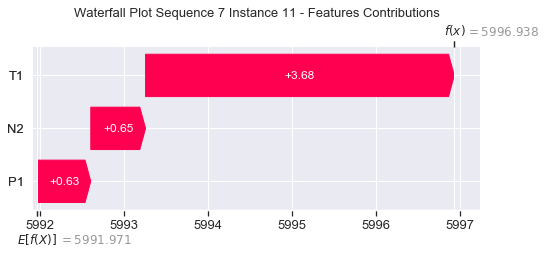

None

Contribution: [0.671819   3.8030581  0.62396644]


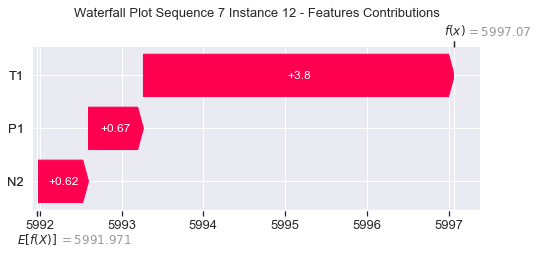

None

Contribution: [0.66750518 3.51983864 0.62379741]


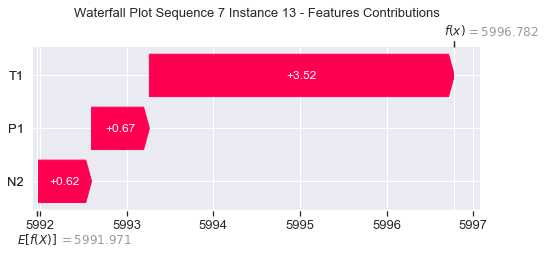

None

Contribution: [0.67621924 2.83811703 0.61698196]


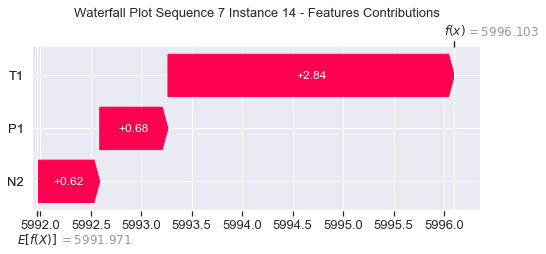

None

Contribution: [0.6423636  2.79344248 0.64910089]


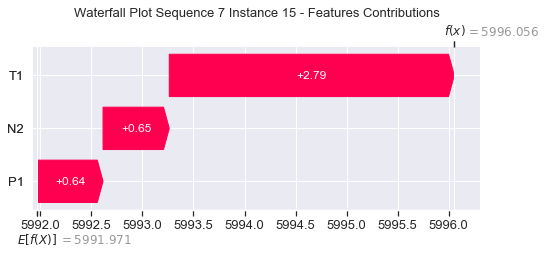

None

Contribution: [0.48076038 2.0094161  0.61476634]


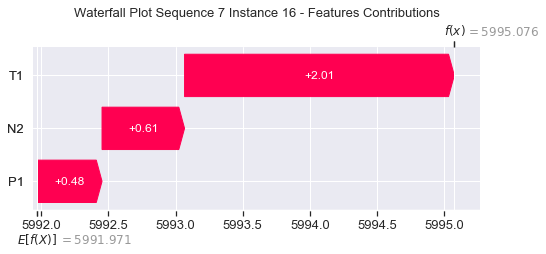

None

Contribution: [0.42132751 0.45736375 0.75270131]


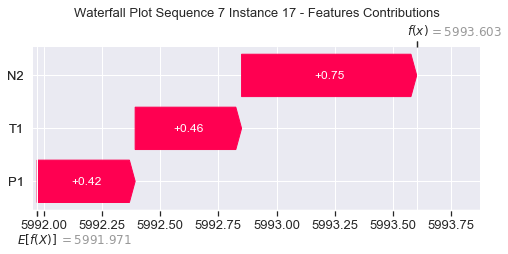

None

Contribution: [ 0.14275219 -1.90184001  0.88447041]


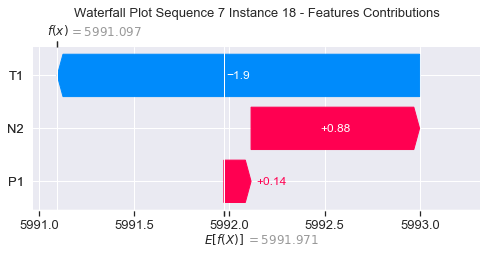

None

Contribution: [-0.18467309 -5.89509753  1.21177064]


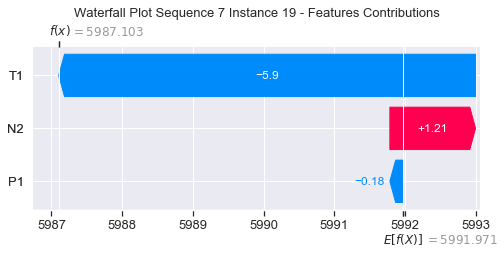

None

Contribution: [ -0.96989594 -11.45339184   1.58966422]


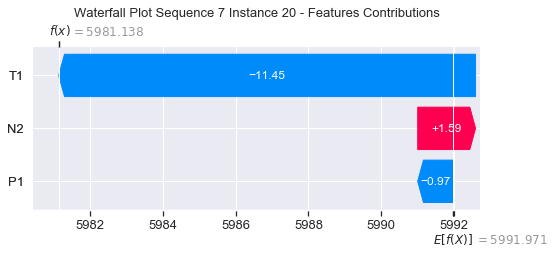

None

Contribution: [ -1.88908182 -20.04609269   2.36547742]


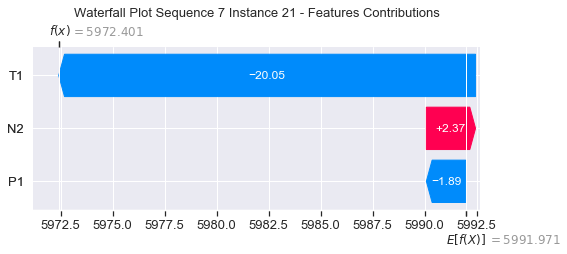

None

Contribution: [ -3.22196987 -32.20201408   3.72181231]


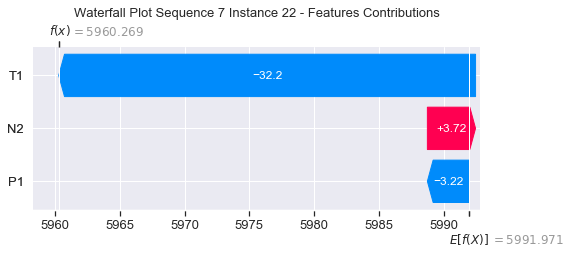

None

Contribution: [ -5.48173814 -46.80466331   6.07245339]


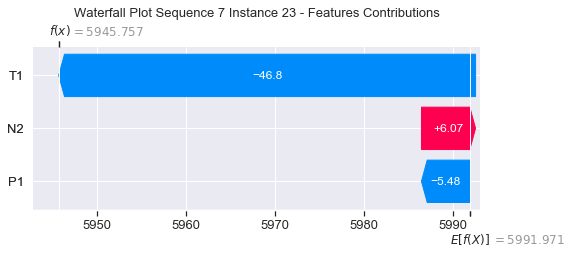

None

Contribution: [ -5.07843628 -60.03889703   9.30556585]


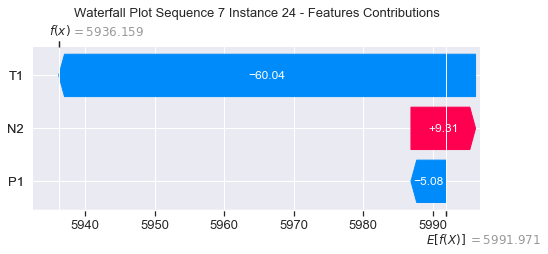

None

Contribution: [  0.51623383 -53.31167575  17.96118214]


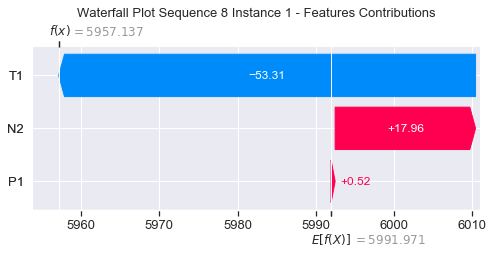

None

Contribution: [0.19957872 0.63902998 0.24504748]


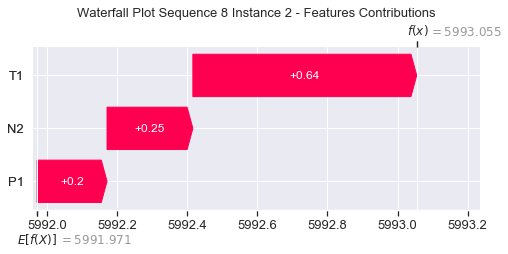

None

Contribution: [ 0.39290116 -2.01904564  1.66888201]


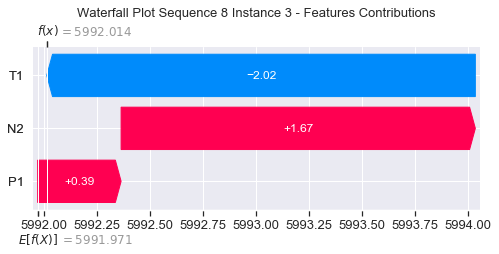

None

Contribution: [0.77447438 2.70821001 0.68930249]


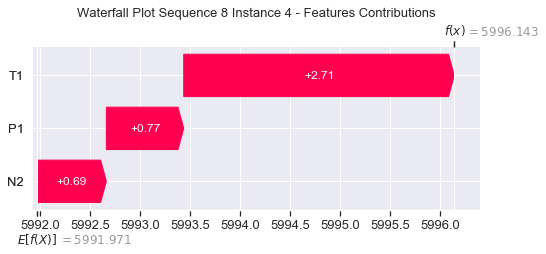

None

Contribution: [1.03902595 3.16002662 0.61434808]


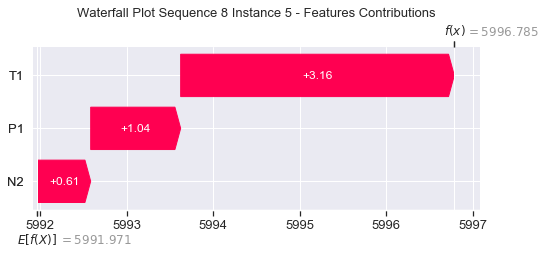

None

Contribution: [0.67648917 3.04440536 0.48217215]


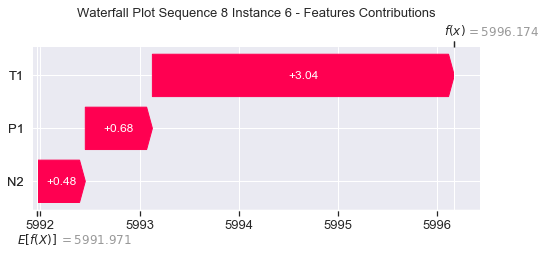

None

Contribution: [0.70891749 3.21633389 0.55983579]


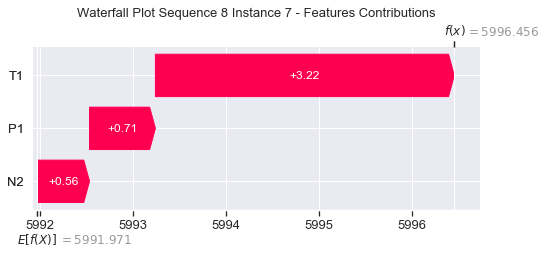

None

Contribution: [0.68981285 3.13582001 0.5784052 ]


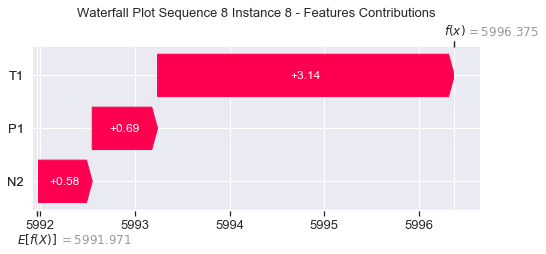

None

Contribution: [0.86849334 3.24276917 0.49528762]


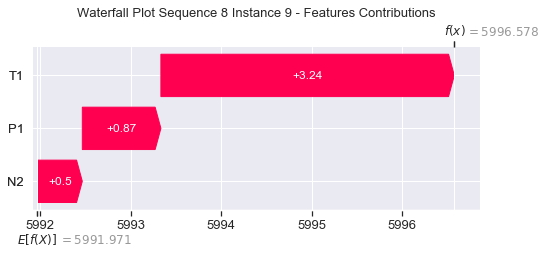

None

Contribution: [1.24260455 3.33918086 0.51725173]


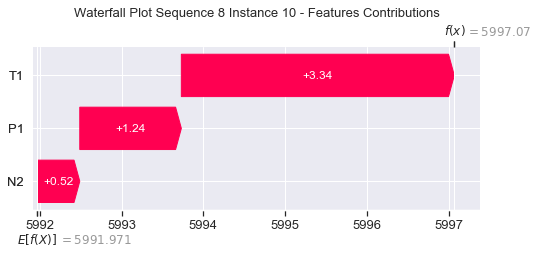

None

Contribution: [0.58699265 2.28524645 0.43781799]


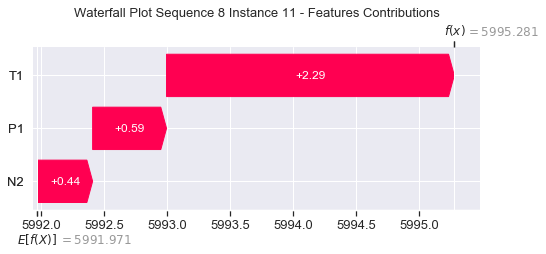

None

Contribution: [0.49159517 1.99727812 0.50626981]


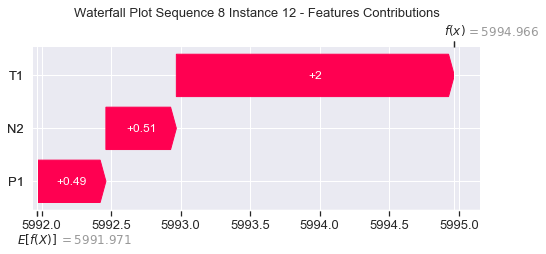

None

Contribution: [0.54818024 1.87348384 0.51578785]


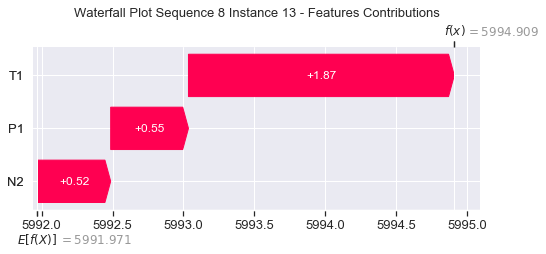

None

Contribution: [0.50925052 1.56358813 0.47121675]


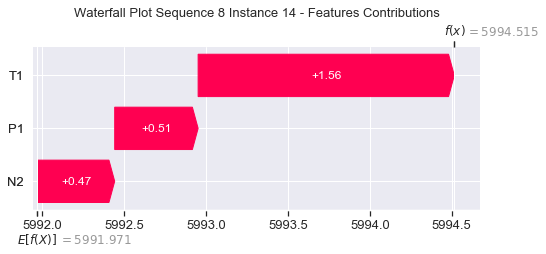

None

Contribution: [0.47067752 1.13927966 0.51694208]


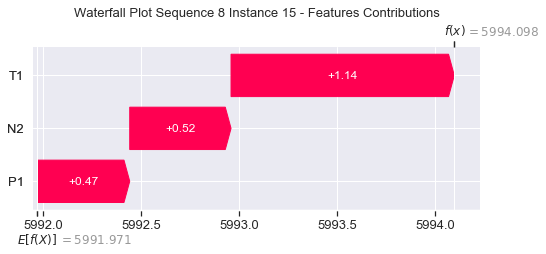

None

Contribution: [0.46503059 0.58478783 0.5160324 ]


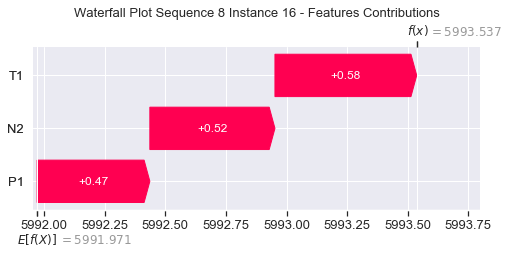

None

Contribution: [ 0.35068866 -0.57787586  0.6692152 ]


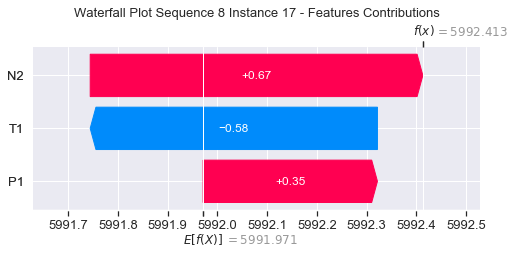

None

Contribution: [ 0.23492171 -2.07269823  0.87665654]


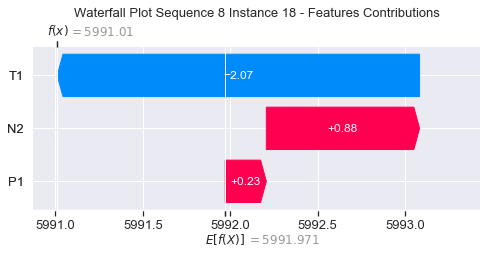

None

Contribution: [-0.06164593 -4.82775692  1.23731978]


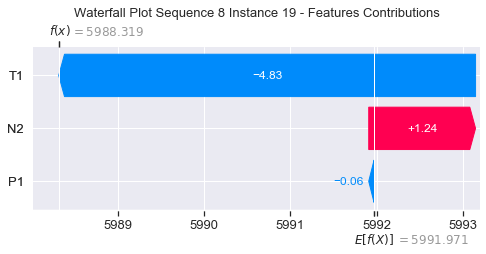

None

Contribution: [-0.43180843 -8.3730984   1.75579562]


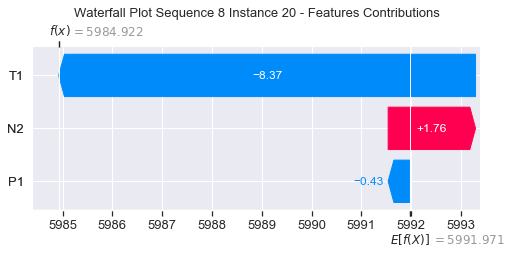

None

Contribution: [ -0.93519807 -13.59023018   2.66487156]


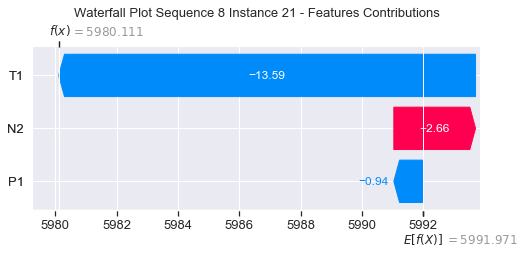

None

Contribution: [ -1.78246197 -20.67901136   4.11384187]


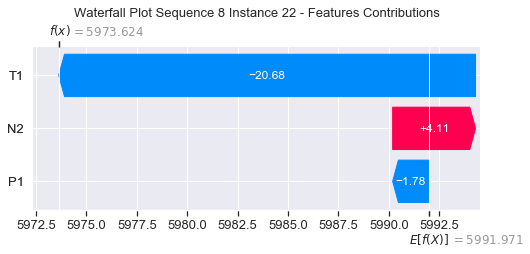

None

Contribution: [ -2.03532218 -27.00108988   7.1310026 ]


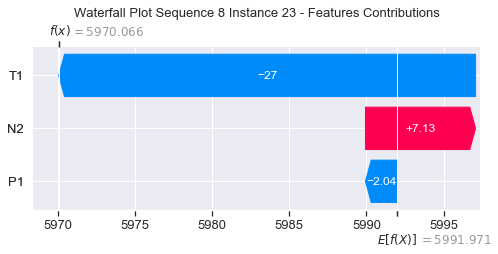

None

Contribution: [ -2.08735928 -37.18797453   9.86575398]


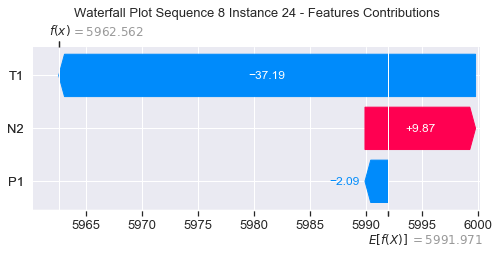

None

Contribution: [  0.4959221  -88.51608523  16.15655321]


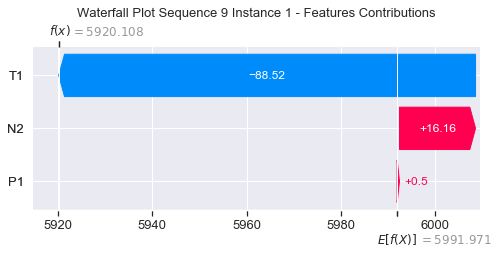

None

Contribution: [ 0.15357895 -0.46400934  0.23242473]


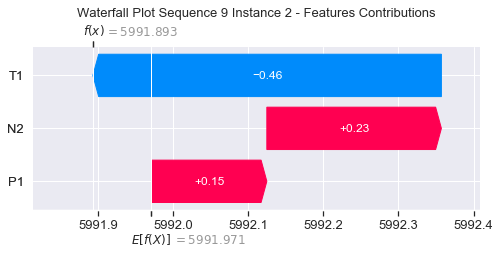

None

Contribution: [  0.10745862 -12.58403543   1.53745   ]


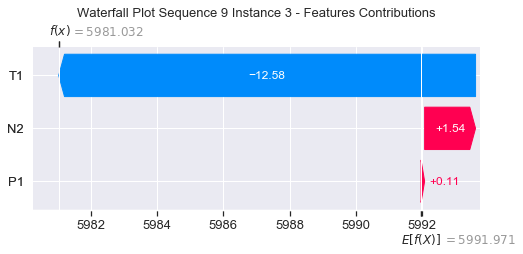

None

Contribution: [ 0.47399371 -5.85102224  0.7007494 ]


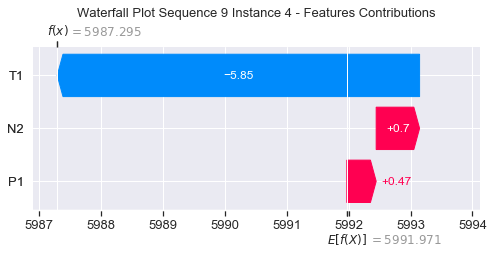

None

Contribution: [ 0.40320314 -3.26226407  0.37684401]


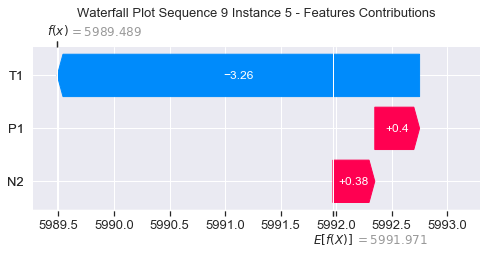

None

Contribution: [ 0.414192   -1.97034421  0.27832507]


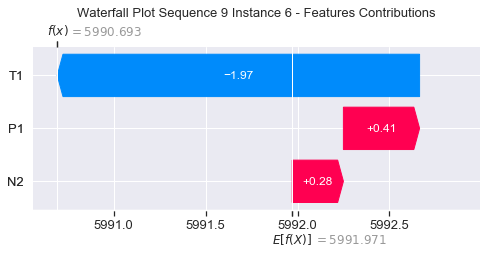

None

Contribution: [ 0.39981062 -1.5015479   0.28264208]


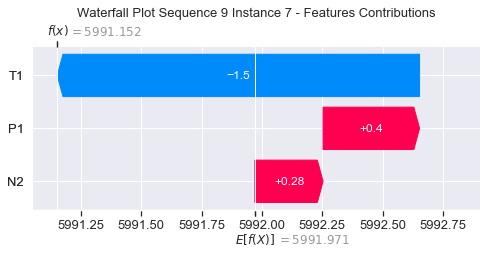

None

Contribution: [ 0.35874358 -1.28723815  0.29118092]


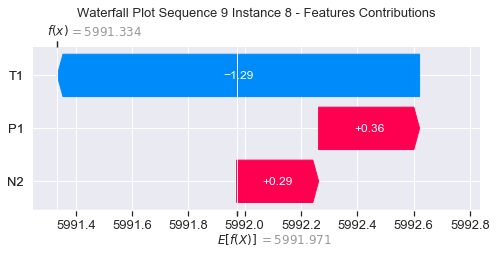

None

Contribution: [ 0.25692818 -1.33257173  0.31168742]


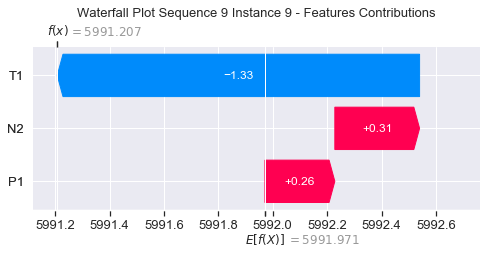

None

Contribution: [ 0.30580062 -1.27849903  0.29910125]


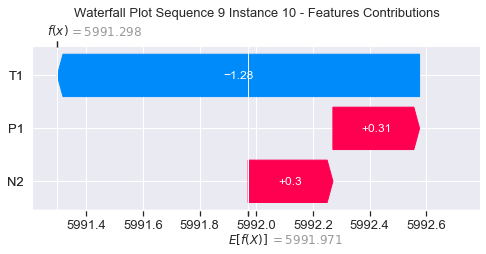

None

Contribution: [ 0.25645121 -1.34474106  0.30206931]


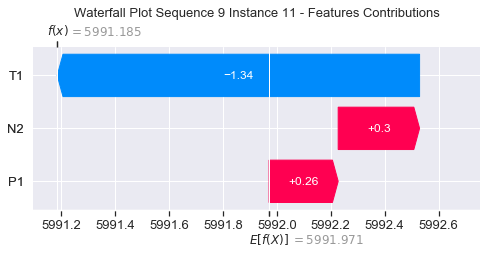

None

Contribution: [ 0.34177009 -1.23615979  0.29754324]


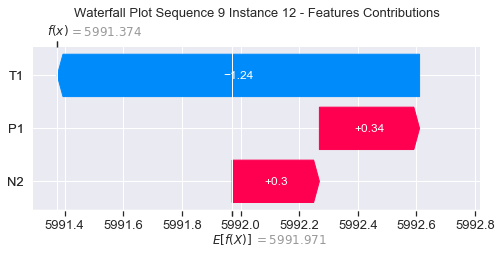

None

Contribution: [ 0.32932963 -1.38221283  0.30728031]


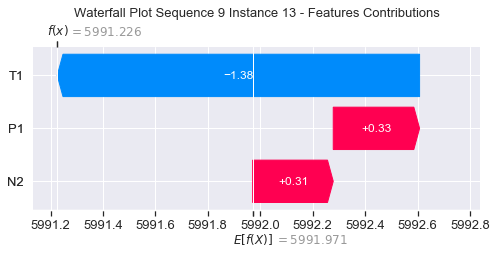

None

Contribution: [ 0.26403439 -1.57275278  0.29452675]


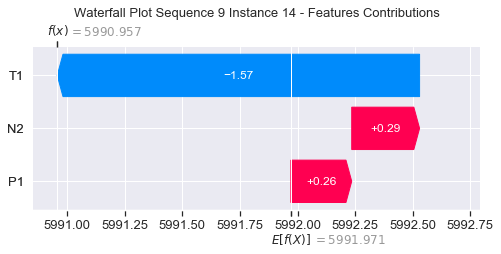

None

Contribution: [ 0.28283585 -1.92545725  0.36918117]


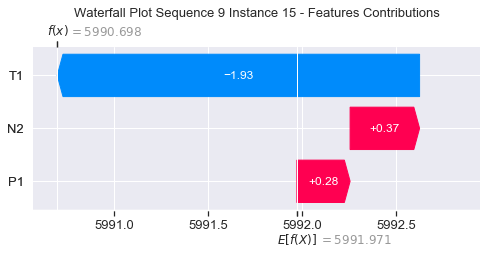

None

Contribution: [ 0.20031444 -2.35460334  0.45391361]


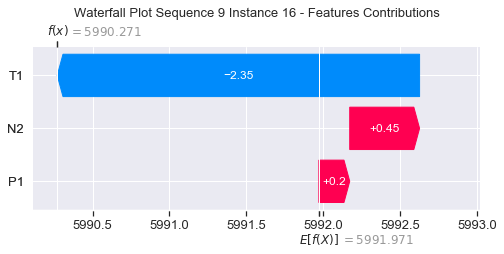

None

Contribution: [ 0.19379931 -3.27162895  0.57195805]


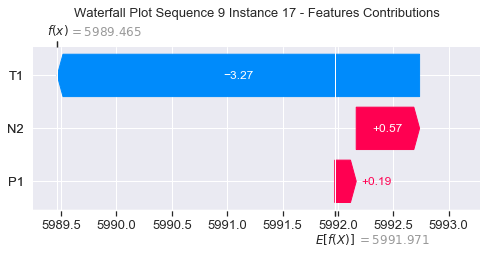

None

Contribution: [ 0.09103697 -4.66909107  0.77531724]


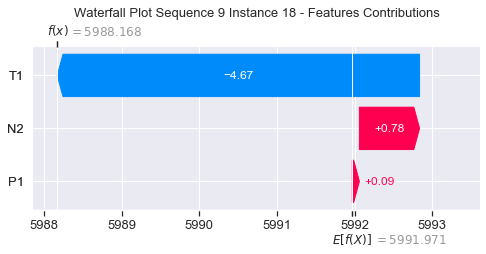

None

Contribution: [-0.27017294 -6.67934365  1.1895092 ]


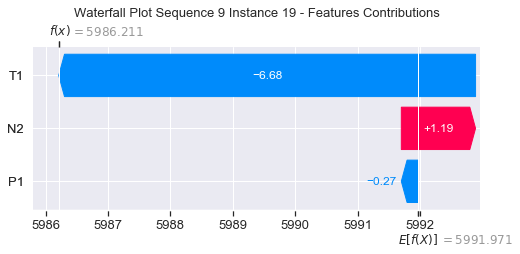

None

Contribution: [ -0.22791185 -10.6635848    1.6717117 ]


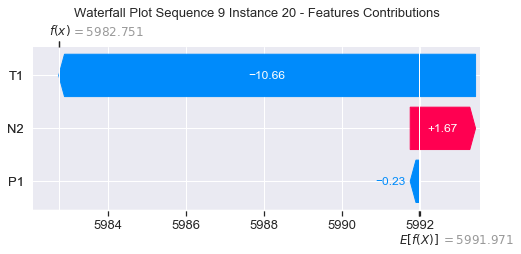

None

Contribution: [ -0.42226745 -16.55863991   2.60709143]


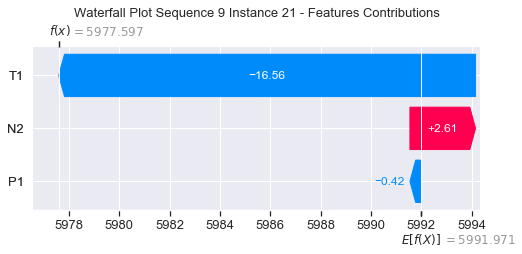

None

Contribution: [ -0.87628509 -25.04180288   4.1783236 ]


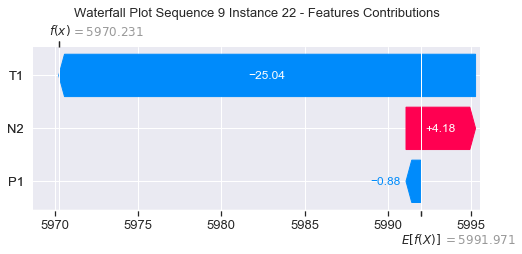

None

Contribution: [ -1.89509248 -35.78893117   6.87288042]


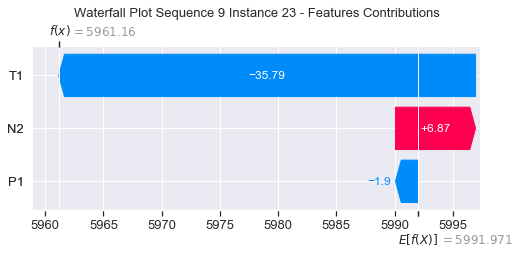

None

Contribution: [ -0.44635677 -45.45233213  10.12571737]


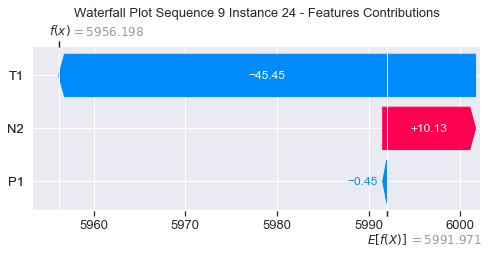

None

Contribution: [  4.39115722 -90.74481727  16.21839081]


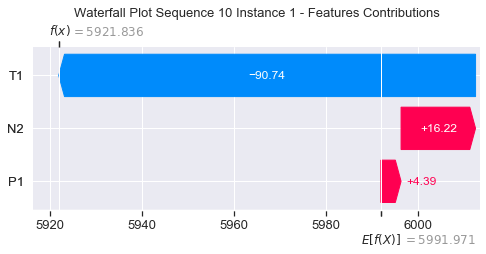

None

Contribution: [ 0.11430023 -0.30124082  0.19920919]


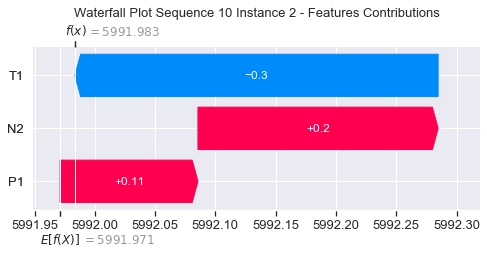

None

Contribution: [  0.31418571 -11.3424339    1.45991301]


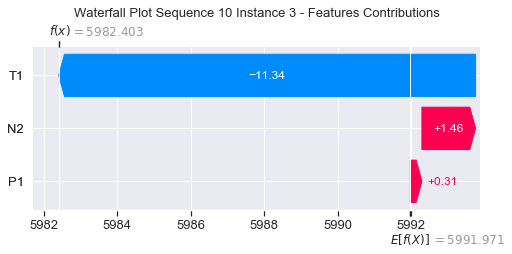

None

Contribution: [ 0.48577651 -5.02624687  0.60539742]


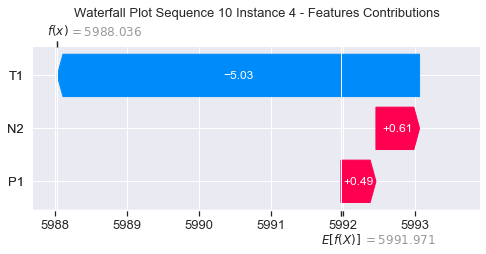

None

Contribution: [ 0.31512911 -3.11482131  0.33323499]


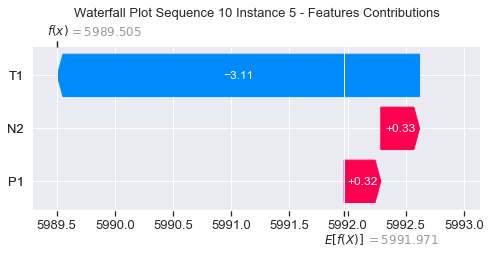

None

Contribution: [ 0.17974949 -1.23287319  0.20554058]


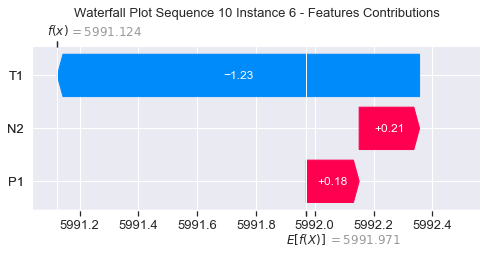

None

Contribution: [ 0.23169556 -0.52638093  0.25573559]


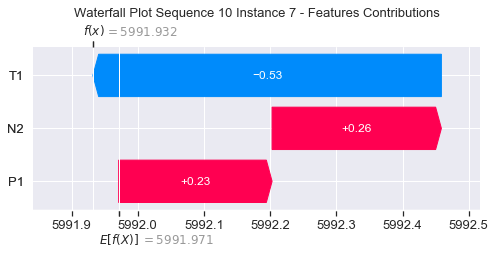

None

Contribution: [ 0.14356505 -0.54173293  0.27767994]


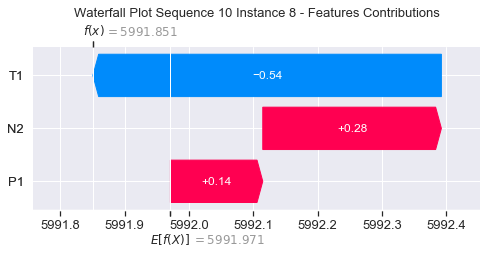

None

Contribution: [-0.05403503 -0.97607525  0.32716947]


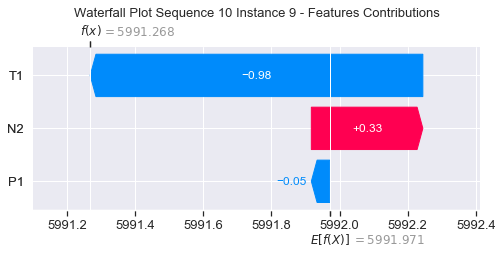

None

Contribution: [-0.00771145 -1.13141972  0.30786248]


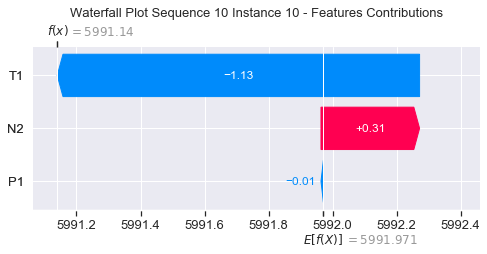

None

Contribution: [-0.29671747 -1.4502593   0.23965878]


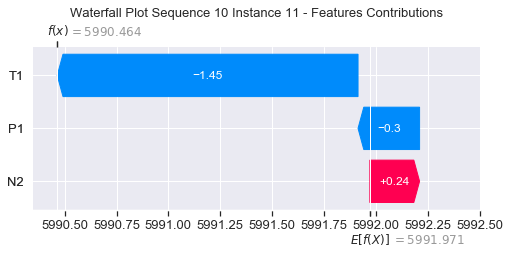

None

Contribution: [ 0.14199375 -0.46651976  0.27052786]


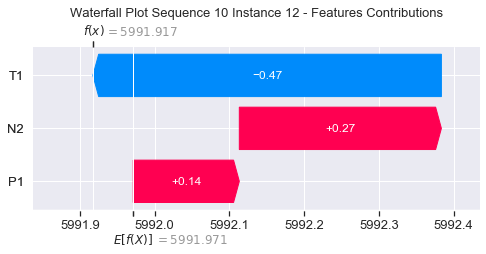

None

Contribution: [ 0.18324645 -0.57085593  0.30979205]


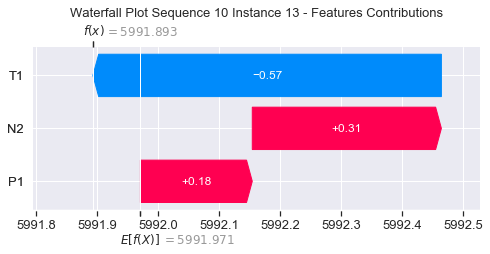

None

Contribution: [ 0.14592659 -1.29083361  0.34495262]


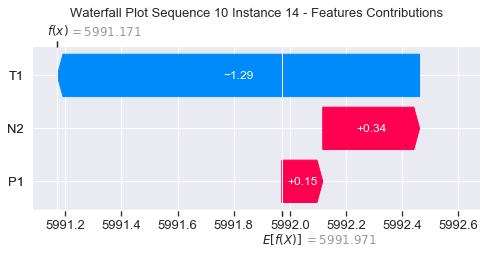

None

Contribution: [ 0.18590415 -1.11780753  0.39910263]


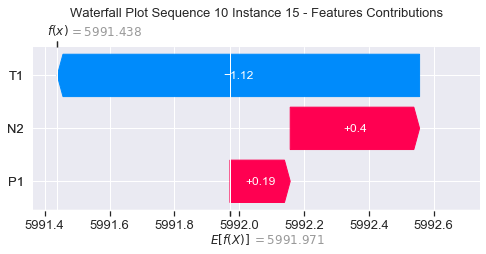

None

Contribution: [ 0.29031059 -1.19737767  0.51441827]


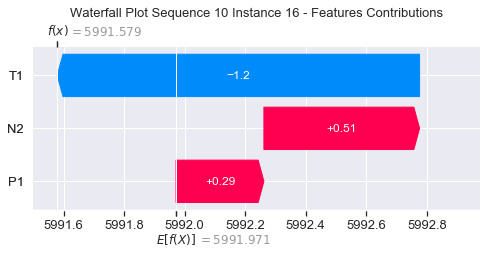

None

Contribution: [ 0.27504447 -3.03615297  0.657554  ]


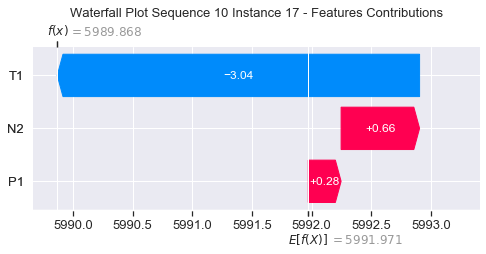

None

Contribution: [ 0.34579249 -5.22721121  0.88798801]


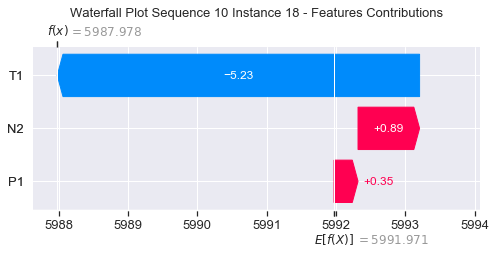

None

Contribution: [  0.09282487 -11.10042161   1.42858921]


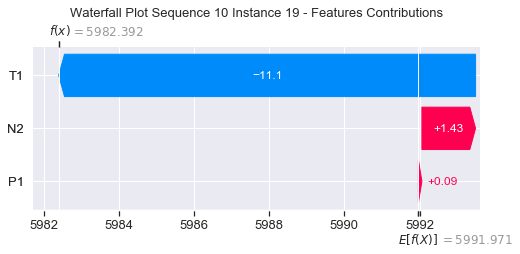

None

Contribution: [  0.48689593 -14.63704956   1.72448985]


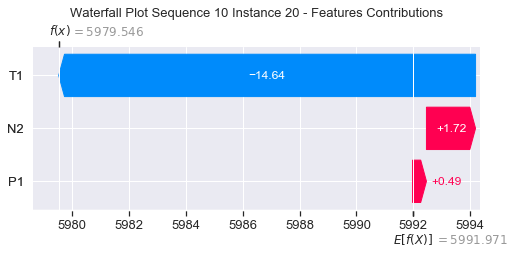

None

Contribution: [  0.83235665 -22.37749104   2.61986576]


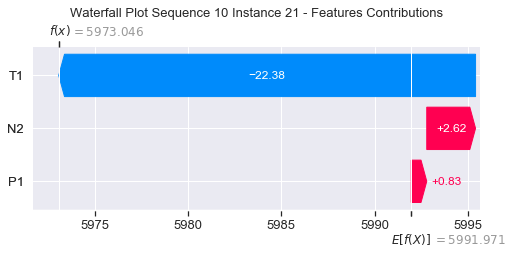

None

Contribution: [  1.43036174 -32.31974401   4.18316772]


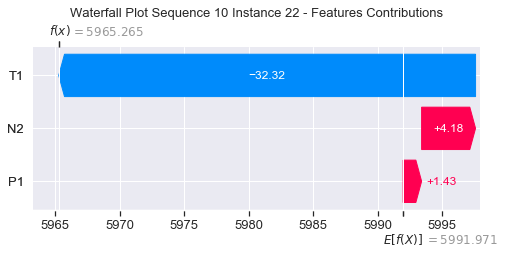

None

Contribution: [  1.99696356 -48.3531232    7.07363093]


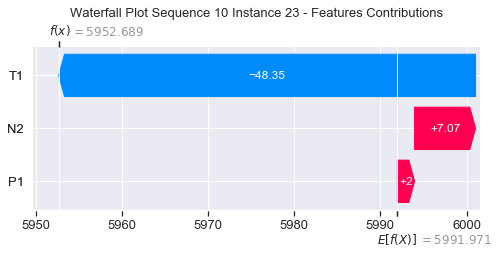

None

Contribution: [  3.16871679 -56.32983086   9.80152988]


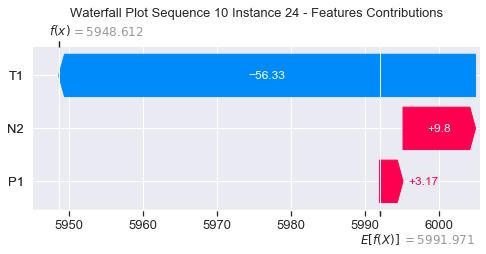

None

Contribution: [   3.14964085 -104.31504624   15.49668977]


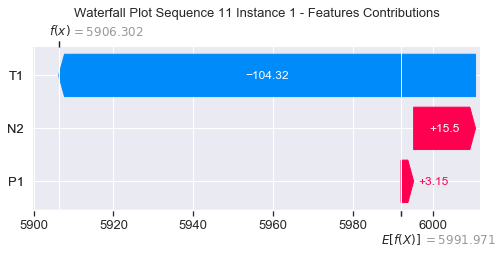

None

Contribution: [ 0.07569543 -0.44693153  0.26783706]


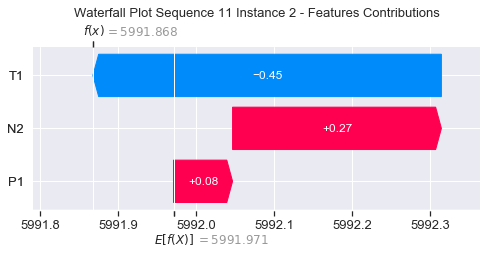

None

Contribution: [  0.6189511  -12.64140733   1.77806931]


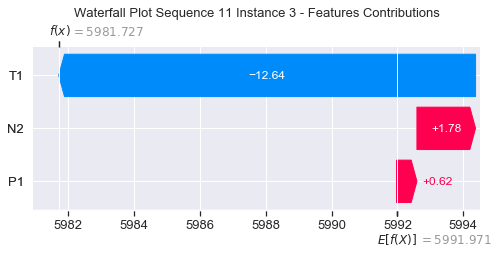

None

Contribution: [ 0.4495945  -5.49098517  0.78588388]


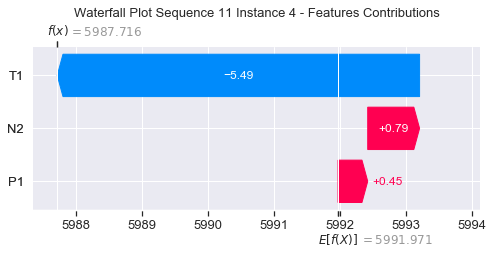

None

Contribution: [ 0.21469234 -3.19229626  0.39326746]


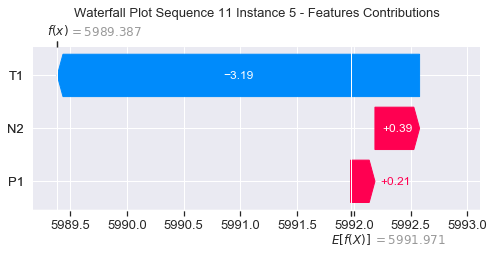

None

Contribution: [ 0.08970171 -2.14779835  0.22729006]


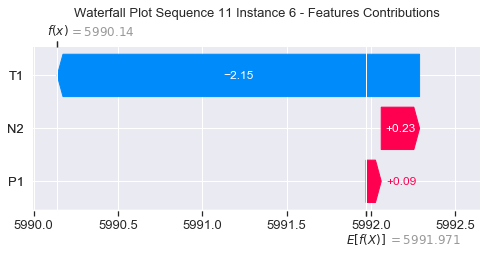

None

Contribution: [ 0.08053137 -1.76756847  0.19625113]


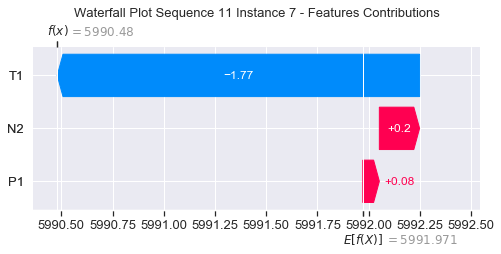

None

Contribution: [ 0.06522101 -1.57698187  0.19541433]


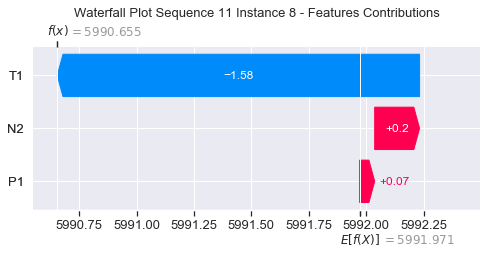

None

Contribution: [ 0.0930529  -1.52713497  0.22177104]


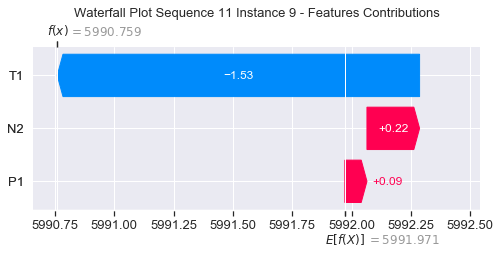

None

Contribution: [ 0.10248276 -1.45523568  0.21469421]


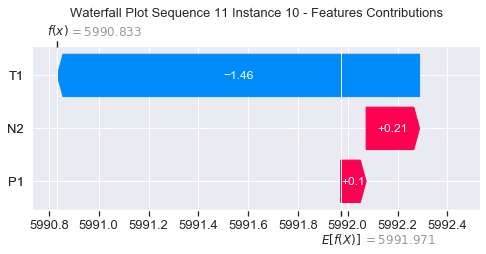

None

Contribution: [ 0.0225653  -1.5100055   0.20493114]


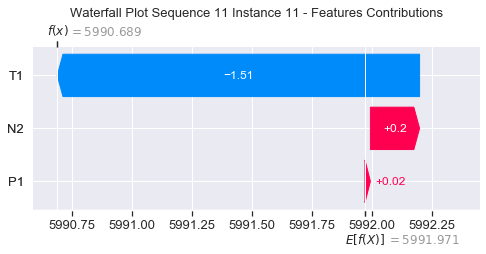

None

Contribution: [ 0.06476279 -1.56254902  0.19693066]


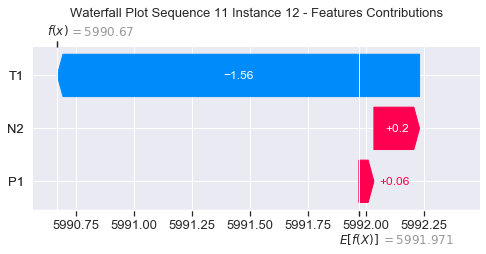

None

Contribution: [ 0.0856582  -1.66724704  0.21198424]


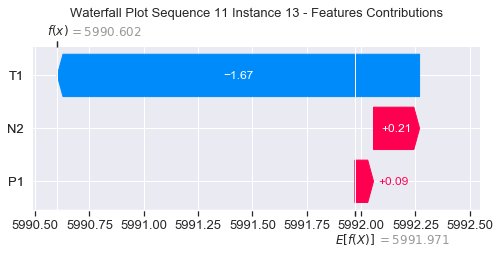

None

Contribution: [ 0.09935261 -1.85389682  0.2338627 ]


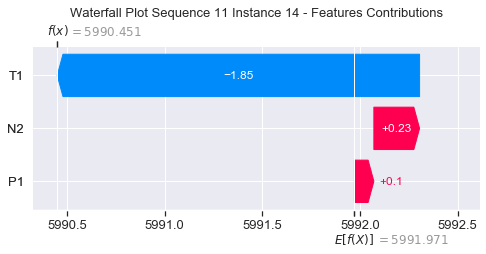

None

Contribution: [ 0.12682925 -2.02620696  0.28993195]


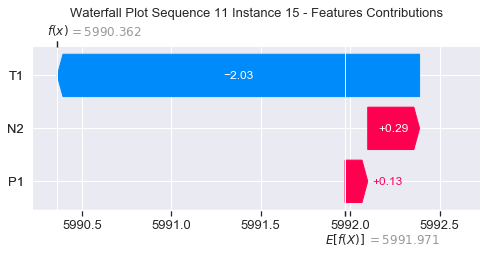

None

Contribution: [ 0.18889737 -2.29741202  0.39598412]


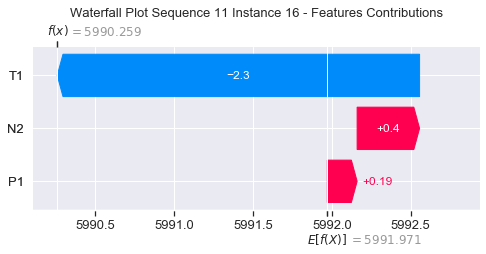

None

Contribution: [ 0.29814337 -2.66153625  0.50895031]


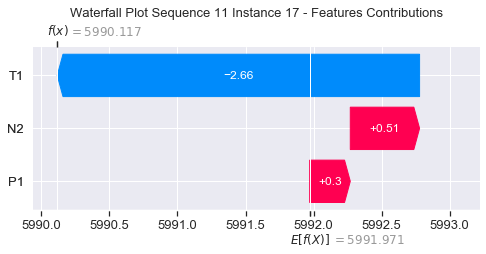

None

Contribution: [ 0.47434091 -3.25034557  0.71517386]


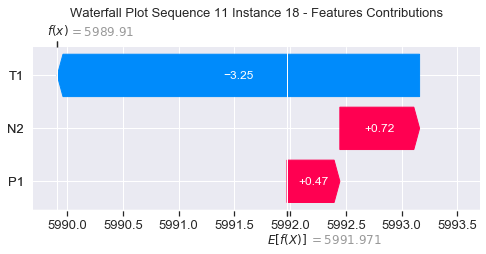

None

Contribution: [ 0.87744859 -4.19643379  1.16275902]


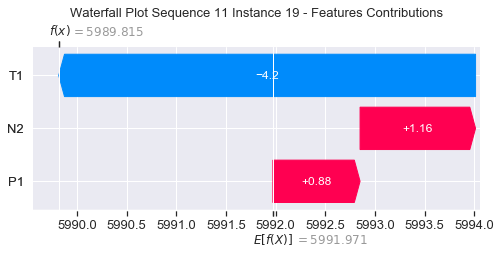

None

Contribution: [ 0.96964526 -5.7461817   1.51338945]


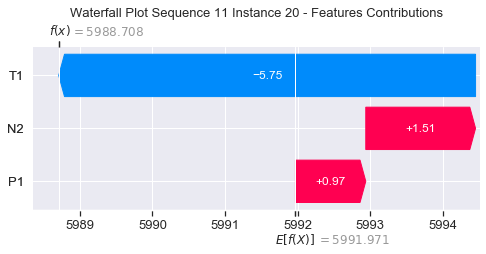

None

Contribution: [ 1.60655036 -8.52742713  2.35769954]


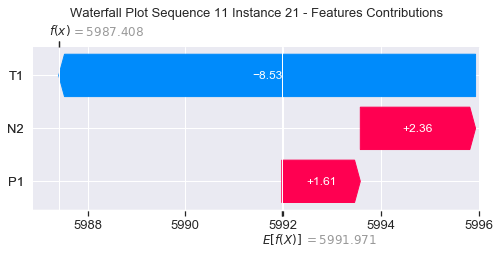

None

Contribution: [  2.53495009 -12.72012565   3.77825564]


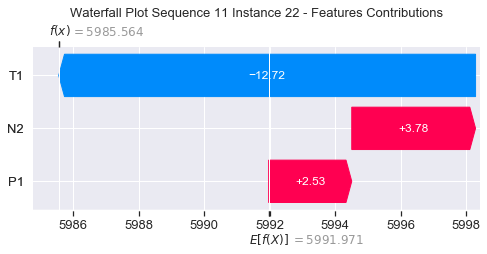

None

Contribution: [  3.5672147  -17.16213023   6.29845455]


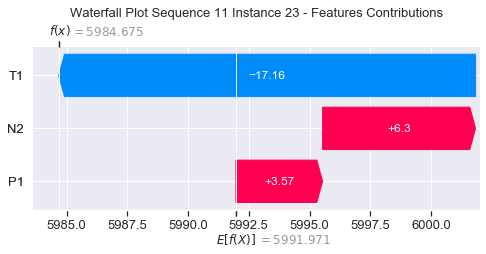

None

Contribution: [  6.12095441 -21.67852636   9.40935619]


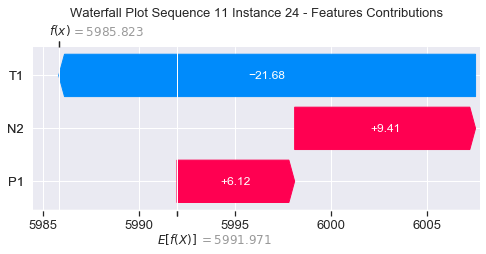

None

Contribution: [ 11.15895736 -55.81520144  17.02822219]


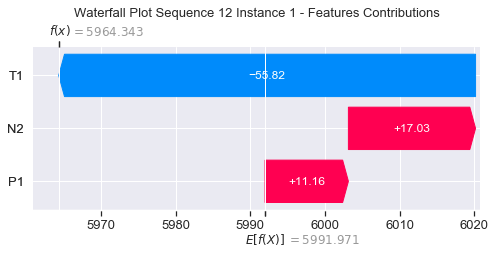

None

Contribution: [ 0.06496828 -0.25659949  0.30140935]


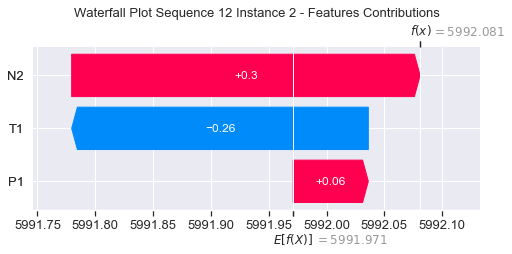

None

Contribution: [ 0.91302233 -8.94182699  1.55026604]


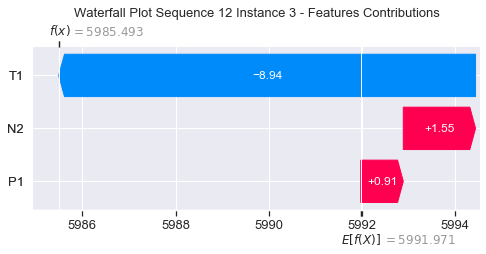

None

Contribution: [ 0.46901778 -4.25415811  0.81299792]


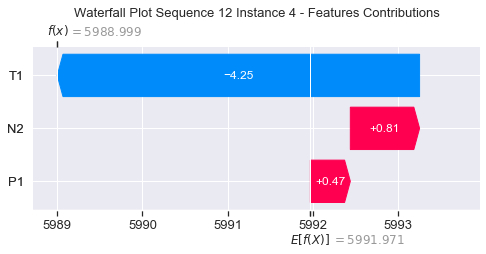

None

Contribution: [ 0.23777063 -2.51899336  0.44390646]


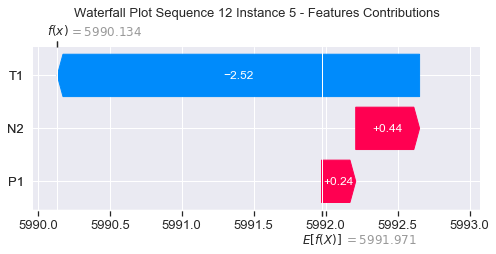

None

Contribution: [ 0.13157733 -1.71992097  0.25956815]


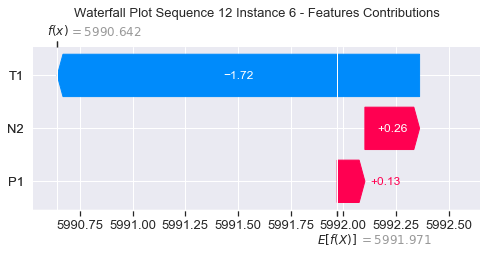

None

Contribution: [ 0.09498967 -1.41625371  0.19611099]


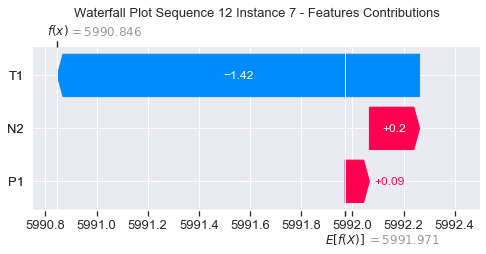

None

Contribution: [ 0.08148988 -1.28586059  0.17613981]


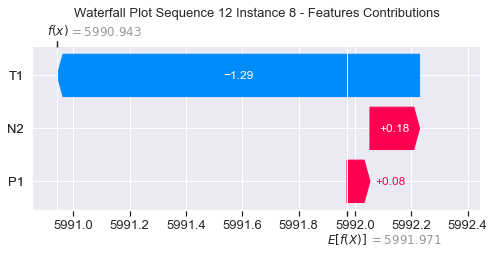

None

Contribution: [ 0.0480417  -1.20685711  0.18457516]


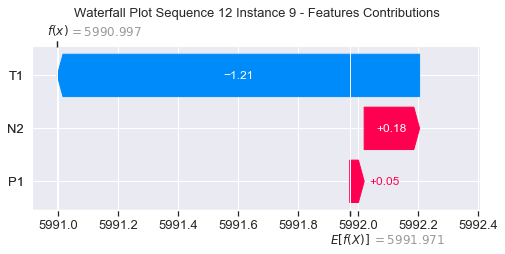

None

Contribution: [ 0.01702895 -1.14592116  0.17936097]


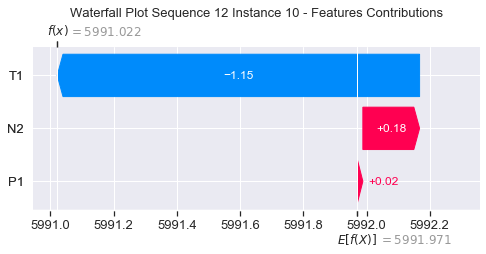

None

Contribution: [ 0.05495349 -1.19439283  0.18297856]


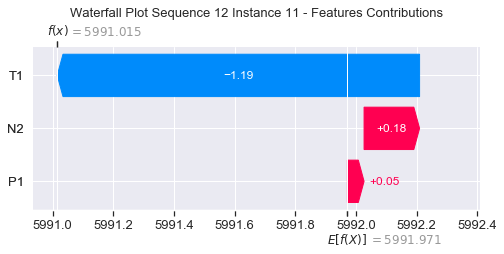

None

Contribution: [ 0.09361172 -1.21593679  0.17573751]


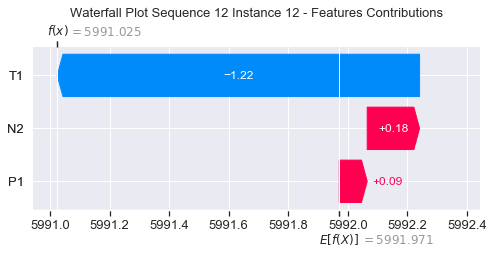

None

Contribution: [ 0.10046772 -1.2872276   0.18968073]


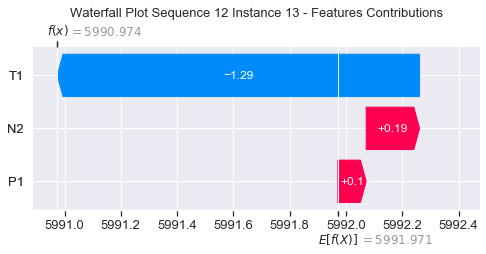

None

Contribution: [ 0.1107662  -1.43373752  0.21603994]


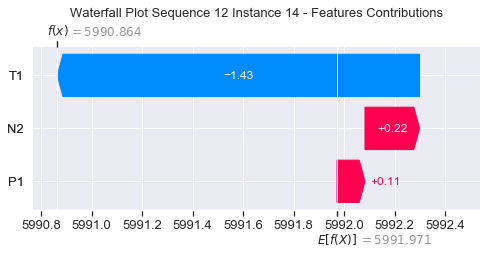

None

Contribution: [ 0.13187533 -1.63189024  0.26814767]


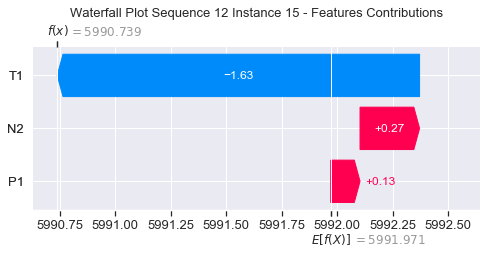

None

Contribution: [ 0.16000054 -2.0292372   0.38332855]


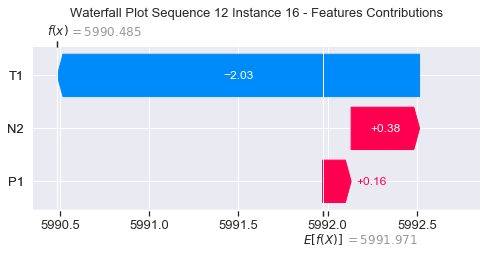

None

Contribution: [ 0.28240347 -2.51068071  0.50158635]


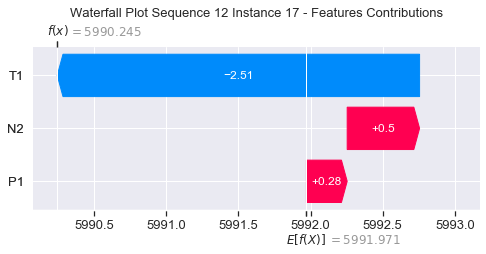

None

Contribution: [ 0.42259169 -3.43843339  0.7333901 ]


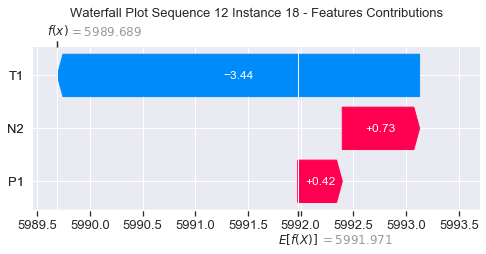

None

Contribution: [ 0.28084285 -5.45682216  1.0975388 ]


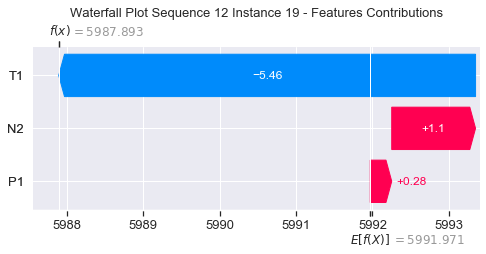

None

Contribution: [ 1.04679456 -7.35360574  1.74015296]


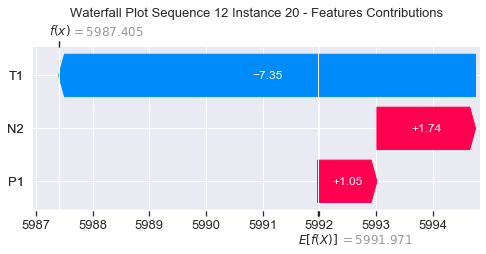

None

Contribution: [  1.6083022  -11.34993292   2.71444135]


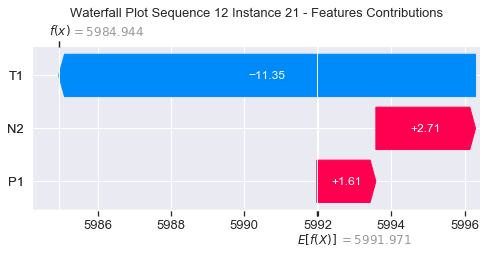

None

Contribution: [  2.17412105 -16.7841186    4.31171446]


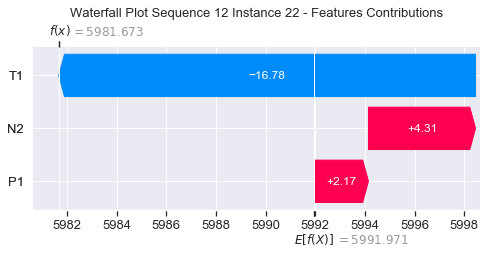

None

Contribution: [  2.54511536 -24.3218493    7.14091911]


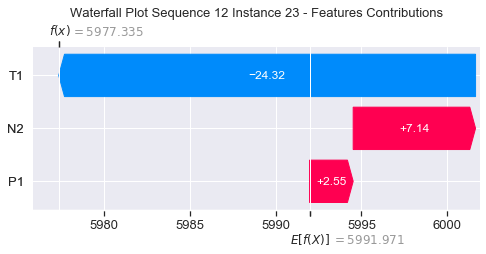

None

Contribution: [  4.77189712 -27.68354195  10.91096057]


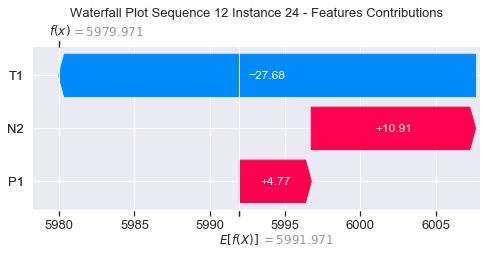

None

Contribution: [  8.13679739 -61.05110127  20.15167816]


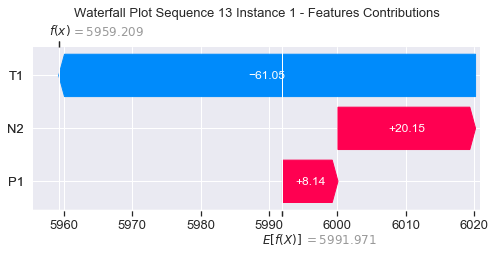

None

Contribution: [ 0.07547899 -0.30134477  0.29552503]


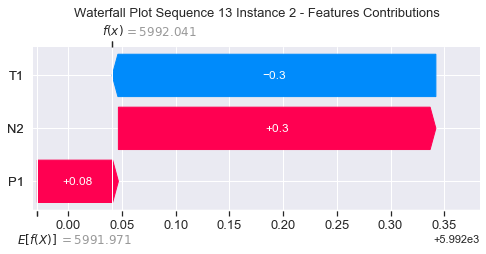

None

Contribution: [ 0.40029957 -9.28208761  1.69964625]


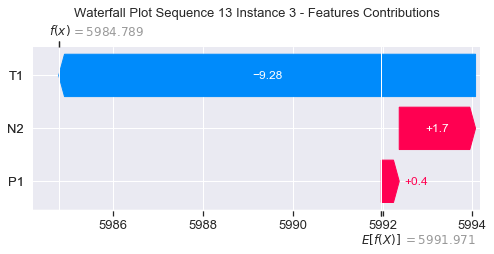

None

Contribution: [ 0.28948784 -4.28276075  0.84862051]


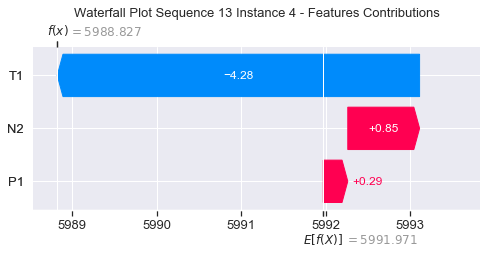

None

Contribution: [ 0.19688589 -2.63052376  0.44278112]


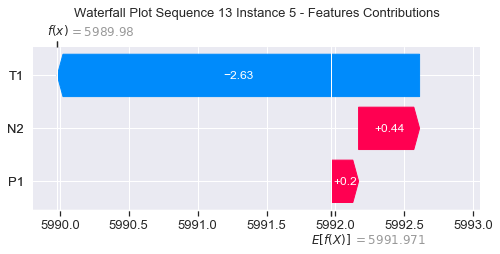

None

Contribution: [ 0.14219524 -1.73344796  0.25768407]


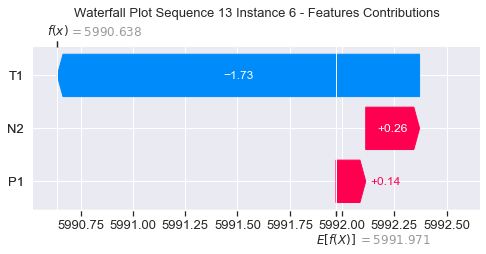

None

Contribution: [ 0.12028711 -1.42401025  0.19709597]


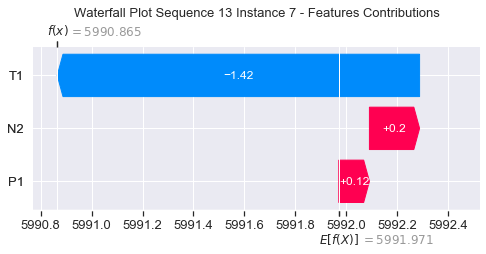

None

Contribution: [ 0.1072069  -1.29032009  0.17810663]


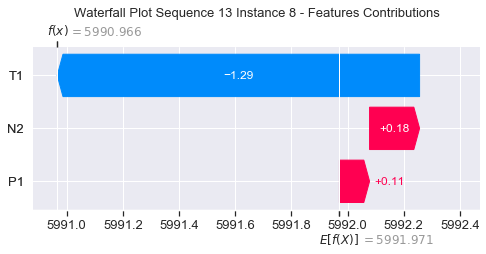

None

Contribution: [ 0.06103499 -1.22053766  0.18095139]


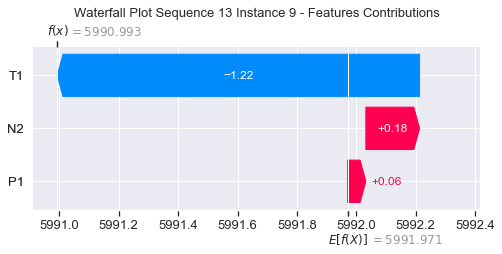

None

Contribution: [ 0.06362056 -1.06133147  0.18528308]


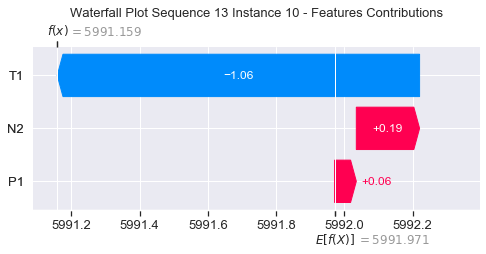

None

Contribution: [ 0.06345182 -1.22424497  0.17869051]


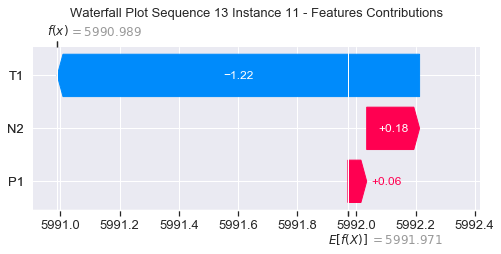

None

Contribution: [ 0.10745806 -1.28105476  0.1740907 ]


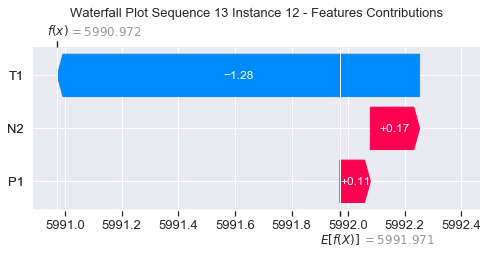

None

Contribution: [ 0.11117168 -1.33672526  0.18949189]


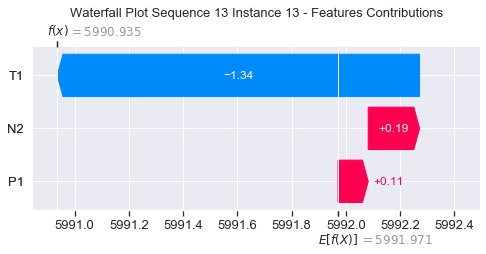

None

Contribution: [ 0.11236027 -1.46040522  0.21840462]


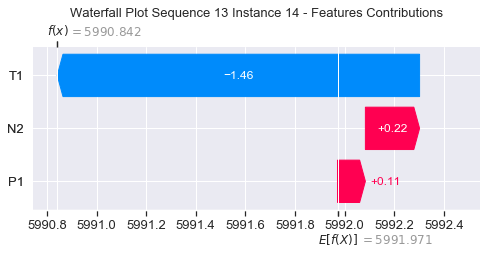

None

Contribution: [ 0.11562201 -1.59834599  0.2727479 ]


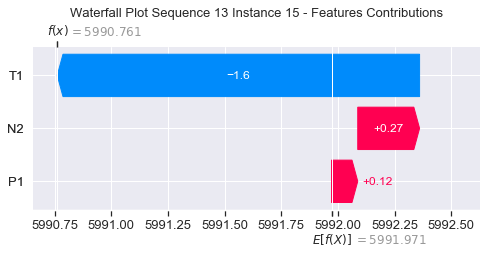

None

Contribution: [ 0.08511563 -1.83614276  0.38430678]


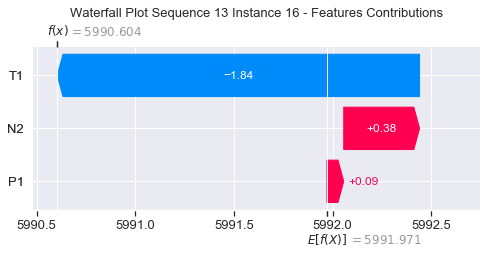

None

Contribution: [ 0.1706494  -2.16776386  0.51384018]


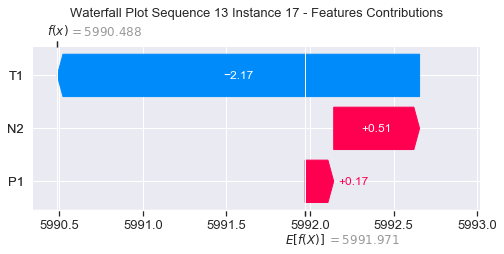

None

Contribution: [ 0.19981688 -2.76627066  0.74527159]


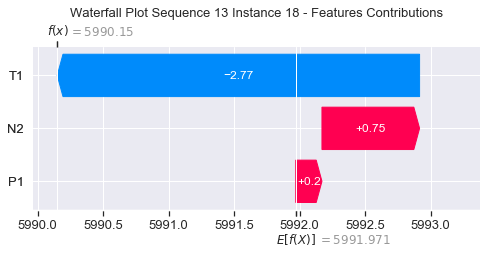

None

Contribution: [-0.18280416 -4.32404196  1.16195943]


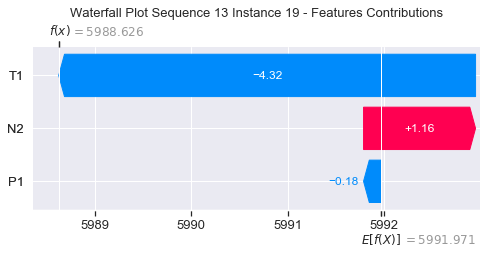

None

Contribution: [ 0.29929678 -5.65543176  1.72196319]


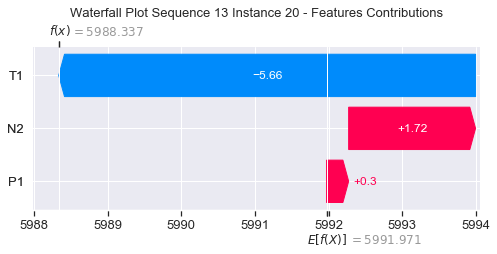

None

Contribution: [ 0.48074257 -8.26602189  2.75005665]


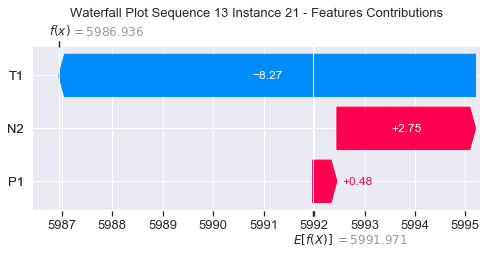

None

Contribution: [  0.47878883 -11.83581468   4.43415552]


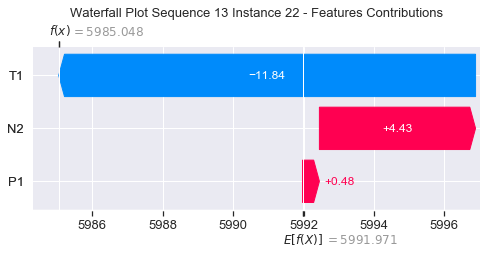

None

Contribution: [-1.30876451e-02 -1.63422040e+01  7.23612668e+00]


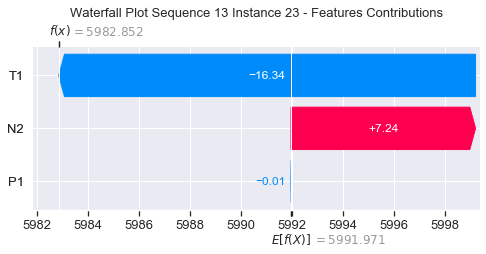

None

Contribution: [  1.62657282 -19.52938185  10.6878632 ]


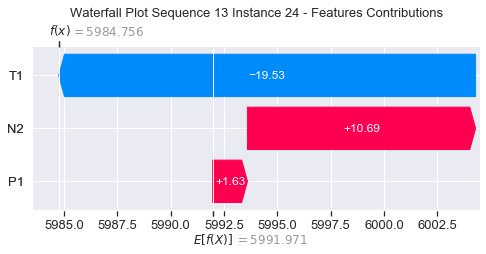

None

Contribution: [  5.40296349 -43.3228743   19.9093904 ]


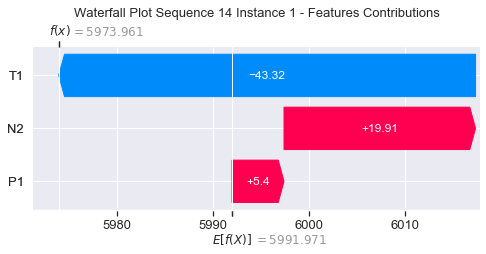

None

Contribution: [ 0.09476045 -0.20704181  0.29875223]


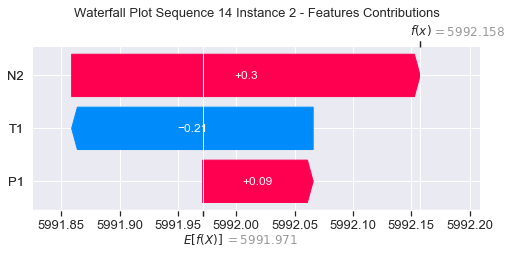

None

Contribution: [ 0.23363982 -5.9160832   1.95225349]


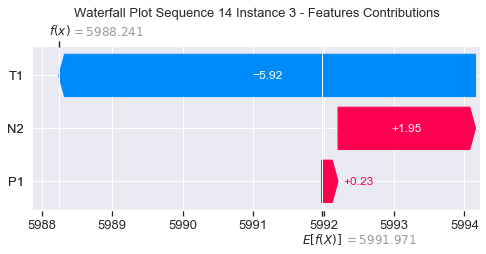

None

Contribution: [ 0.40360493 -3.29767458  0.94191675]


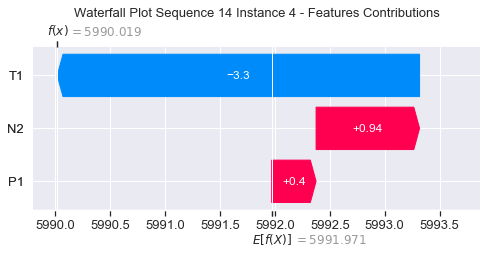

None

Contribution: [ 0.20176377 -2.08579869  0.45892083]


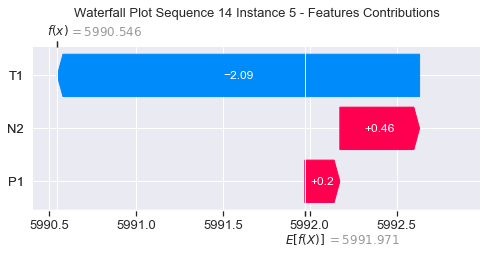

None

Contribution: [ 0.13156173 -1.5552766   0.26913863]


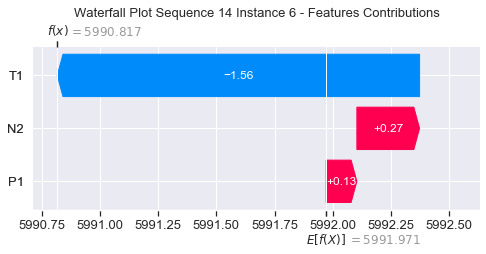

None

Contribution: [ 0.10791052 -1.33968234  0.20105226]


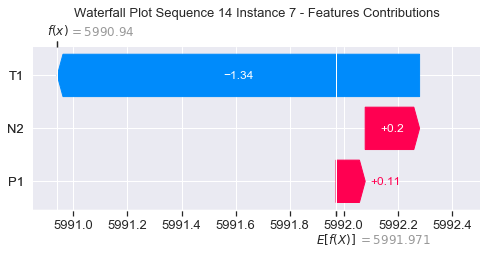

None

Contribution: [ 0.0959055  -1.23483881  0.17626231]


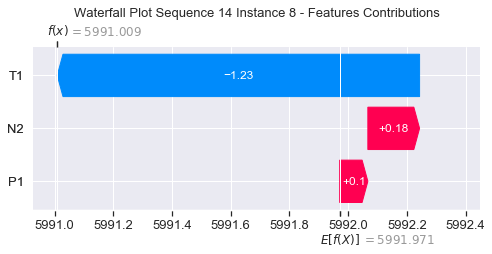

None

Contribution: [ 0.05483165 -1.19280876  0.17836265]


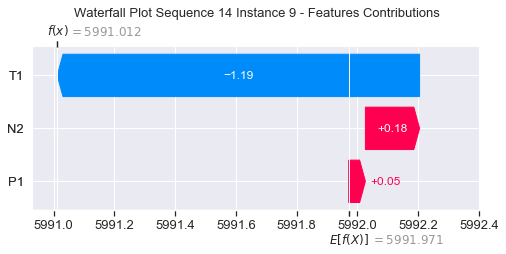

None

Contribution: [ 0.04621523 -1.11997182  0.1796832 ]


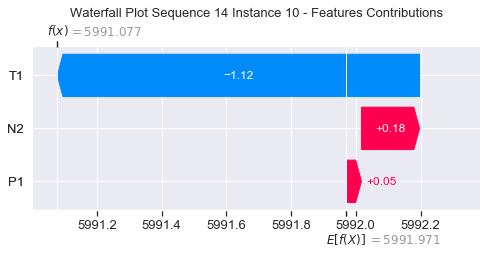

None

Contribution: [ 0.06136935 -1.14519442  0.17628614]


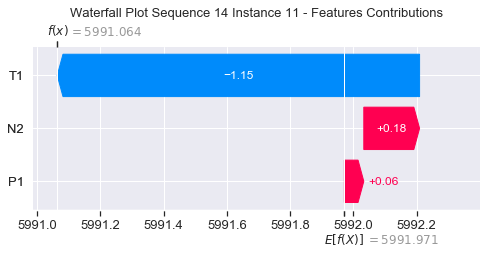

None

Contribution: [ 0.09749425 -1.16025974  0.169912  ]


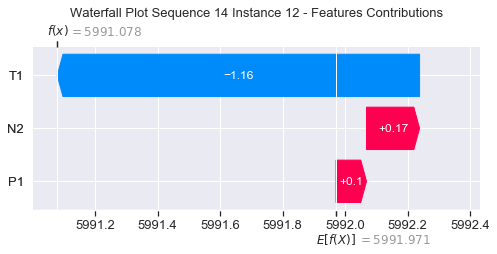

None

Contribution: [ 0.10023888 -1.19698829  0.18527915]


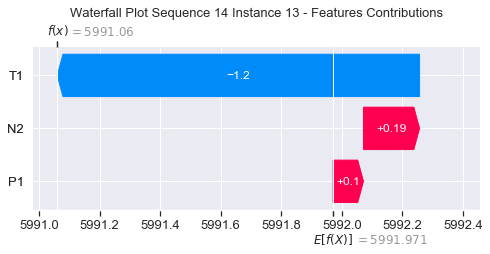

None

Contribution: [ 0.10211689 -1.28795397  0.21205444]


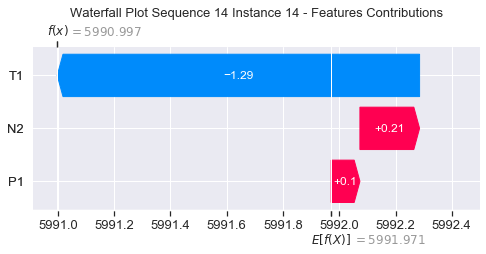

None

Contribution: [ 0.10482109 -1.40266055  0.26600253]


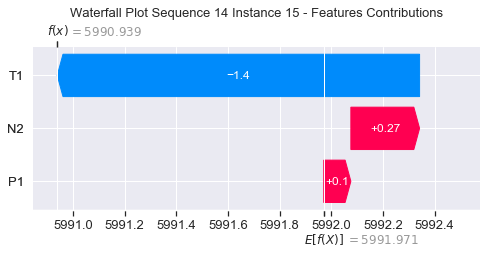

None

Contribution: [ 0.07121608 -1.71760776  0.38002605]


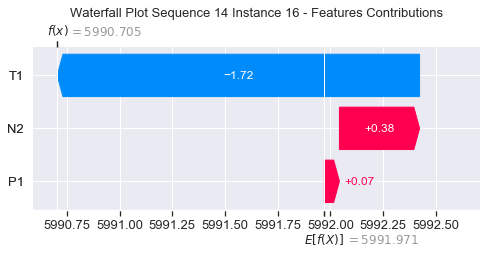

None

Contribution: [ 0.16081758 -1.93386627  0.49843406]


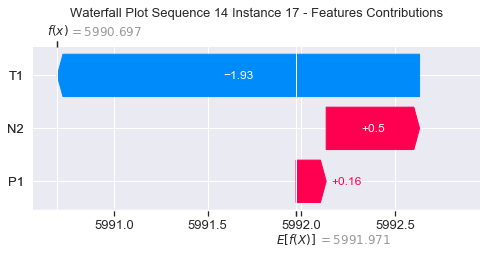

None

Contribution: [ 0.18963288 -2.58316377  0.72176425]


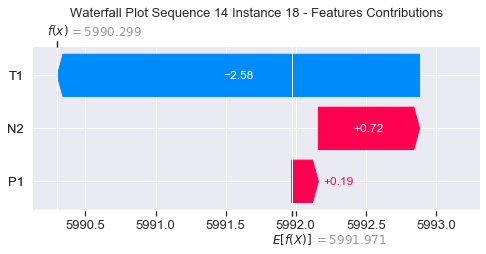

None

Contribution: [ 0.15806371 -4.29861773  1.22466446]


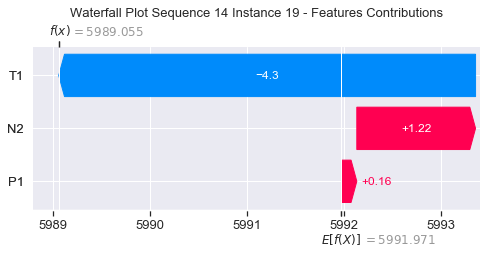

None

Contribution: [ 0.38425114 -5.46749225  1.70073187]


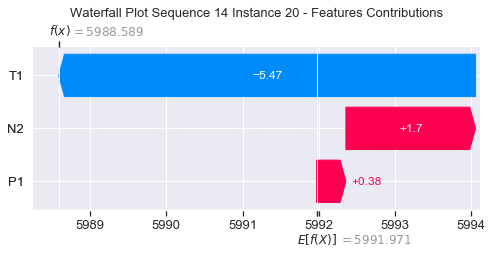

None

Contribution: [ 0.58074143 -8.45182079  2.68176897]


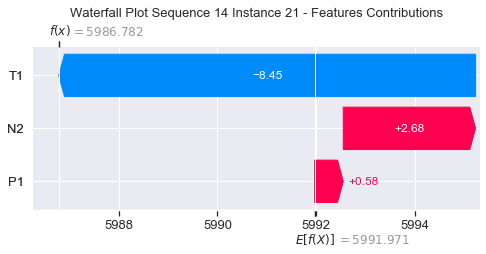

None

Contribution: [  0.65604412 -12.7667695    4.31074715]


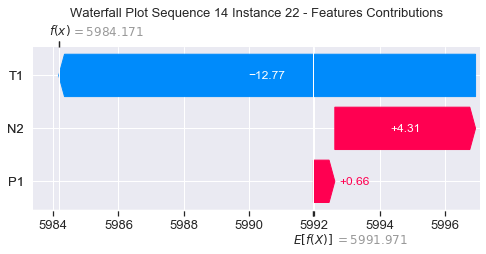

None

Contribution: [  0.09549917 -18.94558321   7.05986807]


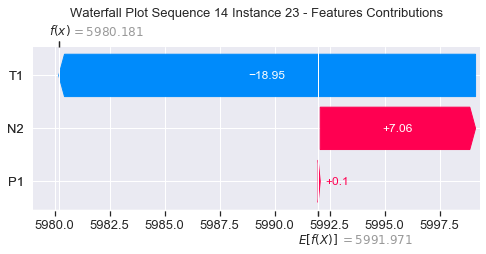

None

Contribution: [  1.7589312  -22.48153597  10.27185478]


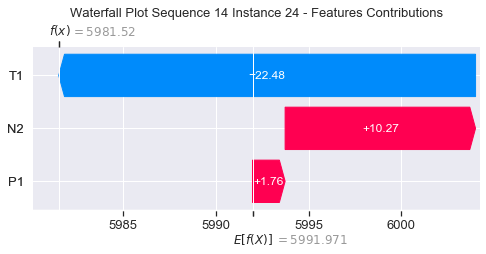

None

Contribution: [  4.70355165 -52.22558629  17.63868084]


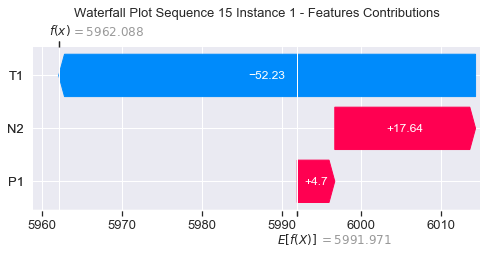

None

Contribution: [ 0.09310937 -0.26181558  0.29614154]


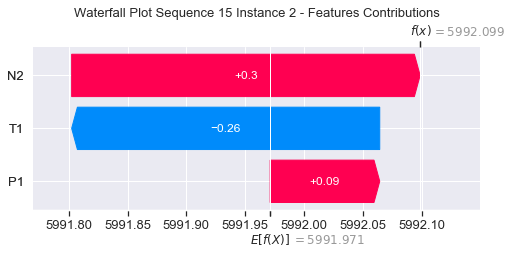

None

Contribution: [ 0.45739215 -8.05317494  1.83111431]


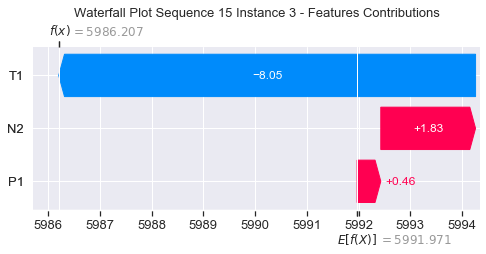

None

Contribution: [ 0.23475013 -4.25616673  0.86248813]


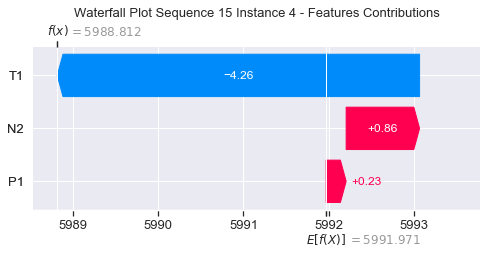

None

Contribution: [ 0.19840705 -2.42855323  0.45401559]


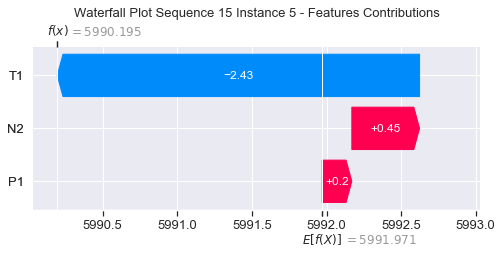

None

Contribution: [ 0.13603766 -1.68105906  0.25955107]


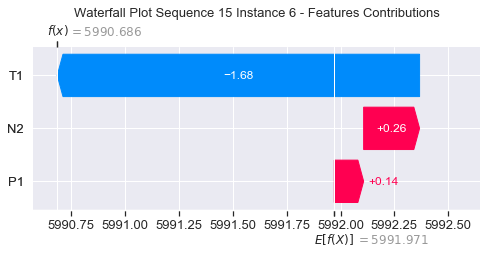

None

Contribution: [ 0.11022454 -1.41014523  0.19312743]


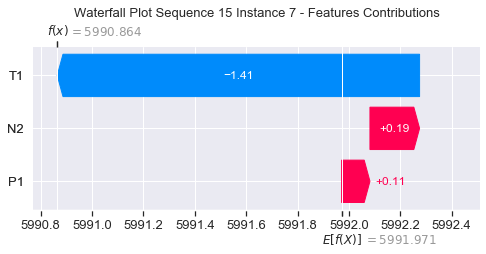

None

Contribution: [ 0.10027359 -1.28035376  0.17327917]


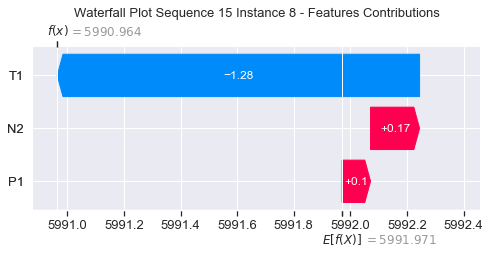

None

Contribution: [ 0.07071737 -1.22978421  0.17932269]


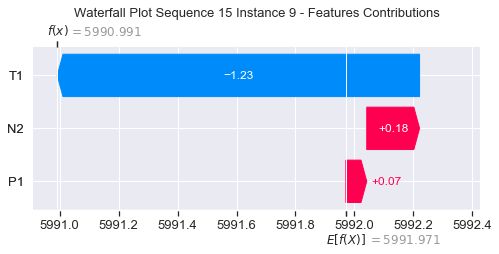

None

Contribution: [ 0.05198039 -1.15753645  0.18009253]


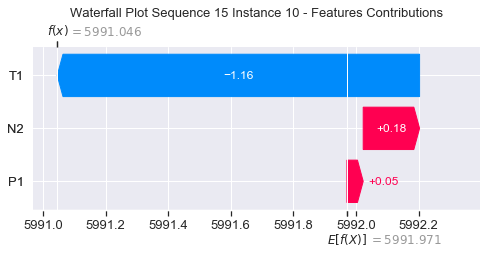

None

Contribution: [ 0.07649686 -1.18685605  0.17984001]


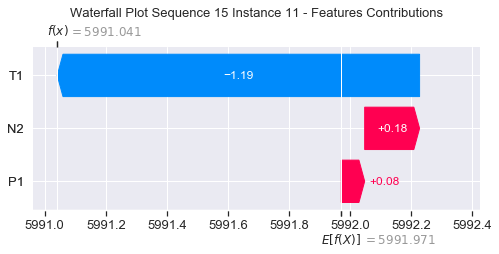

None

Contribution: [ 0.10582073 -1.24251424  0.17305842]


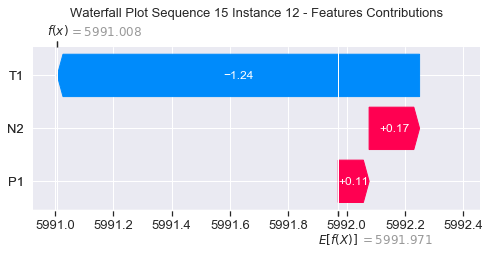

None

Contribution: [ 0.10781938 -1.29080982  0.18799958]


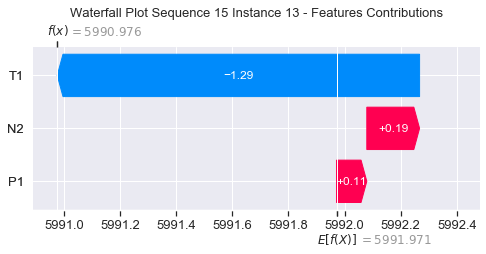

None

Contribution: [ 0.10928223 -1.39630673  0.21701413]


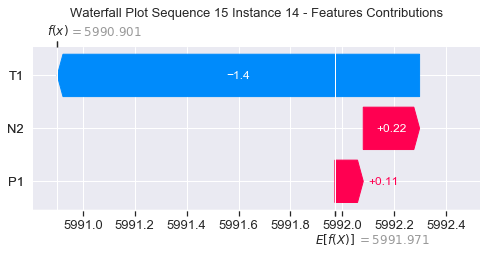

None

Contribution: [ 0.11038772 -1.51952943  0.27129281]


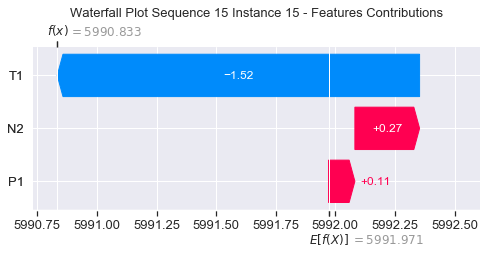

None

Contribution: [ 0.09641243 -1.67974272  0.38781973]


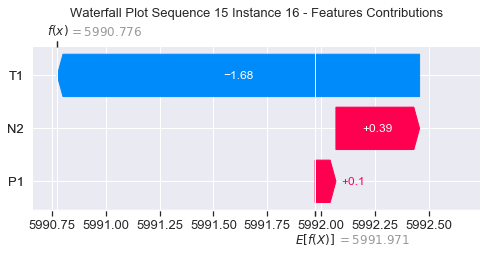

None

Contribution: [ 0.16929061 -2.03182042  0.51644961]


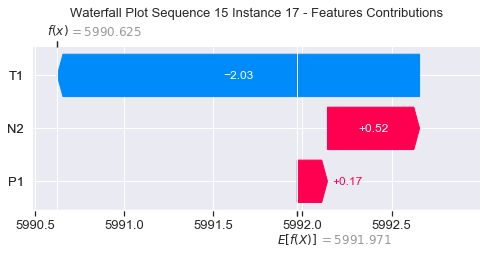

None

Contribution: [ 0.20895785 -2.65229141  0.75232783]


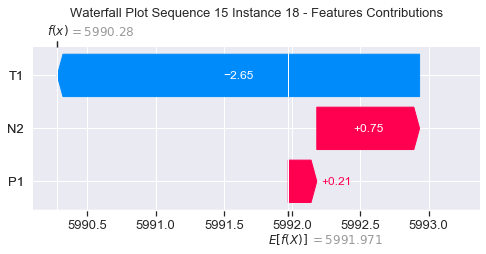

None

Contribution: [ 0.17853024 -3.6294318   1.16332595]


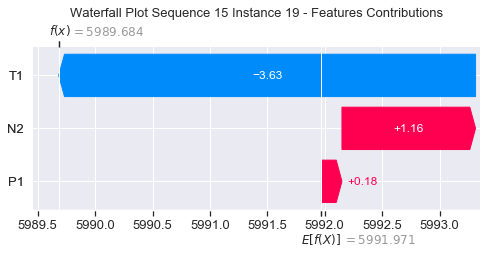

None

Contribution: [ 0.35809175 -5.32009111  1.76169876]


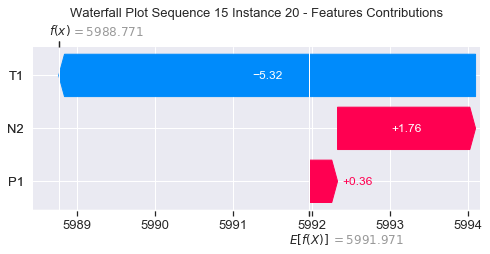

None

Contribution: [ 0.46080944 -7.9820467   2.73796767]


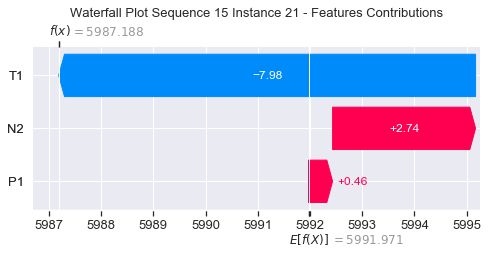

None

Contribution: [  0.30033852 -11.87079958   4.30063792]


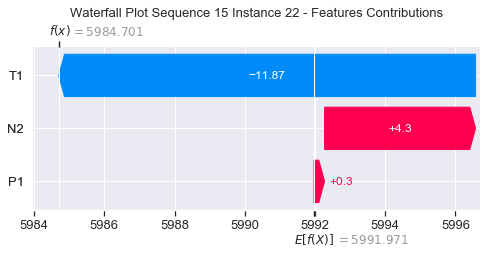

None

Contribution: [ -0.16137706 -17.36487682   7.07094596]


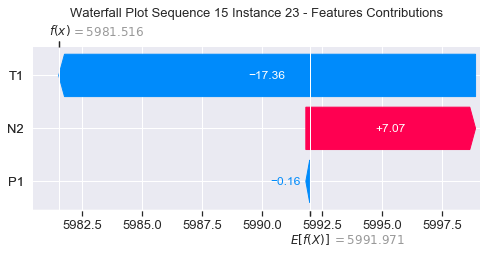

None

Contribution: [  1.96257012 -21.40091874  10.70623675]


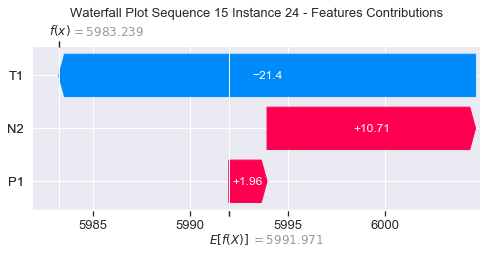

None

Contribution: [  7.15601406 -49.59848623  20.04152569]


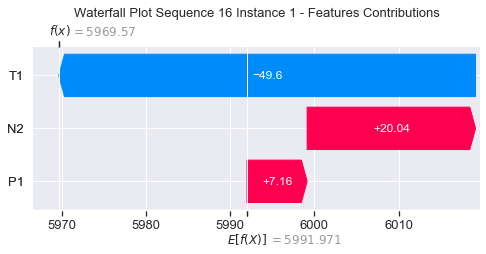

None

Contribution: [ 0.10386008 -0.23448131  0.29961162]


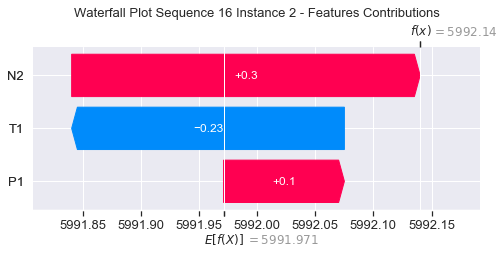

None

Contribution: [ 0.12879843 -7.22584614  1.8861316 ]


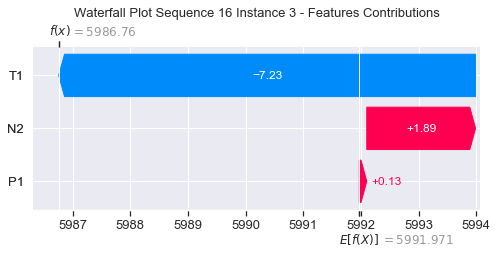

None

Contribution: [ 0.34356652 -3.79056895  0.8761682 ]


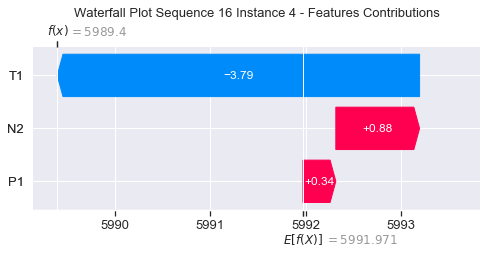

None

Contribution: [ 0.21271533 -2.45355046  0.45732224]


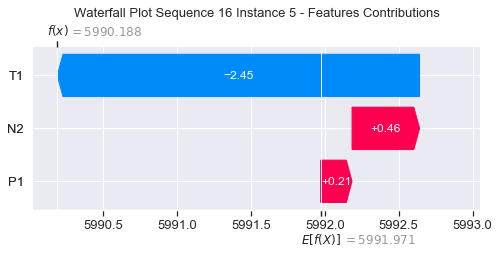

None

Contribution: [ 0.13548653 -1.66960476  0.26216809]


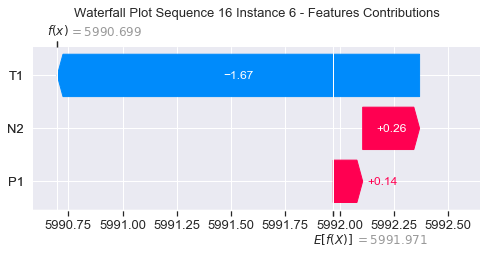

None

Contribution: [ 0.10900464 -1.39370539  0.19398613]


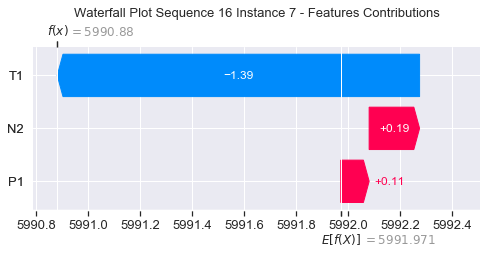

None

Contribution: [ 0.09719695 -1.25711912  0.17201526]


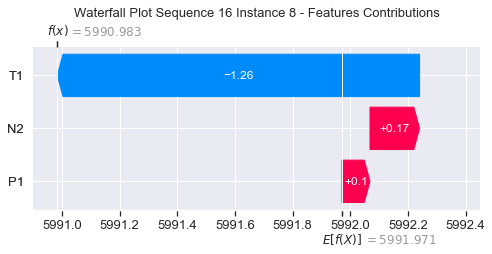

None

Contribution: [ 0.06491703 -1.166781    0.17520651]


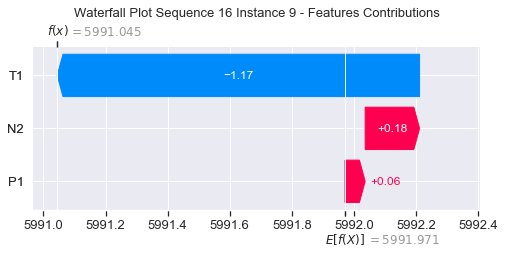

None

Contribution: [ 0.05655706 -1.13889998  0.17878635]


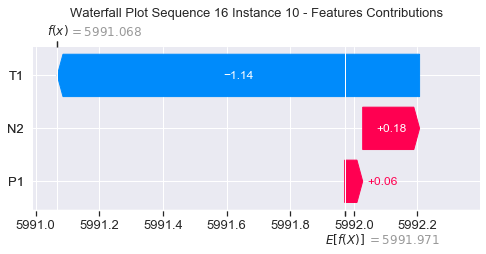

None

Contribution: [ 0.06604811 -1.11770607  0.17395018]


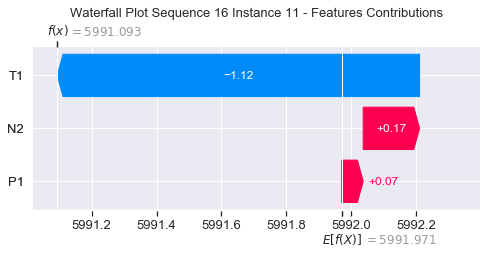

None

Contribution: [ 0.1046837  -1.21143847  0.16977594]


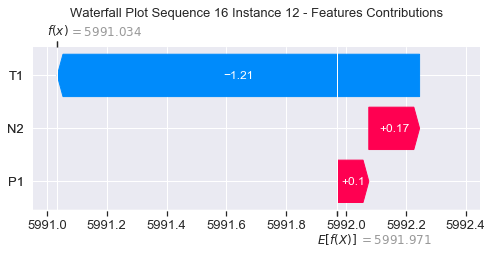

None

Contribution: [ 0.10754522 -1.2722072   0.18652222]


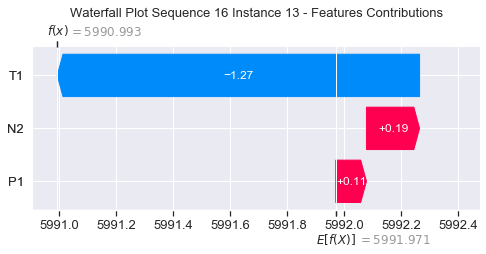

None

Contribution: [ 0.10712864 -1.39472304  0.21534182]


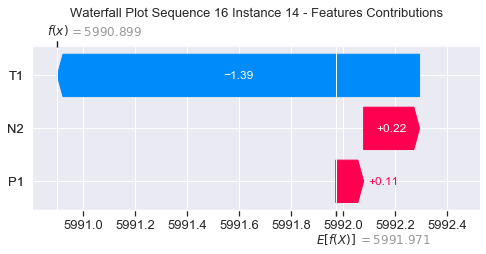

None

Contribution: [ 0.11011785 -1.55547511  0.27077342]


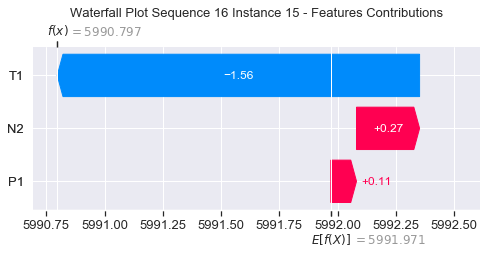

None

Contribution: [ 0.05496878 -1.88826084  0.36521503]


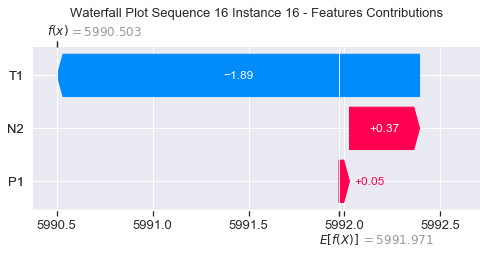

None

Contribution: [ 0.1540115  -2.22035819  0.50691934]


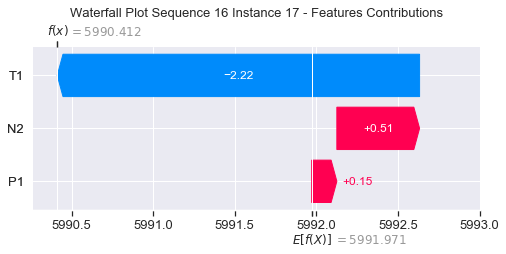

None

Contribution: [ 0.17978845 -2.99663361  0.72673497]


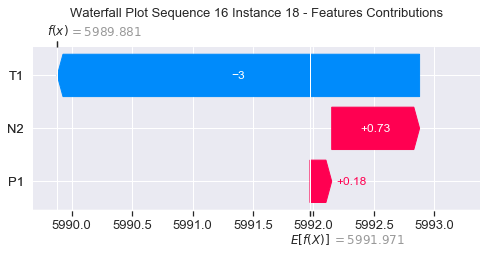

None

Contribution: [ 0.1580906  -4.64970503  1.11546289]


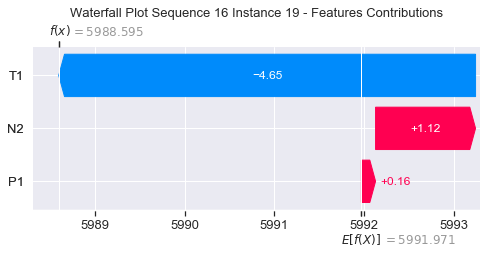

None

Contribution: [ 0.28628323 -6.32762463  1.62359244]


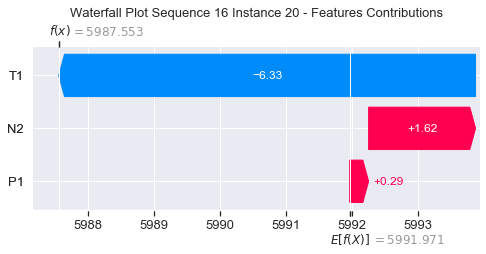

None

Contribution: [ 0.38225076 -9.80416349  2.54409988]


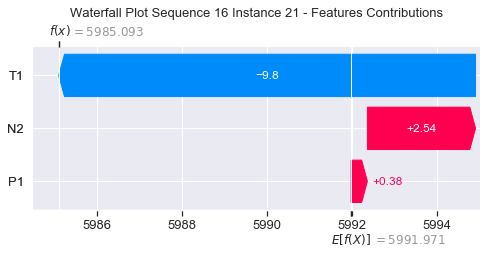

None

Contribution: [  0.35585532 -15.08424565   4.0394507 ]


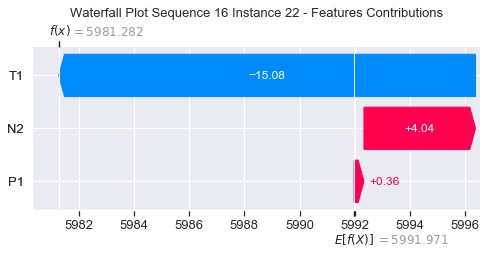

None

Contribution: [ -0.21678423 -21.95909069   6.65531445]


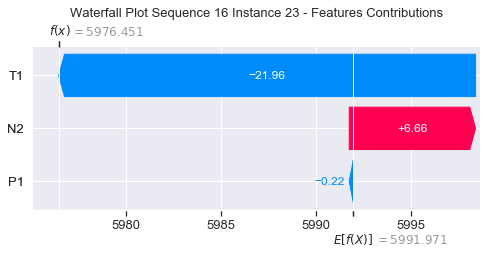

None

Contribution: [  1.97035786 -25.55351483  10.1138644 ]


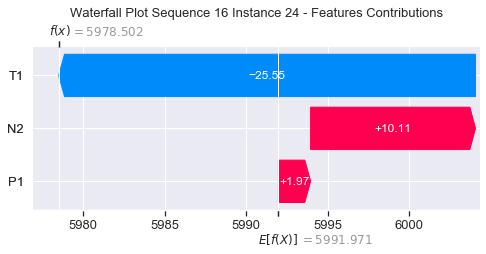

None

Contribution: [  6.5987853  -52.98153272  19.42869606]


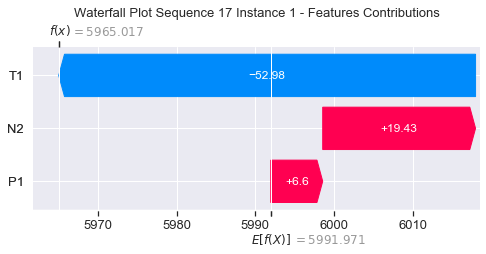

None

Contribution: [ 0.10302447 -0.28333881  0.29672701]


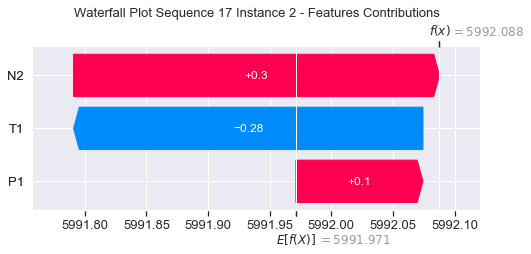

None

Contribution: [ 0.72347976 -9.09064967  1.91719899]


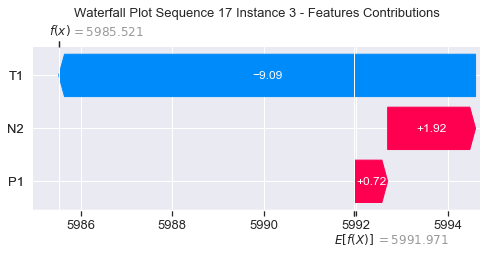

None

Contribution: [ 0.44747701 -4.45194739  0.91875244]


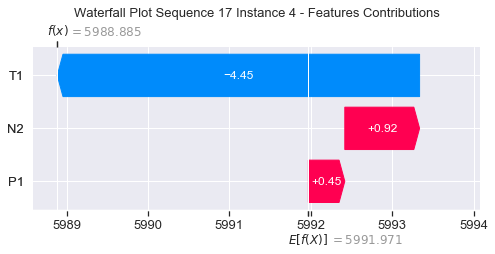

None

Contribution: [ 0.21407071 -2.68576266  0.44110394]


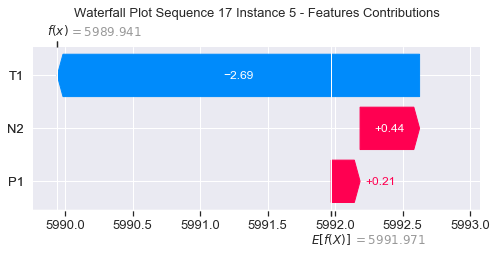

None

Contribution: [ 0.14150496 -1.73384221  0.25772853]


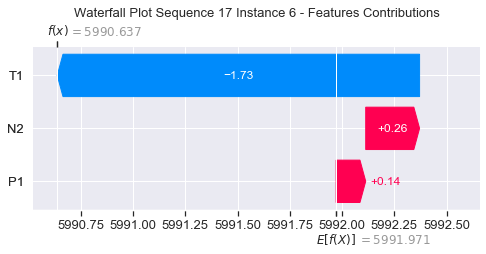

None

Contribution: [ 0.11769459 -1.40832802  0.19643747]


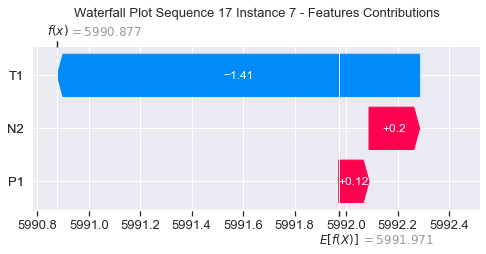

None

Contribution: [ 0.10662173 -1.26852452  0.17804022]


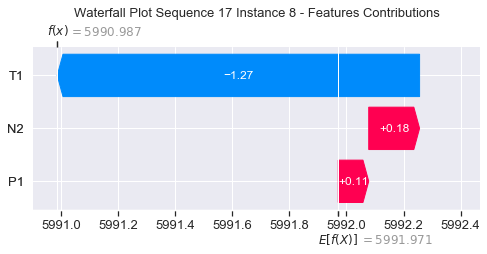

None

Contribution: [ 0.07033941 -1.19119485  0.18713938]


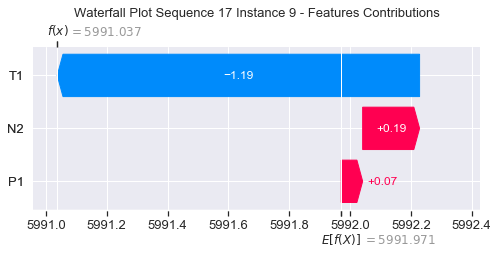

None

Contribution: [ 0.06808279 -1.1590491   0.1785603 ]


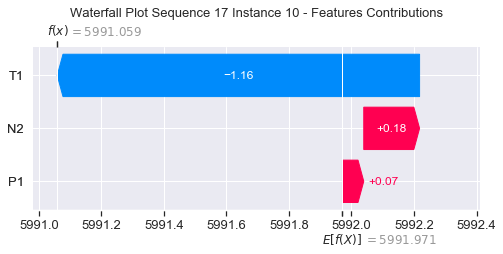

None

Contribution: [ 0.07712662 -1.18372016  0.18559954]


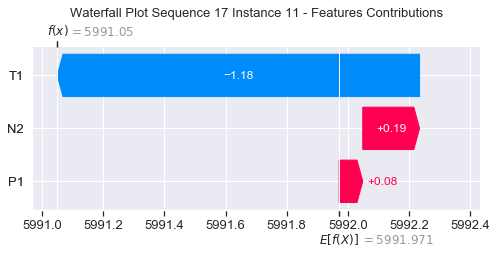

None

Contribution: [ 0.11035609 -1.24114399  0.17524834]


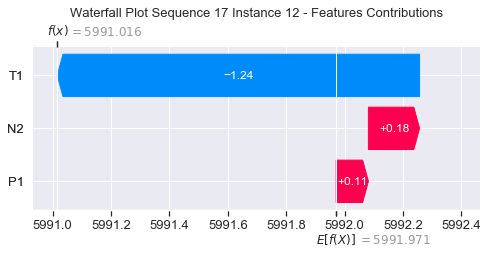

None

Contribution: [ 0.11270008 -1.31499464  0.18987871]


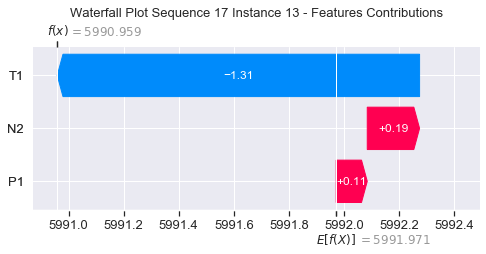

None

Contribution: [ 0.11498083 -1.46182528  0.2169601 ]


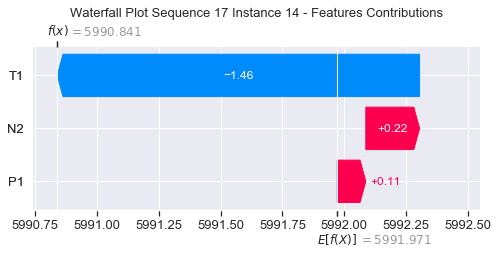

None

Contribution: [ 0.11646769 -1.66506178  0.27134282]


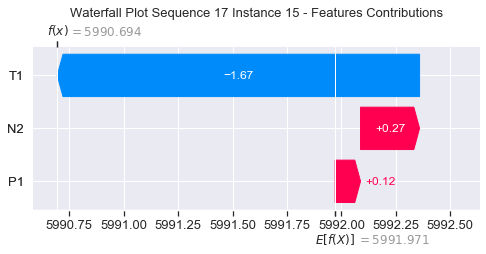

None

Contribution: [ 0.12856829 -1.92962383  0.39453308]


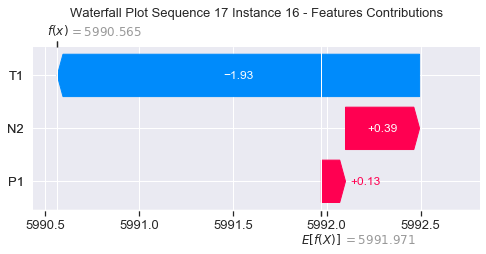

None

Contribution: [ 0.1631943  -2.51868782  0.50724118]


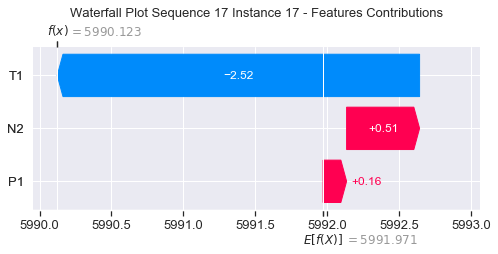

None

Contribution: [ 0.17989036 -3.4277883   0.73433465]


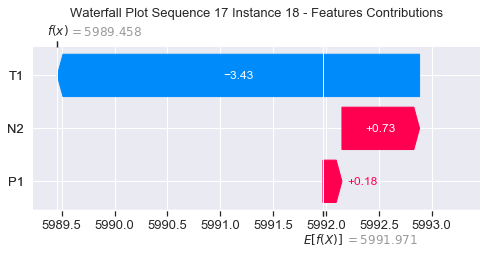

None

Contribution: [ 0.16335057 -4.53445609  1.18741109]


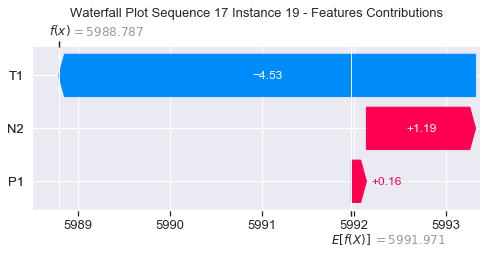

None

Contribution: [ 0.31719726 -7.44212359  1.71767845]


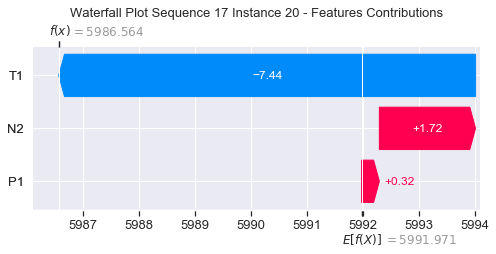

None

Contribution: [  0.48212679 -11.45028013   2.7165613 ]


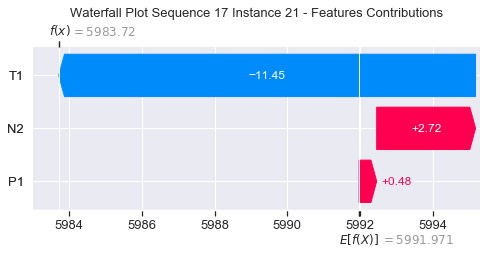

None

Contribution: [  0.55068717 -17.02337529   4.37384806]


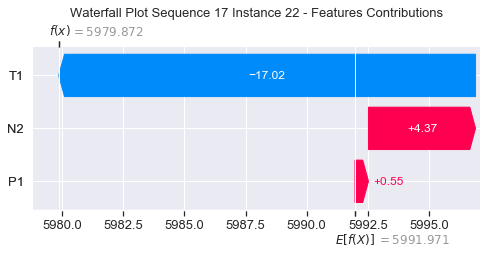

None

Contribution: [ -0.11152144 -24.07358662   7.12979501]


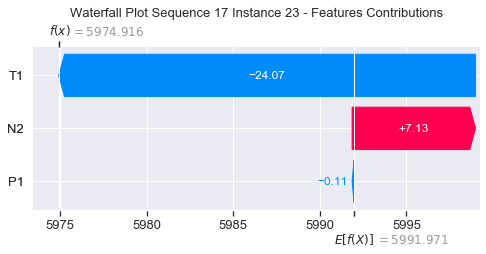

None

Contribution: [  2.47764232 -29.05844001  10.73979511]


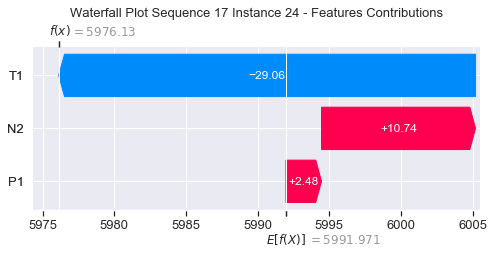

None

Contribution: [  9.86444557 -63.57755549  19.91423688]


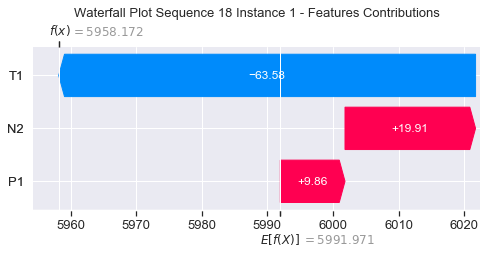

None

Contribution: [ 0.09365582 -0.29344449  0.29248552]


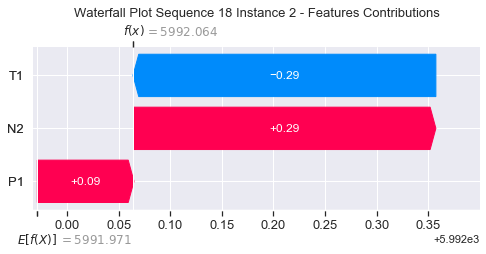

None

Contribution: [ 0.80103757 -9.19500333  2.01976673]


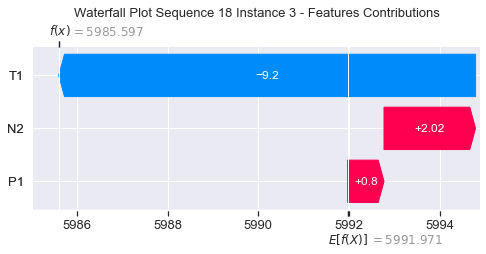

None

Contribution: [ 0.30846237 -4.65388959  0.87911174]


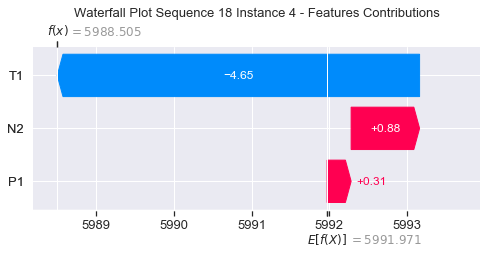

None

Contribution: [ 0.21655494 -2.62015555  0.45262876]


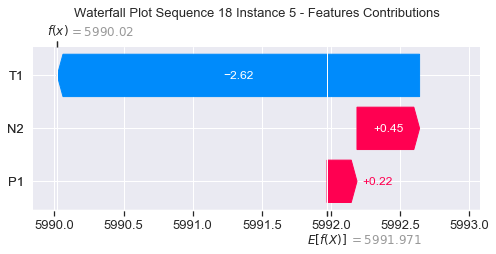

None

Contribution: [ 0.13266364 -1.71888543  0.25268669]


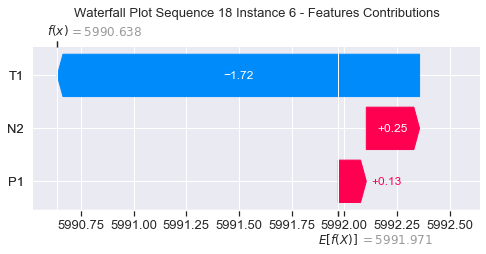

None

Contribution: [ 0.09676735 -1.41727374  0.1857399 ]


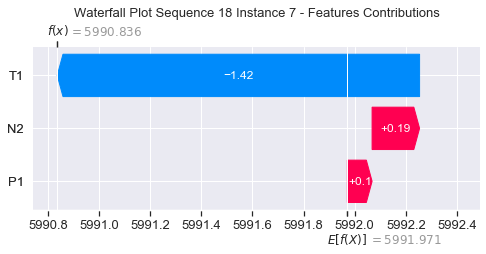

None

Contribution: [ 0.08834262 -1.27893636  0.16819218]


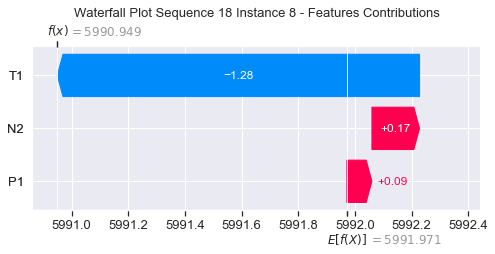

None

Contribution: [ 0.05756713 -1.22979641  0.17688907]


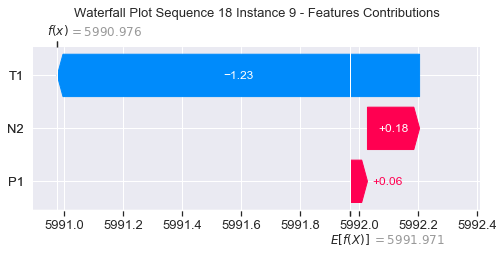

None

Contribution: [ 0.03645539 -1.15120442  0.18073483]


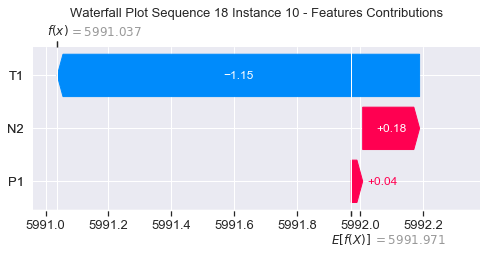

None

Contribution: [ 0.06295997 -1.20735459  0.17521468]


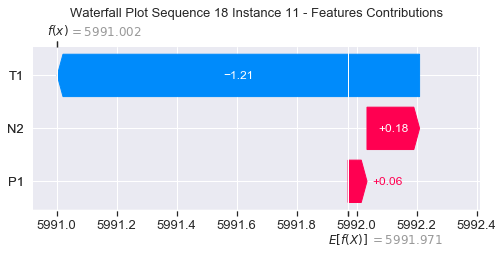

None

Contribution: [ 0.08288142 -1.26171018  0.16626051]


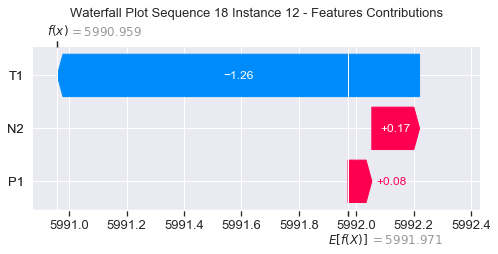

None

Contribution: [ 0.09514981 -1.318808    0.18434832]


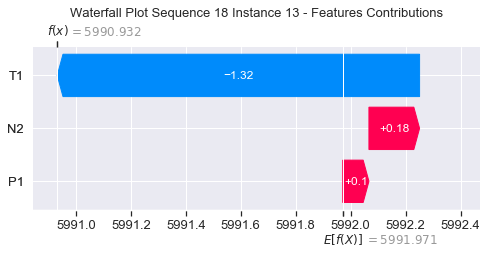

None

Contribution: [ 0.11103445 -1.44230016  0.21665324]


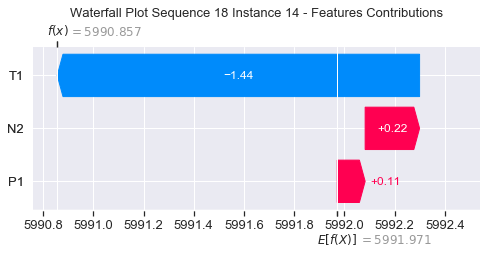

None

Contribution: [ 0.13317614 -1.59660566  0.27727019]


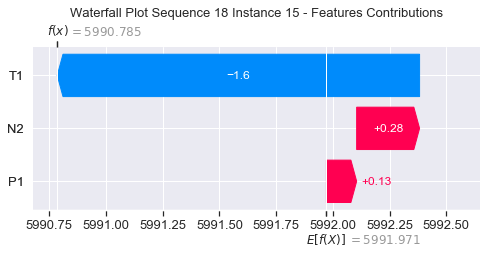

None

Contribution: [ 0.09861026 -1.77948133  0.37584507]


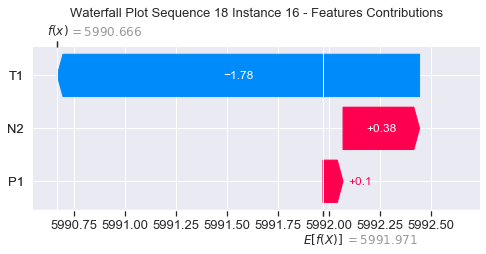

None

Contribution: [ 0.27932065 -2.24760002  0.54354753]


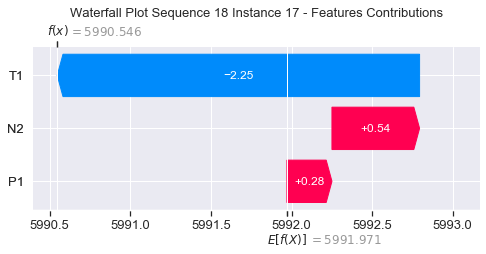

None

Contribution: [ 0.38119089 -2.98999201  0.79390729]


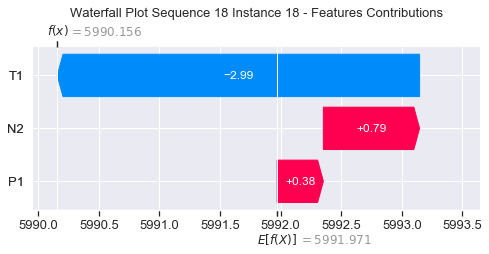

None

Contribution: [ 0.37169777 -4.42397624  1.24289582]


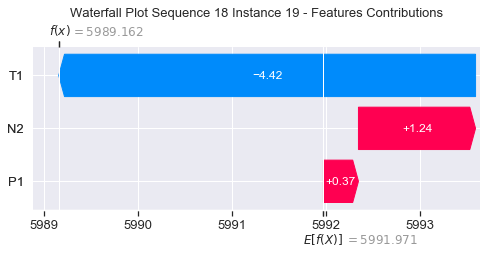

None

Contribution: [ 0.65587454 -6.58377144  1.79608566]


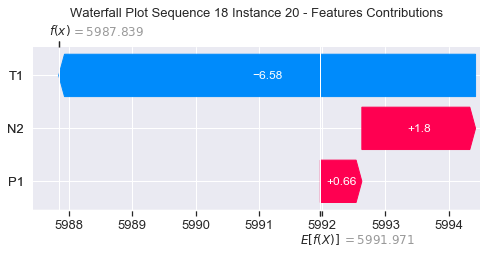

None

Contribution: [  1.01491921 -10.06688318   2.81240355]


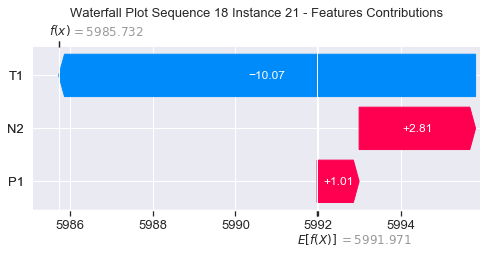

None

Contribution: [  1.12855093 -15.31516589   4.40820466]


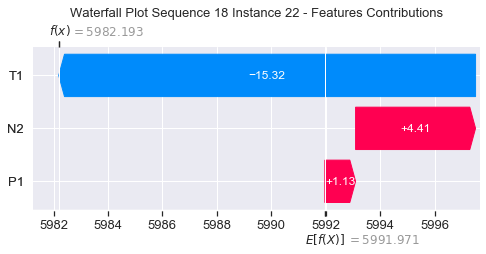

None

Contribution: [  1.01403819 -21.45666091   7.24681577]


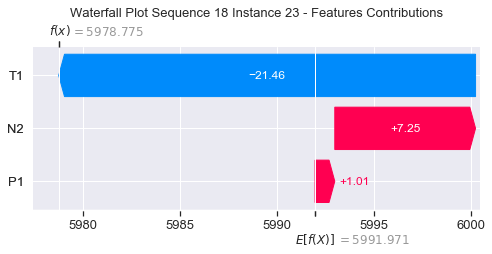

None

Contribution: [  2.98871143 -26.82021404  10.6139374 ]


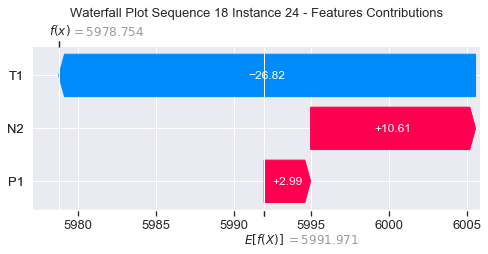

None

Contribution: [ 11.09936371 -56.80998787  19.83025758]


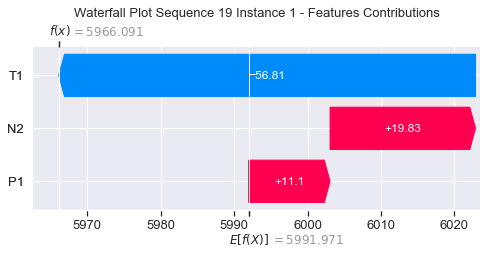

None

Contribution: [ 0.08267058 -0.26737167  0.29414665]


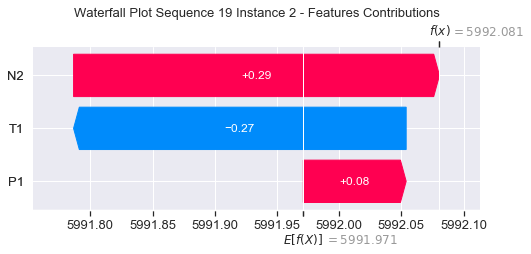

None

Contribution: [ 0.29223305 -8.84279777  1.80370003]


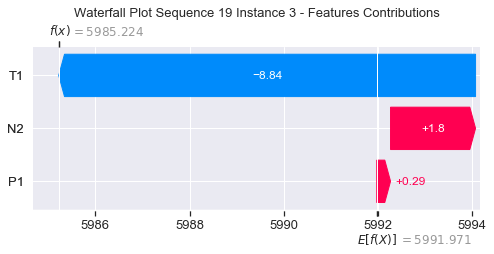

None

Contribution: [ 0.39883249 -4.44087927  0.91598353]


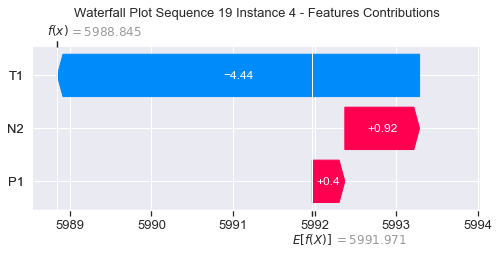

None

Contribution: [ 0.22959218 -2.59093391  0.45982732]


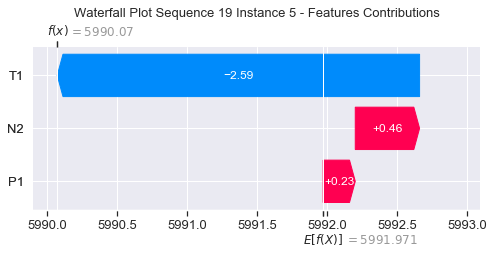

None

Contribution: [ 0.13530287 -1.70117515  0.25777227]


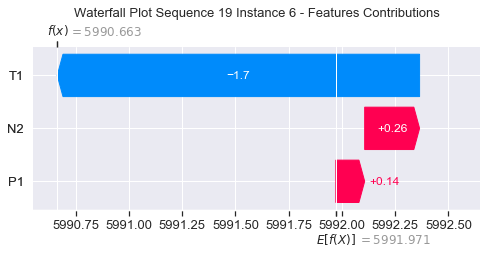

None

Contribution: [ 0.10307521 -1.39947411  0.19289802]


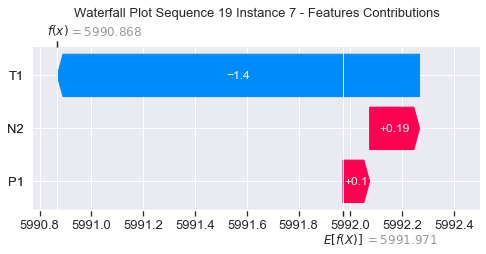

None

Contribution: [ 0.09239269 -1.26010146  0.17318791]


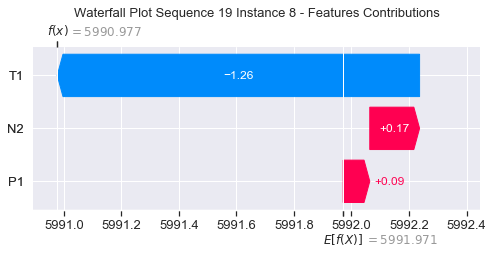

None

Contribution: [ 0.05661687 -1.20430651  0.17433601]


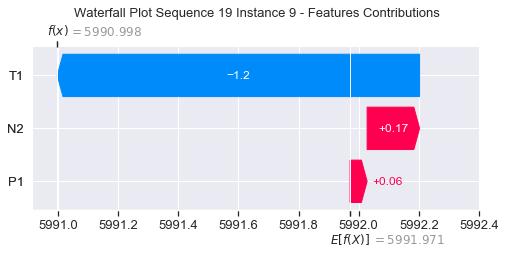

None

Contribution: [ 0.04454545 -1.14062359  0.18004524]


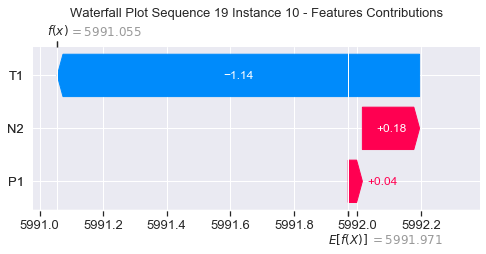

None

Contribution: [ 0.07031715 -1.15813433  0.17725134]


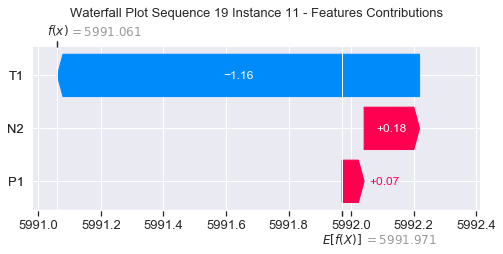

None

Contribution: [ 0.09795166 -1.2247646   0.17350473]


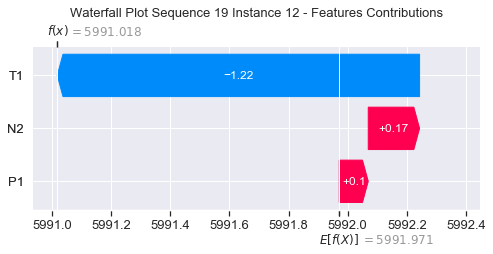

None

Contribution: [ 0.10283112 -1.29441666  0.18847057]


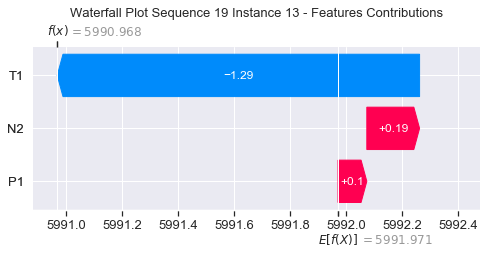

None

Contribution: [ 0.11082454 -1.43102815  0.21739717]


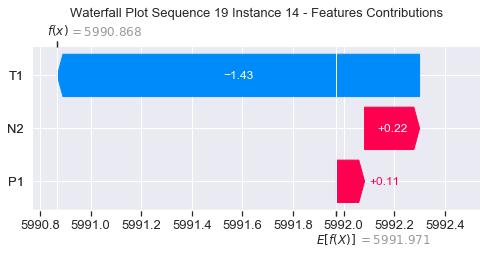

None

Contribution: [ 0.1264322  -1.60916119  0.26881894]


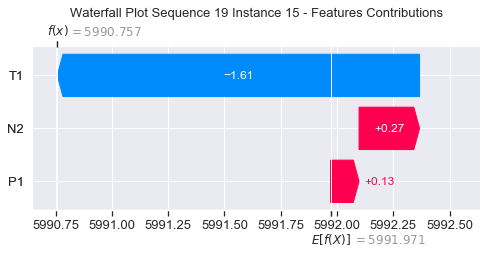

None

Contribution: [ 0.11218742 -1.82290298  0.3763379 ]


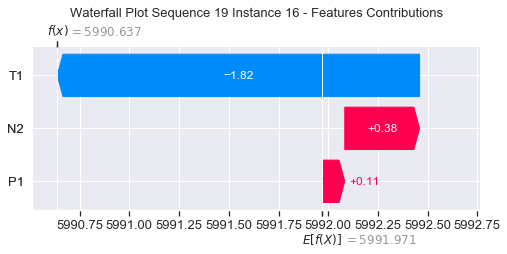

None

Contribution: [ 0.25051704 -2.33996354  0.49365591]


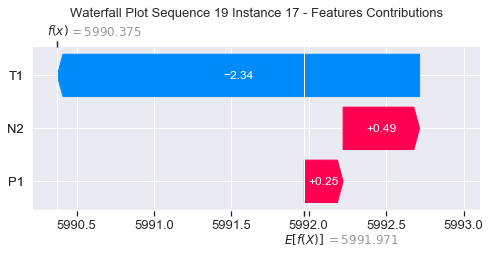

None

Contribution: [ 0.34309975 -3.17042045  0.69633473]


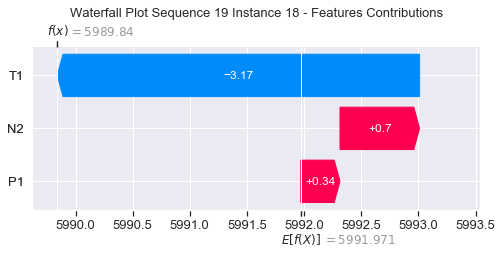

None

Contribution: [ 0.13858968 -4.62484488  1.04339954]


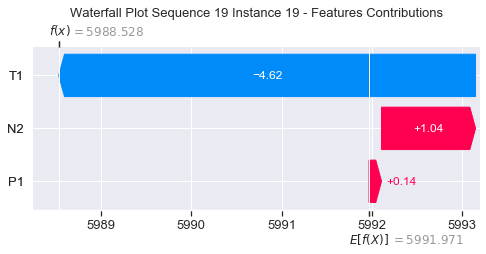

None

Contribution: [ 0.85131669 -6.71705981  1.5951621 ]


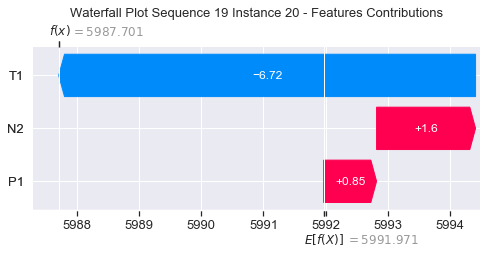

None

Contribution: [  1.3375963  -10.39231101   2.49993189]


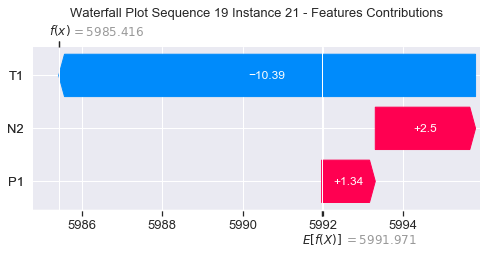

None

Contribution: [  1.78417192 -15.90920527   3.96259604]


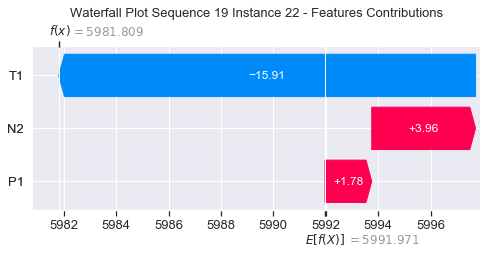

None

Contribution: [  1.62090451 -22.90817662   6.36960766]


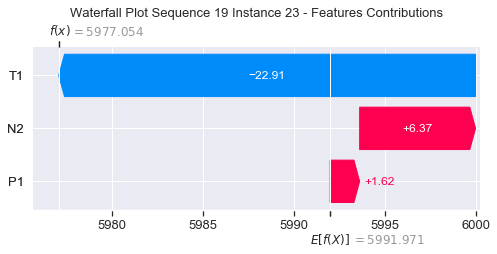

None

Contribution: [  3.03225153 -28.58519549   9.24316055]


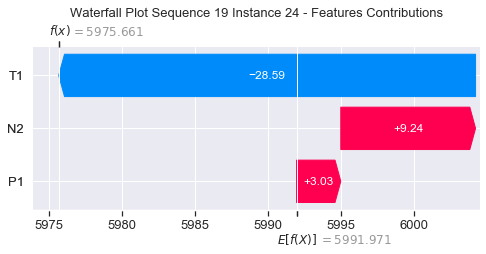

None

Contribution: [  3.90520168 -66.89105435  15.39843652]


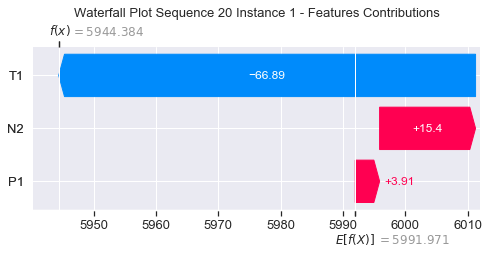

None

Contribution: [ 0.07503282 -0.31343678  0.2956835 ]


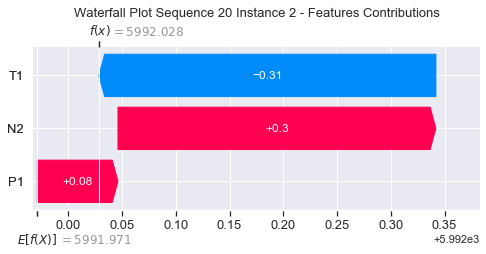

None

Contribution: [ 0.86536961 -9.20375006  1.73813027]


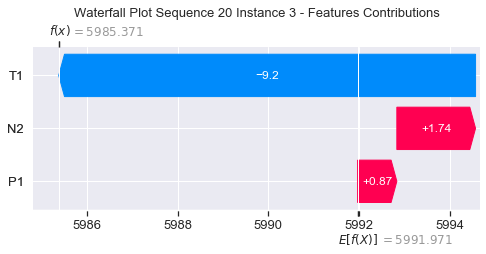

None

Contribution: [ 0.33644475 -4.50261099  0.81787403]


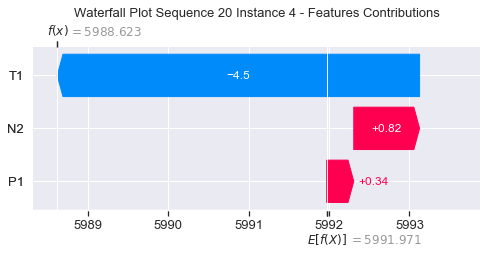

None

Contribution: [ 0.24377435 -2.66274822  0.44219773]


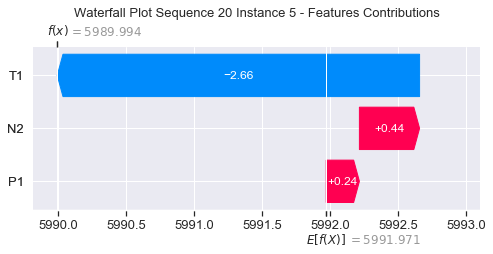

None

Contribution: [ 0.13554012 -1.81044038  0.25285822]


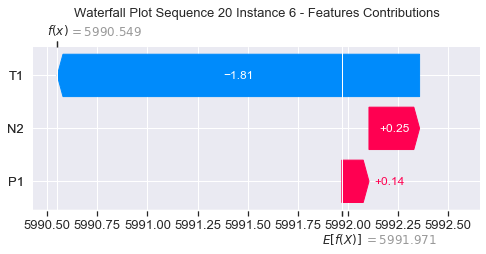

None

Contribution: [ 0.10297775 -1.50335393  0.19154113]


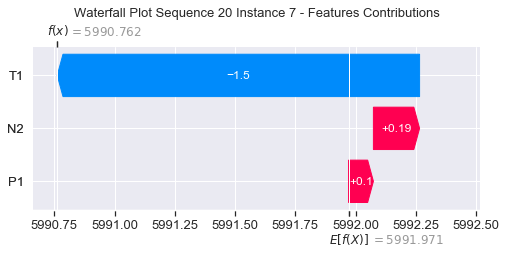

None

Contribution: [ 0.09338761 -1.35085529  0.17763826]


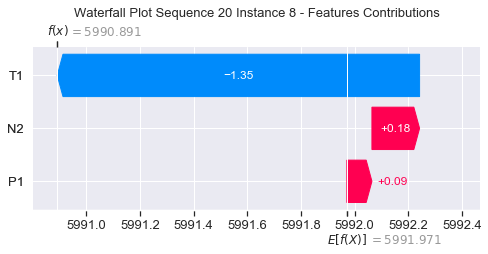

None

Contribution: [ 0.06980754 -1.26610025  0.18145038]


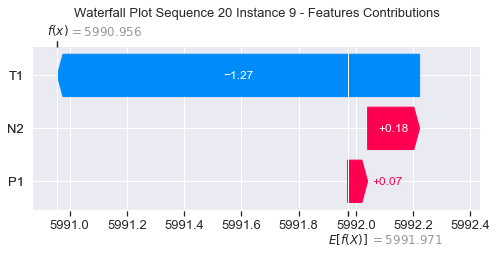

None

Contribution: [ 0.03501665 -1.13930047  0.19142333]


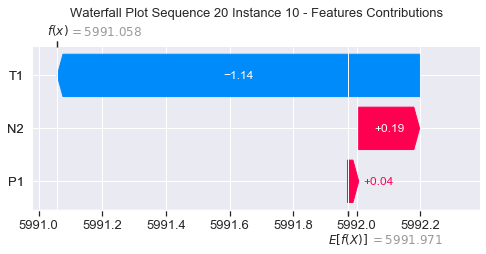

None

Contribution: [ 0.08319962 -1.23559768  0.1909593 ]


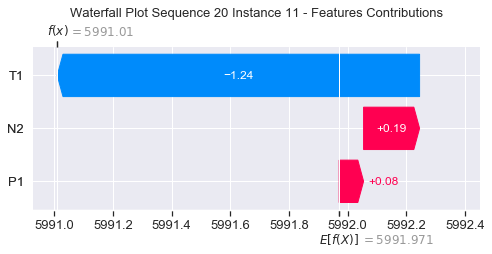

None

Contribution: [ 0.09686252 -1.33225911  0.17830445]


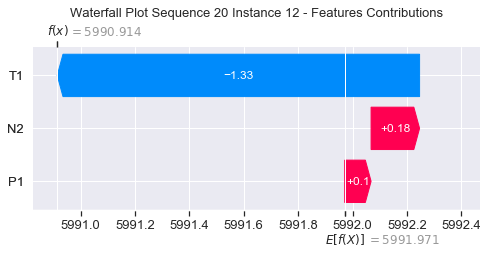

None

Contribution: [ 0.10218655 -1.39350838  0.1912947 ]


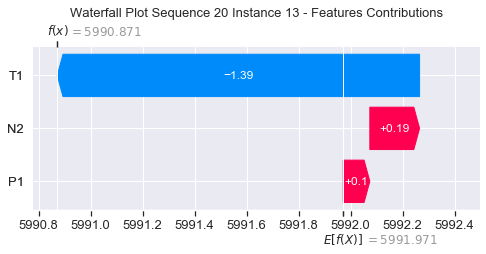

None

Contribution: [ 0.11337679 -1.51927854  0.21851837]


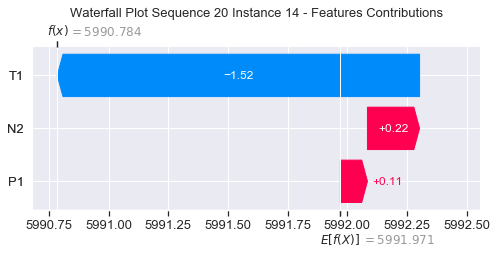

None

Contribution: [ 0.12966534 -1.66716405  0.27119856]


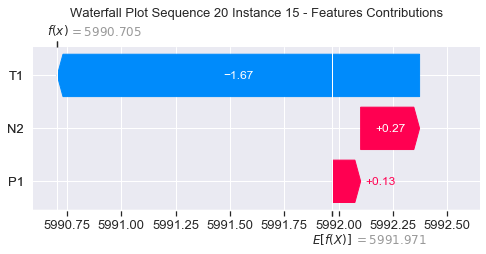

None

Contribution: [ 0.12239829 -1.93817839  0.38600603]


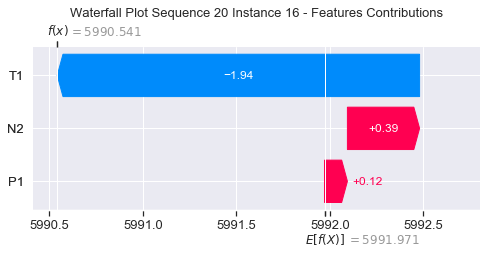

None

Contribution: [ 0.25431078 -2.31586343  0.50895725]


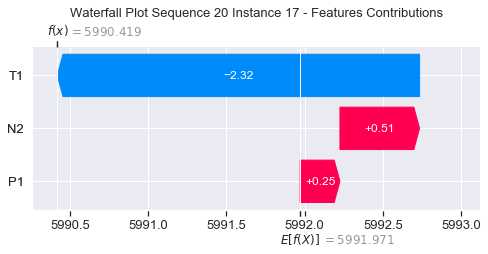

None

Contribution: [ 0.34648542 -3.0724402   0.72329035]


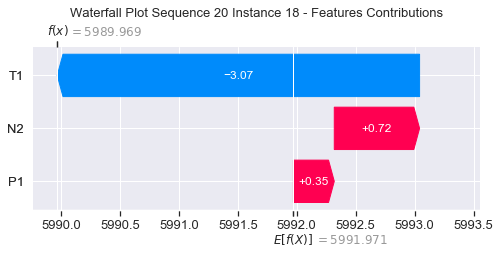

None

Contribution: [ 0.40488121 -4.3939401   1.16669336]


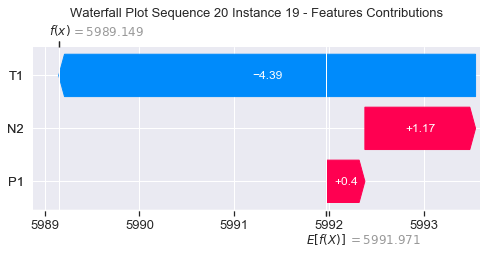

None

Contribution: [ 0.86614418 -6.51336404  1.7064856 ]


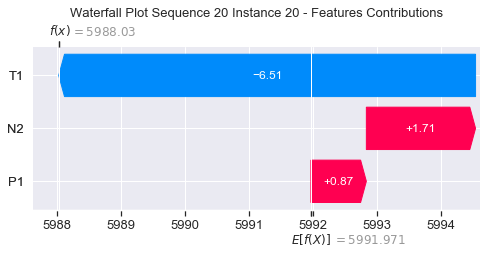

None

Contribution: [ 1.41746752 -9.7668202   2.65518536]


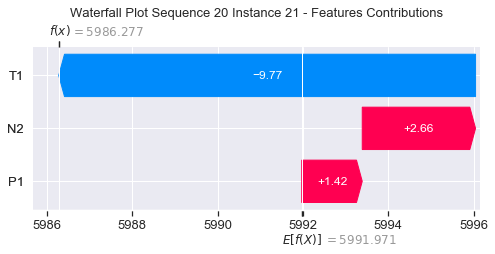

None

Contribution: [  2.00316112 -14.53410977   4.1334604 ]


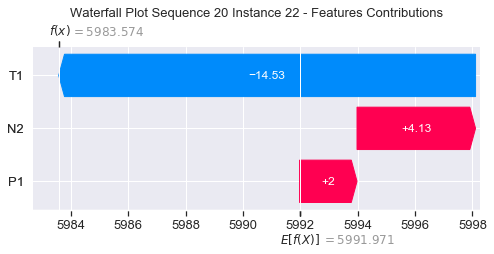

None

Contribution: [  1.83204276 -21.22791303   6.61131146]


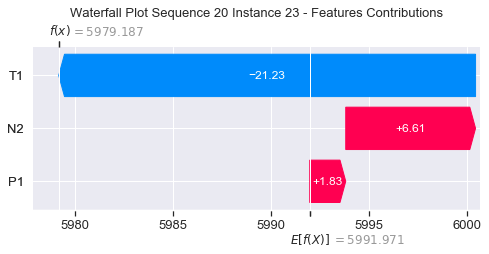

None

Contribution: [  4.10126744 -26.37721718   9.60755871]


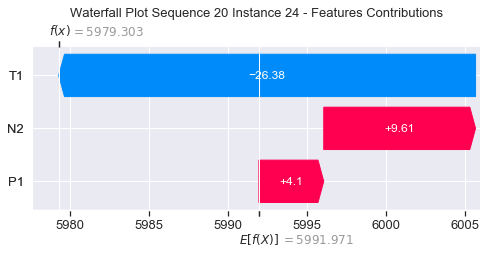

None

Contribution: [  8.90416905 -57.63753323  16.69491798]


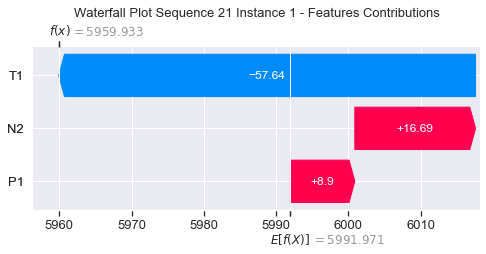

None

Contribution: [ 0.06761025 -0.25795786  0.29905517]


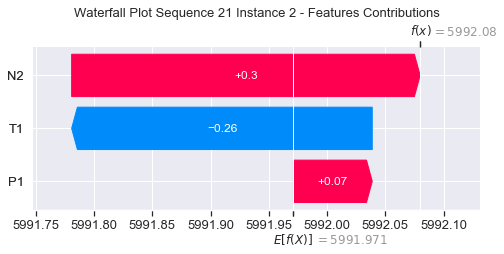

None

Contribution: [ 0.98676919 -7.25933215  1.76737755]


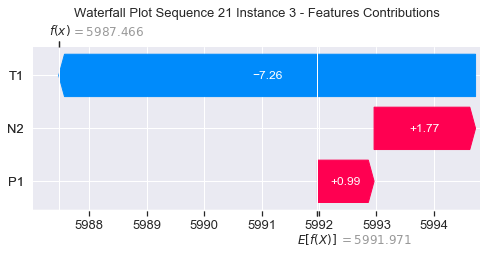

None

Contribution: [ 0.49091411 -3.89030694  0.84595778]


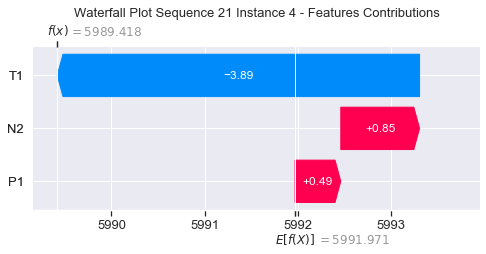

None

Contribution: [ 0.23969386 -2.51667101  0.44790118]


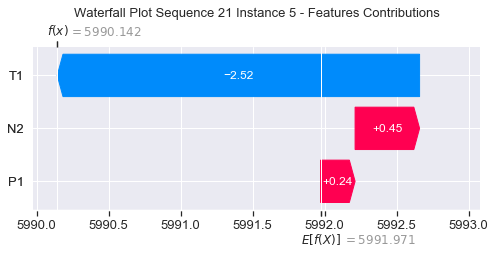

None

Contribution: [ 0.13002841 -1.6980153   0.25948252]


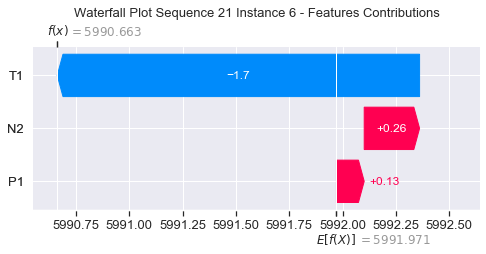

None

Contribution: [ 0.09243823 -1.41575041  0.19317156]


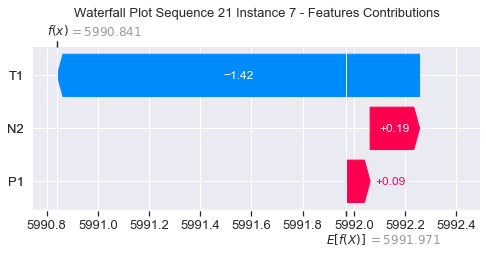

None

Contribution: [ 0.07813183 -1.27823037  0.17178248]


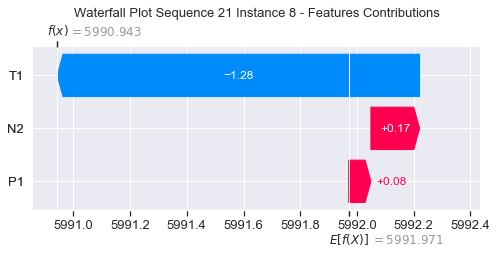

None

Contribution: [ 0.04442935 -1.1948102   0.17658754]


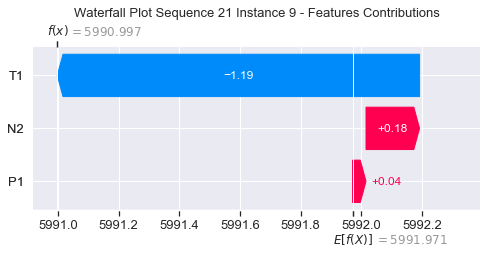

None

Contribution: [ 0.07195154 -1.12831757  0.1818554 ]


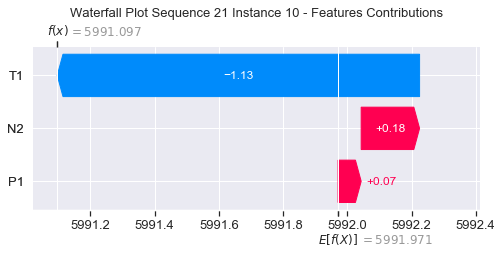

None

Contribution: [ 0.04602899 -1.16645691  0.17415567]


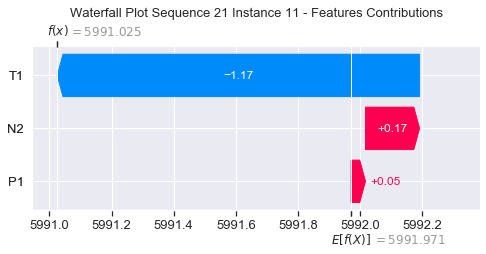

None

Contribution: [ 0.09512739 -1.21936837  0.16932281]


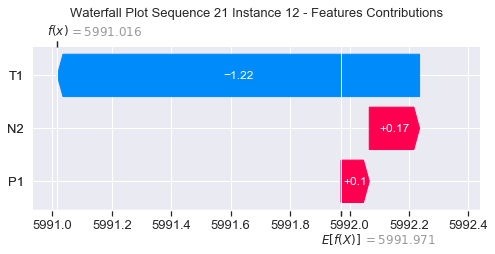

None

Contribution: [ 0.1020897  -1.28153286  0.18571068]


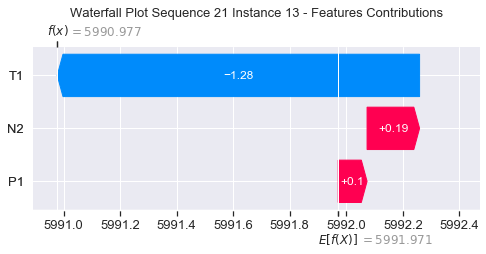

None

Contribution: [ 0.11064154 -1.41479223  0.21621738]


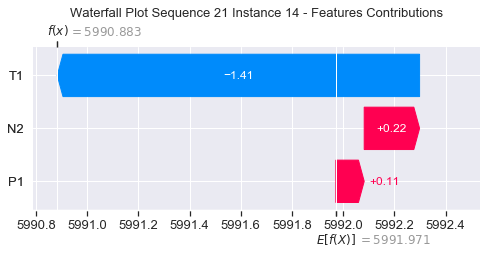

None

Contribution: [ 0.12925188 -1.59000529  0.27319173]


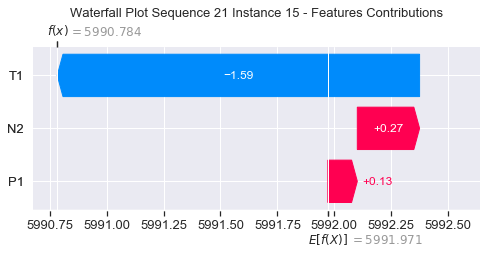

None

Contribution: [ 0.13191461 -1.82777156  0.3917881 ]


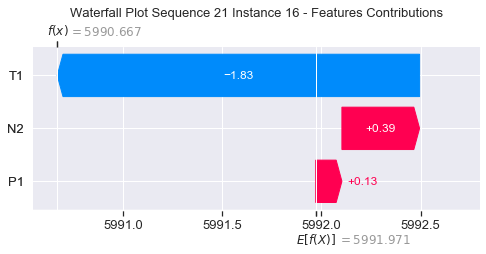

None

Contribution: [ 0.25527218 -2.36703013  0.52717934]


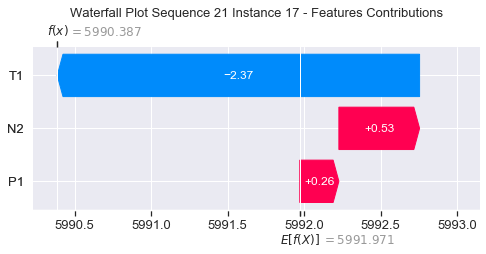

None

Contribution: [ 0.37721622 -3.2421139   0.77533768]


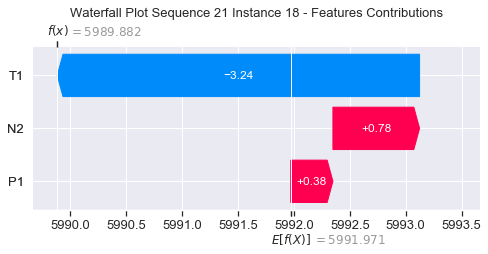

None

Contribution: [ 0.47512065 -4.9690603   1.25717651]


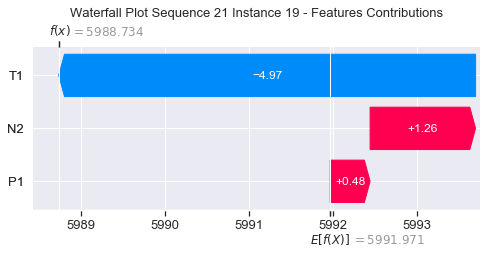

None

Contribution: [ 0.86263754 -7.3328384   1.80934178]


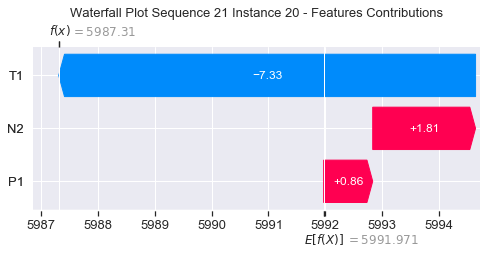

None

Contribution: [  1.26810412 -11.58971048   2.84877739]


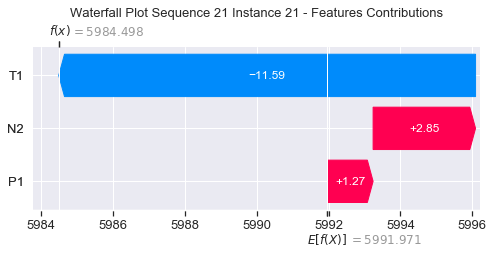

None

Contribution: [  1.68734841 -17.9291305    4.55533803]


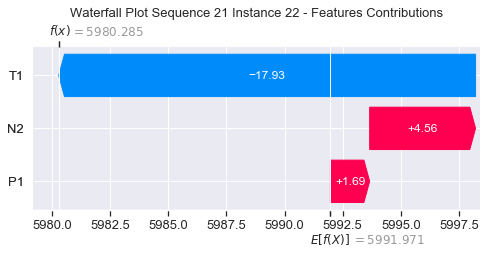

None

Contribution: [  1.88751142 -25.48870842   7.4839031 ]


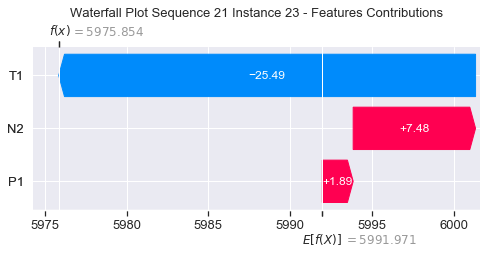

None

Contribution: [  3.00480579 -32.0525502   10.51969888]


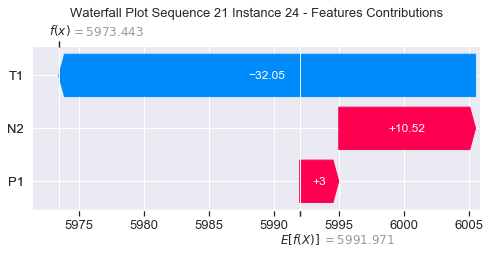

None

Contribution: [  1.12865168 -76.81781249  16.64193186]


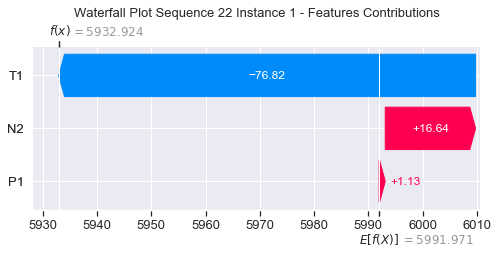

None

Contribution: [ 0.08878479 -0.37175573  0.27939157]


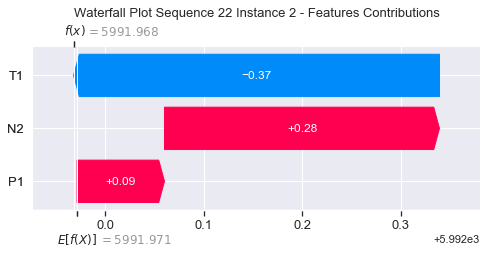

None

Contribution: [  0.92803074 -10.60095122   1.97124328]


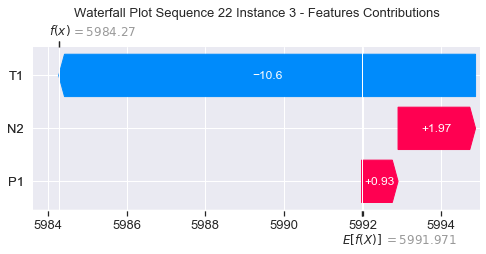

None

Contribution: [ 0.47450101 -5.16217538  0.86169936]


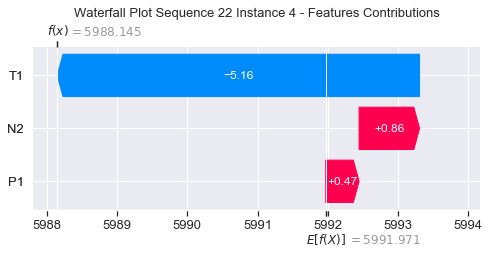

None

Contribution: [ 0.22854654 -2.95567281  0.41819743]


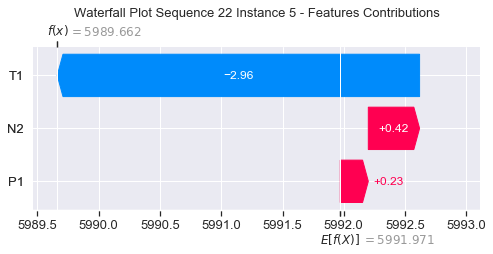

None

Contribution: [ 0.13369953 -1.88203877  0.25428356]


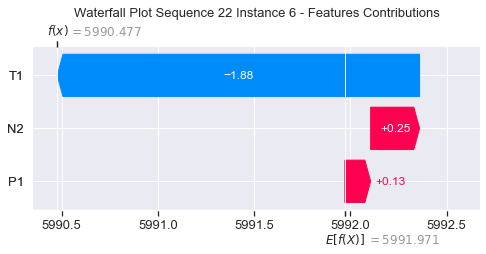

None

Contribution: [ 0.09799497 -1.52033594  0.20522981]


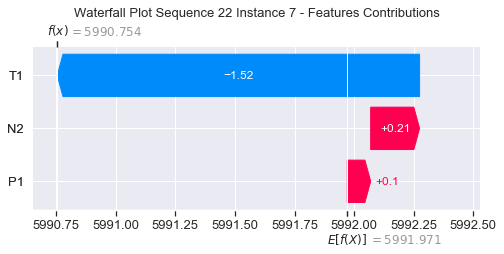

None

Contribution: [ 0.0932544  -1.36986718  0.19613274]


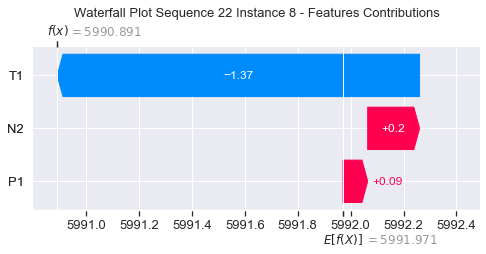

None

Contribution: [ 0.06900287 -1.30320327  0.21588381]


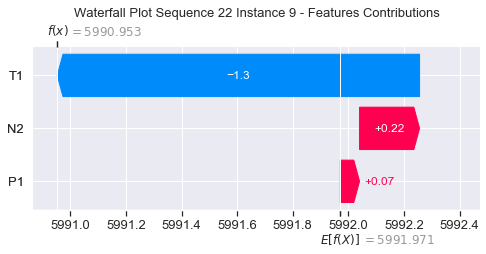

None

Contribution: [ 0.04883415 -1.28367649  0.21185289]


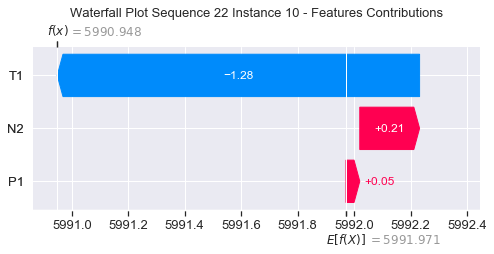

None

Contribution: [ 0.09359667 -1.34125392  0.21670811]


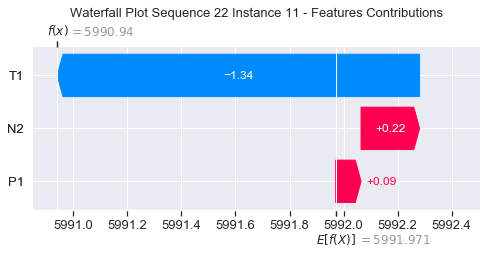

None

Contribution: [ 0.10840707 -1.41215664  0.19215368]


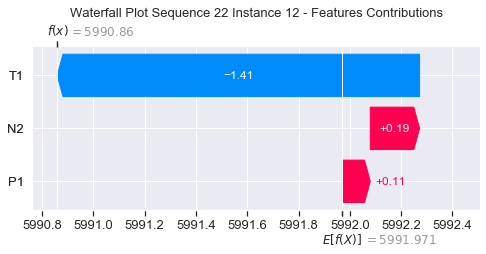

None

Contribution: [ 0.10981432 -1.48732448  0.20273725]


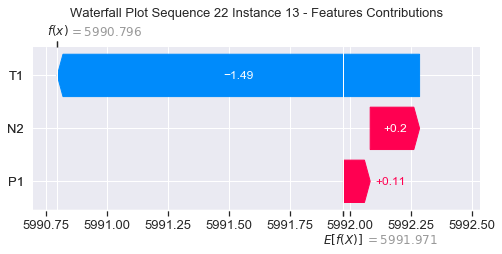

None

Contribution: [ 0.12082868 -1.6428257   0.22503593]


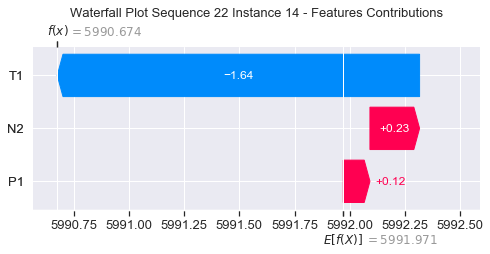

None

Contribution: [ 0.13375281 -1.81804778  0.27652684]


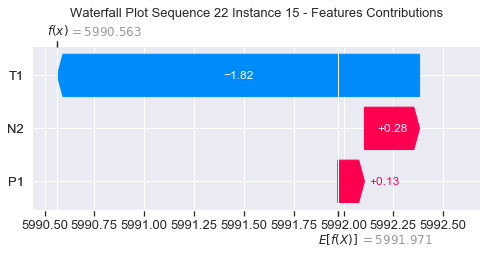

None

Contribution: [ 0.14295286 -2.07129236  0.3911691 ]


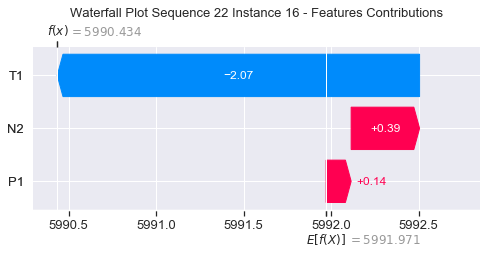

None

Contribution: [ 0.27285564 -2.5129345   0.50624092]


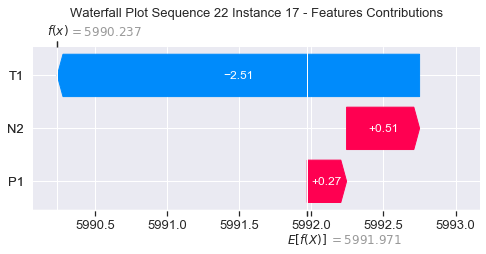

None

Contribution: [ 0.38787992 -3.20367862  0.72996964]


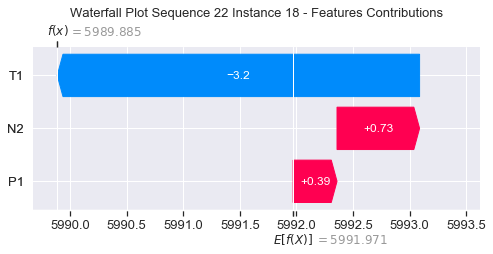

None

Contribution: [ 0.18074758 -4.62507922  1.13560375]


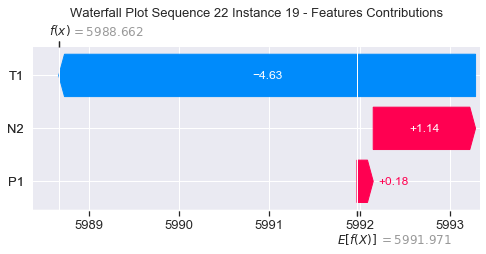

None

Contribution: [ 1.01865971 -6.51735227  1.74459507]


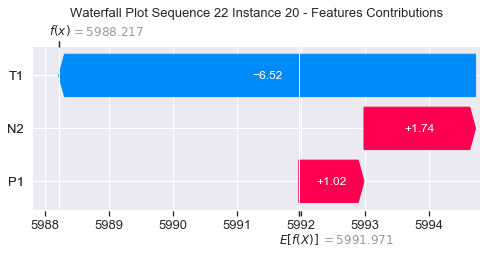

None

Contribution: [ 1.55089859 -9.59664796  2.7672724 ]


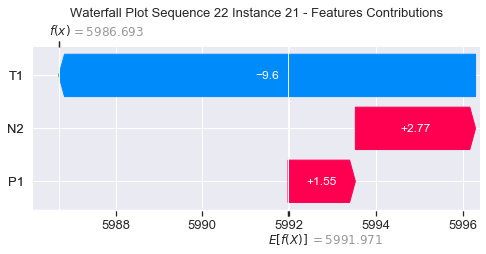

None

Contribution: [  2.00862468 -14.01379762   4.43587545]


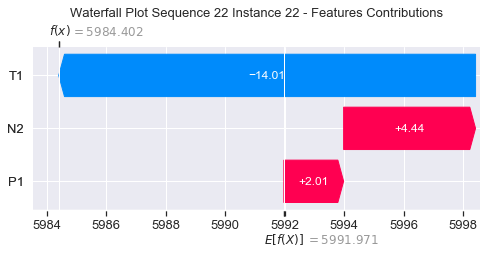

None

Contribution: [  2.03029903 -18.72551886   7.17070569]


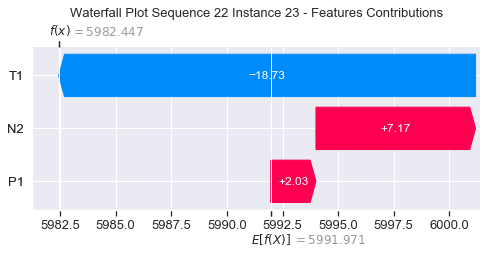

None

Contribution: [  3.52517787 -24.48756845  10.65172929]


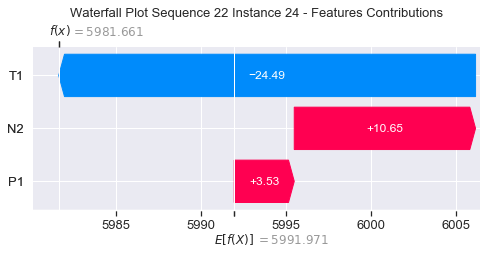

None

Contribution: [  4.07208839 -61.01053794  18.93094762]


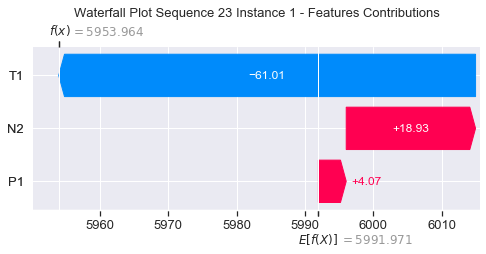

None

Contribution: [ 0.07520871 -0.27670551  0.28695086]


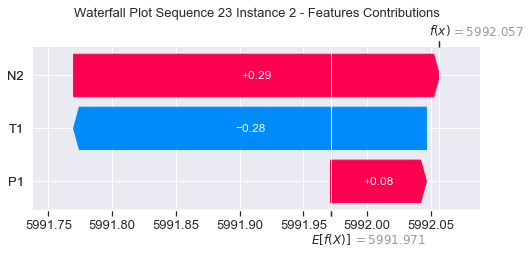

None

Contribution: [  0.40392994 -10.20057522   1.88183423]


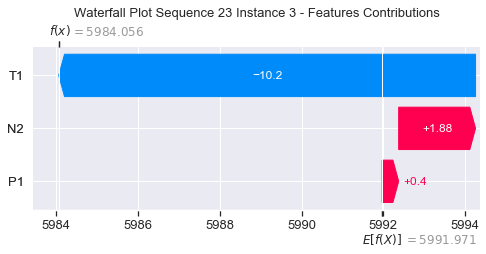

None

Contribution: [ 0.24890409 -4.78846275  0.84282298]


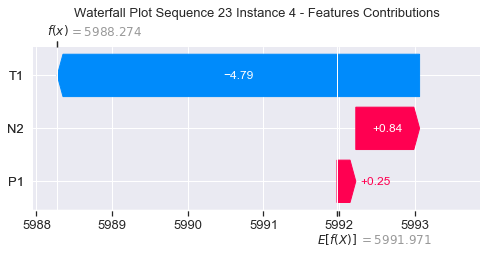

None

Contribution: [ 0.23242817 -2.71189362  0.44616575]


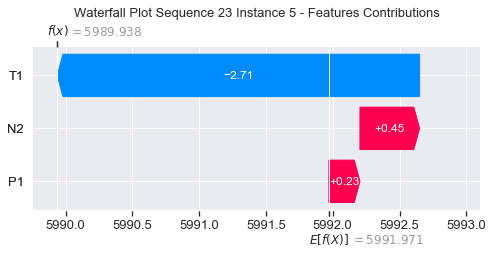

None

Contribution: [ 0.12860285 -1.76674977  0.25063298]


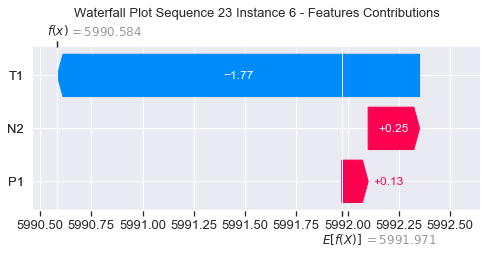

None

Contribution: [ 0.09179403 -1.45237813  0.18788756]


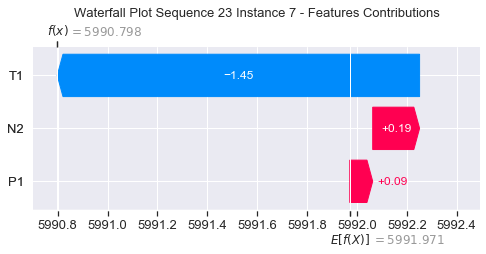

None

Contribution: [ 0.08228702 -1.30454151  0.17178998]


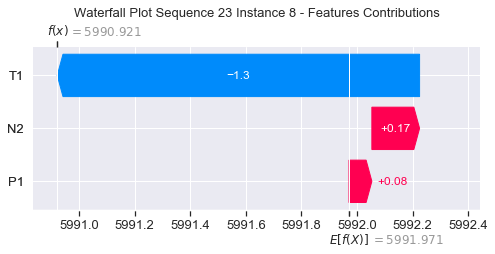

None

Contribution: [ 0.04637551 -1.24202781  0.17599026]


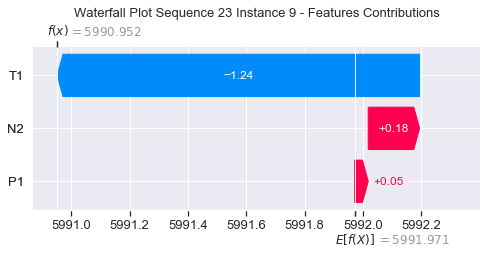

None

Contribution: [ 0.03011751 -1.18062009  0.17984185]


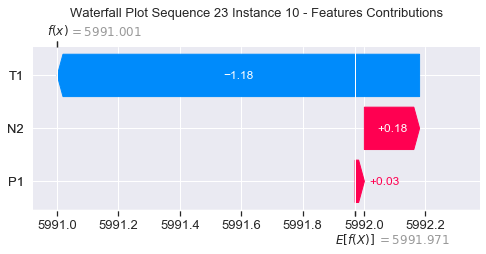

None

Contribution: [ 0.05830851 -1.21997254  0.17849317]


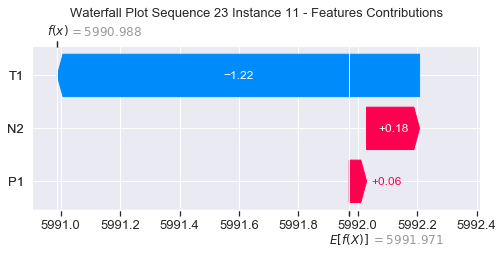

None

Contribution: [ 0.09222522 -1.28895006  0.17168135]


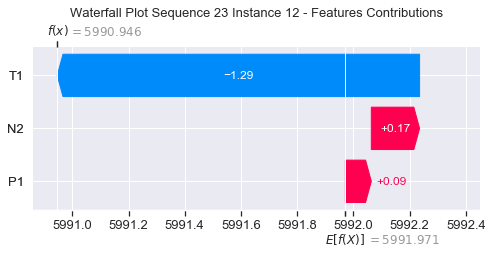

None

Contribution: [ 0.10007551 -1.35450774  0.18733538]


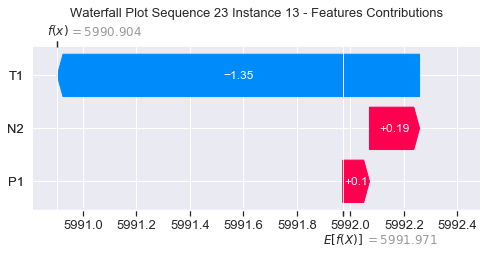

None

Contribution: [ 0.11149541 -1.48963233  0.21709435]


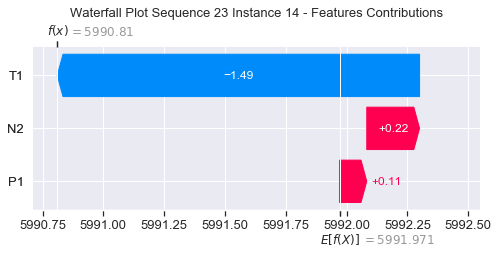

None

Contribution: [ 0.13229978 -1.65381904  0.27544094]


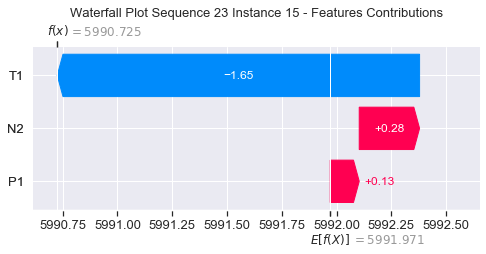

None

Contribution: [ 0.09877466 -1.90825715  0.38416308]


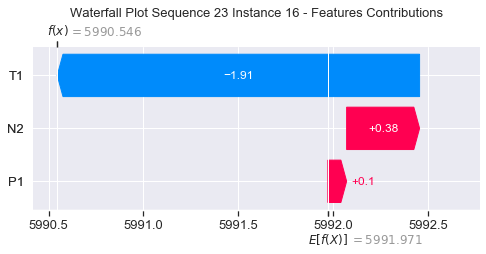

None

Contribution: [ 0.27877682 -2.32881764  0.53479514]


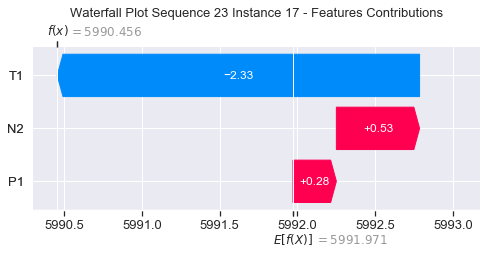

None

Contribution: [ 0.39813444 -3.07728434  0.7787612 ]


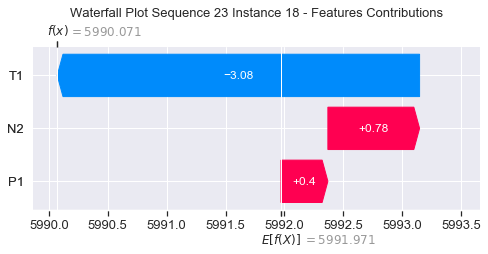

None

Contribution: [ 0.38551887 -4.64472906  1.12792123]


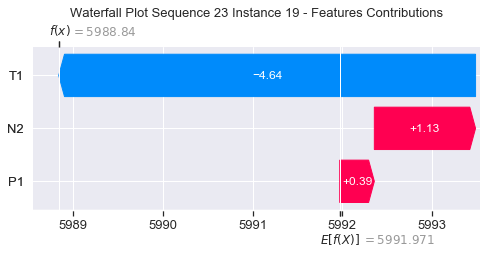

None

Contribution: [ 0.88367578 -6.5938349   1.8262514 ]


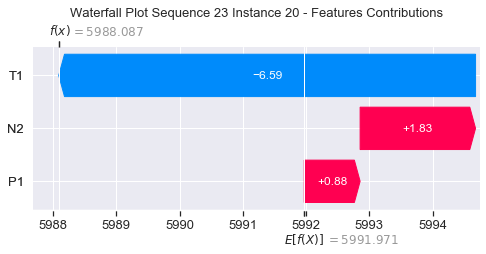

None

Contribution: [  1.33005497 -10.10222711   2.87032091]


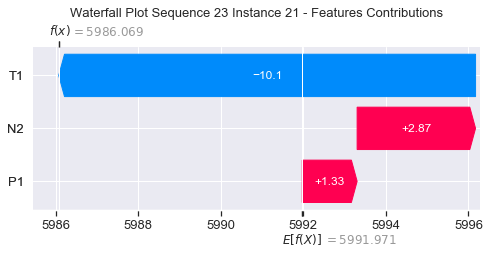

None

Contribution: [  1.651977   -15.35092293   4.51890254]


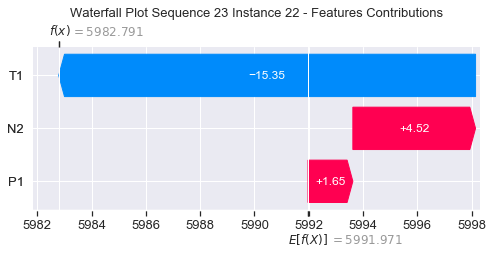

None

Contribution: [  1.68887139 -21.44421372   7.29435504]


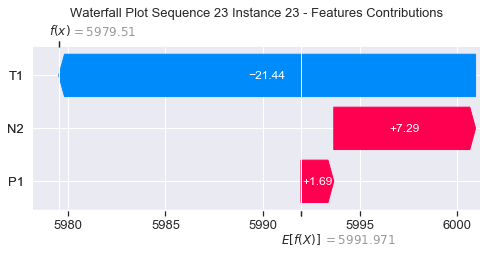

None

Contribution: [  4.495046   -26.78302781  10.86088224]


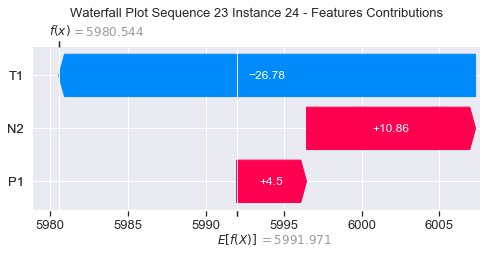

None

Contribution: [ 12.90256333 -58.16860485  20.3722993 ]


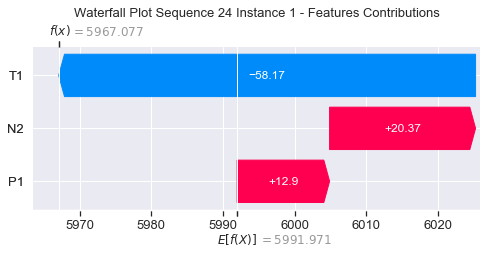

None

Contribution: [ 0.0827557  -0.27317106  0.29341154]


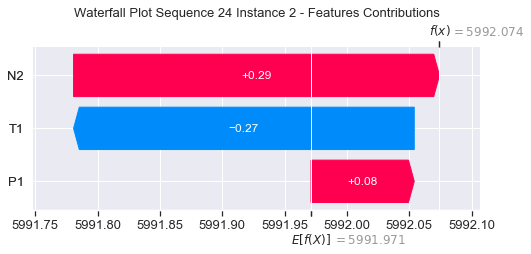

None

Contribution: [ 0.9660048  -8.8359967   2.04785244]


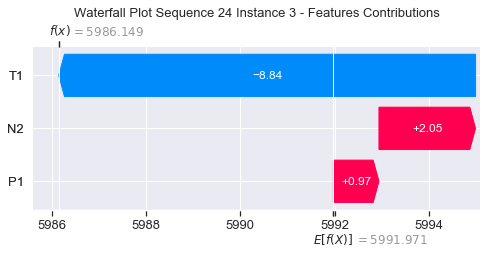

None

Contribution: [ 0.57350927 -4.54893796  0.9266327 ]


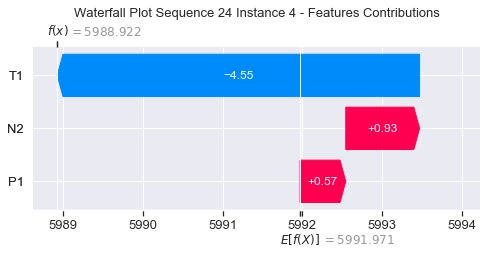

None

Contribution: [ 0.24947817 -2.63501149  0.46133877]


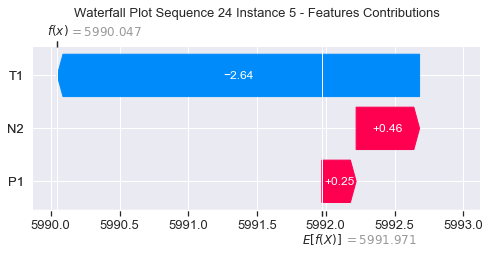

None

Contribution: [ 0.13110028 -1.67053352  0.25933206]


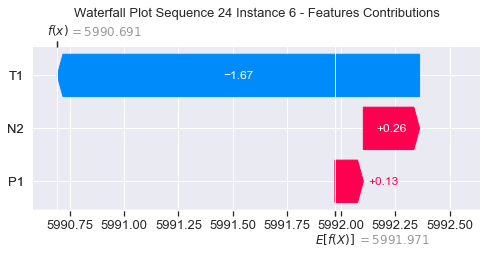

None

Contribution: [ 0.09234783 -1.35566927  0.19007969]


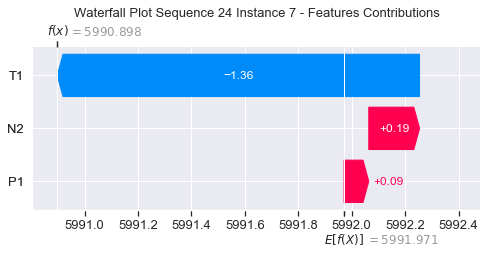

None

Contribution: [ 0.08143837 -1.22205089  0.1710025 ]


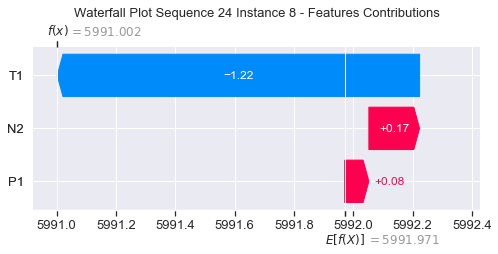

None

Contribution: [ 0.05632529 -1.15759594  0.17841636]


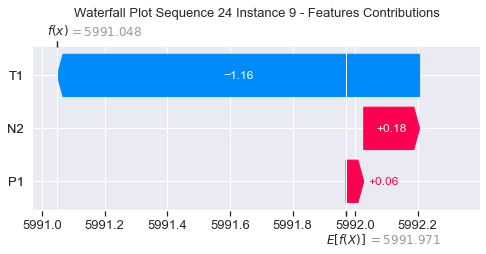

None

Contribution: [ 0.03904293 -1.07762276  0.17958022]


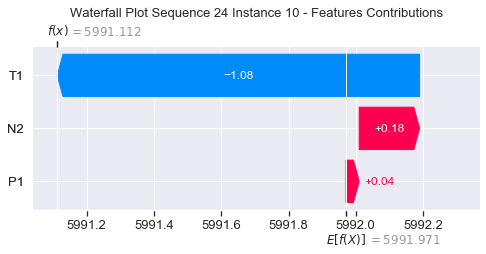

None

Contribution: [ 0.0621883  -1.13075423  0.17930408]


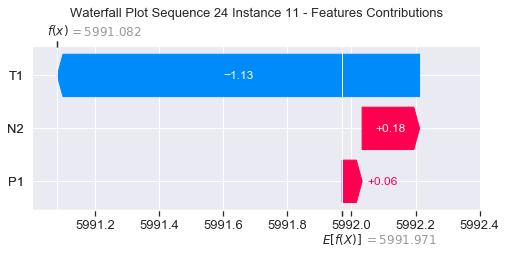

None

Contribution: [ 0.08620367 -1.19952678  0.16947433]


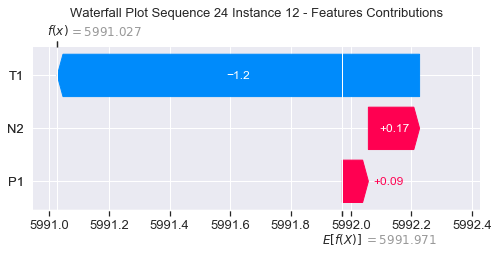

None

Contribution: [ 0.09641834 -1.27231804  0.18681774]


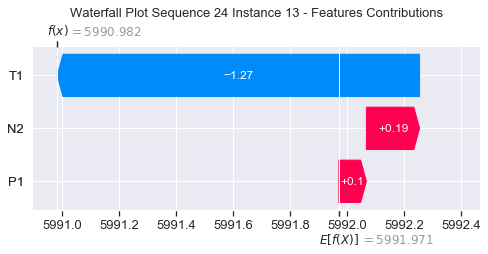

None

Contribution: [ 0.11023983 -1.41048045  0.21797245]


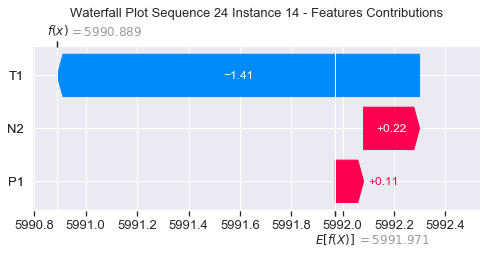

None

Contribution: [ 0.13767878 -1.57910736  0.27953135]


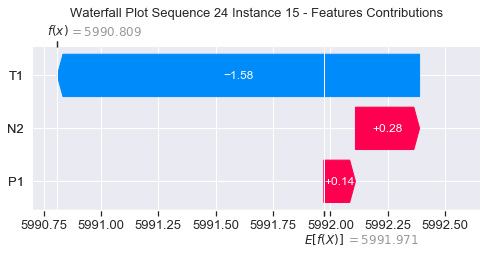

None

Contribution: [ 0.10317459 -1.90537843  0.37832444]


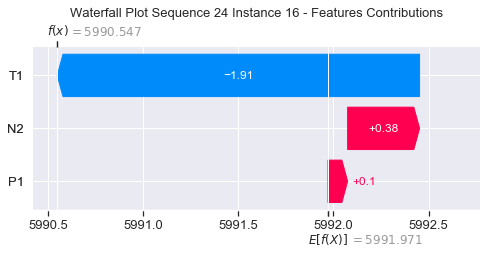

None

Contribution: [ 0.29903248 -2.20581204  0.54858787]


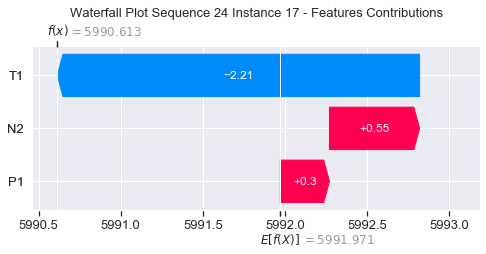

None

Contribution: [ 0.43304858 -2.83886417  0.80294207]


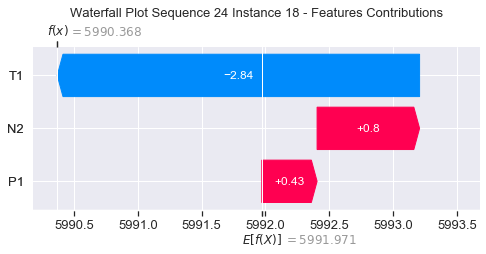

None

Contribution: [ 0.37726849 -3.90237574  1.39592983]


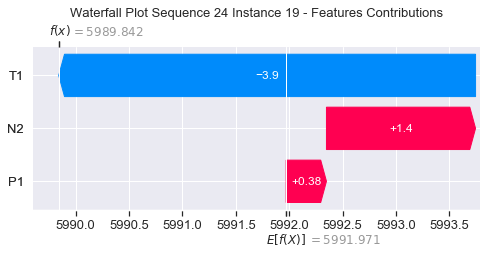

None

Contribution: [ 1.00695519 -5.36438912  1.87196978]


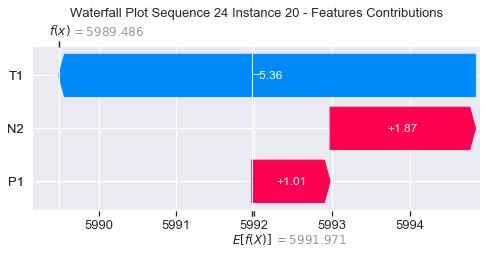

None

Contribution: [ 1.61176353 -8.103785    2.92927698]


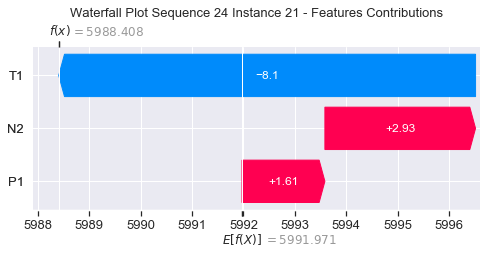

None

Contribution: [  2.29142484 -11.90335623   4.62447401]


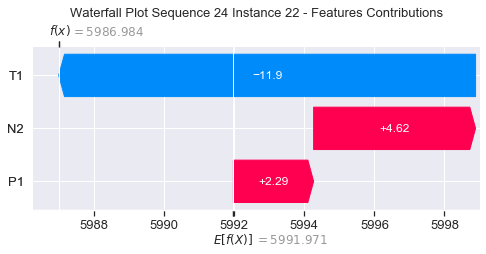

None

Contribution: [  2.47815255 -16.39446244   7.51059241]


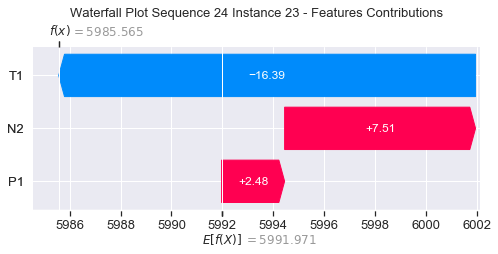

None

Contribution: [  4.59525445 -19.48313511  10.74804195]


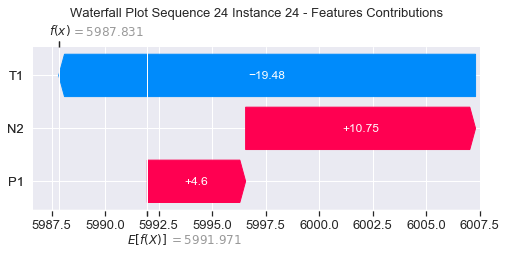

None

Contribution: [  9.01049109 -48.60070081  18.91887963]


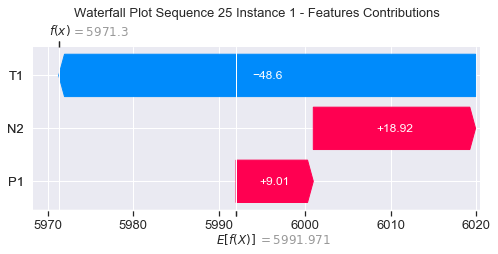

None

Contribution: [ 0.06842852 -0.23188998  0.29420015]


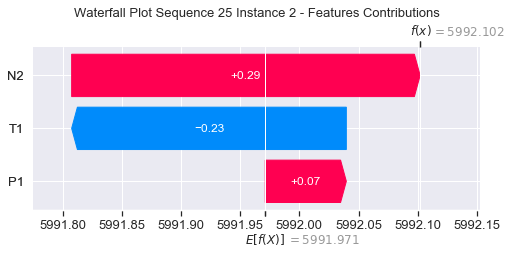

None

Contribution: [ 1.20235829 -8.01980613  2.08787604]


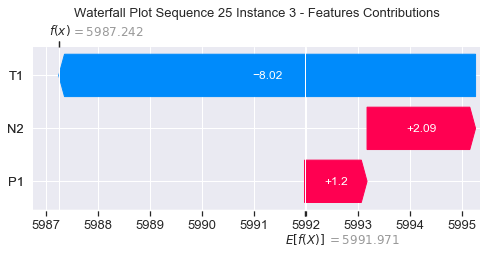

None

Contribution: [ 0.31706366 -4.35817745  0.88561981]


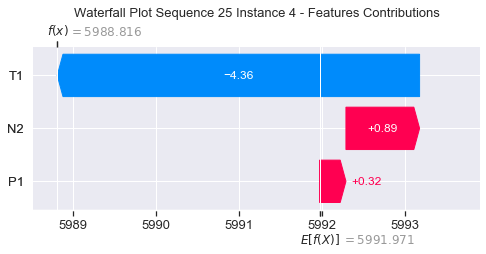

None

Contribution: [ 0.2229674  -2.45233092  0.45617102]


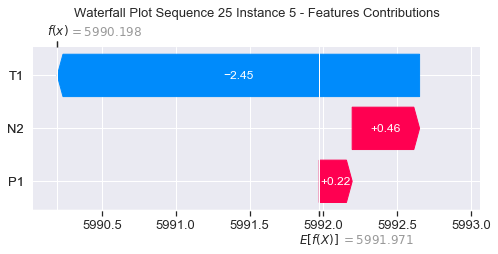

None

Contribution: [ 0.13445876 -1.63597377  0.26424164]


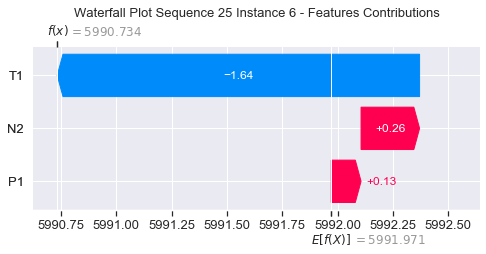

None

Contribution: [ 0.10514709 -1.34664501  0.19585084]


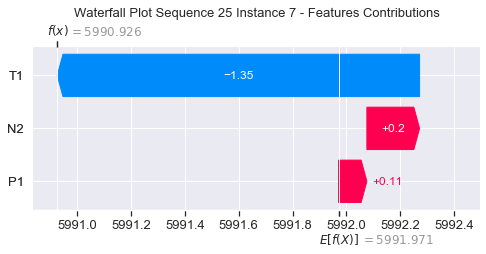

None

Contribution: [ 0.09127854 -1.22586905  0.17390592]


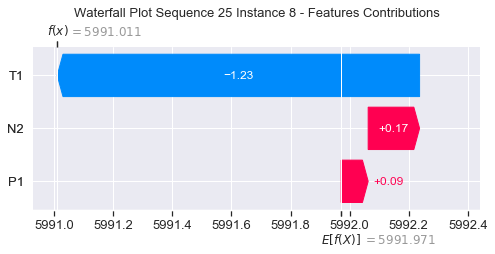

None

Contribution: [ 0.04842606 -1.16182876  0.17374881]


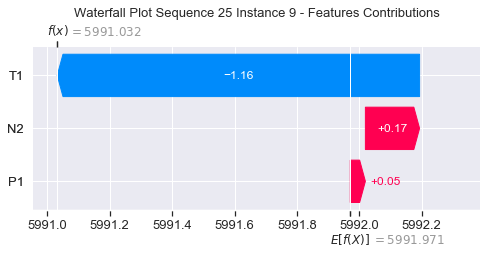

None

Contribution: [ 0.06847187 -1.06797755  0.18241739]


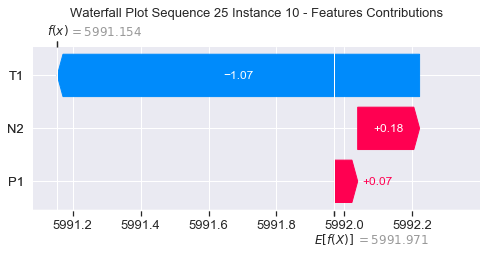

None

Contribution: [ 0.0530166  -1.14984932  0.17413675]


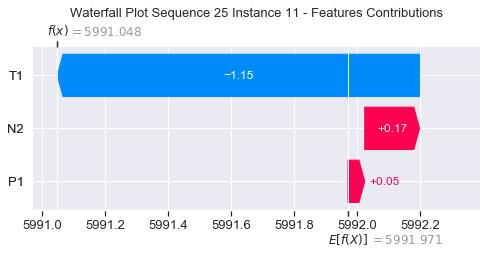

None

Contribution: [ 0.09356764 -1.19414961  0.17010843]


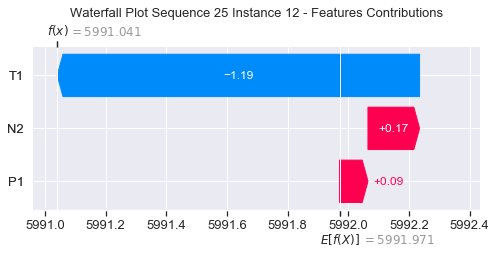

None

Contribution: [ 0.10069557 -1.24880998  0.18718858]


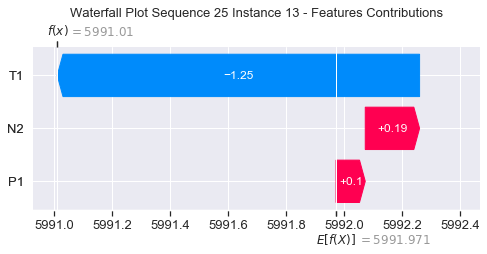

None

Contribution: [ 0.10972907 -1.36720719  0.21766341]


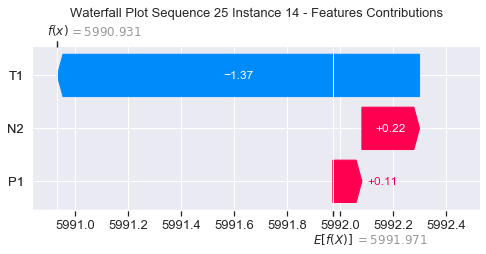

None

Contribution: [ 0.12508853 -1.50408014  0.27749644]


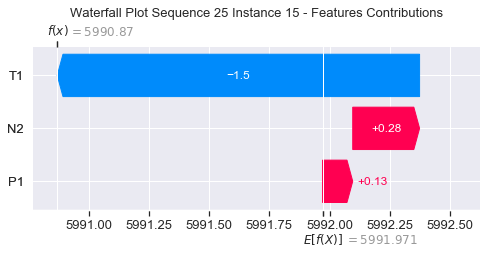

None

Contribution: [ 0.05828132 -1.80946373  0.374495  ]


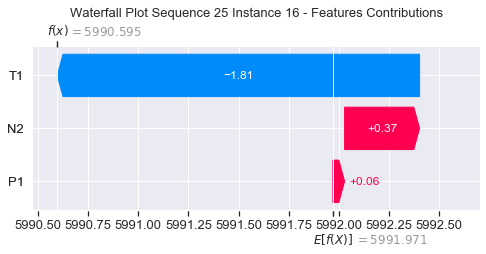

None

Contribution: [ 0.23607804 -2.07010796  0.54029582]


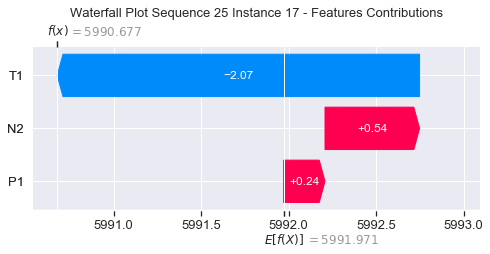

None

Contribution: [ 0.32660325 -2.65312131  0.79118743]


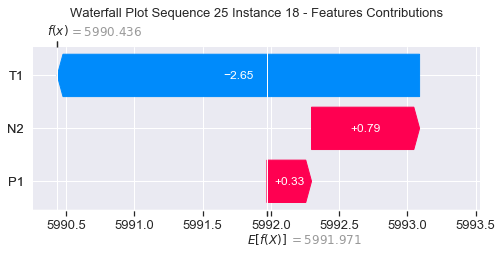

None

Contribution: [ 0.53561591 -3.76533221  1.30030869]


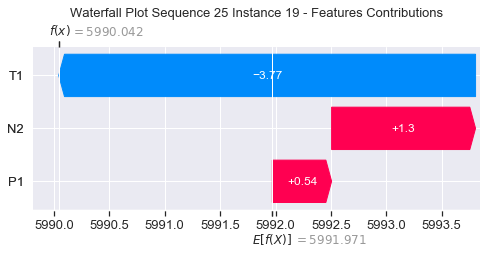

None

Contribution: [ 0.72432697 -5.15081669  1.84241391]


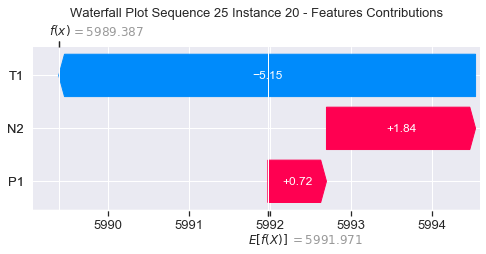

None

Contribution: [ 1.18422474 -7.58176367  2.91384779]


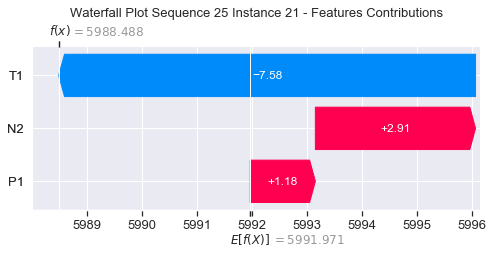

None

Contribution: [  1.68869543 -10.68683056   4.63863517]


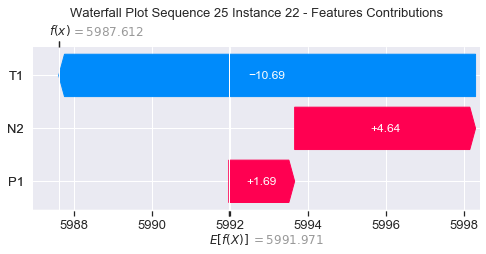

None

Contribution: [  1.66445825 -14.95796153   7.56825276]


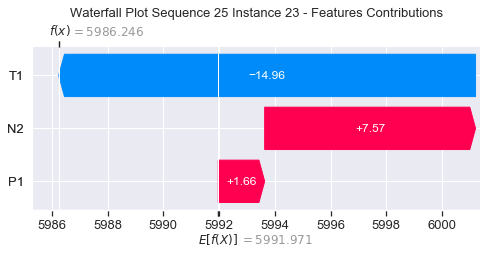

None

Contribution: [  3.60765725 -17.49643595  11.14099188]


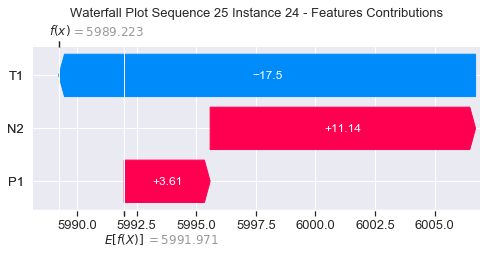

None

Contribution: [  7.95435403 -43.30603347  21.32395593]


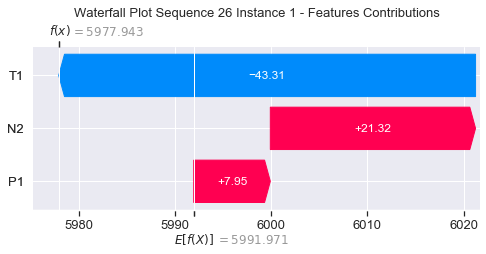

None

Contribution: [ 0.07668257 -0.19719776  0.29734717]


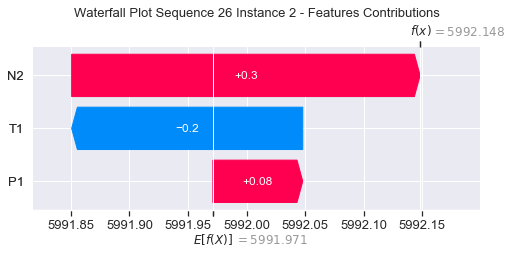

None

Contribution: [ 1.12654021 -6.68725977  2.18020345]


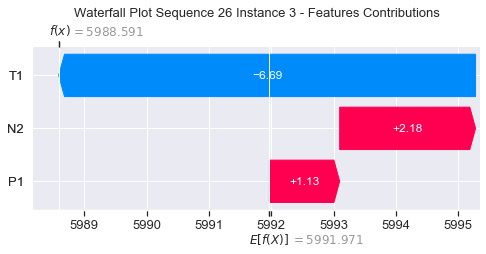

None

Contribution: [ 0.45337492 -3.73485581  0.96824385]


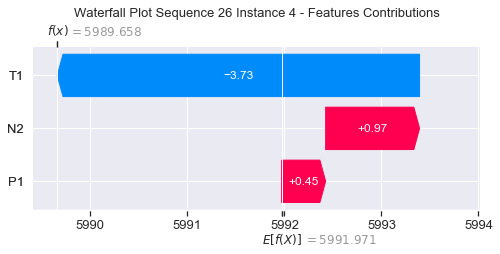

None

Contribution: [ 0.24278941 -2.25997488  0.48541977]


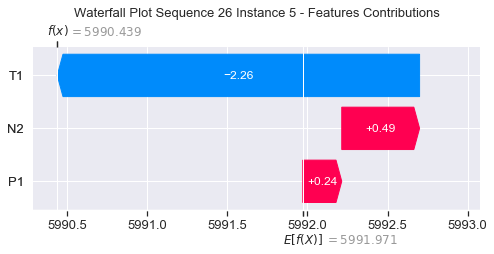

None

Contribution: [ 0.13276869 -1.55401832  0.27125529]


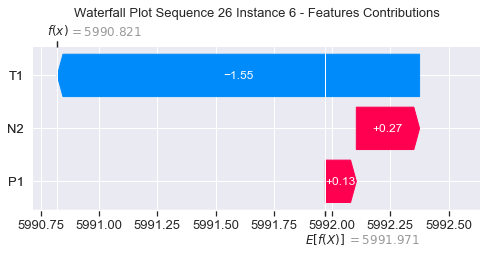

None

Contribution: [ 0.10210917 -1.30079655  0.19643339]


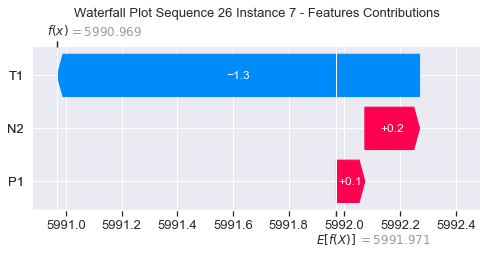

None

Contribution: [ 0.08824897 -1.18760546  0.1711062 ]


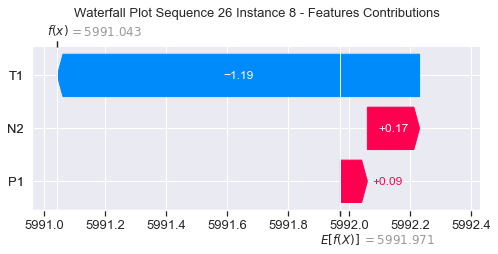

None

Contribution: [ 0.05189543 -1.1253797   0.17375462]


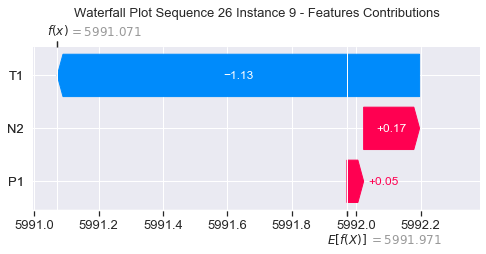

None

Contribution: [ 0.04329352 -1.0591212   0.1752681 ]


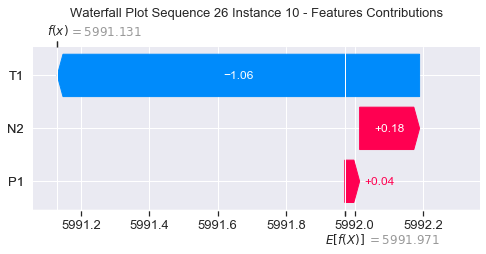

None

Contribution: [ 0.05330973 -1.09066885  0.17345567]


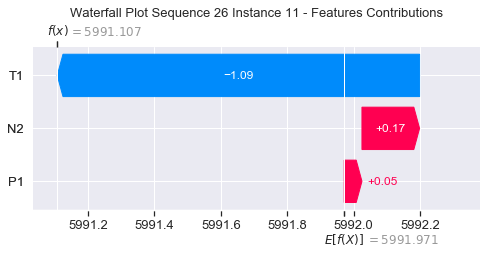

None

Contribution: [ 0.08462681 -1.14237876  0.16730774]


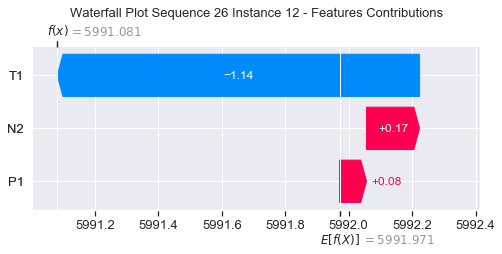

None

Contribution: [ 0.0963521  -1.18744347  0.18603312]


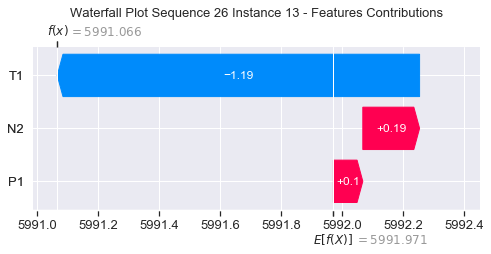

None

Contribution: [ 0.10798117 -1.29003751  0.21827889]


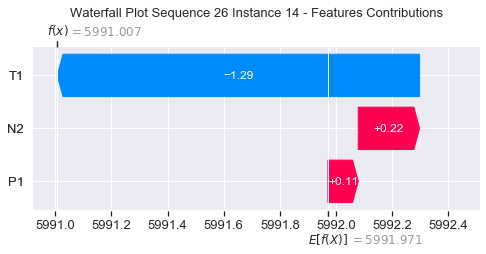

None

Contribution: [ 0.13168689 -1.41724936  0.28034413]


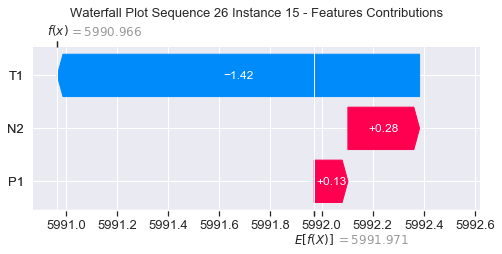

None

Contribution: [ 0.11644941 -1.55728558  0.40115736]


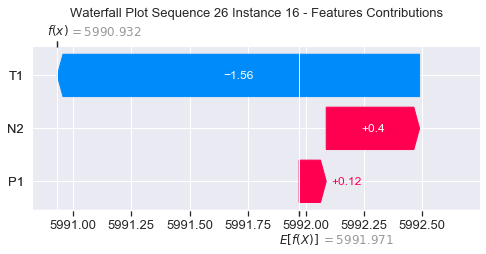

None

Contribution: [ 0.25490845 -1.93873014  0.5446927 ]


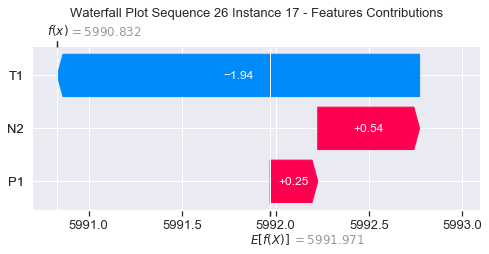

None

Contribution: [ 0.33812342 -2.52999835  0.79038455]


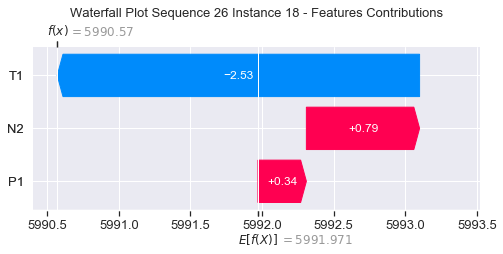

None

Contribution: [ 0.34904287 -3.43226013  1.22867364]


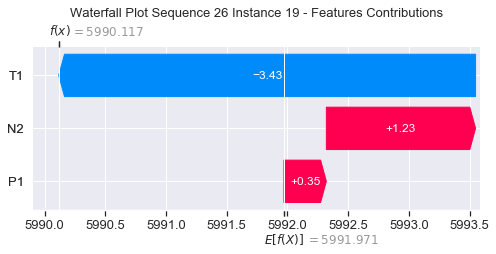

None

Contribution: [ 0.64700386 -5.11513971  1.81490123]


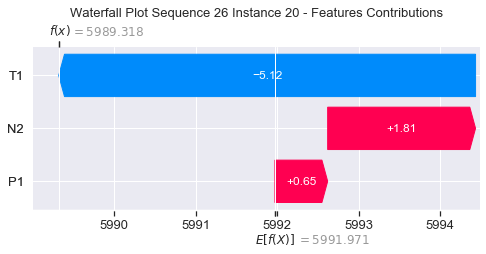

None

Contribution: [ 1.17683012 -7.79083533  2.88218585]


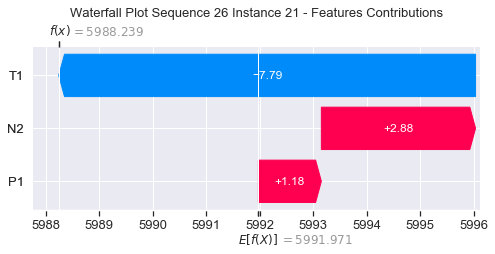

None

Contribution: [  1.77215453 -11.64340827   4.60065477]


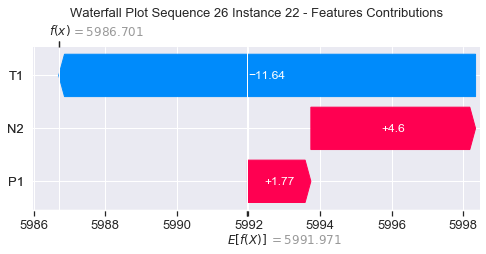

None

Contribution: [  1.59942987 -16.56073459   7.41415101]


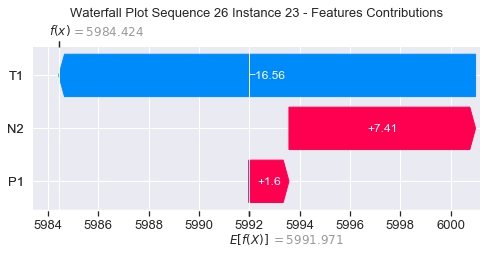

None

Contribution: [  3.00955869 -20.2059578   10.55492668]


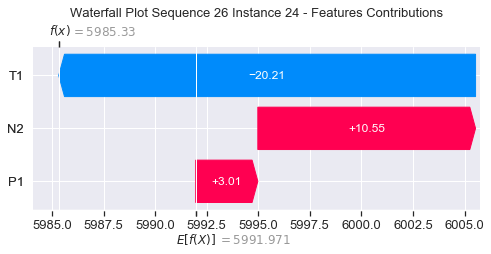

None

Contribution: [  6.63437659 -50.23956777  18.44949926]


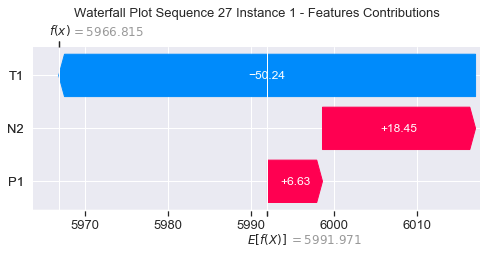

None

Contribution: [ 0.06373388 -0.23582721  0.29260637]


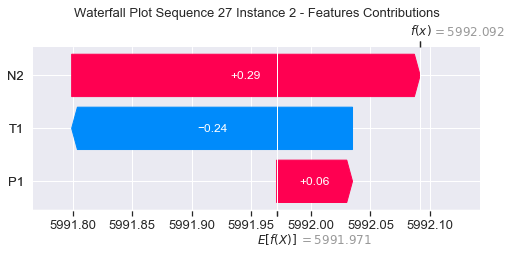

None

Contribution: [ 1.07189432 -8.27197425  2.131742  ]


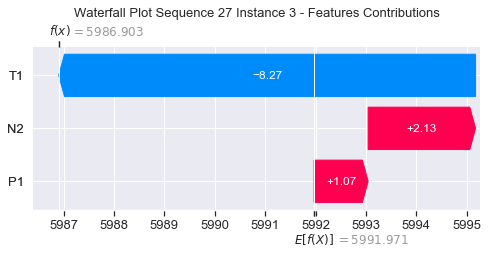

None

Contribution: [ 0.4758457  -4.02223333  0.93611737]


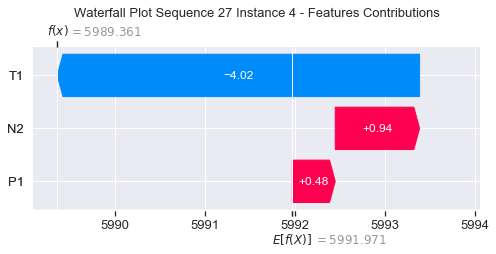

None

Contribution: [ 0.19725127 -2.53376654  0.45217674]


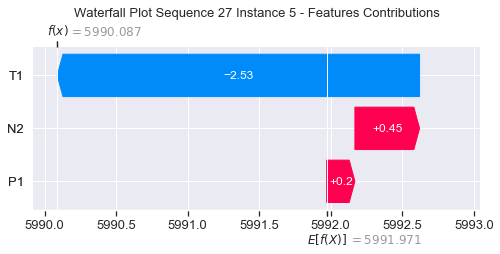

None

Contribution: [ 0.13382156 -1.6493553   0.26272526]


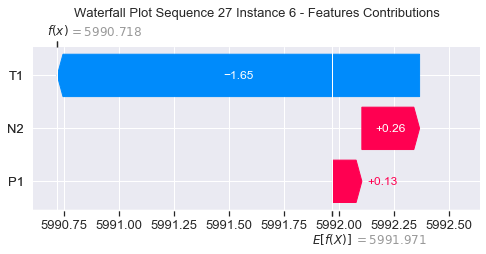

None

Contribution: [ 0.10246644 -1.36710489  0.19500803]


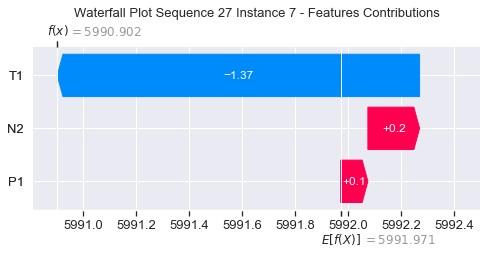

None

Contribution: [ 0.09142555 -1.23765958  0.17405897]


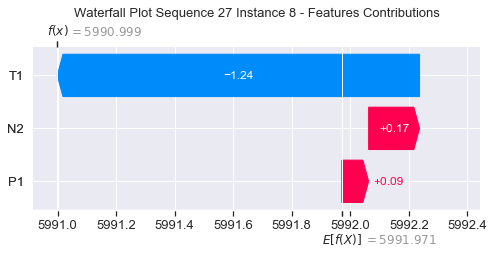

None

Contribution: [ 0.06259216 -1.17845476  0.17919471]


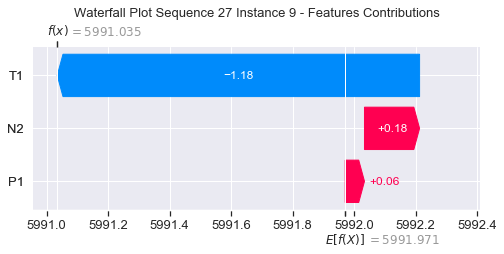

None

Contribution: [ 0.05320273 -1.10661249  0.18174545]


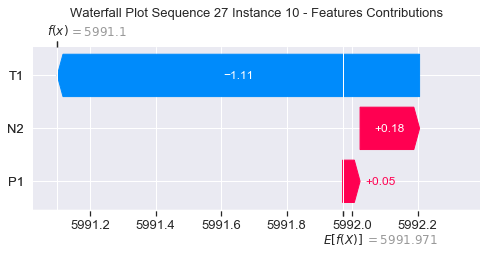

None

Contribution: [ 0.0654185 -1.1353548  0.1788446]


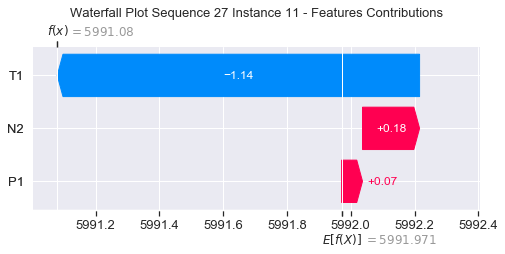

None

Contribution: [ 0.0997848  -1.19083801  0.17359677]


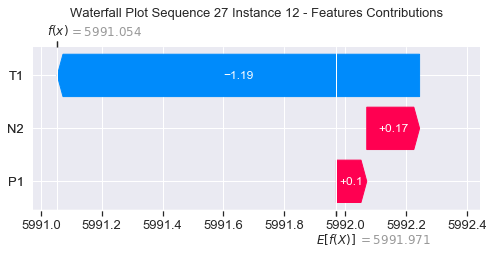

None

Contribution: [ 0.10417366 -1.25399096  0.18869581]


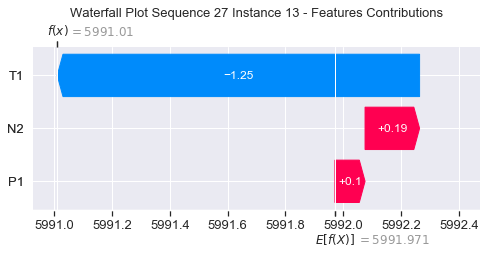

None

Contribution: [ 0.10781866 -1.37524741  0.21713701]


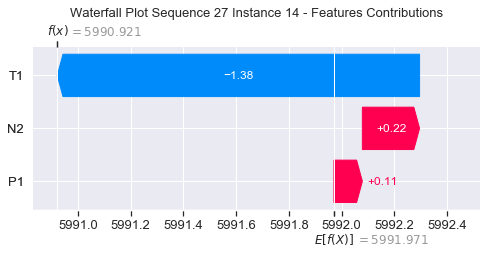

None

Contribution: [ 0.11757316 -1.51837597  0.27099672]


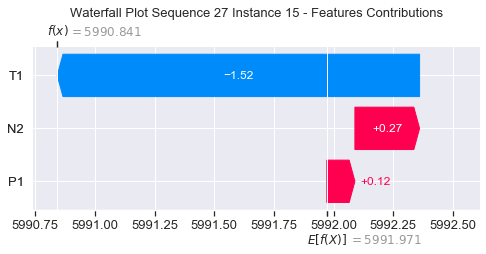

None

Contribution: [ 0.12027951 -1.66190045  0.38939794]


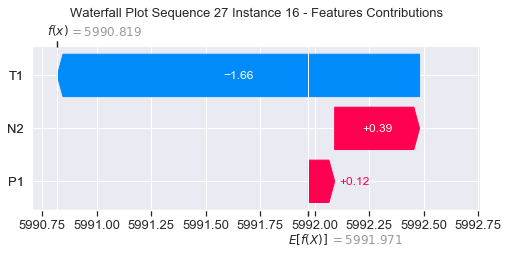

None

Contribution: [ 0.22267148 -2.01392232  0.51470963]


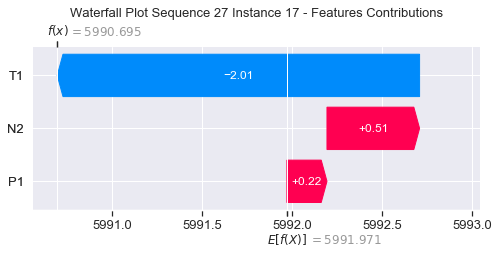

None

Contribution: [ 0.32101091 -2.52502765  0.75094626]


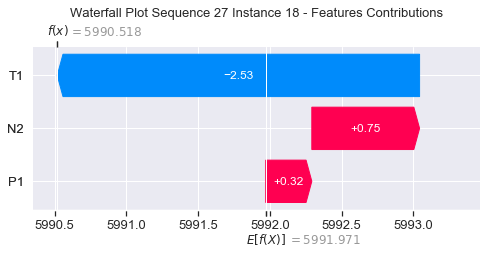

None

Contribution: [ 0.29206554 -3.5877604   1.12252113]


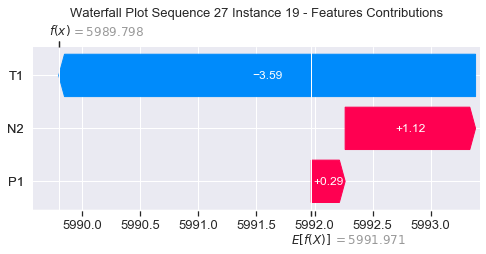

None

Contribution: [ 0.69750383 -4.65879383  1.75524271]


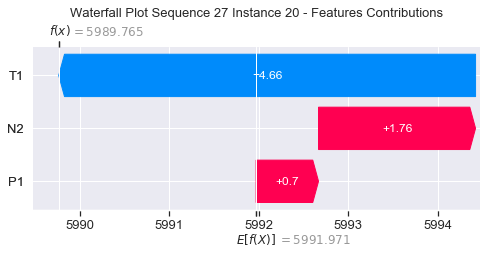

None

Contribution: [ 0.96319115 -7.22693315  2.71644657]


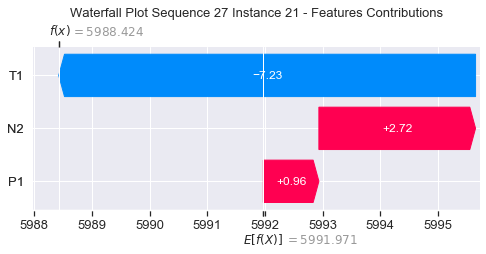

None

Contribution: [  1.02587382 -11.09621295   4.25528608]


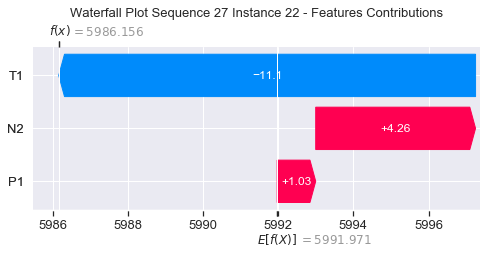

None

Contribution: [  1.12823212 -14.94809708   7.05828131]


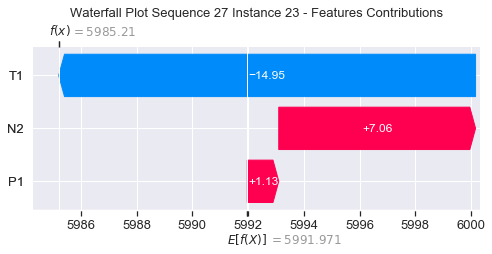

None

Contribution: [  2.73432905 -17.21675522  10.32700983]


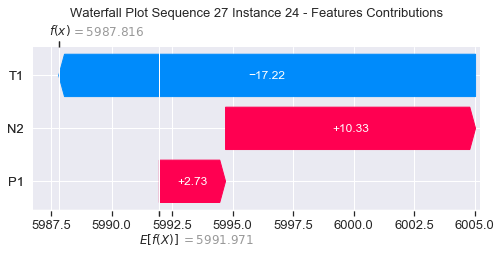

None

Contribution: [  4.2931492  -42.42407712  17.74074148]


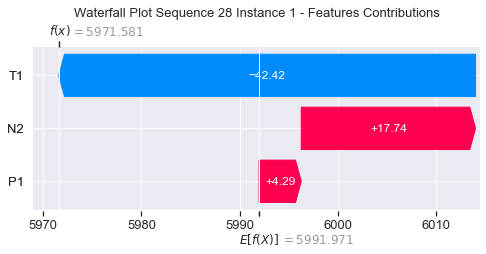

None

Contribution: [ 0.09871321 -0.22256058  0.30342872]


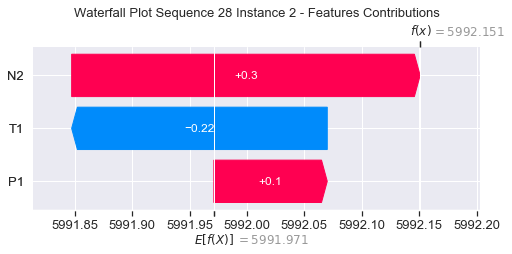

None

Contribution: [-0.02404445 -7.94389085  1.76004739]


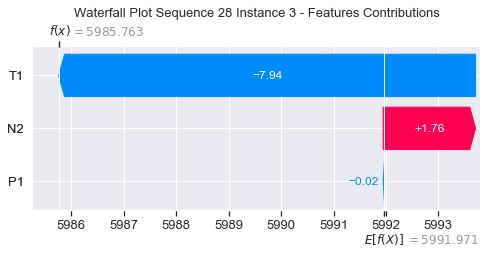

None

Contribution: [ 0.48590826 -3.94253486  0.89265627]


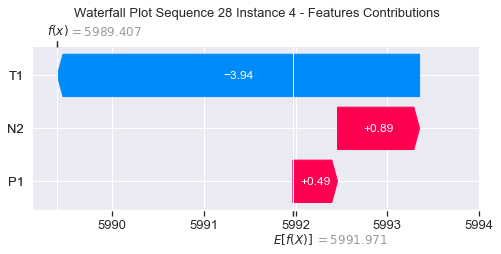

None

Contribution: [ 0.2836945  -2.39541117  0.46933725]


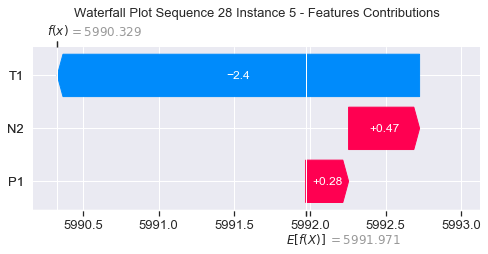

None

Contribution: [ 0.13274268 -1.6200921   0.26313746]


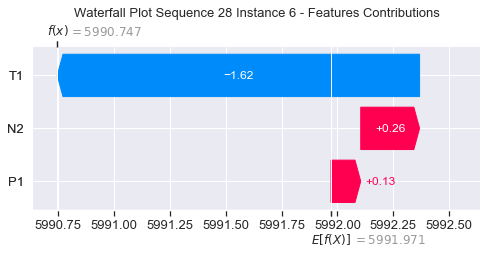

None

Contribution: [ 0.10048453 -1.39470251  0.19393881]


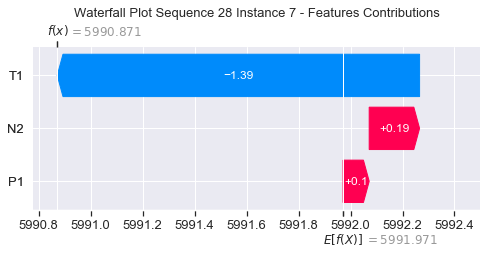

None

Contribution: [ 0.07919372 -1.25831518  0.16973754]


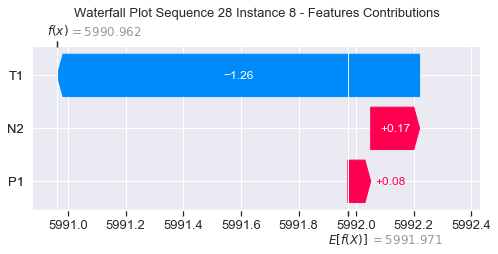

None

Contribution: [ 0.05014424 -1.24036007  0.16601171]


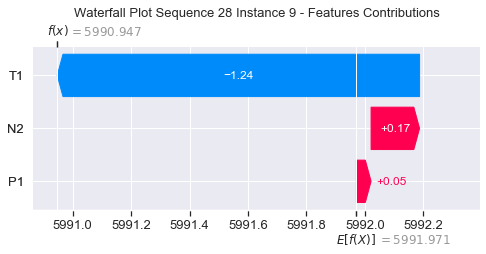

None

Contribution: [ 0.02232133 -1.15899911  0.16946303]


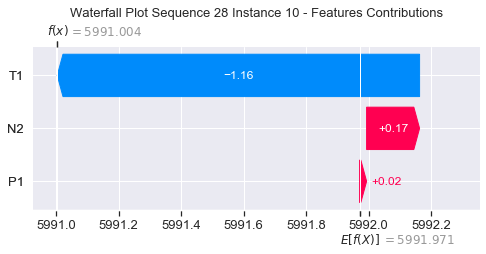

None

Contribution: [ 0.0378749  -1.14401192  0.16888028]


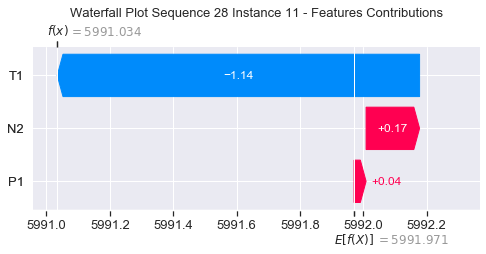

None

Contribution: [ 0.0836495  -1.17988024  0.16516138]


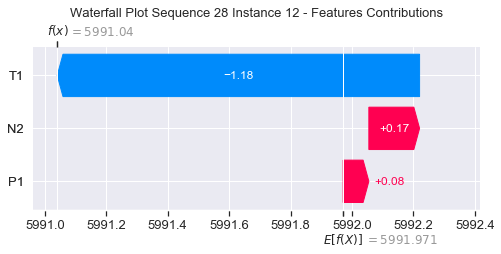

None

Contribution: [ 0.09525149 -1.2311314   0.1823844 ]


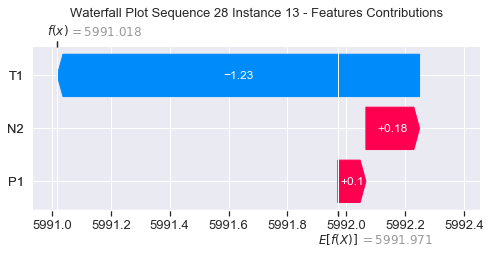

None

Contribution: [ 0.10499059 -1.35168292  0.21247402]


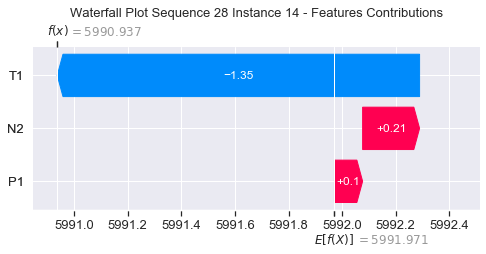

None

Contribution: [ 0.14360274 -1.52460513  0.27334458]


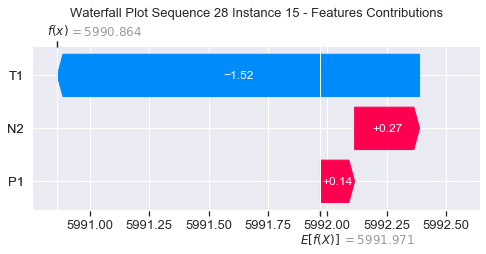

None

Contribution: [ 0.20322335 -1.70176136  0.40576624]


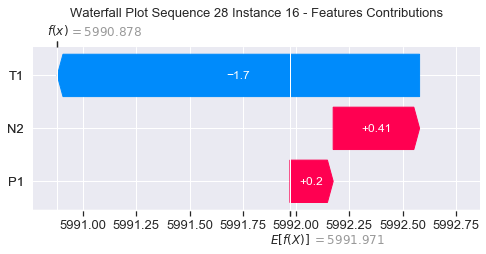

None

Contribution: [ 0.32902206 -2.28387174  0.53975237]


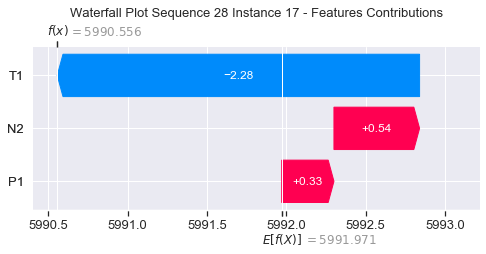

None

Contribution: [ 0.54992205 -3.33622728  0.78573152]


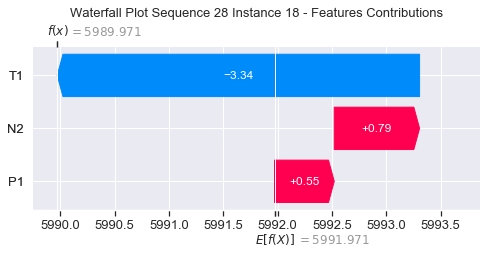

None

Contribution: [ 0.37011128 -5.32239262  1.23273611]


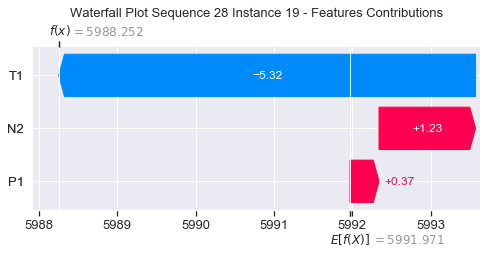

None

Contribution: [ 1.58422    -8.40529616  1.90420066]


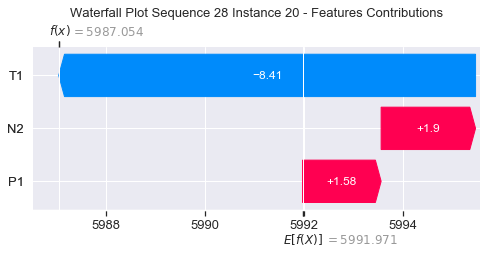

None

Contribution: [  2.84853198 -14.2913992    3.02837689]


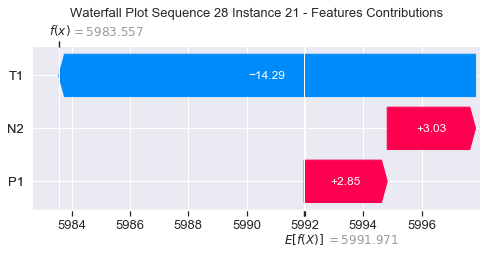

None

Contribution: [  4.88064701 -24.47614696   4.79272373]


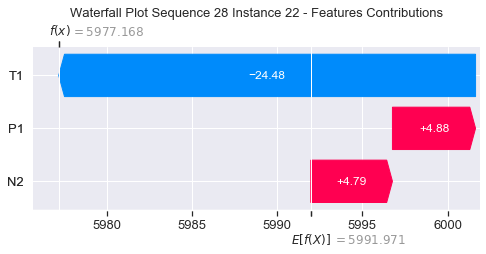

None

Contribution: [  6.34293608 -35.18279774   7.60918095]


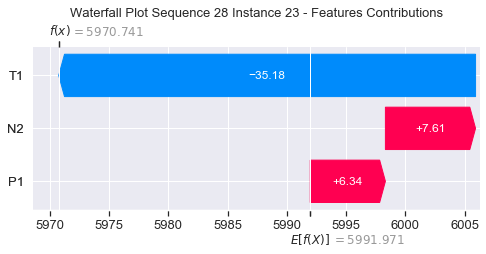

None

Contribution: [ 14.62751659 -52.14073348  12.10779891]


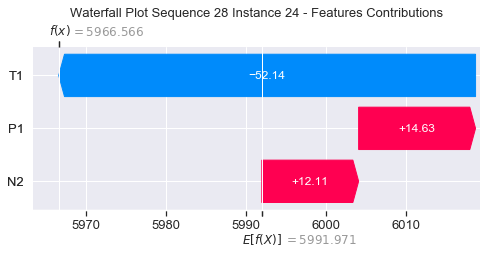

None

Contribution: [  34.09286549 -119.83094653   23.37010437]


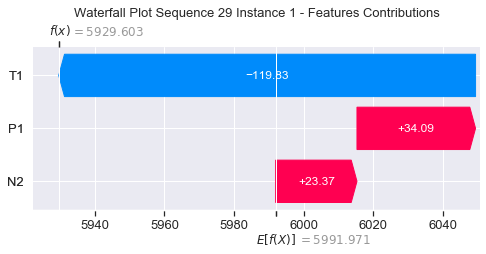

None

Contribution: [-0.03576742 -0.37393975  0.22426645]


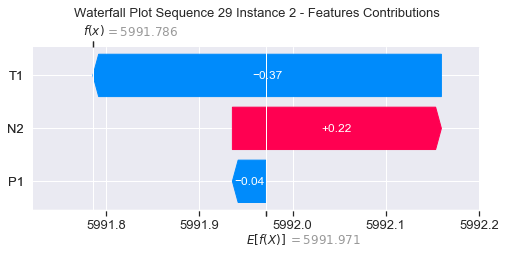

None

Contribution: [  2.09682399 -15.0771727    1.85997278]


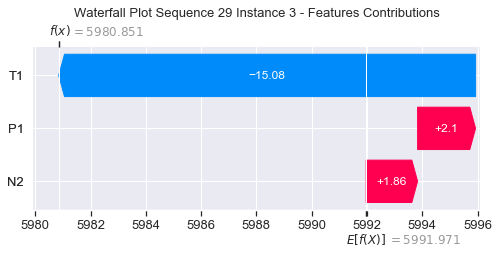

None

Contribution: [ 0.4444236  -5.83012585  0.73945384]


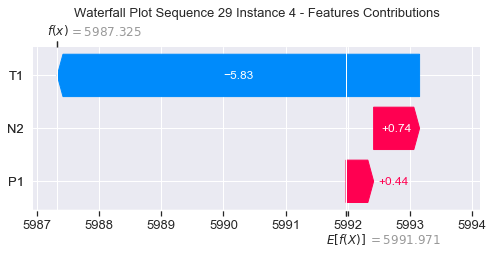

None

Contribution: [ 0.02279708 -2.72925983  0.34730356]


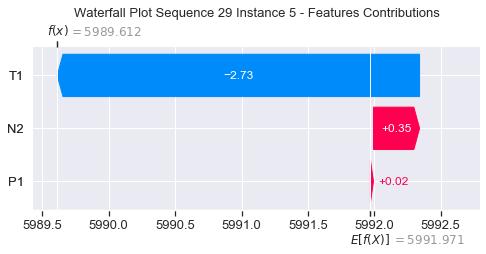

None

Contribution: [-0.39734244 -1.00987007  0.14307272]


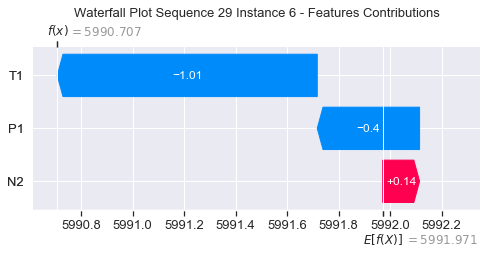

None

Contribution: [-0.43436454 -0.49781927  0.1318348 ]


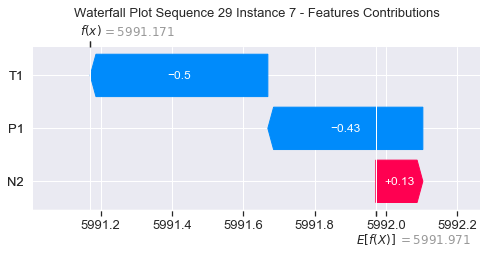

None

Contribution: [-0.34666449 -0.46449682  0.15872893]


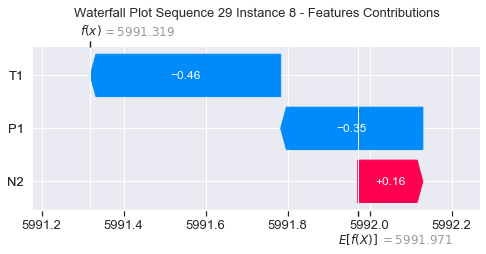

None

Contribution: [-0.3088116  -0.32719285  0.20069978]


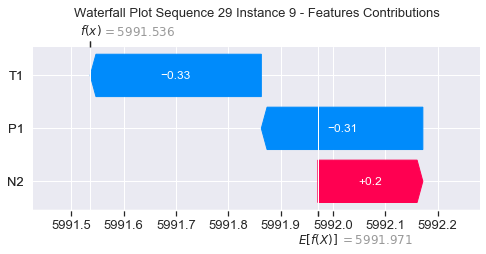

None

Contribution: [-0.05979661 -0.33231261  0.2409956 ]


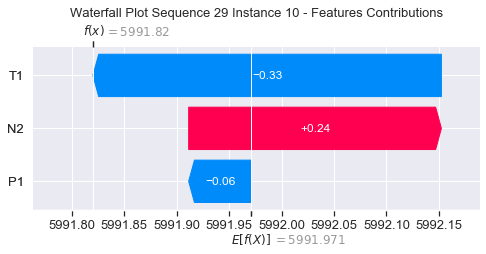

None

Contribution: [-0.32152239 -0.46192785  0.1799436 ]


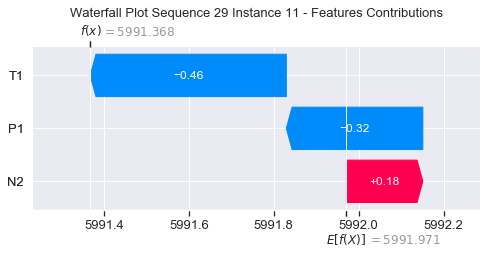

None

Contribution: [-0.3204136  -0.53912896  0.16777291]


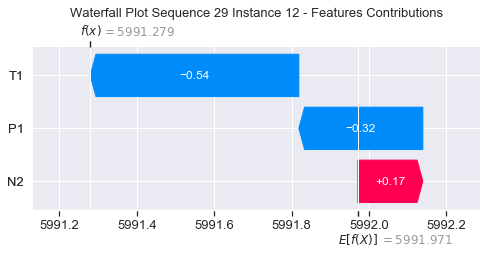

None

Contribution: [-0.2481157  -0.7933506   0.19186554]


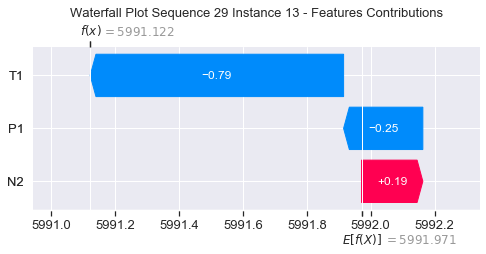

None

Contribution: [-0.32185564 -1.19388213  0.20226854]


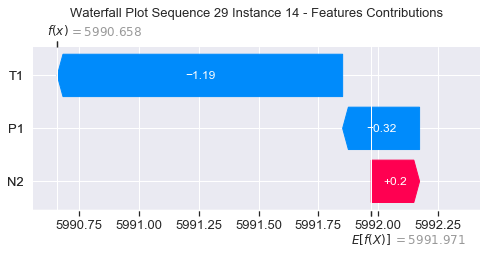

None

Contribution: [-0.05740031 -1.68832627  0.28926378]


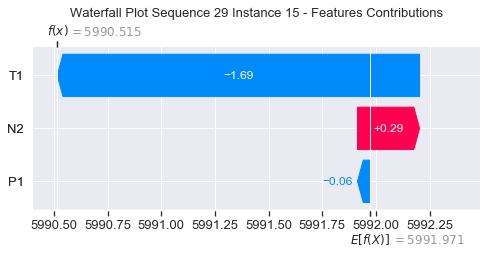

None

Contribution: [ 0.11310508 -2.37875498  0.4255836 ]


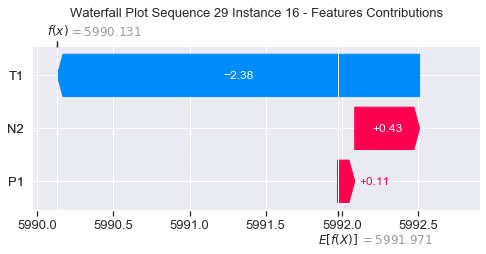

None

Contribution: [ 0.50116343 -3.57270605  0.60903984]


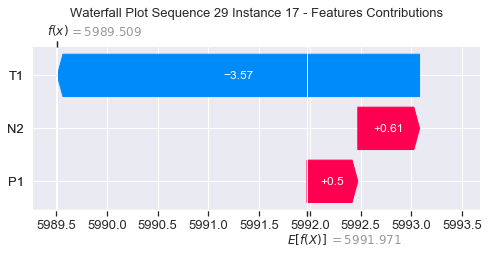

None

Contribution: [ 0.96432777 -5.18988073  0.92170489]


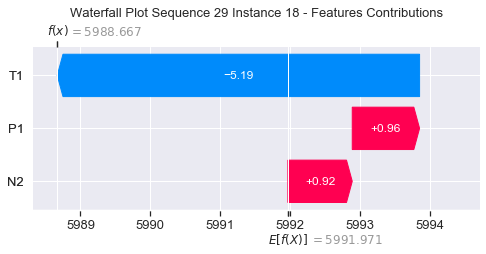

None

Contribution: [ 0.84268593 -6.46129997  1.25631243]


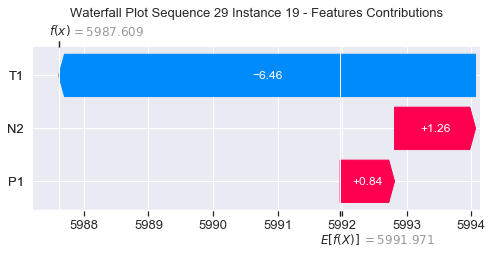

None

Contribution: [  1.7290777  -10.37364069   2.00548461]


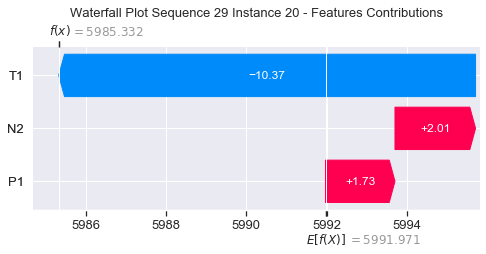

None

Contribution: [  2.38838207 -15.35000646   3.09265653]


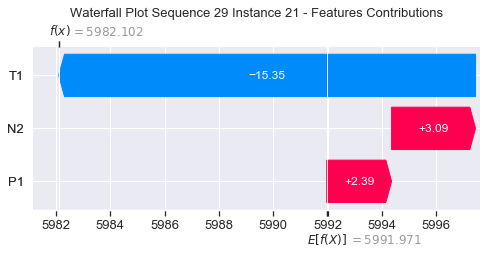

None

Contribution: [  2.26485019 -20.96901162   4.71540553]


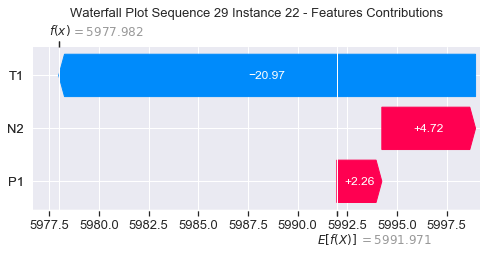

None

Contribution: [  3.48166169 -28.72257176   7.95625308]


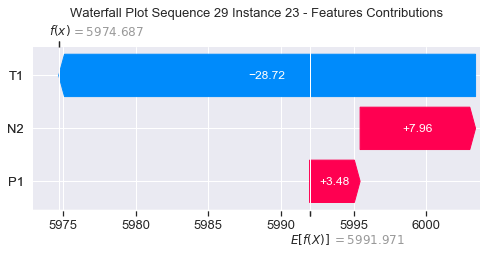

None

Contribution: [  2.73256688 -28.60190439  11.25101774]


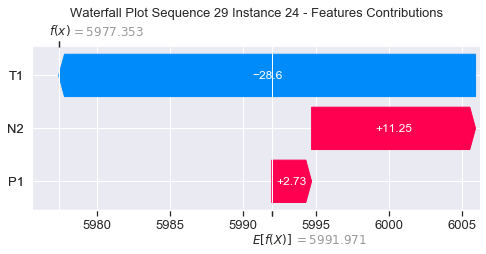

None

Contribution: [  5.18697236 -56.79049967  20.97497215]


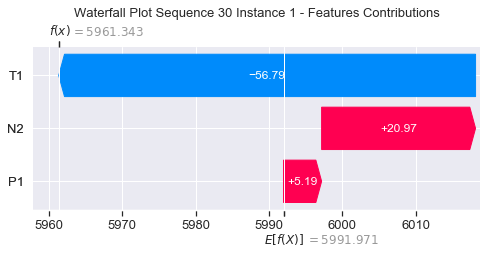

None

Contribution: [ 0.10294059 -0.30411364  0.29265795]


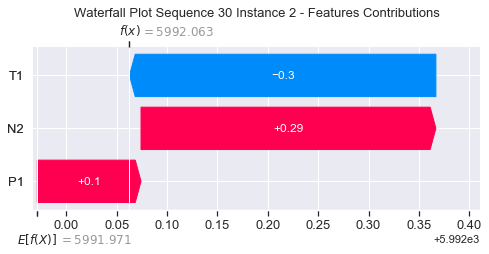

None

Contribution: [  0.46710993 -10.47399326   1.92968985]


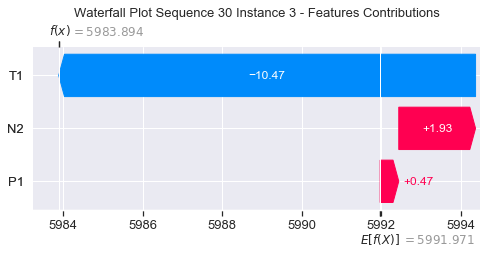

None

Contribution: [ 0.05581126 -5.10121366  0.85267522]


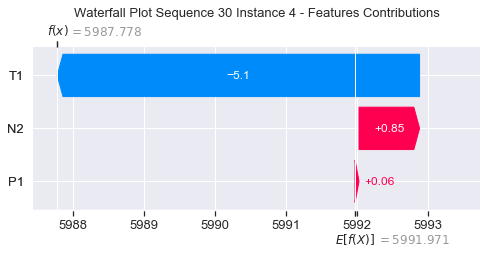

None

Contribution: [ 0.23208653 -2.5819614   0.45476713]


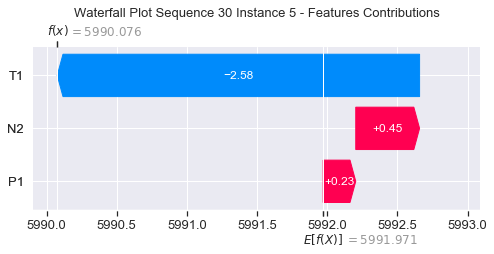

None

Contribution: [ 0.13532075 -1.74836467  0.25369585]


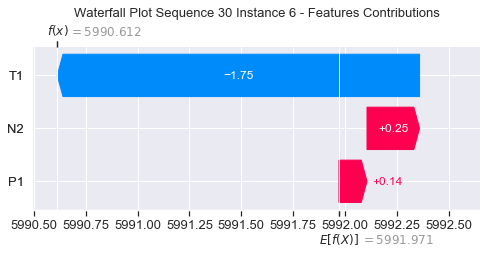

None

Contribution: [ 0.10638535 -1.44871611  0.19070598]


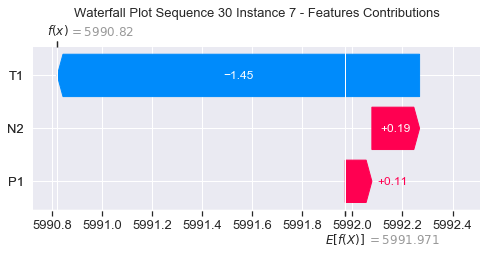

None

Contribution: [ 0.09468472 -1.31268261  0.17300991]


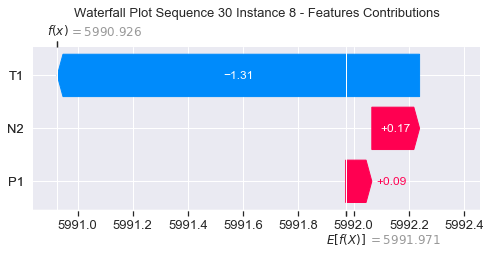

None

Contribution: [ 0.05875643 -1.26846078  0.18254606]


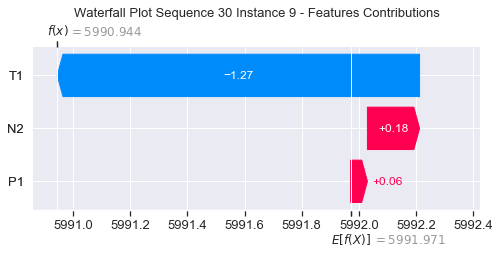

None

Contribution: [ 0.04459937 -1.17844216  0.18081368]


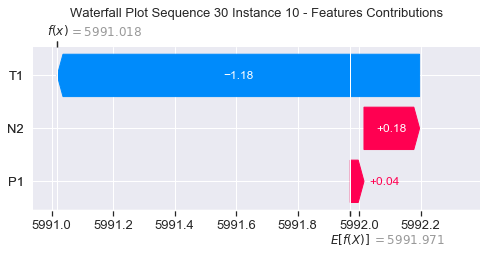

None

Contribution: [ 0.06948593 -1.23076921  0.17785286]


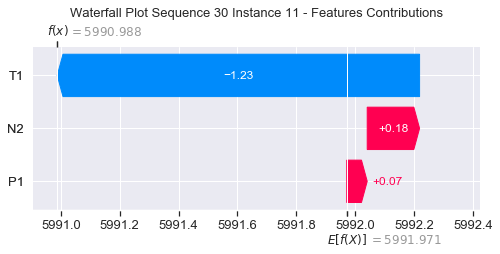

None

Contribution: [ 0.10699337 -1.26046408  0.17125723]


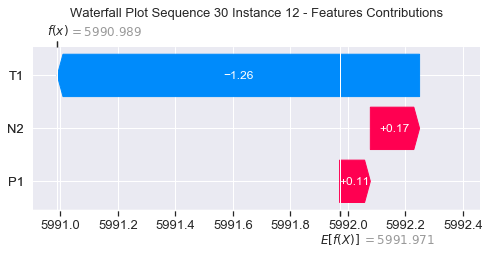

None

Contribution: [ 0.10941734 -1.32671721  0.18786367]


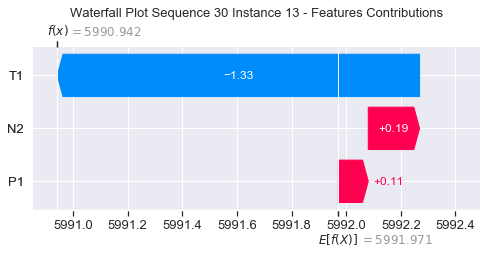

None

Contribution: [ 0.11200781 -1.45292192  0.21731271]


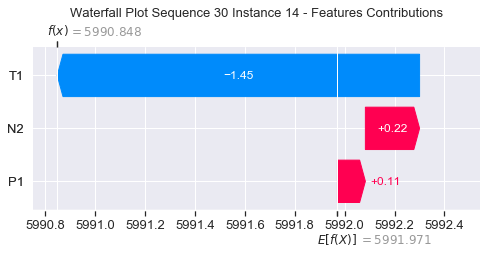

None

Contribution: [ 0.11873846 -1.61504416  0.27524539]


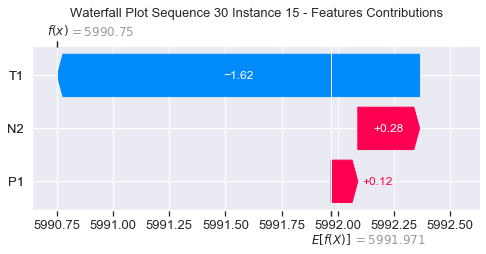

None

Contribution: [ 0.13250209 -1.82570492  0.4039005 ]


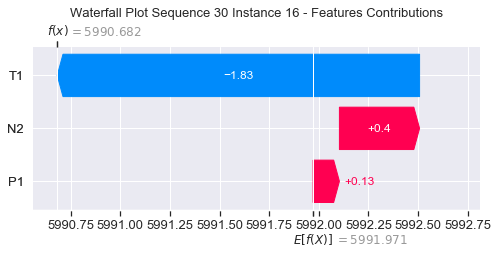

None

Contribution: [ 0.18810508 -2.25201884  0.51794275]


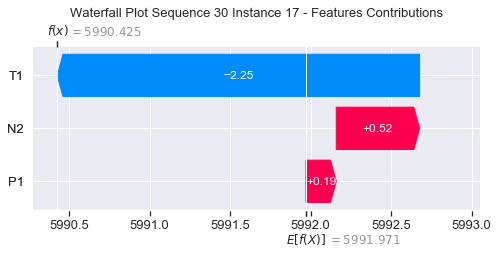

None

Contribution: [ 0.23415105 -2.94168173  0.74933561]


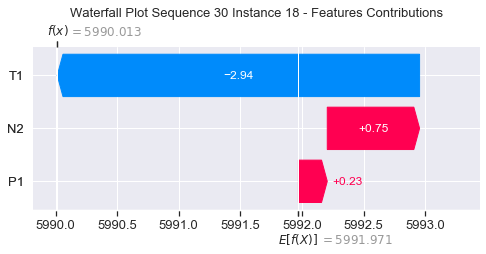

None

Contribution: [ 0.30973403 -3.75019938  1.20207298]


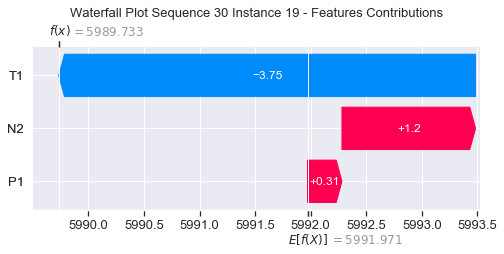

None

Contribution: [ 0.50806308 -5.75400253  1.71088945]


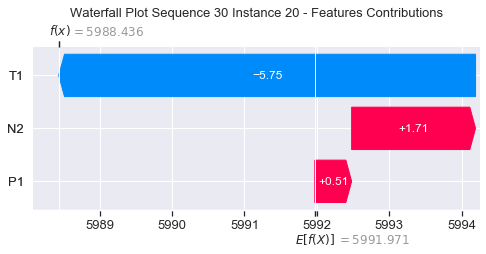

None

Contribution: [ 0.73508577 -8.79261873  2.69933367]


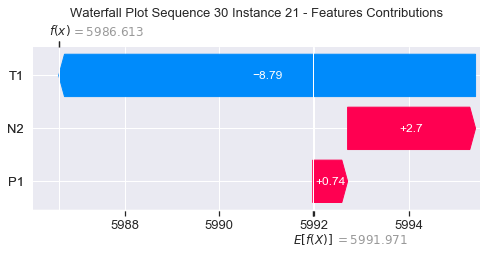

None

Contribution: [  0.83581923 -13.06752544   4.3620048 ]


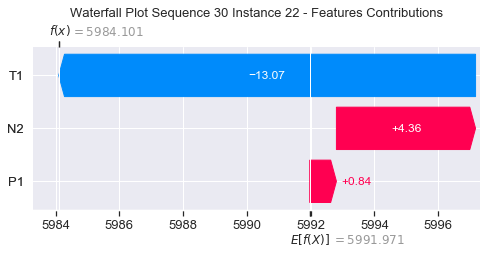

None

Contribution: [  0.37133768 -18.69517264   7.0899536 ]


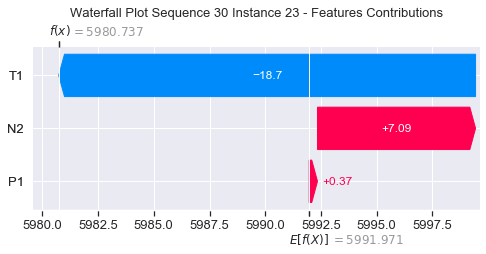

None

Contribution: [  3.22807499 -21.2716967   10.86538357]


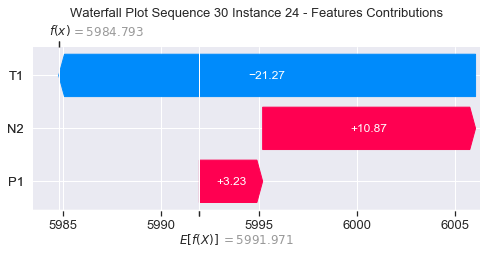

None

Contribution: [ 10.89217623 -45.44615683  21.12214489]


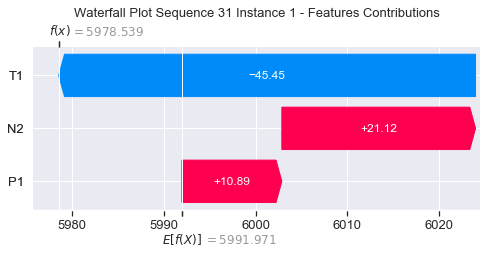

None

Contribution: [ 0.09346003 -0.23282553  0.2992662 ]


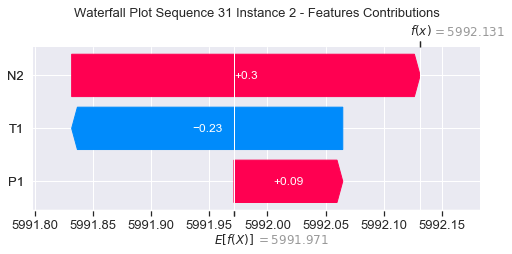

None

Contribution: [ 0.40416083 -7.62116642  2.3055725 ]


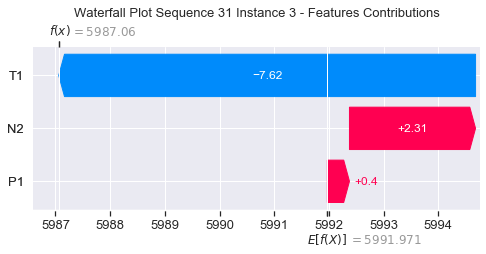

None

Contribution: [ 0.28281838 -3.88262075  0.94149553]


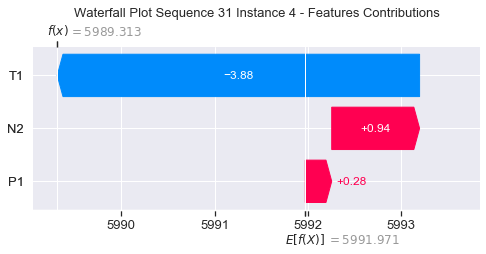

None

Contribution: [ 0.23643381 -2.37835342  0.51790441]


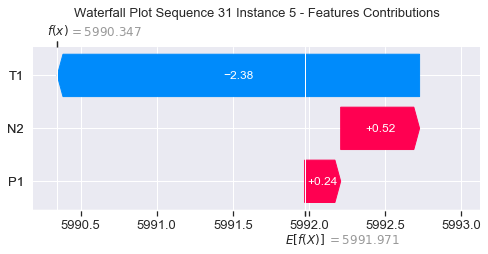

None

Contribution: [ 0.13326619 -1.59182537  0.26839425]


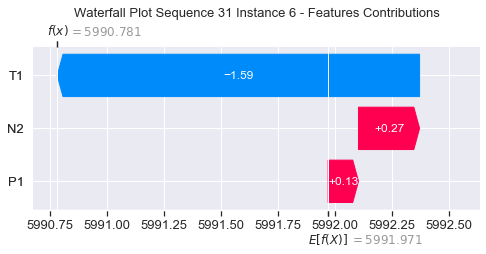

None

Contribution: [ 0.10725403 -1.32198928  0.19059222]


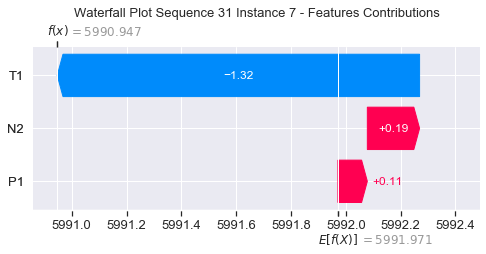

None

Contribution: [ 0.09186886 -1.20281827  0.16512831]


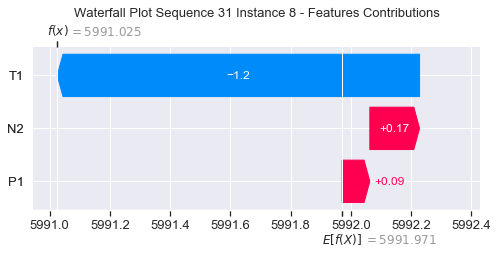

None

Contribution: [ 0.03595278 -1.13950382  0.16840927]


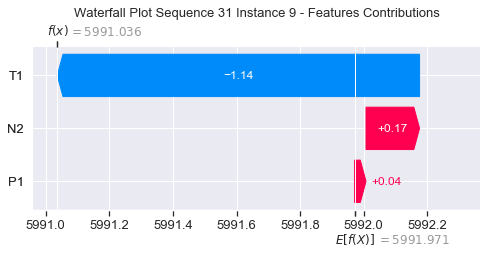

None

Contribution: [ 0.03917538 -1.08878485  0.17469926]


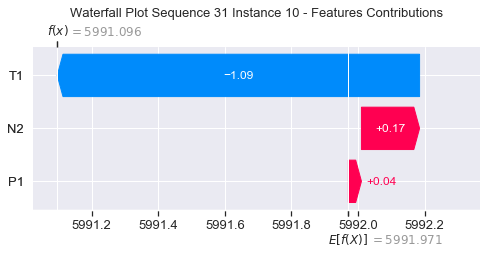

None

Contribution: [ 0.05171464 -1.11131899  0.17045764]


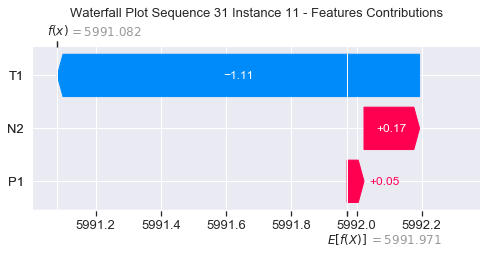

None

Contribution: [ 0.09937882 -1.1575664   0.16801786]


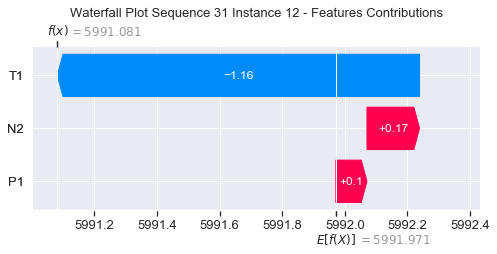

None

Contribution: [ 0.1013551  -1.21027879  0.18542243]


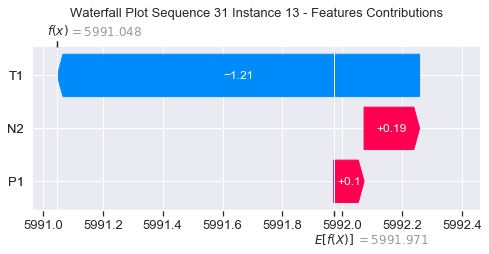

None

Contribution: [ 0.10323486 -1.33436162  0.21762651]


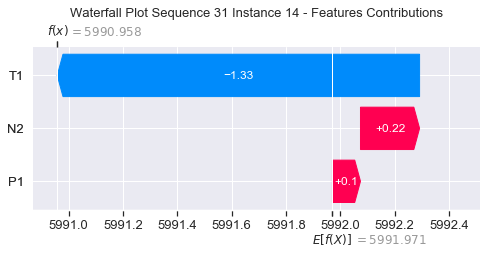

None

Contribution: [ 0.10944061 -1.47122557  0.27725202]


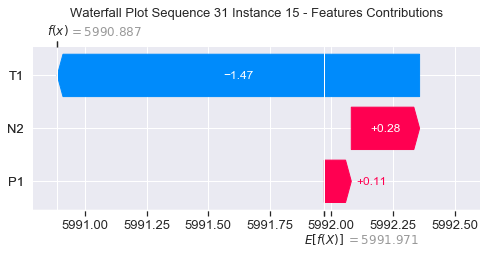

None

Contribution: [ 0.11993735 -1.58918349  0.41988658]


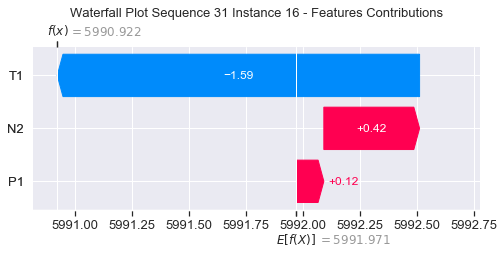

None

Contribution: [ 0.20078697 -2.07045333  0.53334512]


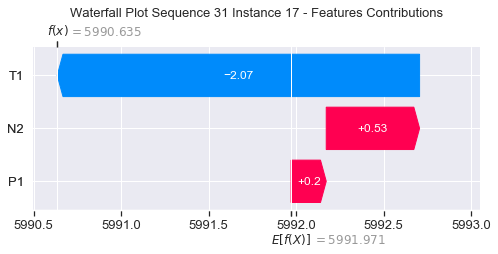

None

Contribution: [ 0.26662599 -2.72900708  0.77640423]


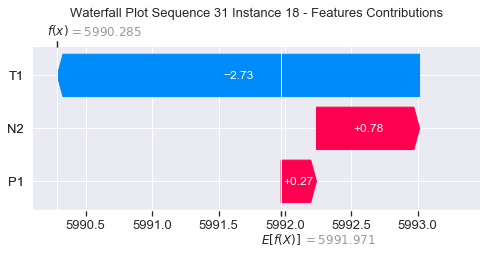

None

Contribution: [ 0.11315957 -3.95935355  1.32071989]


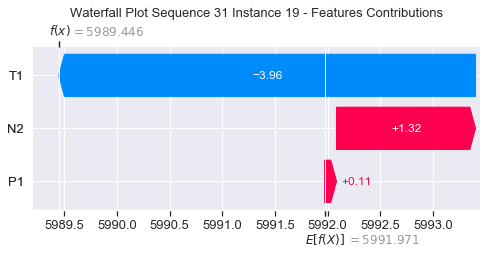

None

Contribution: [ 0.85843987 -5.59366723  1.8920269 ]


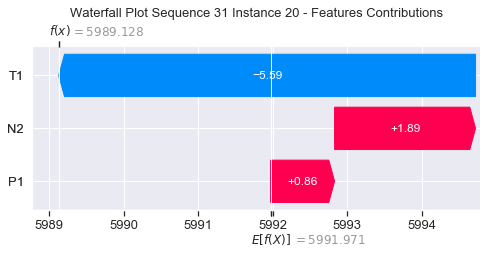

None

Contribution: [ 1.38155165 -8.62106319  2.9715935 ]


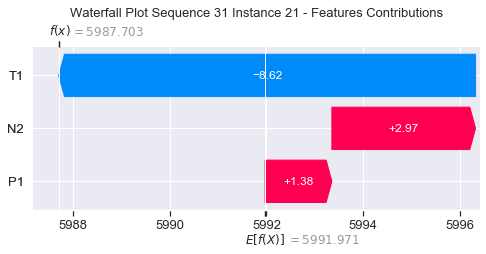

None

Contribution: [  1.90721639 -12.89006557   4.74341775]


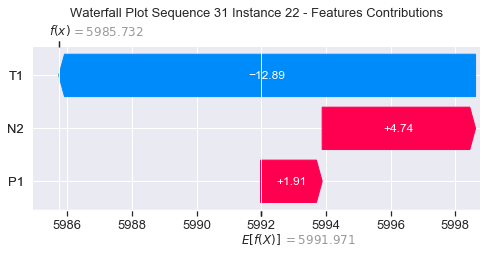

None

Contribution: [  1.67619195 -18.19134103   7.4864992 ]


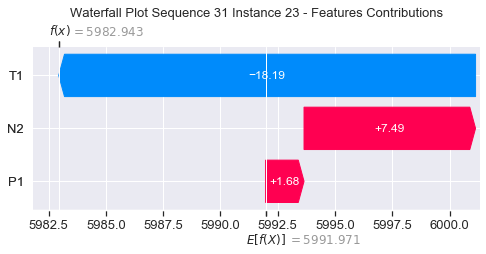

None

Contribution: [  3.3836189  -23.43105651  11.07037542]


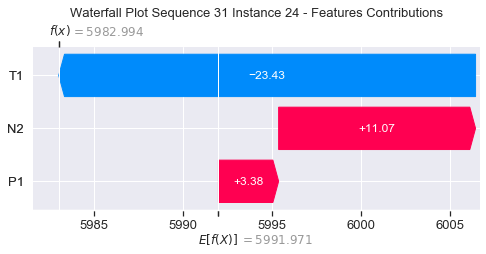

None

Contribution: [  4.20610108 -64.20393642  18.82805897]


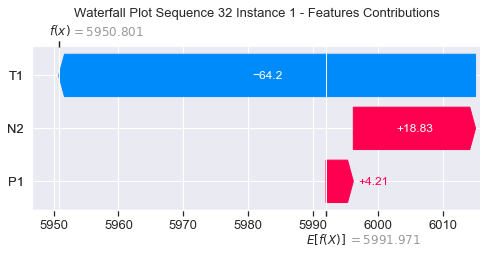

None

Contribution: [ 0.07244868 -0.27445872  0.29149593]


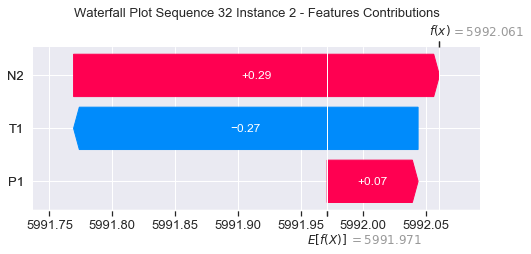

None

Contribution: [ 0.07951126 -8.58106946  2.05794687]


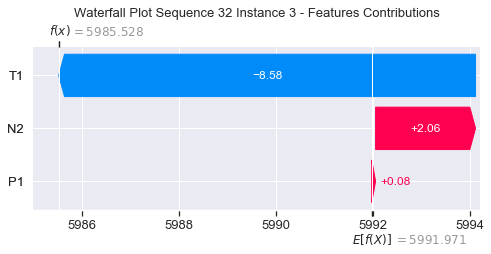

None

Contribution: [ 0.43158142 -4.31395201  1.0278062 ]


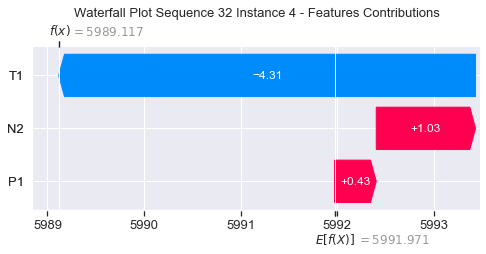

None

Contribution: [ 0.26591572 -2.59429352  0.51438727]


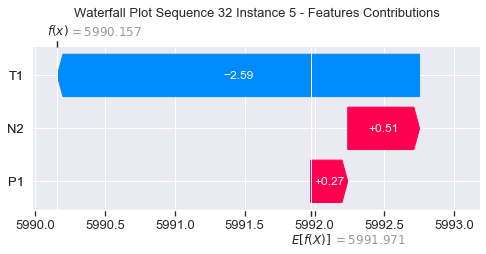

None

Contribution: [ 0.12673429 -1.73484971  0.24242074]


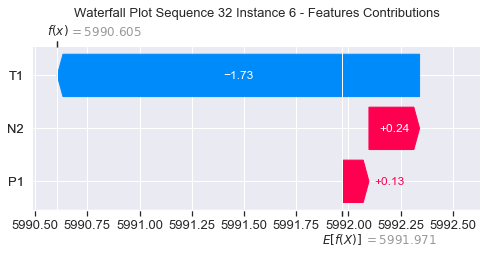

None

Contribution: [ 0.08846141 -1.43456644  0.16266362]


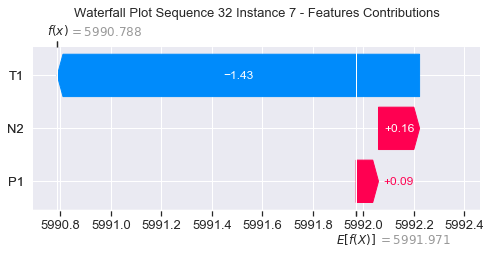

None

Contribution: [ 0.07896464 -1.295378    0.14459075]


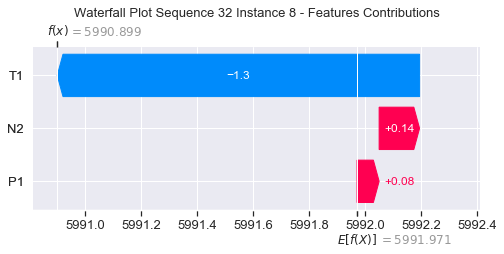

None

Contribution: [ 0.07730433 -1.23934735  0.17012766]


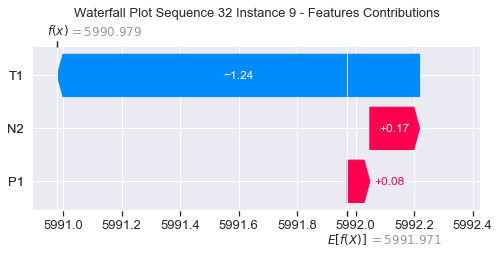

None

Contribution: [ 0.0836684  -1.17218164  0.18593175]


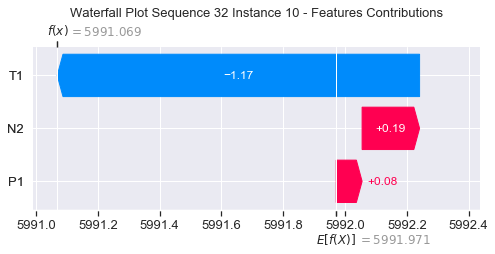

None

Contribution: [ 0.07430599 -1.20798445  0.16987647]


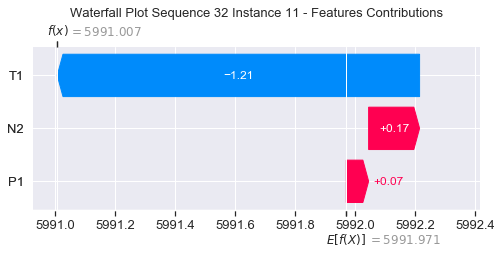

None

Contribution: [ 0.08614139 -1.26698676  0.15221936]


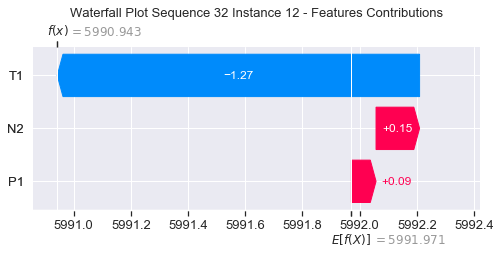

None

Contribution: [ 0.09720748 -1.32686096  0.17502258]


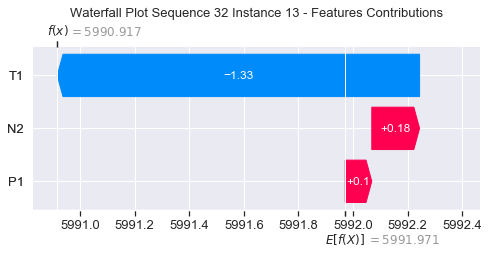

None

Contribution: [ 0.11151441 -1.45349005  0.21681357]


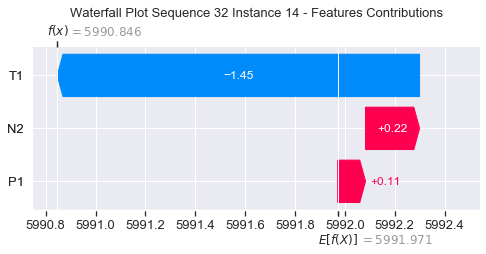

None

Contribution: [ 0.13026027 -1.61373185  0.29340456]


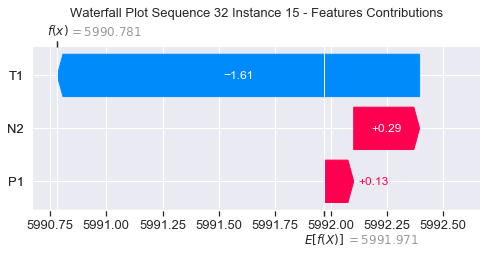

None

Contribution: [ 0.09451088 -1.87821371  0.43183843]


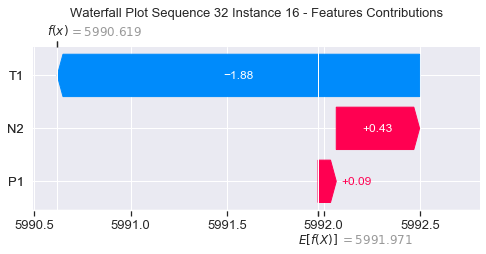

None

Contribution: [ 0.25101322 -2.30276228  0.62901993]


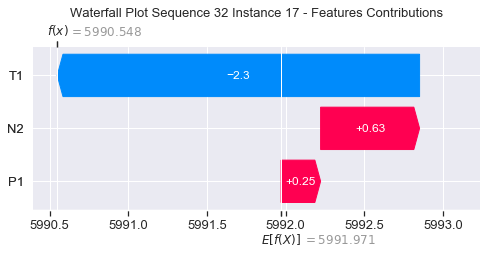

None

Contribution: [ 0.3441247  -3.09868975  0.95283006]


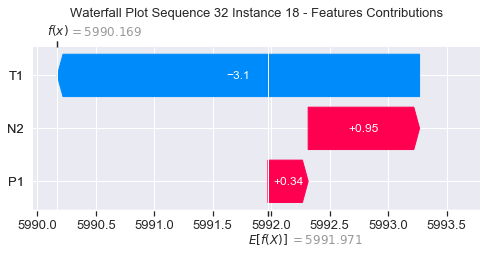

None

Contribution: [-0.35911858 -5.29032498  1.2561904 ]


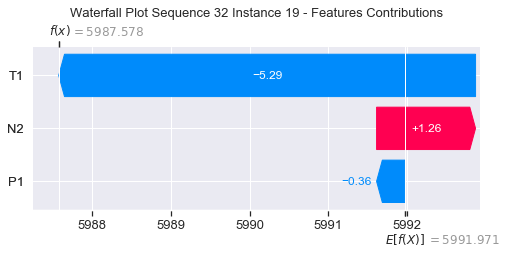

None

Contribution: [ 0.67133844 -6.79773416  2.30810667]


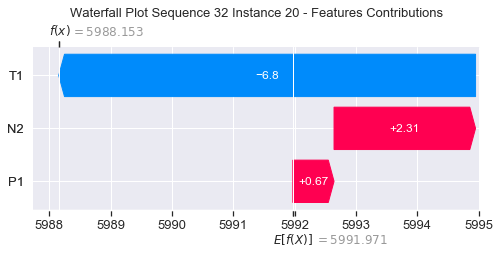

None

Contribution: [  1.10585859 -10.34877479   3.68407194]


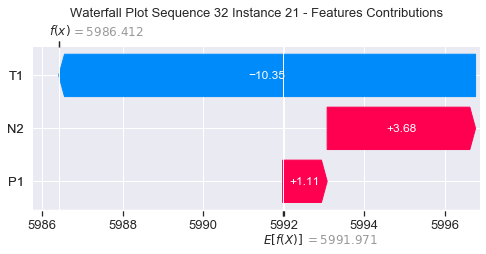

None

Contribution: [  1.43744214 -15.80872604   5.84722372]


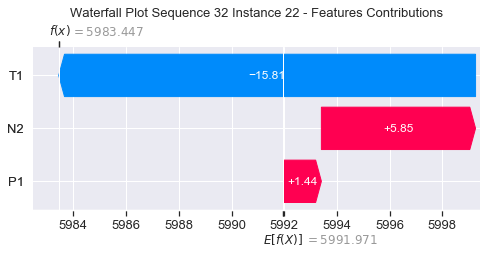

None

Contribution: [  1.23004991 -22.64432167   9.13472611]


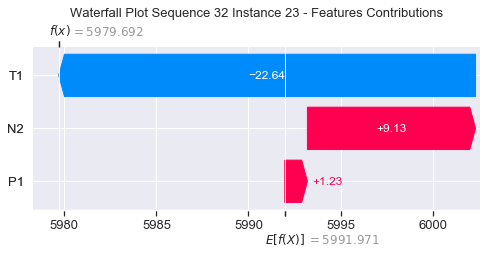

None

Contribution: [  3.22021437 -28.03725838  13.21811166]


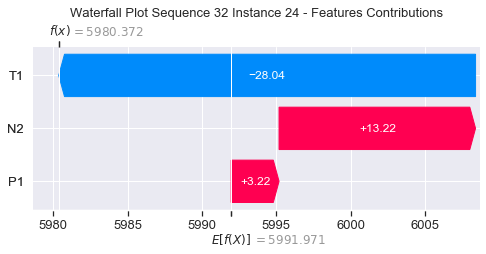

None

Contribution: [  7.20083289 -60.10369406  23.16054434]


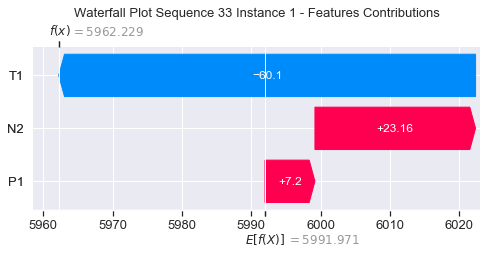

None

Contribution: [ 0.08245816 -0.27676746  0.27361874]


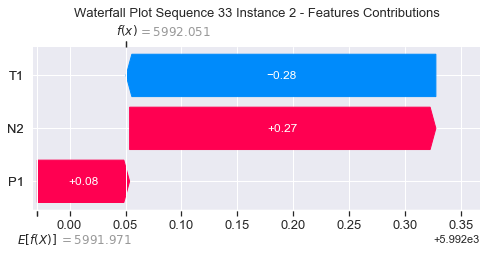

None

Contribution: [-0.01370188 -9.82046804  2.38076792]


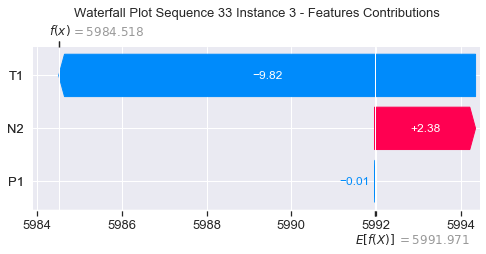

None

Contribution: [ 0.45921765 -4.29444915  1.03549037]


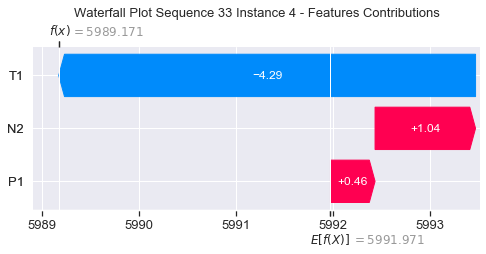

None

Contribution: [ 0.19681001 -2.71562015  0.48447357]


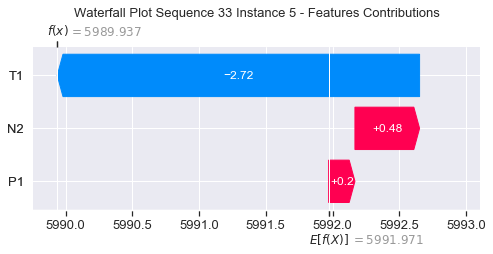

None

Contribution: [ 0.13444642 -1.76632575  0.24207198]


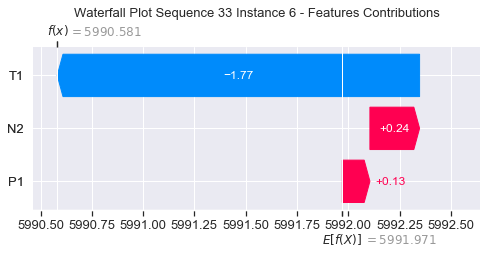

None

Contribution: [ 0.11018026 -1.43928348  0.16961263]


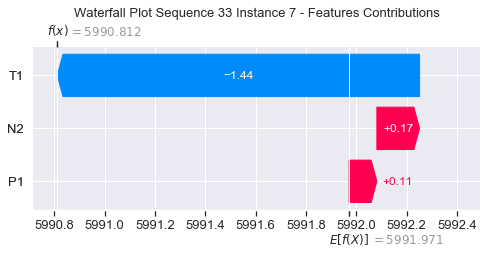

None

Contribution: [ 0.10180301 -1.29704321  0.1508202 ]


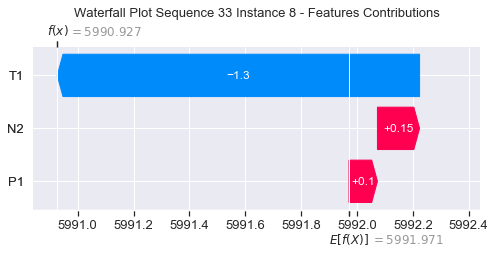

None

Contribution: [ 0.11339588 -1.21509569  0.16725283]


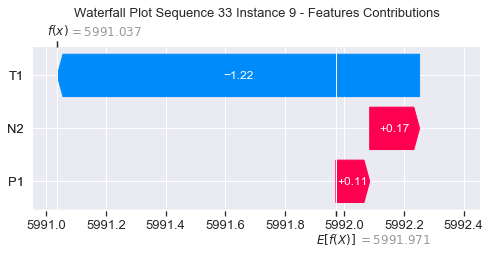

None

Contribution: [ 0.0847074  -1.17763006  0.18342525]


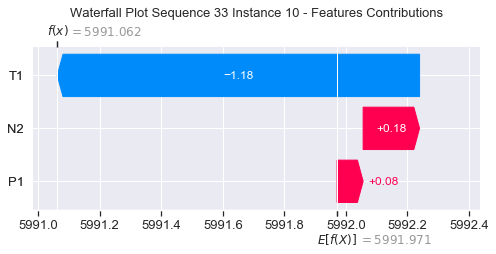

None

Contribution: [ 0.08283347 -1.2128355   0.16373376]


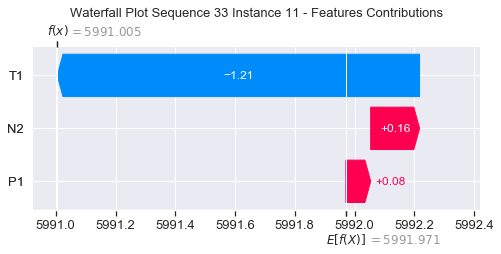

None

Contribution: [ 0.0998568  -1.2420142   0.16298734]


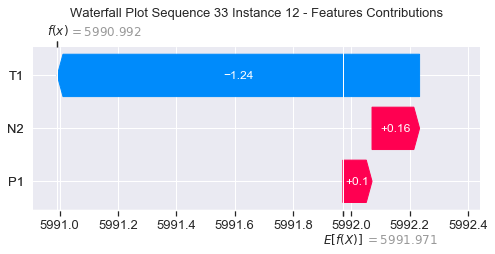

None

Contribution: [ 0.11013815 -1.32027292  0.18251517]


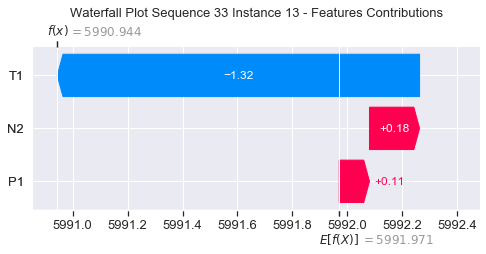

None

Contribution: [ 0.11426617 -1.48120982  0.216143  ]


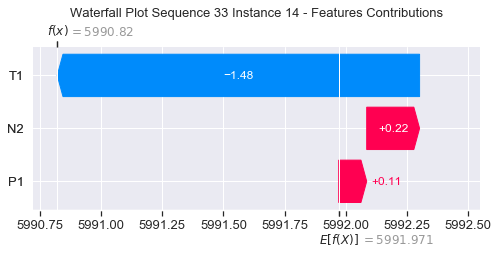

None

Contribution: [ 0.12153618 -1.70524035  0.27792758]


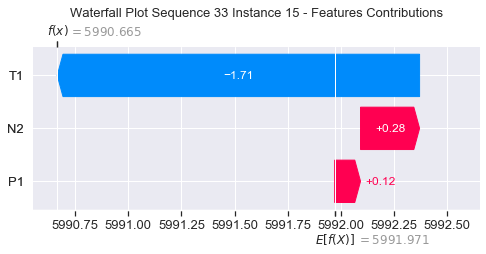

None

Contribution: [ 0.07942068 -1.99704233  0.38076859]


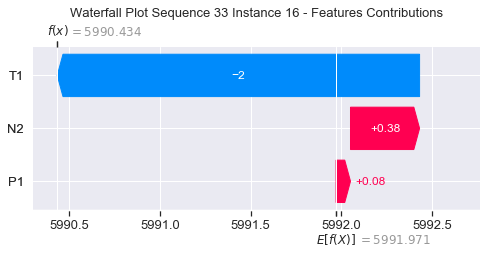

None

Contribution: [ 0.16835484 -2.6812399   0.52604079]


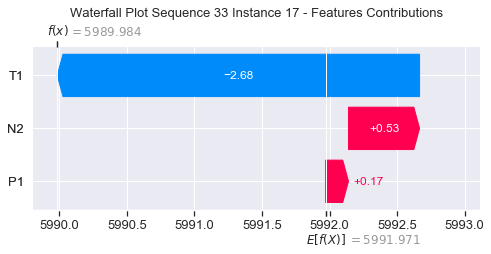

None

Contribution: [ 0.21117884 -3.71044417  0.76050131]


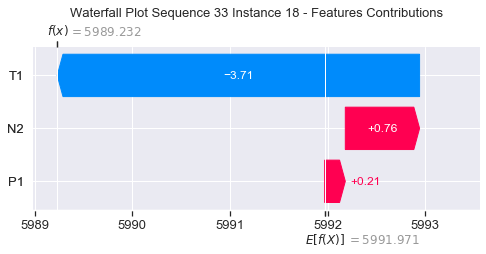

None

Contribution: [-0.2511354  -5.59427585  1.05261762]


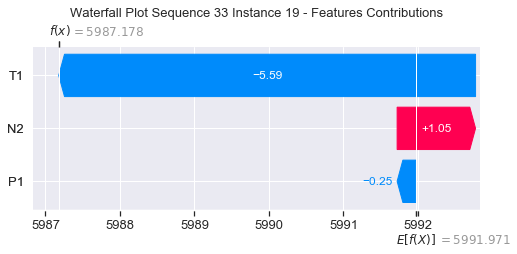

None

Contribution: [ 3.23972038e-03 -8.42348759e+00  1.68089707e+00]


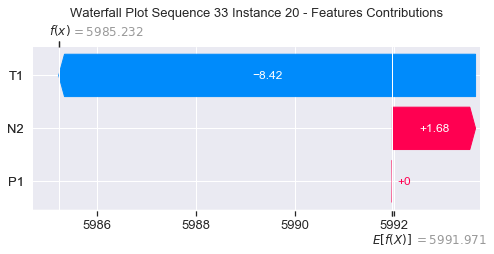

None

Contribution: [ -0.04610181 -13.24529214   2.60814062]


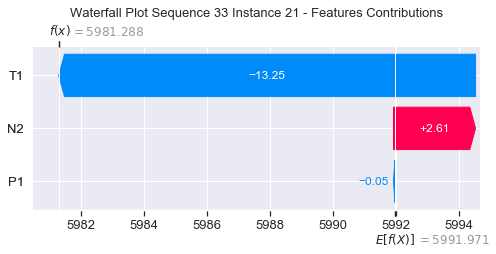

None

Contribution: [ -0.29354595 -20.2121878    4.1577659 ]


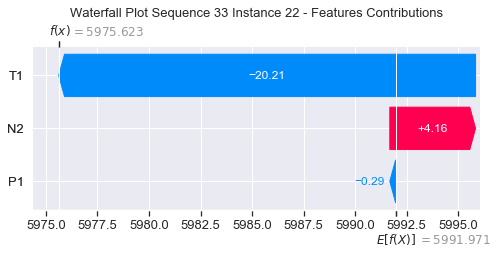

None

Contribution: [ -0.56909069 -28.26744628   6.7643232 ]


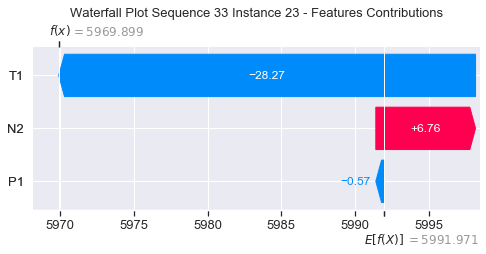

None

Contribution: [  1.44108205 -33.79359531  10.58624396]


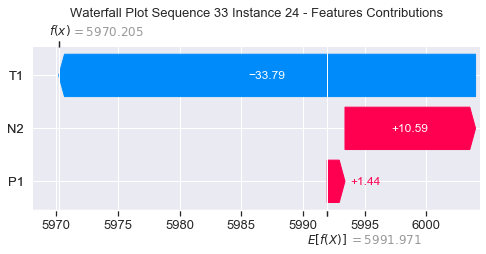

None

Contribution: [  7.01471744 -75.56056334  19.49267091]


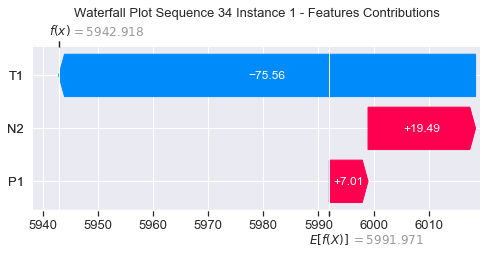

None

Contribution: [ 0.11856128 -0.38987601  0.27892337]


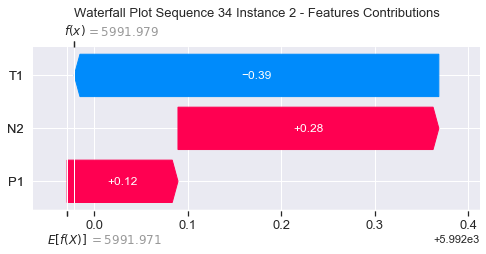

None

Contribution: [  0.230507   -12.25681553   1.72590282]


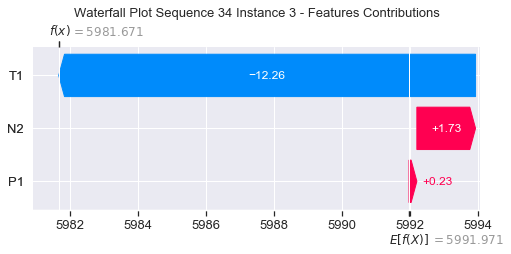

None

Contribution: [ 0.3301781  -5.58411859  0.79982838]


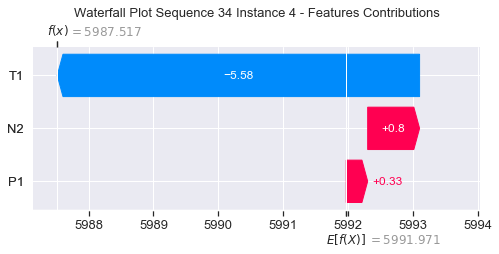

None

Contribution: [ 0.22522945 -3.1528599   0.40372634]


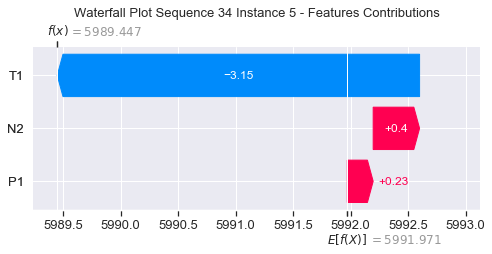

None

Contribution: [ 0.1946118  -1.9854571   0.23864684]


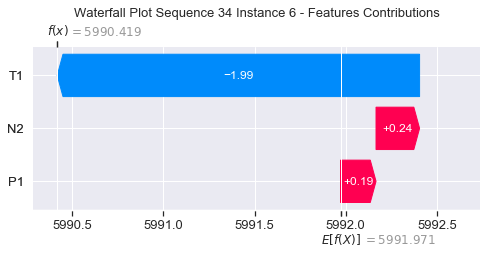

None

Contribution: [ 0.18009137 -1.58994028  0.19404292]


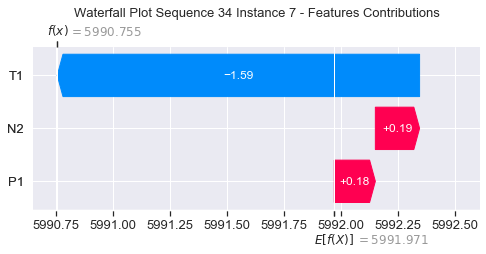

None

Contribution: [ 0.17892699 -1.4041482   0.18910616]


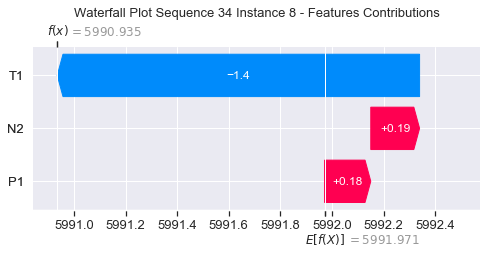

None

Contribution: [ 0.19135637 -1.3097894   0.1963547 ]


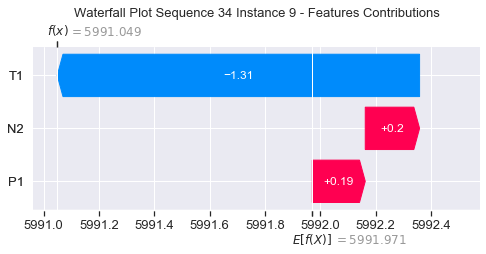

None

Contribution: [ 0.19427394 -1.2194497   0.19980674]


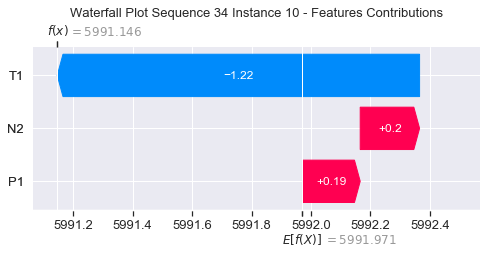

None

Contribution: [ 0.2059501  -1.31522756  0.1952383 ]


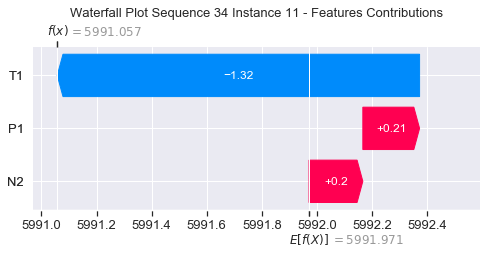

None

Contribution: [ 0.21190991 -1.40471459  0.19021237]


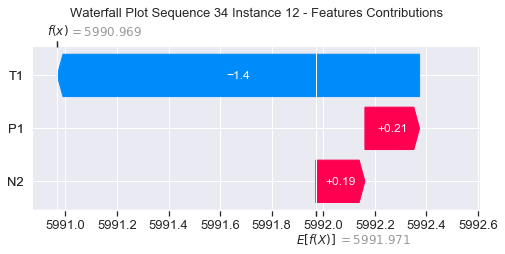

None

Contribution: [ 0.20034966 -1.51009468  0.20511859]


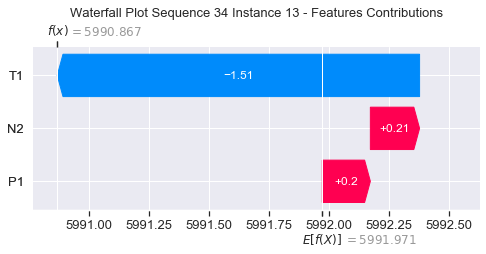

None

Contribution: [ 0.22062479 -1.68620217  0.2324581 ]


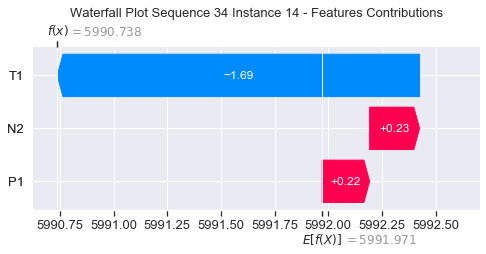

None

Contribution: [ 0.15255982 -1.97213894  0.28785719]


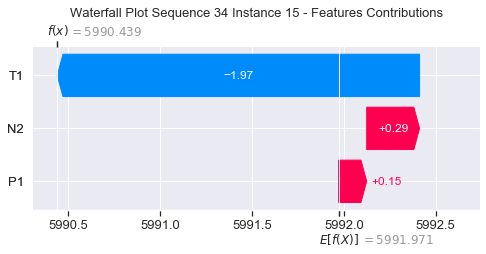

None

Contribution: [ 0.10802663 -2.39970971  0.41632384]


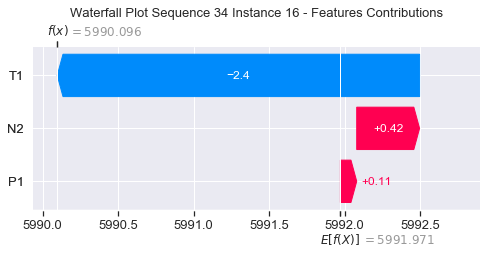

None

Contribution: [ 0.08934934 -3.06276254  0.53782516]


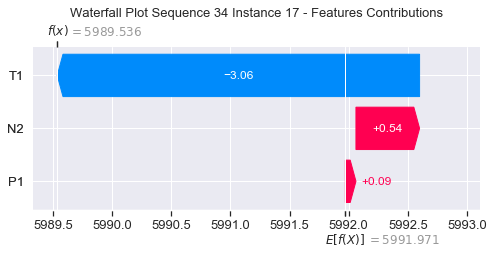

None

Contribution: [ 0.00962252 -4.20181184  0.77808225]


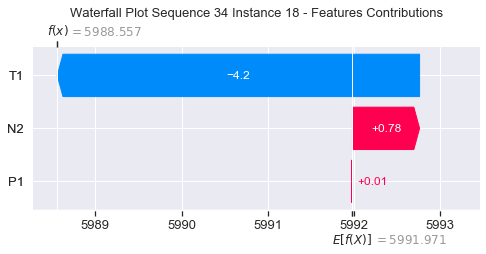

None

Contribution: [-0.63197634 -6.59016797  1.15053111]


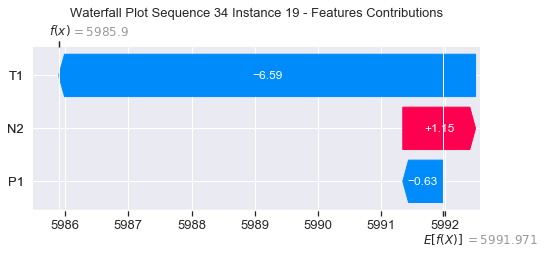

None

Contribution: [-0.14428347 -9.27529896  1.7519263 ]


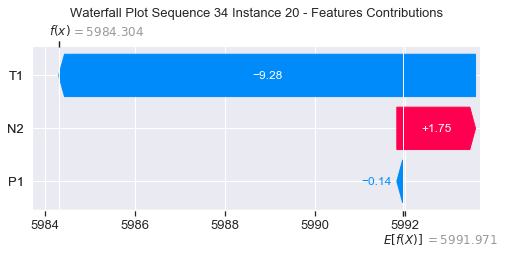

None

Contribution: [ -0.43654202 -14.26343491   2.73675184]


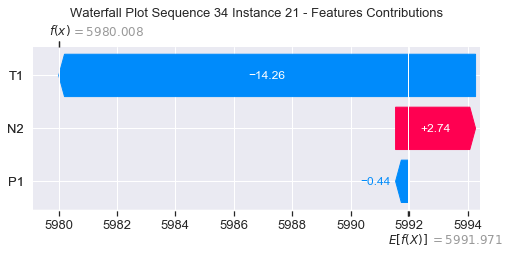

None

Contribution: [ -1.0551649  -21.52837001   4.29929679]


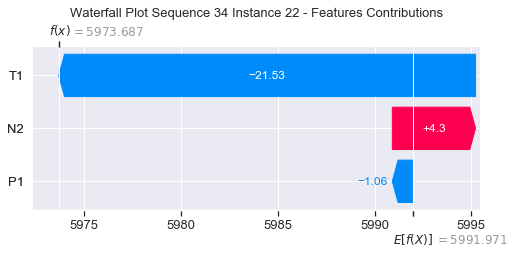

None

Contribution: [ -2.33989897 -30.26954673   7.11983642]


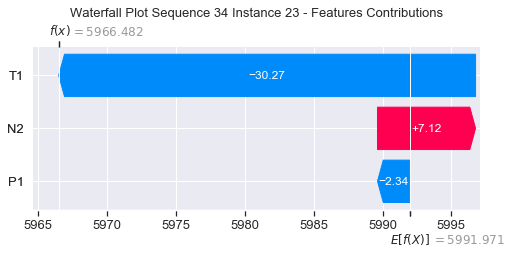

None

Contribution: [-9.56725991e-03 -3.75181418e+01  1.05202661e+01]


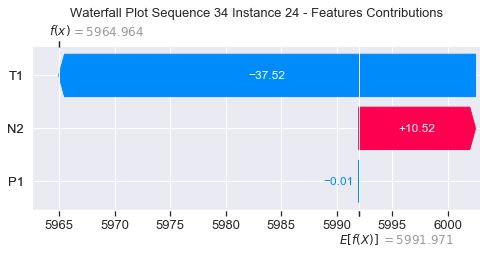

None

In [44]:
#Waterfall Plot for Consistency metric

sns.set()
instance = xtrain
instance2 = xtest
explainer = shap.DeepExplainer(model3,instance)
    
for s in range(0,34):
    instance=xtest[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Sequence %s " %(s+1)+"Instance %i - Features Contributions" %(j+1),fontsize=13)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)